# SVM with quantum kernels

### Kernel quality framework

Applied to the `make_circles` dataset

In this Notebook, we use the tools developed and made available in the `qsvm_utils.py` module, to apply the proposed grid/random search framework for the systematic evaluation of quantum feature map proposals.

We use the `make_circles` dataset, which is an artificial toy dataset produced with sklearn. We'll work with 2-dimensional data and only 60 observations, which is necessary for the framework to yield meaningful results in a reasonable time.

Finaly, refer to the pdf file `good_quantum_kernel_details` in the repository for details on the procedure and reasoning behind the framework.

__________

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import numpy as np
import pandas as pd

import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.model_selection import train_test_split
from sklearn.datasets import make_moons, make_circles

import itertools

import time

from qsvm_utils import *

________

**Reading the data**

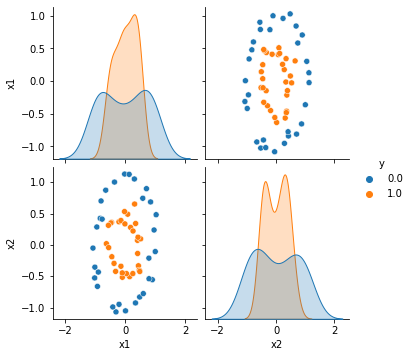

In [3]:
X, y = make_circles(n_samples=60, noise=0.1, factor = 0.5, random_state=42)

df = pd.DataFrame(np.column_stack((X, y)), columns="x1 x2 y".split())

X = df.drop(columns="y")
y = df["y"]

sns.pairplot(df, hue="y")
plt.show()

**Pre-processing**
 

In [4]:
X_train, X_test, y_train, y_test, feature_dim = pre_process_data(X, y, dpp=False, pca=False)

### Quantum kernels


_____________

Some fast experiments - testing functions outside of the full grid

In [6]:
reps = 1
paulis = ["X", "Z"]
entanglement = "linear"


Feature map:


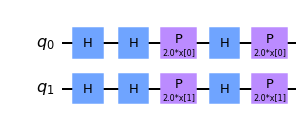

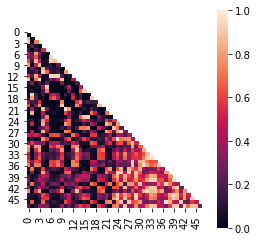

In [7]:
train_qkernel = construct_quantum_gram(reps, paulis, entanglement, X_train, None)

plot_gram(train_qkernel)


Feature map:


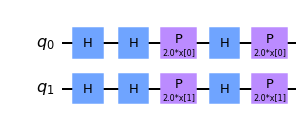


Quantum kernel matrices:



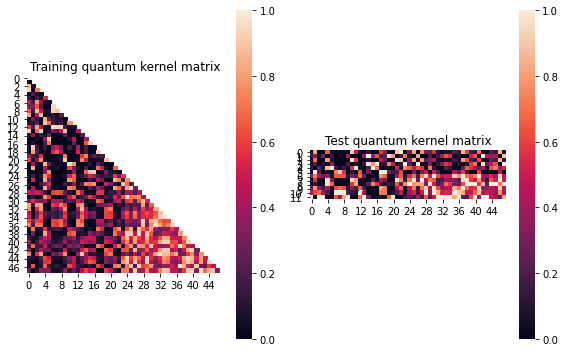


SVM with quantum kernel trained!


Test set performance:


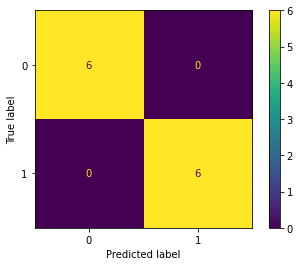

              precision    recall  f1-score   support

           0       1.00      1.00      1.00         6
           1       1.00      1.00      1.00         6

    accuracy                           1.00        12
   macro avg       1.00      1.00      1.00        12
weighted avg       1.00      1.00      1.00        12



(array([[1.        , 0.01160285, 0.85406819, ..., 0.06569274, 0.06091207,
         0.24393175],
        [0.01279033, 1.        , 0.06885243, ..., 0.01572549, 0.6339403 ,
         0.        ],
        [0.84769148, 0.06972934, 1.        , ..., 0.01282571, 0.03916781,
         0.10907797],
        ...,
        [0.07802955, 0.02792595, 0.02426267, ..., 1.        , 0.45503808,
         0.87923023],
        [0.07147408, 0.64826635, 0.0482655 , ..., 0.45810678, 1.        ,
         0.32540542],
        [0.24628073, 0.        , 0.10990237, ..., 0.88593155, 0.31875555,
         1.        ]]),
 {'0': {'precision': 1.0, 'recall': 1.0, 'f1-score': 1.0, 'support': 6},
  '1': {'precision': 1.0, 'recall': 1.0, 'f1-score': 1.0, 'support': 6},
  'accuracy': 1.0,
  'macro avg': {'precision': 1.0,
   'recall': 1.0,
   'f1-score': 1.0,
   'support': 12},
  'weighted avg': {'precision': 1.0,
   'recall': 1.0,
   'f1-score': 1.0,
   'support': 12}})

In [10]:
qsvm(X, X_train, y_train, X_test, y_test, reps, paulis, entanglement)

_______________

Now, running the full grid!

In [11]:
# params to be varied in the grid
params = {"reps_list" : [1, 2, 3],
          "paulis_list" : combs_sub_lists(cart_product_string("XYZ", feature_dim)),
          # not considering "sca"; see notebook "architecture_study" for details
          "entanglement_list" : "linear circular full".split()}

param_grid, range_list = calc_param_grid(params, feature_dim, random_search=False, n_random=100)

Initial number of combinations: 1404
Number of combinations after dropping redundancies: 468


In [12]:
results = []



Combination 1/468
(Current range: 1/46)
			 reps : 1
			 paulis : ['X']
			 entanglement : linear

Feature map:


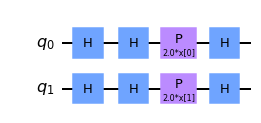


Quantum kernel matrices:



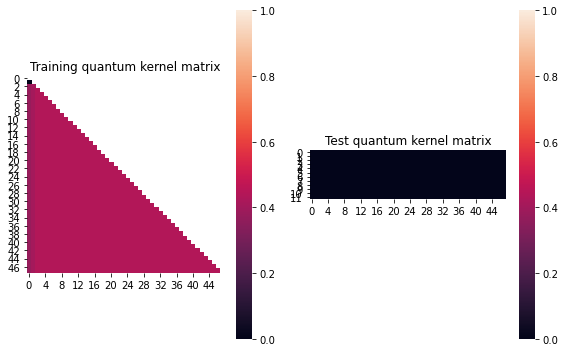


SVM with quantum kernel trained!


Test set performance:


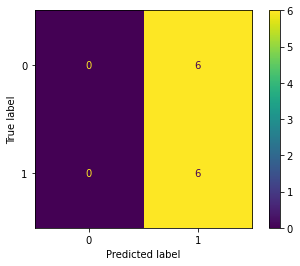

              precision    recall  f1-score   support

           0       0.00      0.00      0.00         6
           1       0.50      1.00      0.67         6

    accuracy                           0.50        12
   macro avg       0.25      0.50      0.33        12
weighted avg       0.25      0.50      0.33        12


metric 1: 0.00472005208333337
metric(s) 2: (00, 10, 11) = (0.4391276041666667, 0.43359375, 0.4375)
metric 3: 0.0


----> Kernel construction duration: 00:00:23


Combination 2/468
(Current range: 2/46)
			 reps : 1
			 paulis : ['Y']
			 entanglement : linear

Feature map:


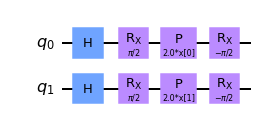


Quantum kernel matrices:



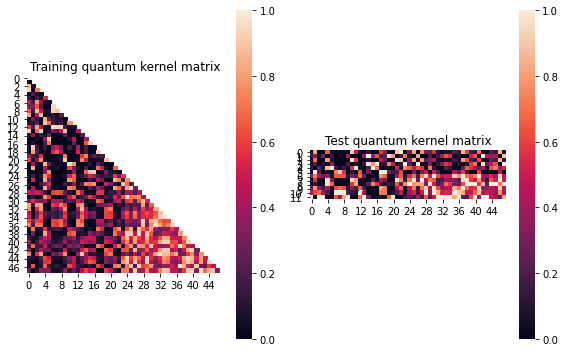


SVM with quantum kernel trained!


Test set performance:


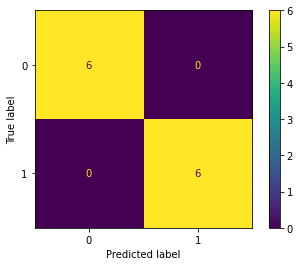

              precision    recall  f1-score   support

           0       1.00      1.00      1.00         6
           1       1.00      1.00      1.00         6

    accuracy                           1.00        12
   macro avg       1.00      1.00      1.00        12
weighted avg       1.00      1.00      1.00        12


metric 1: 0.1606525366785686
metric(s) 2: (00, 10, 11) = (0.27826916693972226, 0.2829827056871623, 0.6090013177917395)
metric 3: 1.6922e-319


----> Kernel construction duration: 00:00:28


Combination 3/468
(Current range: 3/46)
			 reps : 1
			 paulis : ['Z']
			 entanglement : linear

Feature map:


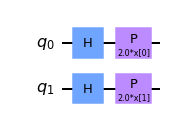


Quantum kernel matrices:



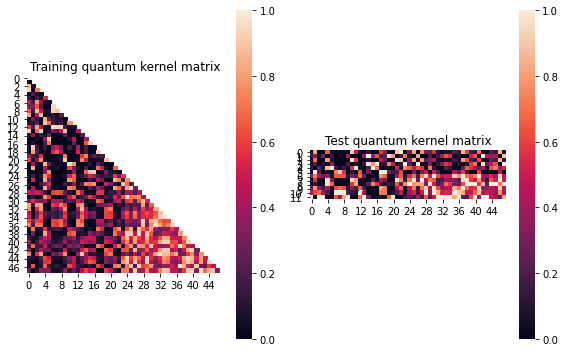


SVM with quantum kernel trained!


Test set performance:


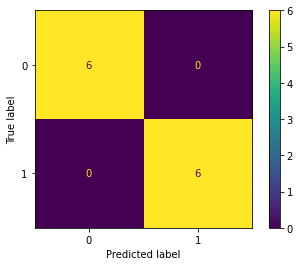

              precision    recall  f1-score   support

           0       1.00      1.00      1.00         6
           1       1.00      1.00      1.00         6

    accuracy                           1.00        12
   macro avg       1.00      1.00      1.00        12
weighted avg       1.00      1.00      1.00        12


metric 1: 0.1606525366785686
metric(s) 2: (00, 10, 11) = (0.27826916693972226, 0.2829827056871623, 0.6090013177917395)
metric 3: 1.6922e-319


----> Kernel construction duration: 00:00:28


Combination 4/468
(Current range: 4/46)
			 reps : 1
			 paulis : ['XX']
			 entanglement : linear

Feature map:


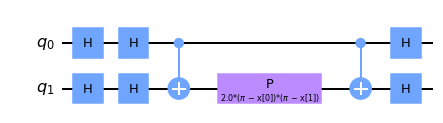


Quantum kernel matrices:



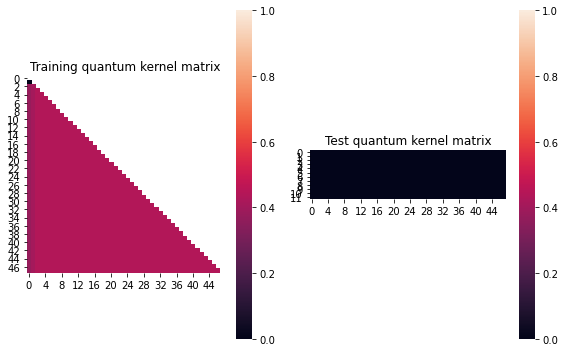


SVM with quantum kernel trained!


Test set performance:


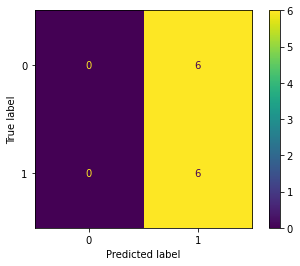

              precision    recall  f1-score   support

           0       0.00      0.00      0.00         6
           1       0.50      1.00      0.67         6

    accuracy                           0.50        12
   macro avg       0.25      0.50      0.33        12
weighted avg       0.25      0.50      0.33        12


metric 1: 0.00472005208333337
metric(s) 2: (00, 10, 11) = (0.4391276041666667, 0.43359375, 0.4375)
metric 3: 0.0


----> Kernel construction duration: 00:00:19


Combination 5/468
(Current range: 5/46)
			 reps : 1
			 paulis : ['XY']
			 entanglement : linear

Feature map:


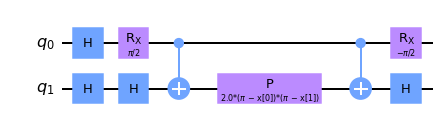


Quantum kernel matrices:



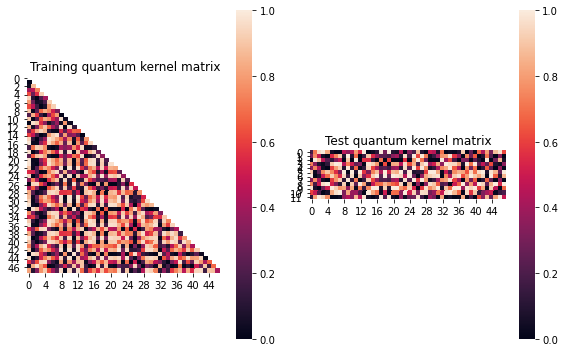


SVM with quantum kernel trained!


Test set performance:


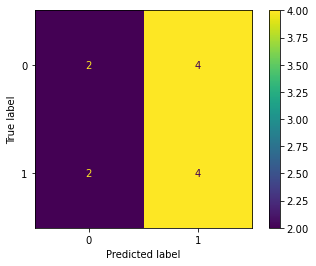

              precision    recall  f1-score   support

           0       0.50      0.33      0.40         6
           1       0.50      0.67      0.57         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.49        12
weighted avg       0.50      0.50      0.49        12


metric 1: 0.0030024471480464276
metric(s) 2: (00, 10, 11) = (0.5194729525883561, 0.5274296115848754, 0.5413911648774875)
metric 3: 0.0


----> Kernel construction duration: 00:00:32


Combination 6/468
(Current range: 6/46)
			 reps : 1
			 paulis : ['XZ']
			 entanglement : linear

Feature map:


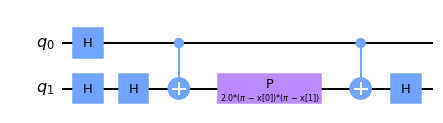


Quantum kernel matrices:



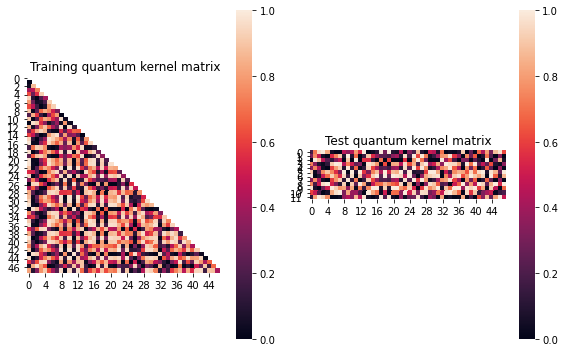


SVM with quantum kernel trained!


Test set performance:


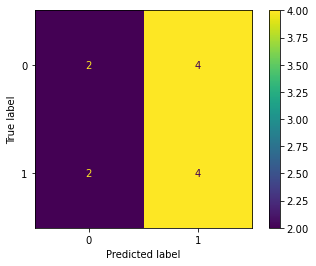

              precision    recall  f1-score   support

           0       0.50      0.33      0.40         6
           1       0.50      0.67      0.57         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.49        12
weighted avg       0.50      0.50      0.49        12


metric 1: 0.0030024471480464276
metric(s) 2: (00, 10, 11) = (0.5194729525883561, 0.5274296115848754, 0.5413911648774875)
metric 3: 0.0


----> Kernel construction duration: 00:00:31


Combination 7/468
(Current range: 7/46)
			 reps : 1
			 paulis : ['YX']
			 entanglement : linear

Feature map:


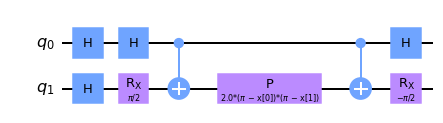


Quantum kernel matrices:



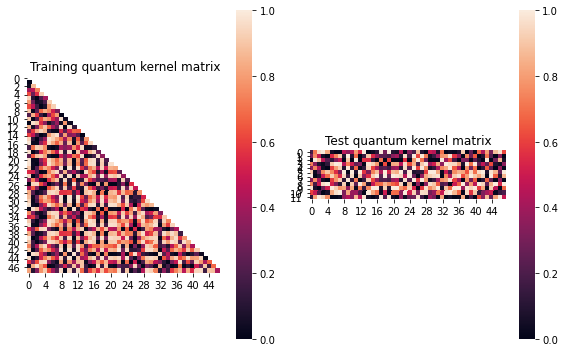


SVM with quantum kernel trained!


Test set performance:


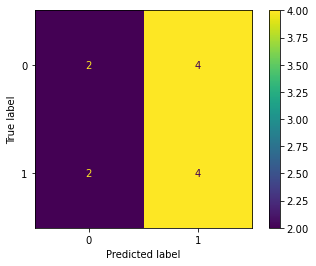

              precision    recall  f1-score   support

           0       0.50      0.33      0.40         6
           1       0.50      0.67      0.57         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.49        12
weighted avg       0.50      0.50      0.49        12


metric 1: 0.0030024471480464276
metric(s) 2: (00, 10, 11) = (0.5194729525883561, 0.5274296115848754, 0.5413911648774875)
metric 3: 0.0


----> Kernel construction duration: 00:00:32


Combination 8/468
(Current range: 8/46)
			 reps : 1
			 paulis : ['YY']
			 entanglement : linear

Feature map:


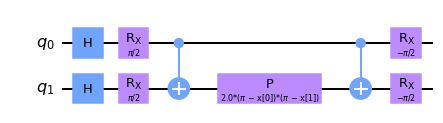


Quantum kernel matrices:



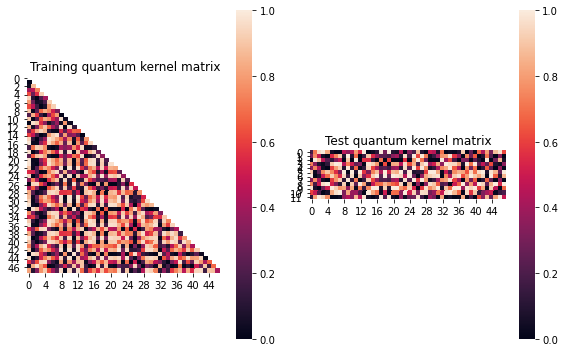


SVM with quantum kernel trained!


Test set performance:


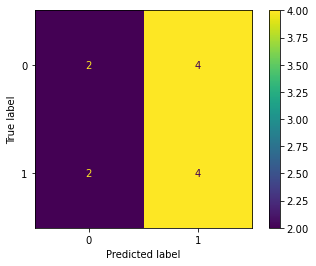

              precision    recall  f1-score   support

           0       0.50      0.33      0.40         6
           1       0.50      0.67      0.57         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.49        12
weighted avg       0.50      0.50      0.49        12


metric 1: 0.0030024471480464276
metric(s) 2: (00, 10, 11) = (0.5194729525883561, 0.5274296115848754, 0.5413911648774875)
metric 3: 0.0


----> Kernel construction duration: 00:00:44


Combination 9/468
(Current range: 9/46)
			 reps : 1
			 paulis : ['YZ']
			 entanglement : linear

Feature map:


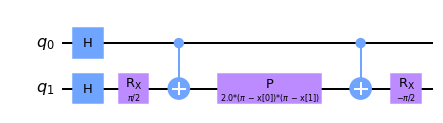


Quantum kernel matrices:



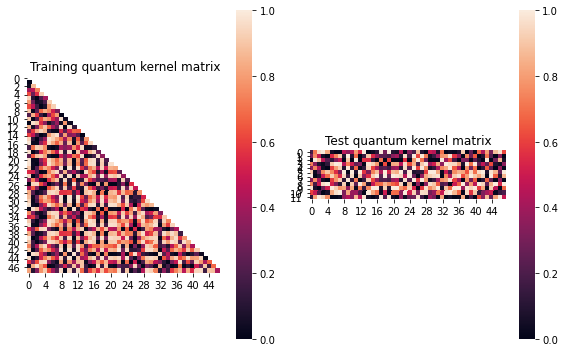


SVM with quantum kernel trained!


Test set performance:


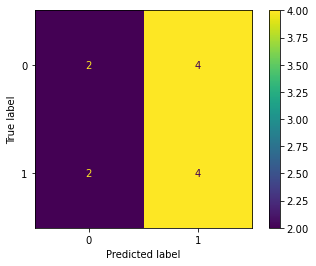

              precision    recall  f1-score   support

           0       0.50      0.33      0.40         6
           1       0.50      0.67      0.57         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.49        12
weighted avg       0.50      0.50      0.49        12


metric 1: 0.0030024471480464276
metric(s) 2: (00, 10, 11) = (0.5194729525883561, 0.5274296115848754, 0.5413911648774875)
metric 3: 0.0


----> Kernel construction duration: 00:00:43


Combination 10/468
(Current range: 10/46)
			 reps : 1
			 paulis : ['ZX']
			 entanglement : linear

Feature map:


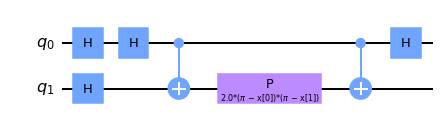


Quantum kernel matrices:



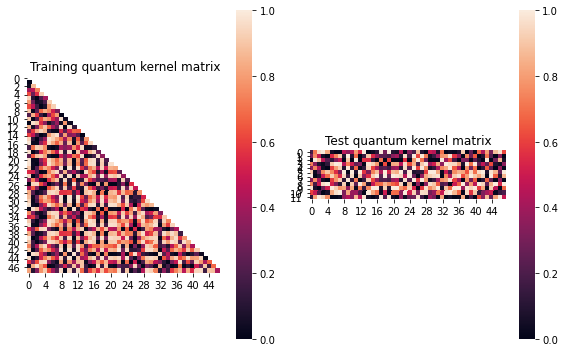


SVM with quantum kernel trained!


Test set performance:


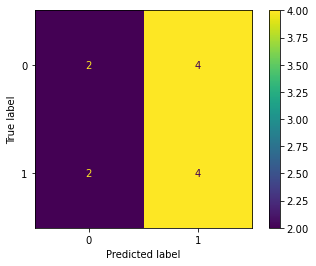

              precision    recall  f1-score   support

           0       0.50      0.33      0.40         6
           1       0.50      0.67      0.57         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.49        12
weighted avg       0.50      0.50      0.49        12


metric 1: 0.0030024471480464276
metric(s) 2: (00, 10, 11) = (0.5194729525883561, 0.5274296115848754, 0.5413911648774875)
metric 3: 0.0


----> Kernel construction duration: 00:00:31


Combination 11/468
(Current range: 11/46)
			 reps : 1
			 paulis : ['ZY']
			 entanglement : linear

Feature map:


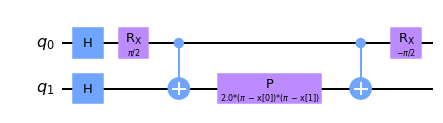


Quantum kernel matrices:



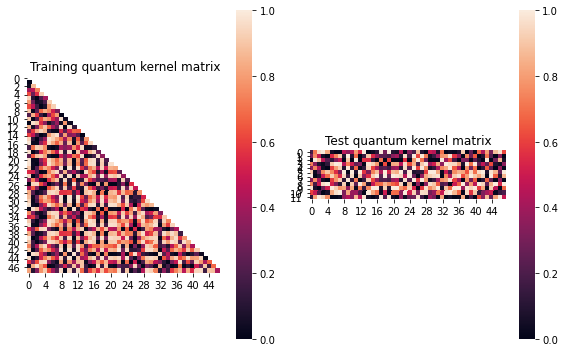


SVM with quantum kernel trained!


Test set performance:


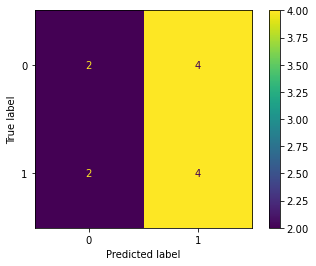

              precision    recall  f1-score   support

           0       0.50      0.33      0.40         6
           1       0.50      0.67      0.57         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.49        12
weighted avg       0.50      0.50      0.49        12


metric 1: 0.0030024471480464276
metric(s) 2: (00, 10, 11) = (0.5194729525883561, 0.5274296115848754, 0.5413911648774875)
metric 3: 0.0


----> Kernel construction duration: 00:00:43


Combination 12/468
(Current range: 12/46)
			 reps : 1
			 paulis : ['ZZ']
			 entanglement : linear

Feature map:


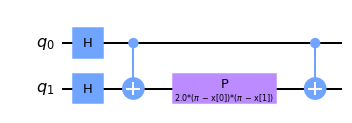


Quantum kernel matrices:



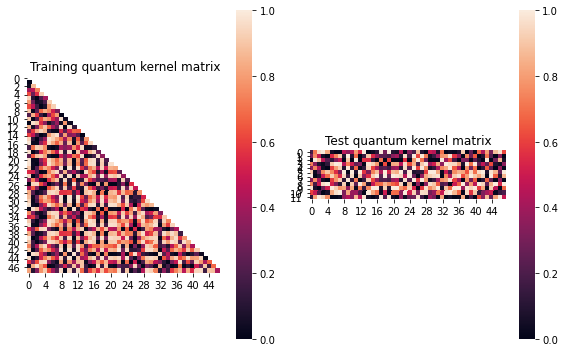


SVM with quantum kernel trained!


Test set performance:


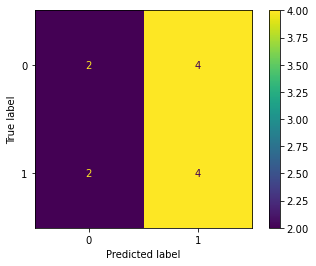

              precision    recall  f1-score   support

           0       0.50      0.33      0.40         6
           1       0.50      0.67      0.57         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.49        12
weighted avg       0.50      0.50      0.49        12


metric 1: 0.0030024471480464276
metric(s) 2: (00, 10, 11) = (0.5194729525883561, 0.5274296115848754, 0.5413911648774875)
metric 3: 0.0


----> Kernel construction duration: 00:00:42


Combination 13/468
(Current range: 13/46)
			 reps : 1
			 paulis : ['X', 'X']
			 entanglement : linear

Feature map:


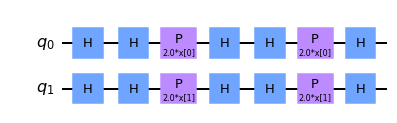


Quantum kernel matrices:



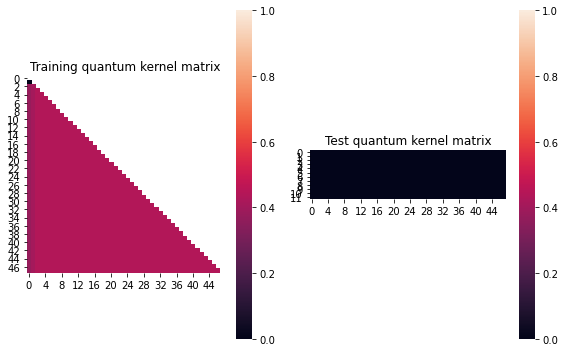


SVM with quantum kernel trained!


Test set performance:


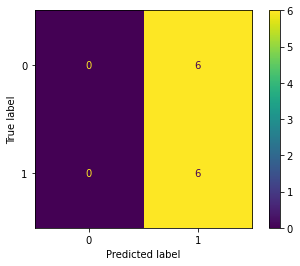

              precision    recall  f1-score   support

           0       0.00      0.00      0.00         6
           1       0.50      1.00      0.67         6

    accuracy                           0.50        12
   macro avg       0.25      0.50      0.33        12
weighted avg       0.25      0.50      0.33        12


metric 1: 0.00472005208333337
metric(s) 2: (00, 10, 11) = (0.4391276041666667, 0.43359375, 0.4375)
metric 3: 0.0


----> Kernel construction duration: 00:00:24


Combination 14/468
(Current range: 14/46)
			 reps : 1
			 paulis : ['X', 'Y']
			 entanglement : linear

Feature map:


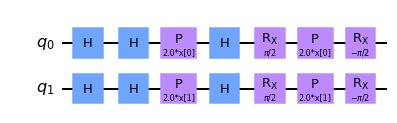


Quantum kernel matrices:



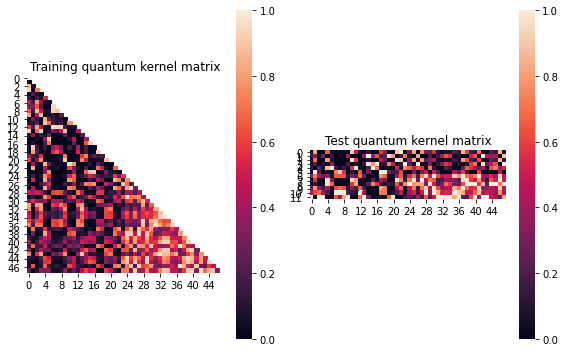


SVM with quantum kernel trained!


Test set performance:


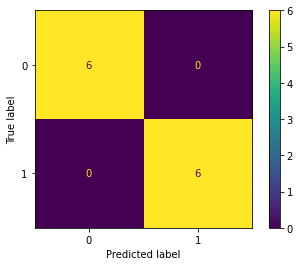

              precision    recall  f1-score   support

           0       1.00      1.00      1.00         6
           1       1.00      1.00      1.00         6

    accuracy                           1.00        12
   macro avg       1.00      1.00      1.00        12
weighted avg       1.00      1.00      1.00        12


metric 1: 0.1606525366785686
metric(s) 2: (00, 10, 11) = (0.27826916693972226, 0.2829827056871623, 0.6090013177917395)
metric 3: 1.6922e-319


----> Kernel construction duration: 00:00:29


Combination 15/468
(Current range: 15/46)
			 reps : 1
			 paulis : ['X', 'Z']
			 entanglement : linear

Feature map:


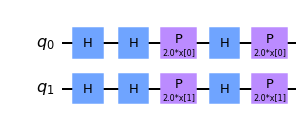


Quantum kernel matrices:



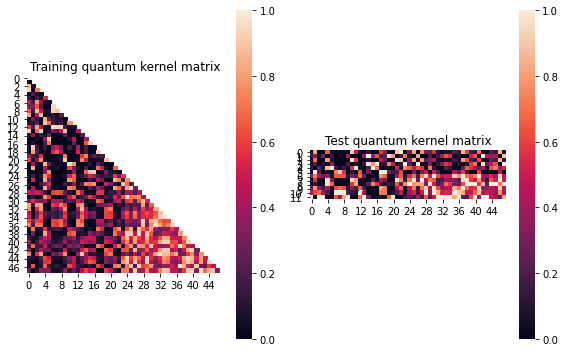


SVM with quantum kernel trained!


Test set performance:


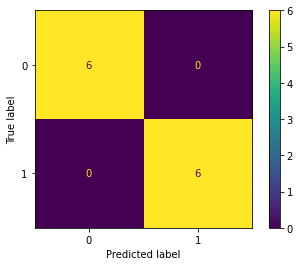

              precision    recall  f1-score   support

           0       1.00      1.00      1.00         6
           1       1.00      1.00      1.00         6

    accuracy                           1.00        12
   macro avg       1.00      1.00      1.00        12
weighted avg       1.00      1.00      1.00        12


metric 1: 0.1606525366785686
metric(s) 2: (00, 10, 11) = (0.27826916693972226, 0.2829827056871623, 0.6090013177917395)
metric 3: 1.6922e-319


----> Kernel construction duration: 00:00:30


Combination 16/468
(Current range: 16/46)
			 reps : 1
			 paulis : ['X', 'XX']
			 entanglement : linear

Feature map:


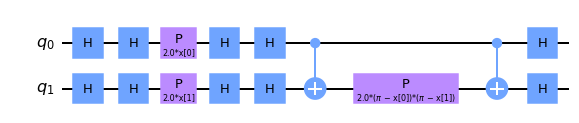


Quantum kernel matrices:



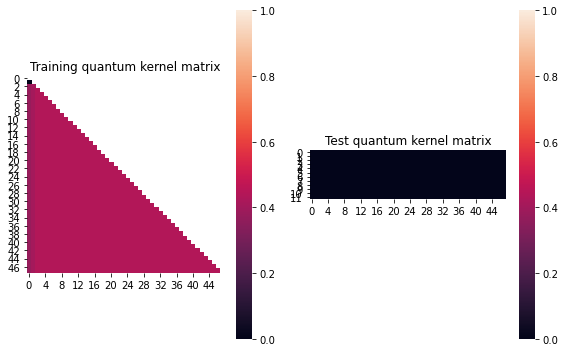


SVM with quantum kernel trained!


Test set performance:


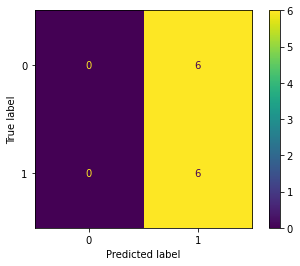

              precision    recall  f1-score   support

           0       0.00      0.00      0.00         6
           1       0.50      1.00      0.67         6

    accuracy                           0.50        12
   macro avg       0.25      0.50      0.33        12
weighted avg       0.25      0.50      0.33        12


metric 1: 0.00472005208333337
metric(s) 2: (00, 10, 11) = (0.4391276041666667, 0.43359375, 0.4375)
metric 3: 0.0


----> Kernel construction duration: 00:00:45


Combination 17/468
(Current range: 17/46)
			 reps : 1
			 paulis : ['X', 'XY']
			 entanglement : linear

Feature map:


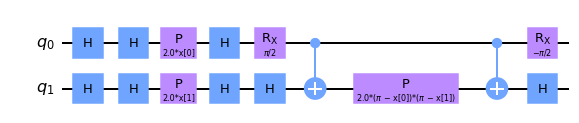


Quantum kernel matrices:



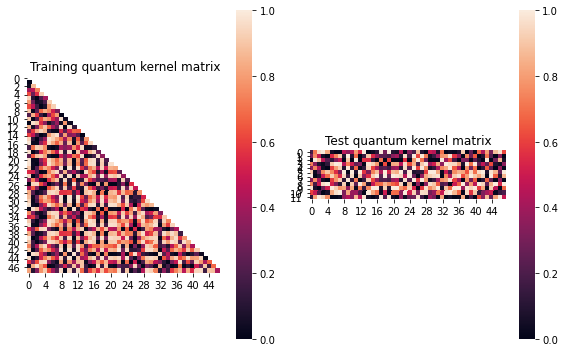


SVM with quantum kernel trained!


Test set performance:


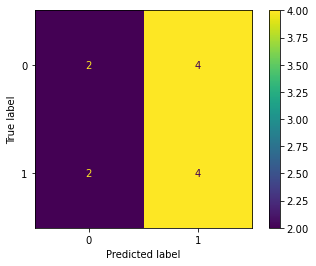

              precision    recall  f1-score   support

           0       0.50      0.33      0.40         6
           1       0.50      0.67      0.57         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.49        12
weighted avg       0.50      0.50      0.49        12


metric 1: 0.0030024471480464276
metric(s) 2: (00, 10, 11) = (0.5194729525883561, 0.5274296115848754, 0.5413911648774875)
metric 3: 0.0


----> Kernel construction duration: 00:00:47


Combination 18/468
(Current range: 18/46)
			 reps : 1
			 paulis : ['X', 'XZ']
			 entanglement : linear

Feature map:


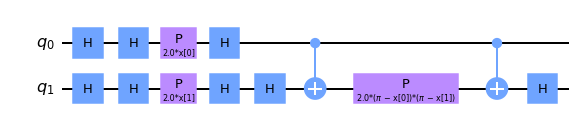


Quantum kernel matrices:



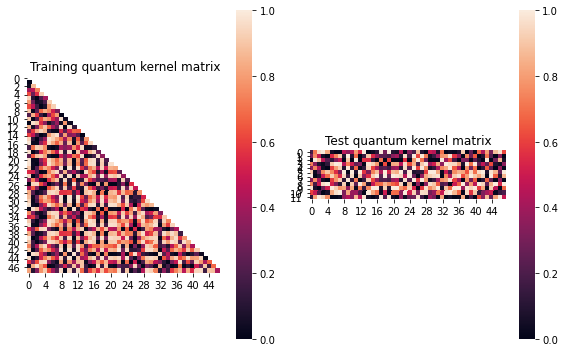


SVM with quantum kernel trained!


Test set performance:


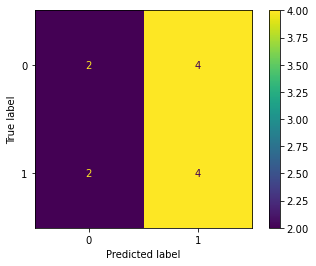

              precision    recall  f1-score   support

           0       0.50      0.33      0.40         6
           1       0.50      0.67      0.57         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.49        12
weighted avg       0.50      0.50      0.49        12


metric 1: 0.0030024471480464276
metric(s) 2: (00, 10, 11) = (0.5194729525883561, 0.5274296115848754, 0.5413911648774875)
metric 3: 0.0


----> Kernel construction duration: 00:00:44


Combination 19/468
(Current range: 19/46)
			 reps : 1
			 paulis : ['X', 'YX']
			 entanglement : linear

Feature map:


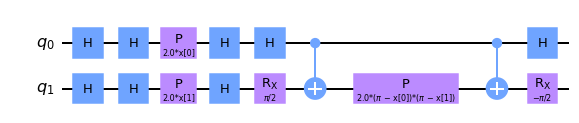


Quantum kernel matrices:



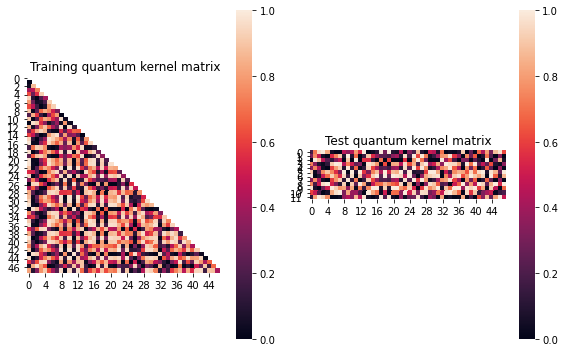


SVM with quantum kernel trained!


Test set performance:


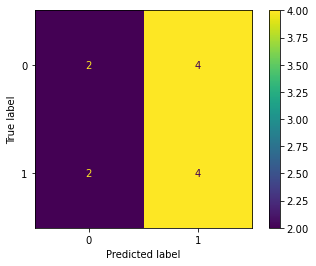

              precision    recall  f1-score   support

           0       0.50      0.33      0.40         6
           1       0.50      0.67      0.57         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.49        12
weighted avg       0.50      0.50      0.49        12


metric 1: 0.0030024471480464276
metric(s) 2: (00, 10, 11) = (0.5194729525883561, 0.5274296115848754, 0.5413911648774875)
metric 3: 0.0


----> Kernel construction duration: 00:00:44


Combination 20/468
(Current range: 20/46)
			 reps : 1
			 paulis : ['X', 'YY']
			 entanglement : linear

Feature map:


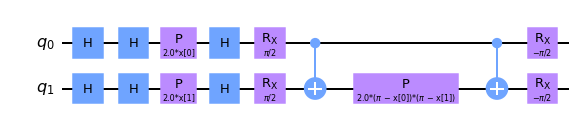


Quantum kernel matrices:



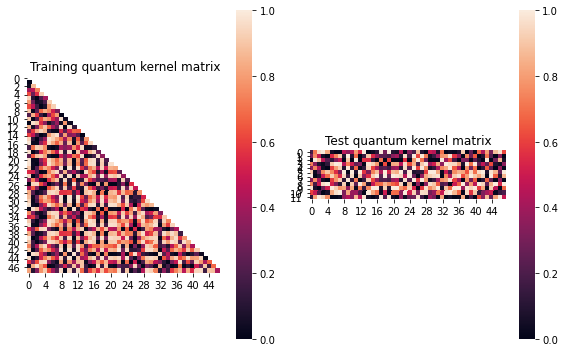


SVM with quantum kernel trained!


Test set performance:


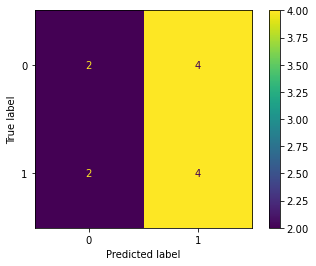

              precision    recall  f1-score   support

           0       0.50      0.33      0.40         6
           1       0.50      0.67      0.57         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.49        12
weighted avg       0.50      0.50      0.49        12


metric 1: 0.0030024471480464276
metric(s) 2: (00, 10, 11) = (0.5194729525883561, 0.5274296115848754, 0.5413911648774875)
metric 3: 0.0


----> Kernel construction duration: 00:00:45


Combination 21/468
(Current range: 21/46)
			 reps : 1
			 paulis : ['X', 'YZ']
			 entanglement : linear

Feature map:


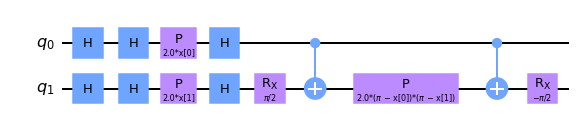


Quantum kernel matrices:



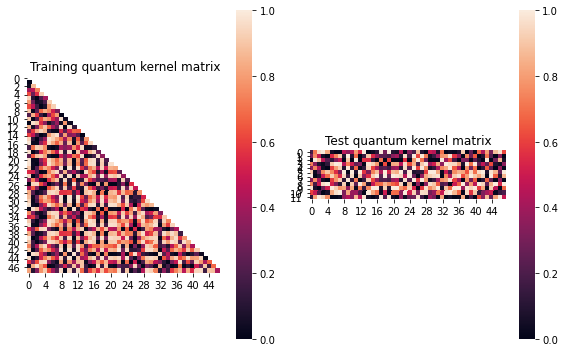


SVM with quantum kernel trained!


Test set performance:


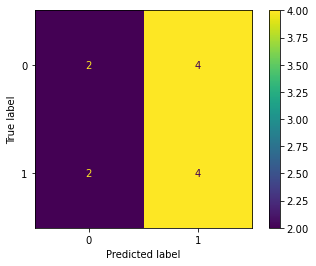

              precision    recall  f1-score   support

           0       0.50      0.33      0.40         6
           1       0.50      0.67      0.57         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.49        12
weighted avg       0.50      0.50      0.49        12


metric 1: 0.0030024471480464276
metric(s) 2: (00, 10, 11) = (0.5194729525883561, 0.5274296115848754, 0.5413911648774875)
metric 3: 0.0


----> Kernel construction duration: 00:00:47


Combination 22/468
(Current range: 22/46)
			 reps : 1
			 paulis : ['X', 'ZX']
			 entanglement : linear

Feature map:


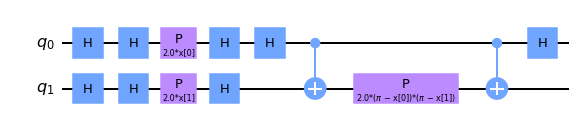


Quantum kernel matrices:



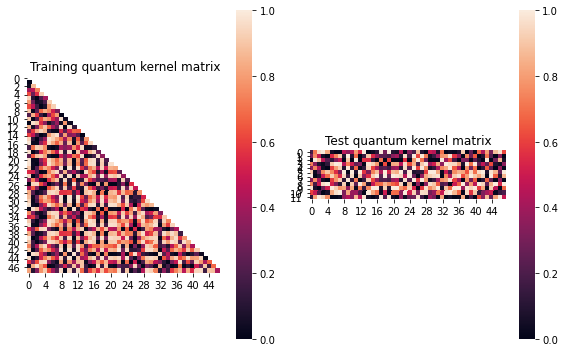


SVM with quantum kernel trained!


Test set performance:


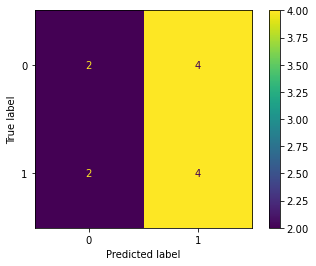

              precision    recall  f1-score   support

           0       0.50      0.33      0.40         6
           1       0.50      0.67      0.57         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.49        12
weighted avg       0.50      0.50      0.49        12


metric 1: 0.0030024471480464276
metric(s) 2: (00, 10, 11) = (0.5194729525883561, 0.5274296115848754, 0.5413911648774875)
metric 3: 0.0


----> Kernel construction duration: 00:00:44


Combination 23/468
(Current range: 23/46)
			 reps : 1
			 paulis : ['X', 'ZY']
			 entanglement : linear

Feature map:


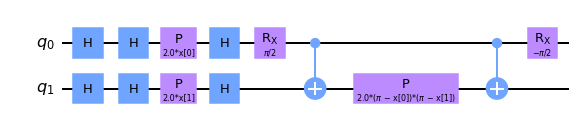


Quantum kernel matrices:



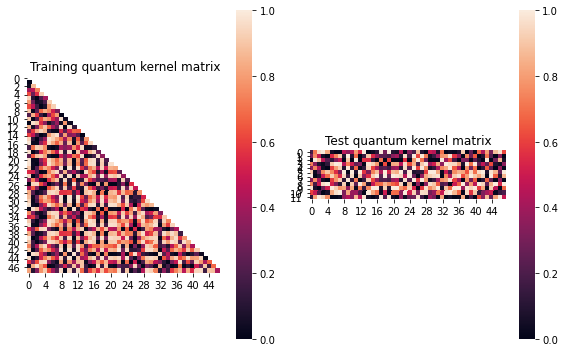


SVM with quantum kernel trained!


Test set performance:


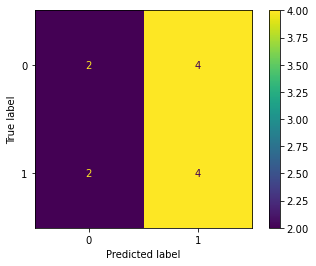

              precision    recall  f1-score   support

           0       0.50      0.33      0.40         6
           1       0.50      0.67      0.57         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.49        12
weighted avg       0.50      0.50      0.49        12


metric 1: 0.0030024471480464276
metric(s) 2: (00, 10, 11) = (0.5194729525883561, 0.5274296115848754, 0.5413911648774875)
metric 3: 0.0


----> Kernel construction duration: 00:00:46


Combination 24/468
(Current range: 24/46)
			 reps : 1
			 paulis : ['X', 'ZZ']
			 entanglement : linear

Feature map:


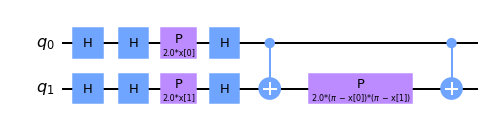


Quantum kernel matrices:



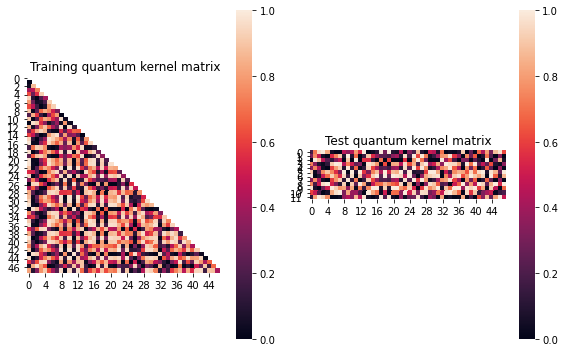


SVM with quantum kernel trained!


Test set performance:


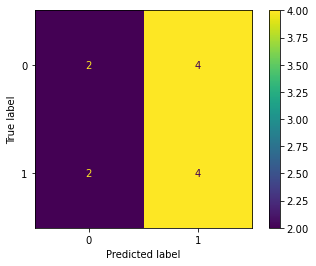

              precision    recall  f1-score   support

           0       0.50      0.33      0.40         6
           1       0.50      0.67      0.57         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.49        12
weighted avg       0.50      0.50      0.49        12


metric 1: 0.0030024471480464276
metric(s) 2: (00, 10, 11) = (0.5194729525883561, 0.5274296115848754, 0.5413911648774875)
metric 3: 0.0


----> Kernel construction duration: 00:00:45


Combination 25/468
(Current range: 25/46)
			 reps : 1
			 paulis : ['Y', 'X']
			 entanglement : linear

Feature map:


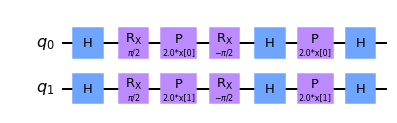


Quantum kernel matrices:



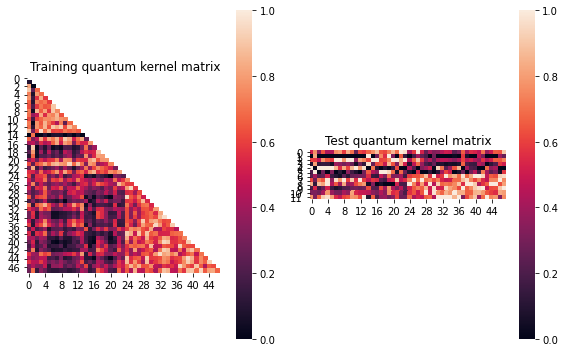


SVM with quantum kernel trained!


Test set performance:


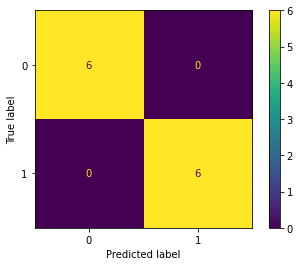

              precision    recall  f1-score   support

           0       1.00      1.00      1.00         6
           1       1.00      1.00      1.00         6

    accuracy                           1.00        12
   macro avg       1.00      1.00      1.00        12
weighted avg       1.00      1.00      1.00        12


metric 1: 0.25900545429783706
metric(s) 2: (00, 10, 11) = (0.5284495379346134, 0.339459573135221, 0.6684805169315029)
metric 3: -8.130530225039465e-283


----> Kernel construction duration: 00:00:30


Combination 26/468
(Current range: 26/46)
			 reps : 1
			 paulis : ['Y', 'Y']
			 entanglement : linear

Feature map:


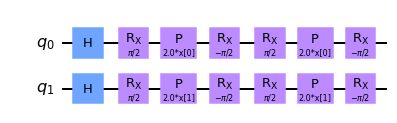


Quantum kernel matrices:



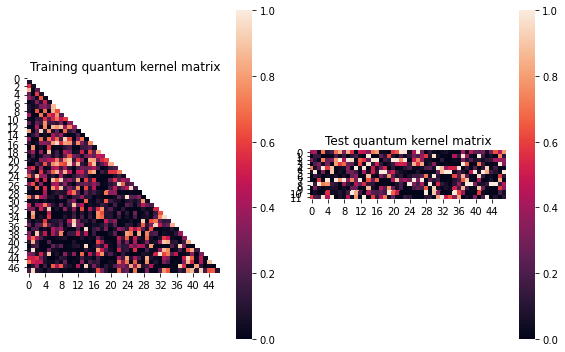


SVM with quantum kernel trained!


Test set performance:


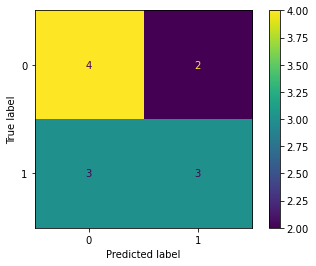

              precision    recall  f1-score   support

           0       0.57      0.67      0.62         6
           1       0.60      0.50      0.55         6

    accuracy                           0.58        12
   macro avg       0.59      0.58      0.58        12
weighted avg       0.59      0.58      0.58        12


metric 1: 0.12520236899511808
metric(s) 2: (00, 10, 11) = (0.34625427058798824, 0.19335182178741248, 0.29085411097707287)
metric 3: -3.95e-322


----> Kernel construction duration: 00:00:29


Combination 27/468
(Current range: 27/46)
			 reps : 1
			 paulis : ['Y', 'Z']
			 entanglement : linear

Feature map:


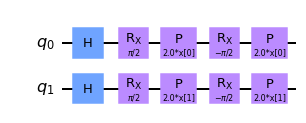


Quantum kernel matrices:



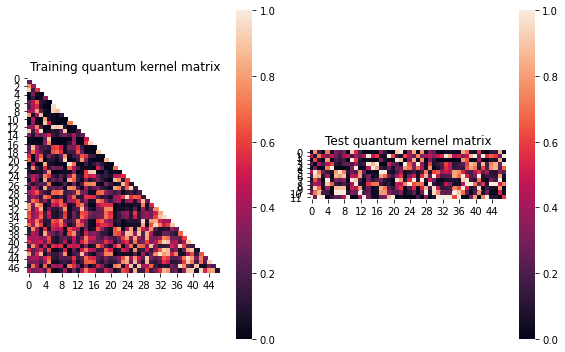


SVM with quantum kernel trained!


Test set performance:


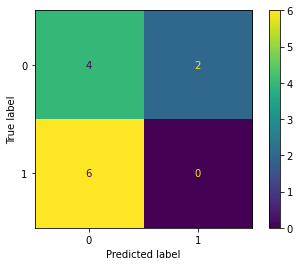

              precision    recall  f1-score   support

           0       0.40      0.67      0.50         6
           1       0.00      0.00      0.00         6

    accuracy                           0.33        12
   macro avg       0.20      0.33      0.25        12
weighted avg       0.20      0.33      0.25        12


metric 1: 0.03546741781614088
metric(s) 2: (00, 10, 11) = (0.29106435951677617, 0.3358221524566004, 0.4515147810287064)
metric 3: 1.5938308619759796e-286


----> Kernel construction duration: 00:00:30


Combination 28/468
(Current range: 28/46)
			 reps : 1
			 paulis : ['Y', 'XX']
			 entanglement : linear

Feature map:


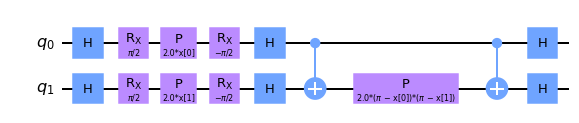


Quantum kernel matrices:



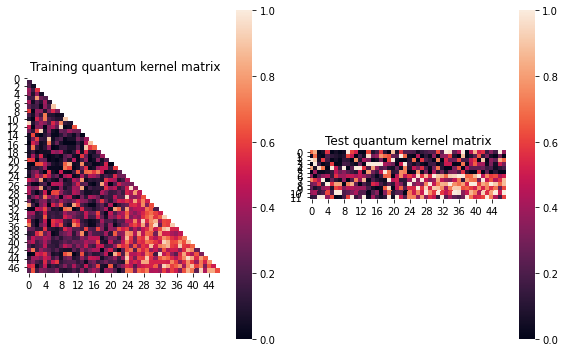


SVM with quantum kernel trained!


Test set performance:


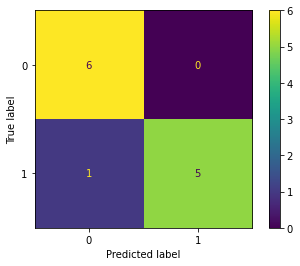

              precision    recall  f1-score   support

           0       0.86      1.00      0.92         6
           1       1.00      0.83      0.91         6

    accuracy                           0.92        12
   macro avg       0.93      0.92      0.92        12
weighted avg       0.93      0.92      0.92        12


metric 1: 0.16221324548054783
metric(s) 2: (00, 10, 11) = (0.27792450887534415, 0.27560443594662526, 0.597710853979002)
metric 3: -1.2818402525071313e-271


----> Kernel construction duration: 00:00:52


Combination 29/468
(Current range: 29/46)
			 reps : 1
			 paulis : ['Y', 'XY']
			 entanglement : linear

Feature map:


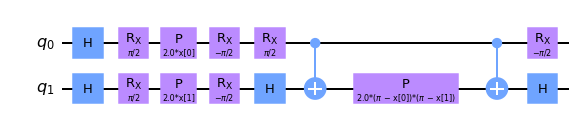


Quantum kernel matrices:



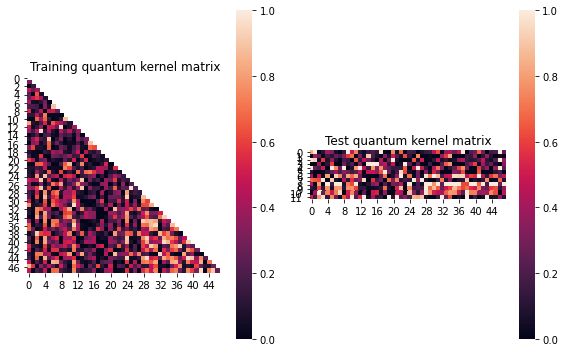


SVM with quantum kernel trained!


Test set performance:


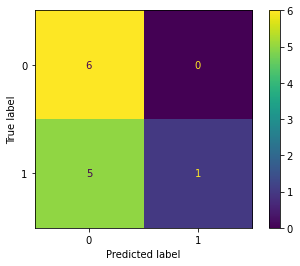

              precision    recall  f1-score   support

           0       0.55      1.00      0.71         6
           1       1.00      0.17      0.29         6

    accuracy                           0.58        12
   macro avg       0.77      0.58      0.50        12
weighted avg       0.77      0.58      0.50        12


metric 1: 0.08099054177371473
metric(s) 2: (00, 10, 11) = (0.27159813434094393, 0.277052368532883, 0.4444876862722516)
metric 3: 1.1824024e-317


----> Kernel construction duration: 00:00:49


Combination 30/468
(Current range: 30/46)
			 reps : 1
			 paulis : ['Y', 'XZ']
			 entanglement : linear

Feature map:


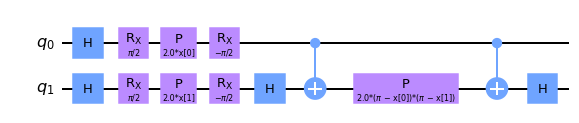


Quantum kernel matrices:



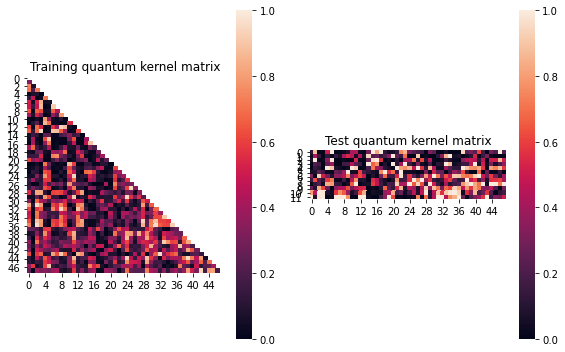


SVM with quantum kernel trained!


Test set performance:


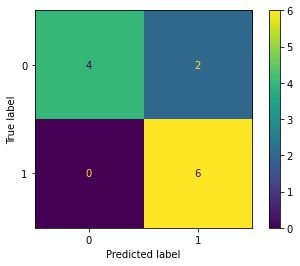

              precision    recall  f1-score   support

           0       1.00      0.67      0.80         6
           1       0.75      1.00      0.86         6

    accuracy                           0.83        12
   macro avg       0.88      0.83      0.83        12
weighted avg       0.88      0.83      0.83        12


metric 1: 0.061590829840625916
metric(s) 2: (00, 10, 11) = (0.27895739771197786, 0.28728491424536307, 0.4187940904600001)
metric 3: 1.0751305459520794e-286


----> Kernel construction duration: 00:00:51


Combination 31/468
(Current range: 31/46)
			 reps : 1
			 paulis : ['Y', 'YX']
			 entanglement : linear

Feature map:


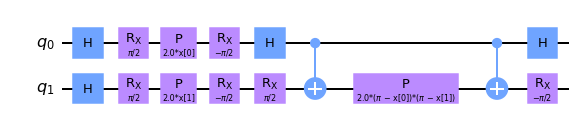


Quantum kernel matrices:



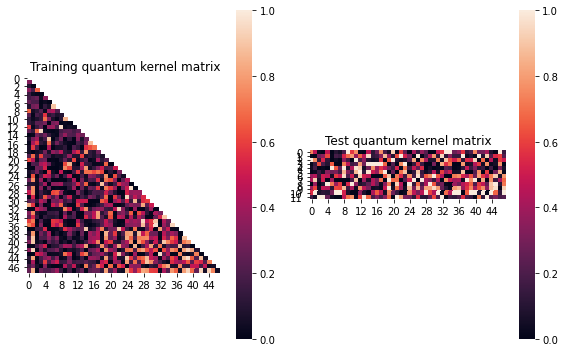


SVM with quantum kernel trained!


Test set performance:


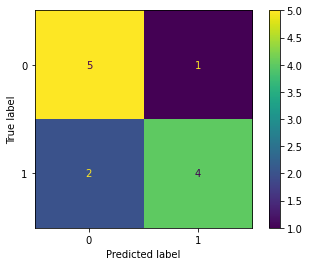

              precision    recall  f1-score   support

           0       0.71      0.83      0.77         6
           1       0.80      0.67      0.73         6

    accuracy                           0.75        12
   macro avg       0.76      0.75      0.75        12
weighted avg       0.76      0.75      0.75        12


metric 1: 0.09622790469908629
metric(s) 2: (00, 10, 11) = (0.25688915152691055, 0.24926374170071394, 0.4340941412726899)
metric 3: 9.064616213114092e-304


----> Kernel construction duration: 00:00:48


Combination 32/468
(Current range: 32/46)
			 reps : 1
			 paulis : ['Y', 'YY']
			 entanglement : linear

Feature map:


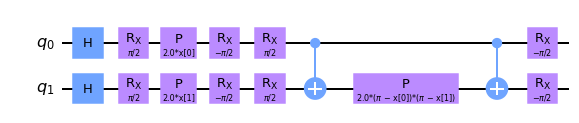


Quantum kernel matrices:



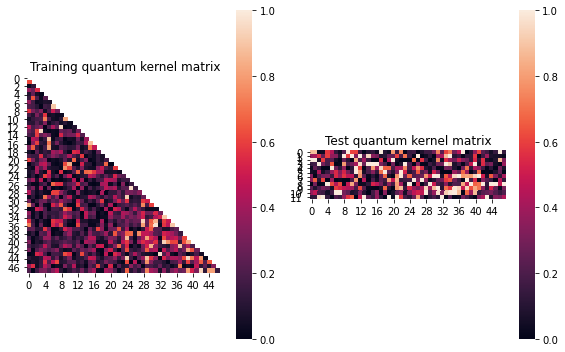


SVM with quantum kernel trained!


Test set performance:


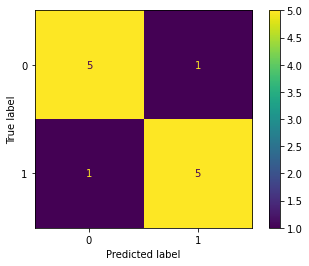

              precision    recall  f1-score   support

           0       0.83      0.83      0.83         6
           1       0.83      0.83      0.83         6

    accuracy                           0.83        12
   macro avg       0.83      0.83      0.83        12
weighted avg       0.83      0.83      0.83        12


metric 1: 0.1045473502897318
metric(s) 2: (00, 10, 11) = (0.26357271453930053, 0.21214886155599652, 0.3698197091521561)
metric 3: 2.3512872618074066e-286


----> Kernel construction duration: 00:00:45


Combination 33/468
(Current range: 33/46)
			 reps : 1
			 paulis : ['Y', 'YZ']
			 entanglement : linear

Feature map:


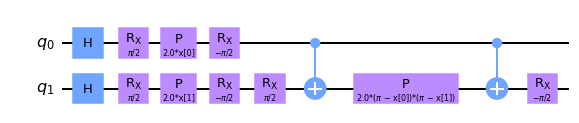


Quantum kernel matrices:



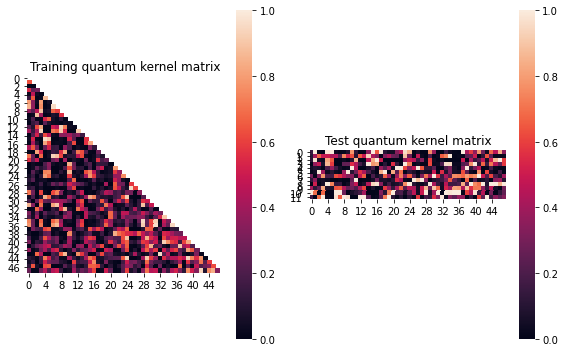


SVM with quantum kernel trained!


Test set performance:


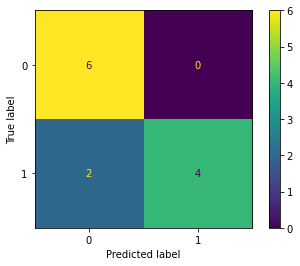

              precision    recall  f1-score   support

           0       0.75      1.00      0.86         6
           1       1.00      0.67      0.80         6

    accuracy                           0.83        12
   macro avg       0.88      0.83      0.83        12
weighted avg       0.88      0.83      0.83        12


metric 1: 0.09439071721471912
metric(s) 2: (00, 10, 11) = (0.285730369371076, 0.23009170559309414, 0.3632344762445505)
metric 3: -5.445674857475683e-304


----> Kernel construction duration: 00:00:48


Combination 34/468
(Current range: 34/46)
			 reps : 1
			 paulis : ['Y', 'ZX']
			 entanglement : linear

Feature map:


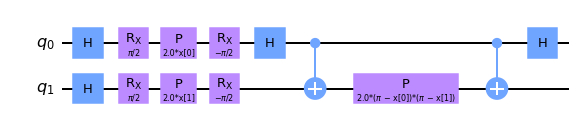


Quantum kernel matrices:



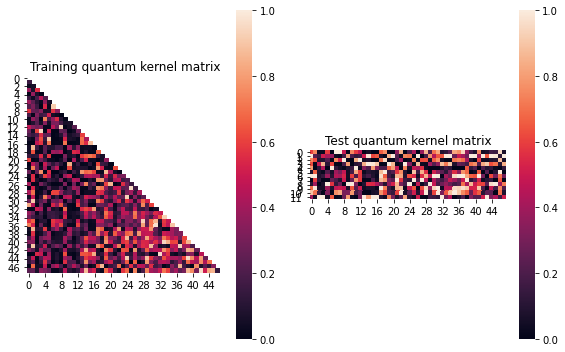


SVM with quantum kernel trained!


Test set performance:


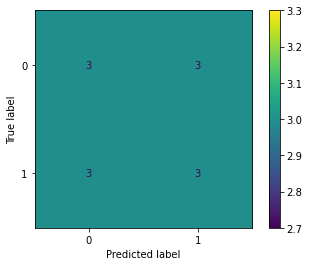

              precision    recall  f1-score   support

           0       0.50      0.50      0.50         6
           1       0.50      0.50      0.50         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.50        12
weighted avg       0.50      0.50      0.50        12


metric 1: 0.08963398434762232
metric(s) 2: (00, 10, 11) = (0.26312667801040135, 0.26012719560862746, 0.4363956819020982)
metric 3: 1.9497599571130227e-287


----> Kernel construction duration: 00:00:52


Combination 35/468
(Current range: 35/46)
			 reps : 1
			 paulis : ['Y', 'ZY']
			 entanglement : linear

Feature map:


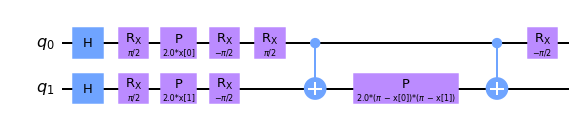


Quantum kernel matrices:



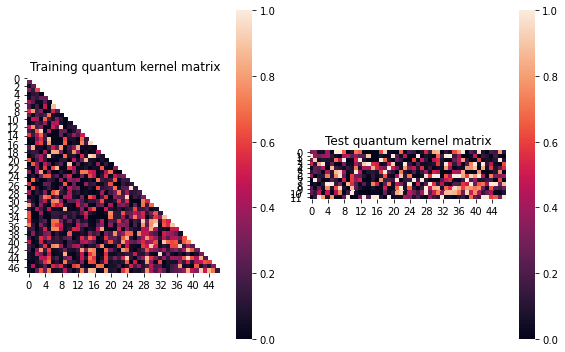


SVM with quantum kernel trained!


Test set performance:


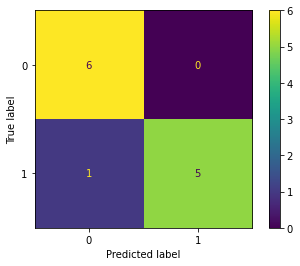

              precision    recall  f1-score   support

           0       0.86      1.00      0.92         6
           1       1.00      0.83      0.91         6

    accuracy                           0.92        12
   macro avg       0.93      0.92      0.92        12
weighted avg       0.93      0.92      0.92        12


metric 1: 0.08918248993507344
metric(s) 2: (00, 10, 11) = (0.2706799211478452, 0.22969172966844426, 0.36706851805919016)
metric 3: 4.0794046010838765e-307


----> Kernel construction duration: 00:00:48


Combination 36/468
(Current range: 36/46)
			 reps : 1
			 paulis : ['Y', 'ZZ']
			 entanglement : linear

Feature map:


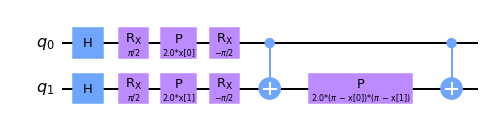


Quantum kernel matrices:



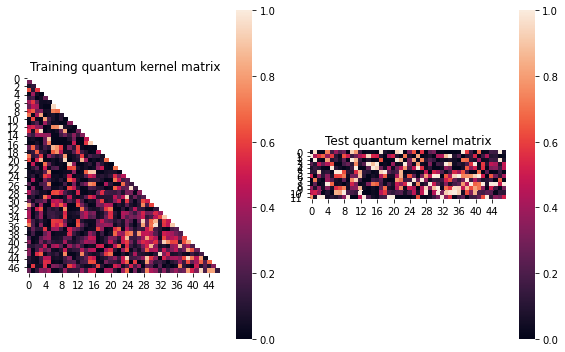


SVM with quantum kernel trained!


Test set performance:


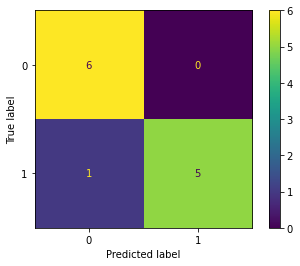

              precision    recall  f1-score   support

           0       0.86      1.00      0.92         6
           1       1.00      0.83      0.91         6

    accuracy                           0.92        12
   macro avg       0.93      0.92      0.92        12
weighted avg       0.93      0.92      0.92        12


metric 1: 0.09934772334211789
metric(s) 2: (00, 10, 11) = (0.26349062996218237, 0.21787317088458086, 0.37095115849121507)
metric 3: -2.100136572546303e-273


----> Kernel construction duration: 00:00:50


Combination 37/468
(Current range: 37/46)
			 reps : 1
			 paulis : ['Z', 'X']
			 entanglement : linear

Feature map:


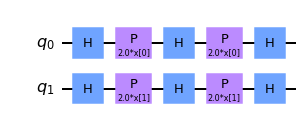


Quantum kernel matrices:



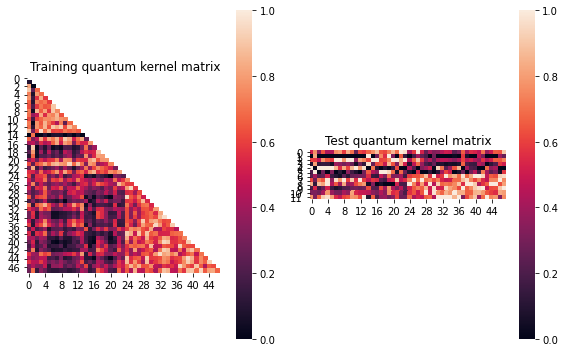


SVM with quantum kernel trained!


Test set performance:


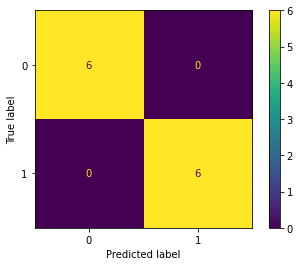

              precision    recall  f1-score   support

           0       1.00      1.00      1.00         6
           1       1.00      1.00      1.00         6

    accuracy                           1.00        12
   macro avg       1.00      1.00      1.00        12
weighted avg       1.00      1.00      1.00        12


metric 1: 0.25900545429783706
metric(s) 2: (00, 10, 11) = (0.5284495379346134, 0.339459573135221, 0.6684805169315029)
metric 3: -8.130530225039465e-283


----> Kernel construction duration: 00:00:30


Combination 38/468
(Current range: 38/46)
			 reps : 1
			 paulis : ['Z', 'Y']
			 entanglement : linear

Feature map:


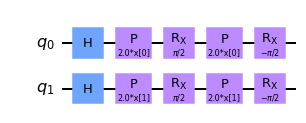


Quantum kernel matrices:



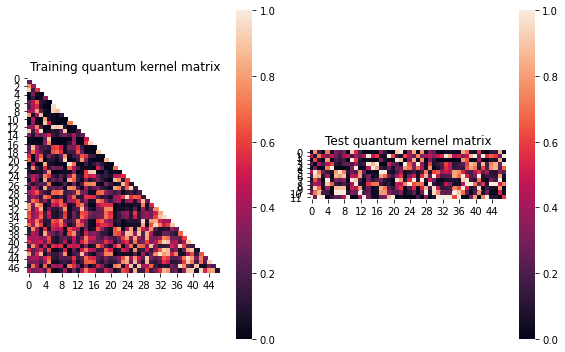


SVM with quantum kernel trained!


Test set performance:


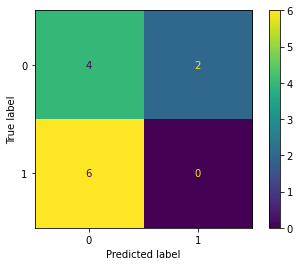

              precision    recall  f1-score   support

           0       0.40      0.67      0.50         6
           1       0.00      0.00      0.00         6

    accuracy                           0.33        12
   macro avg       0.20      0.33      0.25        12
weighted avg       0.20      0.33      0.25        12


metric 1: 0.03546741781614088
metric(s) 2: (00, 10, 11) = (0.29106435951677617, 0.3358221524566004, 0.4515147810287064)
metric 3: 1.5938308619759796e-286


----> Kernel construction duration: 00:00:30


Combination 39/468
(Current range: 39/46)
			 reps : 1
			 paulis : ['Z', 'Z']
			 entanglement : linear

Feature map:


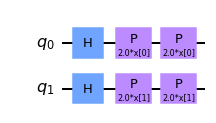


Quantum kernel matrices:



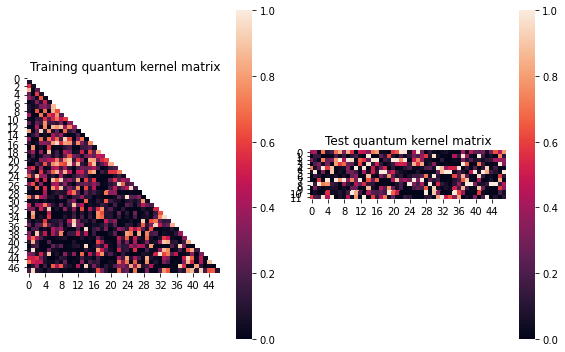


SVM with quantum kernel trained!


Test set performance:


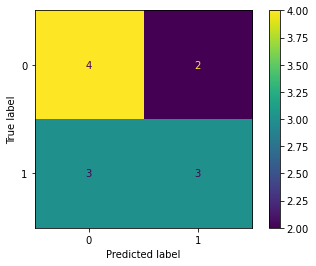

              precision    recall  f1-score   support

           0       0.57      0.67      0.62         6
           1       0.60      0.50      0.55         6

    accuracy                           0.58        12
   macro avg       0.59      0.58      0.58        12
weighted avg       0.59      0.58      0.58        12


metric 1: 0.12520236899511808
metric(s) 2: (00, 10, 11) = (0.34625427058798824, 0.19335182178741248, 0.29085411097707287)
metric 3: -3.95e-322


----> Kernel construction duration: 00:00:29


Combination 40/468
(Current range: 40/46)
			 reps : 1
			 paulis : ['Z', 'XX']
			 entanglement : linear

Feature map:


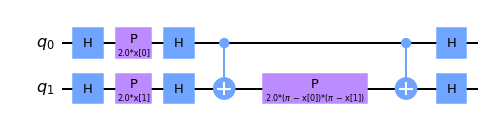


Quantum kernel matrices:



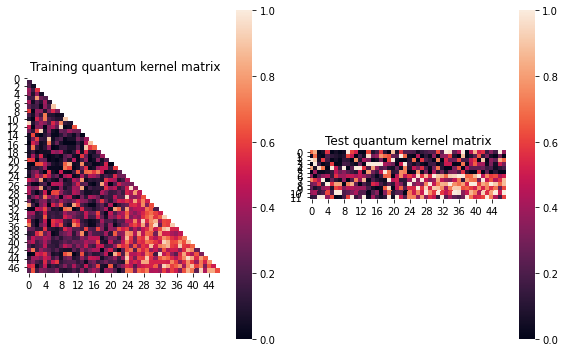


SVM with quantum kernel trained!


Test set performance:


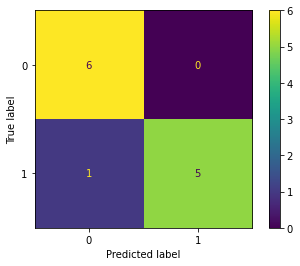

              precision    recall  f1-score   support

           0       0.86      1.00      0.92         6
           1       1.00      0.83      0.91         6

    accuracy                           0.92        12
   macro avg       0.93      0.92      0.92        12
weighted avg       0.93      0.92      0.92        12


metric 1: 0.16221324548054783
metric(s) 2: (00, 10, 11) = (0.27792450887534415, 0.27560443594662526, 0.597710853979002)
metric 3: -1.2818402525071313e-271


----> Kernel construction duration: 00:00:52


Combination 41/468
(Current range: 41/46)
			 reps : 1
			 paulis : ['Z', 'XY']
			 entanglement : linear

Feature map:


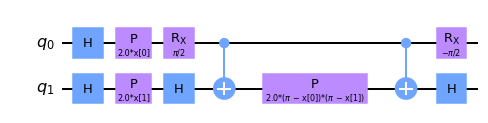


Quantum kernel matrices:



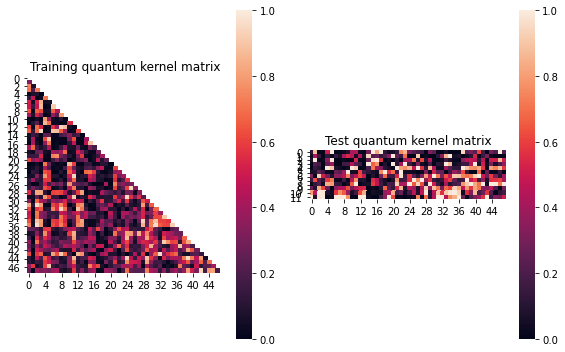


SVM with quantum kernel trained!


Test set performance:


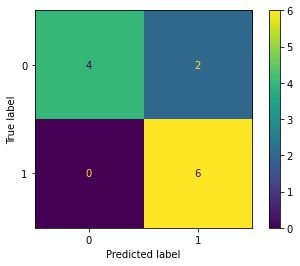

              precision    recall  f1-score   support

           0       1.00      0.67      0.80         6
           1       0.75      1.00      0.86         6

    accuracy                           0.83        12
   macro avg       0.88      0.83      0.83        12
weighted avg       0.88      0.83      0.83        12


metric 1: 0.061590829840625916
metric(s) 2: (00, 10, 11) = (0.27895739771197786, 0.28728491424536307, 0.4187940904600001)
metric 3: 1.0751305459520794e-286


----> Kernel construction duration: 00:00:51


Combination 42/468
(Current range: 42/46)
			 reps : 1
			 paulis : ['Z', 'XZ']
			 entanglement : linear

Feature map:


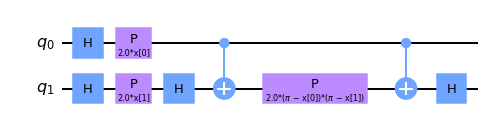


Quantum kernel matrices:



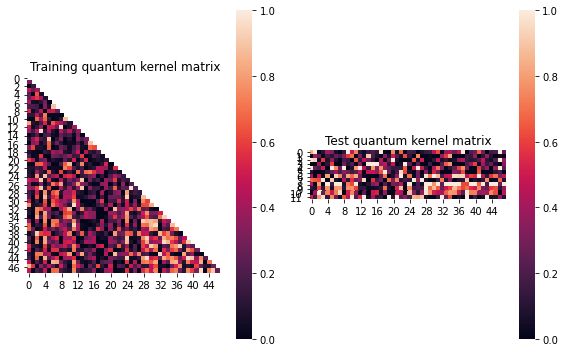


SVM with quantum kernel trained!


Test set performance:


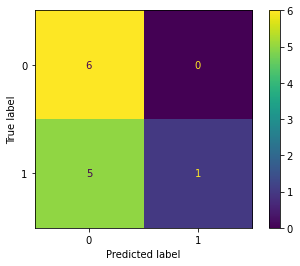

              precision    recall  f1-score   support

           0       0.55      1.00      0.71         6
           1       1.00      0.17      0.29         6

    accuracy                           0.58        12
   macro avg       0.77      0.58      0.50        12
weighted avg       0.77      0.58      0.50        12


metric 1: 0.08099054177371473
metric(s) 2: (00, 10, 11) = (0.27159813434094393, 0.277052368532883, 0.4444876862722516)
metric 3: 1.1824024e-317


----> Kernel construction duration: 00:00:49


Combination 43/468
(Current range: 43/46)
			 reps : 1
			 paulis : ['Z', 'YX']
			 entanglement : linear

Feature map:


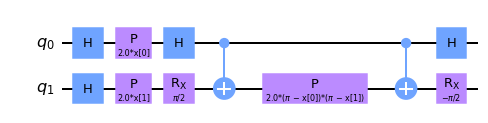


Quantum kernel matrices:



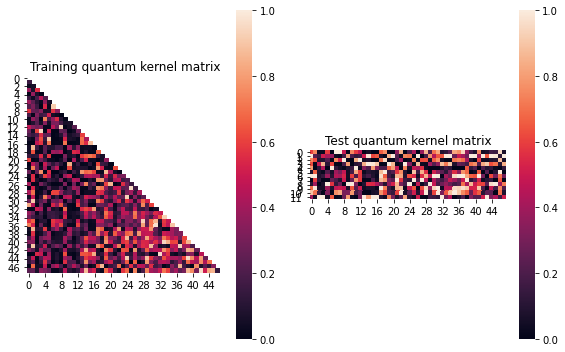


SVM with quantum kernel trained!


Test set performance:


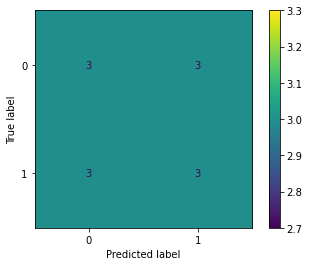

              precision    recall  f1-score   support

           0       0.50      0.50      0.50         6
           1       0.50      0.50      0.50         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.50        12
weighted avg       0.50      0.50      0.50        12


metric 1: 0.08963398434762232
metric(s) 2: (00, 10, 11) = (0.26312667801040135, 0.26012719560862746, 0.4363956819020982)
metric 3: 1.9497599571130227e-287


----> Kernel construction duration: 00:00:51


Combination 44/468
(Current range: 44/46)
			 reps : 1
			 paulis : ['Z', 'YY']
			 entanglement : linear

Feature map:


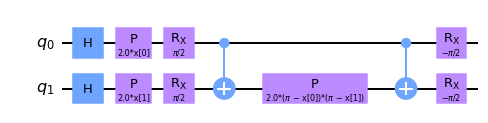


Quantum kernel matrices:



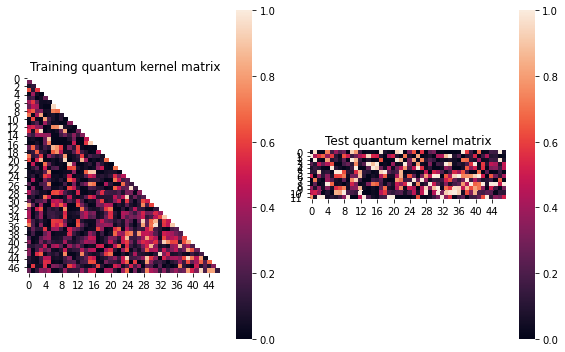


SVM with quantum kernel trained!


Test set performance:


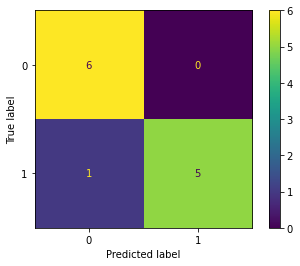

              precision    recall  f1-score   support

           0       0.86      1.00      0.92         6
           1       1.00      0.83      0.91         6

    accuracy                           0.92        12
   macro avg       0.93      0.92      0.92        12
weighted avg       0.93      0.92      0.92        12


metric 1: 0.09934772334211789
metric(s) 2: (00, 10, 11) = (0.26349062996218237, 0.21787317088458086, 0.37095115849121507)
metric 3: -2.100136572546303e-273


----> Kernel construction duration: 00:00:51


Combination 45/468
(Current range: 45/46)
			 reps : 1
			 paulis : ['Z', 'YZ']
			 entanglement : linear

Feature map:


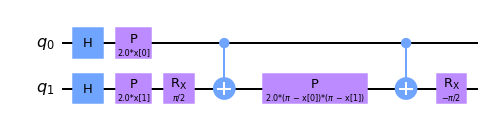


Quantum kernel matrices:



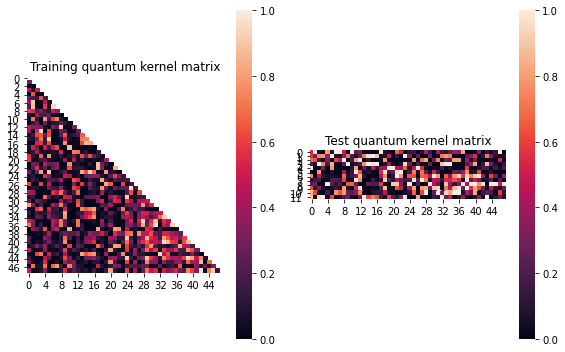


SVM with quantum kernel trained!


Test set performance:


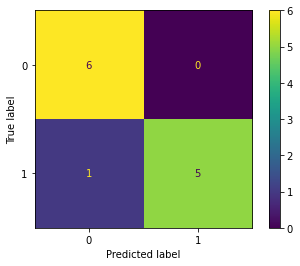

              precision    recall  f1-score   support

           0       0.86      1.00      0.92         6
           1       1.00      0.83      0.91         6

    accuracy                           0.92        12
   macro avg       0.93      0.92      0.92        12
weighted avg       0.93      0.92      0.92        12


metric 1: 0.12930013707564444
metric(s) 2: (00, 10, 11) = (0.279678434708808, 0.20373342295628585, 0.38638868535505266)
metric 3: -5.869602520561466e-293


----> Kernel construction duration: 00:00:49


Combination 46/468
(Current range: 46/46)
			 reps : 1
			 paulis : ['Z', 'ZX']
			 entanglement : linear

Feature map:


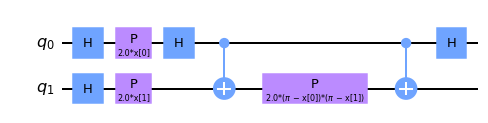


Quantum kernel matrices:



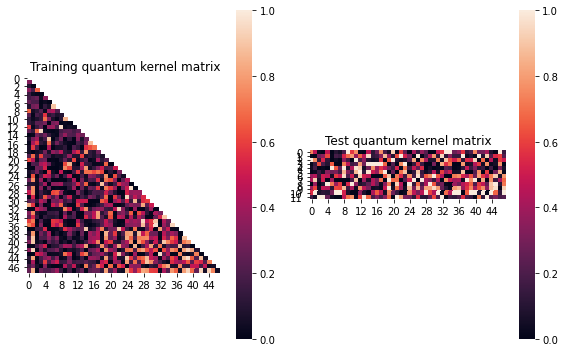


SVM with quantum kernel trained!


Test set performance:


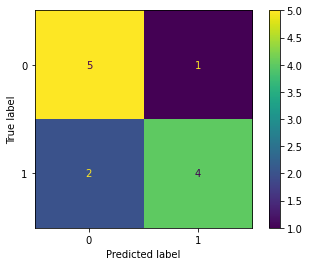

              precision    recall  f1-score   support

           0       0.71      0.83      0.77         6
           1       0.80      0.67      0.73         6

    accuracy                           0.75        12
   macro avg       0.76      0.75      0.75        12
weighted avg       0.76      0.75      0.75        12


metric 1: 0.09622790469908629
metric(s) 2: (00, 10, 11) = (0.25688915152691055, 0.24926374170071394, 0.4340941412726899)
metric 3: 9.064616213114092e-304


----> Kernel construction duration: 00:00:49


In [13]:
j=0
results.append(run_kernel_evaluation(X, X_train, y_train, X_test, y_test,
                                      param_grid, range_list, j, model=True))



Combination 47/468
(Current range: 1/46)
			 reps : 1
			 paulis : ['Z', 'ZY']
			 entanglement : linear

Feature map:


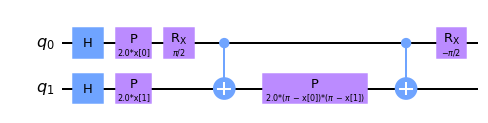


Quantum kernel matrices:



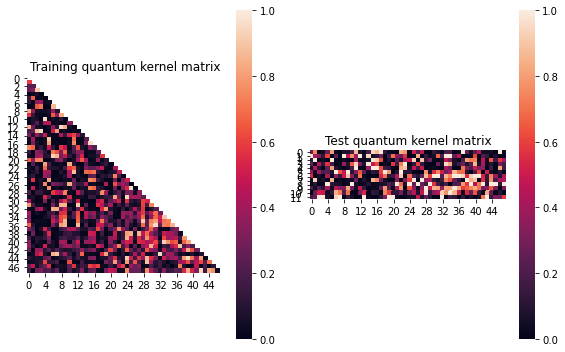


SVM with quantum kernel trained!


Test set performance:


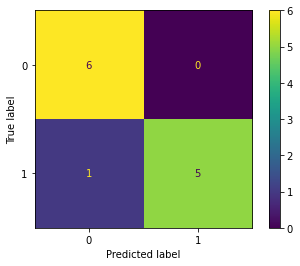

              precision    recall  f1-score   support

           0       0.86      1.00      0.92         6
           1       1.00      0.83      0.91         6

    accuracy                           0.92        12
   macro avg       0.93      0.92      0.92        12
weighted avg       0.93      0.92      0.92        12


metric 1: 0.12314061174845378
metric(s) 2: (00, 10, 11) = (0.2661576529999754, 0.2040790287520766, 0.38828162800108534)
metric 3: -5.34799899304558e-304


----> Kernel construction duration: 00:00:49


Combination 48/468
(Current range: 2/46)
			 reps : 1
			 paulis : ['Z', 'ZZ']
			 entanglement : linear

Feature map:


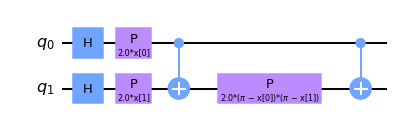


Quantum kernel matrices:



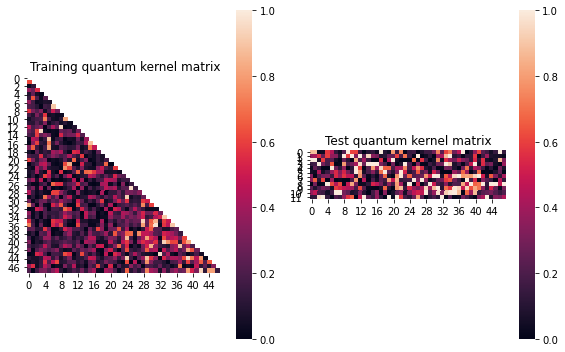


SVM with quantum kernel trained!


Test set performance:


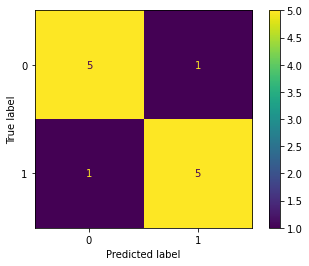

              precision    recall  f1-score   support

           0       0.83      0.83      0.83         6
           1       0.83      0.83      0.83         6

    accuracy                           0.83        12
   macro avg       0.83      0.83      0.83        12
weighted avg       0.83      0.83      0.83        12


metric 1: 0.1045473502897318
metric(s) 2: (00, 10, 11) = (0.26357271453930053, 0.21214886155599652, 0.3698197091521561)
metric 3: 2.3512872618074066e-286


----> Kernel construction duration: 00:00:45


Combination 49/468
(Current range: 3/46)
			 reps : 1
			 paulis : ['XX', 'X']
			 entanglement : linear

Feature map:


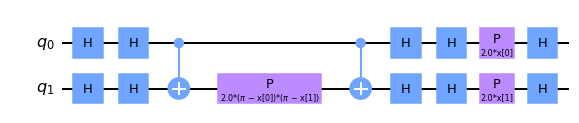


Quantum kernel matrices:



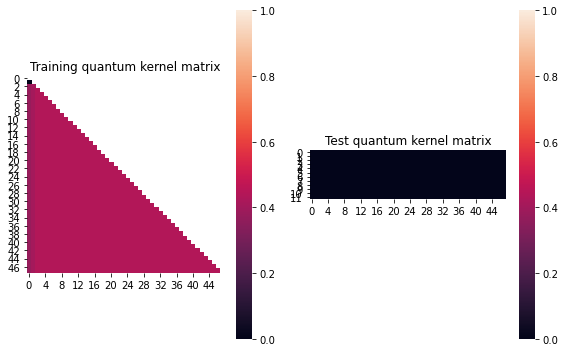


SVM with quantum kernel trained!


Test set performance:


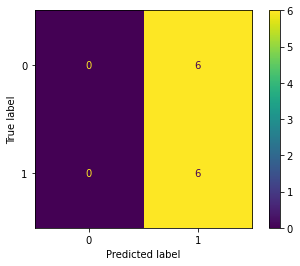

              precision    recall  f1-score   support

           0       0.00      0.00      0.00         6
           1       0.50      1.00      0.67         6

    accuracy                           0.50        12
   macro avg       0.25      0.50      0.33        12
weighted avg       0.25      0.50      0.33        12


metric 1: 0.00472005208333337
metric(s) 2: (00, 10, 11) = (0.4391276041666667, 0.43359375, 0.4375)
metric 3: 0.0


----> Kernel construction duration: 00:00:37


Combination 50/468
(Current range: 4/46)
			 reps : 1
			 paulis : ['XX', 'Y']
			 entanglement : linear

Feature map:


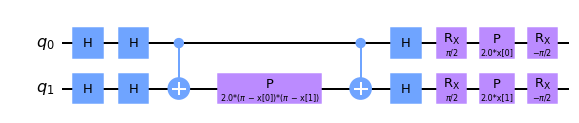


Quantum kernel matrices:



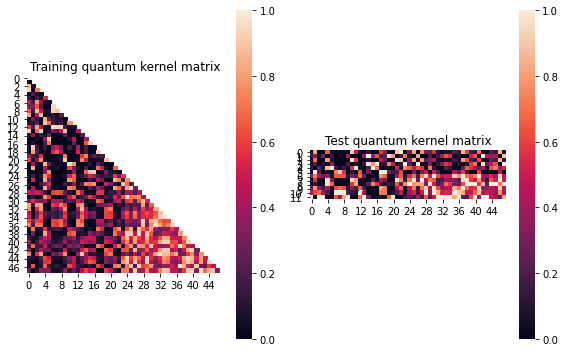


SVM with quantum kernel trained!


Test set performance:


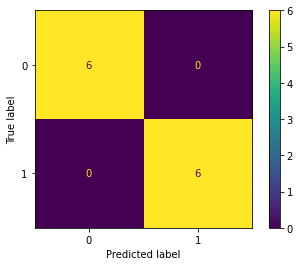

              precision    recall  f1-score   support

           0       1.00      1.00      1.00         6
           1       1.00      1.00      1.00         6

    accuracy                           1.00        12
   macro avg       1.00      1.00      1.00        12
weighted avg       1.00      1.00      1.00        12


metric 1: 0.1606525366785686
metric(s) 2: (00, 10, 11) = (0.27826916693972226, 0.2829827056871623, 0.6090013177917395)
metric 3: 1.6922e-319


----> Kernel construction duration: 00:00:42


Combination 51/468
(Current range: 5/46)
			 reps : 1
			 paulis : ['XX', 'Z']
			 entanglement : linear

Feature map:


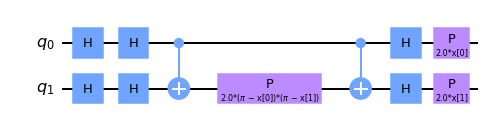


Quantum kernel matrices:



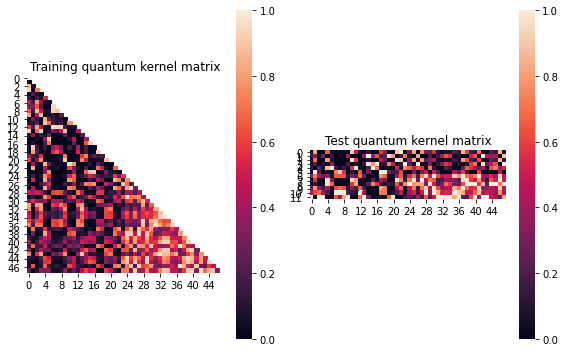


SVM with quantum kernel trained!


Test set performance:


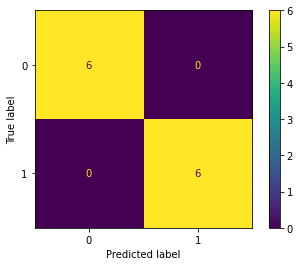

              precision    recall  f1-score   support

           0       1.00      1.00      1.00         6
           1       1.00      1.00      1.00         6

    accuracy                           1.00        12
   macro avg       1.00      1.00      1.00        12
weighted avg       1.00      1.00      1.00        12


metric 1: 0.1606525366785686
metric(s) 2: (00, 10, 11) = (0.27826916693972226, 0.2829827056871623, 0.6090013177917395)
metric 3: 1.6922e-319


----> Kernel construction duration: 00:00:42


Combination 52/468
(Current range: 6/46)
			 reps : 1
			 paulis : ['XX', 'XX']
			 entanglement : linear

Feature map:


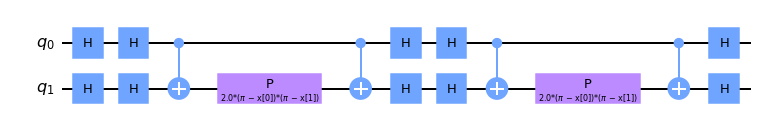


Quantum kernel matrices:



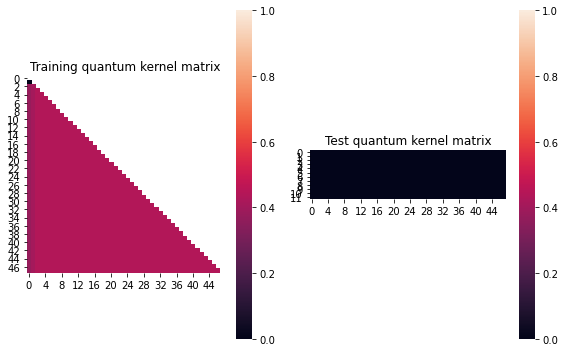


SVM with quantum kernel trained!


Test set performance:


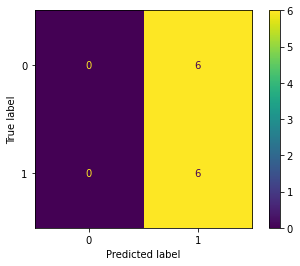

              precision    recall  f1-score   support

           0       0.00      0.00      0.00         6
           1       0.50      1.00      0.67         6

    accuracy                           0.50        12
   macro avg       0.25      0.50      0.33        12
weighted avg       0.25      0.50      0.33        12


metric 1: 0.00472005208333337
metric(s) 2: (00, 10, 11) = (0.4391276041666667, 0.43359375, 0.4375)
metric 3: 0.0


----> Kernel construction duration: 00:00:20


Combination 53/468
(Current range: 7/46)
			 reps : 1
			 paulis : ['XX', 'XY']
			 entanglement : linear

Feature map:


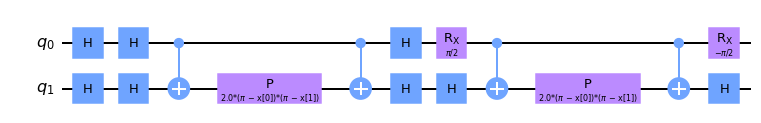


Quantum kernel matrices:



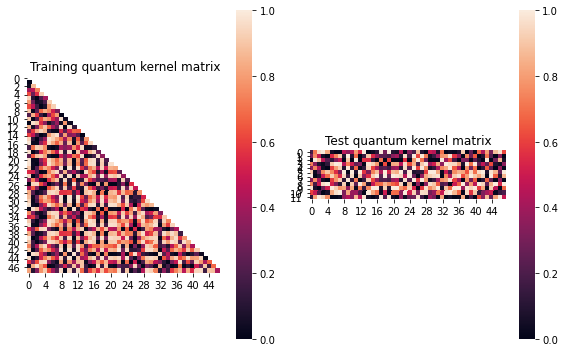


SVM with quantum kernel trained!


Test set performance:


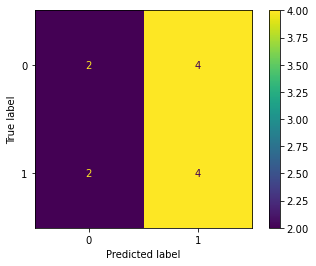

              precision    recall  f1-score   support

           0       0.50      0.33      0.40         6
           1       0.50      0.67      0.57         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.49        12
weighted avg       0.50      0.50      0.49        12


metric 1: 0.0030024471480464276
metric(s) 2: (00, 10, 11) = (0.5194729525883561, 0.5274296115848754, 0.5413911648774875)
metric 3: 0.0


----> Kernel construction duration: 00:00:44


Combination 54/468
(Current range: 8/46)
			 reps : 1
			 paulis : ['XX', 'XZ']
			 entanglement : linear

Feature map:


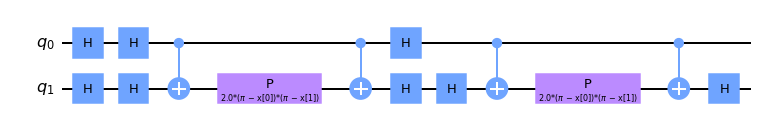


Quantum kernel matrices:



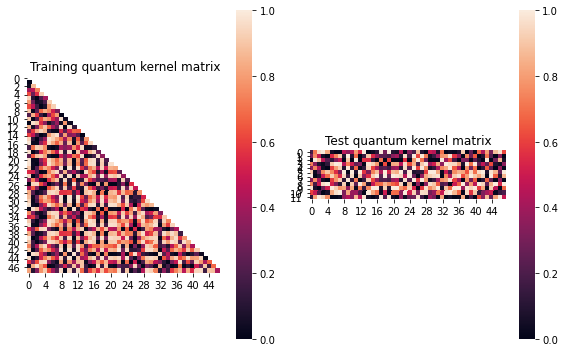


SVM with quantum kernel trained!


Test set performance:


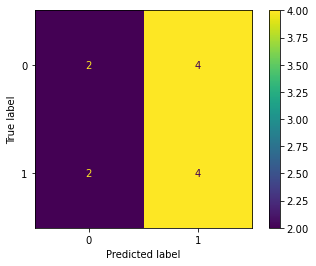

              precision    recall  f1-score   support

           0       0.50      0.33      0.40         6
           1       0.50      0.67      0.57         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.49        12
weighted avg       0.50      0.50      0.49        12


metric 1: 0.0030024471480464276
metric(s) 2: (00, 10, 11) = (0.5194729525883561, 0.5274296115848754, 0.5413911648774875)
metric 3: 0.0


----> Kernel construction duration: 00:00:44


Combination 55/468
(Current range: 9/46)
			 reps : 1
			 paulis : ['XX', 'YX']
			 entanglement : linear

Feature map:


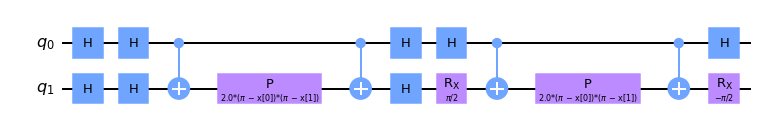


Quantum kernel matrices:



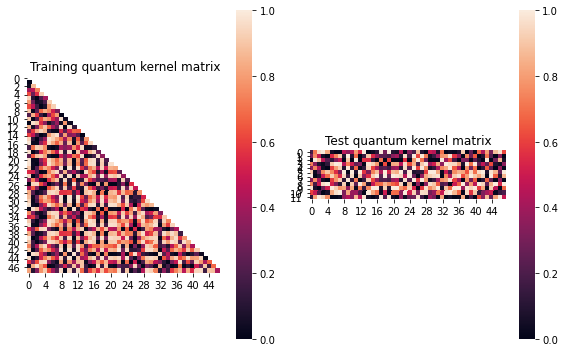


SVM with quantum kernel trained!


Test set performance:


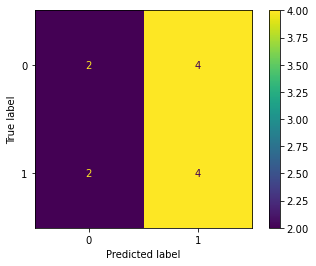

              precision    recall  f1-score   support

           0       0.50      0.33      0.40         6
           1       0.50      0.67      0.57         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.49        12
weighted avg       0.50      0.50      0.49        12


metric 1: 0.0030024471480464276
metric(s) 2: (00, 10, 11) = (0.5194729525883561, 0.5274296115848754, 0.5413911648774875)
metric 3: 0.0


----> Kernel construction duration: 00:00:44


Combination 56/468
(Current range: 10/46)
			 reps : 1
			 paulis : ['XX', 'YY']
			 entanglement : linear

Feature map:


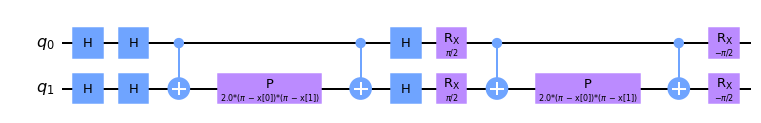


Quantum kernel matrices:



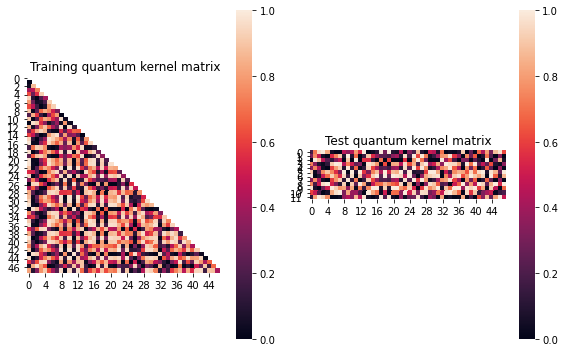


SVM with quantum kernel trained!


Test set performance:


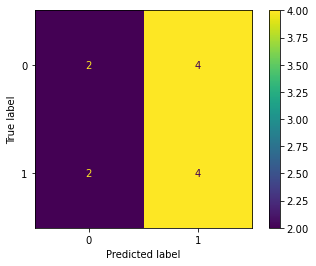

              precision    recall  f1-score   support

           0       0.50      0.33      0.40         6
           1       0.50      0.67      0.57         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.49        12
weighted avg       0.50      0.50      0.49        12


metric 1: 0.0030024471480464276
metric(s) 2: (00, 10, 11) = (0.5194729525883561, 0.5274296115848754, 0.5413911648774875)
metric 3: 0.0


----> Kernel construction duration: 00:00:55


Combination 57/468
(Current range: 11/46)
			 reps : 1
			 paulis : ['XX', 'YZ']
			 entanglement : linear

Feature map:


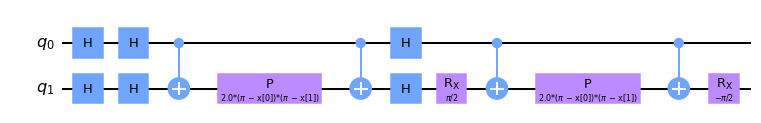


Quantum kernel matrices:



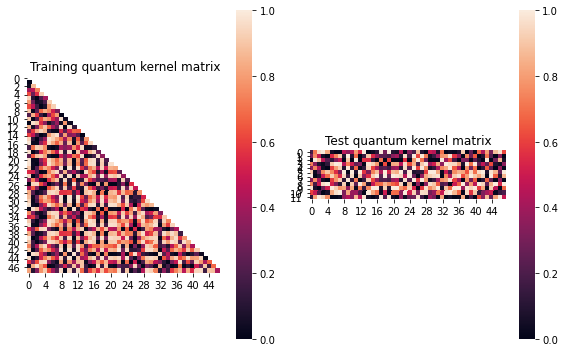


SVM with quantum kernel trained!


Test set performance:


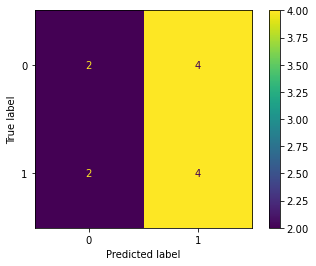

              precision    recall  f1-score   support

           0       0.50      0.33      0.40         6
           1       0.50      0.67      0.57         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.49        12
weighted avg       0.50      0.50      0.49        12


metric 1: 0.0030024471480464276
metric(s) 2: (00, 10, 11) = (0.5194729525883561, 0.5274296115848754, 0.5413911648774875)
metric 3: 0.0


----> Kernel construction duration: 00:00:55


Combination 58/468
(Current range: 12/46)
			 reps : 1
			 paulis : ['XX', 'ZX']
			 entanglement : linear

Feature map:


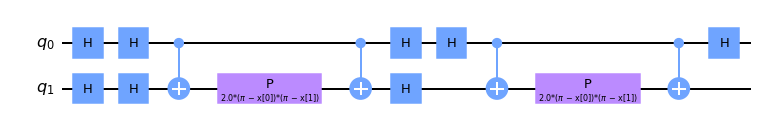


Quantum kernel matrices:



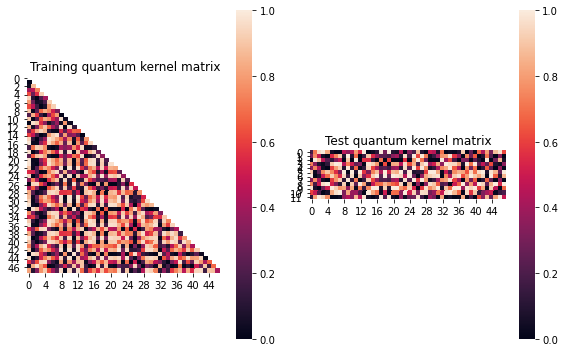


SVM with quantum kernel trained!


Test set performance:


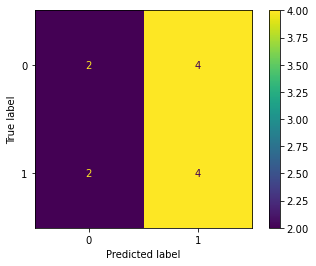

              precision    recall  f1-score   support

           0       0.50      0.33      0.40         6
           1       0.50      0.67      0.57         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.49        12
weighted avg       0.50      0.50      0.49        12


metric 1: 0.0030024471480464276
metric(s) 2: (00, 10, 11) = (0.5194729525883561, 0.5274296115848754, 0.5413911648774875)
metric 3: 0.0


----> Kernel construction duration: 00:00:44


Combination 59/468
(Current range: 13/46)
			 reps : 1
			 paulis : ['XX', 'ZY']
			 entanglement : linear

Feature map:


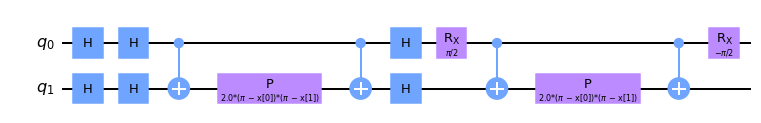


Quantum kernel matrices:



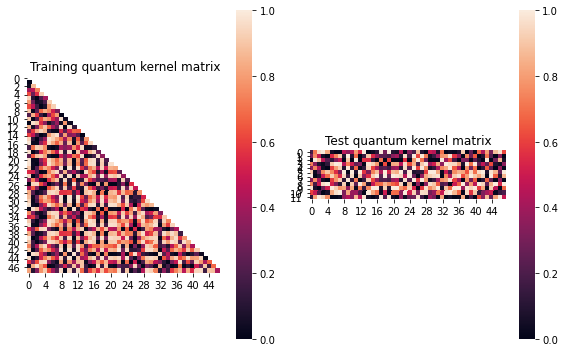


SVM with quantum kernel trained!


Test set performance:


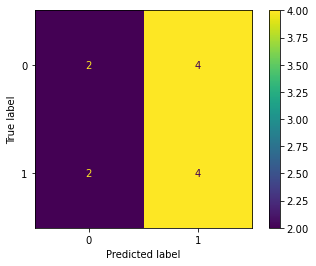

              precision    recall  f1-score   support

           0       0.50      0.33      0.40         6
           1       0.50      0.67      0.57         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.49        12
weighted avg       0.50      0.50      0.49        12


metric 1: 0.0030024471480464276
metric(s) 2: (00, 10, 11) = (0.5194729525883561, 0.5274296115848754, 0.5413911648774875)
metric 3: 0.0


----> Kernel construction duration: 00:00:55


Combination 60/468
(Current range: 14/46)
			 reps : 1
			 paulis : ['XX', 'ZZ']
			 entanglement : linear

Feature map:


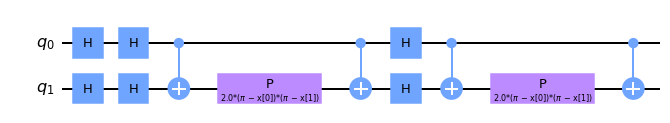


Quantum kernel matrices:



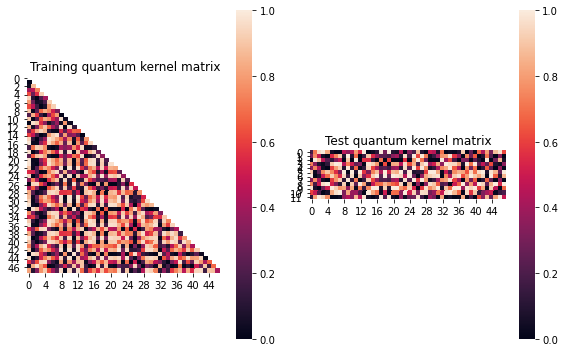


SVM with quantum kernel trained!


Test set performance:


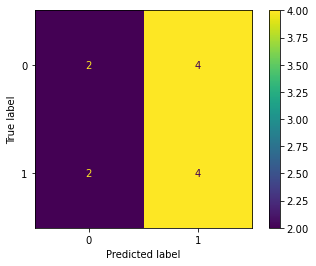

              precision    recall  f1-score   support

           0       0.50      0.33      0.40         6
           1       0.50      0.67      0.57         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.49        12
weighted avg       0.50      0.50      0.49        12


metric 1: 0.0030024471480464276
metric(s) 2: (00, 10, 11) = (0.5194729525883561, 0.5274296115848754, 0.5413911648774875)
metric 3: 0.0


----> Kernel construction duration: 00:00:56


Combination 61/468
(Current range: 15/46)
			 reps : 1
			 paulis : ['XY', 'X']
			 entanglement : linear

Feature map:


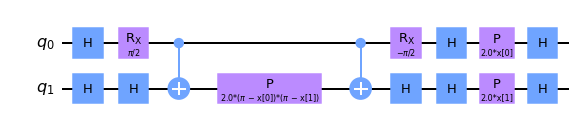


Quantum kernel matrices:



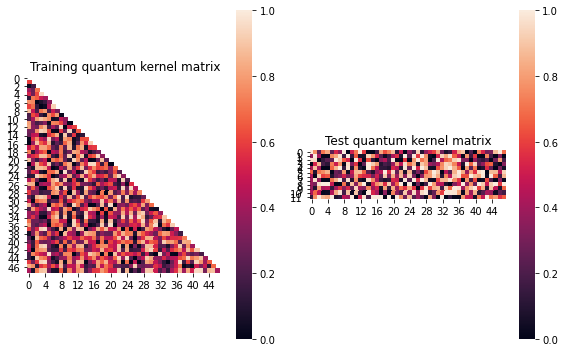


SVM with quantum kernel trained!


Test set performance:


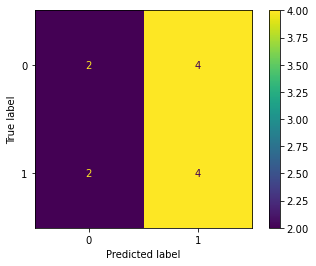

              precision    recall  f1-score   support

           0       0.50      0.33      0.40         6
           1       0.50      0.67      0.57         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.49        12
weighted avg       0.50      0.50      0.49        12


metric 1: 0.02898383400669241
metric(s) 2: (00, 10, 11) = (0.4869688010223501, 0.4701680306433745, 0.5113349282777837)
metric 3: -0.0


----> Kernel construction duration: 00:00:52


Combination 62/468
(Current range: 16/46)
			 reps : 1
			 paulis : ['XY', 'Y']
			 entanglement : linear

Feature map:


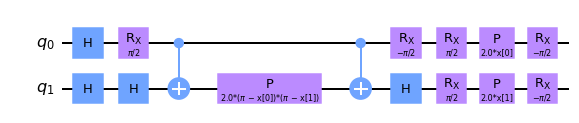


Quantum kernel matrices:



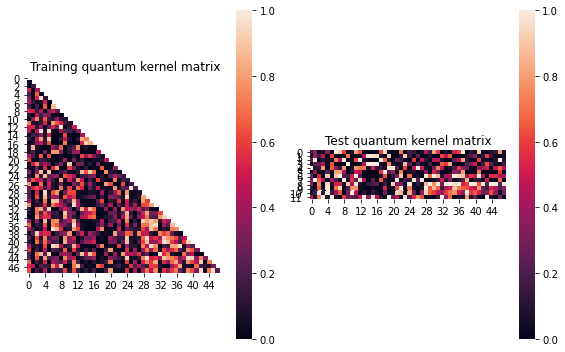


SVM with quantum kernel trained!


Test set performance:


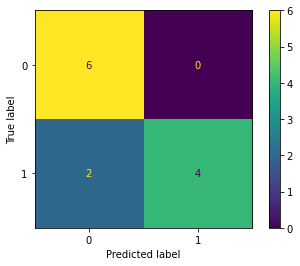

              precision    recall  f1-score   support

           0       0.75      1.00      0.86         6
           1       1.00      0.67      0.80         6

    accuracy                           0.83        12
   macro avg       0.88      0.83      0.83        12
weighted avg       0.88      0.83      0.83        12


metric 1: 0.08763277988098328
metric(s) 2: (00, 10, 11) = (0.2819653944910484, 0.27875981924361914, 0.4508198037581564)
metric 3: -5.595307999072214e-305


----> Kernel construction duration: 00:00:51


Combination 63/468
(Current range: 17/46)
			 reps : 1
			 paulis : ['XY', 'Z']
			 entanglement : linear

Feature map:


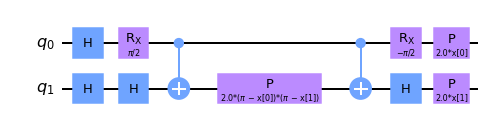


Quantum kernel matrices:



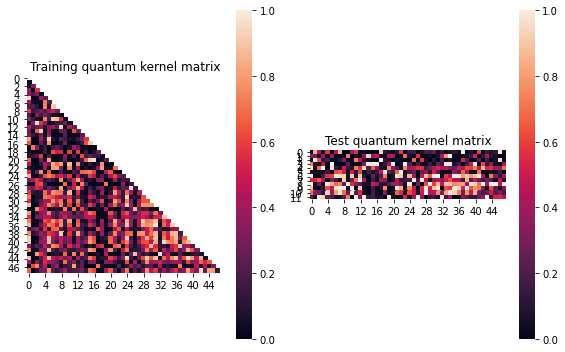


SVM with quantum kernel trained!


Test set performance:


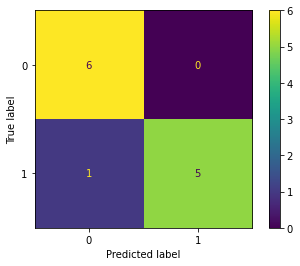

              precision    recall  f1-score   support

           0       0.86      1.00      0.92         6
           1       1.00      0.83      0.91         6

    accuracy                           0.92        12
   macro avg       0.93      0.92      0.92        12
weighted avg       0.93      0.92      0.92        12


metric 1: 0.05499862571956876
metric(s) 2: (00, 10, 11) = (0.28496953889268073, 0.3109443998178239, 0.4469165121821046)
metric 3: -6.948691605041144e-289


----> Kernel construction duration: 00:00:54


Combination 64/468
(Current range: 18/46)
			 reps : 1
			 paulis : ['XY', 'XX']
			 entanglement : linear

Feature map:


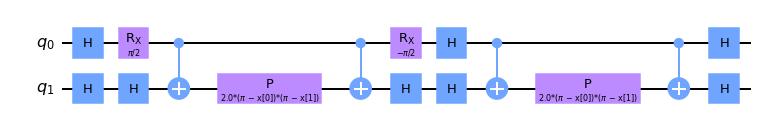


Quantum kernel matrices:



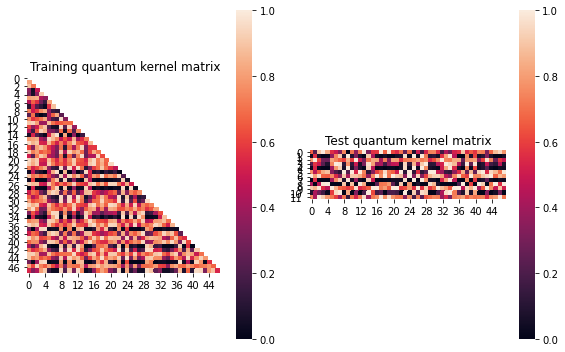


SVM with quantum kernel trained!


Test set performance:


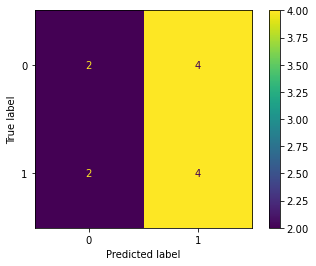

              precision    recall  f1-score   support

           0       0.50      0.33      0.40         6
           1       0.50      0.67      0.57         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.49        12
weighted avg       0.50      0.50      0.49        12


metric 1: 0.0038856891228058466
metric(s) 2: (00, 10, 11) = (0.5750413430180592, 0.567681615172725, 0.5680932655730024)
metric 3: -0.0


----> Kernel construction duration: 00:00:55


Combination 65/468
(Current range: 19/46)
			 reps : 1
			 paulis : ['XY', 'XY']
			 entanglement : linear

Feature map:


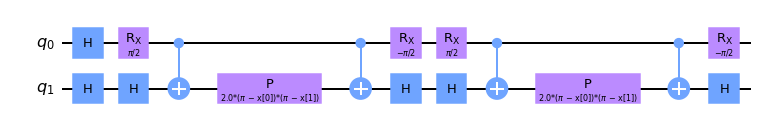


Quantum kernel matrices:



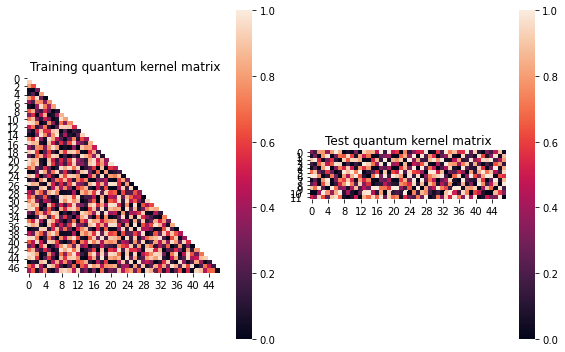


SVM with quantum kernel trained!


Test set performance:


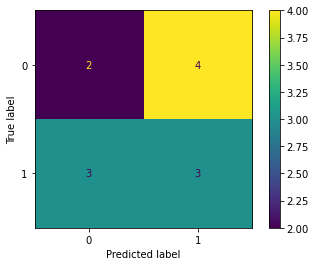

              precision    recall  f1-score   support

           0       0.40      0.33      0.36         6
           1       0.43      0.50      0.46         6

    accuracy                           0.42        12
   macro avg       0.41      0.42      0.41        12
weighted avg       0.41      0.42      0.41        12


metric 1: 0.005189231185427912
metric(s) 2: (00, 10, 11) = (0.49936335961957806, 0.494900756823733, 0.5008166163987438)
metric 3: 0.0


----> Kernel construction duration: 00:00:32


Combination 66/468
(Current range: 20/46)
			 reps : 1
			 paulis : ['XY', 'XZ']
			 entanglement : linear

Feature map:


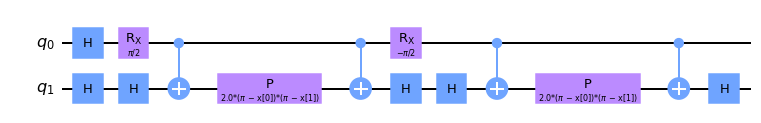


Quantum kernel matrices:



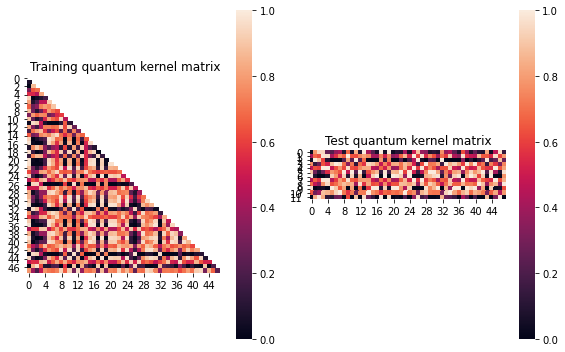


SVM with quantum kernel trained!


Test set performance:


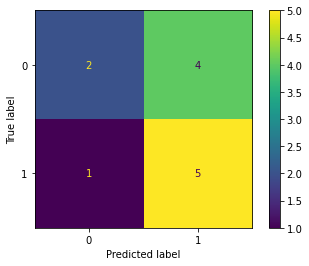

              precision    recall  f1-score   support

           0       0.67      0.33      0.44         6
           1       0.56      0.83      0.67         6

    accuracy                           0.58        12
   macro avg       0.61      0.58      0.56        12
weighted avg       0.61      0.58      0.56        12


metric 1: -0.0006210328716632629
metric(s) 2: (00, 10, 11) = (0.5434756299188566, 0.5555297974455864, 0.5663418992289897)
metric 3: 0.0


----> Kernel construction duration: 00:00:55


Combination 67/468
(Current range: 21/46)
			 reps : 1
			 paulis : ['XY', 'YX']
			 entanglement : linear

Feature map:


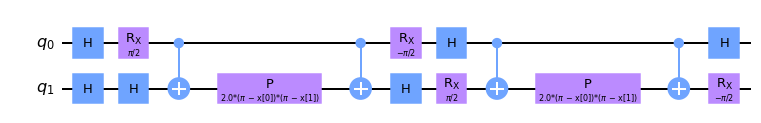


Quantum kernel matrices:



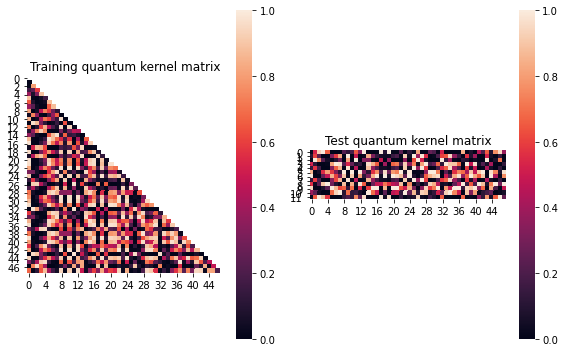


SVM with quantum kernel trained!


Test set performance:


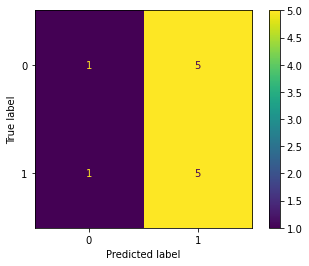

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.0043981638793463285
metric(s) 2: (00, 10, 11) = (0.40613189036271397, 0.4130157528605851, 0.4286959431171489)
metric 3: -0.0


----> Kernel construction duration: 00:01:07


Combination 68/468
(Current range: 22/46)
			 reps : 1
			 paulis : ['XY', 'YY']
			 entanglement : linear

Feature map:


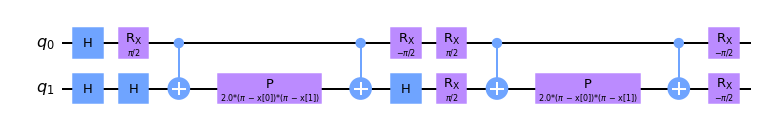


Quantum kernel matrices:



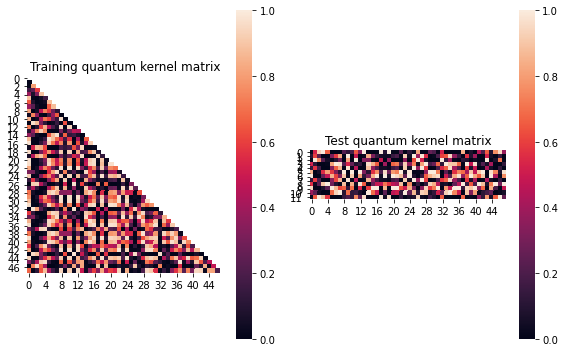


SVM with quantum kernel trained!


Test set performance:


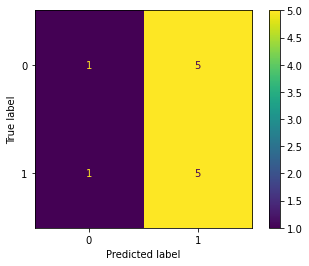

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.0043981638793463285
metric(s) 2: (00, 10, 11) = (0.40613189036271397, 0.4130157528605851, 0.4286959431171489)
metric 3: -0.0


----> Kernel construction duration: 00:00:55


Combination 69/468
(Current range: 23/46)
			 reps : 1
			 paulis : ['XY', 'YZ']
			 entanglement : linear

Feature map:


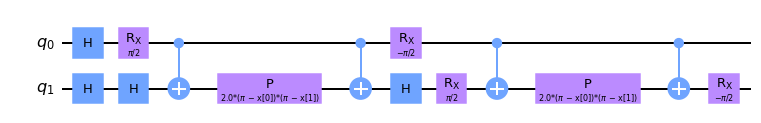


Quantum kernel matrices:



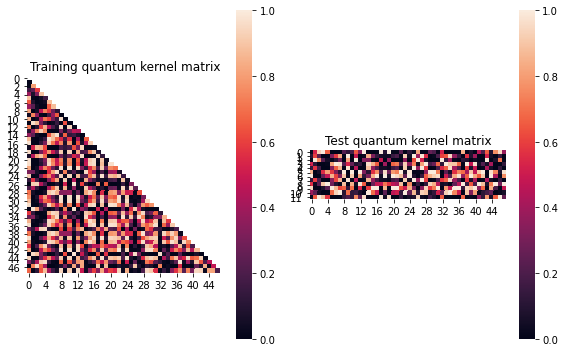


SVM with quantum kernel trained!


Test set performance:


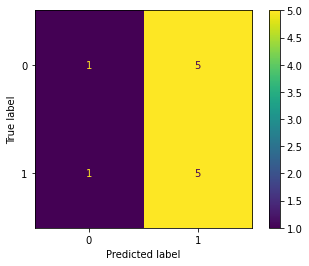

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.0043981638793463285
metric(s) 2: (00, 10, 11) = (0.40613189036271397, 0.4130157528605851, 0.4286959431171489)
metric 3: -0.0


----> Kernel construction duration: 00:01:06


Combination 70/468
(Current range: 24/46)
			 reps : 1
			 paulis : ['XY', 'ZX']
			 entanglement : linear

Feature map:


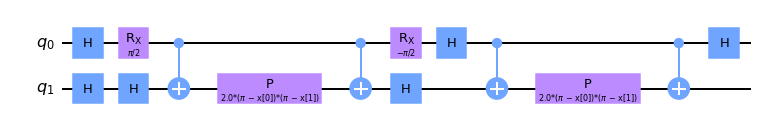


Quantum kernel matrices:



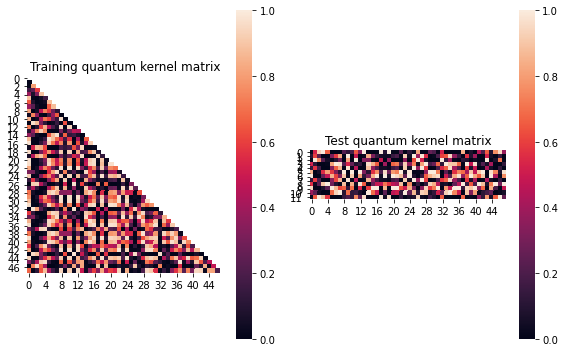


SVM with quantum kernel trained!


Test set performance:


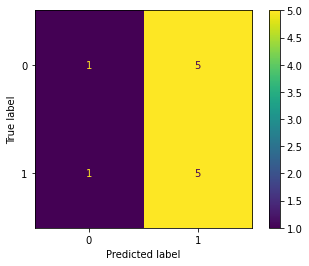

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.0043981638793463285
metric(s) 2: (00, 10, 11) = (0.40613189036271397, 0.4130157528605851, 0.4286959431171489)
metric 3: -0.0


----> Kernel construction duration: 00:01:07


Combination 71/468
(Current range: 25/46)
			 reps : 1
			 paulis : ['XY', 'ZY']
			 entanglement : linear

Feature map:


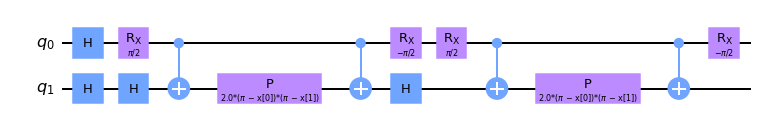


Quantum kernel matrices:



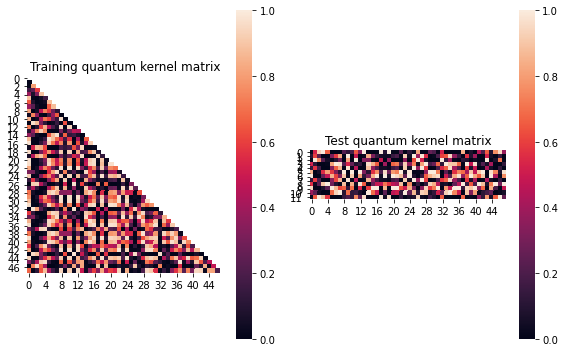


SVM with quantum kernel trained!


Test set performance:


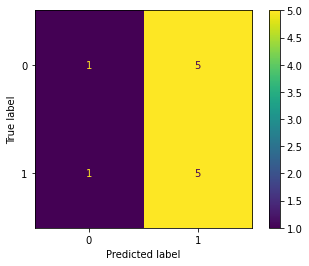

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.0043981638793463285
metric(s) 2: (00, 10, 11) = (0.40613189036271397, 0.4130157528605851, 0.4286959431171489)
metric 3: -0.0


----> Kernel construction duration: 00:00:56


Combination 72/468
(Current range: 26/46)
			 reps : 1
			 paulis : ['XY', 'ZZ']
			 entanglement : linear

Feature map:


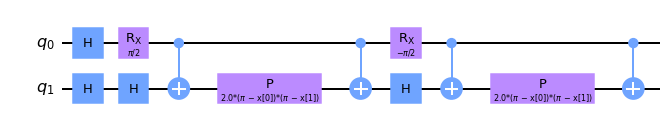


Quantum kernel matrices:



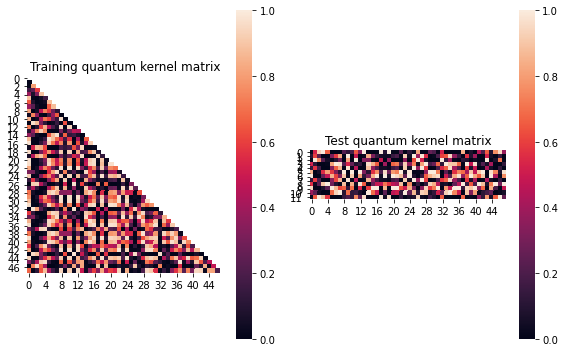


SVM with quantum kernel trained!


Test set performance:


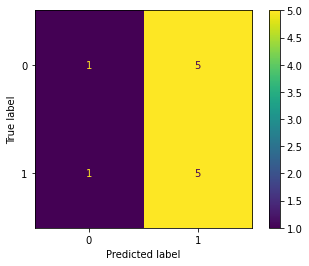

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.0043981638793463285
metric(s) 2: (00, 10, 11) = (0.40613189036271397, 0.4130157528605851, 0.4286959431171489)
metric 3: -0.0


----> Kernel construction duration: 00:01:07


Combination 73/468
(Current range: 27/46)
			 reps : 1
			 paulis : ['XZ', 'X']
			 entanglement : linear

Feature map:


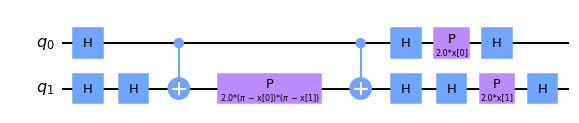


Quantum kernel matrices:



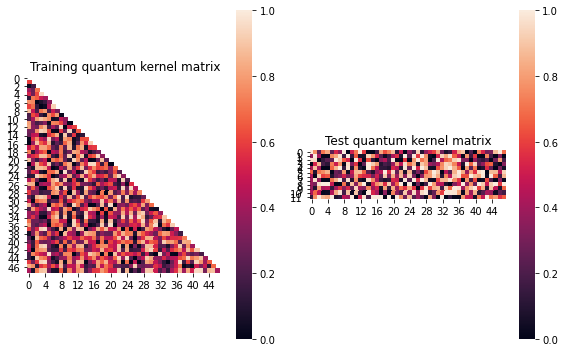


SVM with quantum kernel trained!


Test set performance:


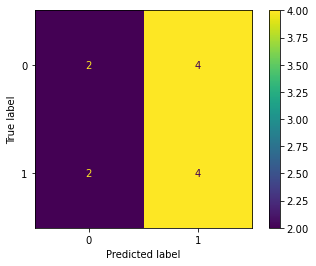

              precision    recall  f1-score   support

           0       0.50      0.33      0.40         6
           1       0.50      0.67      0.57         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.49        12
weighted avg       0.50      0.50      0.49        12


metric 1: 0.02898383400669241
metric(s) 2: (00, 10, 11) = (0.4869688010223501, 0.4701680306433745, 0.5113349282777837)
metric 3: -0.0


----> Kernel construction duration: 00:00:51


Combination 74/468
(Current range: 28/46)
			 reps : 1
			 paulis : ['XZ', 'Y']
			 entanglement : linear

Feature map:


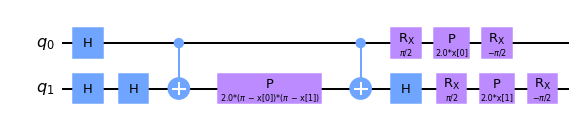


Quantum kernel matrices:



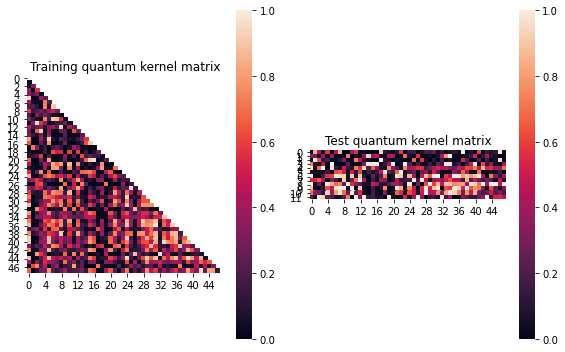


SVM with quantum kernel trained!


Test set performance:


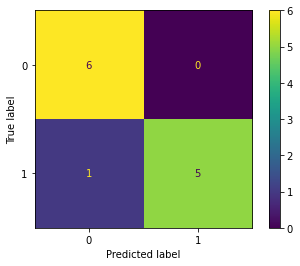

              precision    recall  f1-score   support

           0       0.86      1.00      0.92         6
           1       1.00      0.83      0.91         6

    accuracy                           0.92        12
   macro avg       0.93      0.92      0.92        12
weighted avg       0.93      0.92      0.92        12


metric 1: 0.05499862571956876
metric(s) 2: (00, 10, 11) = (0.28496953889268073, 0.3109443998178239, 0.4469165121821046)
metric 3: -6.948691605041144e-289


----> Kernel construction duration: 00:00:53


Combination 75/468
(Current range: 29/46)
			 reps : 1
			 paulis : ['XZ', 'Z']
			 entanglement : linear

Feature map:


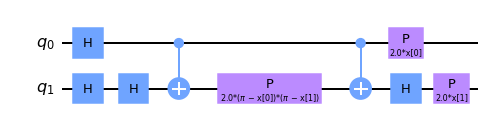


Quantum kernel matrices:



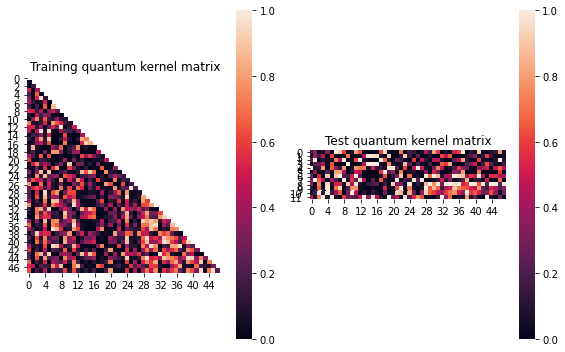


SVM with quantum kernel trained!


Test set performance:


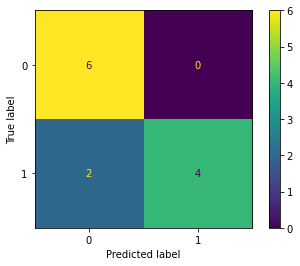

              precision    recall  f1-score   support

           0       0.75      1.00      0.86         6
           1       1.00      0.67      0.80         6

    accuracy                           0.83        12
   macro avg       0.88      0.83      0.83        12
weighted avg       0.88      0.83      0.83        12


metric 1: 0.08763277988098328
metric(s) 2: (00, 10, 11) = (0.2819653944910484, 0.27875981924361914, 0.4508198037581564)
metric 3: -5.595307999072214e-305


----> Kernel construction duration: 00:00:51


Combination 76/468
(Current range: 30/46)
			 reps : 1
			 paulis : ['XZ', 'XX']
			 entanglement : linear

Feature map:


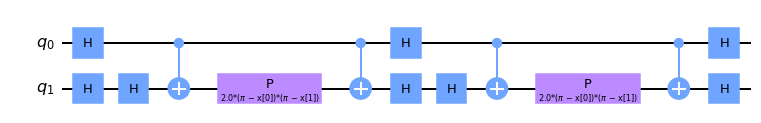


Quantum kernel matrices:



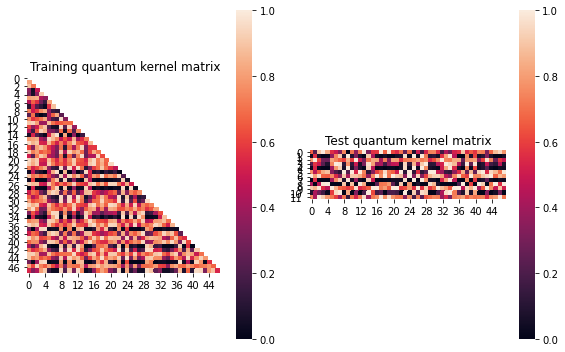


SVM with quantum kernel trained!


Test set performance:


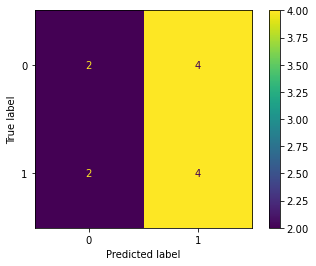

              precision    recall  f1-score   support

           0       0.50      0.33      0.40         6
           1       0.50      0.67      0.57         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.49        12
weighted avg       0.50      0.50      0.49        12


metric 1: 0.0038856891228058466
metric(s) 2: (00, 10, 11) = (0.5750413430180592, 0.567681615172725, 0.5680932655730024)
metric 3: -0.0


----> Kernel construction duration: 00:00:55


Combination 77/468
(Current range: 31/46)
			 reps : 1
			 paulis : ['XZ', 'XY']
			 entanglement : linear

Feature map:


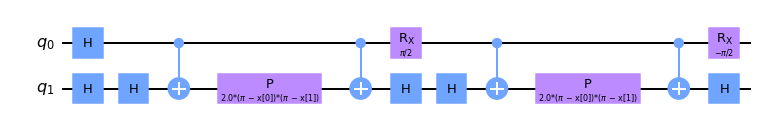


Quantum kernel matrices:



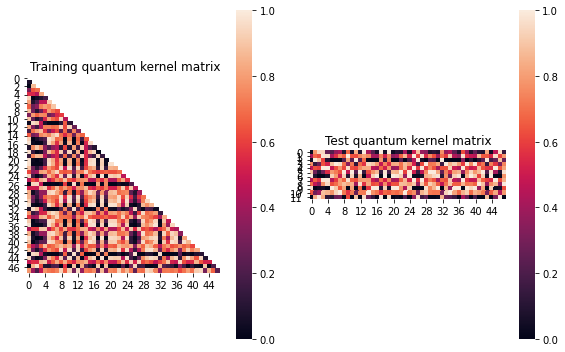


SVM with quantum kernel trained!


Test set performance:


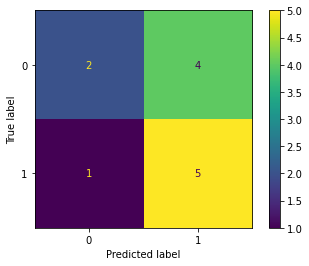

              precision    recall  f1-score   support

           0       0.67      0.33      0.44         6
           1       0.56      0.83      0.67         6

    accuracy                           0.58        12
   macro avg       0.61      0.58      0.56        12
weighted avg       0.61      0.58      0.56        12


metric 1: -0.0006210328716632629
metric(s) 2: (00, 10, 11) = (0.5434756299188566, 0.5555297974455864, 0.5663418992289897)
metric 3: 0.0


----> Kernel construction duration: 00:00:55


Combination 78/468
(Current range: 32/46)
			 reps : 1
			 paulis : ['XZ', 'XZ']
			 entanglement : linear

Feature map:


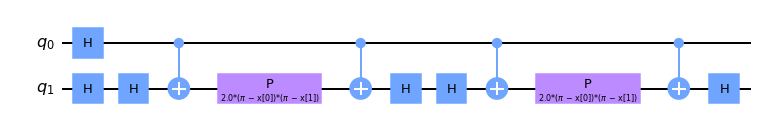


Quantum kernel matrices:



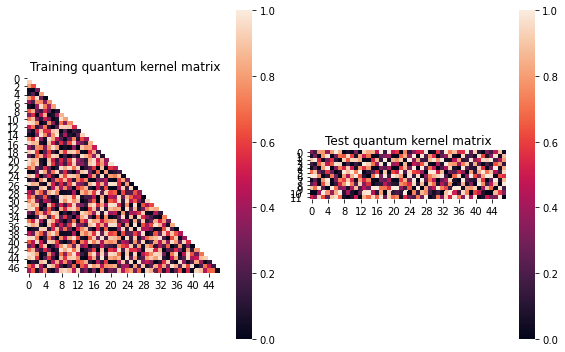


SVM with quantum kernel trained!


Test set performance:


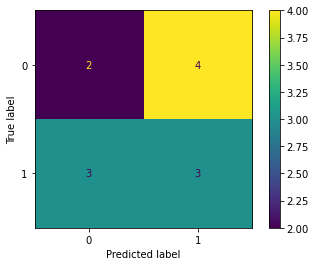

              precision    recall  f1-score   support

           0       0.40      0.33      0.36         6
           1       0.43      0.50      0.46         6

    accuracy                           0.42        12
   macro avg       0.41      0.42      0.41        12
weighted avg       0.41      0.42      0.41        12


metric 1: 0.005189231185427912
metric(s) 2: (00, 10, 11) = (0.49936335961957806, 0.494900756823733, 0.5008166163987438)
metric 3: 0.0


----> Kernel construction duration: 00:00:32


Combination 79/468
(Current range: 33/46)
			 reps : 1
			 paulis : ['XZ', 'YX']
			 entanglement : linear

Feature map:


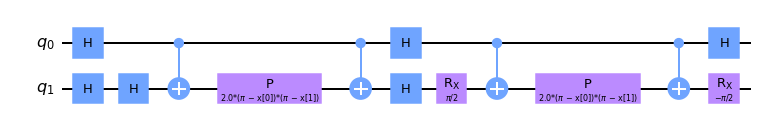


Quantum kernel matrices:



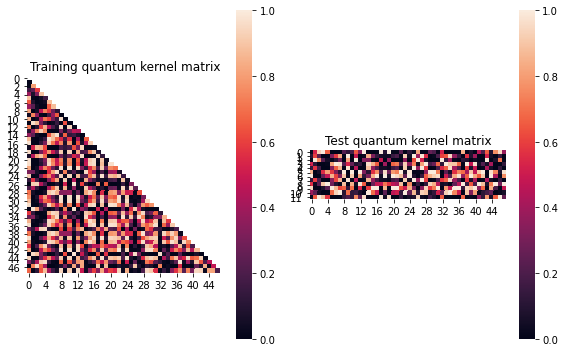


SVM with quantum kernel trained!


Test set performance:


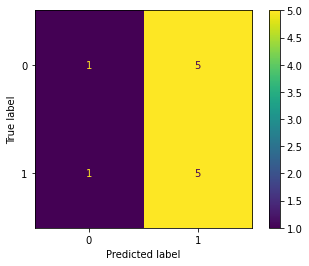

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.0043981638793463285
metric(s) 2: (00, 10, 11) = (0.40613189036271397, 0.4130157528605851, 0.4286959431171489)
metric 3: -0.0


----> Kernel construction duration: 00:01:06


Combination 80/468
(Current range: 34/46)
			 reps : 1
			 paulis : ['XZ', 'YY']
			 entanglement : linear

Feature map:


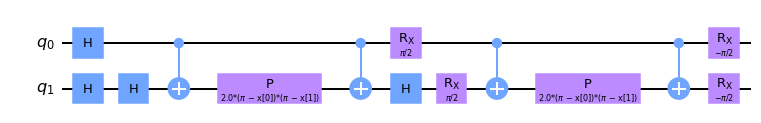


Quantum kernel matrices:



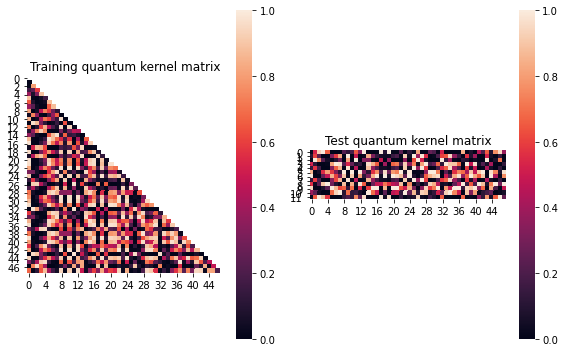


SVM with quantum kernel trained!


Test set performance:


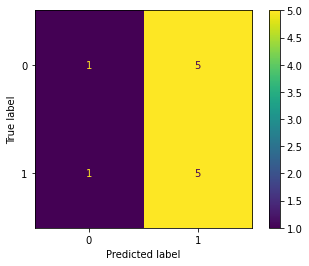

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.0043981638793463285
metric(s) 2: (00, 10, 11) = (0.40613189036271397, 0.4130157528605851, 0.4286959431171489)
metric 3: -0.0


----> Kernel construction duration: 00:01:07


Combination 81/468
(Current range: 35/46)
			 reps : 1
			 paulis : ['XZ', 'YZ']
			 entanglement : linear

Feature map:


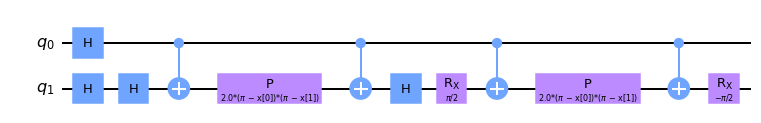


Quantum kernel matrices:



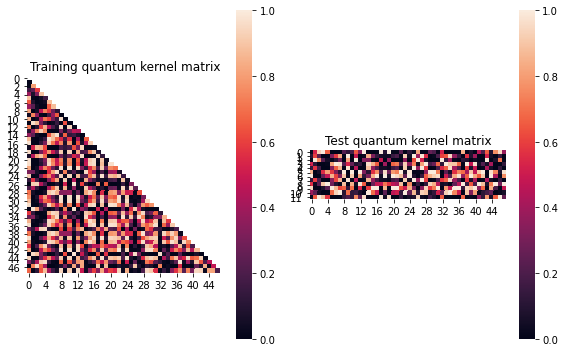


SVM with quantum kernel trained!


Test set performance:


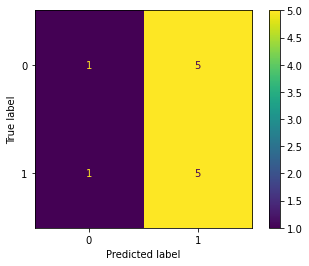

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.0043981638793463285
metric(s) 2: (00, 10, 11) = (0.40613189036271397, 0.4130157528605851, 0.4286959431171489)
metric 3: -0.0


----> Kernel construction duration: 00:00:55


Combination 82/468
(Current range: 36/46)
			 reps : 1
			 paulis : ['XZ', 'ZX']
			 entanglement : linear

Feature map:


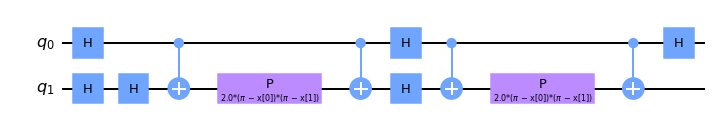


Quantum kernel matrices:



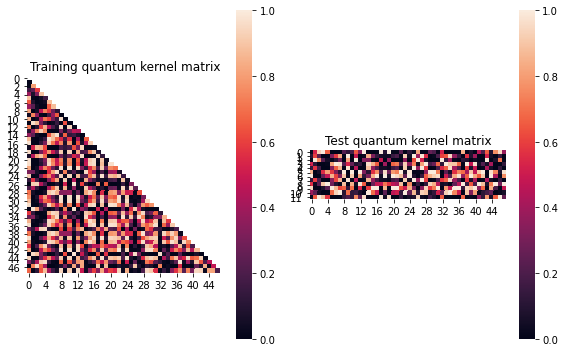


SVM with quantum kernel trained!


Test set performance:


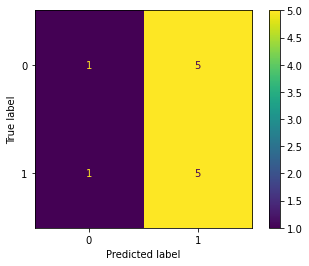

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.0043981638793463285
metric(s) 2: (00, 10, 11) = (0.40613189036271397, 0.4130157528605851, 0.4286959431171489)
metric 3: -0.0


----> Kernel construction duration: 00:01:07


Combination 83/468
(Current range: 37/46)
			 reps : 1
			 paulis : ['XZ', 'ZY']
			 entanglement : linear

Feature map:


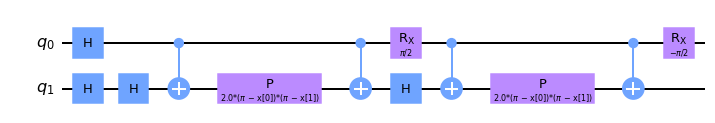


Quantum kernel matrices:



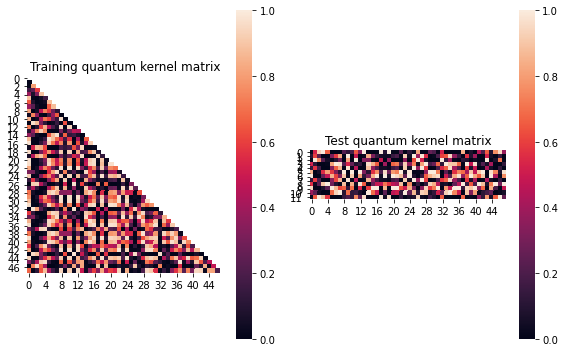


SVM with quantum kernel trained!


Test set performance:


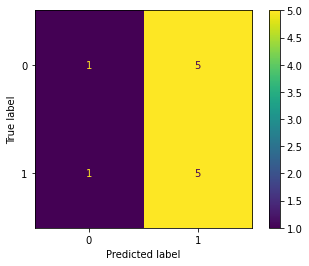

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.0043981638793463285
metric(s) 2: (00, 10, 11) = (0.40613189036271397, 0.4130157528605851, 0.4286959431171489)
metric 3: -0.0


----> Kernel construction duration: 00:01:06


Combination 84/468
(Current range: 38/46)
			 reps : 1
			 paulis : ['XZ', 'ZZ']
			 entanglement : linear

Feature map:


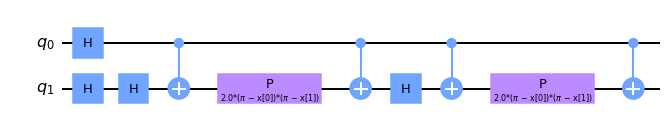


Quantum kernel matrices:



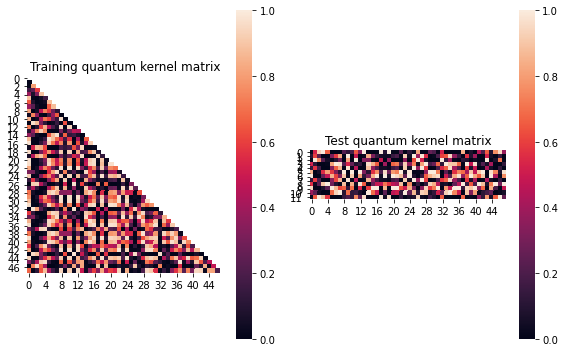


SVM with quantum kernel trained!


Test set performance:


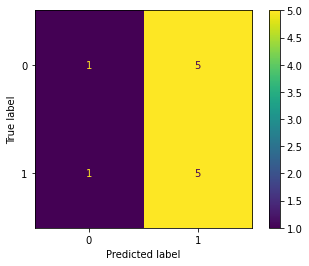

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.0043981638793463285
metric(s) 2: (00, 10, 11) = (0.40613189036271397, 0.4130157528605851, 0.4286959431171489)
metric 3: -0.0


----> Kernel construction duration: 00:00:55


Combination 85/468
(Current range: 39/46)
			 reps : 1
			 paulis : ['YX', 'X']
			 entanglement : linear

Feature map:


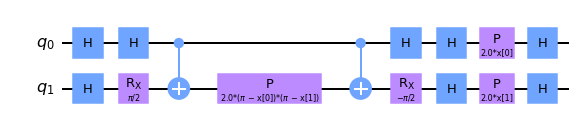


Quantum kernel matrices:



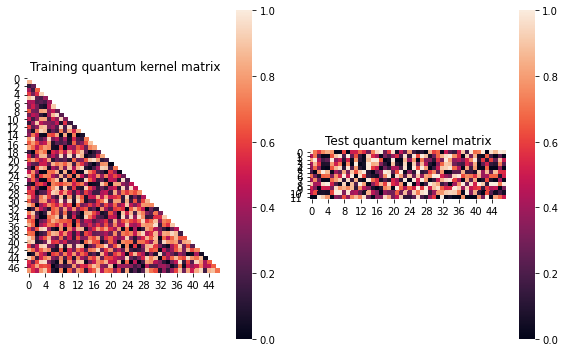


SVM with quantum kernel trained!


Test set performance:


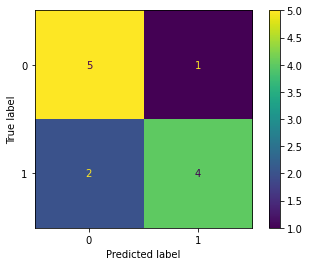

              precision    recall  f1-score   support

           0       0.71      0.83      0.77         6
           1       0.80      0.67      0.73         6

    accuracy                           0.75        12
   macro avg       0.76      0.75      0.75        12
weighted avg       0.76      0.75      0.75        12


metric 1: 0.02112030099530432
metric(s) 2: (00, 10, 11) = (0.4807454989167838, 0.4833957039523437, 0.5282865109785122)
metric 3: 0.0


----> Kernel construction duration: 00:00:52


Combination 86/468
(Current range: 40/46)
			 reps : 1
			 paulis : ['YX', 'Y']
			 entanglement : linear

Feature map:


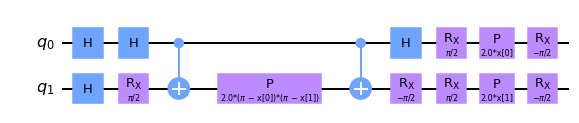


Quantum kernel matrices:



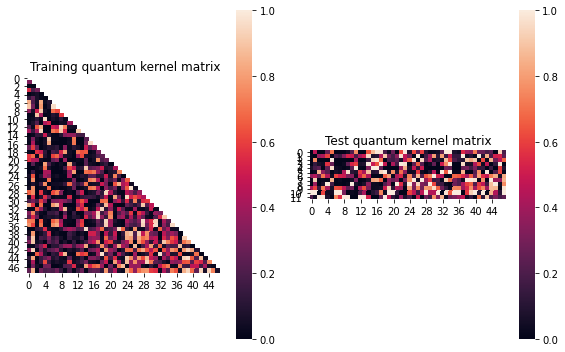


SVM with quantum kernel trained!


Test set performance:


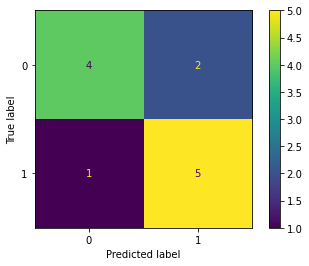

              precision    recall  f1-score   support

           0       0.80      0.67      0.73         6
           1       0.71      0.83      0.77         6

    accuracy                           0.75        12
   macro avg       0.76      0.75      0.75        12
weighted avg       0.76      0.75      0.75        12


metric 1: 0.10146591669195204
metric(s) 2: (00, 10, 11) = (0.2698208171299745, 0.2502513736195271, 0.4336137634929837)
metric 3: 5.2964e-319


----> Kernel construction duration: 00:00:52


Combination 87/468
(Current range: 41/46)
			 reps : 1
			 paulis : ['YX', 'Z']
			 entanglement : linear

Feature map:


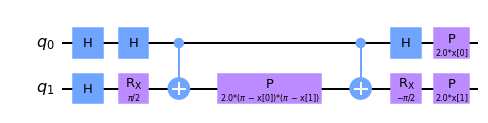


Quantum kernel matrices:



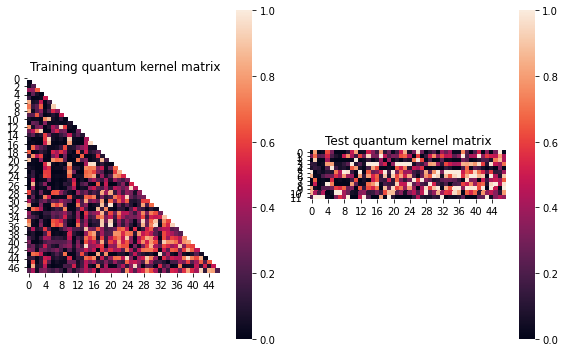


SVM with quantum kernel trained!


Test set performance:


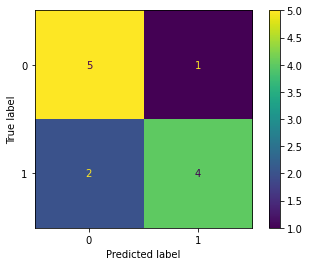

              precision    recall  f1-score   support

           0       0.71      0.83      0.77         6
           1       0.80      0.67      0.73         6

    accuracy                           0.75        12
   macro avg       0.76      0.75      0.75        12
weighted avg       0.76      0.75      0.75        12


metric 1: 0.08426766865323199
metric(s) 2: (00, 10, 11) = (0.2818615013303951, 0.27514376135204316, 0.4369613586801552)
metric 3: 3.567907018307824e-276


----> Kernel construction duration: 00:00:58


Combination 88/468
(Current range: 42/46)
			 reps : 1
			 paulis : ['YX', 'XX']
			 entanglement : linear

Feature map:


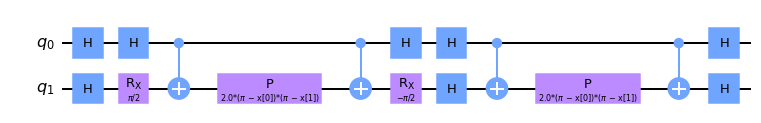


Quantum kernel matrices:



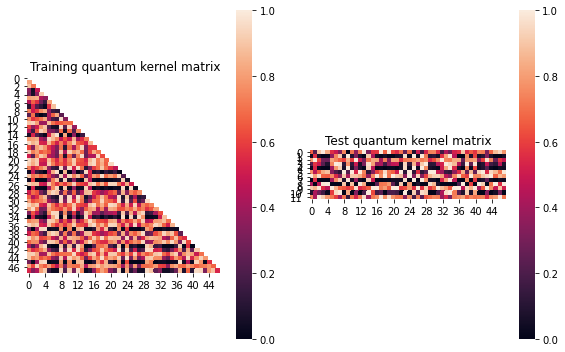


SVM with quantum kernel trained!


Test set performance:


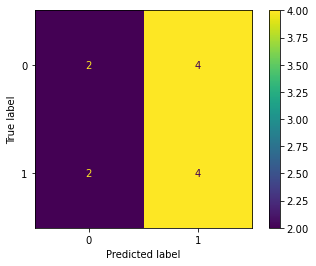

              precision    recall  f1-score   support

           0       0.50      0.33      0.40         6
           1       0.50      0.67      0.57         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.49        12
weighted avg       0.50      0.50      0.49        12


metric 1: 0.0038856891228058466
metric(s) 2: (00, 10, 11) = (0.5750413430180592, 0.567681615172725, 0.5680932655730024)
metric 3: -0.0


----> Kernel construction duration: 00:01:07


Combination 89/468
(Current range: 43/46)
			 reps : 1
			 paulis : ['YX', 'XY']
			 entanglement : linear

Feature map:


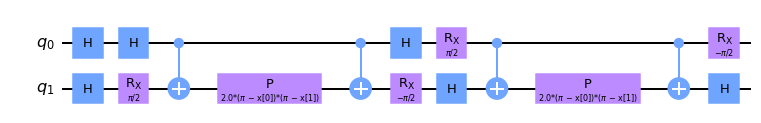


Quantum kernel matrices:



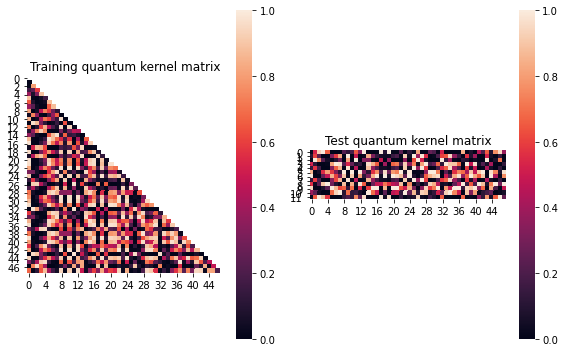


SVM with quantum kernel trained!


Test set performance:


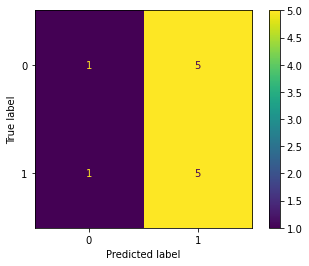

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.0043981638793463285
metric(s) 2: (00, 10, 11) = (0.40613189036271397, 0.4130157528605851, 0.4286959431171489)
metric 3: -0.0


----> Kernel construction duration: 00:01:08


Combination 90/468
(Current range: 44/46)
			 reps : 1
			 paulis : ['YX', 'XZ']
			 entanglement : linear

Feature map:


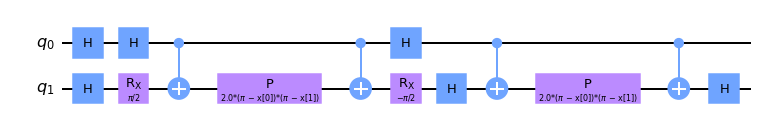


Quantum kernel matrices:



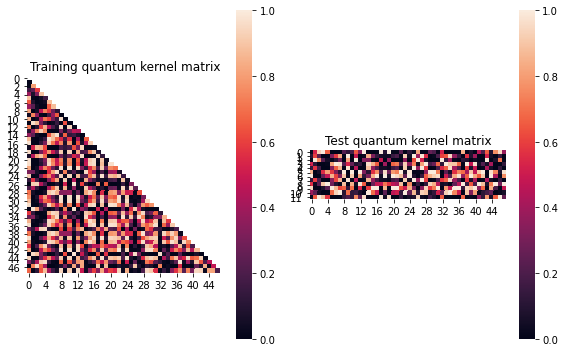


SVM with quantum kernel trained!


Test set performance:


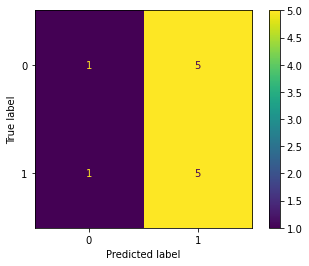

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.0043981638793463285
metric(s) 2: (00, 10, 11) = (0.40613189036271397, 0.4130157528605851, 0.4286959431171489)
metric 3: -0.0


----> Kernel construction duration: 00:01:06


Combination 91/468
(Current range: 45/46)
			 reps : 1
			 paulis : ['YX', 'YX']
			 entanglement : linear

Feature map:


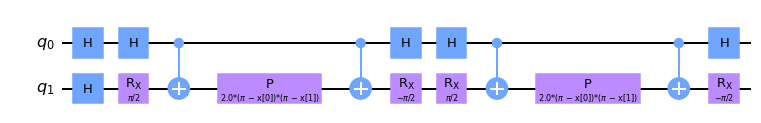


Quantum kernel matrices:



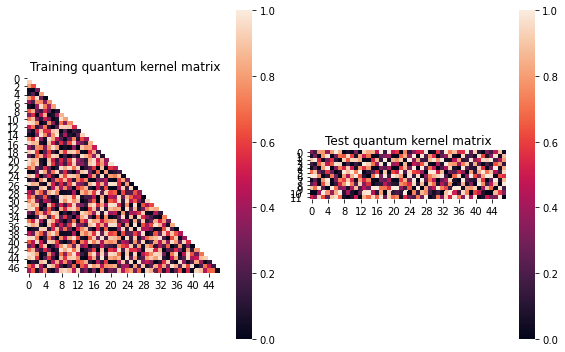


SVM with quantum kernel trained!


Test set performance:


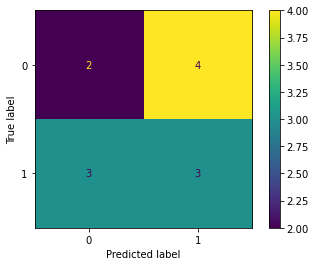

              precision    recall  f1-score   support

           0       0.40      0.33      0.36         6
           1       0.43      0.50      0.46         6

    accuracy                           0.42        12
   macro avg       0.41      0.42      0.41        12
weighted avg       0.41      0.42      0.41        12


metric 1: 0.005189231185427912
metric(s) 2: (00, 10, 11) = (0.49936335961957806, 0.494900756823733, 0.5008166163987438)
metric 3: 0.0


----> Kernel construction duration: 00:00:32


Combination 92/468
(Current range: 46/46)
			 reps : 1
			 paulis : ['YX', 'YY']
			 entanglement : linear

Feature map:


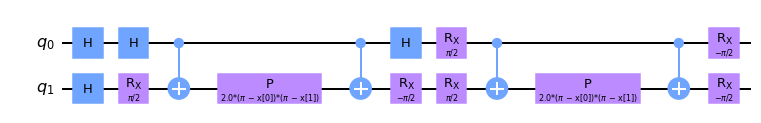


Quantum kernel matrices:



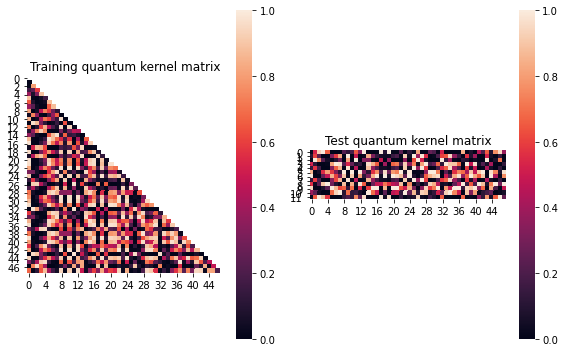


SVM with quantum kernel trained!


Test set performance:


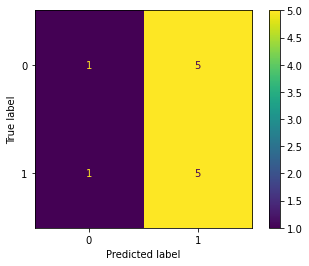

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.0043981638793463285
metric(s) 2: (00, 10, 11) = (0.40613189036271397, 0.4130157528605851, 0.4286959431171489)
metric 3: -0.0


----> Kernel construction duration: 00:00:55


In [14]:
j=1
results.append(run_kernel_evaluation(X, X_train, y_train, X_test, y_test,
                                      param_grid, range_list, j, model=True))



Combination 93/468
(Current range: 1/46)
			 reps : 1
			 paulis : ['YX', 'YZ']
			 entanglement : linear

Feature map:


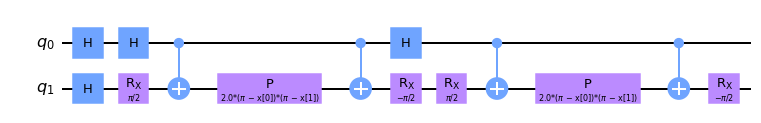


Quantum kernel matrices:



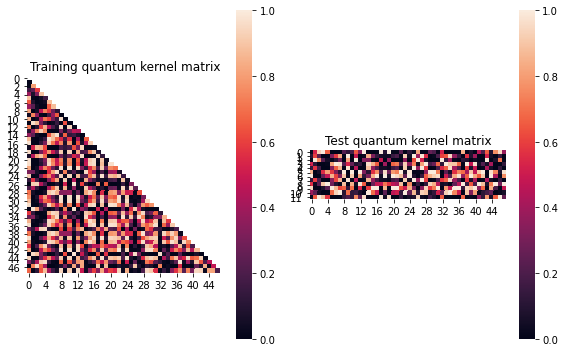


SVM with quantum kernel trained!


Test set performance:


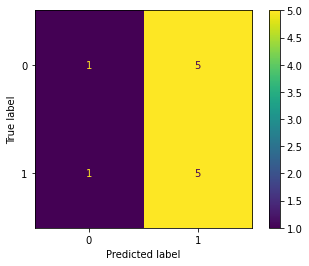

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.0043981638793463285
metric(s) 2: (00, 10, 11) = (0.40613189036271397, 0.4130157528605851, 0.4286959431171489)
metric 3: -0.0


----> Kernel construction duration: 00:00:55


Combination 94/468
(Current range: 2/46)
			 reps : 1
			 paulis : ['YX', 'ZX']
			 entanglement : linear

Feature map:


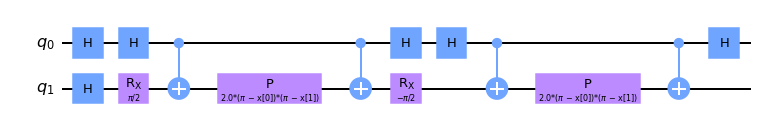


Quantum kernel matrices:



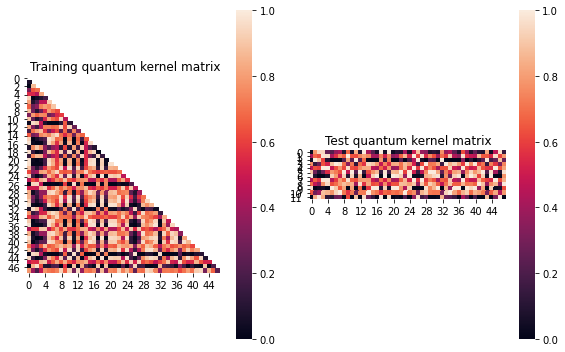


SVM with quantum kernel trained!


Test set performance:


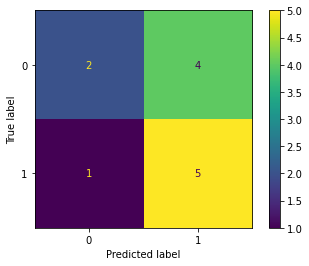

              precision    recall  f1-score   support

           0       0.67      0.33      0.44         6
           1       0.56      0.83      0.67         6

    accuracy                           0.58        12
   macro avg       0.61      0.58      0.56        12
weighted avg       0.61      0.58      0.56        12


metric 1: -0.0006210328716632629
metric(s) 2: (00, 10, 11) = (0.5434756299188566, 0.5555297974455864, 0.5663418992289897)
metric 3: 0.0


----> Kernel construction duration: 00:00:54


Combination 95/468
(Current range: 3/46)
			 reps : 1
			 paulis : ['YX', 'ZY']
			 entanglement : linear

Feature map:


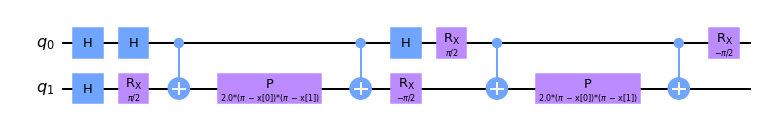


Quantum kernel matrices:



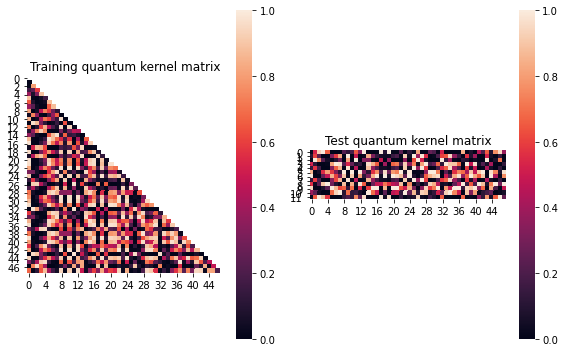


SVM with quantum kernel trained!


Test set performance:


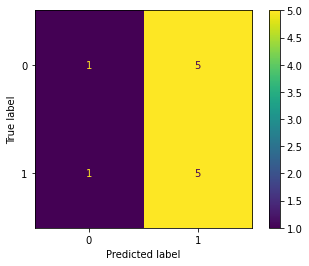

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.0043981638793463285
metric(s) 2: (00, 10, 11) = (0.40613189036271397, 0.4130157528605851, 0.4286959431171489)
metric 3: -0.0


----> Kernel construction duration: 00:01:05


Combination 96/468
(Current range: 4/46)
			 reps : 1
			 paulis : ['YX', 'ZZ']
			 entanglement : linear

Feature map:


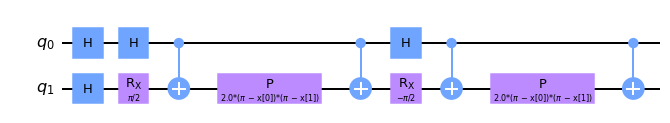


Quantum kernel matrices:



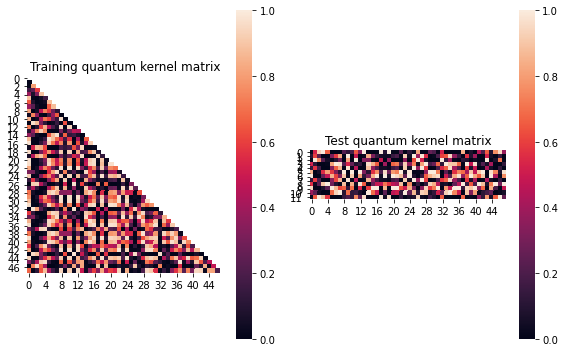


SVM with quantum kernel trained!


Test set performance:


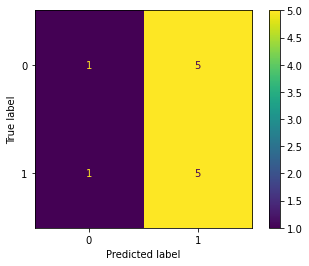

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.0043981638793463285
metric(s) 2: (00, 10, 11) = (0.40613189036271397, 0.4130157528605851, 0.4286959431171489)
metric 3: -0.0


----> Kernel construction duration: 00:01:05


Combination 97/468
(Current range: 5/46)
			 reps : 1
			 paulis : ['YY', 'X']
			 entanglement : linear

Feature map:


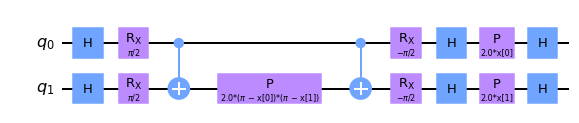


Quantum kernel matrices:



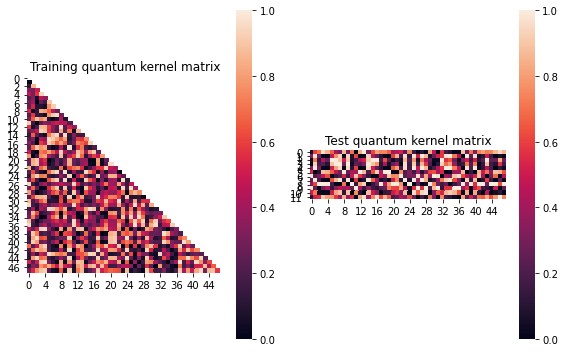


SVM with quantum kernel trained!


Test set performance:


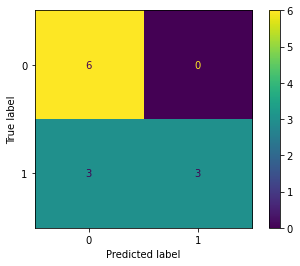

              precision    recall  f1-score   support

           0       0.67      1.00      0.80         6
           1       1.00      0.50      0.67         6

    accuracy                           0.75        12
   macro avg       0.83      0.75      0.73        12
weighted avg       0.83      0.75      0.73        12


metric 1: 0.01664468032457589
metric(s) 2: (00, 10, 11) = (0.470018028929976, 0.4462648057561961, 0.455800943231568)
metric 3: -0.0


----> Kernel construction duration: 00:01:04


Combination 98/468
(Current range: 6/46)
			 reps : 1
			 paulis : ['YY', 'Y']
			 entanglement : linear

Feature map:


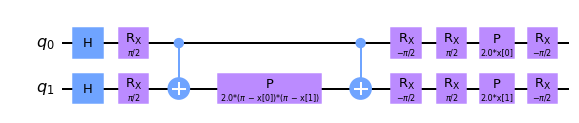


Quantum kernel matrices:



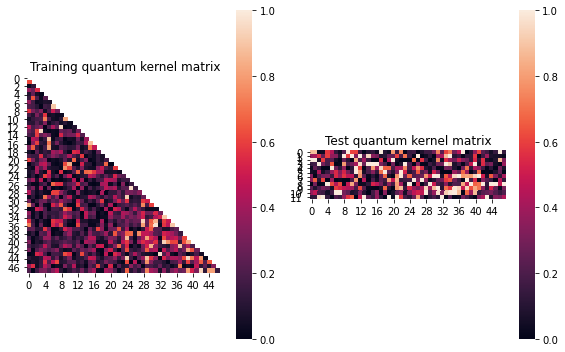


SVM with quantum kernel trained!


Test set performance:


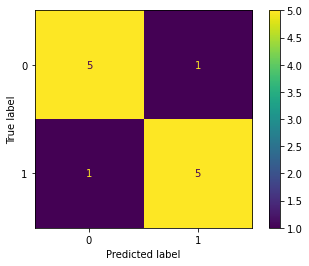

              precision    recall  f1-score   support

           0       0.83      0.83      0.83         6
           1       0.83      0.83      0.83         6

    accuracy                           0.83        12
   macro avg       0.83      0.83      0.83        12
weighted avg       0.83      0.83      0.83        12


metric 1: 0.1045473502897318
metric(s) 2: (00, 10, 11) = (0.26357271453930053, 0.21214886155599652, 0.3698197091521561)
metric 3: 2.3512872618074066e-286


----> Kernel construction duration: 00:01:00


Combination 99/468
(Current range: 7/46)
			 reps : 1
			 paulis : ['YY', 'Z']
			 entanglement : linear

Feature map:


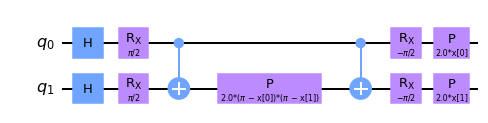


Quantum kernel matrices:



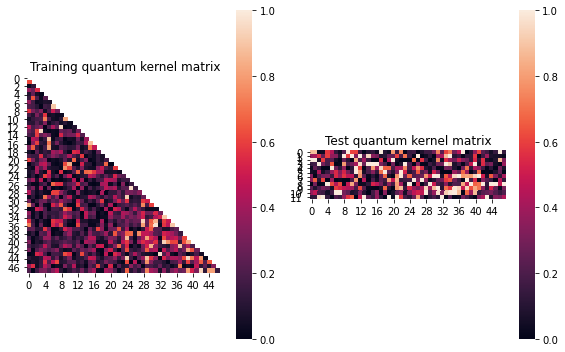


SVM with quantum kernel trained!


Test set performance:


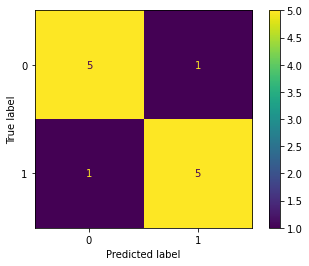

              precision    recall  f1-score   support

           0       0.83      0.83      0.83         6
           1       0.83      0.83      0.83         6

    accuracy                           0.83        12
   macro avg       0.83      0.83      0.83        12
weighted avg       0.83      0.83      0.83        12


metric 1: 0.1045473502897318
metric(s) 2: (00, 10, 11) = (0.26357271453930053, 0.21214886155599652, 0.3698197091521561)
metric 3: 2.3512872618074066e-286


----> Kernel construction duration: 00:01:05


Combination 100/468
(Current range: 8/46)
			 reps : 1
			 paulis : ['YY', 'XX']
			 entanglement : linear

Feature map:


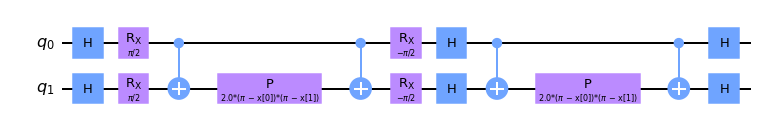


Quantum kernel matrices:



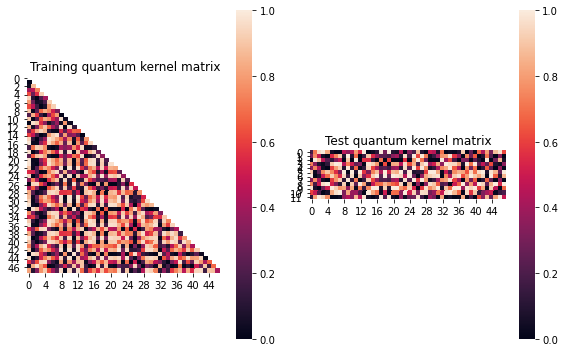


SVM with quantum kernel trained!


Test set performance:


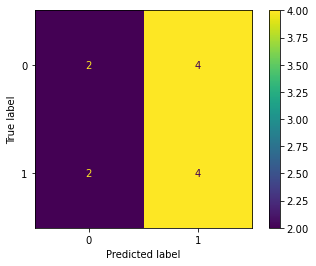

              precision    recall  f1-score   support

           0       0.50      0.33      0.40         6
           1       0.50      0.67      0.57         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.49        12
weighted avg       0.50      0.50      0.49        12


metric 1: 0.0030024471480464276
metric(s) 2: (00, 10, 11) = (0.5194729525883561, 0.5274296115848754, 0.5413911648774875)
metric 3: 0.0


----> Kernel construction duration: 00:01:16


Combination 101/468
(Current range: 9/46)
			 reps : 1
			 paulis : ['YY', 'XY']
			 entanglement : linear

Feature map:


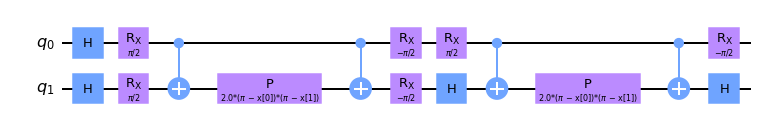


Quantum kernel matrices:



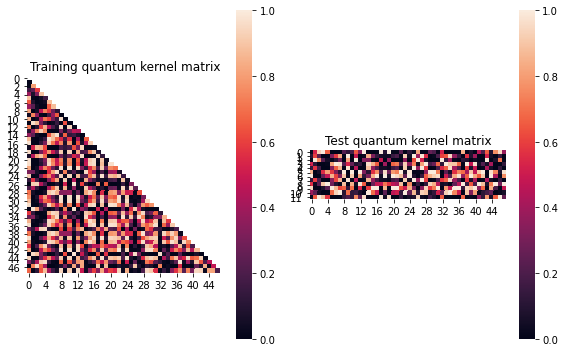


SVM with quantum kernel trained!


Test set performance:


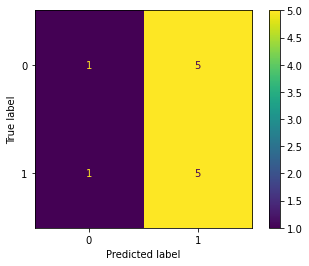

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.0043981638793463285
metric(s) 2: (00, 10, 11) = (0.40613189036271397, 0.4130157528605851, 0.4286959431171489)
metric 3: -0.0


----> Kernel construction duration: 00:01:07


Combination 102/468
(Current range: 10/46)
			 reps : 1
			 paulis : ['YY', 'XZ']
			 entanglement : linear

Feature map:


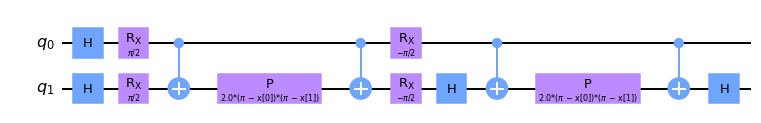


Quantum kernel matrices:



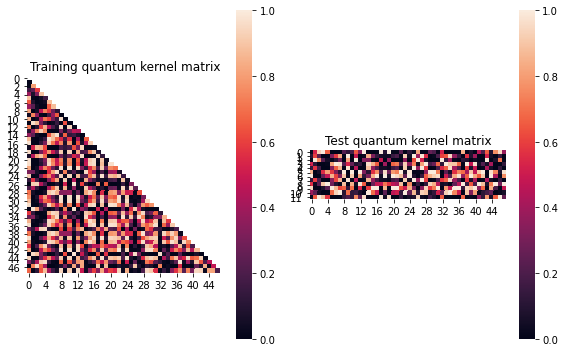


SVM with quantum kernel trained!


Test set performance:


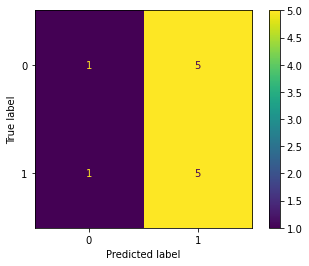

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.0043981638793463285
metric(s) 2: (00, 10, 11) = (0.40613189036271397, 0.4130157528605851, 0.4286959431171489)
metric 3: -0.0


----> Kernel construction duration: 00:01:16


Combination 103/468
(Current range: 11/46)
			 reps : 1
			 paulis : ['YY', 'YX']
			 entanglement : linear

Feature map:


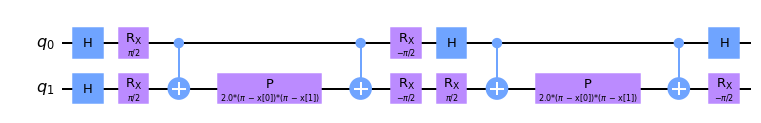


Quantum kernel matrices:



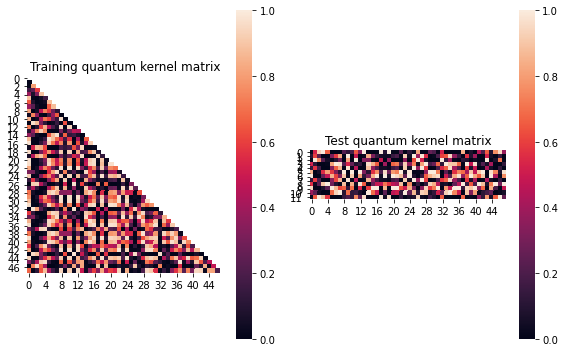


SVM with quantum kernel trained!


Test set performance:


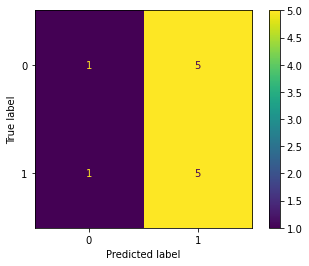

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.0043981638793463285
metric(s) 2: (00, 10, 11) = (0.40613189036271397, 0.4130157528605851, 0.4286959431171489)
metric 3: -0.0


----> Kernel construction duration: 00:01:05


Combination 104/468
(Current range: 12/46)
			 reps : 1
			 paulis : ['YY', 'YY']
			 entanglement : linear

Feature map:


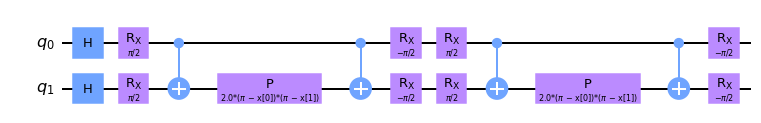


Quantum kernel matrices:



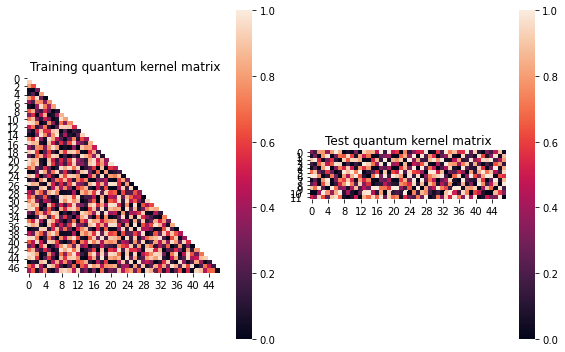


SVM with quantum kernel trained!


Test set performance:


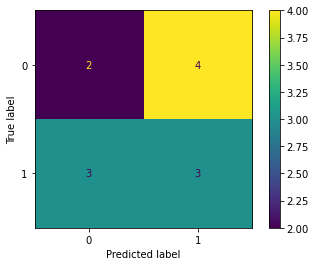

              precision    recall  f1-score   support

           0       0.40      0.33      0.36         6
           1       0.43      0.50      0.46         6

    accuracy                           0.42        12
   macro avg       0.41      0.42      0.41        12
weighted avg       0.41      0.42      0.41        12


metric 1: 0.005189231185427912
metric(s) 2: (00, 10, 11) = (0.49936335961957806, 0.494900756823733, 0.5008166163987438)
metric 3: 0.0


----> Kernel construction duration: 00:00:43


Combination 105/468
(Current range: 13/46)
			 reps : 1
			 paulis : ['YY', 'YZ']
			 entanglement : linear

Feature map:


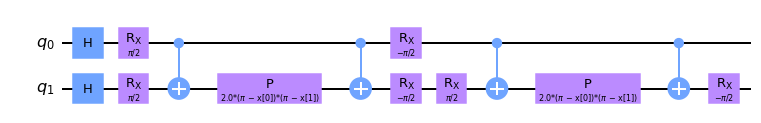


Quantum kernel matrices:



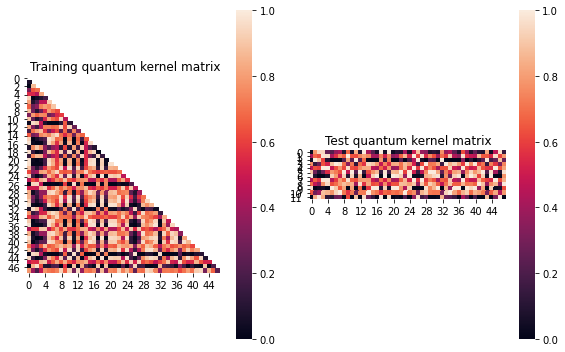


SVM with quantum kernel trained!


Test set performance:


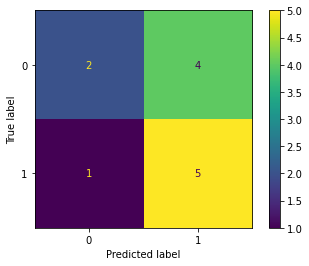

              precision    recall  f1-score   support

           0       0.67      0.33      0.44         6
           1       0.56      0.83      0.67         6

    accuracy                           0.58        12
   macro avg       0.61      0.58      0.56        12
weighted avg       0.61      0.58      0.56        12


metric 1: -0.0006210328716632629
metric(s) 2: (00, 10, 11) = (0.5434756299188566, 0.5555297974455864, 0.5663418992289897)
metric 3: 0.0


----> Kernel construction duration: 00:01:07


Combination 106/468
(Current range: 14/46)
			 reps : 1
			 paulis : ['YY', 'ZX']
			 entanglement : linear

Feature map:


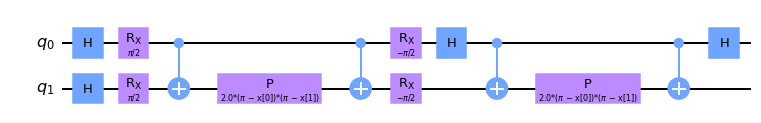


Quantum kernel matrices:



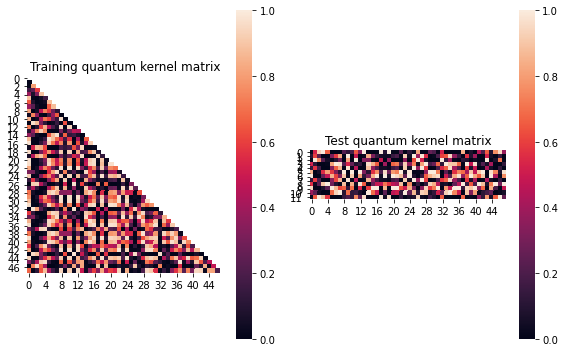


SVM with quantum kernel trained!


Test set performance:


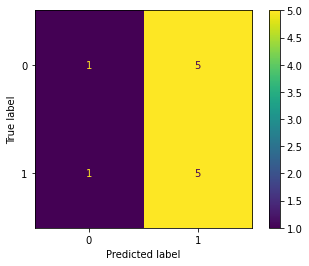

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.0043981638793463285
metric(s) 2: (00, 10, 11) = (0.40613189036271397, 0.4130157528605851, 0.4286959431171489)
metric 3: -0.0


----> Kernel construction duration: 00:01:18


Combination 107/468
(Current range: 15/46)
			 reps : 1
			 paulis : ['YY', 'ZY']
			 entanglement : linear

Feature map:


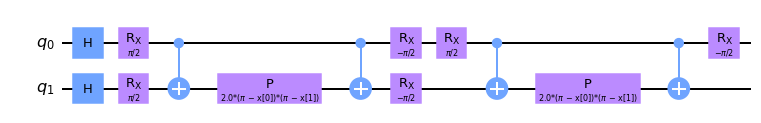


Quantum kernel matrices:



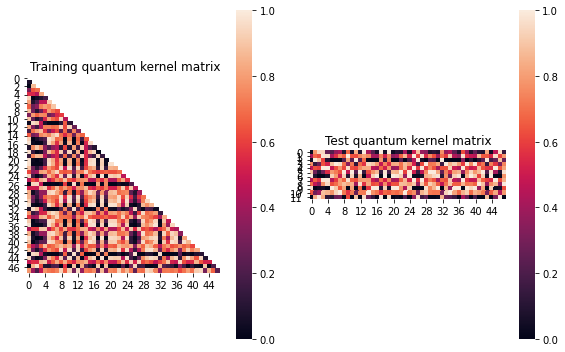


SVM with quantum kernel trained!


Test set performance:


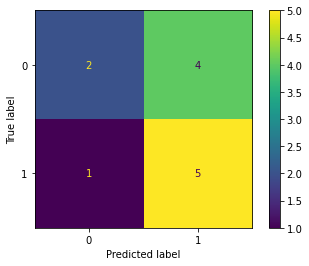

              precision    recall  f1-score   support

           0       0.67      0.33      0.44         6
           1       0.56      0.83      0.67         6

    accuracy                           0.58        12
   macro avg       0.61      0.58      0.56        12
weighted avg       0.61      0.58      0.56        12


metric 1: -0.0006210328716632629
metric(s) 2: (00, 10, 11) = (0.5434756299188566, 0.5555297974455864, 0.5663418992289897)
metric 3: 0.0


----> Kernel construction duration: 00:01:06


Combination 108/468
(Current range: 16/46)
			 reps : 1
			 paulis : ['YY', 'ZZ']
			 entanglement : linear

Feature map:


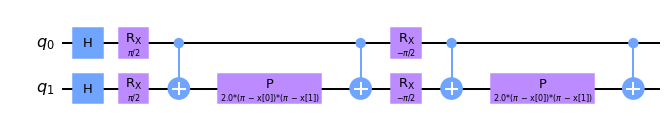


Quantum kernel matrices:



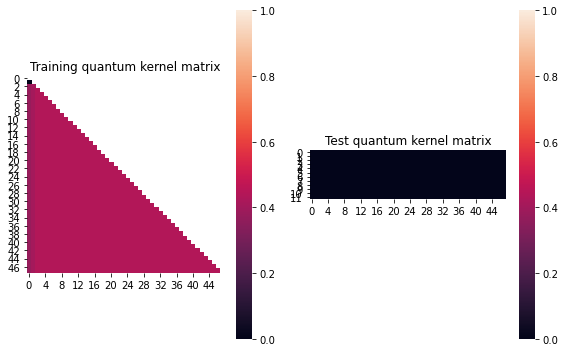


SVM with quantum kernel trained!


Test set performance:


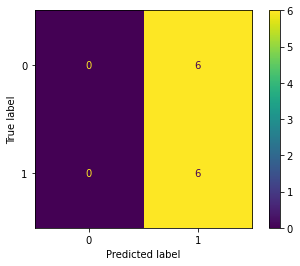

              precision    recall  f1-score   support

           0       0.00      0.00      0.00         6
           1       0.50      1.00      0.67         6

    accuracy                           0.50        12
   macro avg       0.25      0.50      0.33        12
weighted avg       0.25      0.50      0.33        12


metric 1: 0.00472005208333337
metric(s) 2: (00, 10, 11) = (0.4391276041666667, 0.43359375, 0.4375)
metric 3: 0.0


----> Kernel construction duration: 00:01:15


Combination 109/468
(Current range: 17/46)
			 reps : 1
			 paulis : ['YZ', 'X']
			 entanglement : linear

Feature map:


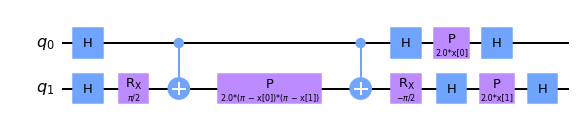


Quantum kernel matrices:



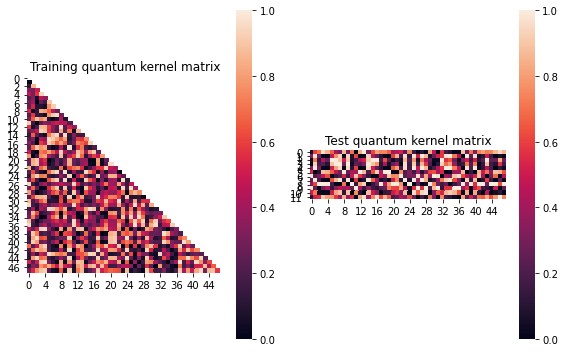


SVM with quantum kernel trained!


Test set performance:


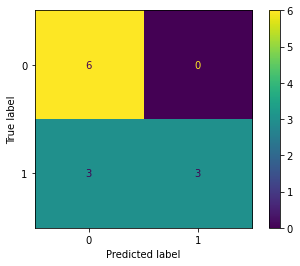

              precision    recall  f1-score   support

           0       0.67      1.00      0.80         6
           1       1.00      0.50      0.67         6

    accuracy                           0.75        12
   macro avg       0.83      0.75      0.73        12
weighted avg       0.83      0.75      0.73        12


metric 1: 0.01664468032457589
metric(s) 2: (00, 10, 11) = (0.470018028929976, 0.4462648057561961, 0.455800943231568)
metric 3: -0.0


----> Kernel construction duration: 00:01:07


Combination 110/468
(Current range: 18/46)
			 reps : 1
			 paulis : ['YZ', 'Y']
			 entanglement : linear

Feature map:


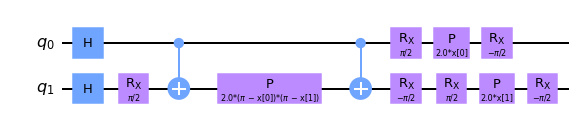


Quantum kernel matrices:



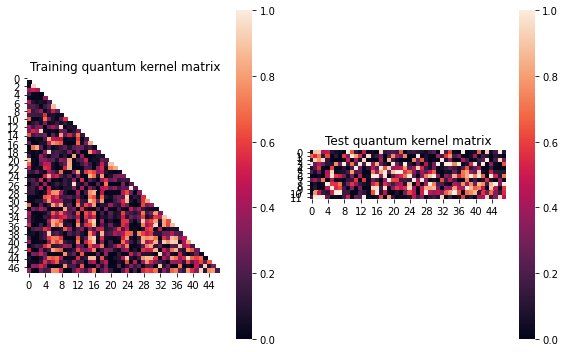


SVM with quantum kernel trained!


Test set performance:


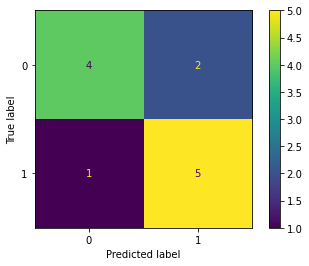

              precision    recall  f1-score   support

           0       0.80      0.67      0.73         6
           1       0.71      0.83      0.77         6

    accuracy                           0.75        12
   macro avg       0.76      0.75      0.75        12
weighted avg       0.76      0.75      0.75        12


metric 1: 0.07553760961994327
metric(s) 2: (00, 10, 11) = (0.2709739146391388, 0.25580564820383755, 0.39171260100842287)
metric 3: -9.0934536e-317


----> Kernel construction duration: 00:01:04


Combination 111/468
(Current range: 19/46)
			 reps : 1
			 paulis : ['YZ', 'Z']
			 entanglement : linear

Feature map:


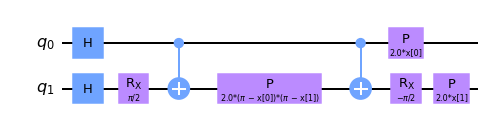


Quantum kernel matrices:



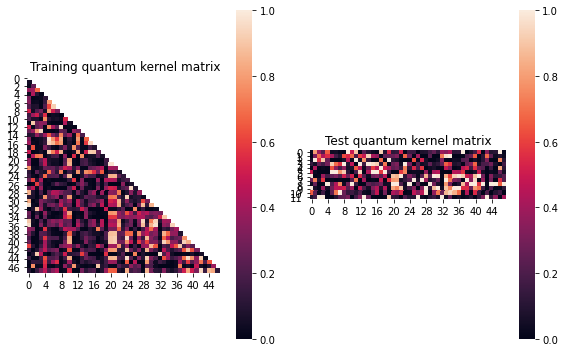


SVM with quantum kernel trained!


Test set performance:


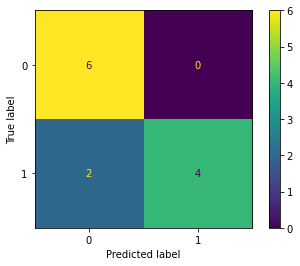

              precision    recall  f1-score   support

           0       0.75      1.00      0.86         6
           1       1.00      0.67      0.80         6

    accuracy                           0.83        12
   macro avg       0.88      0.83      0.83        12
weighted avg       0.88      0.83      0.83        12


metric 1: 0.10437927827899612
metric(s) 2: (00, 10, 11) = (0.29461658904511245, 0.22162949233142543, 0.3574009521757307)
metric 3: -9.30988496961129e-305


----> Kernel construction duration: 00:01:03


Combination 112/468
(Current range: 20/46)
			 reps : 1
			 paulis : ['YZ', 'XX']
			 entanglement : linear

Feature map:


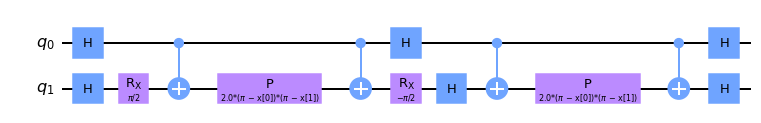


Quantum kernel matrices:



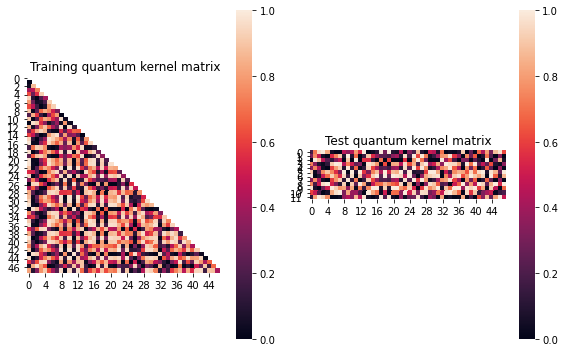


SVM with quantum kernel trained!


Test set performance:


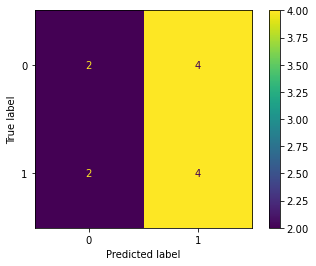

              precision    recall  f1-score   support

           0       0.50      0.33      0.40         6
           1       0.50      0.67      0.57         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.49        12
weighted avg       0.50      0.50      0.49        12


metric 1: 0.0030024471480464276
metric(s) 2: (00, 10, 11) = (0.5194729525883561, 0.5274296115848754, 0.5413911648774875)
metric 3: 0.0


----> Kernel construction duration: 00:01:17


Combination 113/468
(Current range: 21/46)
			 reps : 1
			 paulis : ['YZ', 'XY']
			 entanglement : linear

Feature map:


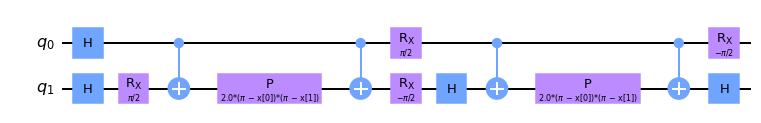


Quantum kernel matrices:



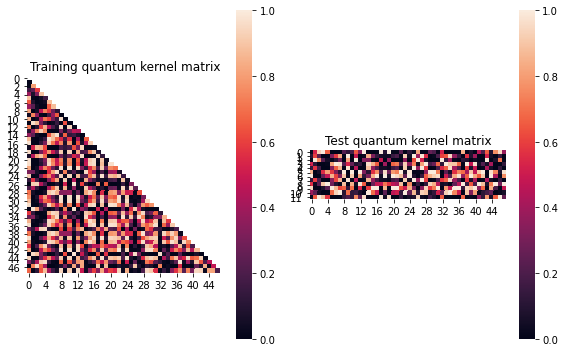


SVM with quantum kernel trained!


Test set performance:


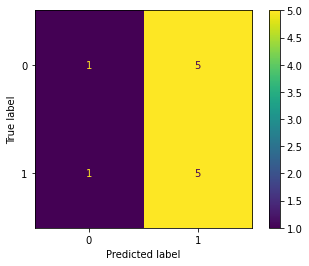

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.0043981638793463285
metric(s) 2: (00, 10, 11) = (0.40613189036271397, 0.4130157528605851, 0.4286959431171489)
metric 3: -0.0


----> Kernel construction duration: 00:01:16


Combination 114/468
(Current range: 22/46)
			 reps : 1
			 paulis : ['YZ', 'XZ']
			 entanglement : linear

Feature map:


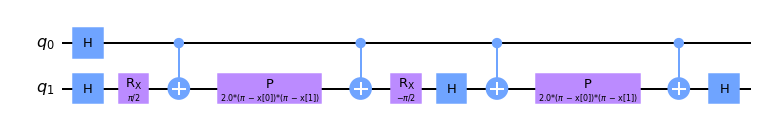


Quantum kernel matrices:



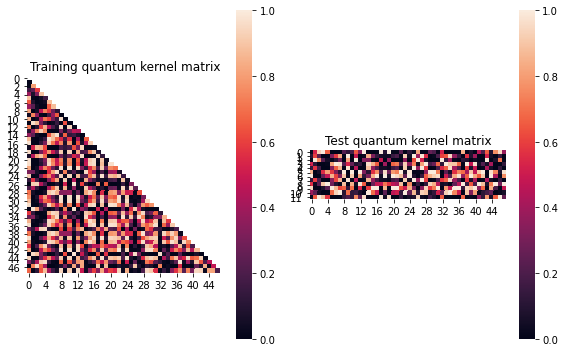


SVM with quantum kernel trained!


Test set performance:


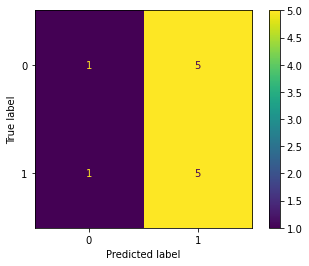

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.0043981638793463285
metric(s) 2: (00, 10, 11) = (0.40613189036271397, 0.4130157528605851, 0.4286959431171489)
metric 3: -0.0


----> Kernel construction duration: 00:01:06


Combination 115/468
(Current range: 23/46)
			 reps : 1
			 paulis : ['YZ', 'YX']
			 entanglement : linear

Feature map:


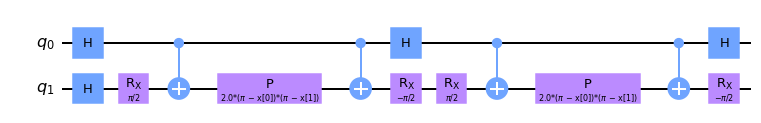


Quantum kernel matrices:



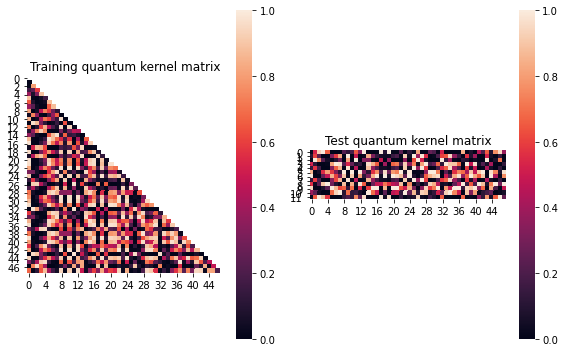


SVM with quantum kernel trained!


Test set performance:


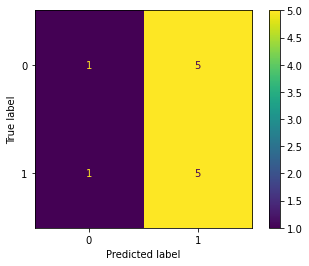

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.0043981638793463285
metric(s) 2: (00, 10, 11) = (0.40613189036271397, 0.4130157528605851, 0.4286959431171489)
metric 3: -0.0


----> Kernel construction duration: 00:01:07


Combination 116/468
(Current range: 24/46)
			 reps : 1
			 paulis : ['YZ', 'YY']
			 entanglement : linear

Feature map:


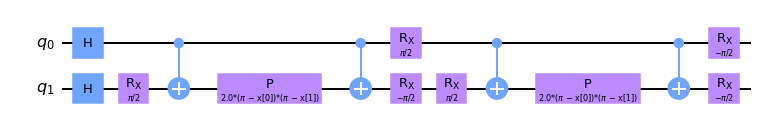


Quantum kernel matrices:



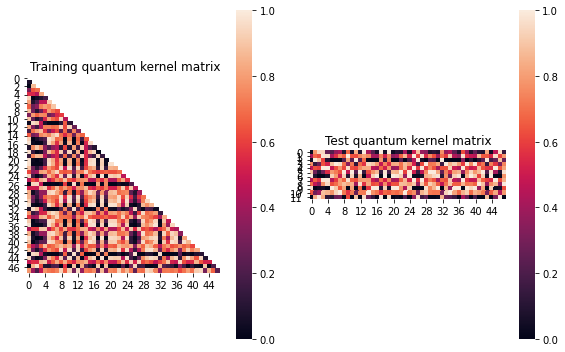


SVM with quantum kernel trained!


Test set performance:


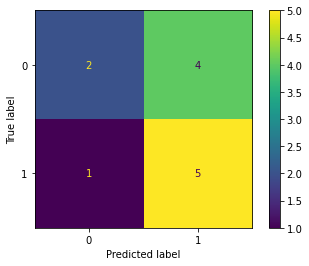

              precision    recall  f1-score   support

           0       0.67      0.33      0.44         6
           1       0.56      0.83      0.67         6

    accuracy                           0.58        12
   macro avg       0.61      0.58      0.56        12
weighted avg       0.61      0.58      0.56        12


metric 1: -0.0006210328716632629
metric(s) 2: (00, 10, 11) = (0.5434756299188566, 0.5555297974455864, 0.5663418992289897)
metric 3: 0.0


----> Kernel construction duration: 00:01:06


Combination 117/468
(Current range: 25/46)
			 reps : 1
			 paulis : ['YZ', 'YZ']
			 entanglement : linear

Feature map:


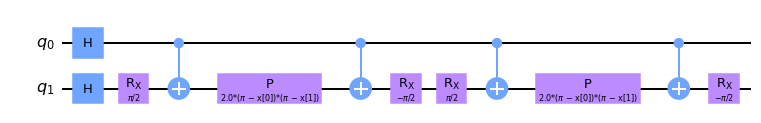


Quantum kernel matrices:



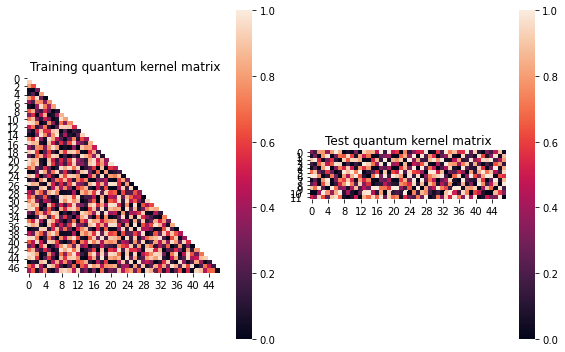


SVM with quantum kernel trained!


Test set performance:


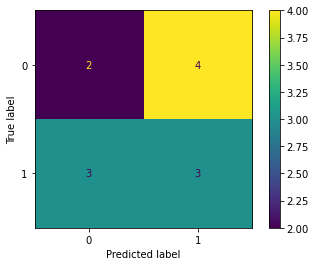

              precision    recall  f1-score   support

           0       0.40      0.33      0.36         6
           1       0.43      0.50      0.46         6

    accuracy                           0.42        12
   macro avg       0.41      0.42      0.41        12
weighted avg       0.41      0.42      0.41        12


metric 1: 0.005189231185427912
metric(s) 2: (00, 10, 11) = (0.49936335961957806, 0.494900756823733, 0.5008166163987438)
metric 3: 0.0


----> Kernel construction duration: 00:00:43


Combination 118/468
(Current range: 26/46)
			 reps : 1
			 paulis : ['YZ', 'ZX']
			 entanglement : linear

Feature map:


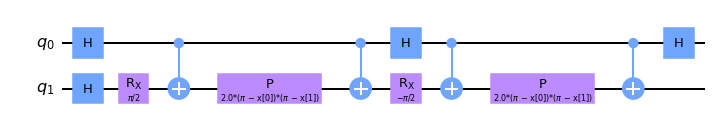


Quantum kernel matrices:



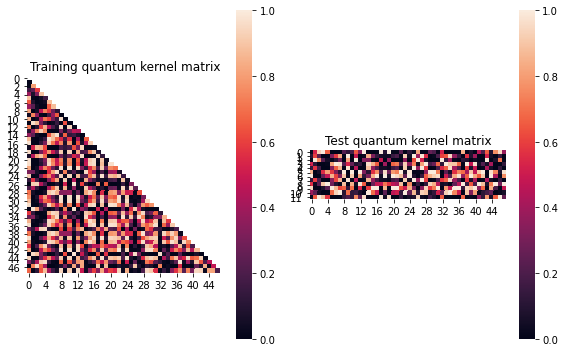


SVM with quantum kernel trained!


Test set performance:


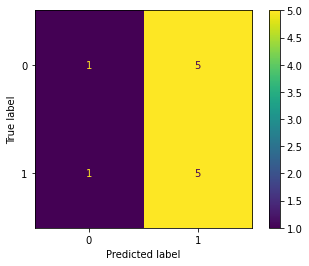

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.0043981638793463285
metric(s) 2: (00, 10, 11) = (0.40613189036271397, 0.4130157528605851, 0.4286959431171489)
metric 3: -0.0


----> Kernel construction duration: 00:01:17


Combination 119/468
(Current range: 27/46)
			 reps : 1
			 paulis : ['YZ', 'ZY']
			 entanglement : linear

Feature map:


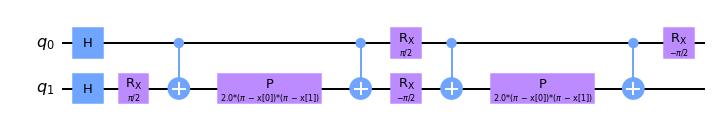


Quantum kernel matrices:



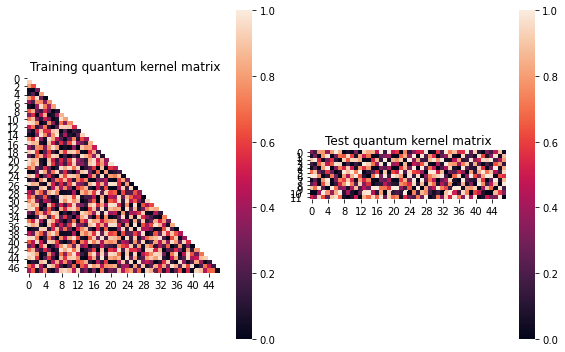


SVM with quantum kernel trained!


Test set performance:


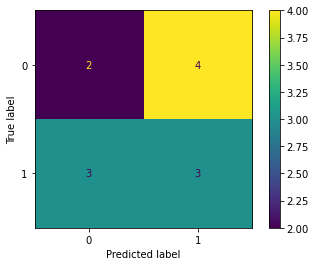

              precision    recall  f1-score   support

           0       0.40      0.33      0.36         6
           1       0.43      0.50      0.46         6

    accuracy                           0.42        12
   macro avg       0.41      0.42      0.41        12
weighted avg       0.41      0.42      0.41        12


metric 1: 0.005189231185427912
metric(s) 2: (00, 10, 11) = (0.49936335961957806, 0.494900756823733, 0.5008166163987438)
metric 3: 0.0


----> Kernel construction duration: 00:01:16


Combination 120/468
(Current range: 28/46)
			 reps : 1
			 paulis : ['YZ', 'ZZ']
			 entanglement : linear

Feature map:


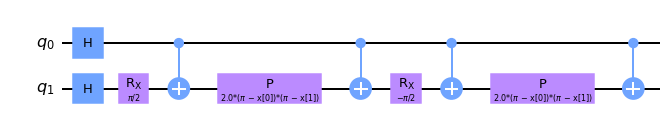


Quantum kernel matrices:



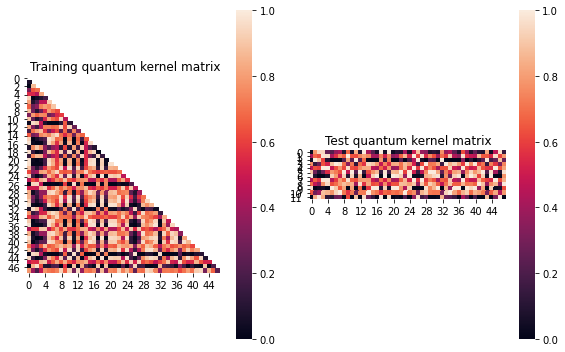


SVM with quantum kernel trained!


Test set performance:


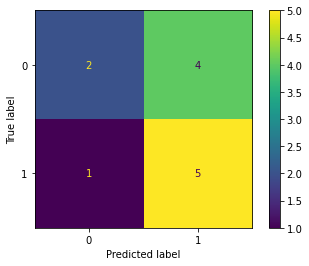

              precision    recall  f1-score   support

           0       0.67      0.33      0.44         6
           1       0.56      0.83      0.67         6

    accuracy                           0.58        12
   macro avg       0.61      0.58      0.56        12
weighted avg       0.61      0.58      0.56        12


metric 1: -0.0006210328716632629
metric(s) 2: (00, 10, 11) = (0.5434756299188566, 0.5555297974455864, 0.5663418992289897)
metric 3: 0.0


----> Kernel construction duration: 00:01:06


Combination 121/468
(Current range: 29/46)
			 reps : 1
			 paulis : ['ZX', 'X']
			 entanglement : linear

Feature map:


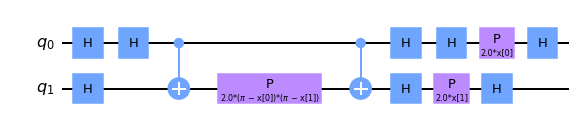


Quantum kernel matrices:



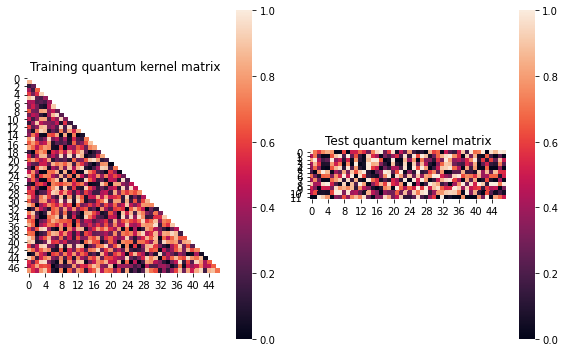


SVM with quantum kernel trained!


Test set performance:


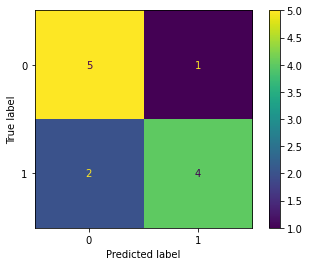

              precision    recall  f1-score   support

           0       0.71      0.83      0.77         6
           1       0.80      0.67      0.73         6

    accuracy                           0.75        12
   macro avg       0.76      0.75      0.75        12
weighted avg       0.76      0.75      0.75        12


metric 1: 0.02112030099530432
metric(s) 2: (00, 10, 11) = (0.4807454989167838, 0.4833957039523437, 0.5282865109785122)
metric 3: 0.0


----> Kernel construction duration: 00:00:51


Combination 122/468
(Current range: 30/46)
			 reps : 1
			 paulis : ['ZX', 'Y']
			 entanglement : linear

Feature map:


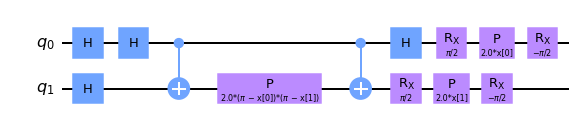


Quantum kernel matrices:



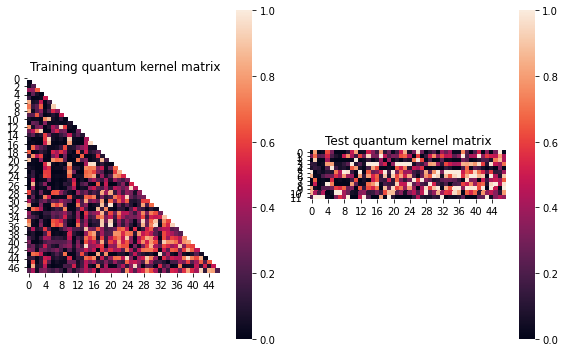


SVM with quantum kernel trained!


Test set performance:


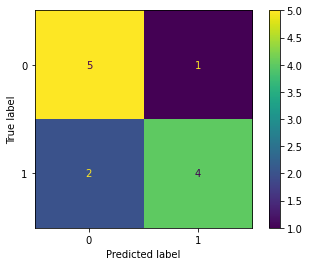

              precision    recall  f1-score   support

           0       0.71      0.83      0.77         6
           1       0.80      0.67      0.73         6

    accuracy                           0.75        12
   macro avg       0.76      0.75      0.75        12
weighted avg       0.76      0.75      0.75        12


metric 1: 0.08426766865323199
metric(s) 2: (00, 10, 11) = (0.2818615013303951, 0.27514376135204316, 0.4369613586801552)
metric 3: 3.567907018307824e-276


----> Kernel construction duration: 00:00:53


Combination 123/468
(Current range: 31/46)
			 reps : 1
			 paulis : ['ZX', 'Z']
			 entanglement : linear

Feature map:


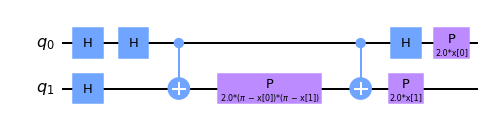


Quantum kernel matrices:



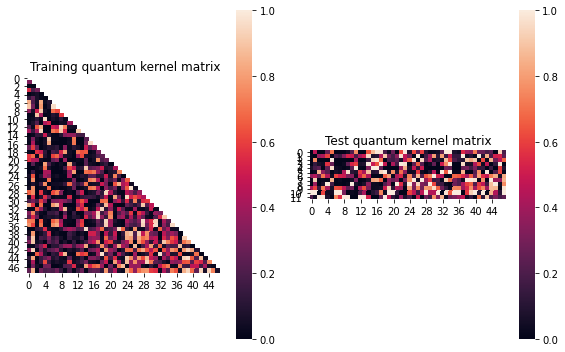


SVM with quantum kernel trained!


Test set performance:


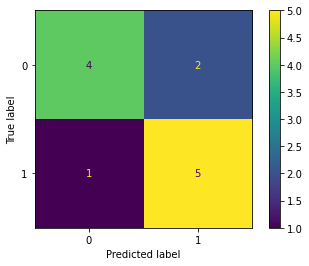

              precision    recall  f1-score   support

           0       0.80      0.67      0.73         6
           1       0.71      0.83      0.77         6

    accuracy                           0.75        12
   macro avg       0.76      0.75      0.75        12
weighted avg       0.76      0.75      0.75        12


metric 1: 0.10146591669195204
metric(s) 2: (00, 10, 11) = (0.2698208171299745, 0.2502513736195271, 0.4336137634929837)
metric 3: 5.2964e-319


----> Kernel construction duration: 00:00:51


Combination 124/468
(Current range: 32/46)
			 reps : 1
			 paulis : ['ZX', 'XX']
			 entanglement : linear

Feature map:


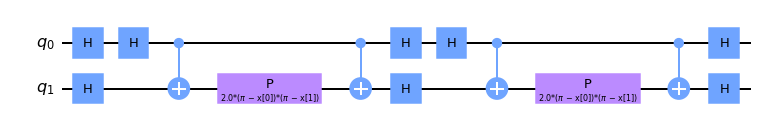


Quantum kernel matrices:



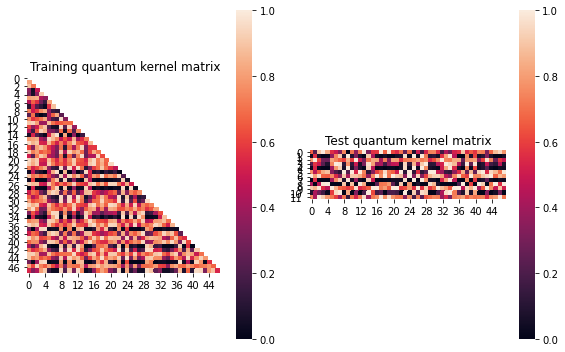


SVM with quantum kernel trained!


Test set performance:


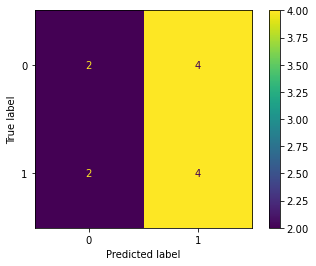

              precision    recall  f1-score   support

           0       0.50      0.33      0.40         6
           1       0.50      0.67      0.57         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.49        12
weighted avg       0.50      0.50      0.49        12


metric 1: 0.0038856891228058466
metric(s) 2: (00, 10, 11) = (0.5750413430180592, 0.567681615172725, 0.5680932655730024)
metric 3: -0.0


----> Kernel construction duration: 00:00:55


Combination 125/468
(Current range: 33/46)
			 reps : 1
			 paulis : ['ZX', 'XY']
			 entanglement : linear

Feature map:


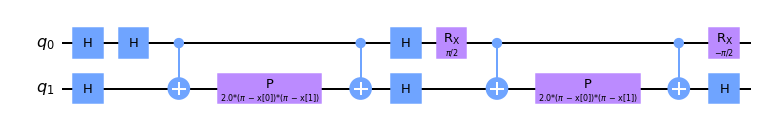


Quantum kernel matrices:



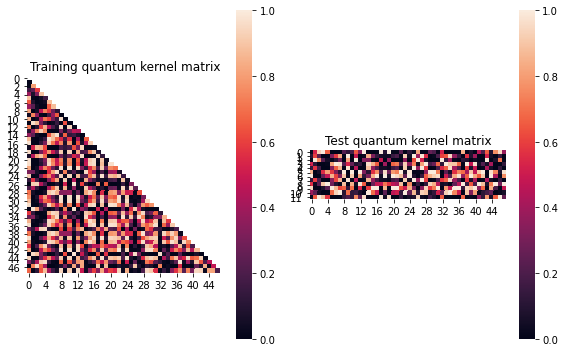


SVM with quantum kernel trained!


Test set performance:


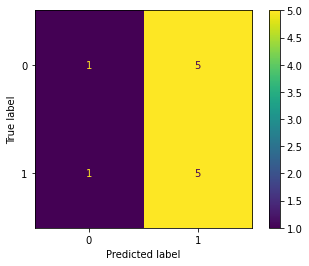

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.0043981638793463285
metric(s) 2: (00, 10, 11) = (0.40613189036271397, 0.4130157528605851, 0.4286959431171489)
metric 3: -0.0


----> Kernel construction duration: 00:01:06


Combination 126/468
(Current range: 34/46)
			 reps : 1
			 paulis : ['ZX', 'XZ']
			 entanglement : linear

Feature map:


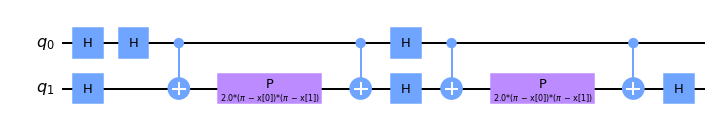


Quantum kernel matrices:



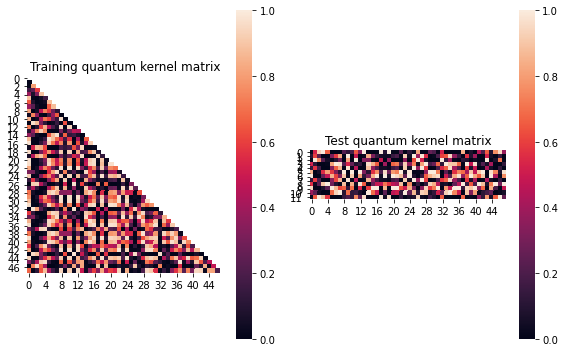


SVM with quantum kernel trained!


Test set performance:


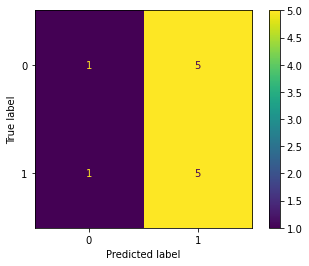

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.0043981638793463285
metric(s) 2: (00, 10, 11) = (0.40613189036271397, 0.4130157528605851, 0.4286959431171489)
metric 3: -0.0


----> Kernel construction duration: 00:01:06


Combination 127/468
(Current range: 35/46)
			 reps : 1
			 paulis : ['ZX', 'YX']
			 entanglement : linear

Feature map:


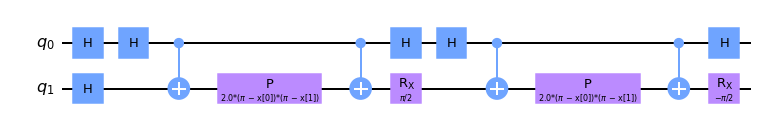


Quantum kernel matrices:



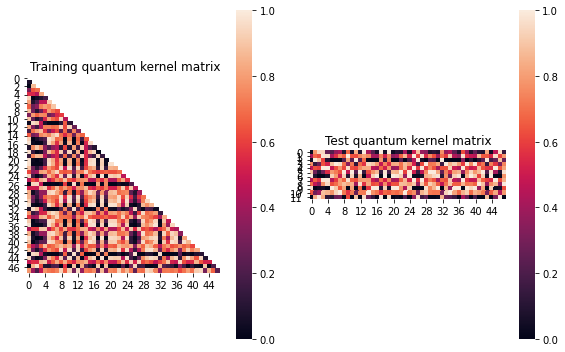


SVM with quantum kernel trained!


Test set performance:


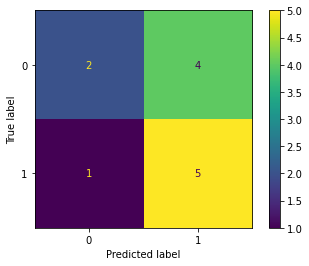

              precision    recall  f1-score   support

           0       0.67      0.33      0.44         6
           1       0.56      0.83      0.67         6

    accuracy                           0.58        12
   macro avg       0.61      0.58      0.56        12
weighted avg       0.61      0.58      0.56        12


metric 1: -0.0006210328716632629
metric(s) 2: (00, 10, 11) = (0.5434756299188566, 0.5555297974455864, 0.5663418992289897)
metric 3: 0.0


----> Kernel construction duration: 00:00:54


Combination 128/468
(Current range: 36/46)
			 reps : 1
			 paulis : ['ZX', 'YY']
			 entanglement : linear

Feature map:


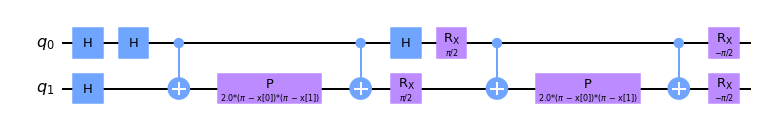


Quantum kernel matrices:



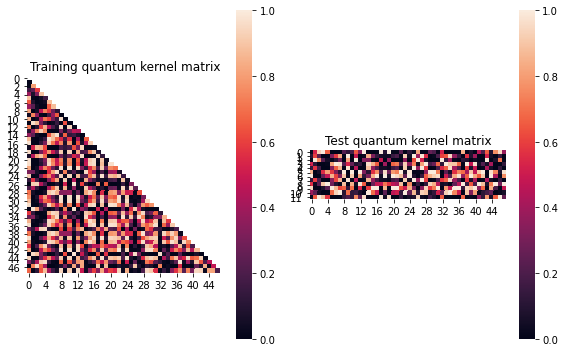


SVM with quantum kernel trained!


Test set performance:


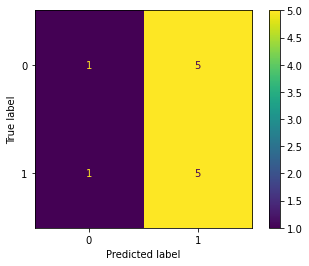

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.0043981638793463285
metric(s) 2: (00, 10, 11) = (0.40613189036271397, 0.4130157528605851, 0.4286959431171489)
metric 3: -0.0


----> Kernel construction duration: 00:01:06


Combination 129/468
(Current range: 37/46)
			 reps : 1
			 paulis : ['ZX', 'YZ']
			 entanglement : linear

Feature map:


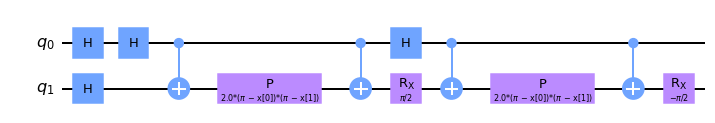


Quantum kernel matrices:



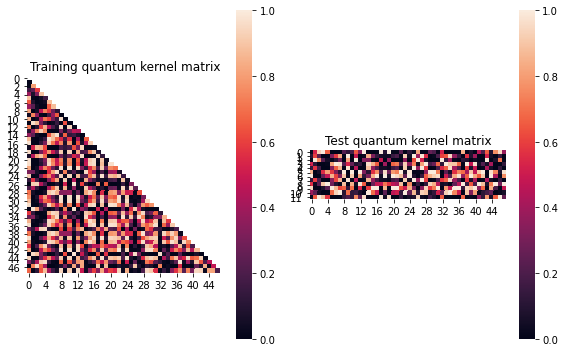


SVM with quantum kernel trained!


Test set performance:


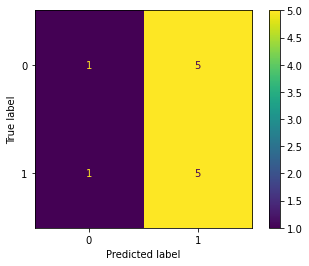

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.0043981638793463285
metric(s) 2: (00, 10, 11) = (0.40613189036271397, 0.4130157528605851, 0.4286959431171489)
metric 3: -0.0


----> Kernel construction duration: 00:01:05


Combination 130/468
(Current range: 38/46)
			 reps : 1
			 paulis : ['ZX', 'ZX']
			 entanglement : linear

Feature map:


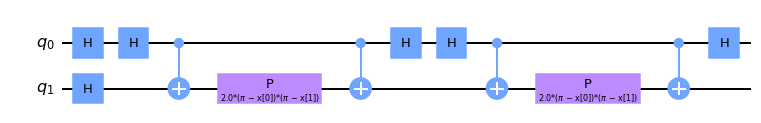


Quantum kernel matrices:



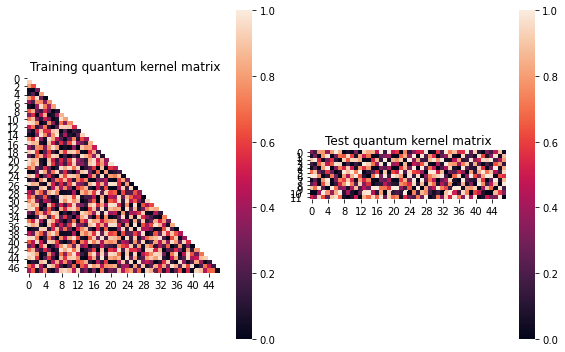


SVM with quantum kernel trained!


Test set performance:


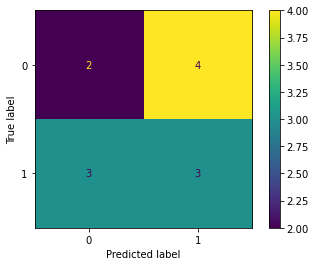

              precision    recall  f1-score   support

           0       0.40      0.33      0.36         6
           1       0.43      0.50      0.46         6

    accuracy                           0.42        12
   macro avg       0.41      0.42      0.41        12
weighted avg       0.41      0.42      0.41        12


metric 1: 0.005189231185427912
metric(s) 2: (00, 10, 11) = (0.49936335961957806, 0.494900756823733, 0.5008166163987438)
metric 3: 0.0


----> Kernel construction duration: 00:00:32


Combination 131/468
(Current range: 39/46)
			 reps : 1
			 paulis : ['ZX', 'ZY']
			 entanglement : linear

Feature map:


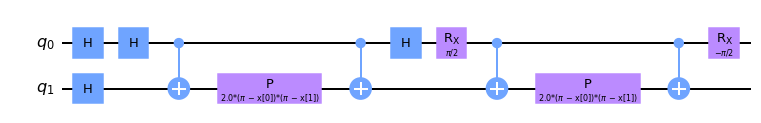


Quantum kernel matrices:



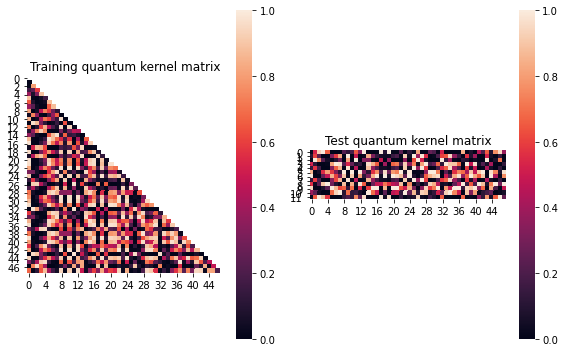


SVM with quantum kernel trained!


Test set performance:


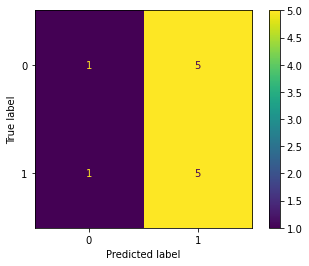

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.0043981638793463285
metric(s) 2: (00, 10, 11) = (0.40613189036271397, 0.4130157528605851, 0.4286959431171489)
metric 3: -0.0


----> Kernel construction duration: 00:00:55


Combination 132/468
(Current range: 40/46)
			 reps : 1
			 paulis : ['ZX', 'ZZ']
			 entanglement : linear

Feature map:


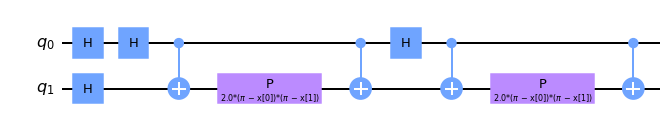


Quantum kernel matrices:



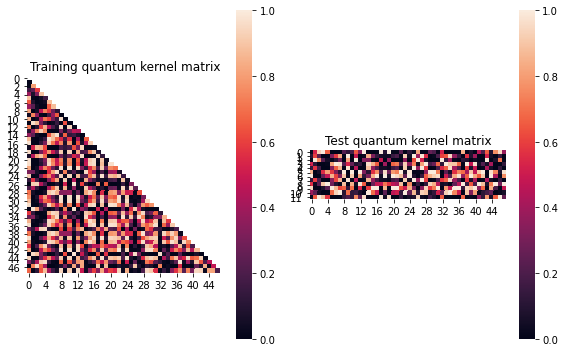


SVM with quantum kernel trained!


Test set performance:


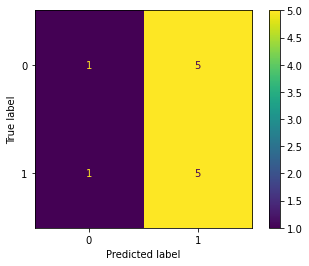

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.0043981638793463285
metric(s) 2: (00, 10, 11) = (0.40613189036271397, 0.4130157528605851, 0.4286959431171489)
metric 3: -0.0


----> Kernel construction duration: 00:00:54


Combination 133/468
(Current range: 41/46)
			 reps : 1
			 paulis : ['ZY', 'X']
			 entanglement : linear

Feature map:


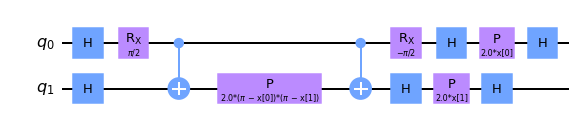


Quantum kernel matrices:



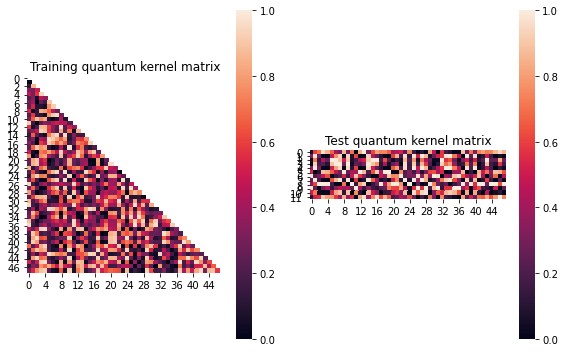


SVM with quantum kernel trained!


Test set performance:


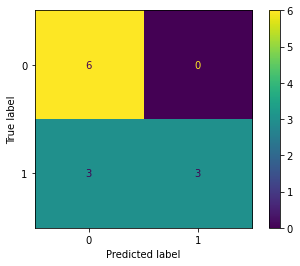

              precision    recall  f1-score   support

           0       0.67      1.00      0.80         6
           1       1.00      0.50      0.67         6

    accuracy                           0.75        12
   macro avg       0.83      0.75      0.73        12
weighted avg       0.83      0.75      0.73        12


metric 1: 0.01664468032457589
metric(s) 2: (00, 10, 11) = (0.470018028929976, 0.4462648057561961, 0.455800943231568)
metric 3: -0.0


----> Kernel construction duration: 00:01:04


Combination 134/468
(Current range: 42/46)
			 reps : 1
			 paulis : ['ZY', 'Y']
			 entanglement : linear

Feature map:


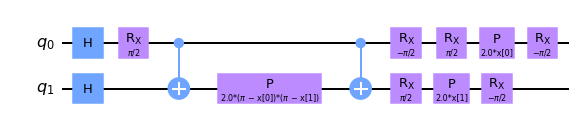


Quantum kernel matrices:



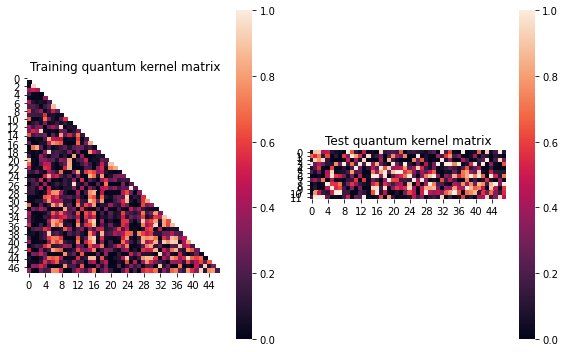


SVM with quantum kernel trained!


Test set performance:


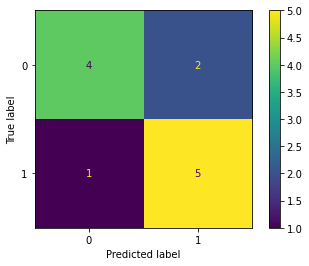

              precision    recall  f1-score   support

           0       0.80      0.67      0.73         6
           1       0.71      0.83      0.77         6

    accuracy                           0.75        12
   macro avg       0.76      0.75      0.75        12
weighted avg       0.76      0.75      0.75        12


metric 1: 0.07553760961994327
metric(s) 2: (00, 10, 11) = (0.2709739146391388, 0.25580564820383755, 0.39171260100842287)
metric 3: -9.0934536e-317


----> Kernel construction duration: 00:01:03


Combination 135/468
(Current range: 43/46)
			 reps : 1
			 paulis : ['ZY', 'Z']
			 entanglement : linear

Feature map:


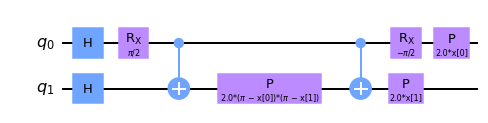


Quantum kernel matrices:



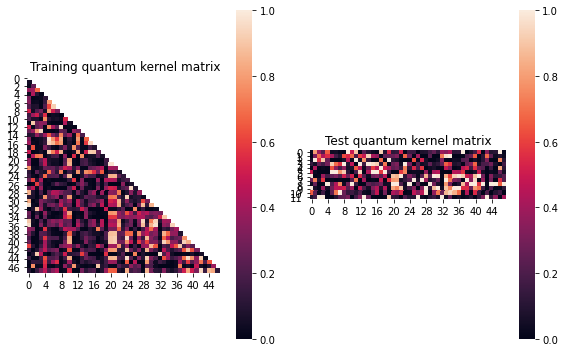


SVM with quantum kernel trained!


Test set performance:


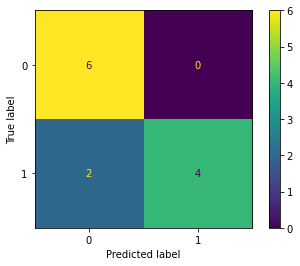

              precision    recall  f1-score   support

           0       0.75      1.00      0.86         6
           1       1.00      0.67      0.80         6

    accuracy                           0.83        12
   macro avg       0.88      0.83      0.83        12
weighted avg       0.88      0.83      0.83        12


metric 1: 0.10437927827899612
metric(s) 2: (00, 10, 11) = (0.29461658904511245, 0.22162949233142543, 0.3574009521757307)
metric 3: -9.30988496961129e-305


----> Kernel construction duration: 00:01:04


Combination 136/468
(Current range: 44/46)
			 reps : 1
			 paulis : ['ZY', 'XX']
			 entanglement : linear

Feature map:


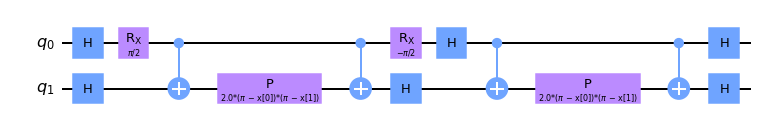


Quantum kernel matrices:



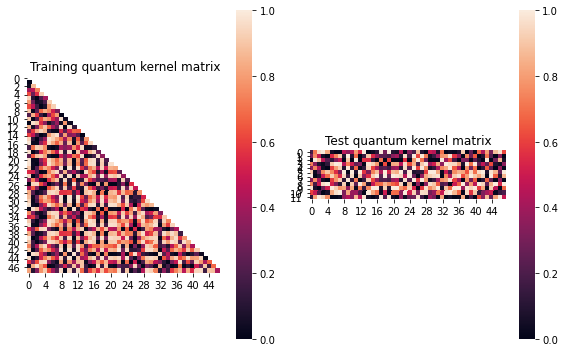


SVM with quantum kernel trained!


Test set performance:


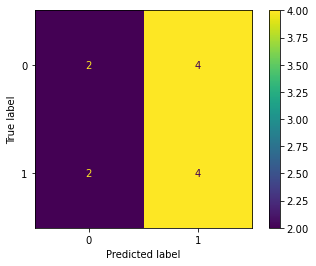

              precision    recall  f1-score   support

           0       0.50      0.33      0.40         6
           1       0.50      0.67      0.57         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.49        12
weighted avg       0.50      0.50      0.49        12


metric 1: 0.0030024471480464276
metric(s) 2: (00, 10, 11) = (0.5194729525883561, 0.5274296115848754, 0.5413911648774875)
metric 3: 0.0


----> Kernel construction duration: 00:01:17


Combination 137/468
(Current range: 45/46)
			 reps : 1
			 paulis : ['ZY', 'XY']
			 entanglement : linear

Feature map:


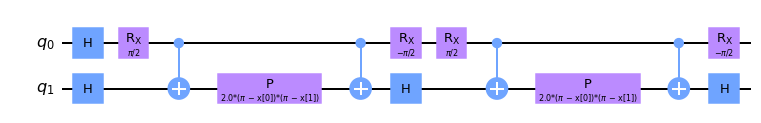


Quantum kernel matrices:



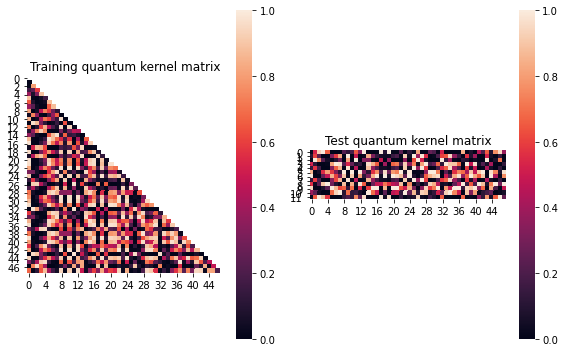


SVM with quantum kernel trained!


Test set performance:


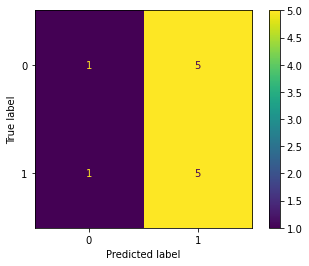

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.0043981638793463285
metric(s) 2: (00, 10, 11) = (0.40613189036271397, 0.4130157528605851, 0.4286959431171489)
metric 3: -0.0


----> Kernel construction duration: 00:01:06


Combination 138/468
(Current range: 46/46)
			 reps : 1
			 paulis : ['ZY', 'XZ']
			 entanglement : linear

Feature map:


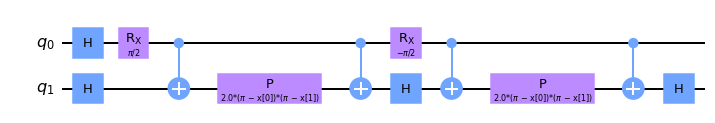


Quantum kernel matrices:



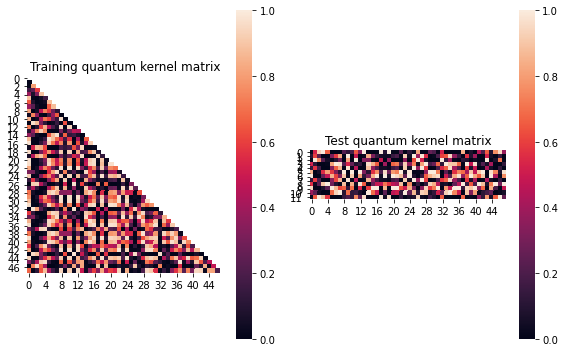


SVM with quantum kernel trained!


Test set performance:


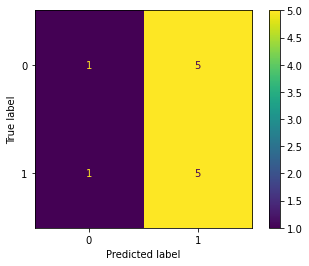

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.0043981638793463285
metric(s) 2: (00, 10, 11) = (0.40613189036271397, 0.4130157528605851, 0.4286959431171489)
metric 3: -0.0


----> Kernel construction duration: 00:01:17


In [15]:
j=2
results.append(run_kernel_evaluation(X, X_train, y_train, X_test, y_test,
                                      param_grid, range_list, j, model=True))



Combination 139/468
(Current range: 1/46)
			 reps : 1
			 paulis : ['ZY', 'YX']
			 entanglement : linear

Feature map:


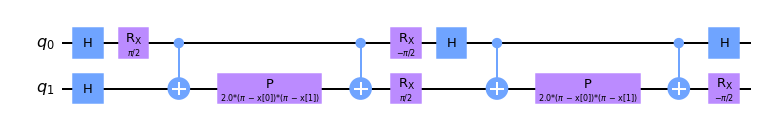


Quantum kernel matrices:



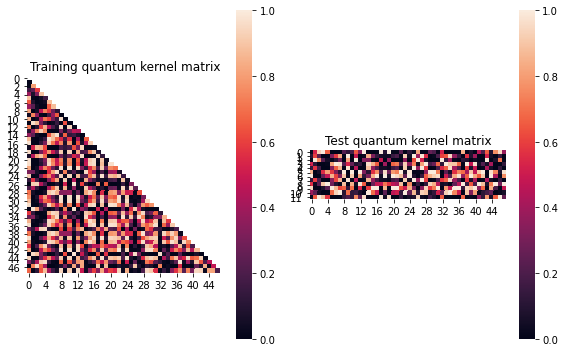


SVM with quantum kernel trained!


Test set performance:


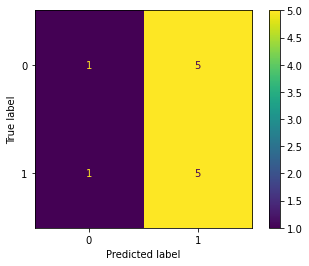

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.0043981638793463285
metric(s) 2: (00, 10, 11) = (0.40613189036271397, 0.4130157528605851, 0.4286959431171489)
metric 3: -0.0


----> Kernel construction duration: 00:01:17


Combination 140/468
(Current range: 2/46)
			 reps : 1
			 paulis : ['ZY', 'YY']
			 entanglement : linear

Feature map:


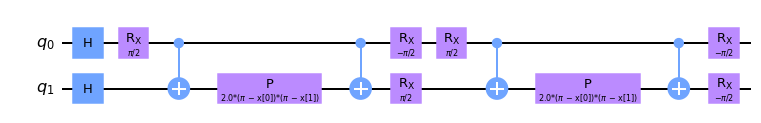


Quantum kernel matrices:



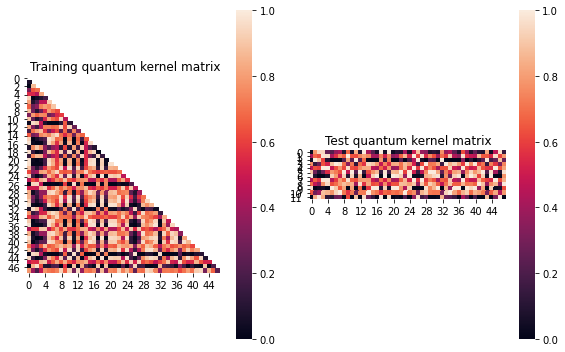


SVM with quantum kernel trained!


Test set performance:


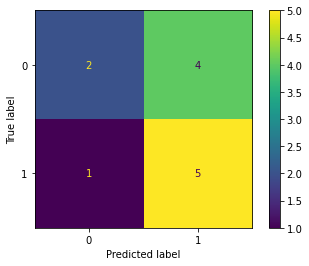

              precision    recall  f1-score   support

           0       0.67      0.33      0.44         6
           1       0.56      0.83      0.67         6

    accuracy                           0.58        12
   macro avg       0.61      0.58      0.56        12
weighted avg       0.61      0.58      0.56        12


metric 1: -0.0006210328716632629
metric(s) 2: (00, 10, 11) = (0.5434756299188566, 0.5555297974455864, 0.5663418992289897)
metric 3: 0.0


----> Kernel construction duration: 00:01:06


Combination 141/468
(Current range: 3/46)
			 reps : 1
			 paulis : ['ZY', 'YZ']
			 entanglement : linear

Feature map:


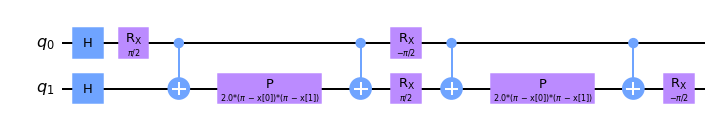


Quantum kernel matrices:



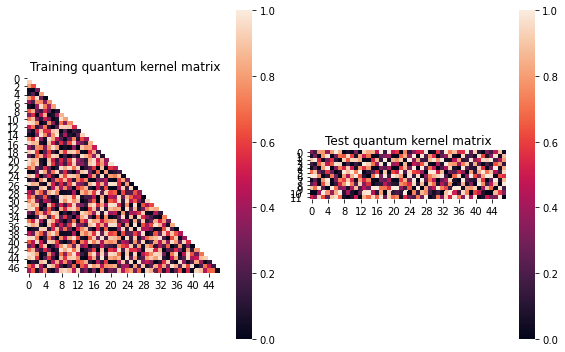


SVM with quantum kernel trained!


Test set performance:


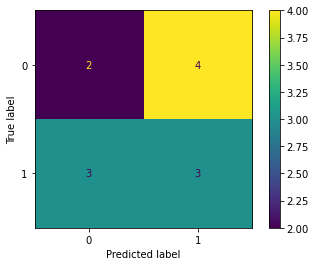

              precision    recall  f1-score   support

           0       0.40      0.33      0.36         6
           1       0.43      0.50      0.46         6

    accuracy                           0.42        12
   macro avg       0.41      0.42      0.41        12
weighted avg       0.41      0.42      0.41        12


metric 1: 0.005189231185427912
metric(s) 2: (00, 10, 11) = (0.49936335961957806, 0.494900756823733, 0.5008166163987438)
metric 3: 0.0


----> Kernel construction duration: 00:01:16


Combination 142/468
(Current range: 4/46)
			 reps : 1
			 paulis : ['ZY', 'ZX']
			 entanglement : linear

Feature map:


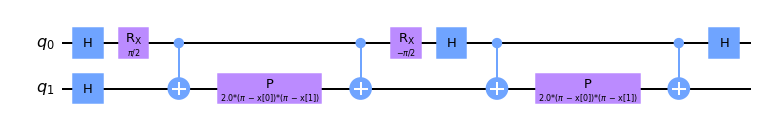


Quantum kernel matrices:



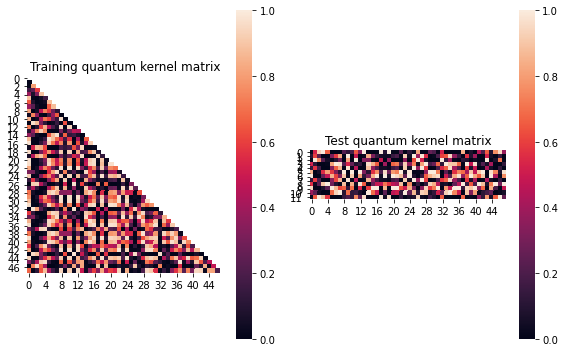


SVM with quantum kernel trained!


Test set performance:


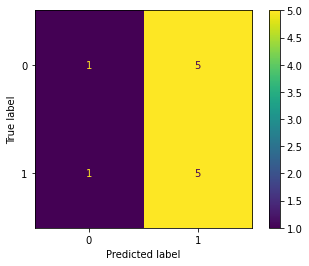

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.0043981638793463285
metric(s) 2: (00, 10, 11) = (0.40613189036271397, 0.4130157528605851, 0.4286959431171489)
metric 3: -0.0


----> Kernel construction duration: 00:01:06


Combination 143/468
(Current range: 5/46)
			 reps : 1
			 paulis : ['ZY', 'ZY']
			 entanglement : linear

Feature map:


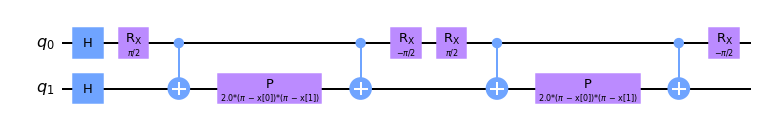


Quantum kernel matrices:



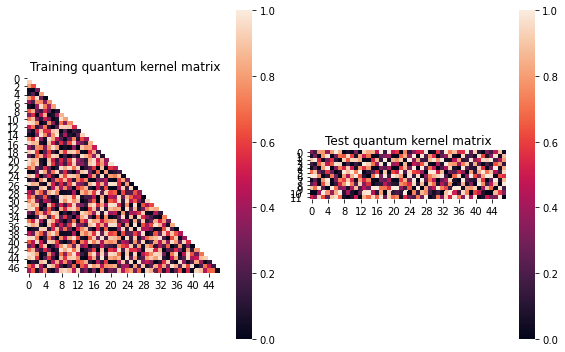


SVM with quantum kernel trained!


Test set performance:


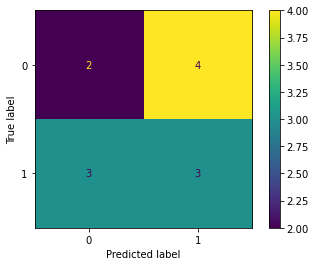

              precision    recall  f1-score   support

           0       0.40      0.33      0.36         6
           1       0.43      0.50      0.46         6

    accuracy                           0.42        12
   macro avg       0.41      0.42      0.41        12
weighted avg       0.41      0.42      0.41        12


metric 1: 0.005189231185427912
metric(s) 2: (00, 10, 11) = (0.49936335961957806, 0.494900756823733, 0.5008166163987438)
metric 3: 0.0


----> Kernel construction duration: 00:00:43


Combination 144/468
(Current range: 6/46)
			 reps : 1
			 paulis : ['ZY', 'ZZ']
			 entanglement : linear

Feature map:


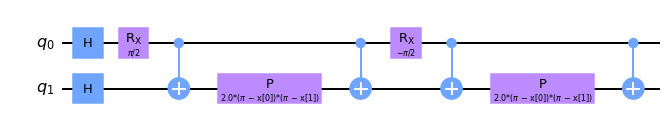


Quantum kernel matrices:



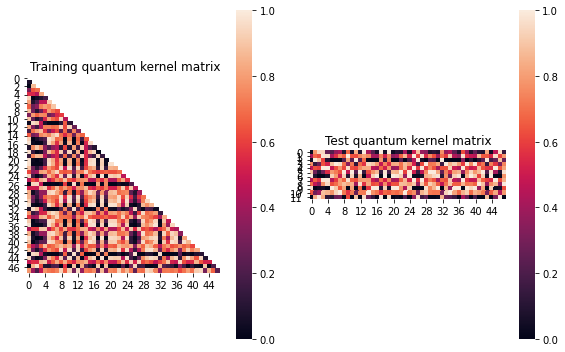


SVM with quantum kernel trained!


Test set performance:


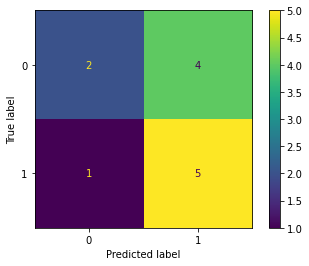

              precision    recall  f1-score   support

           0       0.67      0.33      0.44         6
           1       0.56      0.83      0.67         6

    accuracy                           0.58        12
   macro avg       0.61      0.58      0.56        12
weighted avg       0.61      0.58      0.56        12


metric 1: -0.0006210328716632629
metric(s) 2: (00, 10, 11) = (0.5434756299188566, 0.5555297974455864, 0.5663418992289897)
metric 3: 0.0


----> Kernel construction duration: 00:01:06


Combination 145/468
(Current range: 7/46)
			 reps : 1
			 paulis : ['ZZ', 'X']
			 entanglement : linear

Feature map:


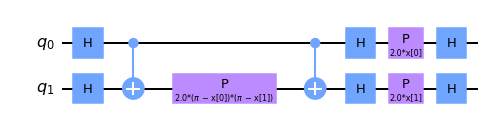


Quantum kernel matrices:



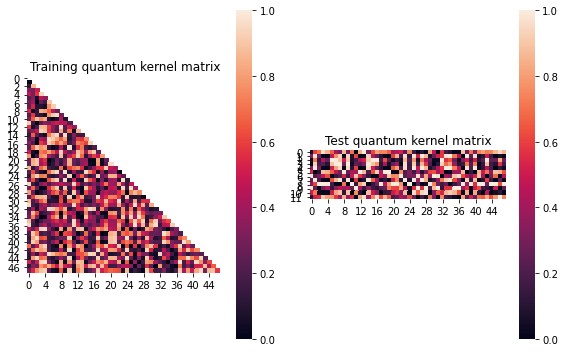


SVM with quantum kernel trained!


Test set performance:


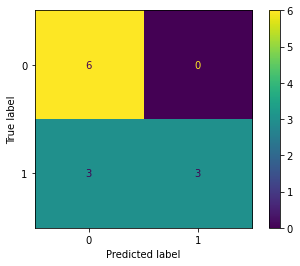

              precision    recall  f1-score   support

           0       0.67      1.00      0.80         6
           1       1.00      0.50      0.67         6

    accuracy                           0.75        12
   macro avg       0.83      0.75      0.73        12
weighted avg       0.83      0.75      0.73        12


metric 1: 0.01664468032457589
metric(s) 2: (00, 10, 11) = (0.470018028929976, 0.4462648057561961, 0.455800943231568)
metric 3: -0.0


----> Kernel construction duration: 00:01:04


Combination 146/468
(Current range: 8/46)
			 reps : 1
			 paulis : ['ZZ', 'Y']
			 entanglement : linear

Feature map:


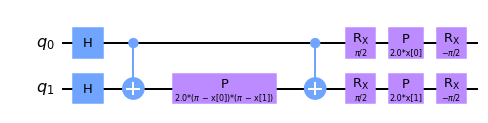


Quantum kernel matrices:



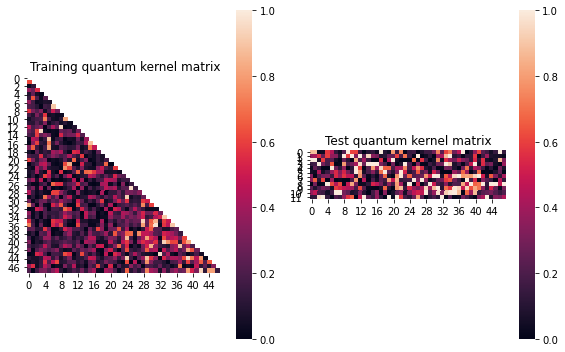


SVM with quantum kernel trained!


Test set performance:


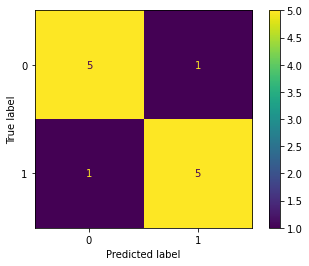

              precision    recall  f1-score   support

           0       0.83      0.83      0.83         6
           1       0.83      0.83      0.83         6

    accuracy                           0.83        12
   macro avg       0.83      0.83      0.83        12
weighted avg       0.83      0.83      0.83        12


metric 1: 0.1045473502897318
metric(s) 2: (00, 10, 11) = (0.26357271453930053, 0.21214886155599652, 0.3698197091521561)
metric 3: 2.3512872618074066e-286


----> Kernel construction duration: 00:01:04


Combination 147/468
(Current range: 9/46)
			 reps : 1
			 paulis : ['ZZ', 'Z']
			 entanglement : linear

Feature map:


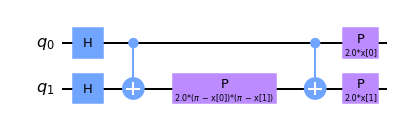


Quantum kernel matrices:



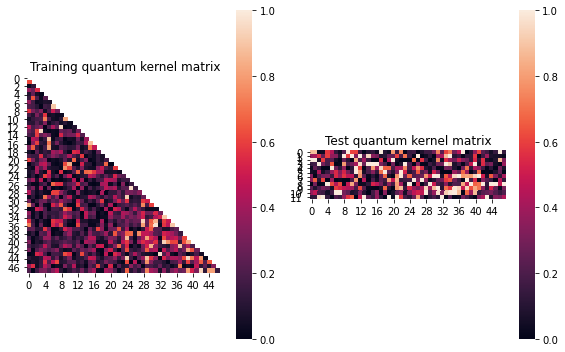


SVM with quantum kernel trained!


Test set performance:


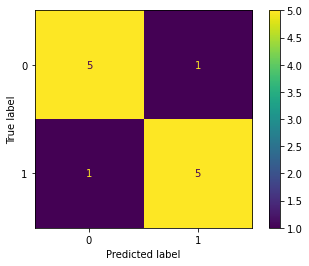

              precision    recall  f1-score   support

           0       0.83      0.83      0.83         6
           1       0.83      0.83      0.83         6

    accuracy                           0.83        12
   macro avg       0.83      0.83      0.83        12
weighted avg       0.83      0.83      0.83        12


metric 1: 0.1045473502897318
metric(s) 2: (00, 10, 11) = (0.26357271453930053, 0.21214886155599652, 0.3698197091521561)
metric 3: 2.3512872618074066e-286


----> Kernel construction duration: 00:00:59


Combination 148/468
(Current range: 10/46)
			 reps : 1
			 paulis : ['ZZ', 'XX']
			 entanglement : linear

Feature map:


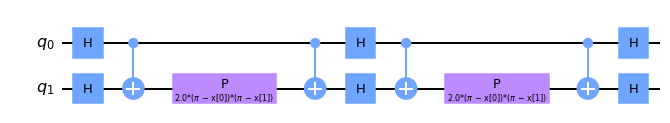


Quantum kernel matrices:



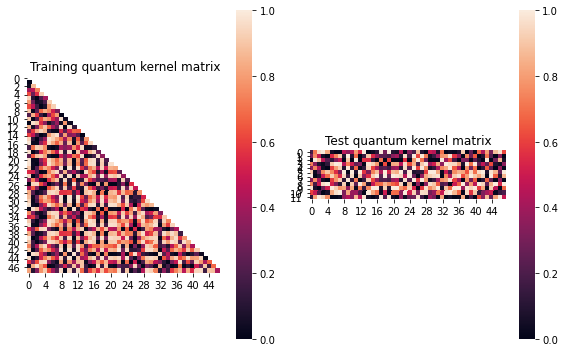


SVM with quantum kernel trained!


Test set performance:


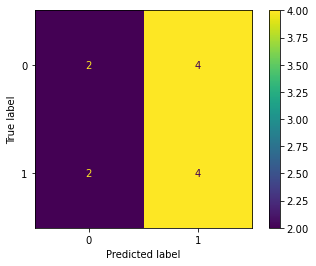

              precision    recall  f1-score   support

           0       0.50      0.33      0.40         6
           1       0.50      0.67      0.57         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.49        12
weighted avg       0.50      0.50      0.49        12


metric 1: 0.0030024471480464276
metric(s) 2: (00, 10, 11) = (0.5194729525883561, 0.5274296115848754, 0.5413911648774875)
metric 3: 0.0


----> Kernel construction duration: 00:01:17


Combination 149/468
(Current range: 11/46)
			 reps : 1
			 paulis : ['ZZ', 'XY']
			 entanglement : linear

Feature map:


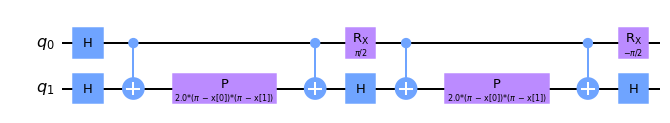


Quantum kernel matrices:



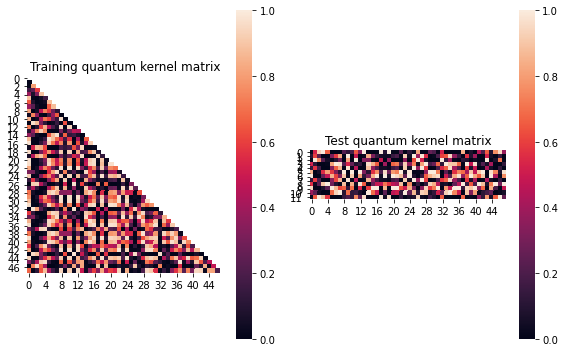


SVM with quantum kernel trained!


Test set performance:


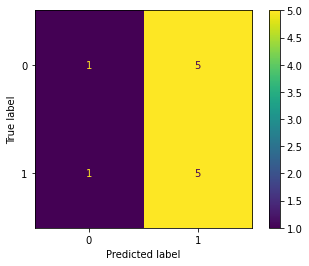

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.0043981638793463285
metric(s) 2: (00, 10, 11) = (0.40613189036271397, 0.4130157528605851, 0.4286959431171489)
metric 3: -0.0


----> Kernel construction duration: 00:01:16


Combination 150/468
(Current range: 12/46)
			 reps : 1
			 paulis : ['ZZ', 'XZ']
			 entanglement : linear

Feature map:


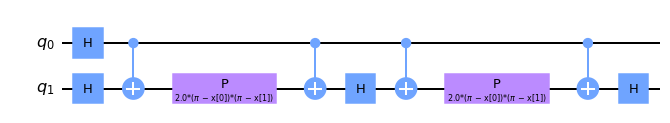


Quantum kernel matrices:



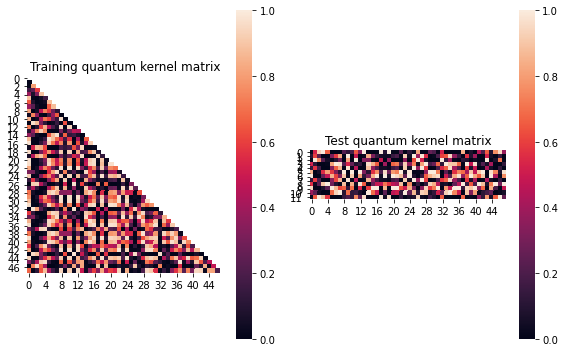


SVM with quantum kernel trained!


Test set performance:


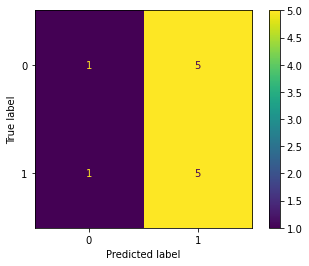

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.0043981638793463285
metric(s) 2: (00, 10, 11) = (0.40613189036271397, 0.4130157528605851, 0.4286959431171489)
metric 3: -0.0


----> Kernel construction duration: 00:01:06


Combination 151/468
(Current range: 13/46)
			 reps : 1
			 paulis : ['ZZ', 'YX']
			 entanglement : linear

Feature map:


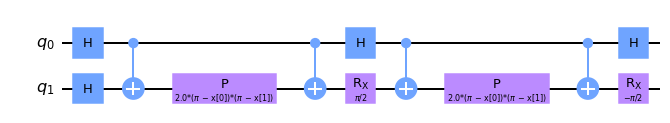


Quantum kernel matrices:



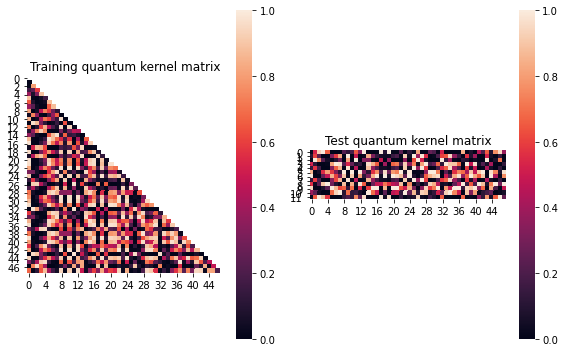


SVM with quantum kernel trained!


Test set performance:


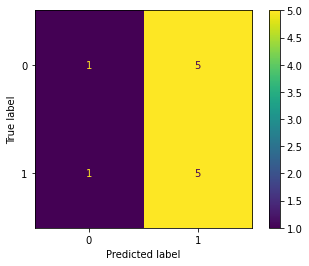

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.0043981638793463285
metric(s) 2: (00, 10, 11) = (0.40613189036271397, 0.4130157528605851, 0.4286959431171489)
metric 3: -0.0


----> Kernel construction duration: 00:01:16


Combination 152/468
(Current range: 14/46)
			 reps : 1
			 paulis : ['ZZ', 'YY']
			 entanglement : linear

Feature map:


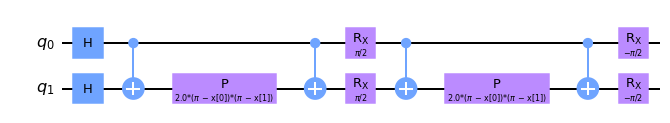


Quantum kernel matrices:



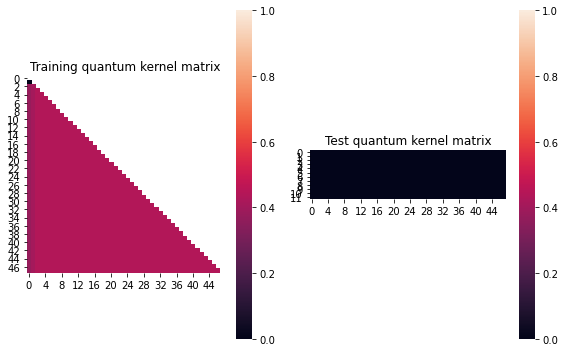


SVM with quantum kernel trained!


Test set performance:


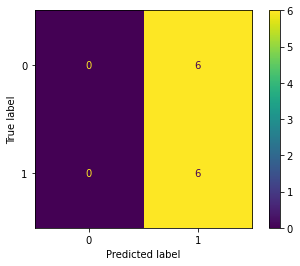

              precision    recall  f1-score   support

           0       0.00      0.00      0.00         6
           1       0.50      1.00      0.67         6

    accuracy                           0.50        12
   macro avg       0.25      0.50      0.33        12
weighted avg       0.25      0.50      0.33        12


metric 1: 0.00472005208333337
metric(s) 2: (00, 10, 11) = (0.4391276041666667, 0.43359375, 0.4375)
metric 3: 0.0


----> Kernel construction duration: 00:01:16


Combination 153/468
(Current range: 15/46)
			 reps : 1
			 paulis : ['ZZ', 'YZ']
			 entanglement : linear

Feature map:


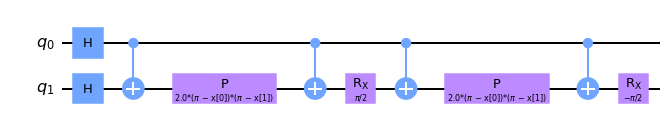


Quantum kernel matrices:



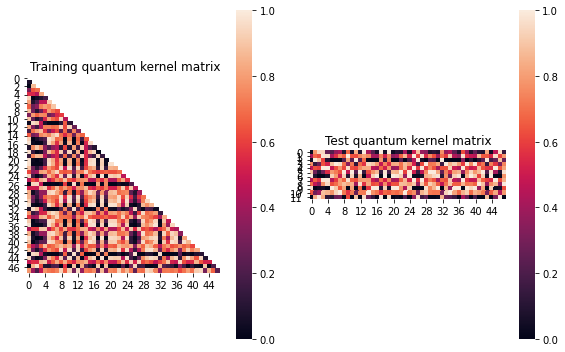


SVM with quantum kernel trained!


Test set performance:


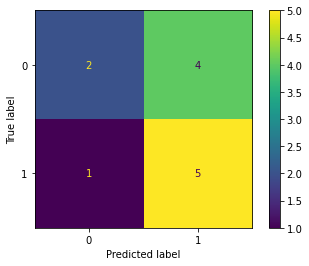

              precision    recall  f1-score   support

           0       0.67      0.33      0.44         6
           1       0.56      0.83      0.67         6

    accuracy                           0.58        12
   macro avg       0.61      0.58      0.56        12
weighted avg       0.61      0.58      0.56        12


metric 1: -0.0006210328716632629
metric(s) 2: (00, 10, 11) = (0.5434756299188566, 0.5555297974455864, 0.5663418992289897)
metric 3: 0.0


----> Kernel construction duration: 00:01:05


Combination 154/468
(Current range: 16/46)
			 reps : 1
			 paulis : ['ZZ', 'ZX']
			 entanglement : linear

Feature map:


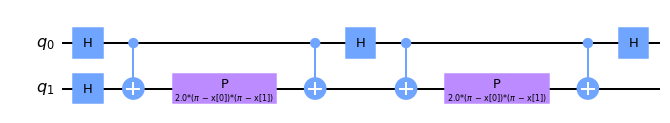


Quantum kernel matrices:



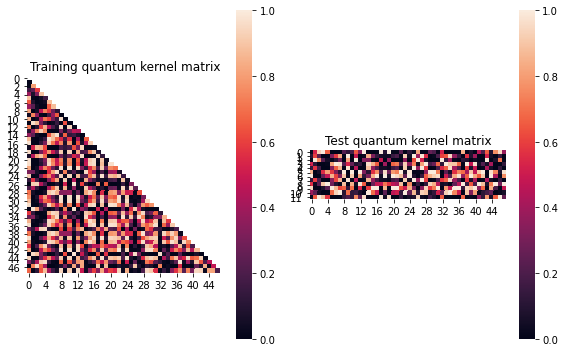


SVM with quantum kernel trained!


Test set performance:


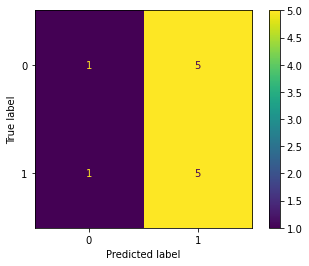

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.0043981638793463285
metric(s) 2: (00, 10, 11) = (0.40613189036271397, 0.4130157528605851, 0.4286959431171489)
metric 3: -0.0


----> Kernel construction duration: 00:01:06


Combination 155/468
(Current range: 17/46)
			 reps : 1
			 paulis : ['ZZ', 'ZY']
			 entanglement : linear

Feature map:


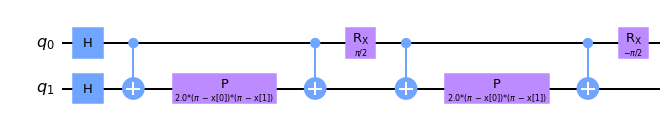


Quantum kernel matrices:



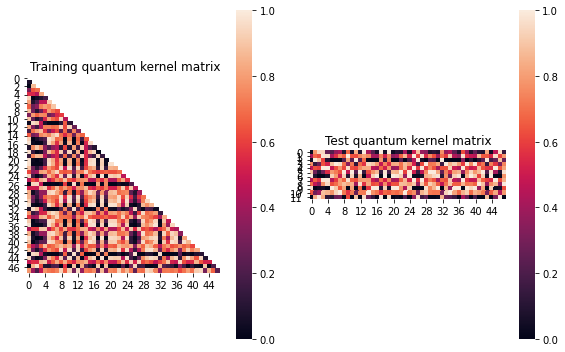


SVM with quantum kernel trained!


Test set performance:


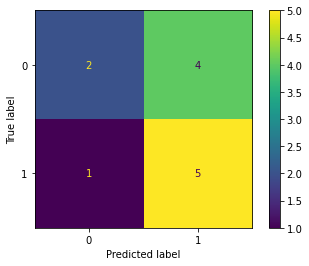

              precision    recall  f1-score   support

           0       0.67      0.33      0.44         6
           1       0.56      0.83      0.67         6

    accuracy                           0.58        12
   macro avg       0.61      0.58      0.56        12
weighted avg       0.61      0.58      0.56        12


metric 1: -0.0006210328716632629
metric(s) 2: (00, 10, 11) = (0.5434756299188566, 0.5555297974455864, 0.5663418992289897)
metric 3: 0.0


----> Kernel construction duration: 00:01:06


Combination 156/468
(Current range: 18/46)
			 reps : 1
			 paulis : ['ZZ', 'ZZ']
			 entanglement : linear

Feature map:


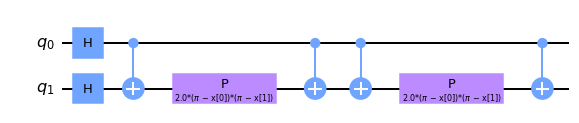


Quantum kernel matrices:



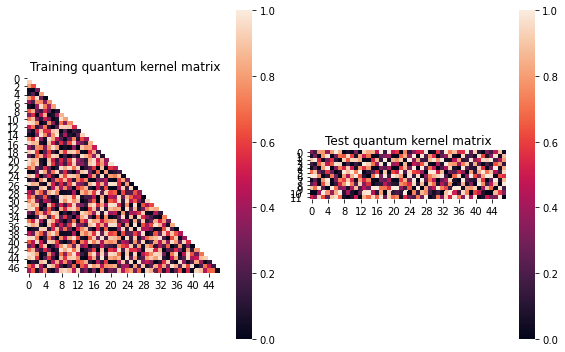


SVM with quantum kernel trained!


Test set performance:


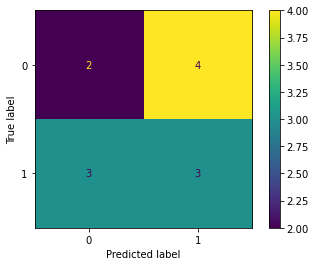

              precision    recall  f1-score   support

           0       0.40      0.33      0.36         6
           1       0.43      0.50      0.46         6

    accuracy                           0.42        12
   macro avg       0.41      0.42      0.41        12
weighted avg       0.41      0.42      0.41        12


metric 1: 0.005189231185427912
metric(s) 2: (00, 10, 11) = (0.49936335961957806, 0.494900756823733, 0.5008166163987438)
metric 3: 0.0


----> Kernel construction duration: 00:00:43


Combination 157/468
(Current range: 19/46)
			 reps : 2
			 paulis : ['X']
			 entanglement : linear

Feature map:


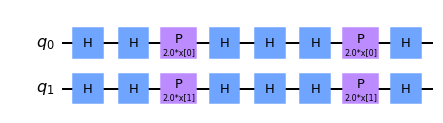


Quantum kernel matrices:



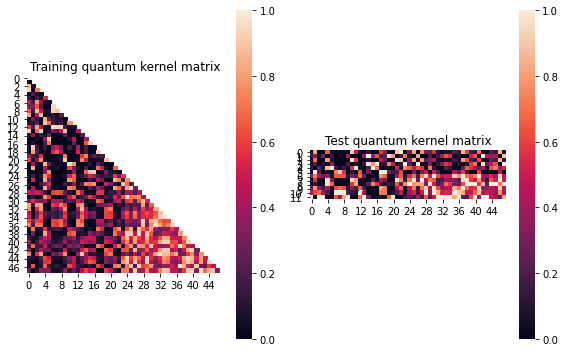


SVM with quantum kernel trained!


Test set performance:


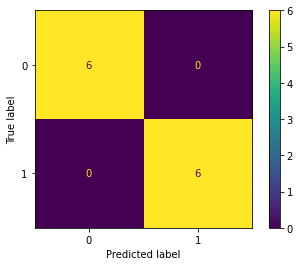

              precision    recall  f1-score   support

           0       1.00      1.00      1.00         6
           1       1.00      1.00      1.00         6

    accuracy                           1.00        12
   macro avg       1.00      1.00      1.00        12
weighted avg       1.00      1.00      1.00        12


metric 1: 0.1606525366785686
metric(s) 2: (00, 10, 11) = (0.27826916693972226, 0.2829827056871623, 0.6090013177917395)
metric 3: 1.6922e-319


----> Kernel construction duration: 00:00:32


Combination 158/468
(Current range: 20/46)
			 reps : 2
			 paulis : ['Y']
			 entanglement : linear

Feature map:


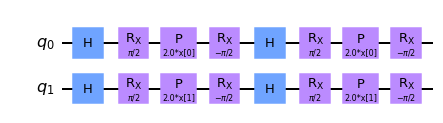


Quantum kernel matrices:



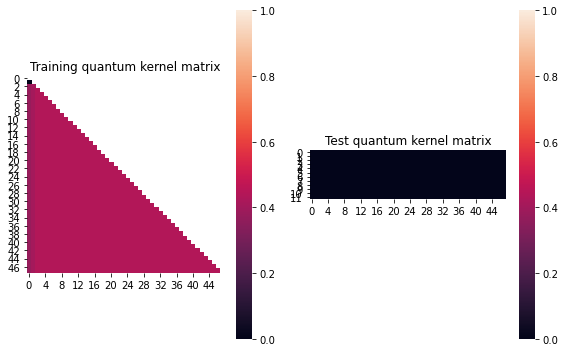


SVM with quantum kernel trained!


Test set performance:


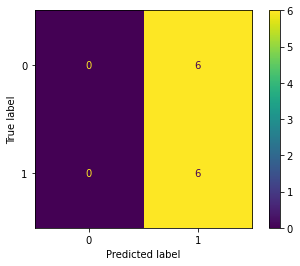

              precision    recall  f1-score   support

           0       0.00      0.00      0.00         6
           1       0.50      1.00      0.67         6

    accuracy                           0.50        12
   macro avg       0.25      0.50      0.33        12
weighted avg       0.25      0.50      0.33        12


metric 1: 0.00472005208333337
metric(s) 2: (00, 10, 11) = (0.4391276041666667, 0.43359375, 0.4375)
metric 3: 0.0


----> Kernel construction duration: 00:00:20


Combination 159/468
(Current range: 21/46)
			 reps : 2
			 paulis : ['Z']
			 entanglement : linear

Feature map:


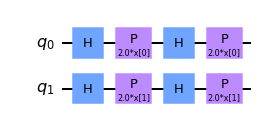


Quantum kernel matrices:



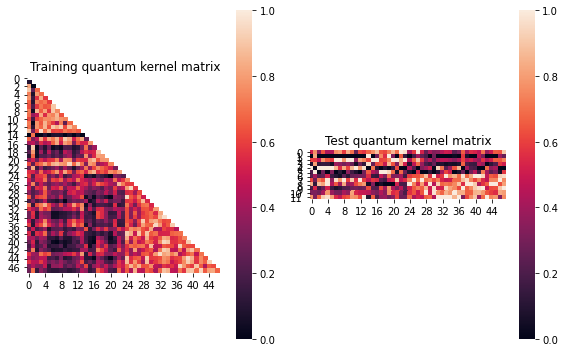


SVM with quantum kernel trained!


Test set performance:


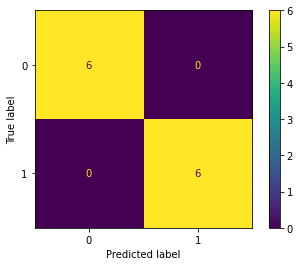

              precision    recall  f1-score   support

           0       1.00      1.00      1.00         6
           1       1.00      1.00      1.00         6

    accuracy                           1.00        12
   macro avg       1.00      1.00      1.00        12
weighted avg       1.00      1.00      1.00        12


metric 1: 0.25900545429783706
metric(s) 2: (00, 10, 11) = (0.5284495379346134, 0.339459573135221, 0.6684805169315029)
metric 3: -8.130530225039465e-283


----> Kernel construction duration: 00:00:29


Combination 160/468
(Current range: 22/46)
			 reps : 2
			 paulis : ['XX']
			 entanglement : linear

Feature map:


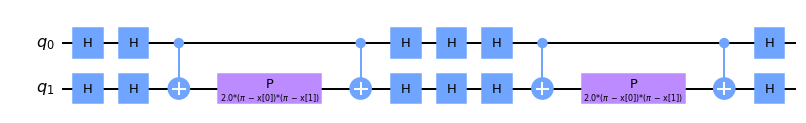


Quantum kernel matrices:



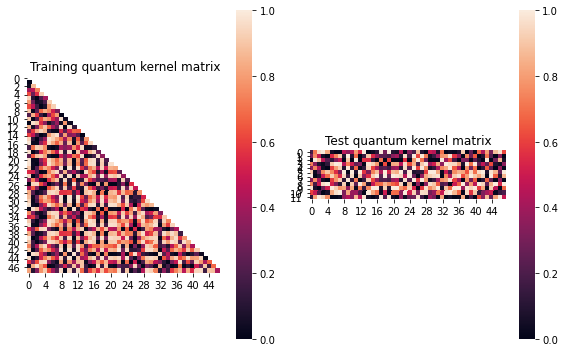


SVM with quantum kernel trained!


Test set performance:


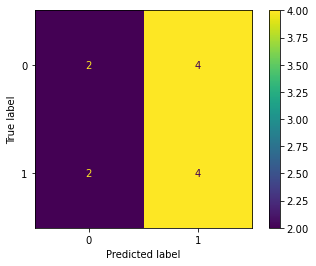

              precision    recall  f1-score   support

           0       0.50      0.33      0.40         6
           1       0.50      0.67      0.57         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.49        12
weighted avg       0.50      0.50      0.49        12


metric 1: 0.0030024471480464276
metric(s) 2: (00, 10, 11) = (0.5194729525883561, 0.5274296115848754, 0.5413911648774875)
metric 3: 0.0


----> Kernel construction duration: 00:00:55


Combination 161/468
(Current range: 23/46)
			 reps : 2
			 paulis : ['XY']
			 entanglement : linear

Feature map:


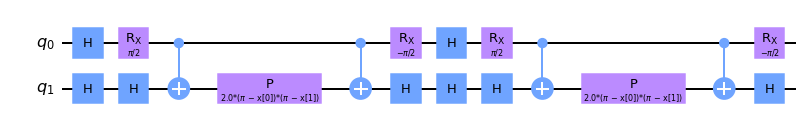


Quantum kernel matrices:



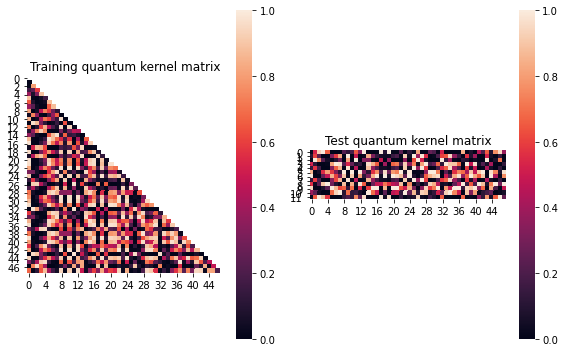


SVM with quantum kernel trained!


Test set performance:


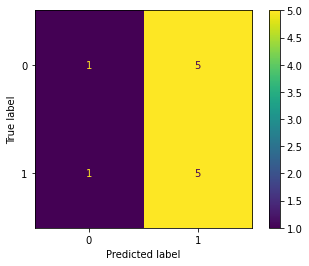

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.0043981638793463285
metric(s) 2: (00, 10, 11) = (0.40613189036271397, 0.4130157528605851, 0.4286959431171489)
metric 3: -0.0


----> Kernel construction duration: 00:01:10


Combination 162/468
(Current range: 24/46)
			 reps : 2
			 paulis : ['XZ']
			 entanglement : linear

Feature map:


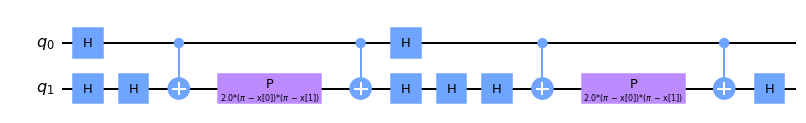


Quantum kernel matrices:



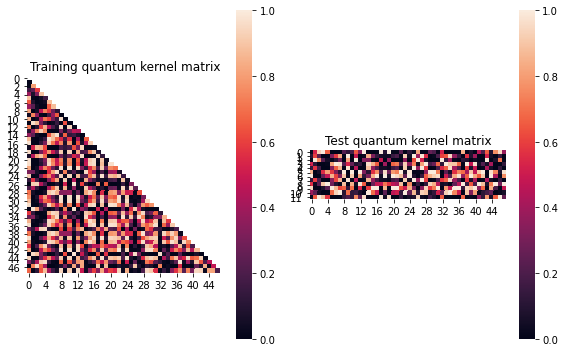


SVM with quantum kernel trained!


Test set performance:


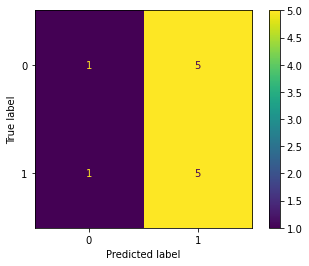

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.0043981638793463285
metric(s) 2: (00, 10, 11) = (0.40613189036271397, 0.4130157528605851, 0.4286959431171489)
metric 3: -0.0


----> Kernel construction duration: 00:01:06


Combination 163/468
(Current range: 25/46)
			 reps : 2
			 paulis : ['YX']
			 entanglement : linear

Feature map:


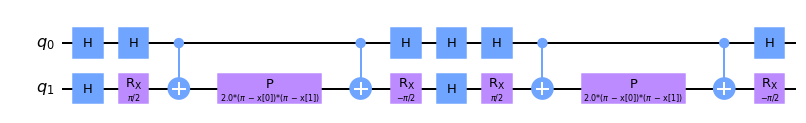


Quantum kernel matrices:



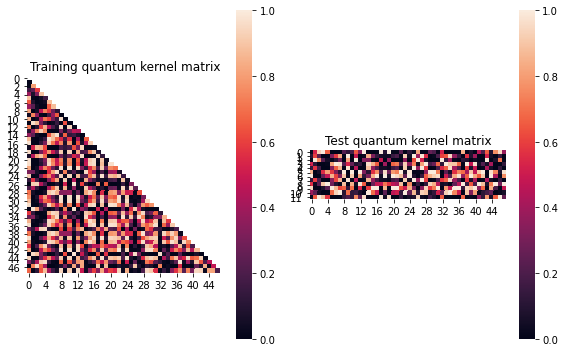


SVM with quantum kernel trained!


Test set performance:


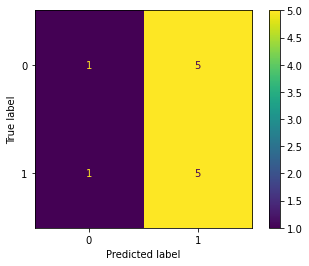

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.0043981638793463285
metric(s) 2: (00, 10, 11) = (0.40613189036271397, 0.4130157528605851, 0.4286959431171489)
metric 3: -0.0


----> Kernel construction duration: 00:01:11


Combination 164/468
(Current range: 26/46)
			 reps : 2
			 paulis : ['YY']
			 entanglement : linear

Feature map:


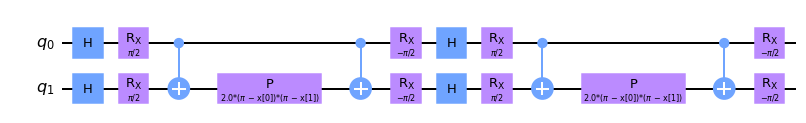


Quantum kernel matrices:



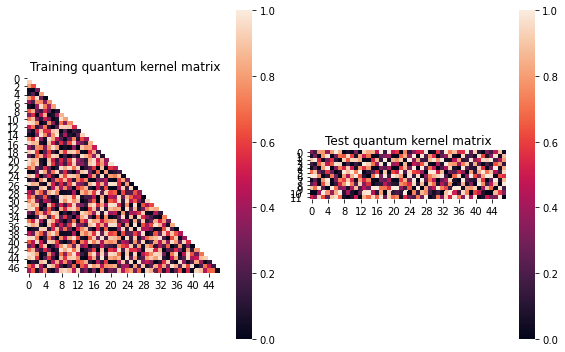


SVM with quantum kernel trained!


Test set performance:


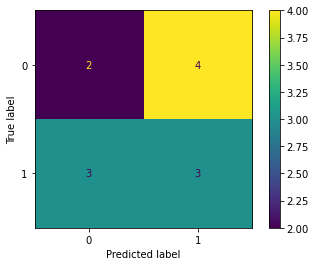

              precision    recall  f1-score   support

           0       0.40      0.33      0.36         6
           1       0.43      0.50      0.46         6

    accuracy                           0.42        12
   macro avg       0.41      0.42      0.41        12
weighted avg       0.41      0.42      0.41        12


metric 1: 0.005189231185427912
metric(s) 2: (00, 10, 11) = (0.49936335961957806, 0.494900756823733, 0.5008166163987438)
metric 3: 0.0


----> Kernel construction duration: 00:01:24


Combination 165/468
(Current range: 27/46)
			 reps : 2
			 paulis : ['YZ']
			 entanglement : linear

Feature map:


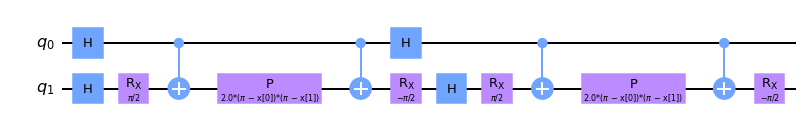


Quantum kernel matrices:



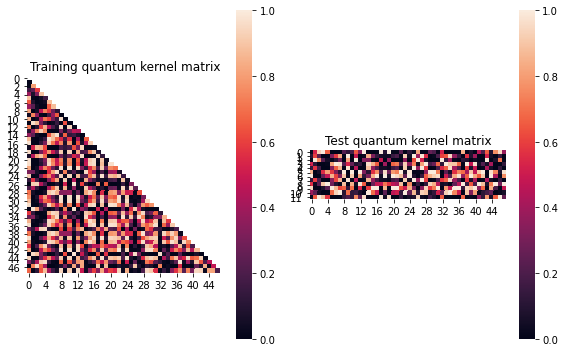


SVM with quantum kernel trained!


Test set performance:


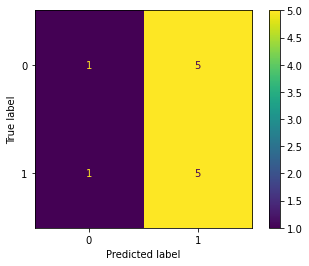

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.0043981638793463285
metric(s) 2: (00, 10, 11) = (0.40613189036271397, 0.4130157528605851, 0.4286959431171489)
metric 3: -0.0


----> Kernel construction duration: 00:01:21


Combination 166/468
(Current range: 28/46)
			 reps : 2
			 paulis : ['ZX']
			 entanglement : linear

Feature map:


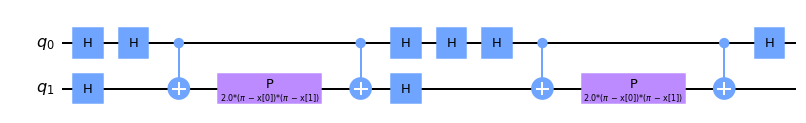


Quantum kernel matrices:



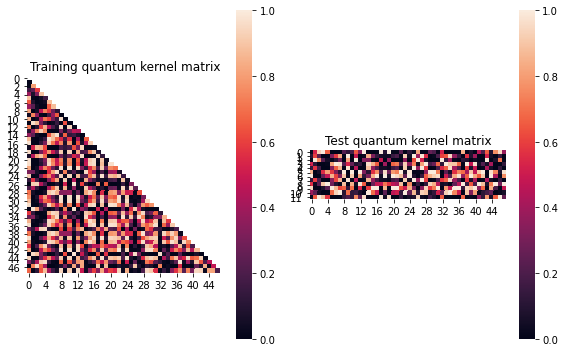


SVM with quantum kernel trained!


Test set performance:


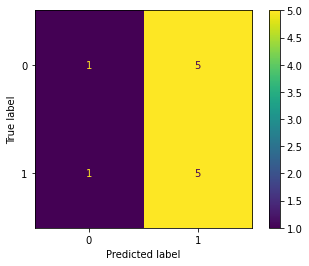

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.0043981638793463285
metric(s) 2: (00, 10, 11) = (0.40613189036271397, 0.4130157528605851, 0.4286959431171489)
metric 3: -0.0


----> Kernel construction duration: 00:01:07


Combination 167/468
(Current range: 29/46)
			 reps : 2
			 paulis : ['ZY']
			 entanglement : linear

Feature map:


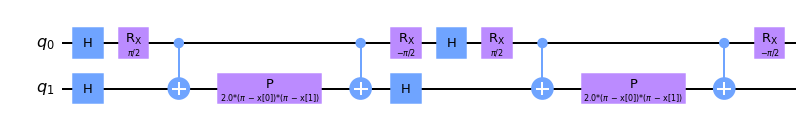


Quantum kernel matrices:



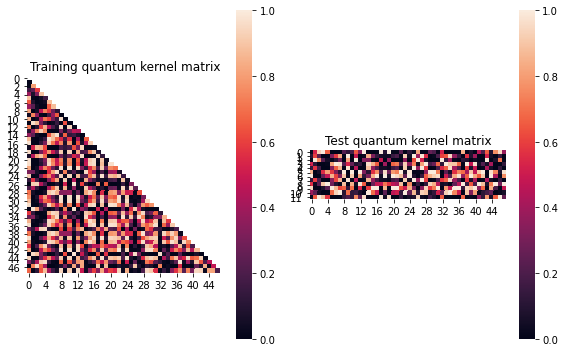


SVM with quantum kernel trained!


Test set performance:


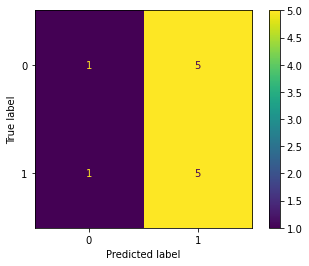

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.0043981638793463285
metric(s) 2: (00, 10, 11) = (0.40613189036271397, 0.4130157528605851, 0.4286959431171489)
metric 3: -0.0


----> Kernel construction duration: 00:01:22


Combination 168/468
(Current range: 30/46)
			 reps : 2
			 paulis : ['ZZ']
			 entanglement : linear

Feature map:


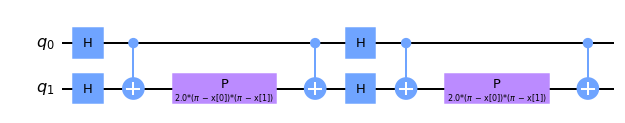


Quantum kernel matrices:



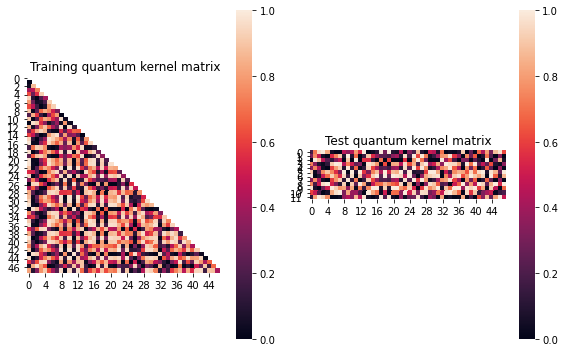


SVM with quantum kernel trained!


Test set performance:


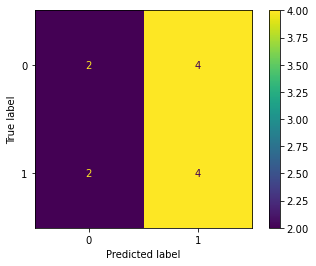

              precision    recall  f1-score   support

           0       0.50      0.33      0.40         6
           1       0.50      0.67      0.57         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.49        12
weighted avg       0.50      0.50      0.49        12


metric 1: 0.0030024471480464276
metric(s) 2: (00, 10, 11) = (0.5194729525883561, 0.5274296115848754, 0.5413911648774875)
metric 3: 0.0


----> Kernel construction duration: 00:01:16


Combination 169/468
(Current range: 31/46)
			 reps : 2
			 paulis : ['X', 'X']
			 entanglement : linear

Feature map:


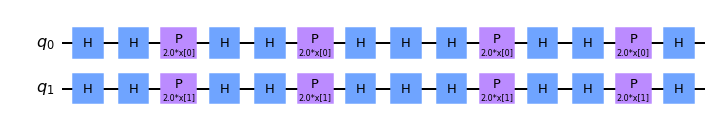


Quantum kernel matrices:



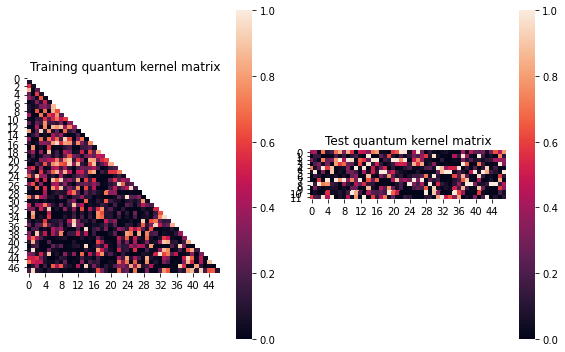


SVM with quantum kernel trained!


Test set performance:


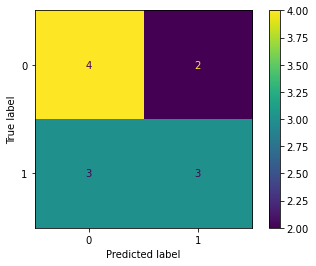

              precision    recall  f1-score   support

           0       0.57      0.67      0.62         6
           1       0.60      0.50      0.55         6

    accuracy                           0.58        12
   macro avg       0.59      0.58      0.58        12
weighted avg       0.59      0.58      0.58        12


metric 1: 0.12520236899511808
metric(s) 2: (00, 10, 11) = (0.34625427058798824, 0.19335182178741248, 0.29085411097707287)
metric 3: -3.95e-322


----> Kernel construction duration: 00:00:32


Combination 170/468
(Current range: 32/46)
			 reps : 2
			 paulis : ['X', 'Y']
			 entanglement : linear

Feature map:


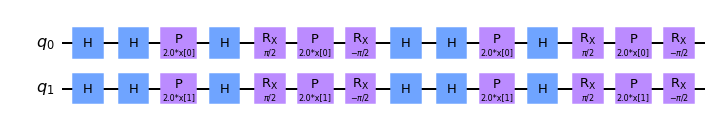


Quantum kernel matrices:



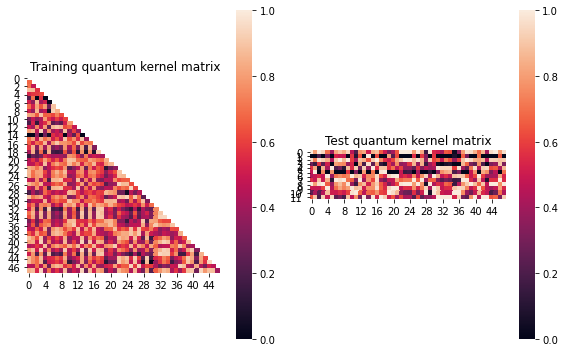


SVM with quantum kernel trained!


Test set performance:


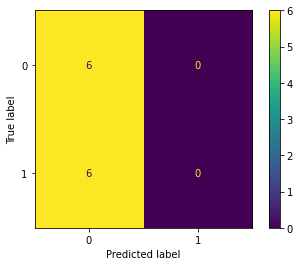

              precision    recall  f1-score   support

           0       0.50      1.00      0.67         6
           1       0.00      0.00      0.00         6

    accuracy                           0.50        12
   macro avg       0.25      0.50      0.33        12
weighted avg       0.25      0.50      0.33        12


metric 1: -0.01460989437966076
metric(s) 2: (00, 10, 11) = (0.5678572580795085, 0.6016832720945581, 0.6062894973502861)
metric 3: -5.510265551629684e-309


----> Kernel construction duration: 00:00:32


Combination 171/468
(Current range: 33/46)
			 reps : 2
			 paulis : ['X', 'Z']
			 entanglement : linear

Feature map:


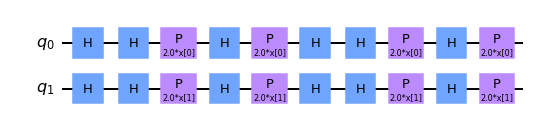


Quantum kernel matrices:



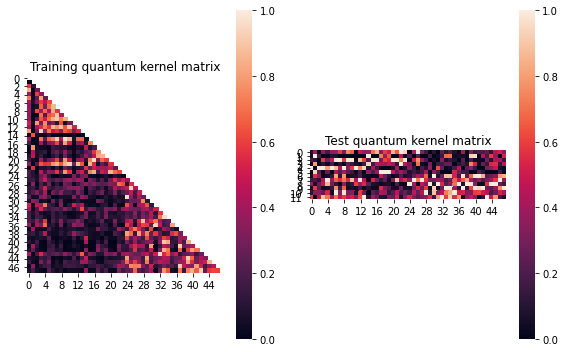


SVM with quantum kernel trained!


Test set performance:


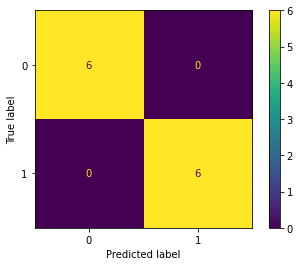

              precision    recall  f1-score   support

           0       1.00      1.00      1.00         6
           1       1.00      1.00      1.00         6

    accuracy                           1.00        12
   macro avg       1.00      1.00      1.00        12
weighted avg       1.00      1.00      1.00        12


metric 1: 0.24936186680895447
metric(s) 2: (00, 10, 11) = (0.3866436223801746, 0.1531158005484856, 0.4183117123347056)
metric 3: 5.5347769351515035e-257


----> Kernel construction duration: 00:00:31


Combination 172/468
(Current range: 34/46)
			 reps : 2
			 paulis : ['X', 'XX']
			 entanglement : linear

Feature map:


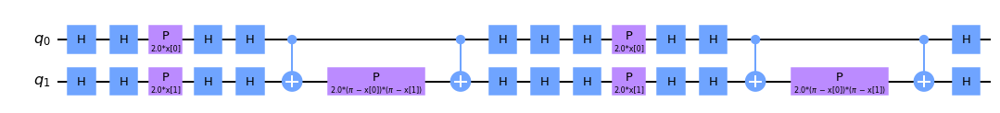


Quantum kernel matrices:



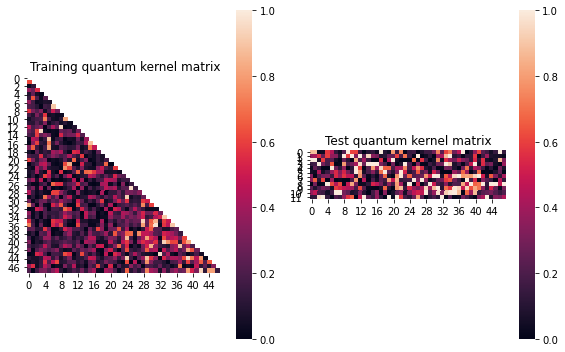


SVM with quantum kernel trained!


Test set performance:


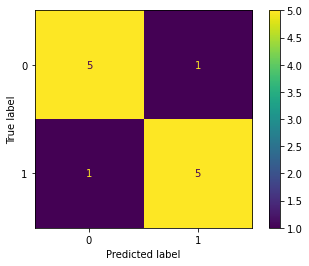

              precision    recall  f1-score   support

           0       0.83      0.83      0.83         6
           1       0.83      0.83      0.83         6

    accuracy                           0.83        12
   macro avg       0.83      0.83      0.83        12
weighted avg       0.83      0.83      0.83        12


metric 1: 0.1045473502897318
metric(s) 2: (00, 10, 11) = (0.26357271453930053, 0.21214886155599652, 0.3698197091521561)
metric 3: 2.3512872618074066e-286


----> Kernel construction duration: 00:01:18


Combination 173/468
(Current range: 35/46)
			 reps : 2
			 paulis : ['X', 'XY']
			 entanglement : linear

Feature map:


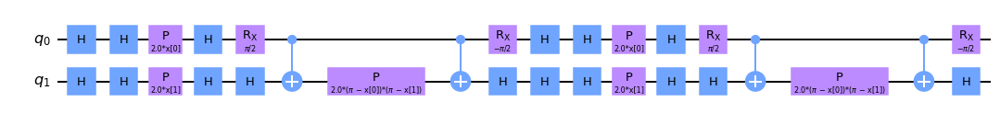


Quantum kernel matrices:



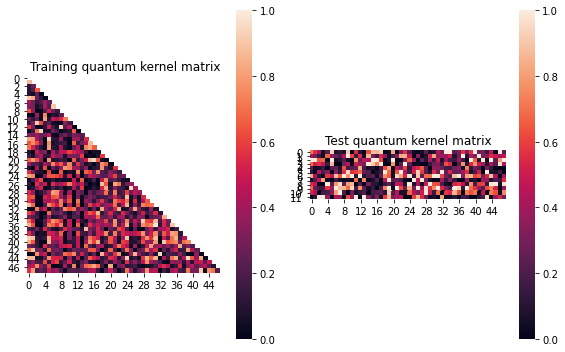


SVM with quantum kernel trained!


Test set performance:


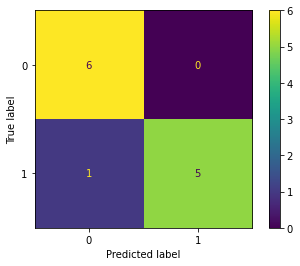

              precision    recall  f1-score   support

           0       0.86      1.00      0.92         6
           1       1.00      0.83      0.91         6

    accuracy                           0.92        12
   macro avg       0.93      0.92      0.92        12
weighted avg       0.93      0.92      0.92        12


metric 1: 0.03841321830596539
metric(s) 2: (00, 10, 11) = (0.3394025711815373, 0.3324711583355111, 0.40236618210141567)
metric 3: 3.429445138319686e-300


----> Kernel construction duration: 00:01:25


Combination 174/468
(Current range: 36/46)
			 reps : 2
			 paulis : ['X', 'XZ']
			 entanglement : linear

Feature map:


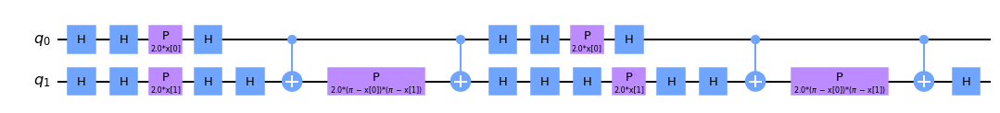


Quantum kernel matrices:



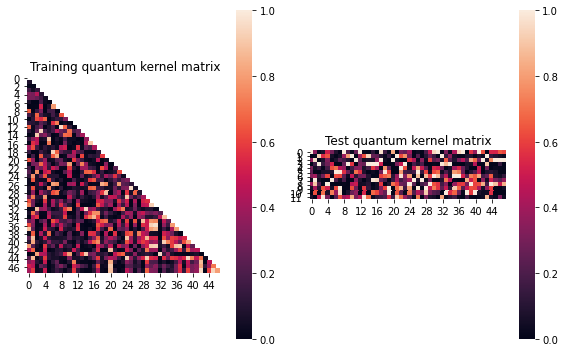


SVM with quantum kernel trained!


Test set performance:


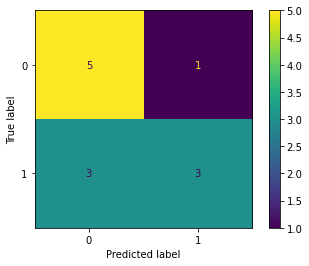

              precision    recall  f1-score   support

           0       0.62      0.83      0.71         6
           1       0.75      0.50      0.60         6

    accuracy                           0.67        12
   macro avg       0.69      0.67      0.66        12
weighted avg       0.69      0.67      0.66        12


metric 1: 0.08358530816182608
metric(s) 2: (00, 10, 11) = (0.2603582780213624, 0.2330731863335686, 0.37295871096942695)
metric 3: -6.3452544274179694e-291


----> Kernel construction duration: 00:01:20


Combination 175/468
(Current range: 37/46)
			 reps : 2
			 paulis : ['X', 'YX']
			 entanglement : linear

Feature map:


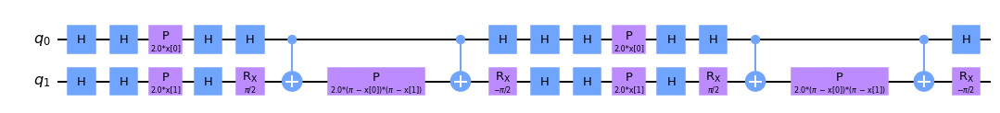


Quantum kernel matrices:



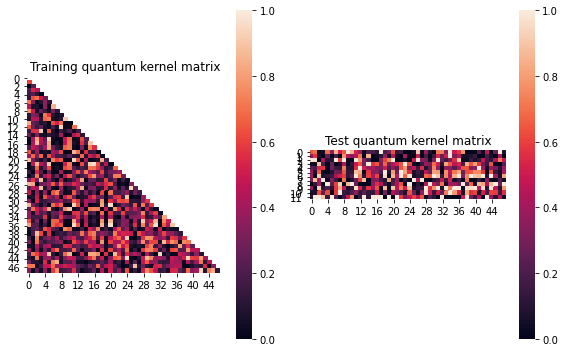


SVM with quantum kernel trained!


Test set performance:


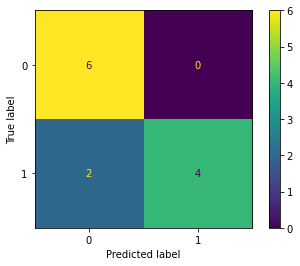

              precision    recall  f1-score   support

           0       0.75      1.00      0.86         6
           1       1.00      0.67      0.80         6

    accuracy                           0.83        12
   macro avg       0.88      0.83      0.83        12
weighted avg       0.88      0.83      0.83        12


metric 1: 0.04064405284026468
metric(s) 2: (00, 10, 11) = (0.3409818008827164, 0.3204558861319426, 0.3812180770616982)
metric 3: -2.547973587748493e-275


----> Kernel construction duration: 00:01:24


Combination 176/468
(Current range: 38/46)
			 reps : 2
			 paulis : ['X', 'YY']
			 entanglement : linear

Feature map:


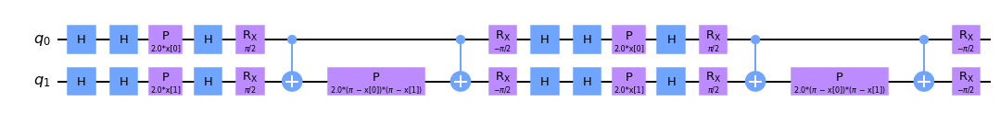


Quantum kernel matrices:



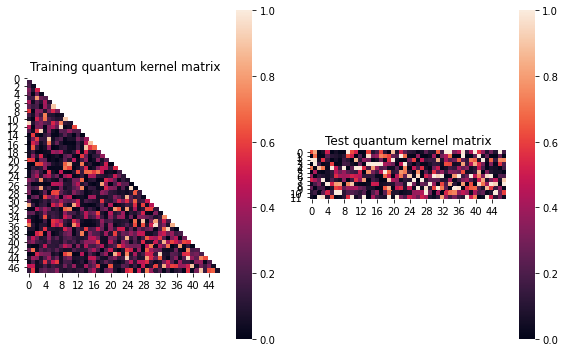


SVM with quantum kernel trained!


Test set performance:


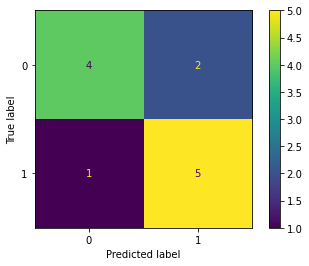

              precision    recall  f1-score   support

           0       0.80      0.67      0.73         6
           1       0.71      0.83      0.77         6

    accuracy                           0.75        12
   macro avg       0.76      0.75      0.75        12
weighted avg       0.76      0.75      0.75        12


metric 1: 0.08565906867091441
metric(s) 2: (00, 10, 11) = (0.2657839264390324, 0.2125128680318428, 0.33055994696648194)
metric 3: -1.6287325193496324e-274


----> Kernel construction duration: 00:01:29


Combination 177/468
(Current range: 39/46)
			 reps : 2
			 paulis : ['X', 'YZ']
			 entanglement : linear

Feature map:


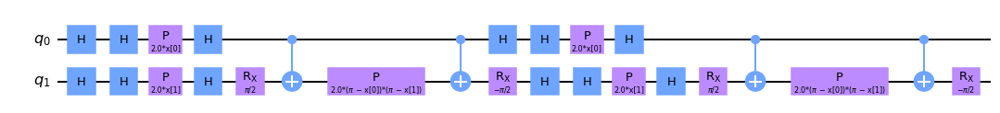


Quantum kernel matrices:



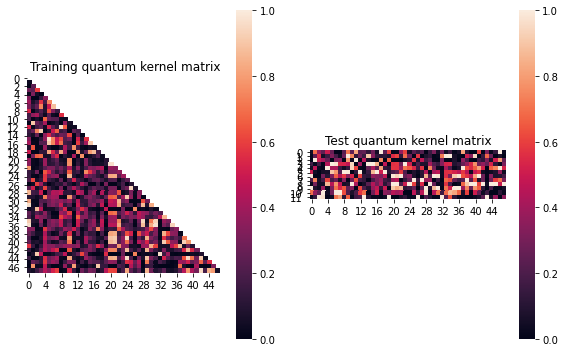


SVM with quantum kernel trained!


Test set performance:


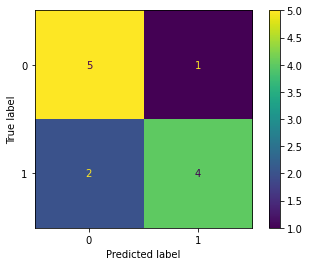

              precision    recall  f1-score   support

           0       0.71      0.83      0.77         6
           1       0.80      0.67      0.73         6

    accuracy                           0.75        12
   macro avg       0.76      0.75      0.75        12
weighted avg       0.76      0.75      0.75        12


metric 1: 0.061757341992689924
metric(s) 2: (00, 10, 11) = (0.29047598060197727, 0.2489952385641699, 0.33102918051174235)
metric 3: 8.180812152307404e-272


----> Kernel construction duration: 00:01:27


Combination 178/468
(Current range: 40/46)
			 reps : 2
			 paulis : ['X', 'ZX']
			 entanglement : linear

Feature map:


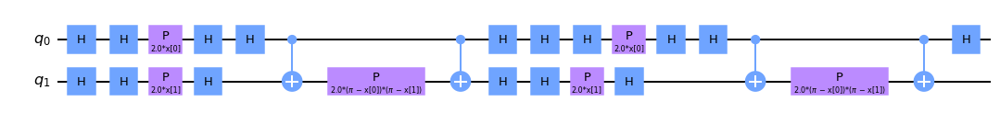


Quantum kernel matrices:



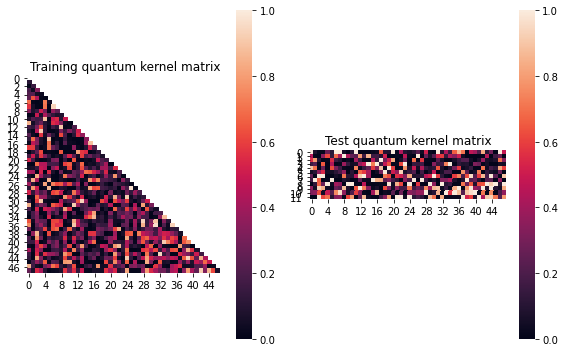


SVM with quantum kernel trained!


Test set performance:


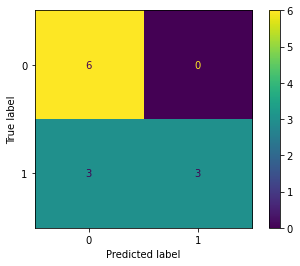

              precision    recall  f1-score   support

           0       0.67      1.00      0.80         6
           1       1.00      0.50      0.67         6

    accuracy                           0.75        12
   macro avg       0.83      0.75      0.73        12
weighted avg       0.83      0.75      0.73        12


metric 1: 0.06267844462605801
metric(s) 2: (00, 10, 11) = (0.26271120057259445, 0.24205474113225275, 0.3467551709440271)
metric 3: -4.718220753385887e-304


----> Kernel construction duration: 00:01:22


Combination 179/468
(Current range: 41/46)
			 reps : 2
			 paulis : ['X', 'ZY']
			 entanglement : linear

Feature map:


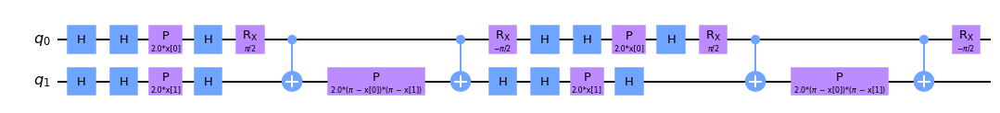


Quantum kernel matrices:



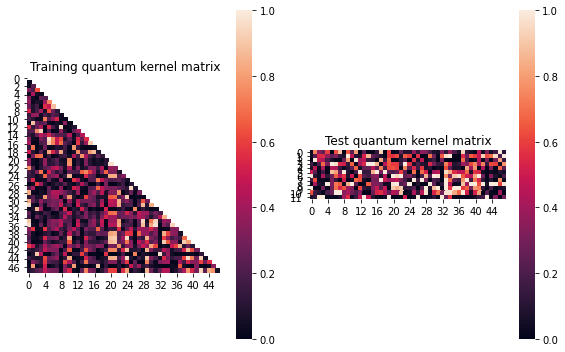


SVM with quantum kernel trained!


Test set performance:


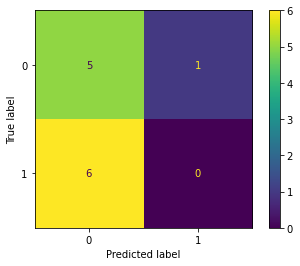

              precision    recall  f1-score   support

           0       0.45      0.83      0.59         6
           1       0.00      0.00      0.00         6

    accuracy                           0.42        12
   macro avg       0.23      0.42      0.29        12
weighted avg       0.23      0.42      0.29        12


metric 1: 0.06730150268176871
metric(s) 2: (00, 10, 11) = (0.2893066281351511, 0.24582819432502323, 0.3369527658784328)
metric 3: -2.1455207177727046e-258


----> Kernel construction duration: 00:01:27


Combination 180/468
(Current range: 42/46)
			 reps : 2
			 paulis : ['X', 'ZZ']
			 entanglement : linear

Feature map:


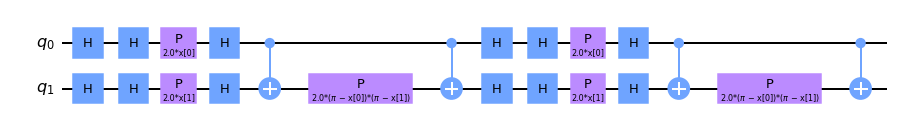


Quantum kernel matrices:



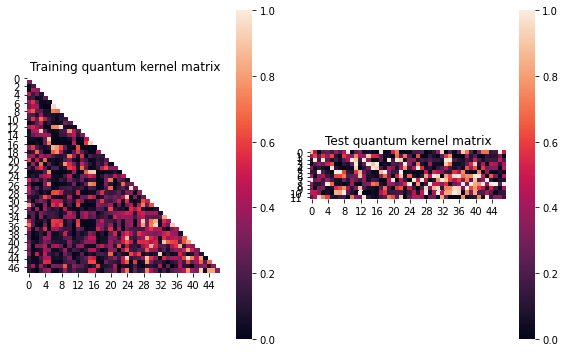


SVM with quantum kernel trained!


Test set performance:


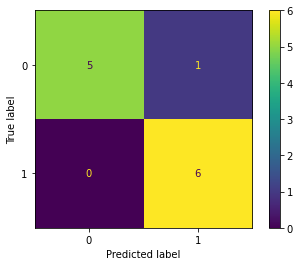

              precision    recall  f1-score   support

           0       1.00      0.83      0.91         6
           1       0.86      1.00      0.92         6

    accuracy                           0.92        12
   macro avg       0.93      0.92      0.92        12
weighted avg       0.93      0.92      0.92        12


metric 1: 0.11662791599592515
metric(s) 2: (00, 10, 11) = (0.2685799961973515, 0.20770934745169717, 0.3800945306978931)
metric 3: 1.2550404904060164e-256


----> Kernel construction duration: 00:01:24


Combination 181/468
(Current range: 43/46)
			 reps : 2
			 paulis : ['Y', 'X']
			 entanglement : linear

Feature map:


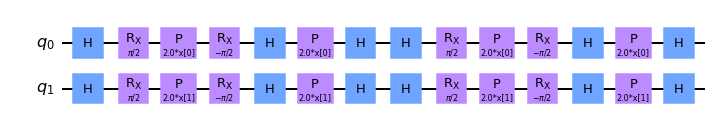


Quantum kernel matrices:



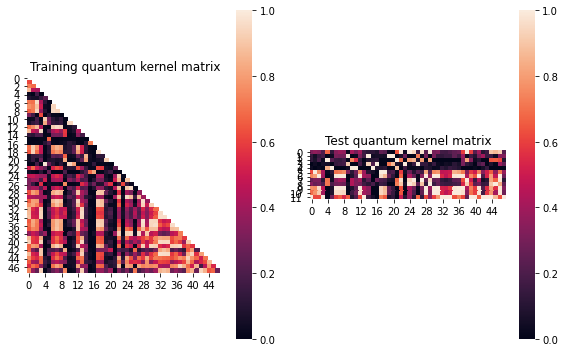


SVM with quantum kernel trained!


Test set performance:


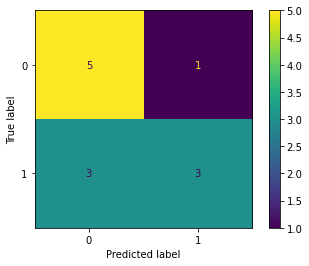

              precision    recall  f1-score   support

           0       0.62      0.83      0.71         6
           1       0.75      0.50      0.60         6

    accuracy                           0.67        12
   macro avg       0.69      0.67      0.66        12
weighted avg       0.69      0.67      0.66        12


metric 1: 0.08645464720568852
metric(s) 2: (00, 10, 11) = (0.30119084695531606, 0.35619218189884894, 0.5841028112537588)
metric 3: 3.396311816908018e-275


----> Kernel construction duration: 00:00:34


Combination 182/468
(Current range: 44/46)
			 reps : 2
			 paulis : ['Y', 'Y']
			 entanglement : linear

Feature map:


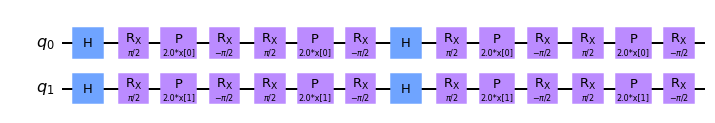


Quantum kernel matrices:



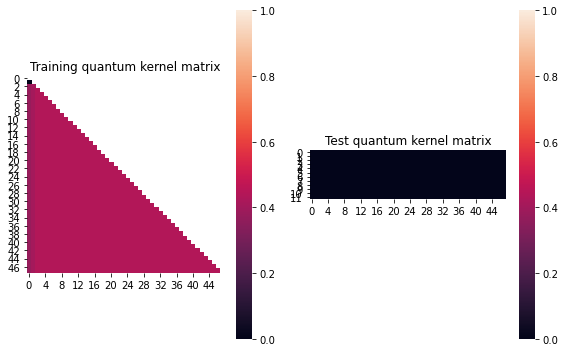


SVM with quantum kernel trained!


Test set performance:


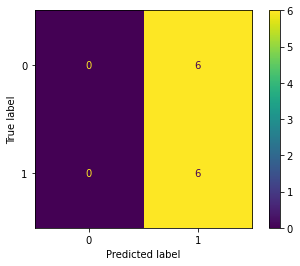

              precision    recall  f1-score   support

           0       0.00      0.00      0.00         6
           1       0.50      1.00      0.67         6

    accuracy                           0.50        12
   macro avg       0.25      0.50      0.33        12
weighted avg       0.25      0.50      0.33        12


metric 1: 0.00472005208333337
metric(s) 2: (00, 10, 11) = (0.4391276041666667, 0.43359375, 0.4375)
metric 3: 0.0


----> Kernel construction duration: 00:00:21


Combination 183/468
(Current range: 45/46)
			 reps : 2
			 paulis : ['Y', 'Z']
			 entanglement : linear

Feature map:


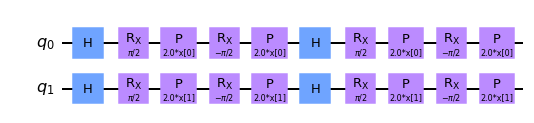


Quantum kernel matrices:



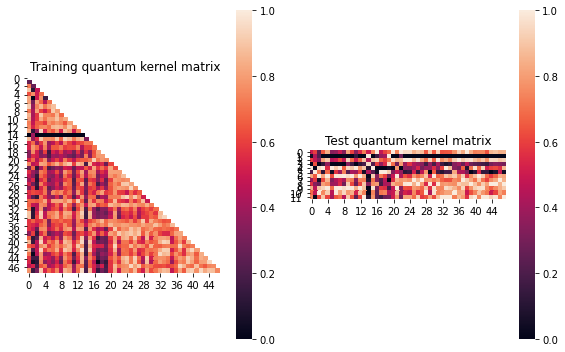


SVM with quantum kernel trained!


Test set performance:


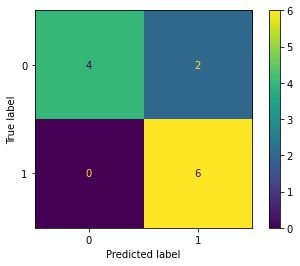

              precision    recall  f1-score   support

           0       1.00      0.67      0.80         6
           1       0.75      1.00      0.86         6

    accuracy                           0.83        12
   macro avg       0.88      0.83      0.83        12
weighted avg       0.88      0.83      0.83        12


metric 1: 0.09152776247803007
metric(s) 2: (00, 10, 11) = (0.5803125506256388, 0.5694186575911012, 0.7415802895126239)
metric 3: -3.722071952161124e-309


----> Kernel construction duration: 00:00:33


Combination 184/468
(Current range: 46/46)
			 reps : 2
			 paulis : ['Y', 'XX']
			 entanglement : linear

Feature map:


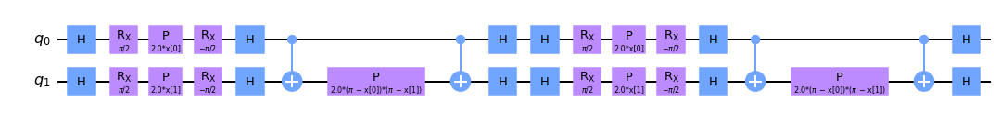


Quantum kernel matrices:



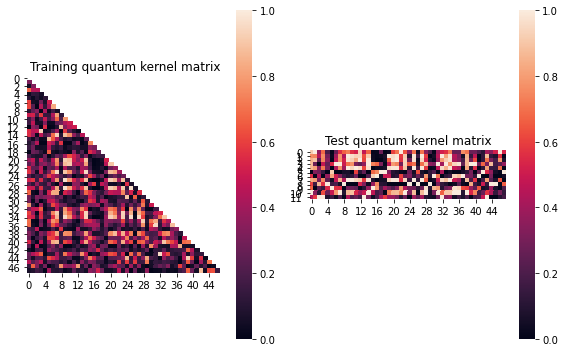


SVM with quantum kernel trained!


Test set performance:


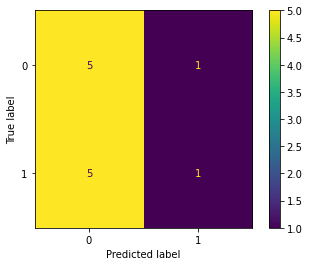

              precision    recall  f1-score   support

           0       0.50      0.83      0.62         6
           1       0.50      0.17      0.25         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.027054115686876434
metric(s) 2: (00, 10, 11) = (0.3222685852685867, 0.3010302129272343, 0.33390007195963484)
metric 3: 5.401576015287698e-259


----> Kernel construction duration: 00:01:33


In [16]:
j=3
results.append(run_kernel_evaluation(X, X_train, y_train, X_test, y_test,
                                      param_grid, range_list, j, model=True))



Combination 185/468
(Current range: 1/46)
			 reps : 2
			 paulis : ['Y', 'XY']
			 entanglement : linear

Feature map:


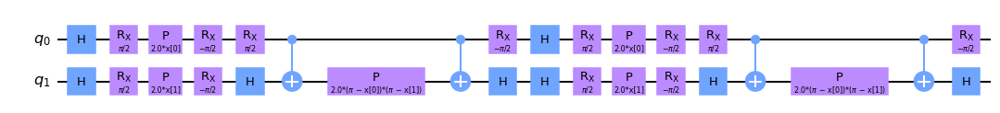


Quantum kernel matrices:



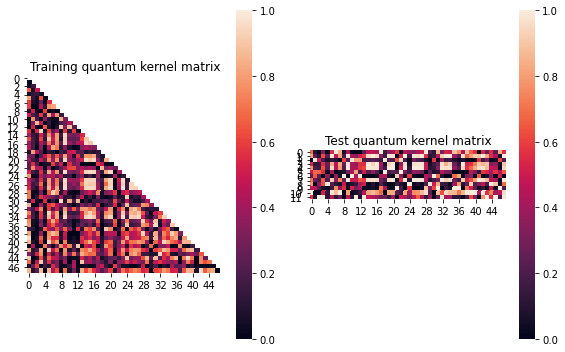


SVM with quantum kernel trained!


Test set performance:


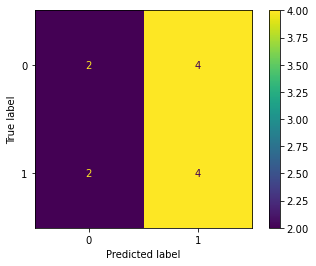

              precision    recall  f1-score   support

           0       0.50      0.33      0.40         6
           1       0.50      0.67      0.57         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.49        12
weighted avg       0.50      0.50      0.49        12


metric 1: 0.05654137010759813
metric(s) 2: (00, 10, 11) = (0.3858770520956839, 0.3764434984628464, 0.4800926850452052)
metric 3: 7.2713e-319


----> Kernel construction duration: 00:01:31


Combination 186/468
(Current range: 2/46)
			 reps : 2
			 paulis : ['Y', 'XZ']
			 entanglement : linear

Feature map:


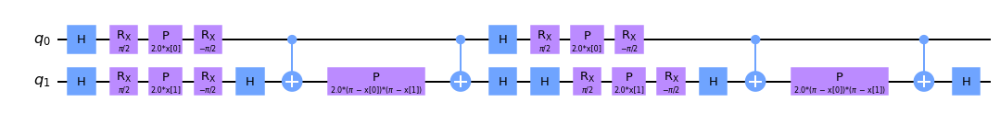


Quantum kernel matrices:



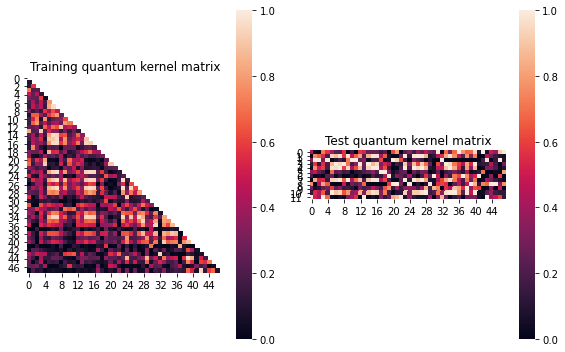


SVM with quantum kernel trained!


Test set performance:


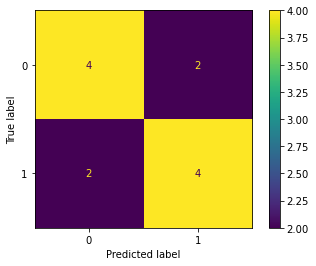

              precision    recall  f1-score   support

           0       0.67      0.67      0.67         6
           1       0.67      0.67      0.67         6

    accuracy                           0.67        12
   macro avg       0.67      0.67      0.67        12
weighted avg       0.67      0.67      0.67        12


metric 1: 0.10010608978391727
metric(s) 2: (00, 10, 11) = (0.4003311392075843, 0.2853895118449931, 0.37066006405023644)
metric 3: -3.6192592374158127e-283


----> Kernel construction duration: 00:01:34


Combination 187/468
(Current range: 3/46)
			 reps : 2
			 paulis : ['Y', 'YX']
			 entanglement : linear

Feature map:


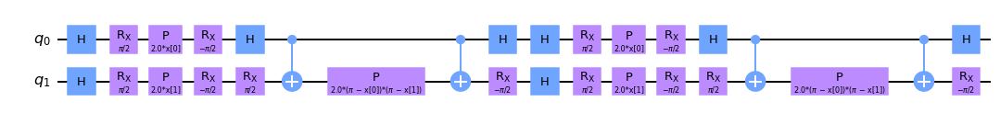


Quantum kernel matrices:



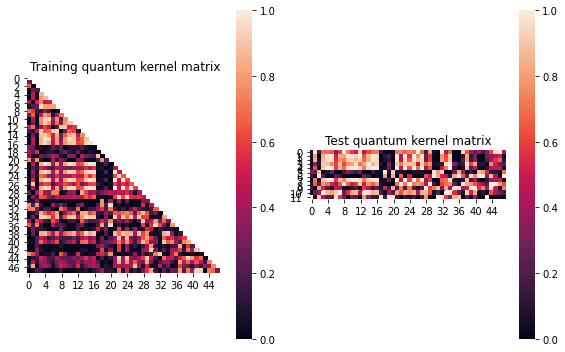


SVM with quantum kernel trained!


Test set performance:


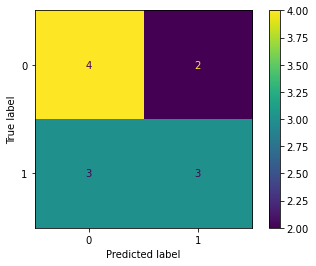

              precision    recall  f1-score   support

           0       0.57      0.67      0.62         6
           1       0.60      0.50      0.55         6

    accuracy                           0.58        12
   macro avg       0.59      0.58      0.58        12
weighted avg       0.59      0.58      0.58        12


metric 1: 0.0975152541931924
metric(s) 2: (00, 10, 11) = (0.44113792140362157, 0.32653498206569653, 0.4069625511141563)
metric 3: -4.3076e-319


----> Kernel construction duration: 00:01:31


Combination 188/468
(Current range: 4/46)
			 reps : 2
			 paulis : ['Y', 'YY']
			 entanglement : linear

Feature map:


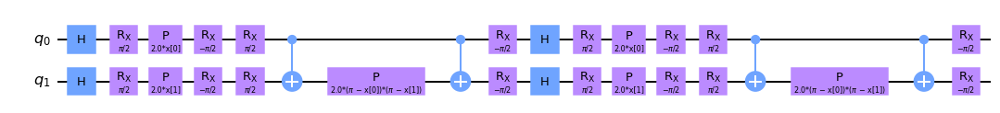


Quantum kernel matrices:



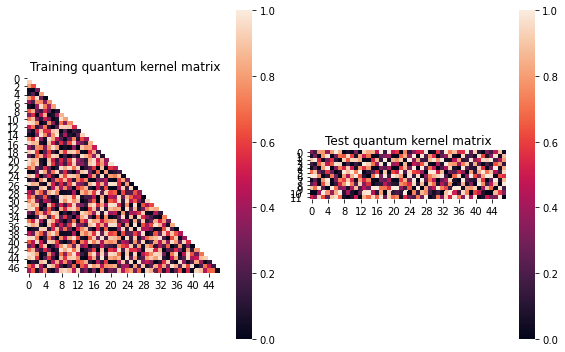


SVM with quantum kernel trained!


Test set performance:


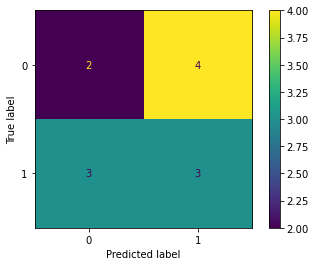

              precision    recall  f1-score   support

           0       0.40      0.33      0.36         6
           1       0.43      0.50      0.46         6

    accuracy                           0.42        12
   macro avg       0.41      0.42      0.41        12
weighted avg       0.41      0.42      0.41        12


metric 1: 0.005189231185427912
metric(s) 2: (00, 10, 11) = (0.49936335961957806, 0.494900756823733, 0.5008166163987438)
metric 3: 0.0


----> Kernel construction duration: 00:01:28


Combination 189/468
(Current range: 5/46)
			 reps : 2
			 paulis : ['Y', 'YZ']
			 entanglement : linear

Feature map:


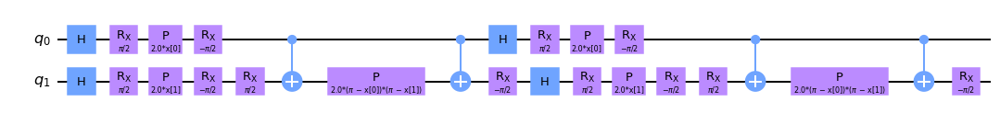


Quantum kernel matrices:



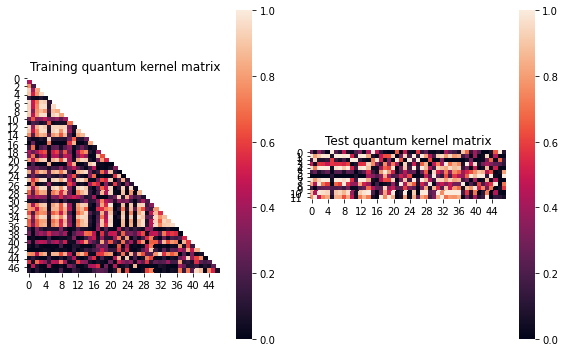


SVM with quantum kernel trained!


Test set performance:


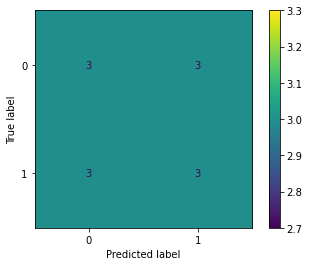

              precision    recall  f1-score   support

           0       0.50      0.50      0.50         6
           1       0.50      0.50      0.50         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.50        12
weighted avg       0.50      0.50      0.50        12


metric 1: 0.06323031534335538
metric(s) 2: (00, 10, 11) = (0.44919577154318574, 0.3499250394673423, 0.37711493807820967)
metric 3: 4.13153e-319


----> Kernel construction duration: 00:01:32


Combination 190/468
(Current range: 6/46)
			 reps : 2
			 paulis : ['Y', 'ZX']
			 entanglement : linear

Feature map:


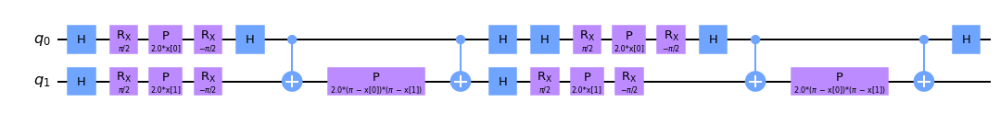


Quantum kernel matrices:



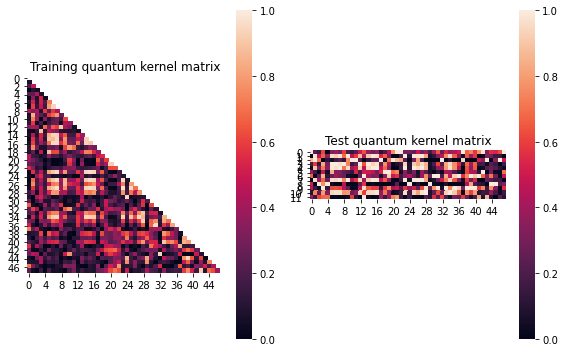


SVM with quantum kernel trained!


Test set performance:


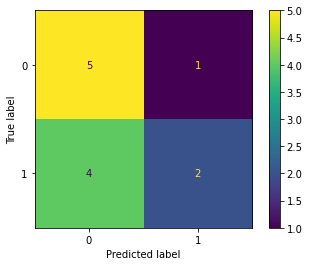

              precision    recall  f1-score   support

           0       0.56      0.83      0.67         6
           1       0.67      0.33      0.44         6

    accuracy                           0.58        12
   macro avg       0.61      0.58      0.56        12
weighted avg       0.61      0.58      0.56        12


metric 1: 0.07589317630894515
metric(s) 2: (00, 10, 11) = (0.36354093687984423, 0.28478573427152903, 0.3578168842811042)
metric 3: 1.026333621517532e-270


----> Kernel construction duration: 00:01:34


Combination 191/468
(Current range: 7/46)
			 reps : 2
			 paulis : ['Y', 'ZY']
			 entanglement : linear

Feature map:


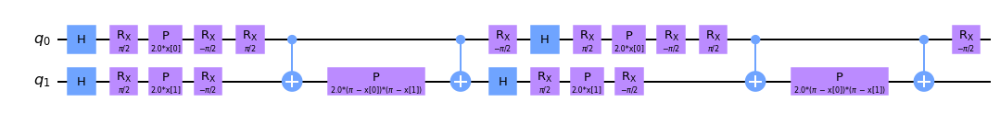


Quantum kernel matrices:



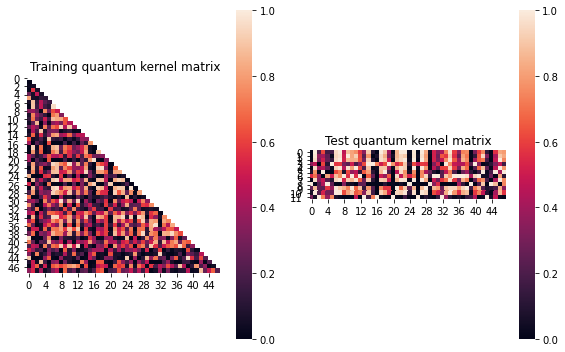


SVM with quantum kernel trained!


Test set performance:


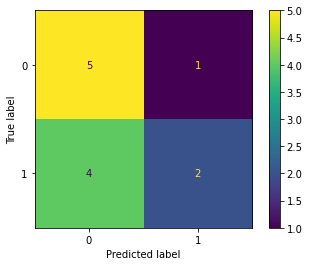

              precision    recall  f1-score   support

           0       0.56      0.83      0.67         6
           1       0.67      0.33      0.44         6

    accuracy                           0.58        12
   macro avg       0.61      0.58      0.56        12
weighted avg       0.61      0.58      0.56        12


metric 1: 0.03748332790685582
metric(s) 2: (00, 10, 11) = (0.39874301139973145, 0.360749521245215, 0.3977226869044101)
metric 3: -0.0


----> Kernel construction duration: 00:01:31


Combination 192/468
(Current range: 8/46)
			 reps : 2
			 paulis : ['Y', 'ZZ']
			 entanglement : linear

Feature map:


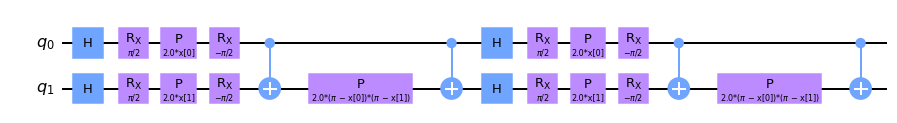


Quantum kernel matrices:



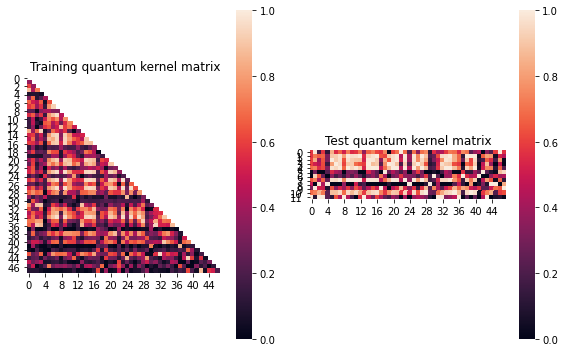


SVM with quantum kernel trained!


Test set performance:


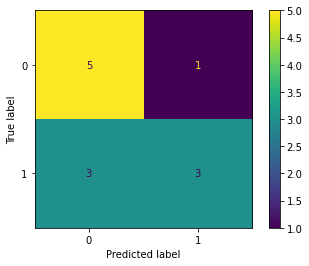

              precision    recall  f1-score   support

           0       0.62      0.83      0.71         6
           1       0.75      0.50      0.60         6

    accuracy                           0.67        12
   macro avg       0.69      0.67      0.66        12
weighted avg       0.69      0.67      0.66        12


metric 1: 0.05924117468874768
metric(s) 2: (00, 10, 11) = (0.5031502017210852, 0.3763099085584345, 0.36795196477327924)
metric 3: 4.136973409369636e-270


----> Kernel construction duration: 00:01:34


Combination 193/468
(Current range: 9/46)
			 reps : 2
			 paulis : ['Z', 'X']
			 entanglement : linear

Feature map:


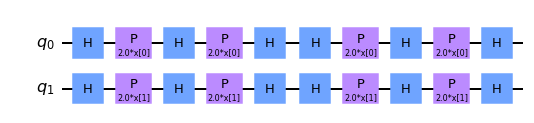


Quantum kernel matrices:



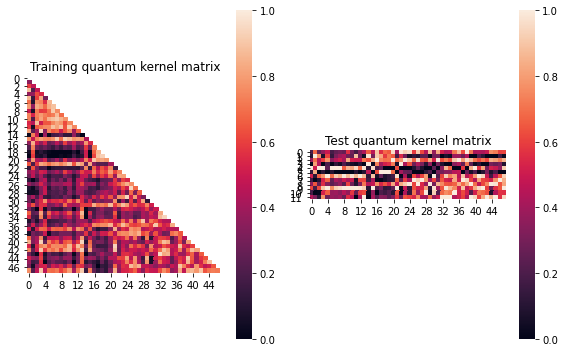


SVM with quantum kernel trained!


Test set performance:


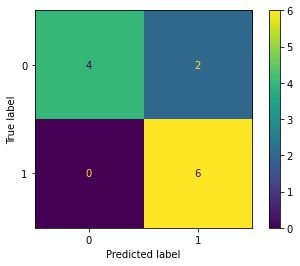

              precision    recall  f1-score   support

           0       1.00      0.67      0.80         6
           1       0.75      1.00      0.86         6

    accuracy                           0.83        12
   macro avg       0.88      0.83      0.83        12
weighted avg       0.88      0.83      0.83        12


metric 1: 0.13897702587036026
metric(s) 2: (00, 10, 11) = (0.5033758202752316, 0.4007225716851612, 0.5760233748358111)
metric 3: -1.71789802914107e-293


----> Kernel construction duration: 00:00:33


Combination 194/468
(Current range: 10/46)
			 reps : 2
			 paulis : ['Z', 'Y']
			 entanglement : linear

Feature map:


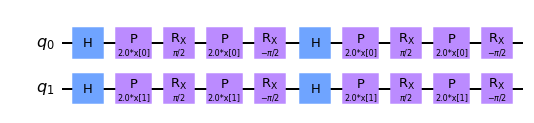


Quantum kernel matrices:



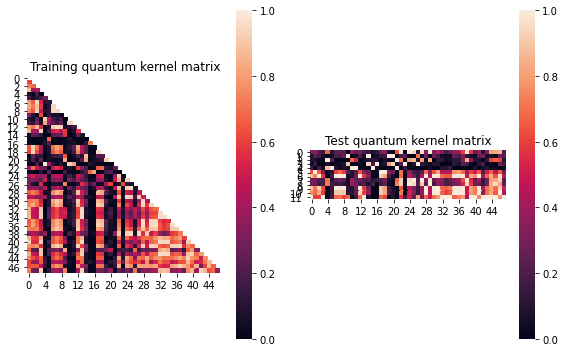


SVM with quantum kernel trained!


Test set performance:


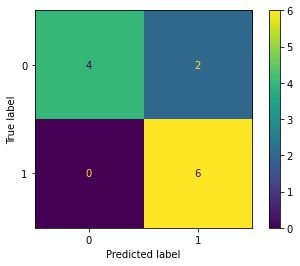

              precision    recall  f1-score   support

           0       1.00      0.67      0.80         6
           1       0.75      1.00      0.86         6

    accuracy                           0.83        12
   macro avg       0.88      0.83      0.83        12
weighted avg       0.88      0.83      0.83        12


metric 1: 0.11481243581912554
metric(s) 2: (00, 10, 11) = (0.3052541243329229, 0.3519017673568228, 0.6281742820189739)
metric 3: 2.3630175652252016e-276


----> Kernel construction duration: 00:00:34


Combination 195/468
(Current range: 11/46)
			 reps : 2
			 paulis : ['Z', 'Z']
			 entanglement : linear

Feature map:


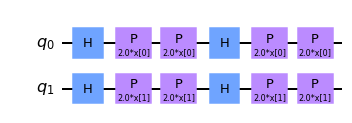


Quantum kernel matrices:



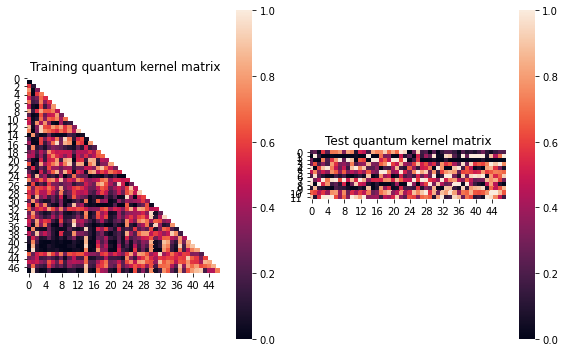


SVM with quantum kernel trained!


Test set performance:


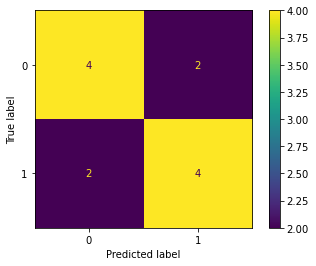

              precision    recall  f1-score   support

           0       0.67      0.67      0.67         6
           1       0.67      0.67      0.67         6

    accuracy                           0.67        12
   macro avg       0.67      0.67      0.67        12
weighted avg       0.67      0.67      0.67        12


metric 1: 0.1829073574463227
metric(s) 2: (00, 10, 11) = (0.45372092560218724, 0.30422133912734756, 0.5205364675451533)
metric 3: 9.194842259990365e-271


----> Kernel construction duration: 00:00:32


Combination 196/468
(Current range: 12/46)
			 reps : 2
			 paulis : ['Z', 'XX']
			 entanglement : linear

Feature map:


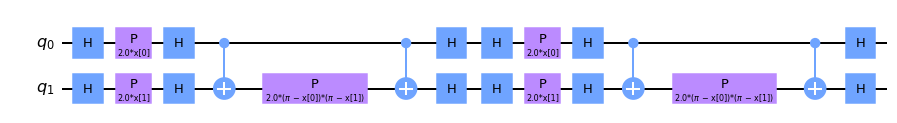


Quantum kernel matrices:



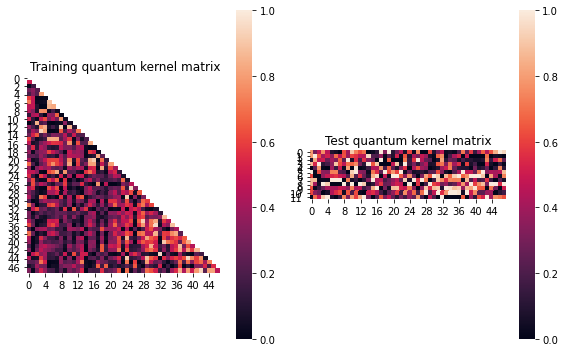


SVM with quantum kernel trained!


Test set performance:


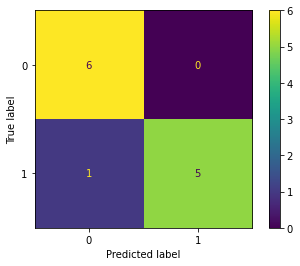

              precision    recall  f1-score   support

           0       0.86      1.00      0.92         6
           1       1.00      0.83      0.91         6

    accuracy                           0.92        12
   macro avg       0.93      0.92      0.92        12
weighted avg       0.93      0.92      0.92        12


metric 1: 0.14322350804350187
metric(s) 2: (00, 10, 11) = (0.367242364955834, 0.2596647285905769, 0.4385341083123235)
metric 3: -8.217927438729511e-256


----> Kernel construction duration: 00:01:29


Combination 197/468
(Current range: 13/46)
			 reps : 2
			 paulis : ['Z', 'XY']
			 entanglement : linear

Feature map:


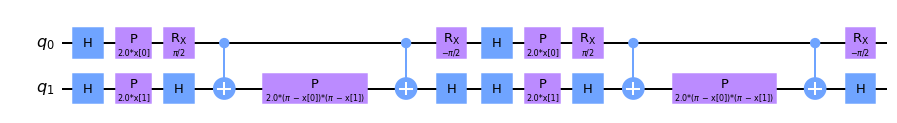


Quantum kernel matrices:



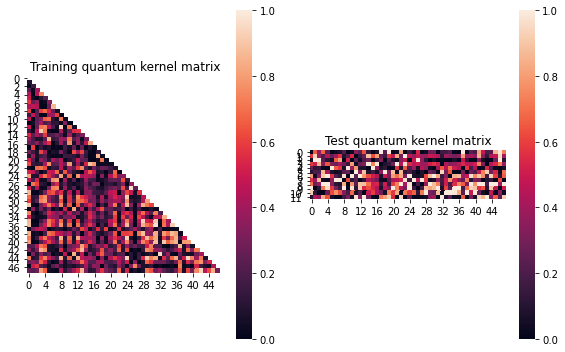


SVM with quantum kernel trained!


Test set performance:


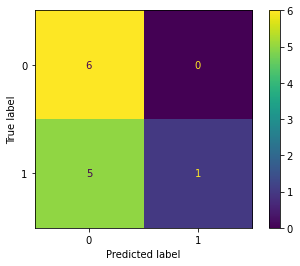

              precision    recall  f1-score   support

           0       0.55      1.00      0.71         6
           1       1.00      0.17      0.29         6

    accuracy                           0.58        12
   macro avg       0.77      0.58      0.50        12
weighted avg       0.77      0.58      0.50        12


metric 1: 0.03347329575511648
metric(s) 2: (00, 10, 11) = (0.2978312340426778, 0.31417989687690207, 0.39747515122135935)
metric 3: 2.536441875133542e-269


----> Kernel construction duration: 00:01:33


Combination 198/468
(Current range: 14/46)
			 reps : 2
			 paulis : ['Z', 'XZ']
			 entanglement : linear

Feature map:


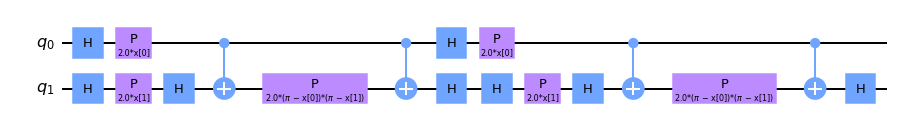


Quantum kernel matrices:



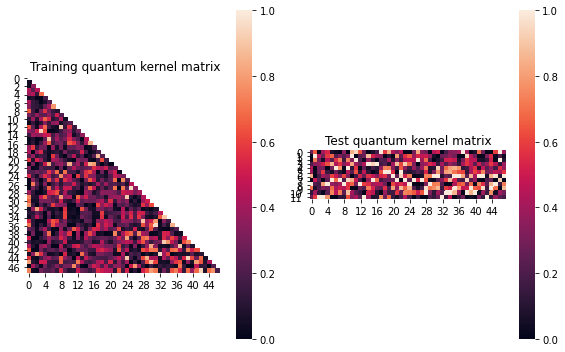


SVM with quantum kernel trained!


Test set performance:


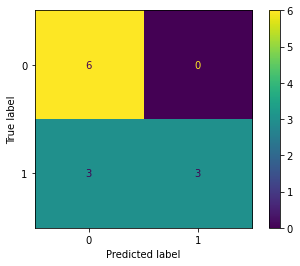

              precision    recall  f1-score   support

           0       0.67      1.00      0.80         6
           1       1.00      0.50      0.67         6

    accuracy                           0.75        12
   macro avg       0.83      0.75      0.73        12
weighted avg       0.83      0.75      0.73        12


metric 1: 0.06522108326402709
metric(s) 2: (00, 10, 11) = (0.2998514623671519, 0.2637632754212912, 0.35811725500348474)
metric 3: -8.55537154668035e-283


----> Kernel construction duration: 00:01:27


Combination 199/468
(Current range: 15/46)
			 reps : 2
			 paulis : ['Z', 'YX']
			 entanglement : linear

Feature map:


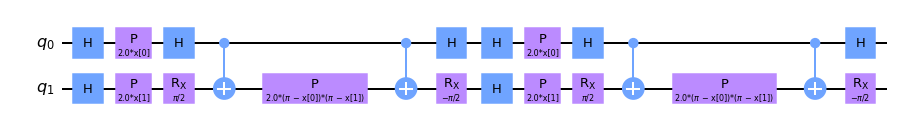


Quantum kernel matrices:



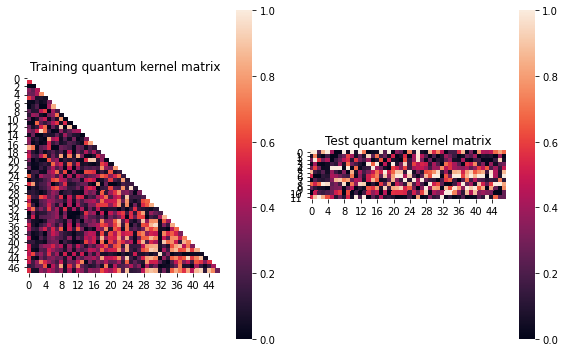


SVM with quantum kernel trained!


Test set performance:


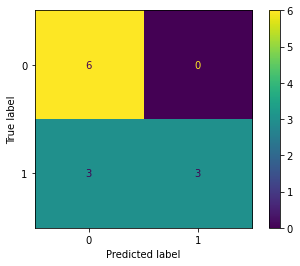

              precision    recall  f1-score   support

           0       0.67      1.00      0.80         6
           1       1.00      0.50      0.67         6

    accuracy                           0.75        12
   macro avg       0.83      0.75      0.73        12
weighted avg       0.83      0.75      0.73        12


metric 1: 0.059295798856342896
metric(s) 2: (00, 10, 11) = (0.2793246568544747, 0.2956989038207262, 0.4306647484996635)
metric 3: -2.8477279858818975e-256


----> Kernel construction duration: 00:01:33


Combination 200/468
(Current range: 16/46)
			 reps : 2
			 paulis : ['Z', 'YY']
			 entanglement : linear

Feature map:


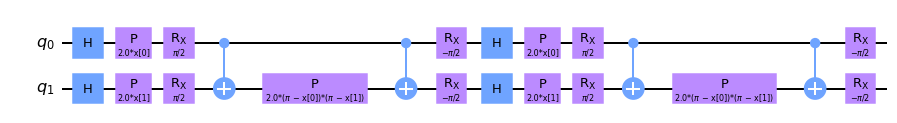


Quantum kernel matrices:



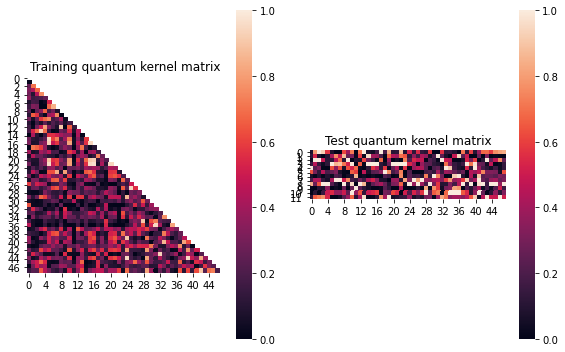


SVM with quantum kernel trained!


Test set performance:


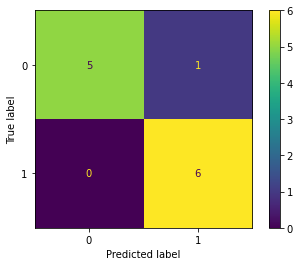

              precision    recall  f1-score   support

           0       1.00      0.83      0.91         6
           1       0.86      1.00      0.92         6

    accuracy                           0.92        12
   macro avg       0.93      0.92      0.92        12
weighted avg       0.93      0.92      0.92        12


metric 1: 0.10355603866185562
metric(s) 2: (00, 10, 11) = (0.34773559569858004, 0.24315069045776985, 0.3456778625406709)
metric 3: 3.559712055909166e-257


----> Kernel construction duration: 00:01:36


Combination 201/468
(Current range: 17/46)
			 reps : 2
			 paulis : ['Z', 'YZ']
			 entanglement : linear

Feature map:


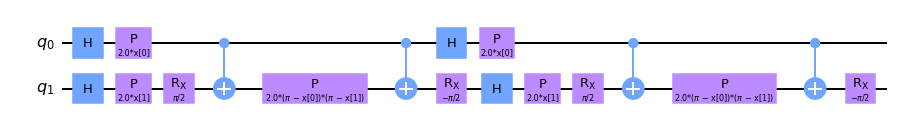


Quantum kernel matrices:



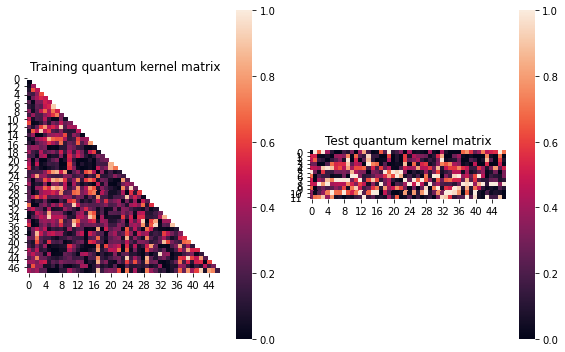


SVM with quantum kernel trained!


Test set performance:


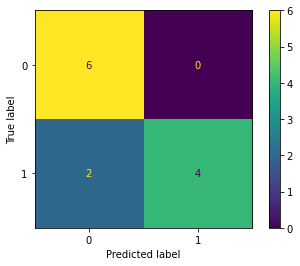

              precision    recall  f1-score   support

           0       0.75      1.00      0.86         6
           1       1.00      0.67      0.80         6

    accuracy                           0.83        12
   macro avg       0.88      0.83      0.83        12
weighted avg       0.88      0.83      0.83        12


metric 1: 0.058123097997424156
metric(s) 2: (00, 10, 11) = (0.315501760444645, 0.26836803484910504, 0.3374805052484134)
metric 3: -2.552169955075434e-268


----> Kernel construction duration: 00:01:31


Combination 202/468
(Current range: 18/46)
			 reps : 2
			 paulis : ['Z', 'ZX']
			 entanglement : linear

Feature map:


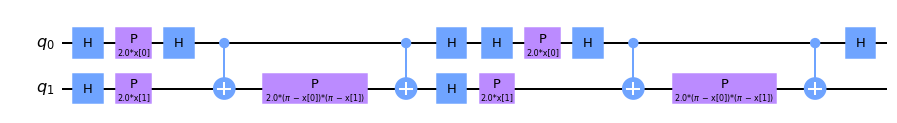


Quantum kernel matrices:



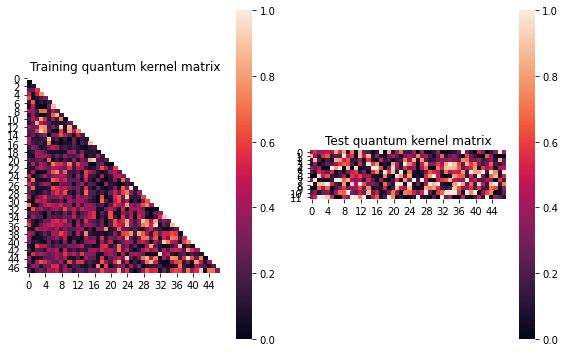


SVM with quantum kernel trained!


Test set performance:


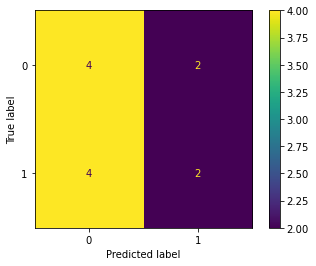

              precision    recall  f1-score   support

           0       0.50      0.67      0.57         6
           1       0.50      0.33      0.40         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.49        12
weighted avg       0.50      0.50      0.49        12


metric 1: 0.0632534911977517
metric(s) 2: (00, 10, 11) = (0.30779185035014284, 0.2791455603049181, 0.3770062526551968)
metric 3: -2.604050864768553e-256


----> Kernel construction duration: 00:01:26


Combination 203/468
(Current range: 19/46)
			 reps : 2
			 paulis : ['Z', 'ZY']
			 entanglement : linear

Feature map:


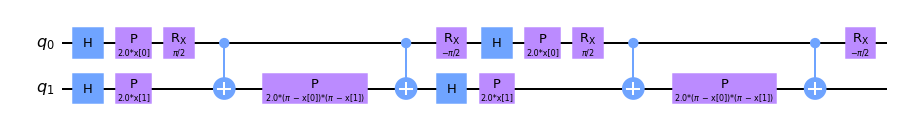


Quantum kernel matrices:



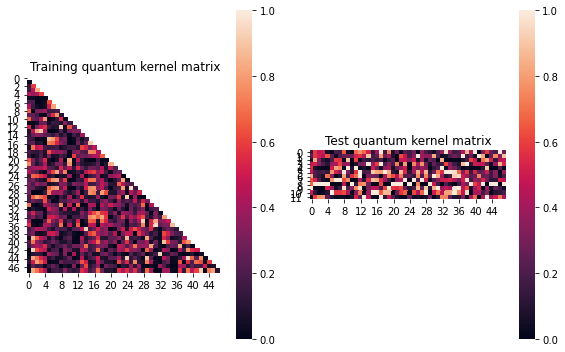


SVM with quantum kernel trained!


Test set performance:


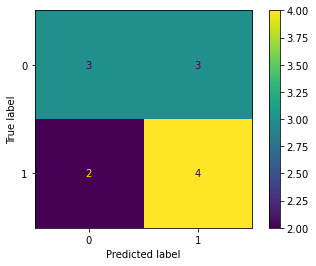

              precision    recall  f1-score   support

           0       0.60      0.50      0.55         6
           1       0.57      0.67      0.62         6

    accuracy                           0.58        12
   macro avg       0.59      0.58      0.58        12
weighted avg       0.59      0.58      0.58        12


metric 1: 0.04289323857683036
metric(s) 2: (00, 10, 11) = (0.2996605101466793, 0.2706354351772477, 0.3273968373614768)
metric 3: -3.9111729411813574e-271


----> Kernel construction duration: 00:01:30


Combination 204/468
(Current range: 20/46)
			 reps : 2
			 paulis : ['Z', 'ZZ']
			 entanglement : linear

Feature map:


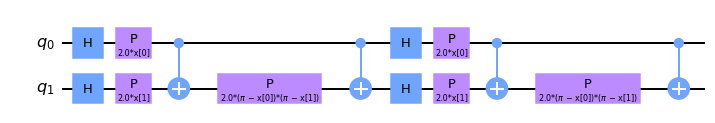


Quantum kernel matrices:



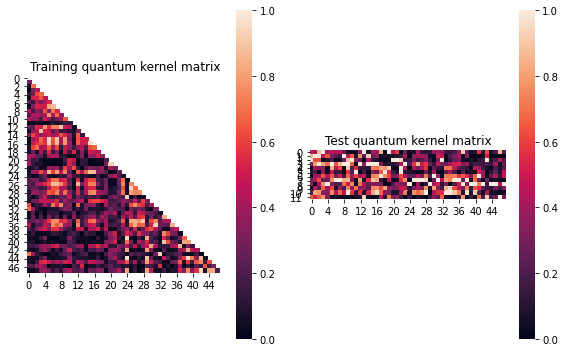


SVM with quantum kernel trained!


Test set performance:


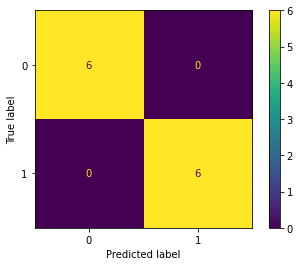

              precision    recall  f1-score   support

           0       1.00      1.00      1.00         6
           1       1.00      1.00      1.00         6

    accuracy                           1.00        12
   macro avg       1.00      1.00      1.00        12
weighted avg       1.00      1.00      1.00        12


metric 1: 0.12078912227428518
metric(s) 2: (00, 10, 11) = (0.3748516035493653, 0.248351635272397, 0.363429911543999)
metric 3: 1.2775692381540672e-255


----> Kernel construction duration: 00:01:24


Combination 205/468
(Current range: 21/46)
			 reps : 2
			 paulis : ['XX', 'X']
			 entanglement : linear

Feature map:


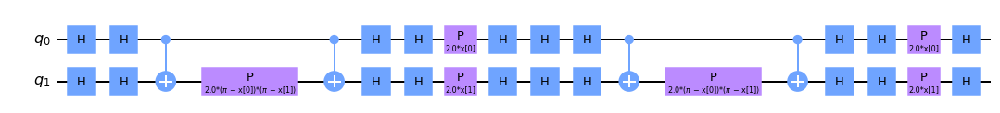


Quantum kernel matrices:



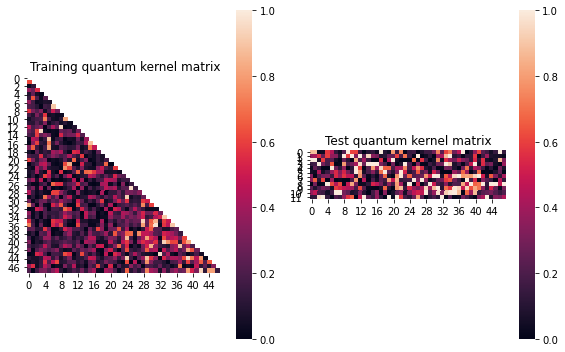


SVM with quantum kernel trained!


Test set performance:


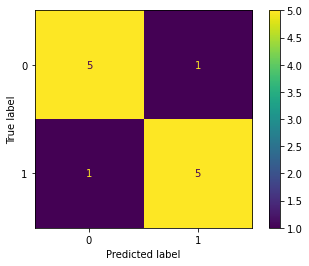

              precision    recall  f1-score   support

           0       0.83      0.83      0.83         6
           1       0.83      0.83      0.83         6

    accuracy                           0.83        12
   macro avg       0.83      0.83      0.83        12
weighted avg       0.83      0.83      0.83        12


metric 1: 0.1045473502897318
metric(s) 2: (00, 10, 11) = (0.26357271453930053, 0.21214886155599652, 0.3698197091521561)
metric 3: 2.3512872618074066e-286


----> Kernel construction duration: 00:01:15


Combination 206/468
(Current range: 22/46)
			 reps : 2
			 paulis : ['XX', 'Y']
			 entanglement : linear

Feature map:


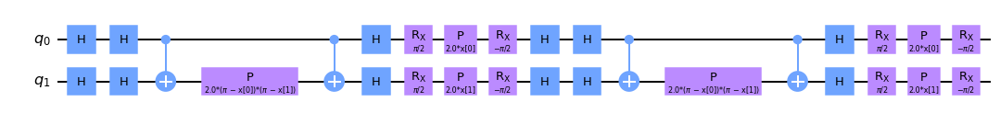


Quantum kernel matrices:



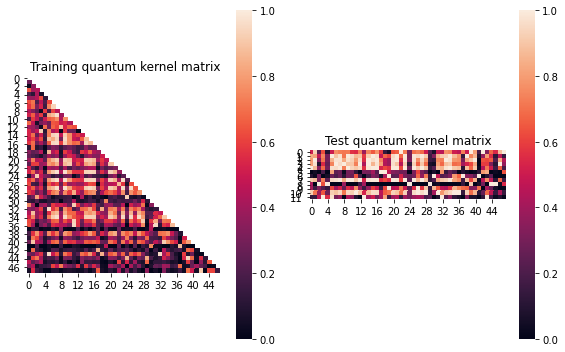


SVM with quantum kernel trained!


Test set performance:


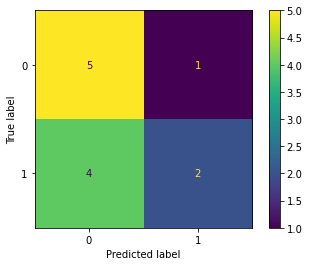

              precision    recall  f1-score   support

           0       0.56      0.83      0.67         6
           1       0.67      0.33      0.44         6

    accuracy                           0.58        12
   macro avg       0.61      0.58      0.56        12
weighted avg       0.61      0.58      0.56        12


metric 1: 0.05357472635163829
metric(s) 2: (00, 10, 11) = (0.5061827297830654, 0.3806504316993625, 0.36226758631893613)
metric 3: -1.8953290420267862e-298


----> Kernel construction duration: 00:01:25


Combination 207/468
(Current range: 23/46)
			 reps : 2
			 paulis : ['XX', 'Z']
			 entanglement : linear

Feature map:


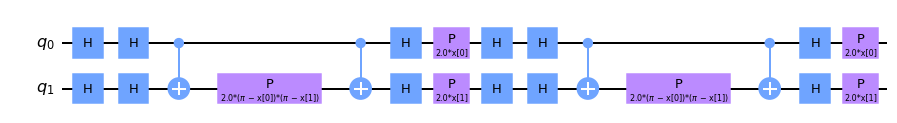


Quantum kernel matrices:



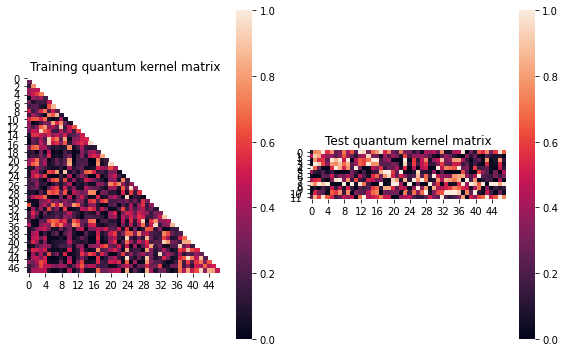


SVM with quantum kernel trained!


Test set performance:


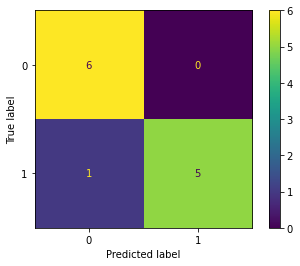

              precision    recall  f1-score   support

           0       0.86      1.00      0.92         6
           1       1.00      0.83      0.91         6

    accuracy                           0.92        12
   macro avg       0.93      0.92      0.92        12
weighted avg       0.93      0.92      0.92        12


metric 1: 0.11073365258079587
metric(s) 2: (00, 10, 11) = (0.3557648296183823, 0.26099285912497955, 0.3876881937931685)
metric 3: 6.42052393454142e-269


----> Kernel construction duration: 00:01:23


Combination 208/468
(Current range: 24/46)
			 reps : 2
			 paulis : ['XX', 'XX']
			 entanglement : linear

Feature map:


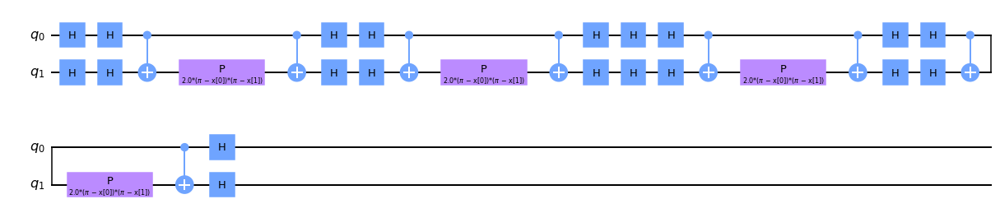


Quantum kernel matrices:



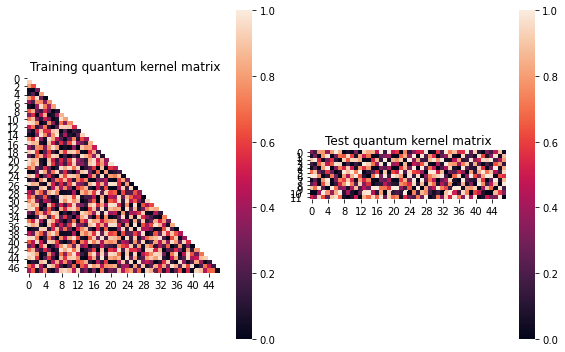


SVM with quantum kernel trained!


Test set performance:


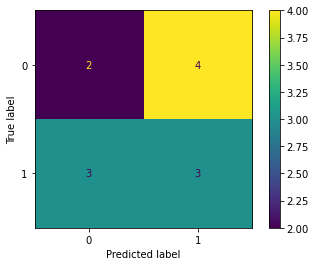

              precision    recall  f1-score   support

           0       0.40      0.33      0.36         6
           1       0.43      0.50      0.46         6

    accuracy                           0.42        12
   macro avg       0.41      0.42      0.41        12
weighted avg       0.41      0.42      0.41        12


metric 1: 0.005189231185427912
metric(s) 2: (00, 10, 11) = (0.49936335961957806, 0.494900756823733, 0.5008166163987438)
metric 3: 0.0


----> Kernel construction duration: 00:00:58


Combination 209/468
(Current range: 25/46)
			 reps : 2
			 paulis : ['XX', 'XY']
			 entanglement : linear

Feature map:


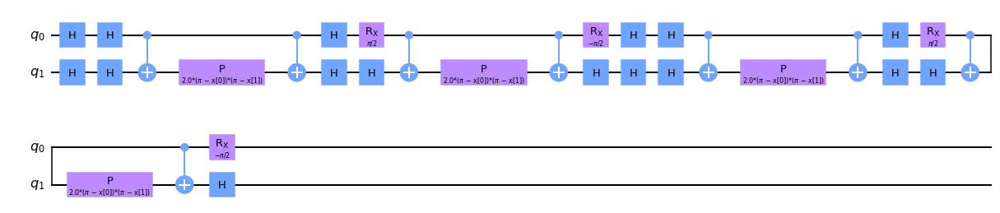


Quantum kernel matrices:



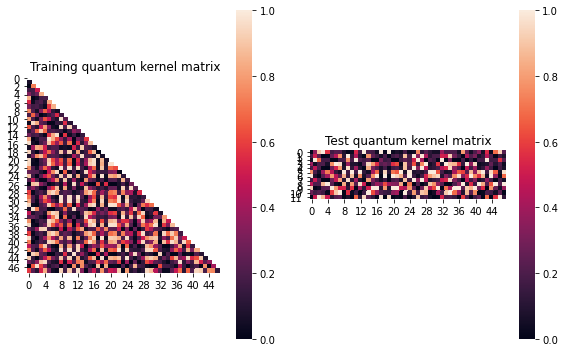


SVM with quantum kernel trained!


Test set performance:


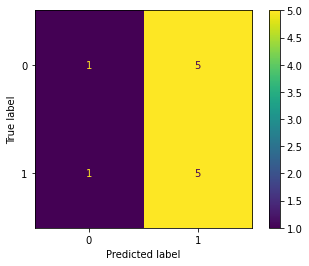

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.006684369447313543
metric(s) 2: (00, 10, 11) = (0.39062719271285506, 0.39298880812229275, 0.40871916242635753)
metric 3: -4.130553964775e-311


----> Kernel construction duration: 00:01:41


Combination 210/468
(Current range: 26/46)
			 reps : 2
			 paulis : ['XX', 'XZ']
			 entanglement : linear

Feature map:


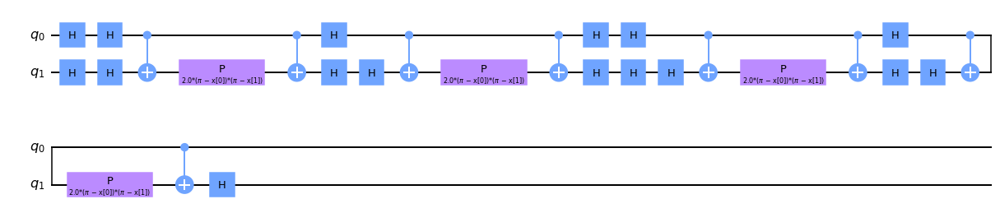


Quantum kernel matrices:



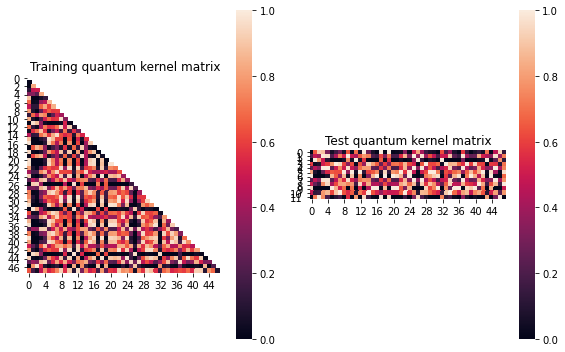


SVM with quantum kernel trained!


Test set performance:


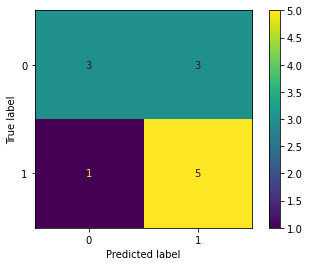

              precision    recall  f1-score   support

           0       0.75      0.50      0.60         6
           1       0.62      0.83      0.71         6

    accuracy                           0.67        12
   macro avg       0.69      0.67      0.66        12
weighted avg       0.69      0.67      0.66        12


metric 1: 0.0013378937981214367
metric(s) 2: (00, 10, 11) = (0.468796122439021, 0.4809916971689664, 0.49586305949515463)
metric 3: -0.0


----> Kernel construction duration: 00:01:31


Combination 211/468
(Current range: 27/46)
			 reps : 2
			 paulis : ['XX', 'YX']
			 entanglement : linear

Feature map:


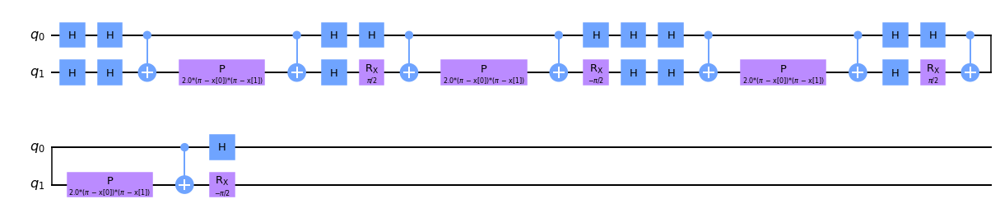


Quantum kernel matrices:



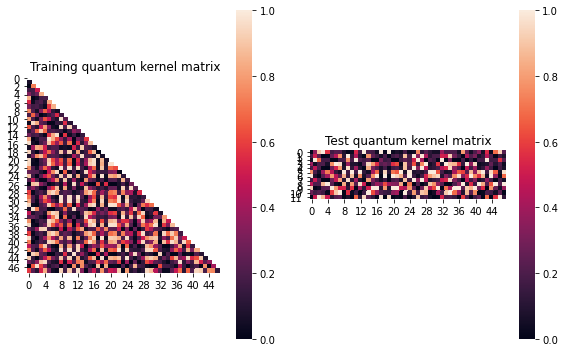


SVM with quantum kernel trained!


Test set performance:


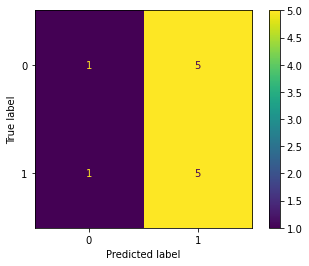

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.006684369447313543
metric(s) 2: (00, 10, 11) = (0.39062719271285506, 0.39298880812229275, 0.40871916242635753)
metric 3: -4.130553964775e-311


----> Kernel construction duration: 00:01:43


Combination 212/468
(Current range: 28/46)
			 reps : 2
			 paulis : ['XX', 'YY']
			 entanglement : linear

Feature map:


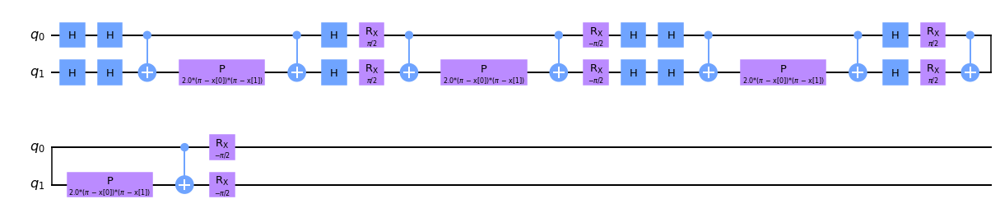


Quantum kernel matrices:



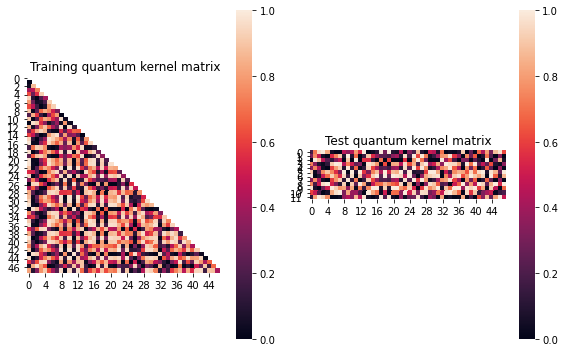


SVM with quantum kernel trained!


Test set performance:


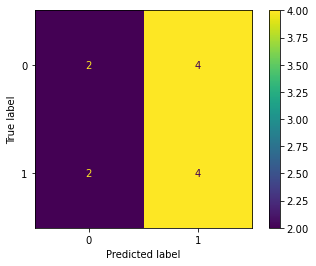

              precision    recall  f1-score   support

           0       0.50      0.33      0.40         6
           1       0.50      0.67      0.57         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.49        12
weighted avg       0.50      0.50      0.49        12


metric 1: 0.0030024471480464276
metric(s) 2: (00, 10, 11) = (0.5194729525883561, 0.5274296115848754, 0.5413911648774875)
metric 3: 0.0


----> Kernel construction duration: 00:02:04


Combination 213/468
(Current range: 29/46)
			 reps : 2
			 paulis : ['XX', 'YZ']
			 entanglement : linear

Feature map:


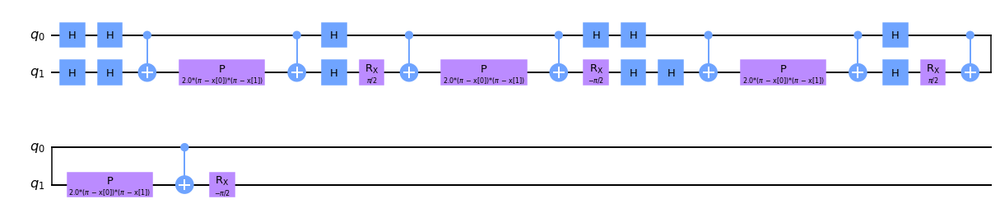


Quantum kernel matrices:



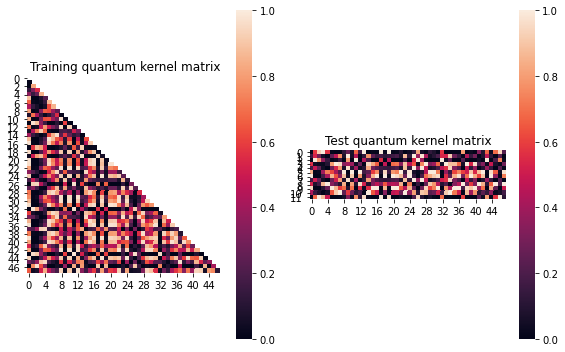


SVM with quantum kernel trained!


Test set performance:


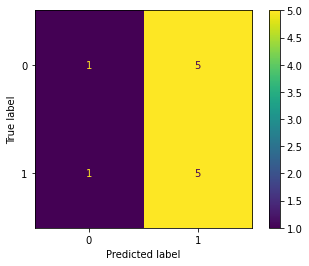

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.0059279350487767
metric(s) 2: (00, 10, 11) = (0.4041057739631215, 0.41303442475791446, 0.4338189456502609)
metric 3: 0.0


----> Kernel construction duration: 00:01:54


Combination 214/468
(Current range: 30/46)
			 reps : 2
			 paulis : ['XX', 'ZX']
			 entanglement : linear

Feature map:


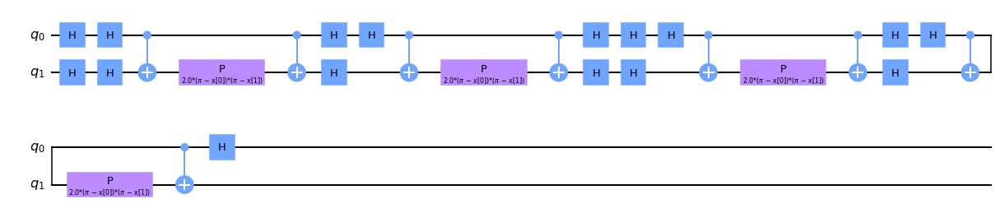


Quantum kernel matrices:



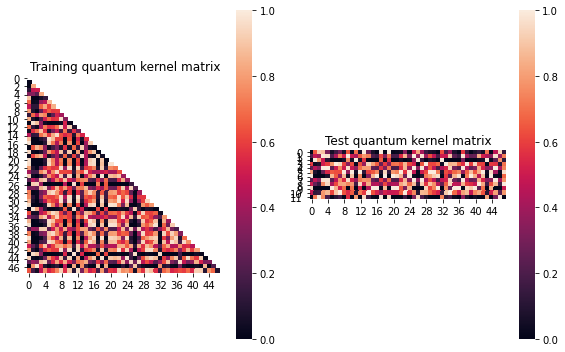


SVM with quantum kernel trained!


Test set performance:


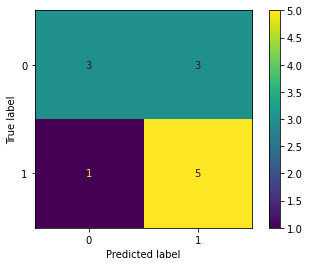

              precision    recall  f1-score   support

           0       0.75      0.50      0.60         6
           1       0.62      0.83      0.71         6

    accuracy                           0.67        12
   macro avg       0.69      0.67      0.66        12
weighted avg       0.69      0.67      0.66        12


metric 1: 0.0013378937981214367
metric(s) 2: (00, 10, 11) = (0.468796122439021, 0.4809916971689664, 0.49586305949515463)
metric 3: -0.0


----> Kernel construction duration: 00:01:31


Combination 215/468
(Current range: 31/46)
			 reps : 2
			 paulis : ['XX', 'ZY']
			 entanglement : linear

Feature map:


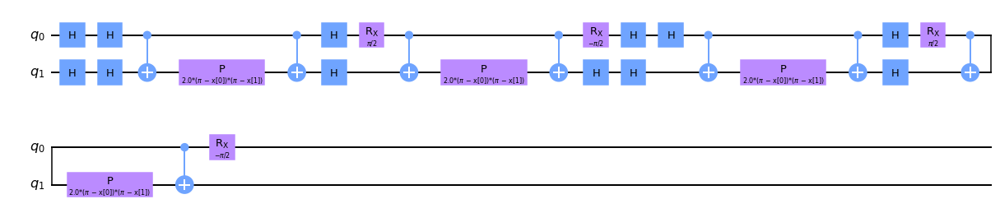


Quantum kernel matrices:



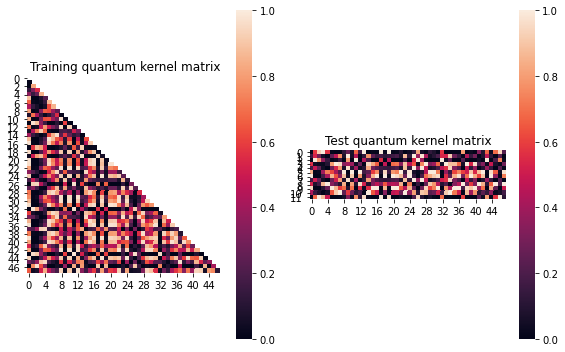


SVM with quantum kernel trained!


Test set performance:


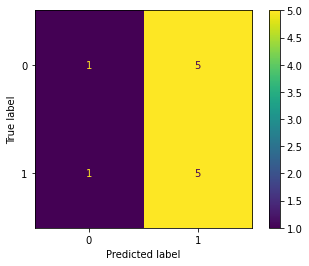

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.0059279350487767
metric(s) 2: (00, 10, 11) = (0.4041057739631215, 0.41303442475791446, 0.4338189456502609)
metric 3: 0.0


----> Kernel construction duration: 00:01:53


Combination 216/468
(Current range: 32/46)
			 reps : 2
			 paulis : ['XX', 'ZZ']
			 entanglement : linear

Feature map:


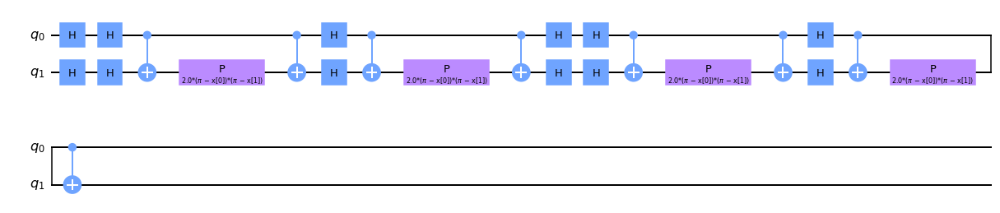


Quantum kernel matrices:



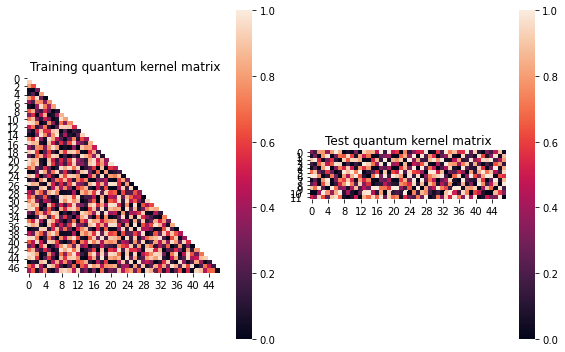


SVM with quantum kernel trained!


Test set performance:


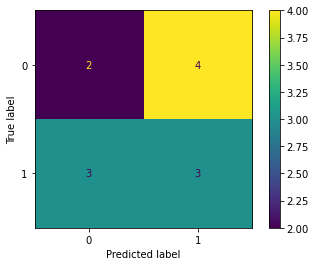

              precision    recall  f1-score   support

           0       0.40      0.33      0.36         6
           1       0.43      0.50      0.46         6

    accuracy                           0.42        12
   macro avg       0.41      0.42      0.41        12
weighted avg       0.41      0.42      0.41        12


metric 1: 0.005189231185427912
metric(s) 2: (00, 10, 11) = (0.49936335961957806, 0.494900756823733, 0.5008166163987438)
metric 3: 0.0


----> Kernel construction duration: 00:01:33


Combination 217/468
(Current range: 33/46)
			 reps : 2
			 paulis : ['XY', 'X']
			 entanglement : linear

Feature map:


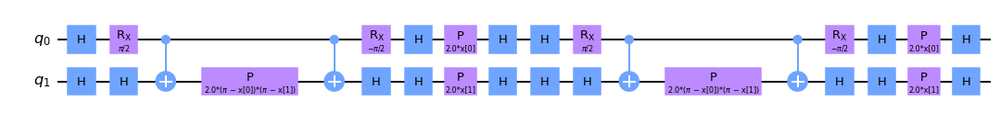


Quantum kernel matrices:



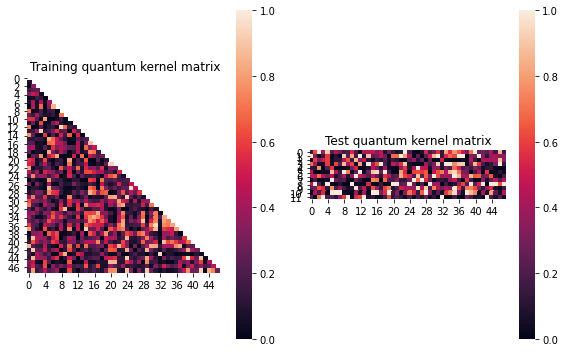


SVM with quantum kernel trained!


Test set performance:


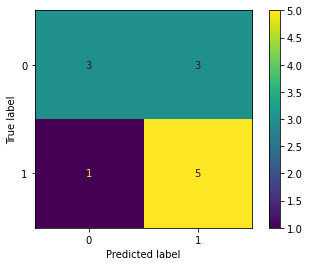

              precision    recall  f1-score   support

           0       0.75      0.50      0.60         6
           1       0.62      0.83      0.71         6

    accuracy                           0.67        12
   macro avg       0.69      0.67      0.66        12
weighted avg       0.69      0.67      0.66        12


metric 1: 0.02806193429698217
metric(s) 2: (00, 10, 11) = (0.2975892549487591, 0.2943997191110221, 0.34733405186724936)
metric 3: -1.3143172387789055e-272


----> Kernel construction duration: 00:01:33


Combination 218/468
(Current range: 34/46)
			 reps : 2
			 paulis : ['XY', 'Y']
			 entanglement : linear

Feature map:


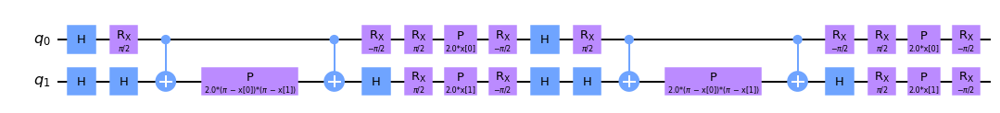


Quantum kernel matrices:



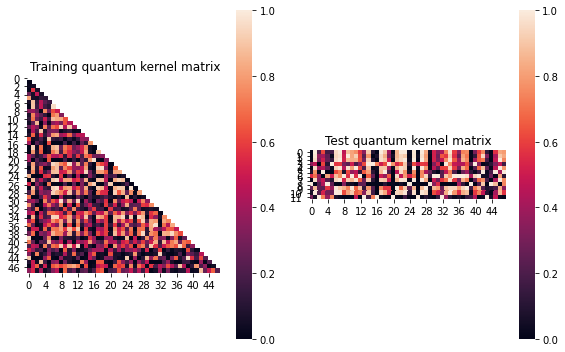


SVM with quantum kernel trained!


Test set performance:


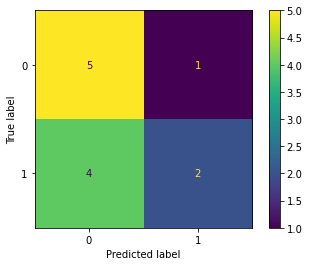

              precision    recall  f1-score   support

           0       0.56      0.83      0.67         6
           1       0.67      0.33      0.44         6

    accuracy                           0.58        12
   macro avg       0.61      0.58      0.56        12
weighted avg       0.61      0.58      0.56        12


metric 1: 0.03748332790685582
metric(s) 2: (00, 10, 11) = (0.39874301139973145, 0.360749521245215, 0.3977226869044101)
metric 3: -0.0


----> Kernel construction duration: 00:01:34


Combination 219/468
(Current range: 35/46)
			 reps : 2
			 paulis : ['XY', 'Z']
			 entanglement : linear

Feature map:


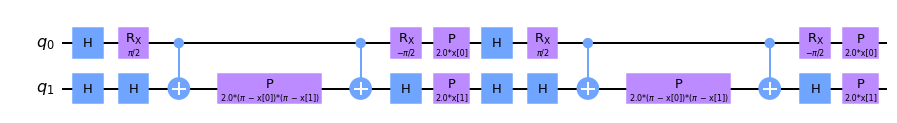


Quantum kernel matrices:



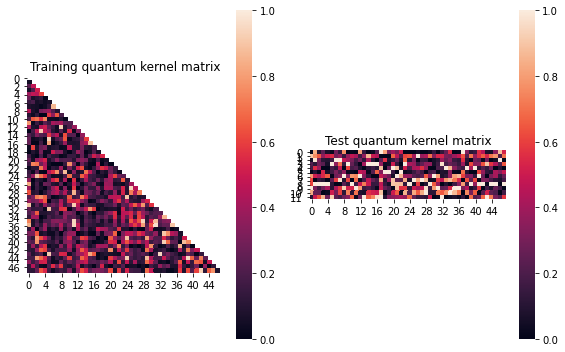


SVM with quantum kernel trained!


Test set performance:


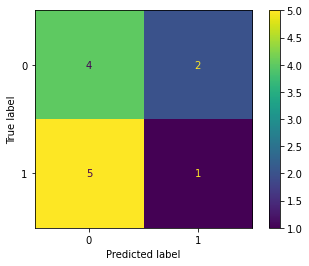

              precision    recall  f1-score   support

           0       0.44      0.67      0.53         6
           1       0.33      0.17      0.22         6

    accuracy                           0.42        12
   macro avg       0.39      0.42      0.38        12
weighted avg       0.39      0.42      0.38        12


metric 1: 0.04006737201103139
metric(s) 2: (00, 10, 11) = (0.2644307060748433, 0.2614665112644985, 0.3386370604762164)
metric 3: -1.690905381859615e-270


----> Kernel construction duration: 00:01:34


Combination 220/468
(Current range: 36/46)
			 reps : 2
			 paulis : ['XY', 'XX']
			 entanglement : linear

Feature map:


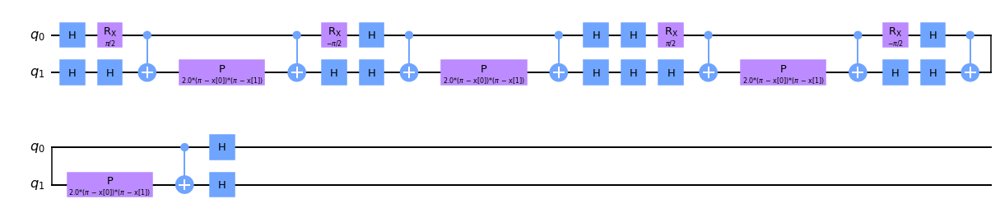


Quantum kernel matrices:



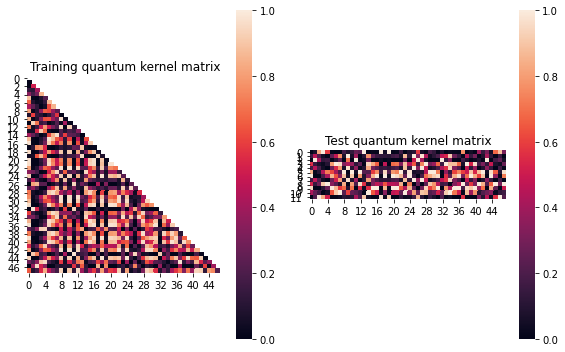


SVM with quantum kernel trained!


Test set performance:


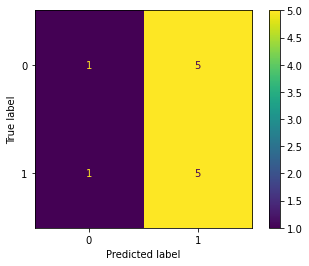

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.0063560756167350685
metric(s) 2: (00, 10, 11) = (0.3946095549722037, 0.40855081371977636, 0.4352042237008191)
metric 3: 5.14e-322


----> Kernel construction duration: 00:01:52


Combination 221/468
(Current range: 37/46)
			 reps : 2
			 paulis : ['XY', 'XY']
			 entanglement : linear

Feature map:


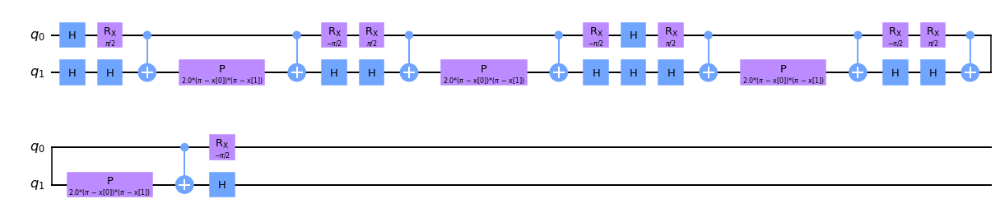


Quantum kernel matrices:



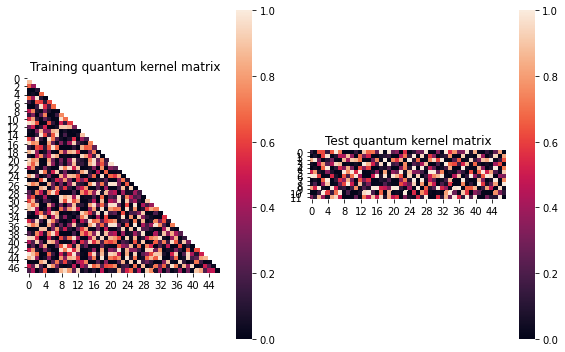


SVM with quantum kernel trained!


Test set performance:


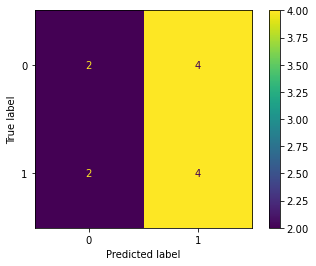

              precision    recall  f1-score   support

           0       0.50      0.33      0.40         6
           1       0.50      0.67      0.57         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.49        12
weighted avg       0.50      0.50      0.49        12


metric 1: 0.007516014510359381
metric(s) 2: (00, 10, 11) = (0.38602247404862156, 0.3780340823964001, 0.3850777197648973)
metric 3: -0.0


----> Kernel construction duration: 00:01:13


Combination 222/468
(Current range: 38/46)
			 reps : 2
			 paulis : ['XY', 'XZ']
			 entanglement : linear

Feature map:


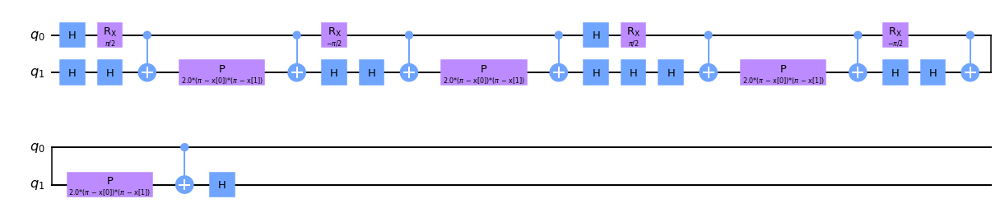


Quantum kernel matrices:



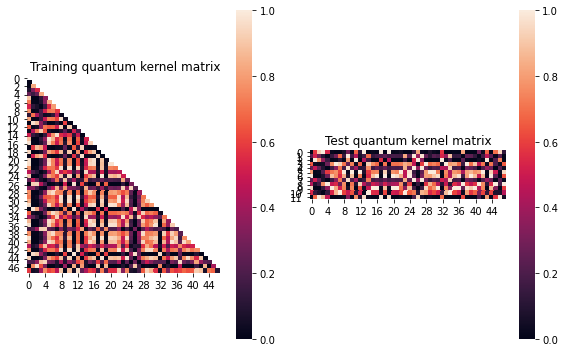


SVM with quantum kernel trained!


Test set performance:


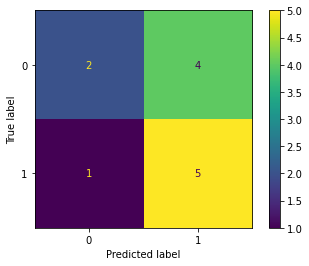

              precision    recall  f1-score   support

           0       0.67      0.33      0.44         6
           1       0.56      0.83      0.67         6

    accuracy                           0.58        12
   macro avg       0.61      0.58      0.56        12
weighted avg       0.61      0.58      0.56        12


metric 1: 0.007121518253098091
metric(s) 2: (00, 10, 11) = (0.4186797335205236, 0.4331073227093056, 0.46177794840428377)
metric 3: 1e-323


----> Kernel construction duration: 00:01:52


Combination 223/468
(Current range: 39/46)
			 reps : 2
			 paulis : ['XY', 'YX']
			 entanglement : linear

Feature map:


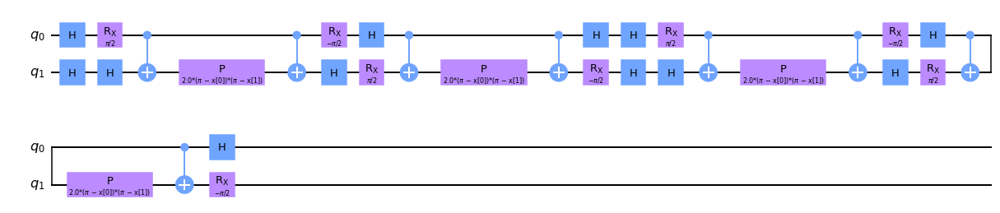


Quantum kernel matrices:



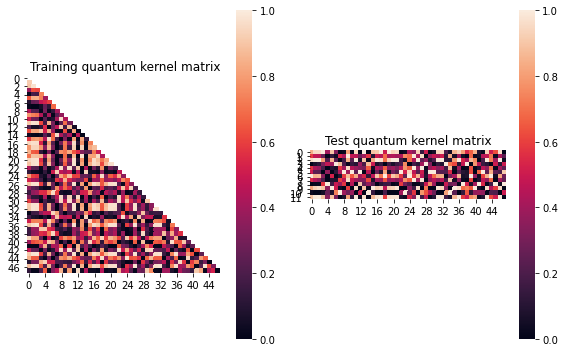


SVM with quantum kernel trained!


Test set performance:


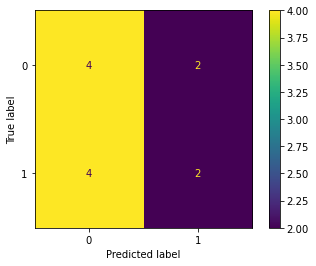

              precision    recall  f1-score   support

           0       0.50      0.67      0.57         6
           1       0.50      0.33      0.40         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.49        12
weighted avg       0.50      0.50      0.49        12


metric 1: 0.009020602650019638
metric(s) 2: (00, 10, 11) = (0.469925220802729, 0.44118769006425773, 0.4304913646258257)
metric 3: 0.0


----> Kernel construction duration: 00:02:14


Combination 224/468
(Current range: 40/46)
			 reps : 2
			 paulis : ['XY', 'YY']
			 entanglement : linear

Feature map:


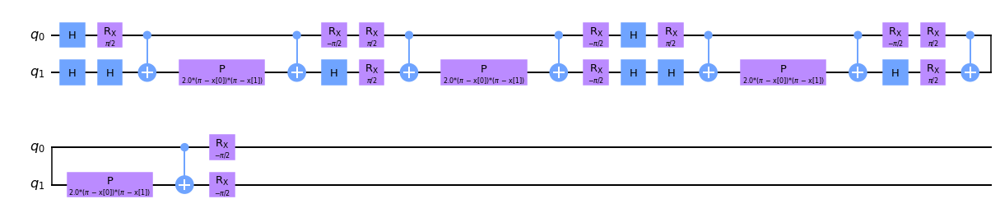


Quantum kernel matrices:



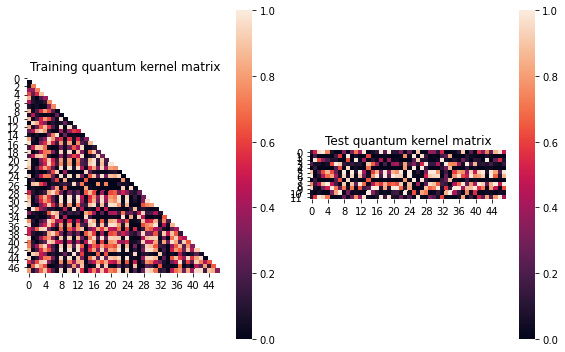


SVM with quantum kernel trained!


Test set performance:


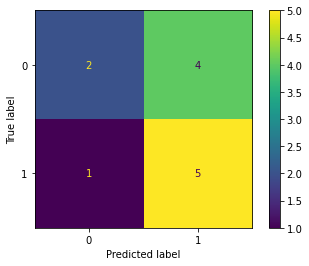

              precision    recall  f1-score   support

           0       0.67      0.33      0.44         6
           1       0.56      0.83      0.67         6

    accuracy                           0.58        12
   macro avg       0.61      0.58      0.56        12
weighted avg       0.61      0.58      0.56        12


metric 1: 0.004671137844378337
metric(s) 2: (00, 10, 11) = (0.40104697931024585, 0.40282945424308336, 0.41395420486467754)
metric 3: -0.0


----> Kernel construction duration: 00:01:57


Combination 225/468
(Current range: 41/46)
			 reps : 2
			 paulis : ['XY', 'YZ']
			 entanglement : linear

Feature map:


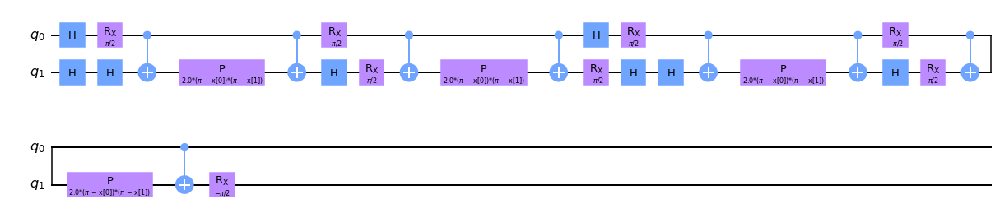


Quantum kernel matrices:



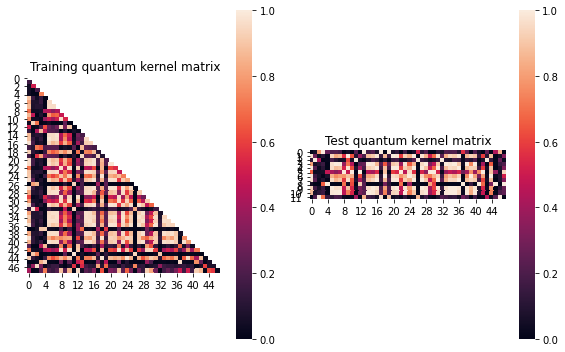


SVM with quantum kernel trained!


Test set performance:


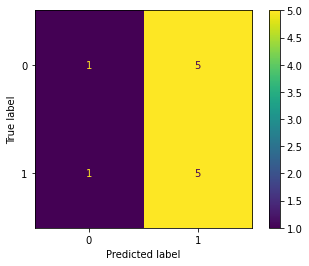

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.008096011748282339
metric(s) 2: (00, 10, 11) = (0.43659318978633344, 0.4369935819554691, 0.4535859976211695)
metric 3: 0.0


----> Kernel construction duration: 00:02:14


Combination 226/468
(Current range: 42/46)
			 reps : 2
			 paulis : ['XY', 'ZX']
			 entanglement : linear

Feature map:


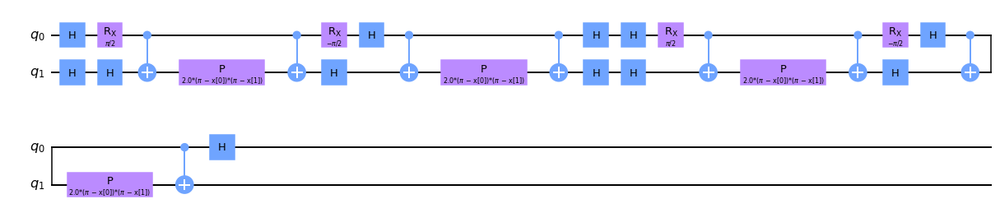


Quantum kernel matrices:



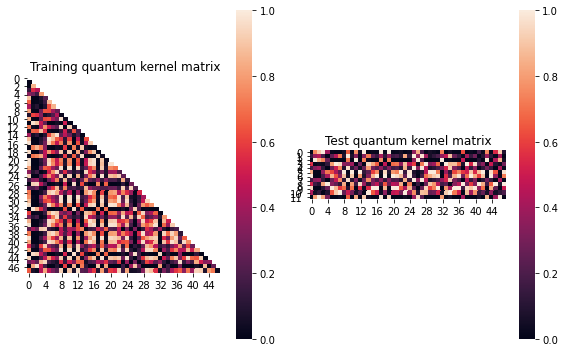


SVM with quantum kernel trained!


Test set performance:


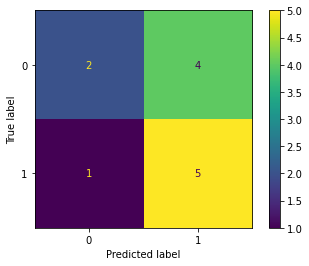

              precision    recall  f1-score   support

           0       0.67      0.33      0.44         6
           1       0.56      0.83      0.67         6

    accuracy                           0.58        12
   macro avg       0.61      0.58      0.56        12
weighted avg       0.61      0.58      0.56        12


metric 1: 0.006869846891391751
metric(s) 2: (00, 10, 11) = (0.4060577317852425, 0.4130337505270298, 0.43374946305160056)
metric 3: -2.00945491262364e-310


----> Kernel construction duration: 00:02:04


Combination 227/468
(Current range: 43/46)
			 reps : 2
			 paulis : ['XY', 'ZY']
			 entanglement : linear

Feature map:


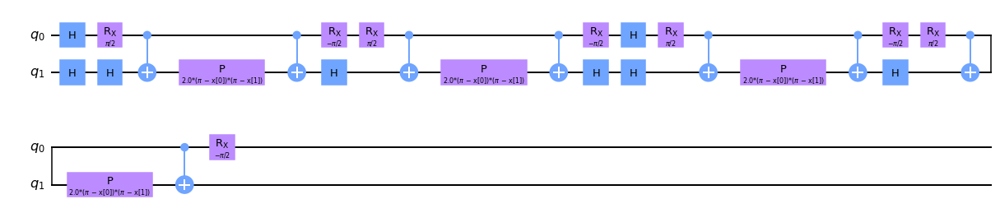


Quantum kernel matrices:



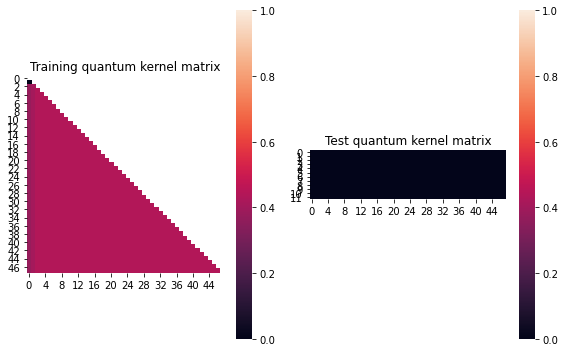


SVM with quantum kernel trained!


Test set performance:


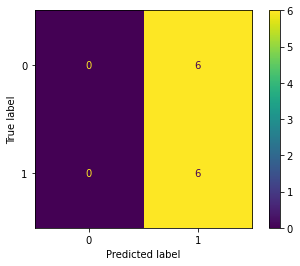

              precision    recall  f1-score   support

           0       0.00      0.00      0.00         6
           1       0.50      1.00      0.67         6

    accuracy                           0.50        12
   macro avg       0.25      0.50      0.33        12
weighted avg       0.25      0.50      0.33        12


metric 1: 0.00472005208333337
metric(s) 2: (00, 10, 11) = (0.4391276041666667, 0.43359375, 0.4375)
metric 3: 0.0


----> Kernel construction duration: 00:01:47


Combination 228/468
(Current range: 44/46)
			 reps : 2
			 paulis : ['XY', 'ZZ']
			 entanglement : linear

Feature map:


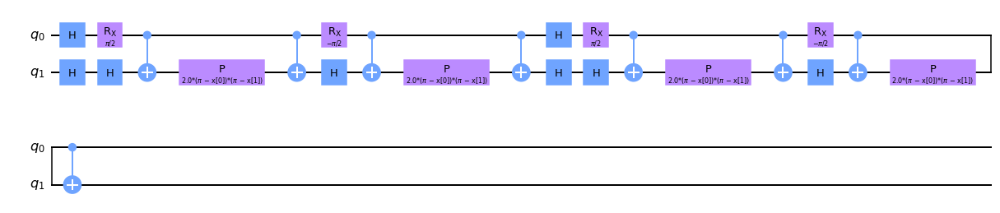


Quantum kernel matrices:



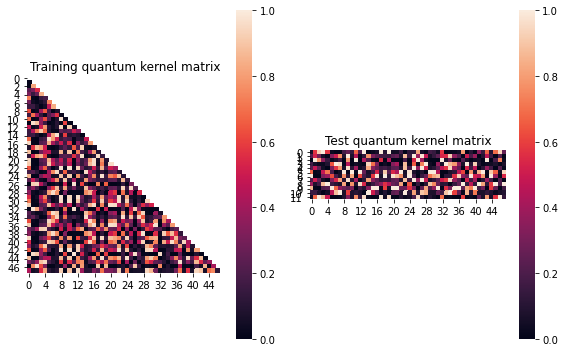


SVM with quantum kernel trained!


Test set performance:


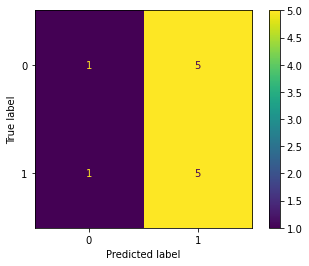

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.006236963971032516
metric(s) 2: (00, 10, 11) = (0.35185532795978236, 0.3479125952461691, 0.3564437904746208)
metric 3: 1e-323


----> Kernel construction duration: 00:02:04


Combination 229/468
(Current range: 45/46)
			 reps : 2
			 paulis : ['XZ', 'X']
			 entanglement : linear

Feature map:


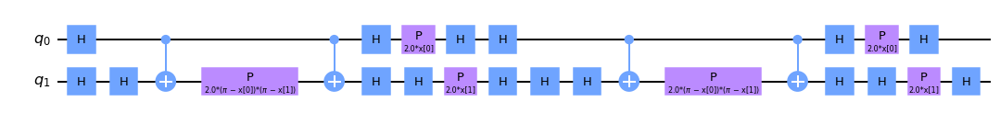


Quantum kernel matrices:



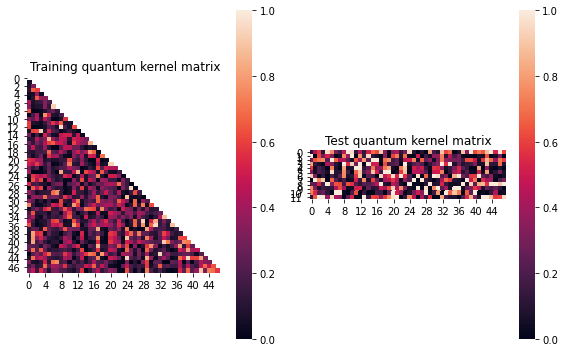


SVM with quantum kernel trained!


Test set performance:


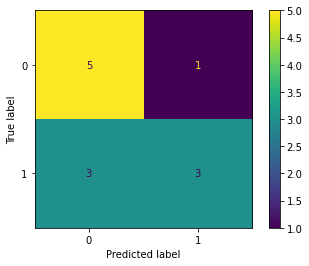

              precision    recall  f1-score   support

           0       0.62      0.83      0.71         6
           1       0.75      0.50      0.60         6

    accuracy                           0.67        12
   macro avg       0.69      0.67      0.66        12
weighted avg       0.69      0.67      0.66        12


metric 1: 0.050604483651510324
metric(s) 2: (00, 10, 11) = (0.2984842043079233, 0.26766427156405076, 0.3380533061231989)
metric 3: 1.5058681910844755e-272


----> Kernel construction duration: 00:01:30


Combination 230/468
(Current range: 46/46)
			 reps : 2
			 paulis : ['XZ', 'Y']
			 entanglement : linear

Feature map:


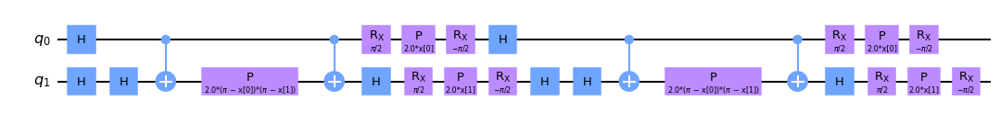


Quantum kernel matrices:



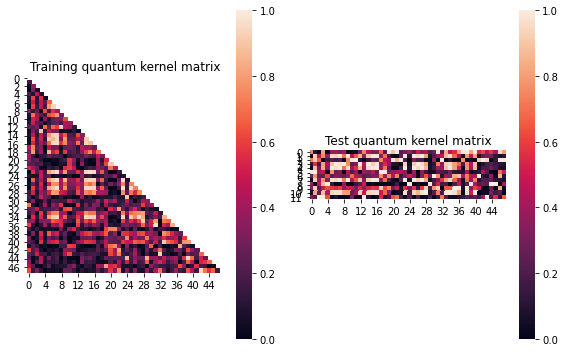


SVM with quantum kernel trained!


Test set performance:


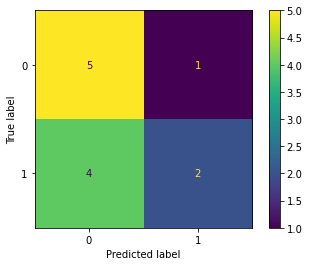

              precision    recall  f1-score   support

           0       0.56      0.83      0.67         6
           1       0.67      0.33      0.44         6

    accuracy                           0.58        12
   macro avg       0.61      0.58      0.56        12
weighted avg       0.61      0.58      0.56        12


metric 1: 0.08255671480945942
metric(s) 2: (00, 10, 11) = (0.3640190013223948, 0.28490806044129713, 0.3709105491791183)
metric 3: 4.760493977564704e-246


----> Kernel construction duration: 00:01:38


In [17]:
j=4
results.append(run_kernel_evaluation(X, X_train, y_train, X_test, y_test,
                                      param_grid, range_list, j, model=True))



Combination 231/468
(Current range: 1/46)
			 reps : 2
			 paulis : ['XZ', 'Z']
			 entanglement : linear

Feature map:


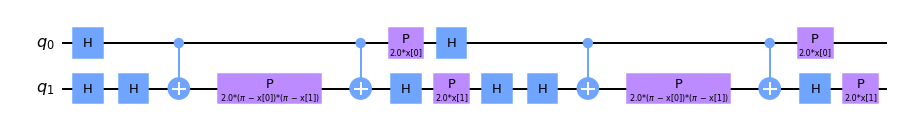


Quantum kernel matrices:



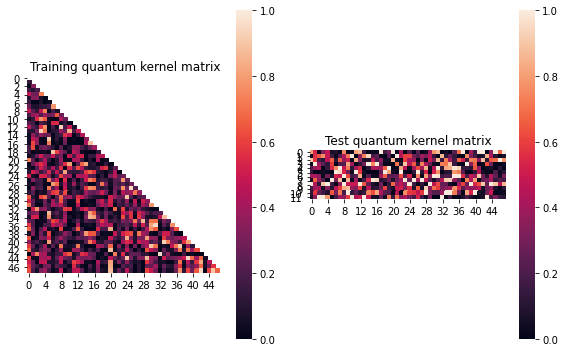


SVM with quantum kernel trained!


Test set performance:


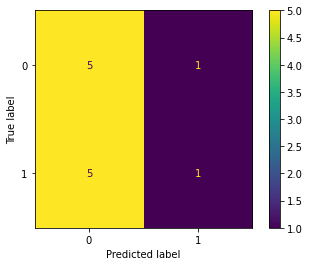

              precision    recall  f1-score   support

           0       0.50      0.83      0.62         6
           1       0.50      0.17      0.25         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.06726159065163734
metric(s) 2: (00, 10, 11) = (0.28246518817688887, 0.24806071239714683, 0.34817941792067947)
metric 3: -4.407815650520274e-256


----> Kernel construction duration: 00:01:30


Combination 232/468
(Current range: 2/46)
			 reps : 2
			 paulis : ['XZ', 'XX']
			 entanglement : linear

Feature map:


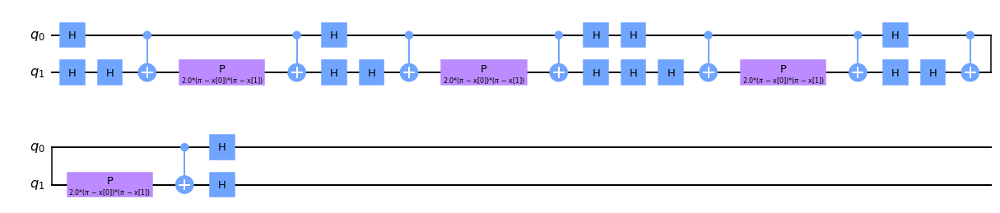


Quantum kernel matrices:



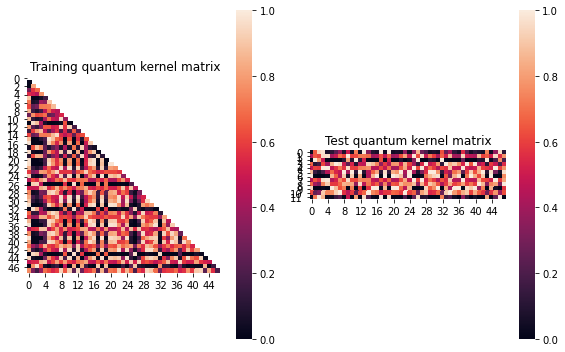


SVM with quantum kernel trained!


Test set performance:


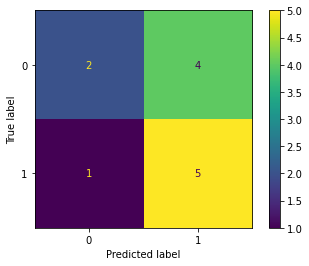

              precision    recall  f1-score   support

           0       0.67      0.33      0.44         6
           1       0.56      0.83      0.67         6

    accuracy                           0.58        12
   macro avg       0.61      0.58      0.56        12
weighted avg       0.61      0.58      0.56        12


metric 1: -0.00287470733398254
metric(s) 2: (00, 10, 11) = (0.49490396168777195, 0.5083145122829045, 0.5159756482100718)
metric 3: -0.0


----> Kernel construction duration: 00:01:42


Combination 233/468
(Current range: 3/46)
			 reps : 2
			 paulis : ['XZ', 'XY']
			 entanglement : linear

Feature map:


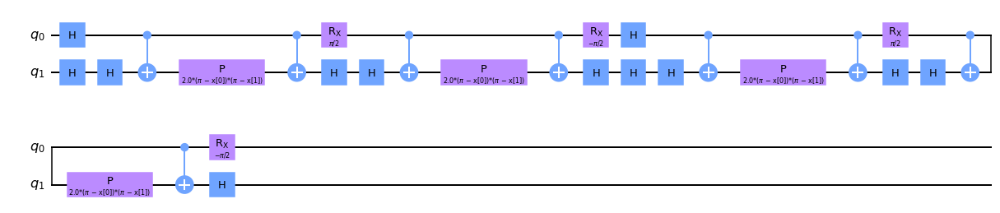


Quantum kernel matrices:



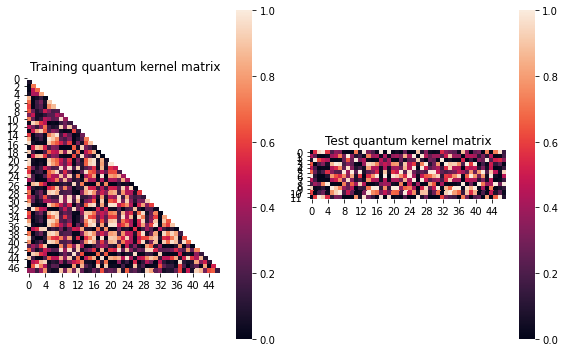


SVM with quantum kernel trained!


Test set performance:


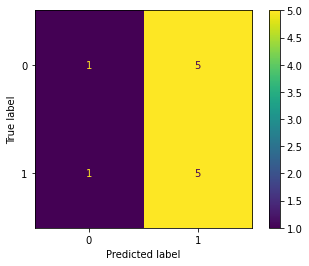

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.004937674467186515
metric(s) 2: (00, 10, 11) = (0.40462516537586635, 0.4029092418148262, 0.41106866718815904)
metric 3: 1.813e-321


----> Kernel construction duration: 00:01:53


Combination 234/468
(Current range: 4/46)
			 reps : 2
			 paulis : ['XZ', 'XZ']
			 entanglement : linear

Feature map:


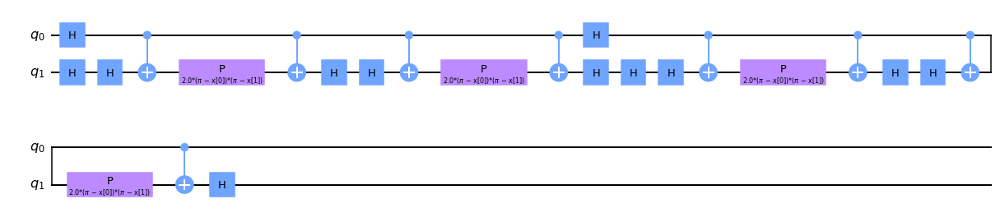


Quantum kernel matrices:



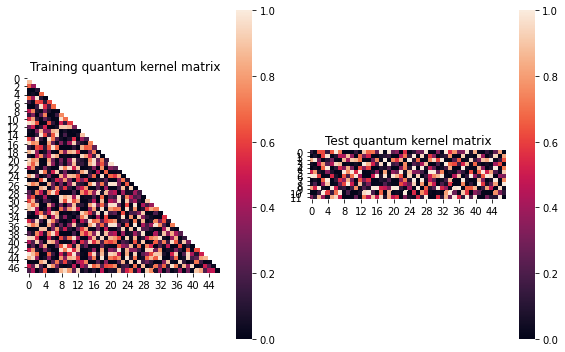


SVM with quantum kernel trained!


Test set performance:


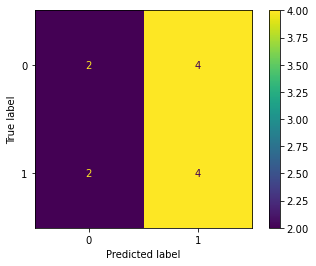

              precision    recall  f1-score   support

           0       0.50      0.33      0.40         6
           1       0.50      0.67      0.57         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.49        12
weighted avg       0.50      0.50      0.49        12


metric 1: 0.007516014510359381
metric(s) 2: (00, 10, 11) = (0.38602247404862156, 0.3780340823964001, 0.3850777197648973)
metric 3: -0.0


----> Kernel construction duration: 00:01:09


Combination 235/468
(Current range: 5/46)
			 reps : 2
			 paulis : ['XZ', 'YX']
			 entanglement : linear

Feature map:


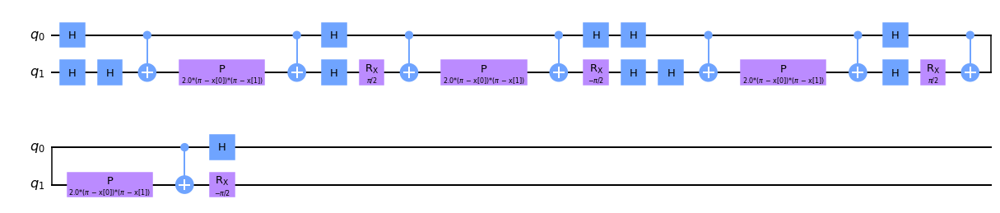


Quantum kernel matrices:



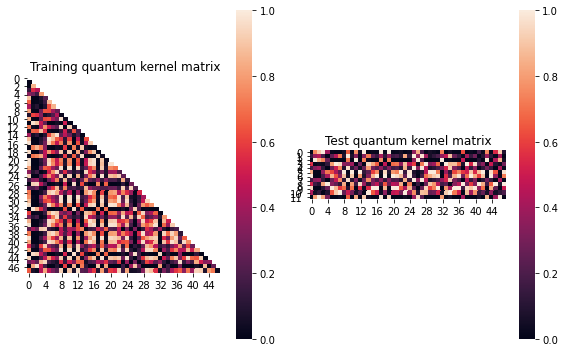


SVM with quantum kernel trained!


Test set performance:


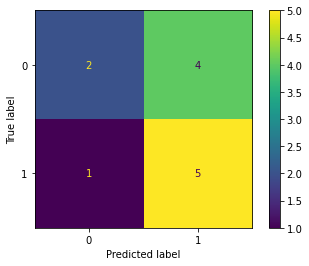

              precision    recall  f1-score   support

           0       0.67      0.33      0.44         6
           1       0.56      0.83      0.67         6

    accuracy                           0.58        12
   macro avg       0.61      0.58      0.56        12
weighted avg       0.61      0.58      0.56        12


metric 1: 0.006869846891391751
metric(s) 2: (00, 10, 11) = (0.4060577317852425, 0.4130337505270298, 0.43374946305160056)
metric 3: -2.00945491262364e-310


----> Kernel construction duration: 00:02:04


Combination 236/468
(Current range: 6/46)
			 reps : 2
			 paulis : ['XZ', 'YY']
			 entanglement : linear

Feature map:


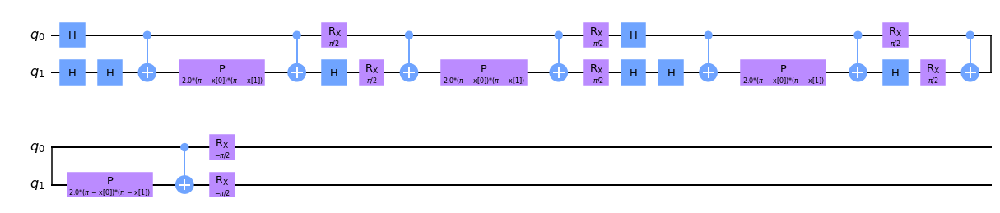


Quantum kernel matrices:



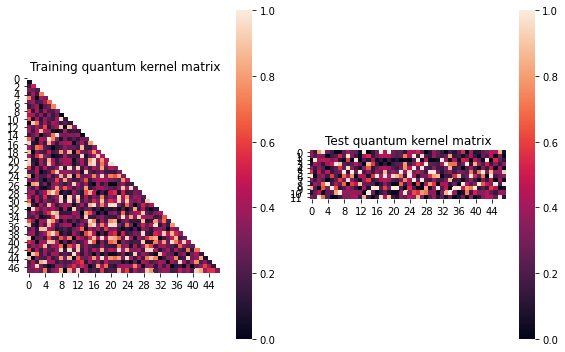


SVM with quantum kernel trained!


Test set performance:


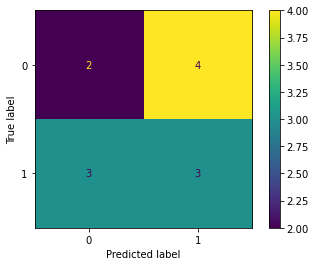

              precision    recall  f1-score   support

           0       0.40      0.33      0.36         6
           1       0.43      0.50      0.46         6

    accuracy                           0.42        12
   macro avg       0.41      0.42      0.41        12
weighted avg       0.41      0.42      0.41        12


metric 1: 0.012900001582309362
metric(s) 2: (00, 10, 11) = (0.37870770880359794, 0.37507127200568885, 0.3972348383723985)
metric 3: 0.0


----> Kernel construction duration: 00:02:15


Combination 237/468
(Current range: 7/46)
			 reps : 2
			 paulis : ['XZ', 'YZ']
			 entanglement : linear

Feature map:


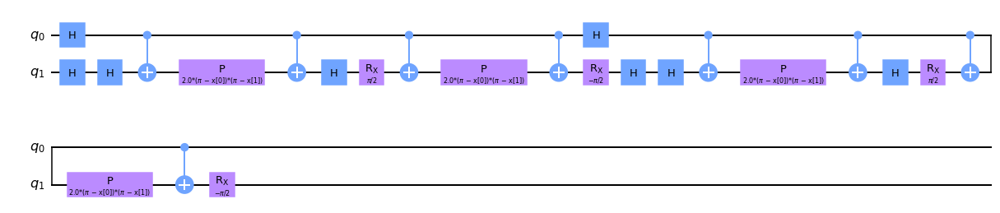


Quantum kernel matrices:



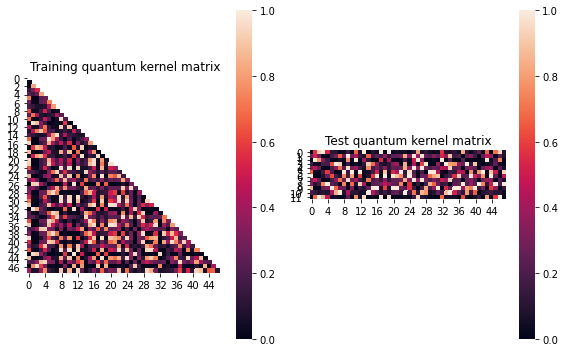


SVM with quantum kernel trained!


Test set performance:


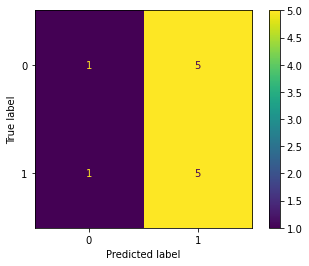

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.009409481377249618
metric(s) 2: (00, 10, 11) = (0.33846873143765144, 0.33592214234149587, 0.3521945159998396)
metric 3: 3.2801509408597e-311


----> Kernel construction duration: 00:01:53


Combination 238/468
(Current range: 8/46)
			 reps : 2
			 paulis : ['XZ', 'ZX']
			 entanglement : linear

Feature map:


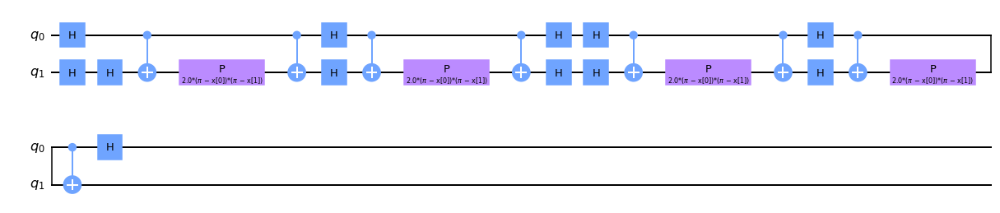


Quantum kernel matrices:



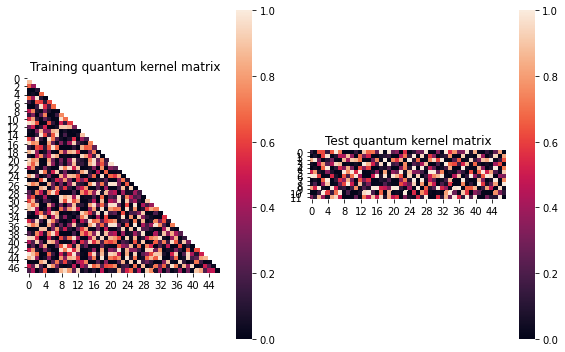


SVM with quantum kernel trained!


Test set performance:


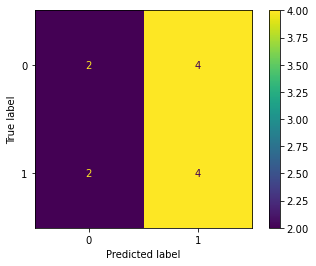

              precision    recall  f1-score   support

           0       0.50      0.33      0.40         6
           1       0.50      0.67      0.57         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.49        12
weighted avg       0.50      0.50      0.49        12


metric 1: 0.007516014510359381
metric(s) 2: (00, 10, 11) = (0.38602247404862156, 0.3780340823964001, 0.3850777197648973)
metric 3: -0.0


----> Kernel construction duration: 00:01:42


Combination 239/468
(Current range: 9/46)
			 reps : 2
			 paulis : ['XZ', 'ZY']
			 entanglement : linear

Feature map:


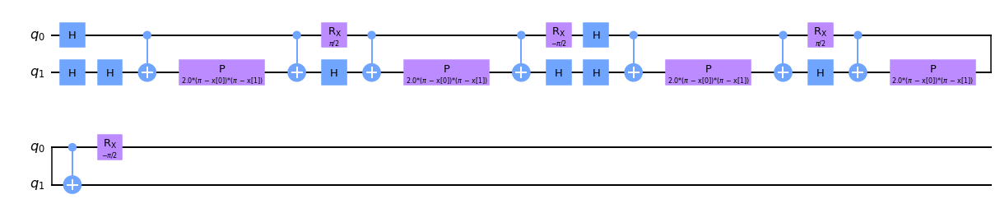


Quantum kernel matrices:



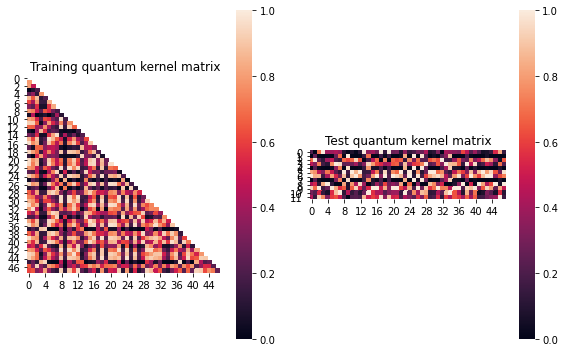


SVM with quantum kernel trained!


Test set performance:


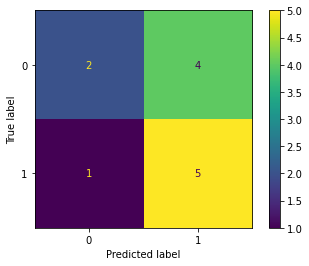

              precision    recall  f1-score   support

           0       0.67      0.33      0.44         6
           1       0.56      0.83      0.67         6

    accuracy                           0.58        12
   macro avg       0.61      0.58      0.56        12
weighted avg       0.61      0.58      0.56        12


metric 1: 0.00675210876231902
metric(s) 2: (00, 10, 11) = (0.481469087186589, 0.5010735505122229, 0.5341822313624949)
metric 3: -1.163985e-317


----> Kernel construction duration: 00:02:04


Combination 240/468
(Current range: 10/46)
			 reps : 2
			 paulis : ['XZ', 'ZZ']
			 entanglement : linear

Feature map:


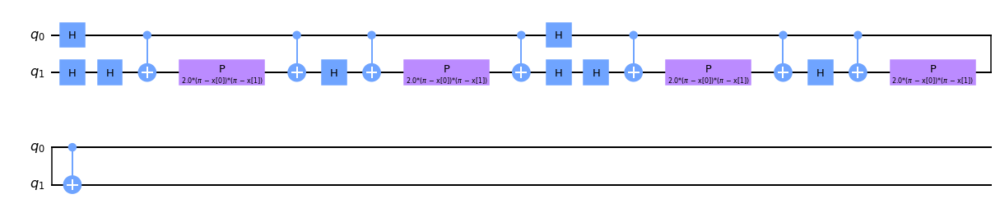


Quantum kernel matrices:



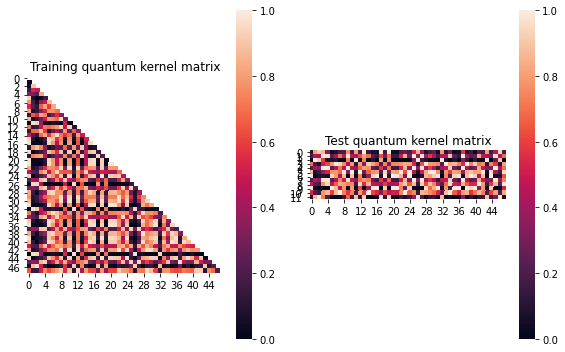


SVM with quantum kernel trained!


Test set performance:


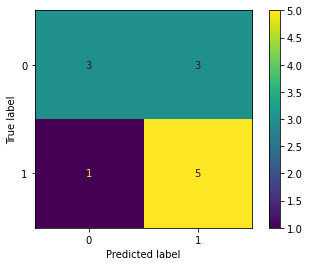

              precision    recall  f1-score   support

           0       0.75      0.50      0.60         6
           1       0.62      0.83      0.71         6

    accuracy                           0.67        12
   macro avg       0.69      0.67      0.66        12
weighted avg       0.69      0.67      0.66        12


metric 1: 0.002375817397498592
metric(s) 2: (00, 10, 11) = (0.5019203663160003, 0.511328251814386, 0.525487772107769)
metric 3: 1e-323


----> Kernel construction duration: 00:01:43


Combination 241/468
(Current range: 11/46)
			 reps : 2
			 paulis : ['YX', 'X']
			 entanglement : linear

Feature map:


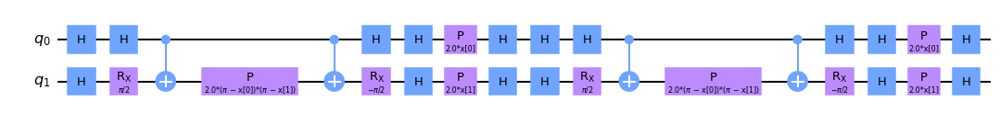


Quantum kernel matrices:



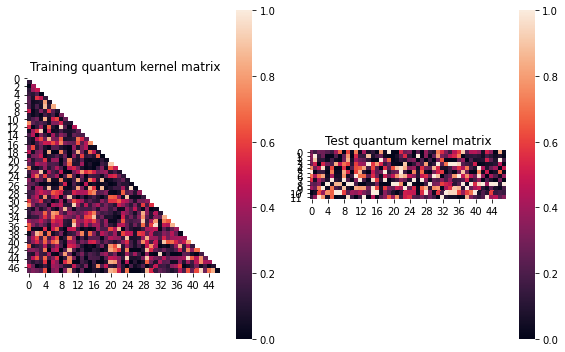


SVM with quantum kernel trained!


Test set performance:


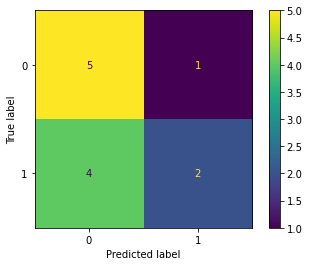

              precision    recall  f1-score   support

           0       0.56      0.83      0.67         6
           1       0.67      0.33      0.44         6

    accuracy                           0.58        12
   macro avg       0.61      0.58      0.56        12
weighted avg       0.61      0.58      0.56        12


metric 1: 0.029873262670711886
metric(s) 2: (00, 10, 11) = (0.29645741969015776, 0.28743062969558053, 0.3381503650424271)
metric 3: -5.567373972864849e-272


----> Kernel construction duration: 00:01:34


Combination 242/468
(Current range: 12/46)
			 reps : 2
			 paulis : ['YX', 'Y']
			 entanglement : linear

Feature map:


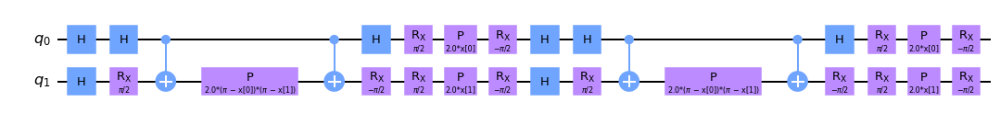


Quantum kernel matrices:



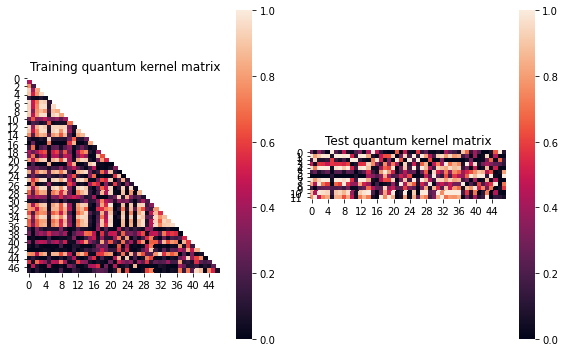


SVM with quantum kernel trained!


Test set performance:


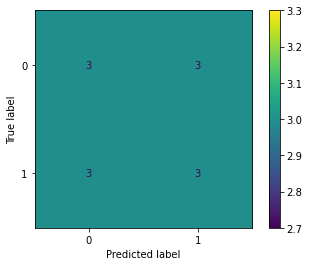

              precision    recall  f1-score   support

           0       0.50      0.50      0.50         6
           1       0.50      0.50      0.50         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.50        12
weighted avg       0.50      0.50      0.50        12


metric 1: 0.06323031534335538
metric(s) 2: (00, 10, 11) = (0.44919577154318574, 0.3499250394673423, 0.37711493807820967)
metric 3: 4.13153e-319


----> Kernel construction duration: 00:01:35


Combination 243/468
(Current range: 13/46)
			 reps : 2
			 paulis : ['YX', 'Z']
			 entanglement : linear

Feature map:


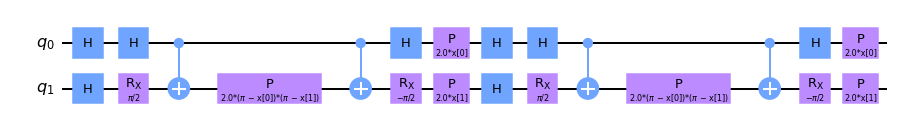


Quantum kernel matrices:



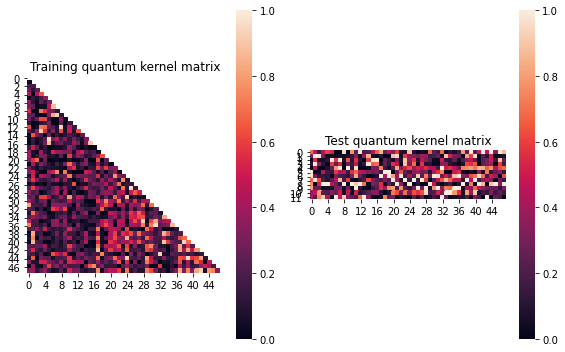


SVM with quantum kernel trained!


Test set performance:


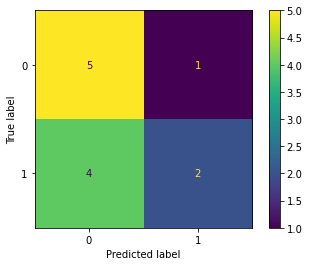

              precision    recall  f1-score   support

           0       0.56      0.83      0.67         6
           1       0.67      0.33      0.44         6

    accuracy                           0.58        12
   macro avg       0.61      0.58      0.56        12
weighted avg       0.61      0.58      0.56        12


metric 1: 0.0684413246610946
metric(s) 2: (00, 10, 11) = (0.26554603772414986, 0.24718891944709842, 0.36571445049223616)
metric 3: 9.392734568924231e-256


----> Kernel construction duration: 00:01:36


Combination 244/468
(Current range: 14/46)
			 reps : 2
			 paulis : ['YX', 'XX']
			 entanglement : linear

Feature map:


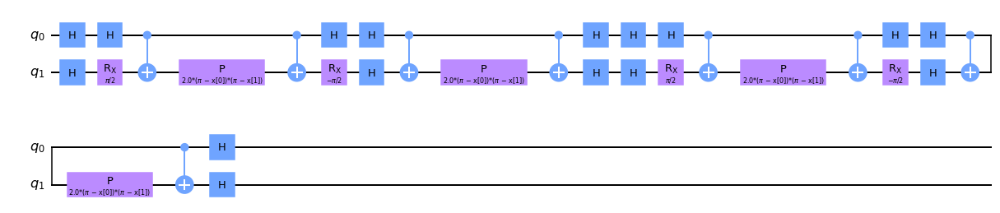


Quantum kernel matrices:



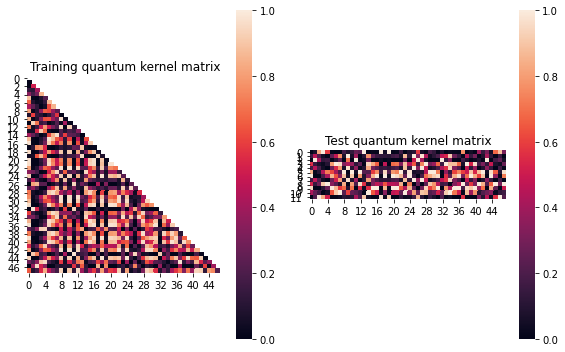


SVM with quantum kernel trained!


Test set performance:


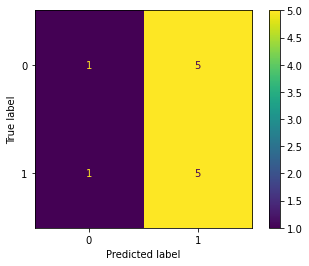

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.0063560756167350685
metric(s) 2: (00, 10, 11) = (0.3946095549722037, 0.40855081371977636, 0.4352042237008191)
metric 3: 5.14e-322


----> Kernel construction duration: 00:01:55


Combination 245/468
(Current range: 15/46)
			 reps : 2
			 paulis : ['YX', 'XY']
			 entanglement : linear

Feature map:


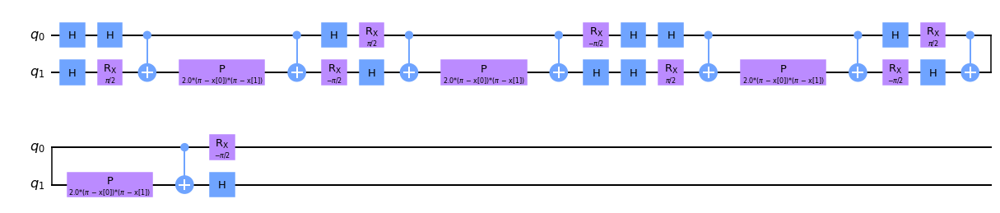


Quantum kernel matrices:



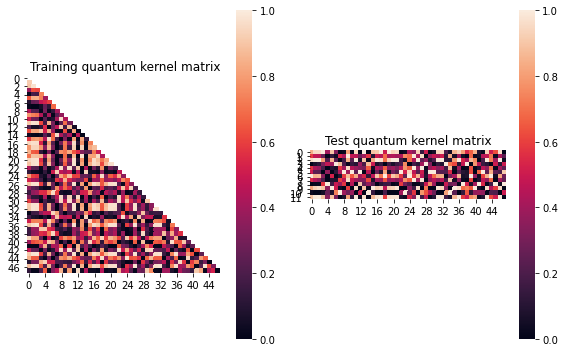


SVM with quantum kernel trained!


Test set performance:


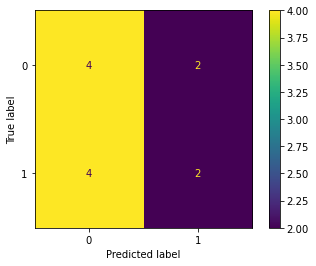

              precision    recall  f1-score   support

           0       0.50      0.67      0.57         6
           1       0.50      0.33      0.40         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.49        12
weighted avg       0.50      0.50      0.49        12


metric 1: 0.009020602650019638
metric(s) 2: (00, 10, 11) = (0.469925220802729, 0.44118769006425773, 0.4304913646258257)
metric 3: 0.0


----> Kernel construction duration: 00:02:16


Combination 246/468
(Current range: 16/46)
			 reps : 2
			 paulis : ['YX', 'XZ']
			 entanglement : linear

Feature map:


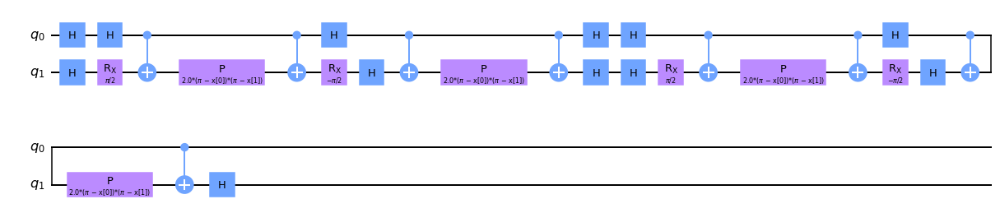


Quantum kernel matrices:



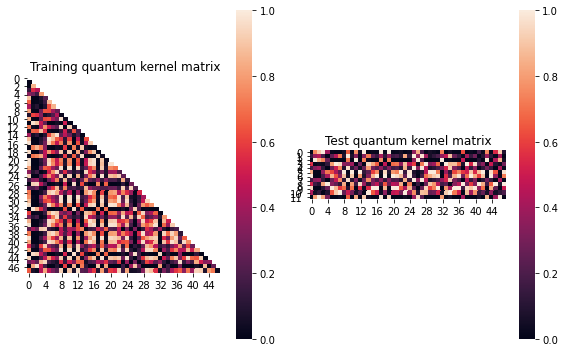


SVM with quantum kernel trained!


Test set performance:


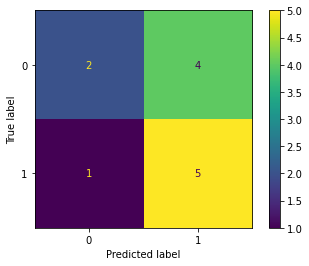

              precision    recall  f1-score   support

           0       0.67      0.33      0.44         6
           1       0.56      0.83      0.67         6

    accuracy                           0.58        12
   macro avg       0.61      0.58      0.56        12
weighted avg       0.61      0.58      0.56        12


metric 1: 0.006869846891391751
metric(s) 2: (00, 10, 11) = (0.4060577317852425, 0.4130337505270298, 0.43374946305160056)
metric 3: -2.00945491262364e-310


----> Kernel construction duration: 00:02:05


Combination 247/468
(Current range: 17/46)
			 reps : 2
			 paulis : ['YX', 'YX']
			 entanglement : linear

Feature map:


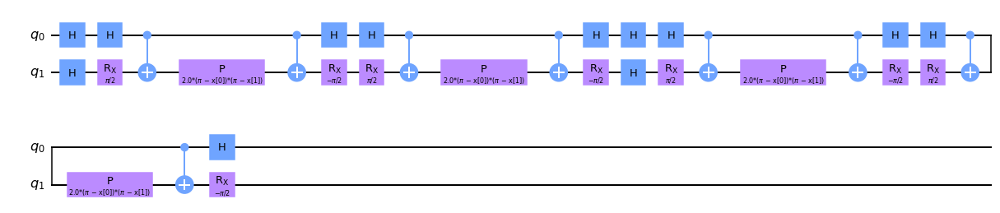


Quantum kernel matrices:



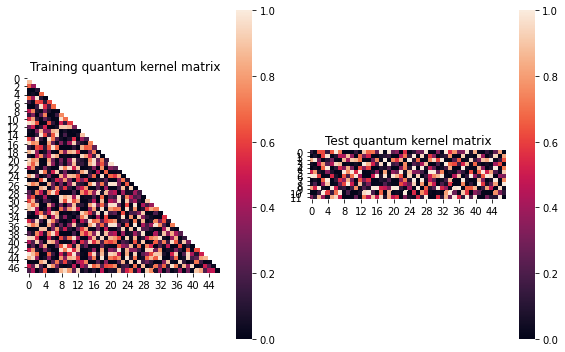


SVM with quantum kernel trained!


Test set performance:


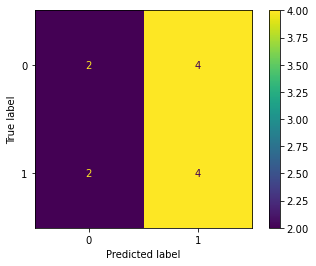

              precision    recall  f1-score   support

           0       0.50      0.33      0.40         6
           1       0.50      0.67      0.57         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.49        12
weighted avg       0.50      0.50      0.49        12


metric 1: 0.007516014510359381
metric(s) 2: (00, 10, 11) = (0.38602247404862156, 0.3780340823964001, 0.3850777197648973)
metric 3: -0.0


----> Kernel construction duration: 00:01:15


Combination 248/468
(Current range: 18/46)
			 reps : 2
			 paulis : ['YX', 'YY']
			 entanglement : linear

Feature map:


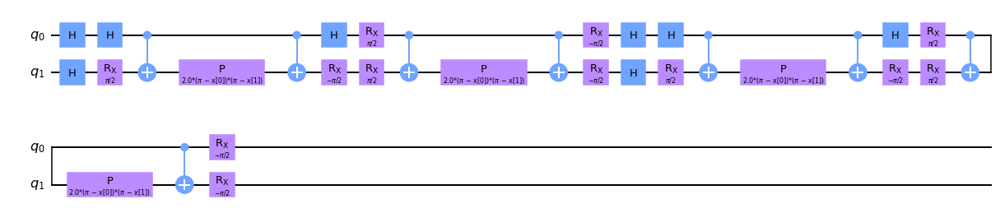


Quantum kernel matrices:



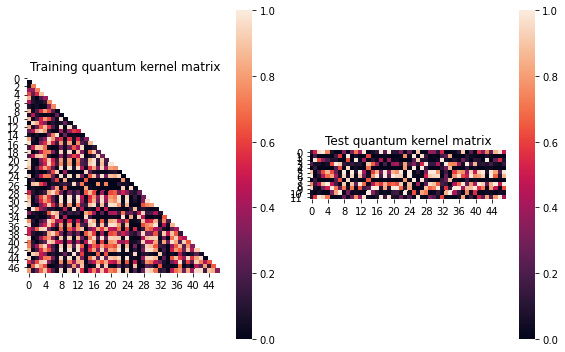


SVM with quantum kernel trained!


Test set performance:


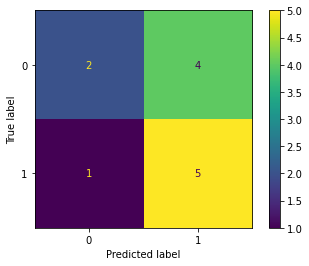

              precision    recall  f1-score   support

           0       0.67      0.33      0.44         6
           1       0.56      0.83      0.67         6

    accuracy                           0.58        12
   macro avg       0.61      0.58      0.56        12
weighted avg       0.61      0.58      0.56        12


metric 1: 0.004671137844378337
metric(s) 2: (00, 10, 11) = (0.40104697931024585, 0.40282945424308336, 0.41395420486467754)
metric 3: -0.0


----> Kernel construction duration: 00:01:59


Combination 249/468
(Current range: 19/46)
			 reps : 2
			 paulis : ['YX', 'YZ']
			 entanglement : linear

Feature map:


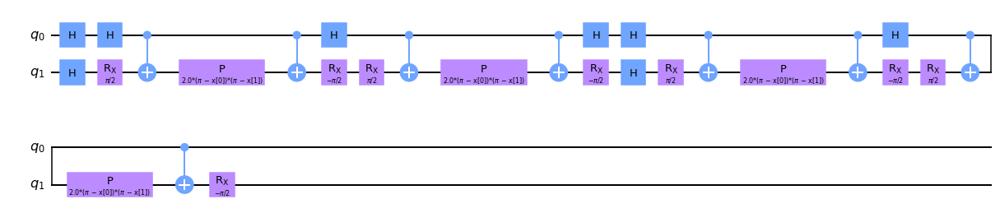


Quantum kernel matrices:



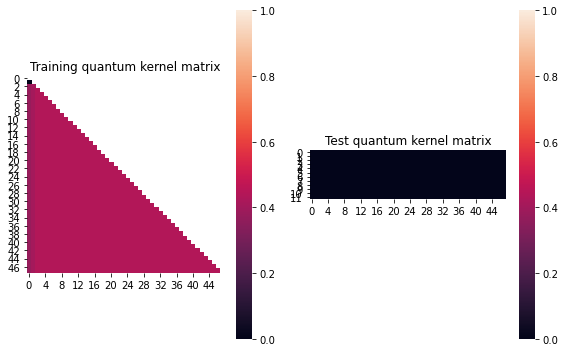


SVM with quantum kernel trained!


Test set performance:


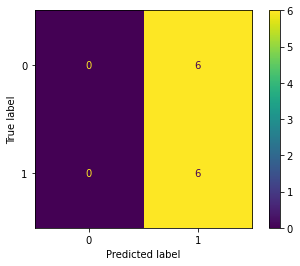

              precision    recall  f1-score   support

           0       0.00      0.00      0.00         6
           1       0.50      1.00      0.67         6

    accuracy                           0.50        12
   macro avg       0.25      0.50      0.33        12
weighted avg       0.25      0.50      0.33        12


metric 1: 0.00472005208333337
metric(s) 2: (00, 10, 11) = (0.4391276041666667, 0.43359375, 0.4375)
metric 3: 0.0


----> Kernel construction duration: 00:01:48


Combination 250/468
(Current range: 20/46)
			 reps : 2
			 paulis : ['YX', 'ZX']
			 entanglement : linear

Feature map:


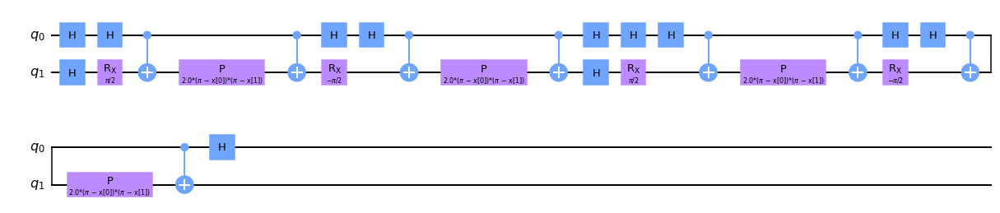


Quantum kernel matrices:



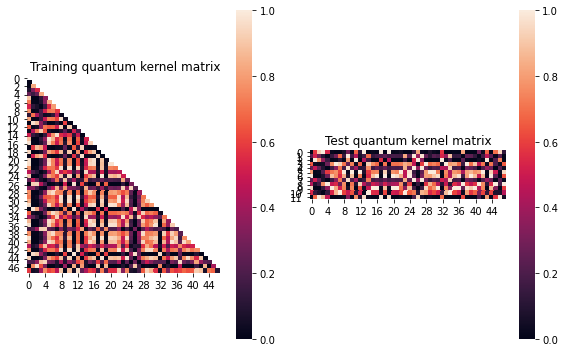


SVM with quantum kernel trained!


Test set performance:


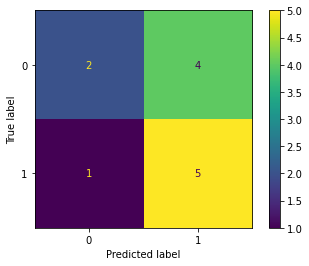

              precision    recall  f1-score   support

           0       0.67      0.33      0.44         6
           1       0.56      0.83      0.67         6

    accuracy                           0.58        12
   macro avg       0.61      0.58      0.56        12
weighted avg       0.61      0.58      0.56        12


metric 1: 0.007121518253098091
metric(s) 2: (00, 10, 11) = (0.4186797335205236, 0.4331073227093056, 0.46177794840428377)
metric 3: 1e-323


----> Kernel construction duration: 00:01:54


Combination 251/468
(Current range: 21/46)
			 reps : 2
			 paulis : ['YX', 'ZY']
			 entanglement : linear

Feature map:


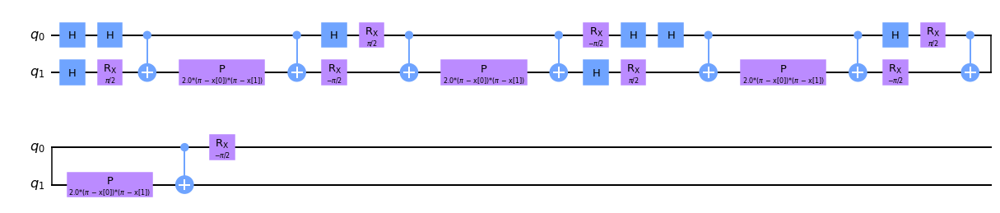


Quantum kernel matrices:



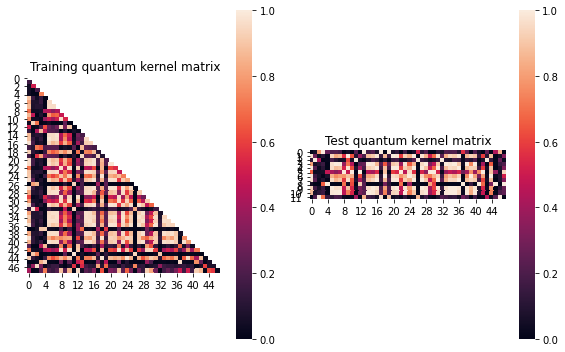


SVM with quantum kernel trained!


Test set performance:


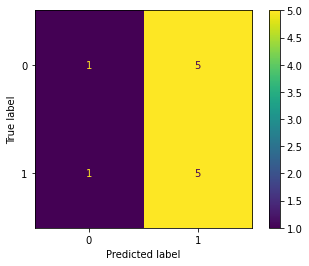

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.008096011748282339
metric(s) 2: (00, 10, 11) = (0.43659318978633344, 0.4369935819554691, 0.4535859976211695)
metric 3: 0.0


----> Kernel construction duration: 00:02:15


Combination 252/468
(Current range: 22/46)
			 reps : 2
			 paulis : ['YX', 'ZZ']
			 entanglement : linear

Feature map:


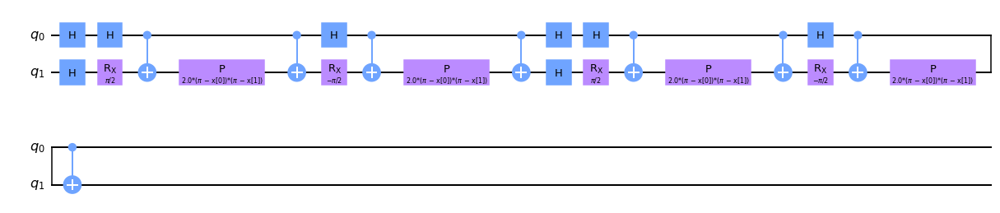


Quantum kernel matrices:



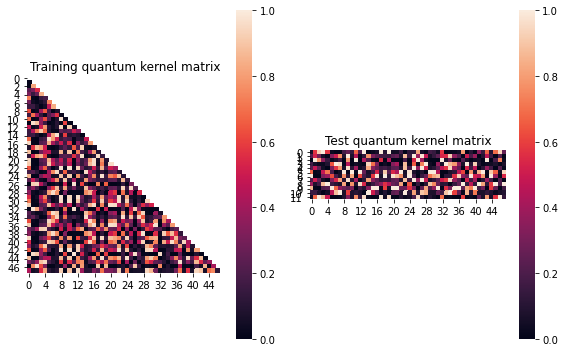


SVM with quantum kernel trained!


Test set performance:


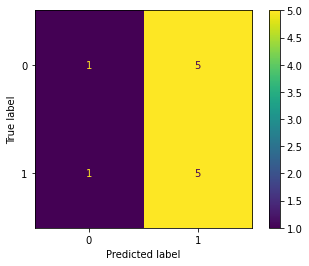

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.006236963971032516
metric(s) 2: (00, 10, 11) = (0.35185532795978236, 0.3479125952461691, 0.3564437904746208)
metric 3: 1e-323


----> Kernel construction duration: 00:02:05


Combination 253/468
(Current range: 23/46)
			 reps : 2
			 paulis : ['YY', 'X']
			 entanglement : linear

Feature map:


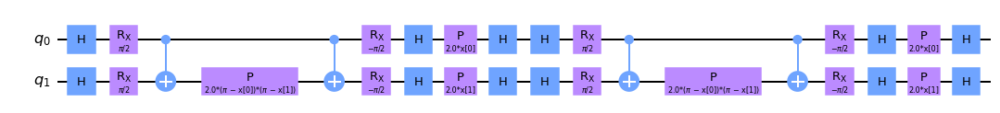


Quantum kernel matrices:



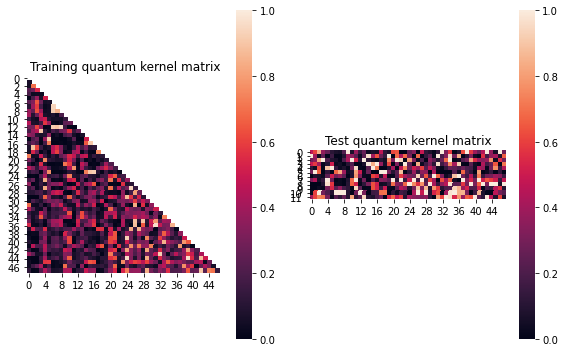


SVM with quantum kernel trained!


Test set performance:


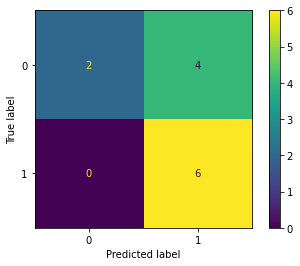

              precision    recall  f1-score   support

           0       1.00      0.33      0.50         6
           1       0.60      1.00      0.75         6

    accuracy                           0.67        12
   macro avg       0.80      0.67      0.62        12
weighted avg       0.80      0.67      0.62        12


metric 1: 0.10760515815385671
metric(s) 2: (00, 10, 11) = (0.2645075816194985, 0.21138476897052186, 0.3734722726292586)
metric 3: 3.104179683977307e-272


----> Kernel construction duration: 00:01:50


Combination 254/468
(Current range: 24/46)
			 reps : 2
			 paulis : ['YY', 'Y']
			 entanglement : linear

Feature map:


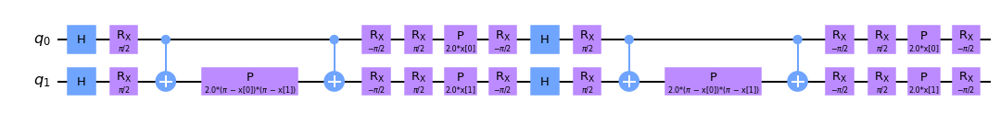


Quantum kernel matrices:



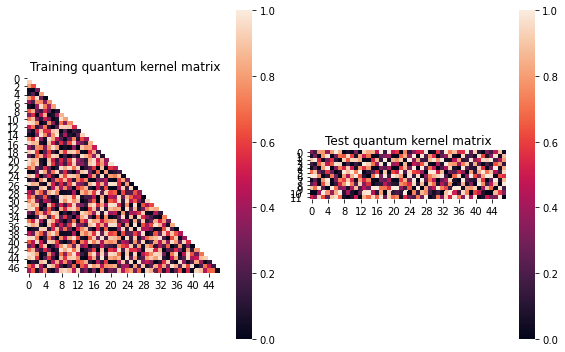


SVM with quantum kernel trained!


Test set performance:


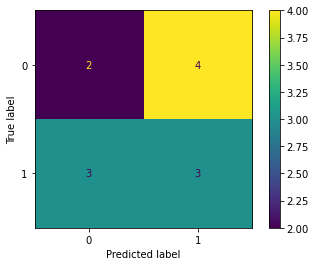

              precision    recall  f1-score   support

           0       0.40      0.33      0.36         6
           1       0.43      0.50      0.46         6

    accuracy                           0.42        12
   macro avg       0.41      0.42      0.41        12
weighted avg       0.41      0.42      0.41        12


metric 1: 0.005189231185427912
metric(s) 2: (00, 10, 11) = (0.49936335961957806, 0.494900756823733, 0.5008166163987438)
metric 3: 0.0


----> Kernel construction duration: 00:01:44


Combination 255/468
(Current range: 25/46)
			 reps : 2
			 paulis : ['YY', 'Z']
			 entanglement : linear

Feature map:


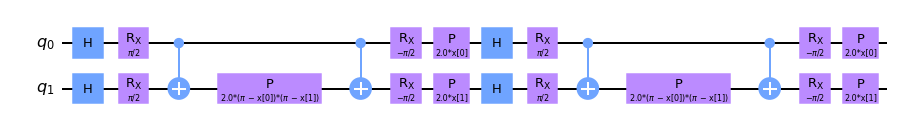


Quantum kernel matrices:



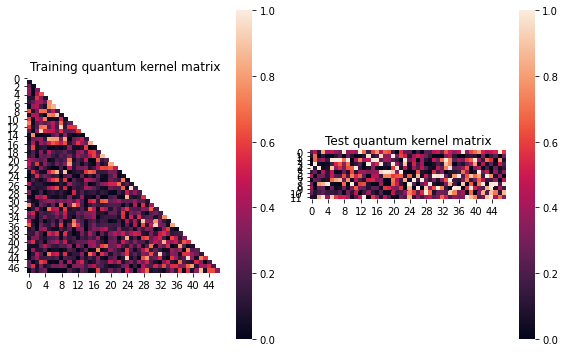


SVM with quantum kernel trained!


Test set performance:


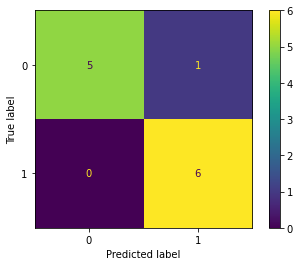

              precision    recall  f1-score   support

           0       1.00      0.83      0.91         6
           1       0.86      1.00      0.92         6

    accuracy                           0.92        12
   macro avg       0.93      0.92      0.92        12
weighted avg       0.93      0.92      0.92        12


metric 1: 0.12080695921444679
metric(s) 2: (00, 10, 11) = (0.3294212904956607, 0.21328240622564265, 0.33875744038451816)
metric 3: 2.6179782120584483e-256


----> Kernel construction duration: 00:01:49


Combination 256/468
(Current range: 26/46)
			 reps : 2
			 paulis : ['YY', 'XX']
			 entanglement : linear

Feature map:


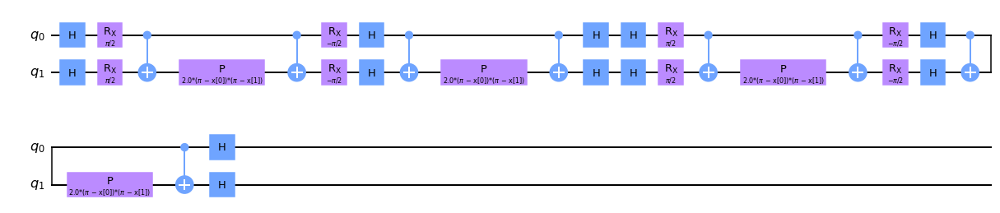


Quantum kernel matrices:



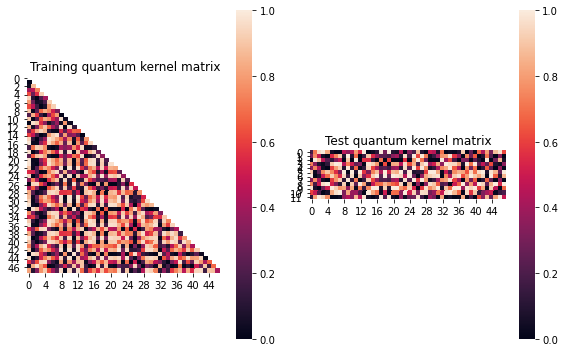


SVM with quantum kernel trained!


Test set performance:


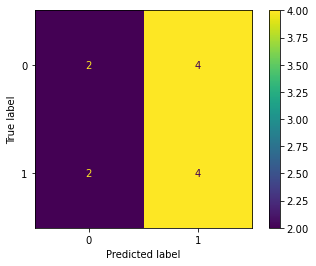

              precision    recall  f1-score   support

           0       0.50      0.33      0.40         6
           1       0.50      0.67      0.57         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.49        12
weighted avg       0.50      0.50      0.49        12


metric 1: 0.0030024471480464276
metric(s) 2: (00, 10, 11) = (0.5194729525883561, 0.5274296115848754, 0.5413911648774875)
metric 3: 0.0


----> Kernel construction duration: 00:02:27


Combination 257/468
(Current range: 27/46)
			 reps : 2
			 paulis : ['YY', 'XY']
			 entanglement : linear

Feature map:


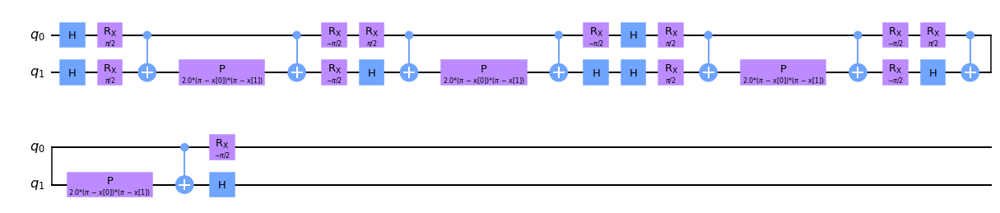


Quantum kernel matrices:



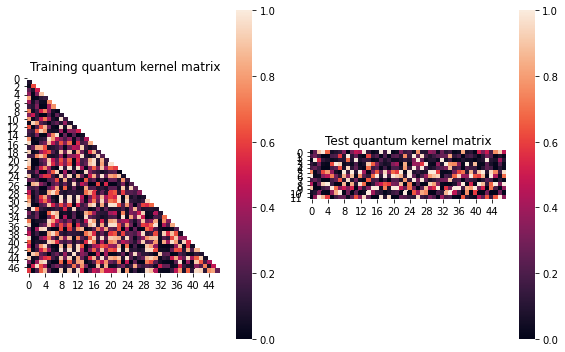


SVM with quantum kernel trained!


Test set performance:


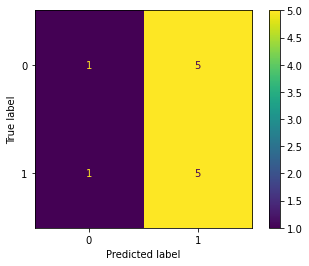

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.0027629655853622648
metric(s) 2: (00, 10, 11) = (0.37792232508977036, 0.37638113651065896, 0.38036587910227204)
metric 3: -2.504280309701943e-309


----> Kernel construction duration: 00:02:10


Combination 258/468
(Current range: 28/46)
			 reps : 2
			 paulis : ['YY', 'XZ']
			 entanglement : linear

Feature map:


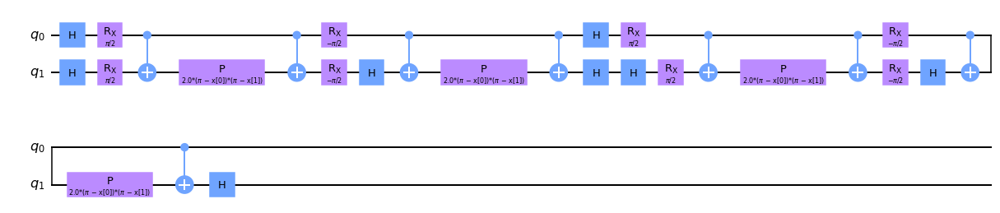


Quantum kernel matrices:



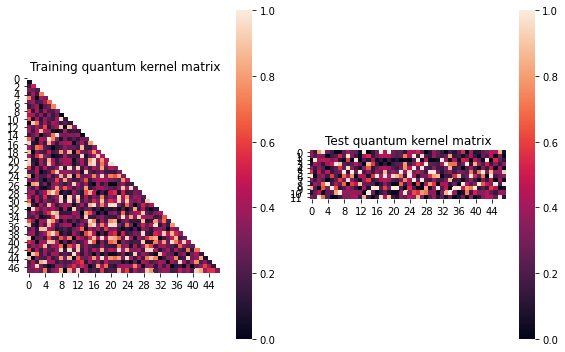


SVM with quantum kernel trained!


Test set performance:


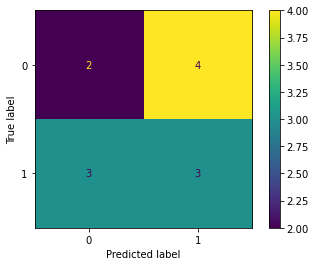

              precision    recall  f1-score   support

           0       0.40      0.33      0.36         6
           1       0.43      0.50      0.46         6

    accuracy                           0.42        12
   macro avg       0.41      0.42      0.41        12
weighted avg       0.41      0.42      0.41        12


metric 1: 0.012900001582309362
metric(s) 2: (00, 10, 11) = (0.37870770880359794, 0.37507127200568885, 0.3972348383723985)
metric 3: 0.0


----> Kernel construction duration: 00:02:26


Combination 259/468
(Current range: 29/46)
			 reps : 2
			 paulis : ['YY', 'YX']
			 entanglement : linear

Feature map:


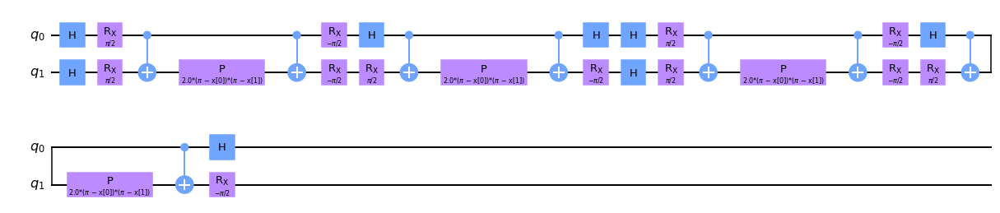


Quantum kernel matrices:



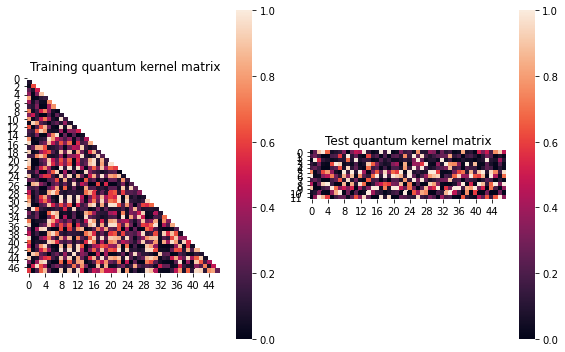


SVM with quantum kernel trained!


Test set performance:


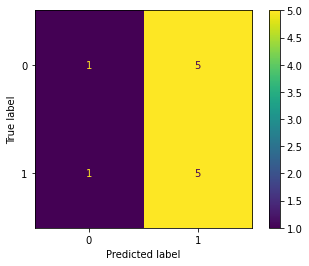

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.0027629655853622648
metric(s) 2: (00, 10, 11) = (0.37792232508977036, 0.37638113651065896, 0.38036587910227204)
metric 3: -2.504280309701943e-309


----> Kernel construction duration: 00:02:10


Combination 260/468
(Current range: 30/46)
			 reps : 2
			 paulis : ['YY', 'YY']
			 entanglement : linear

Feature map:


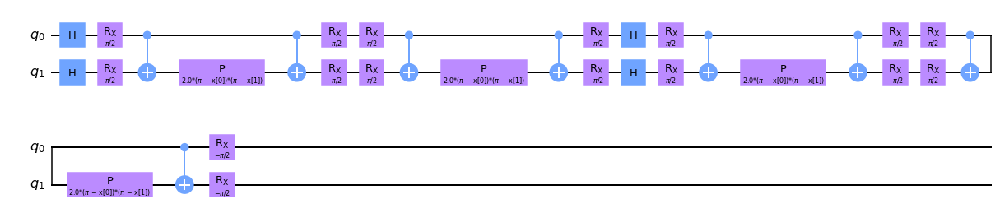


Quantum kernel matrices:



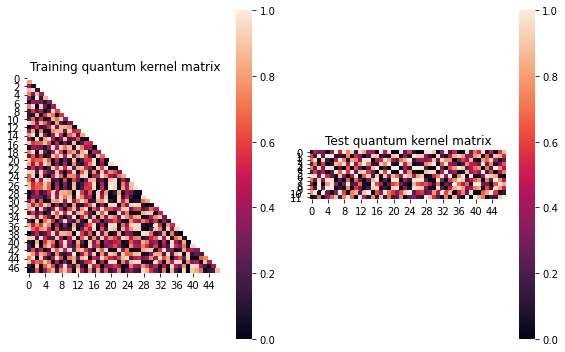


SVM with quantum kernel trained!


Test set performance:


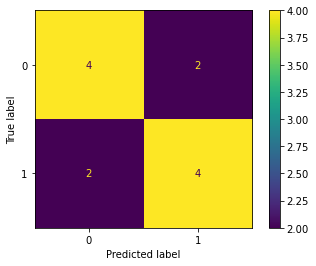

              precision    recall  f1-score   support

           0       0.67      0.67      0.67         6
           1       0.67      0.67      0.67         6

    accuracy                           0.67        12
   macro avg       0.67      0.67      0.67        12
weighted avg       0.67      0.67      0.67        12


metric 1: 0.01063283700640516
metric(s) 2: (00, 10, 11) = (0.4988356390857766, 0.48376151343988855, 0.4899530618068108)
metric 3: 0.0


----> Kernel construction duration: 00:01:29


Combination 261/468
(Current range: 31/46)
			 reps : 2
			 paulis : ['YY', 'YZ']
			 entanglement : linear

Feature map:


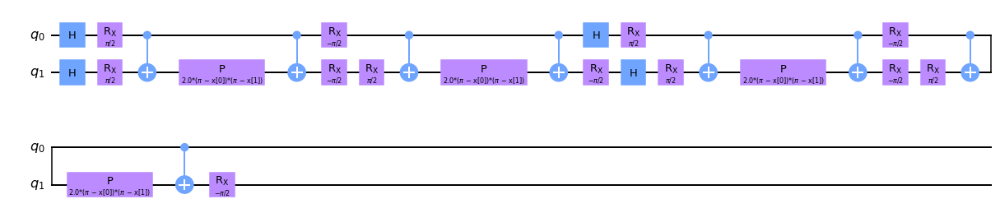


Quantum kernel matrices:



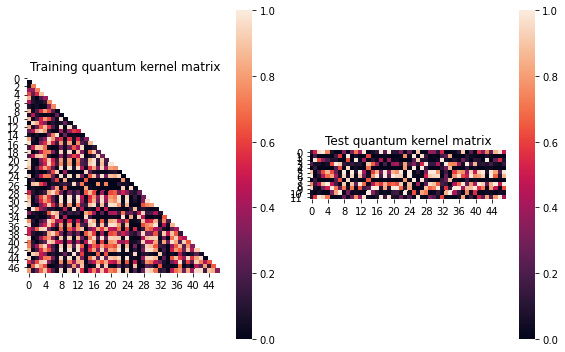


SVM with quantum kernel trained!


Test set performance:


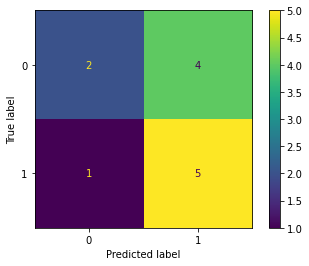

              precision    recall  f1-score   support

           0       0.67      0.33      0.44         6
           1       0.56      0.83      0.67         6

    accuracy                           0.58        12
   macro avg       0.61      0.58      0.56        12
weighted avg       0.61      0.58      0.56        12


metric 1: 0.004671137844378337
metric(s) 2: (00, 10, 11) = (0.40104697931024585, 0.40282945424308336, 0.41395420486467754)
metric 3: -0.0


----> Kernel construction duration: 00:02:09


Combination 262/468
(Current range: 32/46)
			 reps : 2
			 paulis : ['YY', 'ZX']
			 entanglement : linear

Feature map:


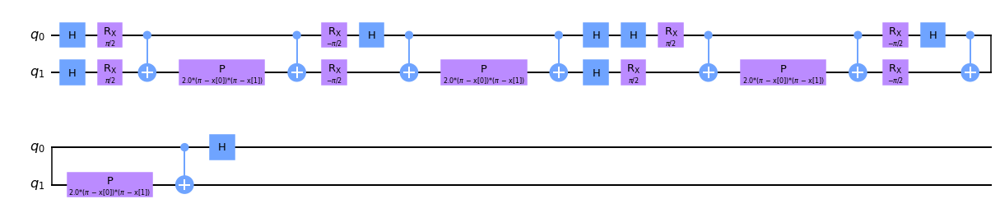


Quantum kernel matrices:



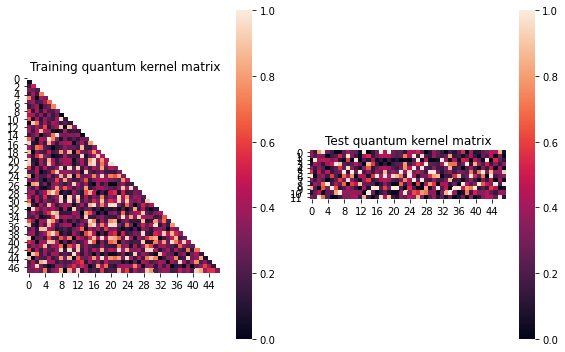


SVM with quantum kernel trained!


Test set performance:


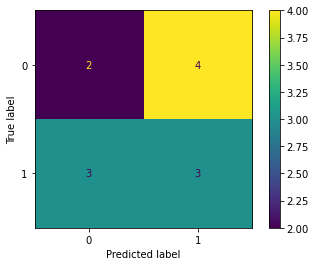

              precision    recall  f1-score   support

           0       0.40      0.33      0.36         6
           1       0.43      0.50      0.46         6

    accuracy                           0.42        12
   macro avg       0.41      0.42      0.41        12
weighted avg       0.41      0.42      0.41        12


metric 1: 0.012900001582309362
metric(s) 2: (00, 10, 11) = (0.37870770880359794, 0.37507127200568885, 0.3972348383723985)
metric 3: 0.0


----> Kernel construction duration: 00:02:27


Combination 263/468
(Current range: 33/46)
			 reps : 2
			 paulis : ['YY', 'ZY']
			 entanglement : linear

Feature map:


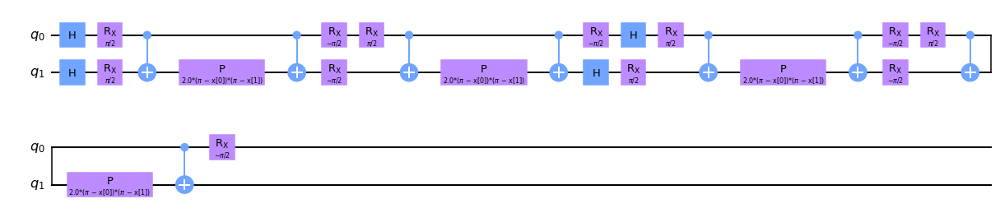


Quantum kernel matrices:



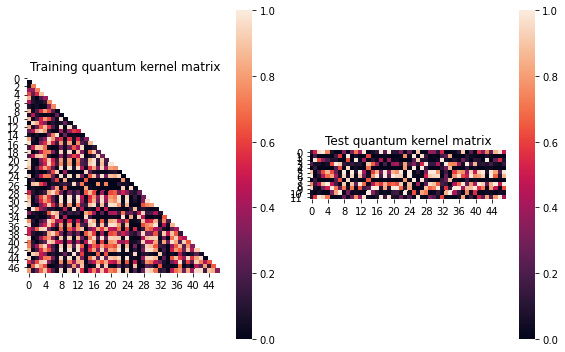


SVM with quantum kernel trained!


Test set performance:


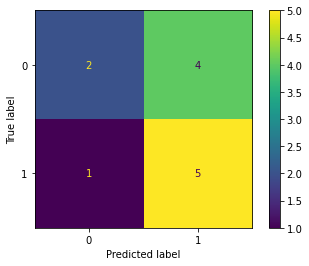

              precision    recall  f1-score   support

           0       0.67      0.33      0.44         6
           1       0.56      0.83      0.67         6

    accuracy                           0.58        12
   macro avg       0.61      0.58      0.56        12
weighted avg       0.61      0.58      0.56        12


metric 1: 0.004671137844378337
metric(s) 2: (00, 10, 11) = (0.40104697931024585, 0.40282945424308336, 0.41395420486467754)
metric 3: -0.0


----> Kernel construction duration: 00:02:10


Combination 264/468
(Current range: 34/46)
			 reps : 2
			 paulis : ['YY', 'ZZ']
			 entanglement : linear

Feature map:


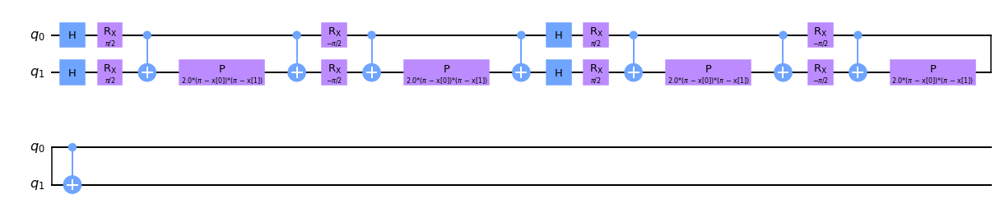


Quantum kernel matrices:



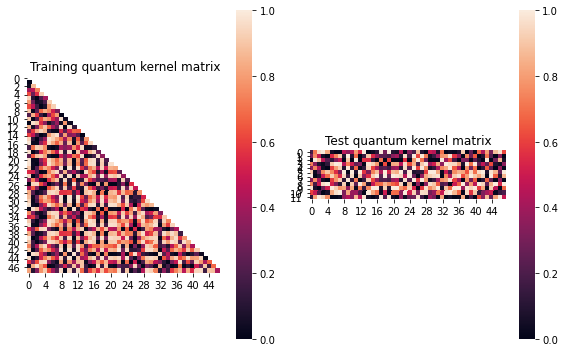


SVM with quantum kernel trained!


Test set performance:


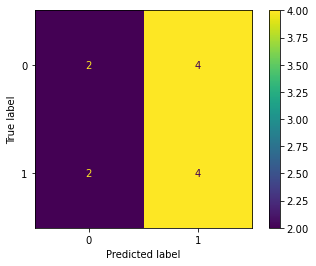

              precision    recall  f1-score   support

           0       0.50      0.33      0.40         6
           1       0.50      0.67      0.57         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.49        12
weighted avg       0.50      0.50      0.49        12


metric 1: 0.0030024471480464276
metric(s) 2: (00, 10, 11) = (0.5194729525883561, 0.5274296115848754, 0.5413911648774875)
metric 3: 0.0


----> Kernel construction duration: 00:02:26


Combination 265/468
(Current range: 35/46)
			 reps : 2
			 paulis : ['YZ', 'X']
			 entanglement : linear

Feature map:


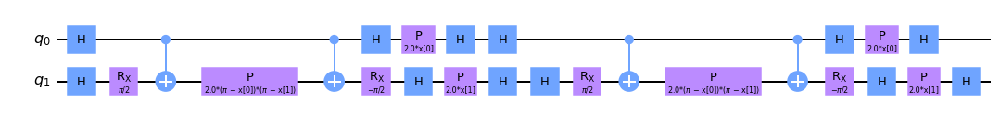


Quantum kernel matrices:



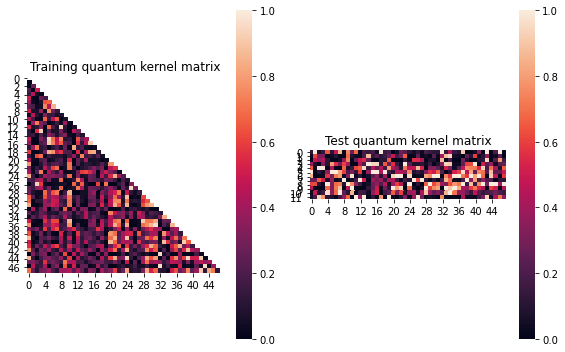


SVM with quantum kernel trained!


Test set performance:


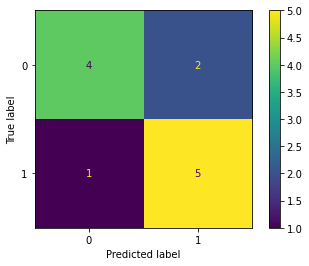

              precision    recall  f1-score   support

           0       0.80      0.67      0.73         6
           1       0.71      0.83      0.77         6

    accuracy                           0.75        12
   macro avg       0.76      0.75      0.75        12
weighted avg       0.76      0.75      0.75        12


metric 1: 0.059678249006017425
metric(s) 2: (00, 10, 11) = (0.28388019821080196, 0.262403683235604, 0.3602836662724408)
metric 3: -1.5555292003149564e-257


----> Kernel construction duration: 00:01:47


Combination 266/468
(Current range: 36/46)
			 reps : 2
			 paulis : ['YZ', 'Y']
			 entanglement : linear

Feature map:


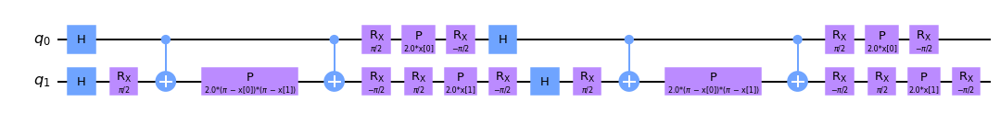


Quantum kernel matrices:



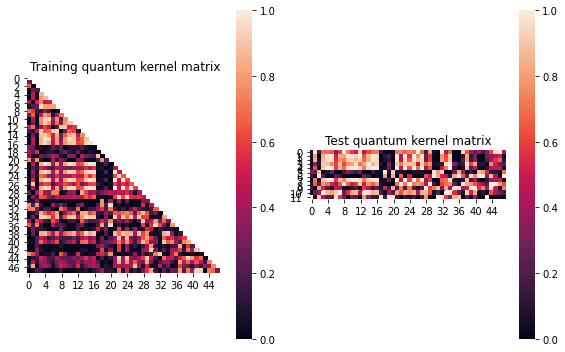


SVM with quantum kernel trained!


Test set performance:


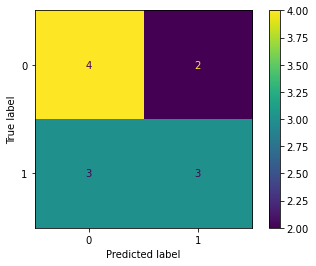

              precision    recall  f1-score   support

           0       0.57      0.67      0.62         6
           1       0.60      0.50      0.55         6

    accuracy                           0.58        12
   macro avg       0.59      0.58      0.58        12
weighted avg       0.59      0.58      0.58        12


metric 1: 0.0975152541931924
metric(s) 2: (00, 10, 11) = (0.44113792140362157, 0.32653498206569653, 0.4069625511141563)
metric 3: -4.3076e-319


----> Kernel construction duration: 00:01:47


Combination 267/468
(Current range: 37/46)
			 reps : 2
			 paulis : ['YZ', 'Z']
			 entanglement : linear

Feature map:


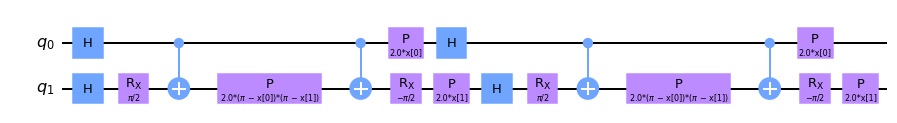


Quantum kernel matrices:



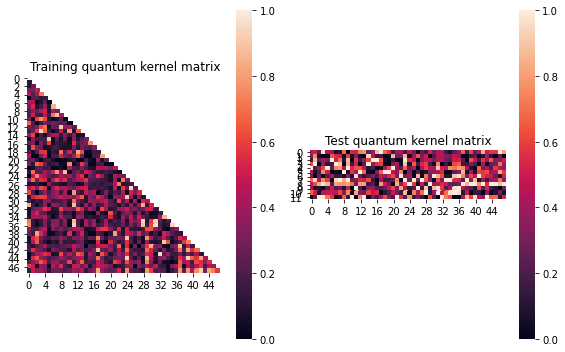


SVM with quantum kernel trained!


Test set performance:


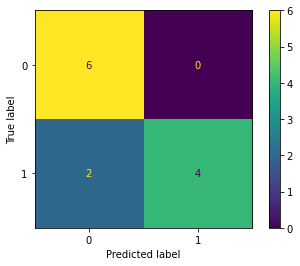

              precision    recall  f1-score   support

           0       0.75      1.00      0.86         6
           1       1.00      0.67      0.80         6

    accuracy                           0.83        12
   macro avg       0.88      0.83      0.83        12
weighted avg       0.88      0.83      0.83        12


metric 1: 0.0434406517188442
metric(s) 2: (00, 10, 11) = (0.29359226164592944, 0.28777521681321233, 0.3688394754181836)
metric 3: 2.572872568751208e-255


----> Kernel construction duration: 00:01:47


Combination 268/468
(Current range: 38/46)
			 reps : 2
			 paulis : ['YZ', 'XX']
			 entanglement : linear

Feature map:


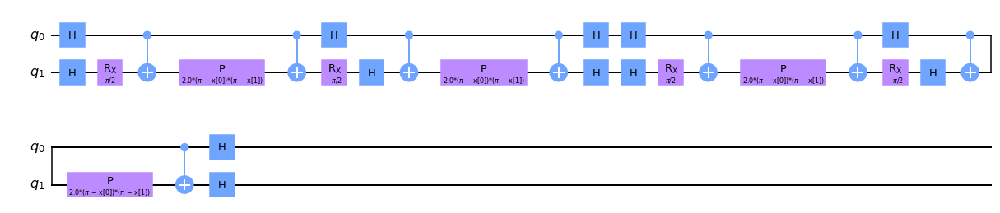


Quantum kernel matrices:



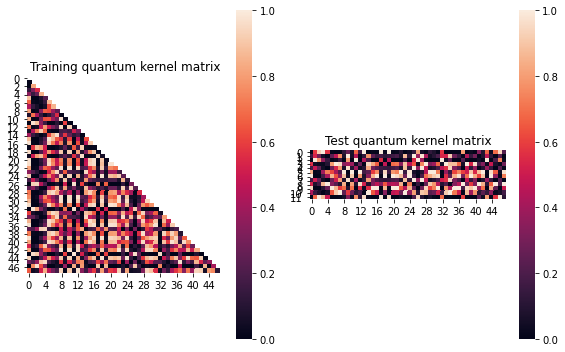


SVM with quantum kernel trained!


Test set performance:


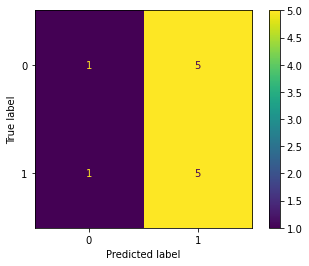

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.0059279350487767
metric(s) 2: (00, 10, 11) = (0.4041057739631215, 0.41303442475791446, 0.4338189456502609)
metric 3: 0.0


----> Kernel construction duration: 00:02:17


Combination 269/468
(Current range: 39/46)
			 reps : 2
			 paulis : ['YZ', 'XY']
			 entanglement : linear

Feature map:


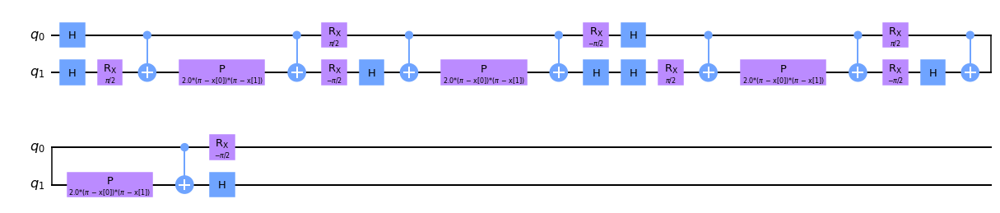


Quantum kernel matrices:



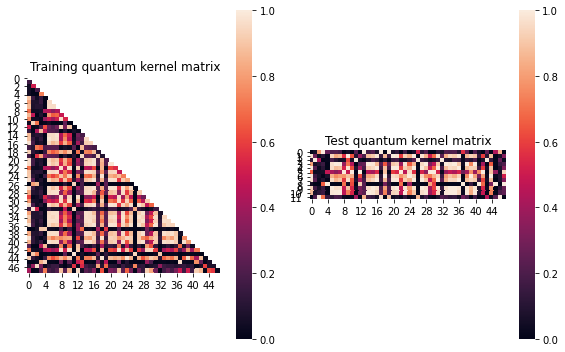


SVM with quantum kernel trained!


Test set performance:


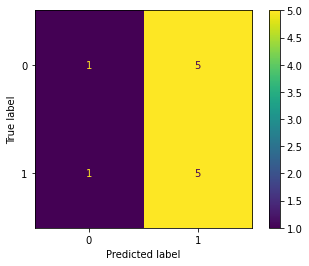

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.008096011748282339
metric(s) 2: (00, 10, 11) = (0.43659318978633344, 0.4369935819554691, 0.4535859976211695)
metric 3: 0.0


----> Kernel construction duration: 00:02:29


Combination 270/468
(Current range: 40/46)
			 reps : 2
			 paulis : ['YZ', 'XZ']
			 entanglement : linear

Feature map:


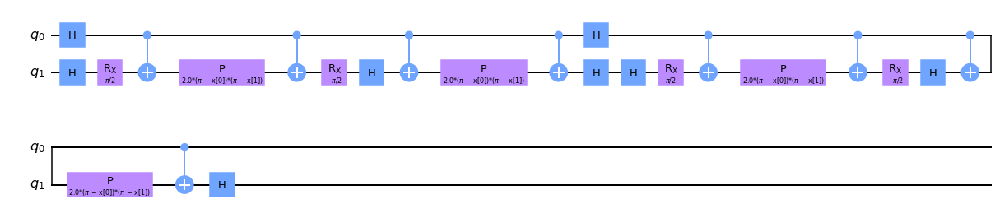


Quantum kernel matrices:



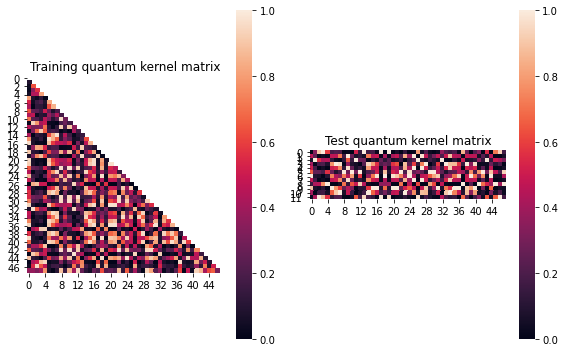


SVM with quantum kernel trained!


Test set performance:


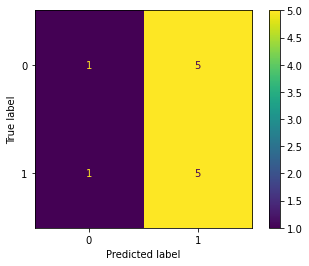

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.007716855024019864
metric(s) 2: (00, 10, 11) = (0.37539210835364006, 0.37688277537438364, 0.393807152443167)
metric 3: 1.126e-321


----> Kernel construction duration: 00:02:06


Combination 271/468
(Current range: 41/46)
			 reps : 2
			 paulis : ['YZ', 'YX']
			 entanglement : linear

Feature map:


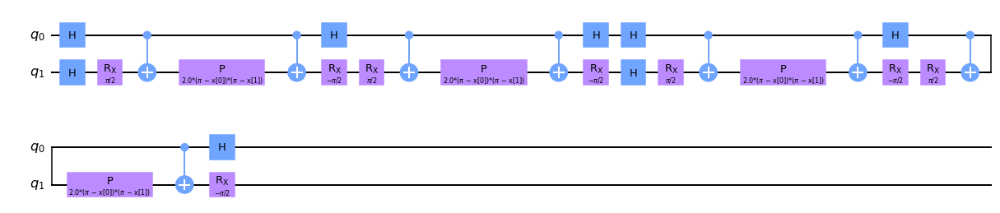


Quantum kernel matrices:



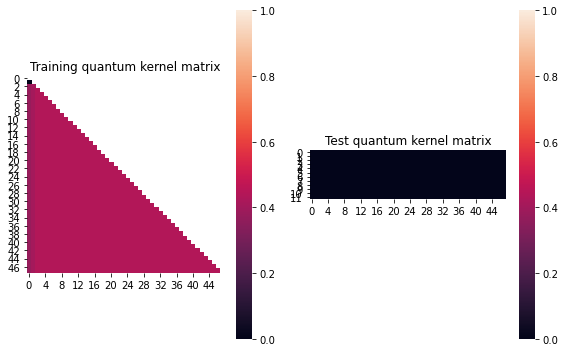


SVM with quantum kernel trained!


Test set performance:


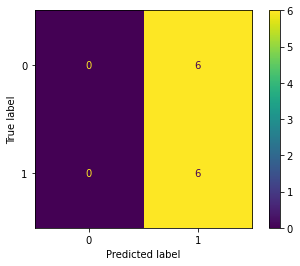

              precision    recall  f1-score   support

           0       0.00      0.00      0.00         6
           1       0.50      1.00      0.67         6

    accuracy                           0.50        12
   macro avg       0.25      0.50      0.33        12
weighted avg       0.25      0.50      0.33        12


metric 1: 0.00472005208333337
metric(s) 2: (00, 10, 11) = (0.4391276041666667, 0.43359375, 0.4375)
metric 3: 0.0


----> Kernel construction duration: 00:02:01


Combination 272/468
(Current range: 42/46)
			 reps : 2
			 paulis : ['YZ', 'YY']
			 entanglement : linear

Feature map:


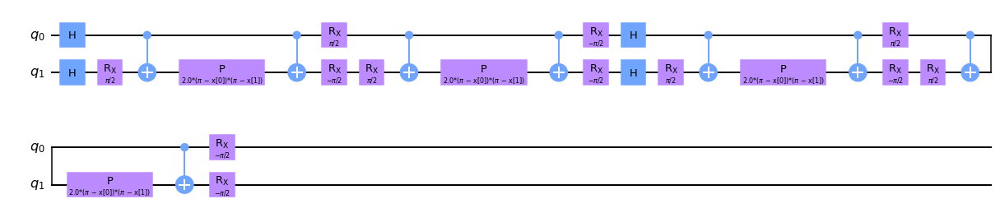


Quantum kernel matrices:



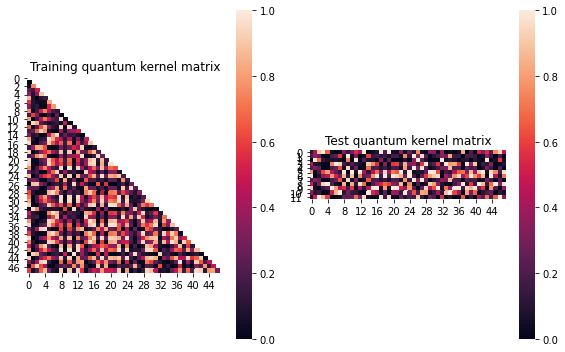


SVM with quantum kernel trained!


Test set performance:


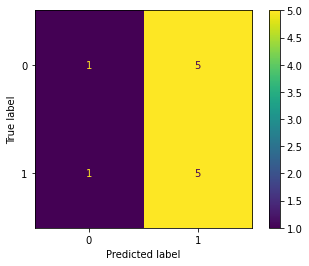

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.004891088969446122
metric(s) 2: (00, 10, 11) = (0.39488346498960936, 0.39527564032928253, 0.4054499936078479)
metric 3: 9.85581492386e-312


----> Kernel construction duration: 00:02:11


Combination 273/468
(Current range: 43/46)
			 reps : 2
			 paulis : ['YZ', 'YZ']
			 entanglement : linear

Feature map:


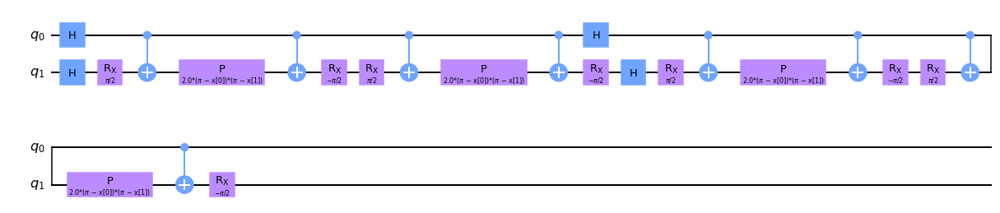


Quantum kernel matrices:



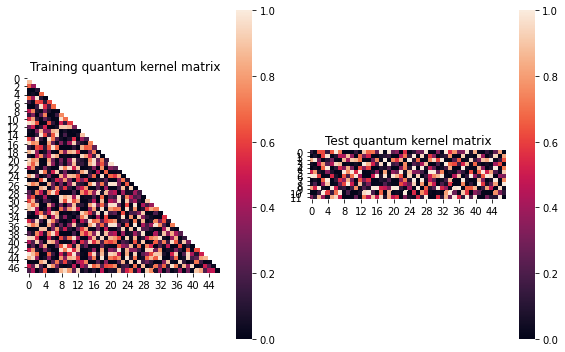


SVM with quantum kernel trained!


Test set performance:


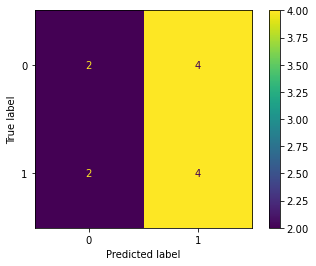

              precision    recall  f1-score   support

           0       0.50      0.33      0.40         6
           1       0.50      0.67      0.57         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.49        12
weighted avg       0.50      0.50      0.49        12


metric 1: 0.007516014510359381
metric(s) 2: (00, 10, 11) = (0.38602247404862156, 0.3780340823964001, 0.3850777197648973)
metric 3: -0.0


----> Kernel construction duration: 00:01:26


Combination 274/468
(Current range: 44/46)
			 reps : 2
			 paulis : ['YZ', 'ZX']
			 entanglement : linear

Feature map:


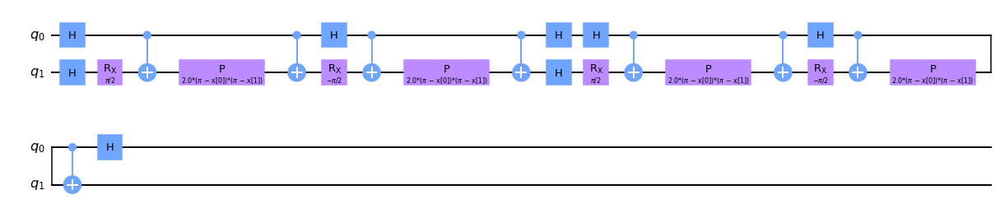


Quantum kernel matrices:



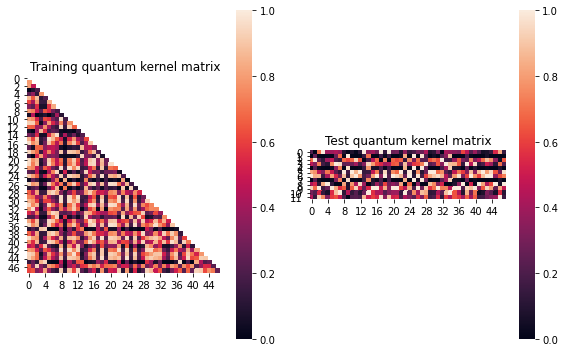


SVM with quantum kernel trained!


Test set performance:


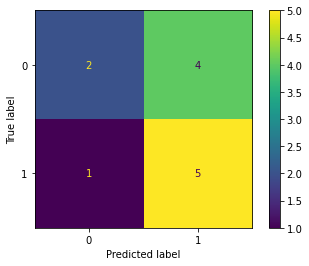

              precision    recall  f1-score   support

           0       0.67      0.33      0.44         6
           1       0.56      0.83      0.67         6

    accuracy                           0.58        12
   macro avg       0.61      0.58      0.56        12
weighted avg       0.61      0.58      0.56        12


metric 1: 0.00675210876231902
metric(s) 2: (00, 10, 11) = (0.481469087186589, 0.5010735505122229, 0.5341822313624949)
metric 3: -1.163985e-317


----> Kernel construction duration: 00:02:18


Combination 275/468
(Current range: 45/46)
			 reps : 2
			 paulis : ['YZ', 'ZY']
			 entanglement : linear

Feature map:


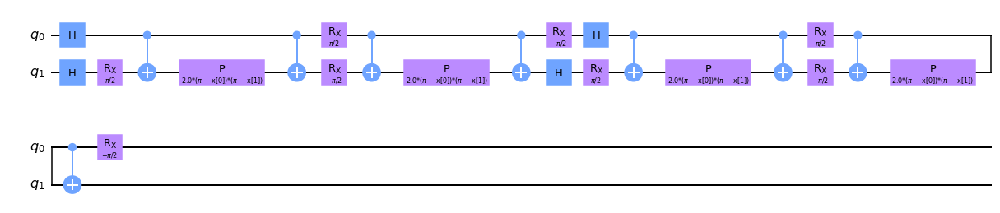


Quantum kernel matrices:



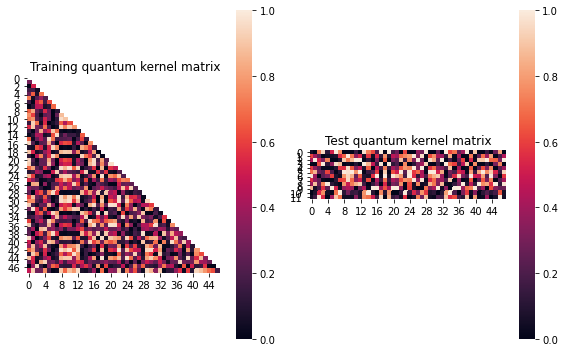


SVM with quantum kernel trained!


Test set performance:


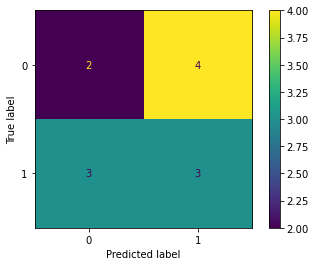

              precision    recall  f1-score   support

           0       0.40      0.33      0.36         6
           1       0.43      0.50      0.46         6

    accuracy                           0.42        12
   macro avg       0.41      0.42      0.41        12
weighted avg       0.41      0.42      0.41        12


metric 1: 0.008355521831476198
metric(s) 2: (00, 10, 11) = (0.40498000311150817, 0.4001631552844979, 0.41205735112044006)
metric 3: -0.0


----> Kernel construction duration: 00:02:27


Combination 276/468
(Current range: 46/46)
			 reps : 2
			 paulis : ['YZ', 'ZZ']
			 entanglement : linear

Feature map:


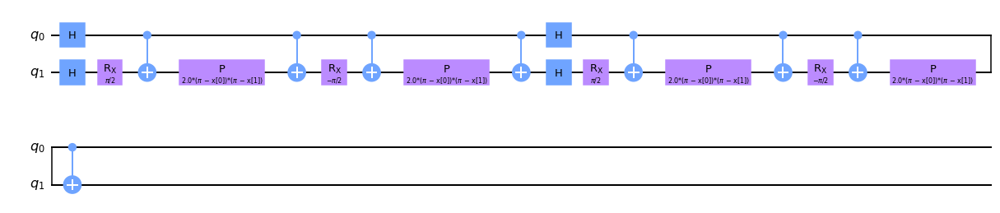


Quantum kernel matrices:



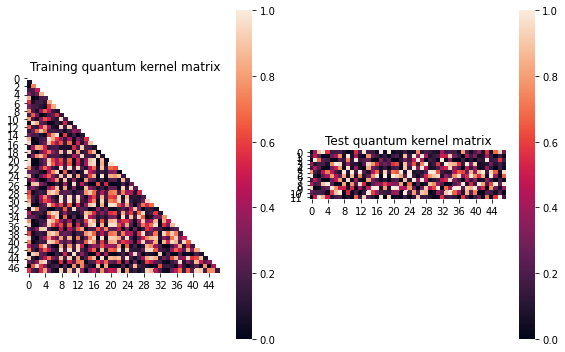


SVM with quantum kernel trained!


Test set performance:


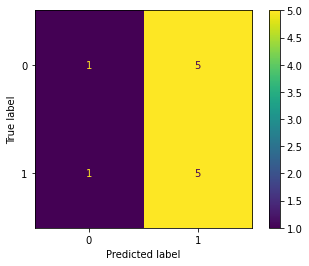

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.007873127376315847
metric(s) 2: (00, 10, 11) = (0.38923003355767655, 0.39073041497388045, 0.40797705114271604)
metric 3: 1.4722060792014366e-307


----> Kernel construction duration: 00:02:06


In [18]:
j=5
results.append(run_kernel_evaluation(X, X_train, y_train, X_test, y_test,
                                      param_grid, range_list, j, model=True))



Combination 277/468
(Current range: 1/46)
			 reps : 2
			 paulis : ['ZX', 'X']
			 entanglement : linear

Feature map:


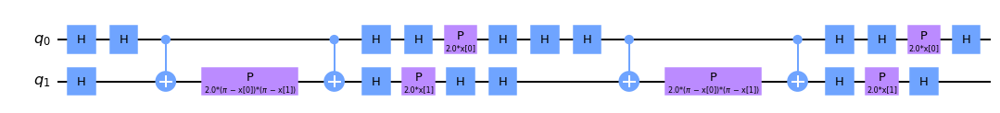


Quantum kernel matrices:



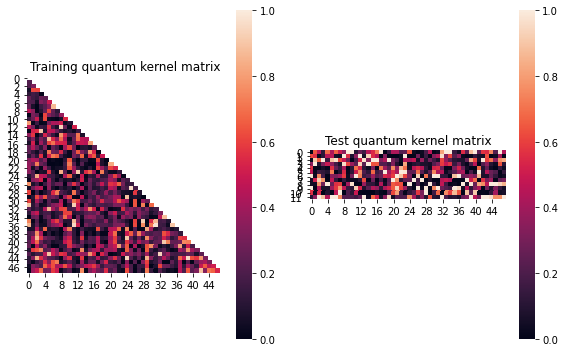


SVM with quantum kernel trained!


Test set performance:


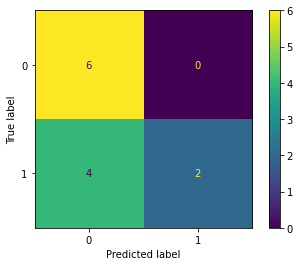

              precision    recall  f1-score   support

           0       0.60      1.00      0.75         6
           1       1.00      0.33      0.50         6

    accuracy                           0.67        12
   macro avg       0.80      0.67      0.62        12
weighted avg       0.80      0.67      0.62        12


metric 1: 0.05458712153678824
metric(s) 2: (00, 10, 11) = (0.3087076140517531, 0.2674555133199612, 0.3353776556617458)
metric 3: -3.2883435901199428e-257


----> Kernel construction duration: 00:01:32


Combination 278/468
(Current range: 2/46)
			 reps : 2
			 paulis : ['ZX', 'Y']
			 entanglement : linear

Feature map:


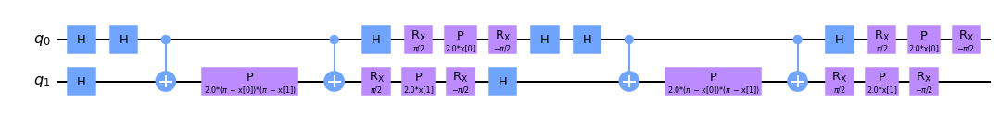


Quantum kernel matrices:



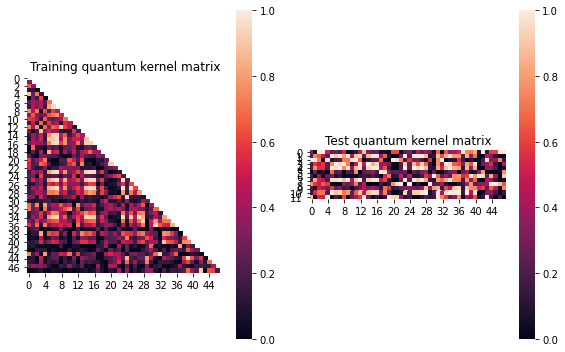


SVM with quantum kernel trained!


Test set performance:


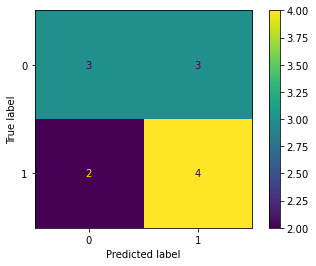

              precision    recall  f1-score   support

           0       0.60      0.50      0.55         6
           1       0.57      0.67      0.62         6

    accuracy                           0.58        12
   macro avg       0.59      0.58      0.58        12
weighted avg       0.59      0.58      0.58        12


metric 1: 0.08382596952792465
metric(s) 2: (00, 10, 11) = (0.3990782829919264, 0.2869959080646713, 0.3425654721932655)
metric 3: -2.8383323978324117e-271


----> Kernel construction duration: 00:01:38


Combination 279/468
(Current range: 3/46)
			 reps : 2
			 paulis : ['ZX', 'Z']
			 entanglement : linear

Feature map:


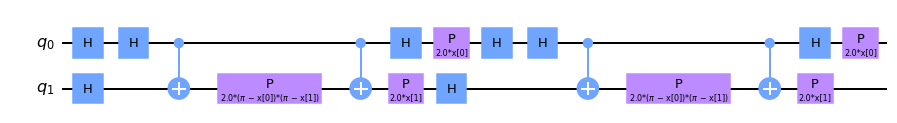


Quantum kernel matrices:



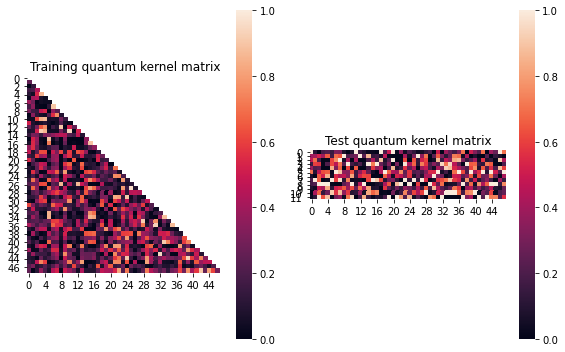


SVM with quantum kernel trained!


Test set performance:


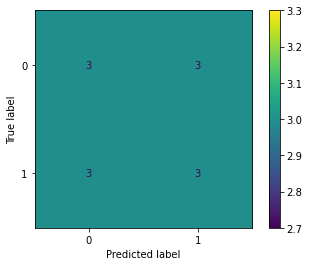

              precision    recall  f1-score   support

           0       0.50      0.50      0.50         6
           1       0.50      0.50      0.50         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.50        12
weighted avg       0.50      0.50      0.50        12


metric 1: 0.04368251050925204
metric(s) 2: (00, 10, 11) = (0.2822741956944189, 0.26728065542358986, 0.33965213617126483)
metric 3: 8.732315856773856e-270


----> Kernel construction duration: 00:01:31


Combination 280/468
(Current range: 4/46)
			 reps : 2
			 paulis : ['ZX', 'XX']
			 entanglement : linear

Feature map:


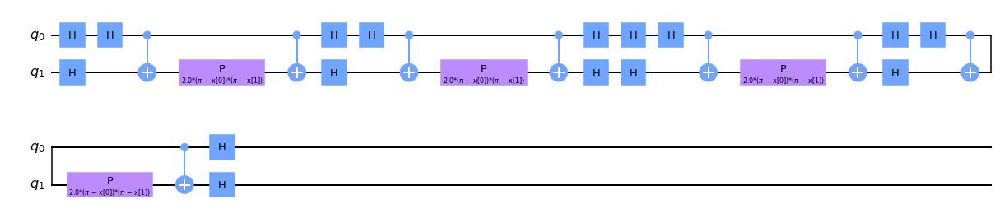


Quantum kernel matrices:



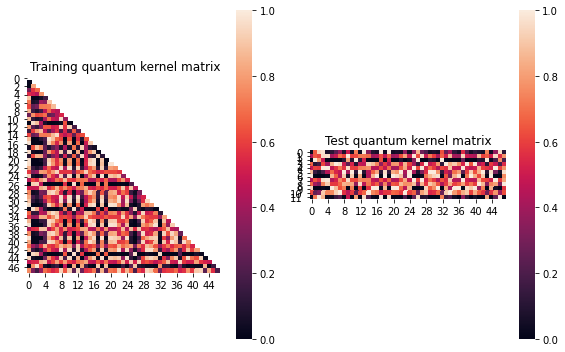


SVM with quantum kernel trained!


Test set performance:


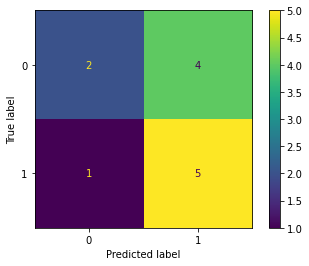

              precision    recall  f1-score   support

           0       0.67      0.33      0.44         6
           1       0.56      0.83      0.67         6

    accuracy                           0.58        12
   macro avg       0.61      0.58      0.56        12
weighted avg       0.61      0.58      0.56        12


metric 1: -0.00287470733398254
metric(s) 2: (00, 10, 11) = (0.49490396168777195, 0.5083145122829045, 0.5159756482100718)
metric 3: -0.0


----> Kernel construction duration: 00:01:45


Combination 281/468
(Current range: 5/46)
			 reps : 2
			 paulis : ['ZX', 'XY']
			 entanglement : linear

Feature map:


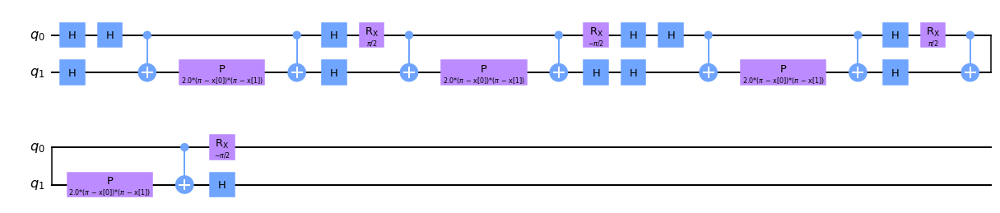


Quantum kernel matrices:



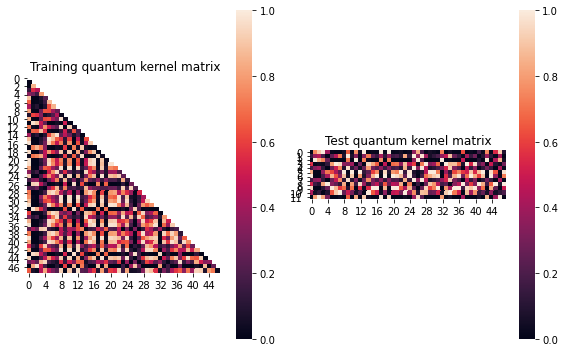


SVM with quantum kernel trained!


Test set performance:


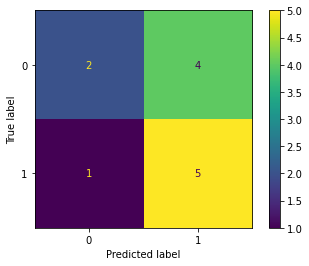

              precision    recall  f1-score   support

           0       0.67      0.33      0.44         6
           1       0.56      0.83      0.67         6

    accuracy                           0.58        12
   macro avg       0.61      0.58      0.56        12
weighted avg       0.61      0.58      0.56        12


metric 1: 0.006869846891391751
metric(s) 2: (00, 10, 11) = (0.4060577317852425, 0.4130337505270298, 0.43374946305160056)
metric 3: -2.00945491262364e-310


----> Kernel construction duration: 00:02:07


Combination 282/468
(Current range: 6/46)
			 reps : 2
			 paulis : ['ZX', 'XZ']
			 entanglement : linear

Feature map:


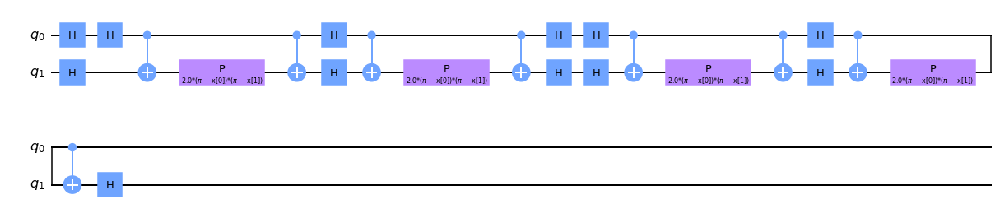


Quantum kernel matrices:



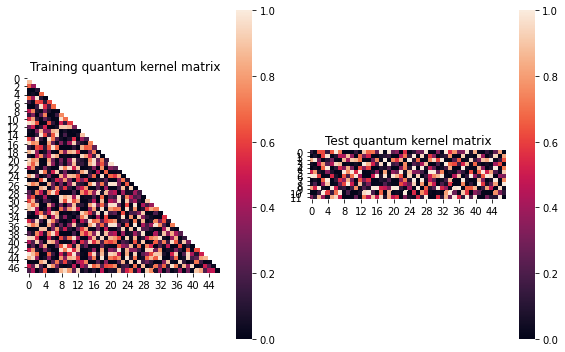


SVM with quantum kernel trained!


Test set performance:


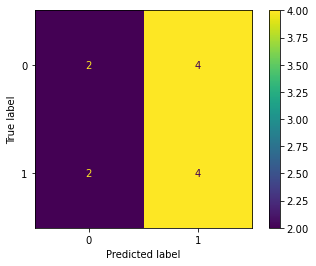

              precision    recall  f1-score   support

           0       0.50      0.33      0.40         6
           1       0.50      0.67      0.57         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.49        12
weighted avg       0.50      0.50      0.49        12


metric 1: 0.007516014510359381
metric(s) 2: (00, 10, 11) = (0.38602247404862156, 0.3780340823964001, 0.3850777197648973)
metric 3: -0.0


----> Kernel construction duration: 00:01:45


Combination 283/468
(Current range: 7/46)
			 reps : 2
			 paulis : ['ZX', 'YX']
			 entanglement : linear

Feature map:


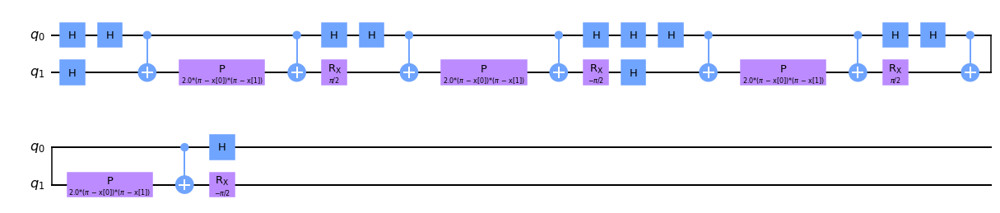


Quantum kernel matrices:



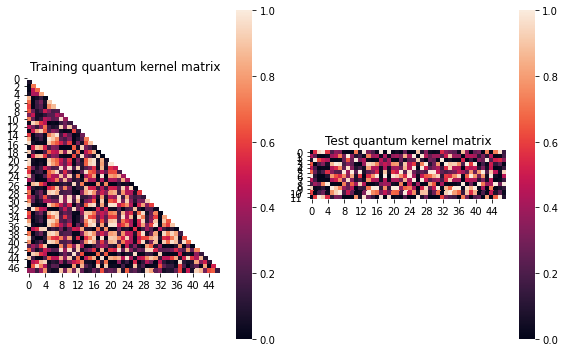


SVM with quantum kernel trained!


Test set performance:


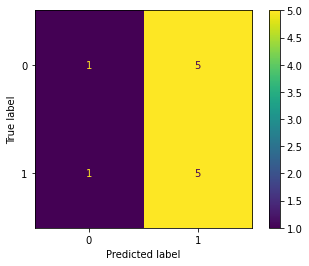

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.004937674467186515
metric(s) 2: (00, 10, 11) = (0.40462516537586635, 0.4029092418148262, 0.41106866718815904)
metric 3: 1.813e-321


----> Kernel construction duration: 00:01:54


Combination 284/468
(Current range: 8/46)
			 reps : 2
			 paulis : ['ZX', 'YY']
			 entanglement : linear

Feature map:


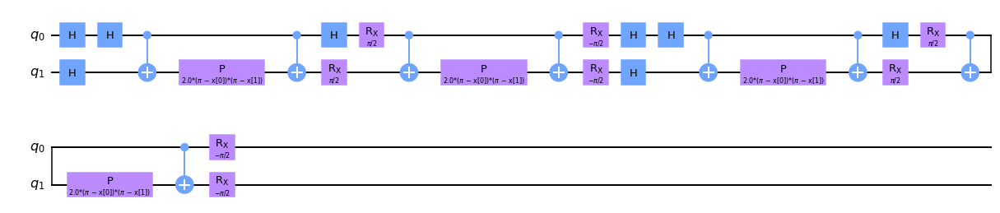


Quantum kernel matrices:



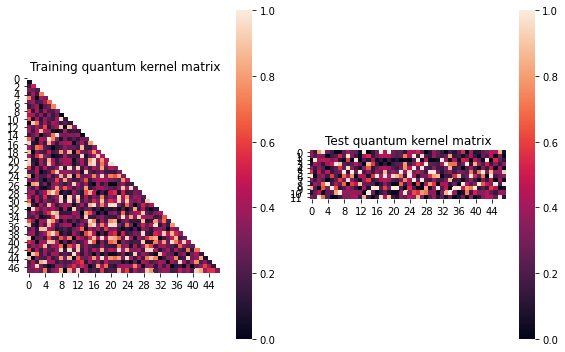


SVM with quantum kernel trained!


Test set performance:


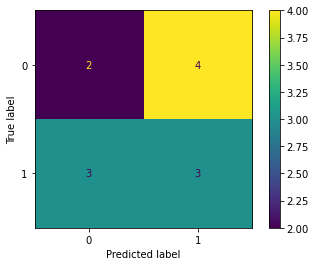

              precision    recall  f1-score   support

           0       0.40      0.33      0.36         6
           1       0.43      0.50      0.46         6

    accuracy                           0.42        12
   macro avg       0.41      0.42      0.41        12
weighted avg       0.41      0.42      0.41        12


metric 1: 0.012900001582309362
metric(s) 2: (00, 10, 11) = (0.37870770880359794, 0.37507127200568885, 0.3972348383723985)
metric 3: 0.0


----> Kernel construction duration: 00:02:16


Combination 285/468
(Current range: 9/46)
			 reps : 2
			 paulis : ['ZX', 'YZ']
			 entanglement : linear

Feature map:


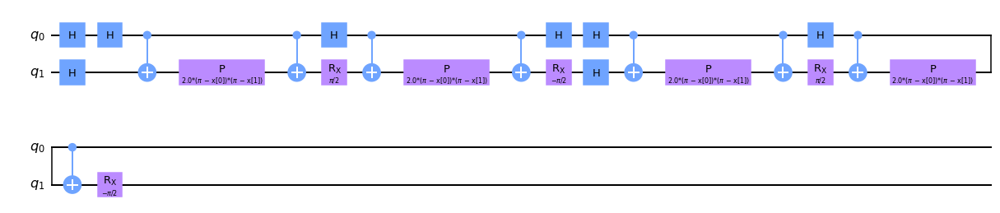


Quantum kernel matrices:



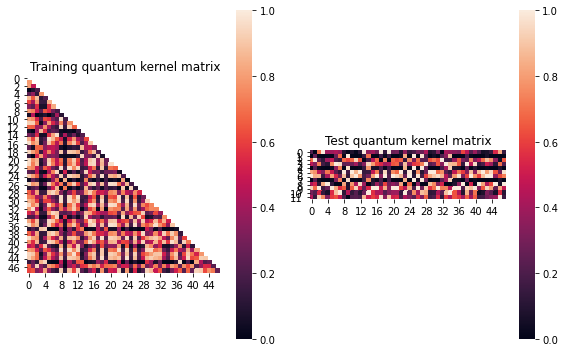


SVM with quantum kernel trained!


Test set performance:


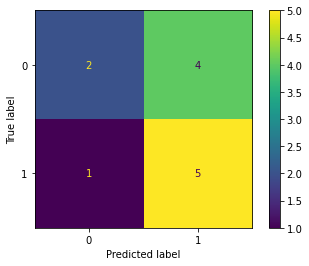

              precision    recall  f1-score   support

           0       0.67      0.33      0.44         6
           1       0.56      0.83      0.67         6

    accuracy                           0.58        12
   macro avg       0.61      0.58      0.56        12
weighted avg       0.61      0.58      0.56        12


metric 1: 0.00675210876231902
metric(s) 2: (00, 10, 11) = (0.481469087186589, 0.5010735505122229, 0.5341822313624949)
metric 3: -1.163985e-317


----> Kernel construction duration: 00:02:06


Combination 286/468
(Current range: 10/46)
			 reps : 2
			 paulis : ['ZX', 'ZX']
			 entanglement : linear

Feature map:


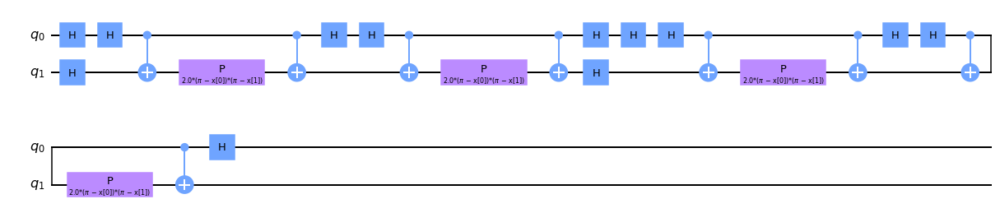


Quantum kernel matrices:



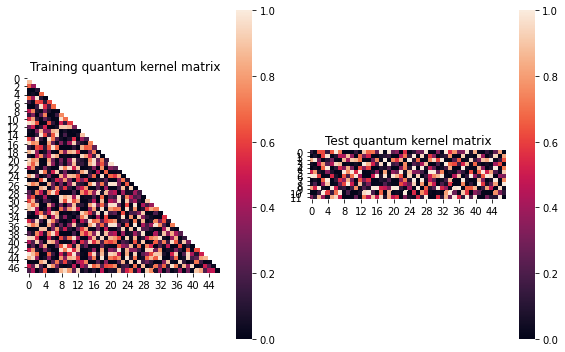


SVM with quantum kernel trained!


Test set performance:


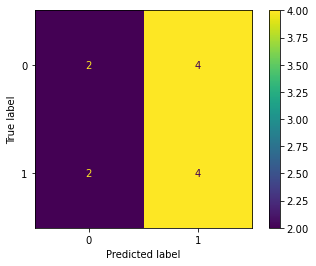

              precision    recall  f1-score   support

           0       0.50      0.33      0.40         6
           1       0.50      0.67      0.57         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.49        12
weighted avg       0.50      0.50      0.49        12


metric 1: 0.007516014510359381
metric(s) 2: (00, 10, 11) = (0.38602247404862156, 0.3780340823964001, 0.3850777197648973)
metric 3: -0.0


----> Kernel construction duration: 00:01:11


Combination 287/468
(Current range: 11/46)
			 reps : 2
			 paulis : ['ZX', 'ZY']
			 entanglement : linear

Feature map:


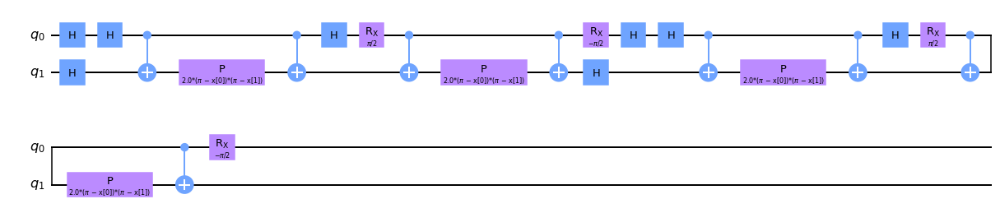


Quantum kernel matrices:



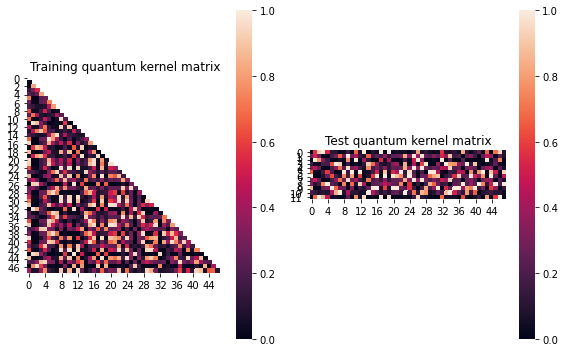


SVM with quantum kernel trained!


Test set performance:


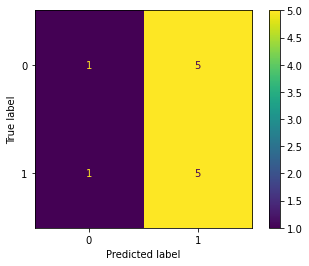

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.009409481377249618
metric(s) 2: (00, 10, 11) = (0.33846873143765144, 0.33592214234149587, 0.3521945159998396)
metric 3: 3.2801509408597e-311


----> Kernel construction duration: 00:01:55


Combination 288/468
(Current range: 12/46)
			 reps : 2
			 paulis : ['ZX', 'ZZ']
			 entanglement : linear

Feature map:


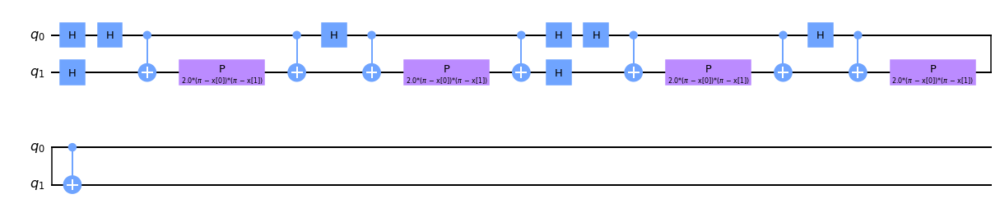


Quantum kernel matrices:



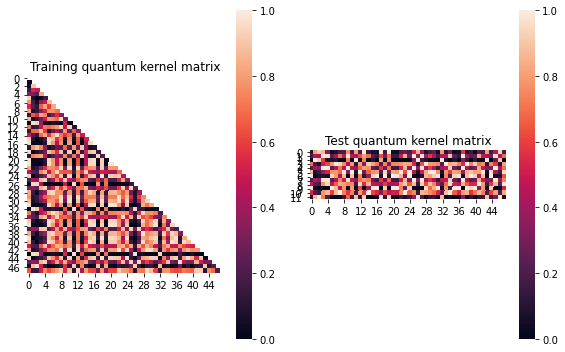


SVM with quantum kernel trained!


Test set performance:


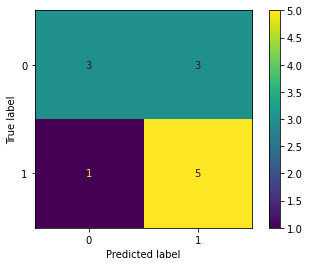

              precision    recall  f1-score   support

           0       0.75      0.50      0.60         6
           1       0.62      0.83      0.71         6

    accuracy                           0.67        12
   macro avg       0.69      0.67      0.66        12
weighted avg       0.69      0.67      0.66        12


metric 1: 0.002375817397498592
metric(s) 2: (00, 10, 11) = (0.5019203663160003, 0.511328251814386, 0.525487772107769)
metric 3: 1e-323


----> Kernel construction duration: 00:01:44


Combination 289/468
(Current range: 13/46)
			 reps : 2
			 paulis : ['ZY', 'X']
			 entanglement : linear

Feature map:


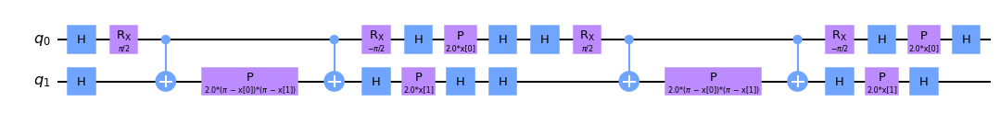


Quantum kernel matrices:



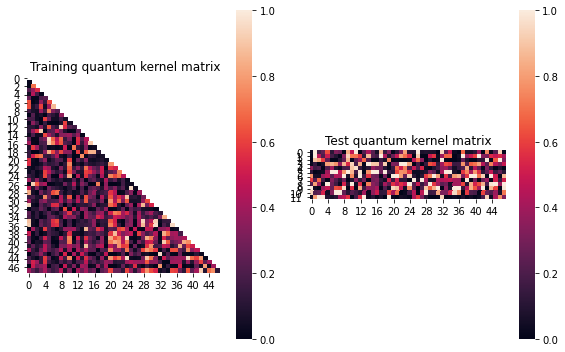


SVM with quantum kernel trained!


Test set performance:


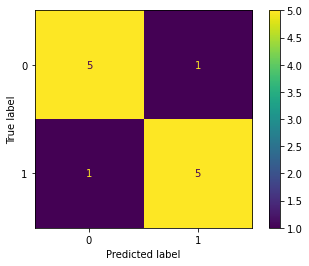

              precision    recall  f1-score   support

           0       0.83      0.83      0.83         6
           1       0.83      0.83      0.83         6

    accuracy                           0.83        12
   macro avg       0.83      0.83      0.83        12
weighted avg       0.83      0.83      0.83        12


metric 1: 0.07180523755125057
metric(s) 2: (00, 10, 11) = (0.2861038472104901, 0.24736133547739014, 0.3522292988467913)
metric 3: -4.84649385374262e-257


----> Kernel construction duration: 00:01:47


Combination 290/468
(Current range: 14/46)
			 reps : 2
			 paulis : ['ZY', 'Y']
			 entanglement : linear

Feature map:


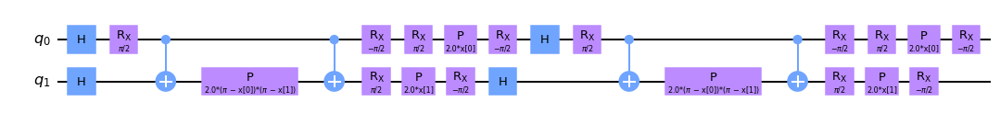


Quantum kernel matrices:



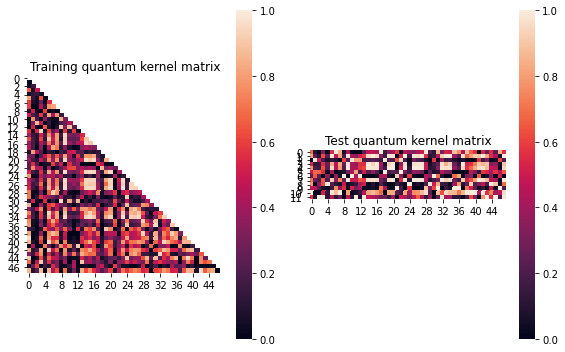


SVM with quantum kernel trained!


Test set performance:


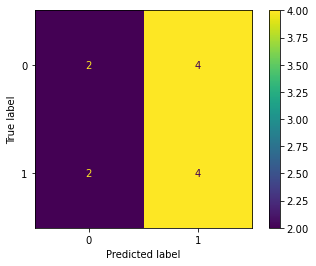

              precision    recall  f1-score   support

           0       0.50      0.33      0.40         6
           1       0.50      0.67      0.57         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.49        12
weighted avg       0.50      0.50      0.49        12


metric 1: 0.05654137010759813
metric(s) 2: (00, 10, 11) = (0.3858770520956839, 0.3764434984628464, 0.4800926850452052)
metric 3: 7.2713e-319


----> Kernel construction duration: 00:01:48


Combination 291/468
(Current range: 15/46)
			 reps : 2
			 paulis : ['ZY', 'Z']
			 entanglement : linear

Feature map:


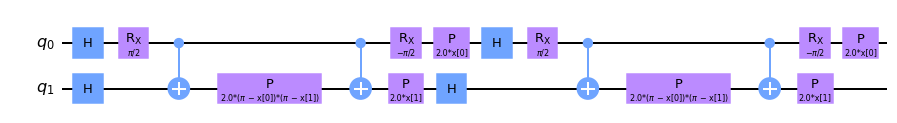


Quantum kernel matrices:



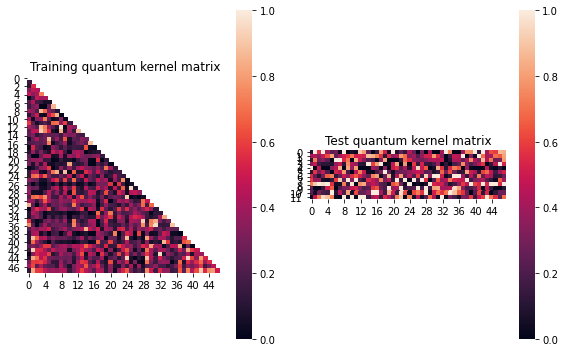


SVM with quantum kernel trained!


Test set performance:


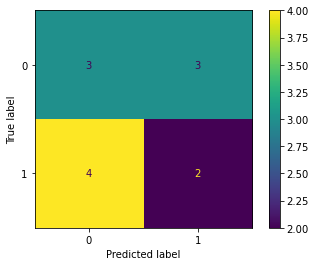

              precision    recall  f1-score   support

           0       0.43      0.50      0.46         6
           1       0.40      0.33      0.36         6

    accuracy                           0.42        12
   macro avg       0.41      0.42      0.41        12
weighted avg       0.41      0.42      0.41        12


metric 1: 0.0467314672736685
metric(s) 2: (00, 10, 11) = (0.31040610490224163, 0.29247780711563887, 0.36801244387637316)
metric 3: 2.6030405543830254e-269


----> Kernel construction duration: 00:01:46


Combination 292/468
(Current range: 16/46)
			 reps : 2
			 paulis : ['ZY', 'XX']
			 entanglement : linear

Feature map:


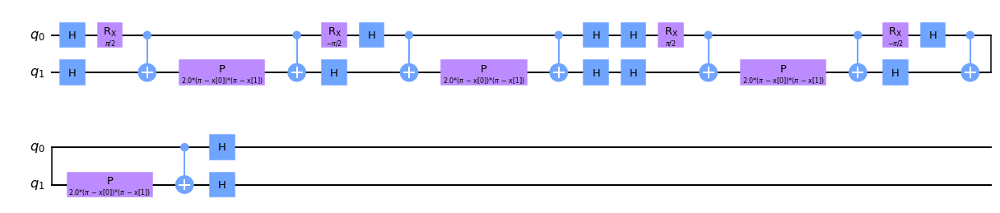


Quantum kernel matrices:



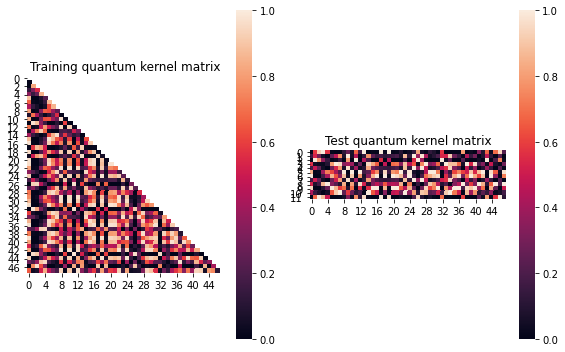


SVM with quantum kernel trained!


Test set performance:


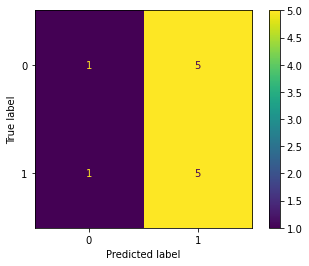

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.0059279350487767
metric(s) 2: (00, 10, 11) = (0.4041057739631215, 0.41303442475791446, 0.4338189456502609)
metric 3: 0.0


----> Kernel construction duration: 00:02:17


Combination 293/468
(Current range: 17/46)
			 reps : 2
			 paulis : ['ZY', 'XY']
			 entanglement : linear

Feature map:


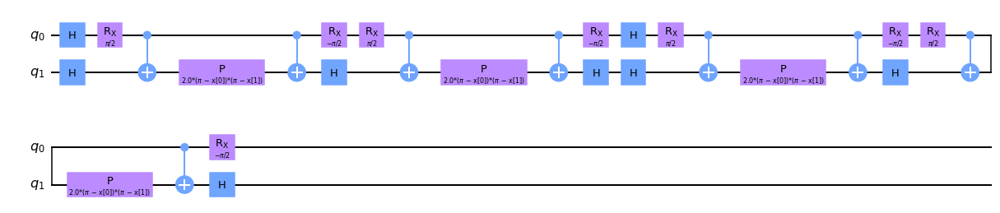


Quantum kernel matrices:



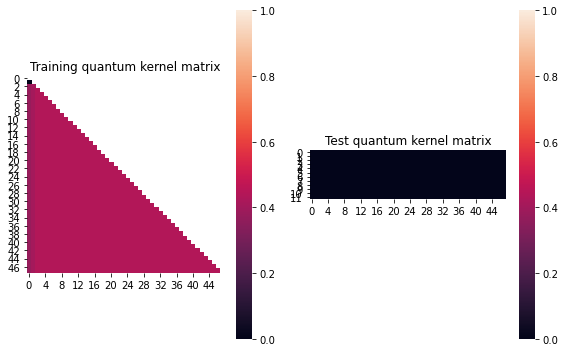


SVM with quantum kernel trained!


Test set performance:


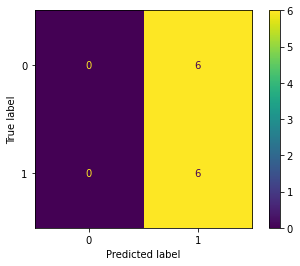

              precision    recall  f1-score   support

           0       0.00      0.00      0.00         6
           1       0.50      1.00      0.67         6

    accuracy                           0.50        12
   macro avg       0.25      0.50      0.33        12
weighted avg       0.25      0.50      0.33        12


metric 1: 0.00472005208333337
metric(s) 2: (00, 10, 11) = (0.4391276041666667, 0.43359375, 0.4375)
metric 3: 0.0


----> Kernel construction duration: 00:02:00


Combination 294/468
(Current range: 18/46)
			 reps : 2
			 paulis : ['ZY', 'XZ']
			 entanglement : linear

Feature map:


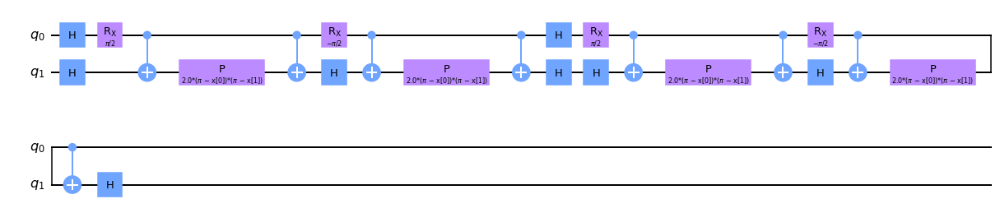


Quantum kernel matrices:



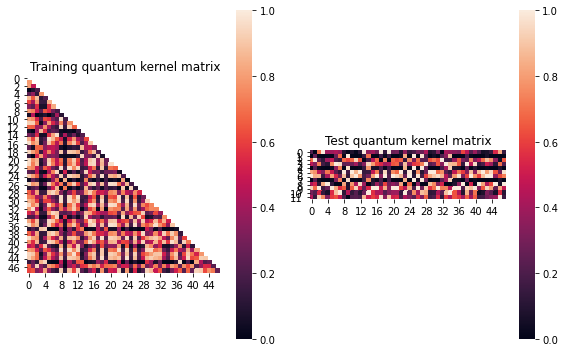


SVM with quantum kernel trained!


Test set performance:


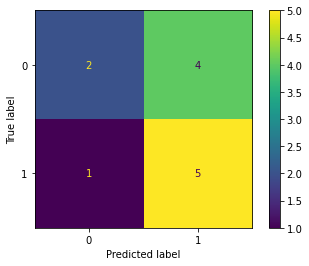

              precision    recall  f1-score   support

           0       0.67      0.33      0.44         6
           1       0.56      0.83      0.67         6

    accuracy                           0.58        12
   macro avg       0.61      0.58      0.56        12
weighted avg       0.61      0.58      0.56        12


metric 1: 0.00675210876231902
metric(s) 2: (00, 10, 11) = (0.481469087186589, 0.5010735505122229, 0.5341822313624949)
metric 3: -1.163985e-317


----> Kernel construction duration: 00:02:18


Combination 295/468
(Current range: 19/46)
			 reps : 2
			 paulis : ['ZY', 'YX']
			 entanglement : linear

Feature map:


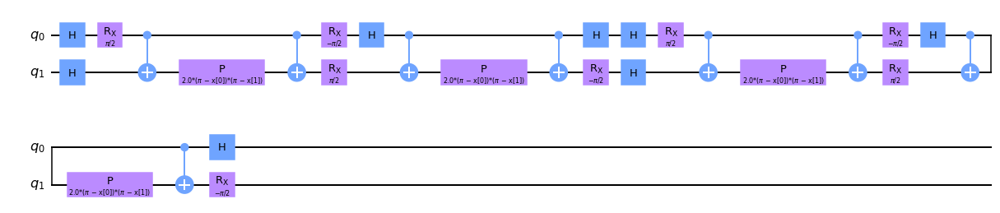


Quantum kernel matrices:



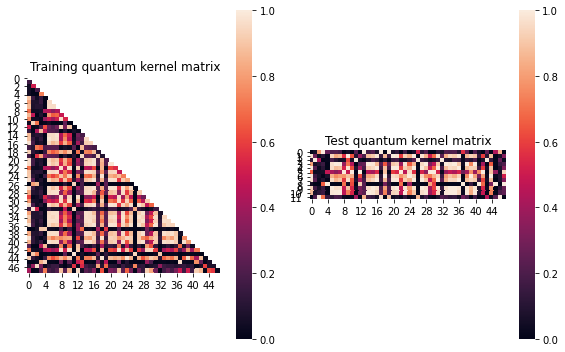


SVM with quantum kernel trained!


Test set performance:


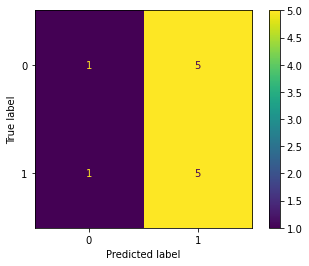

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.008096011748282339
metric(s) 2: (00, 10, 11) = (0.43659318978633344, 0.4369935819554691, 0.4535859976211695)
metric 3: 0.0


----> Kernel construction duration: 00:02:27


Combination 296/468
(Current range: 20/46)
			 reps : 2
			 paulis : ['ZY', 'YY']
			 entanglement : linear

Feature map:


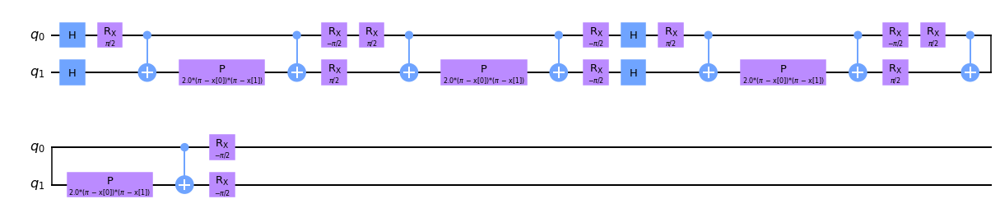


Quantum kernel matrices:



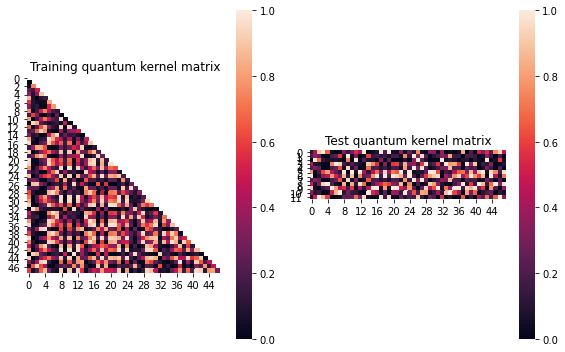


SVM with quantum kernel trained!


Test set performance:


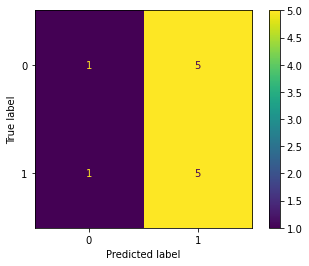

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.004891088969446122
metric(s) 2: (00, 10, 11) = (0.39488346498960936, 0.39527564032928253, 0.4054499936078479)
metric 3: 9.85581492386e-312


----> Kernel construction duration: 00:02:10


Combination 297/468
(Current range: 21/46)
			 reps : 2
			 paulis : ['ZY', 'YZ']
			 entanglement : linear

Feature map:


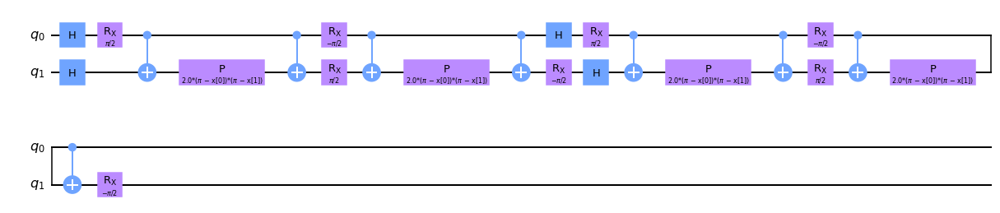


Quantum kernel matrices:



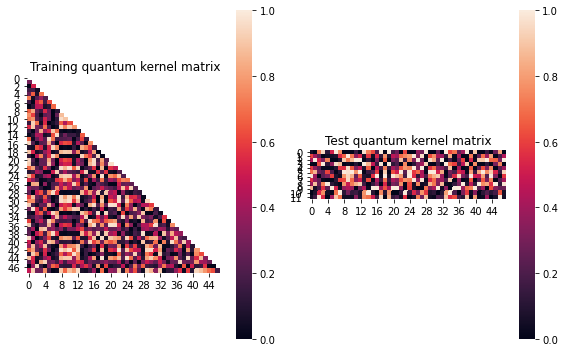


SVM with quantum kernel trained!


Test set performance:


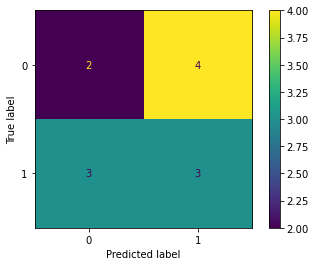

              precision    recall  f1-score   support

           0       0.40      0.33      0.36         6
           1       0.43      0.50      0.46         6

    accuracy                           0.42        12
   macro avg       0.41      0.42      0.41        12
weighted avg       0.41      0.42      0.41        12


metric 1: 0.008355521831476198
metric(s) 2: (00, 10, 11) = (0.40498000311150817, 0.4001631552844979, 0.41205735112044006)
metric 3: -0.0


----> Kernel construction duration: 00:02:28


Combination 298/468
(Current range: 22/46)
			 reps : 2
			 paulis : ['ZY', 'ZX']
			 entanglement : linear

Feature map:


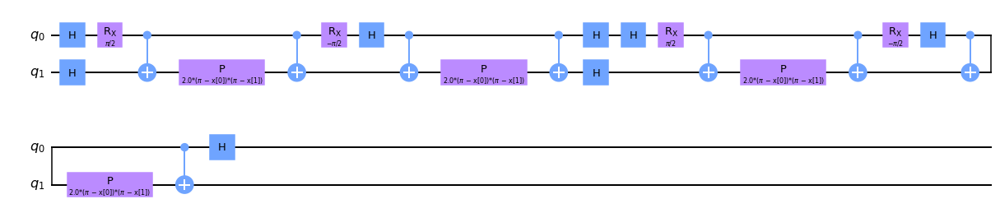


Quantum kernel matrices:



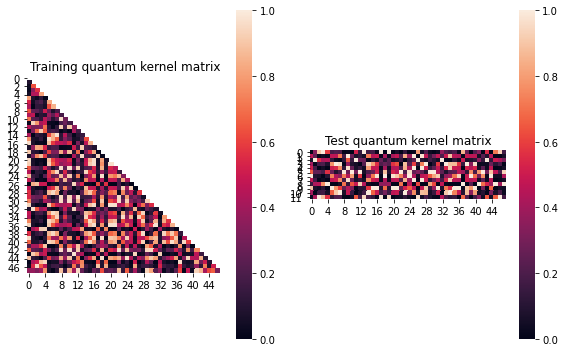


SVM with quantum kernel trained!


Test set performance:


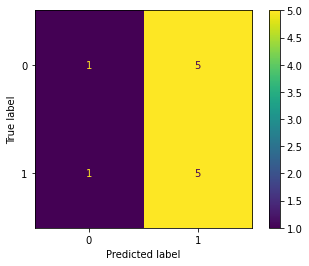

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.007716855024019864
metric(s) 2: (00, 10, 11) = (0.37539210835364006, 0.37688277537438364, 0.393807152443167)
metric 3: 1.126e-321


----> Kernel construction duration: 00:02:05


Combination 299/468
(Current range: 23/46)
			 reps : 2
			 paulis : ['ZY', 'ZY']
			 entanglement : linear

Feature map:


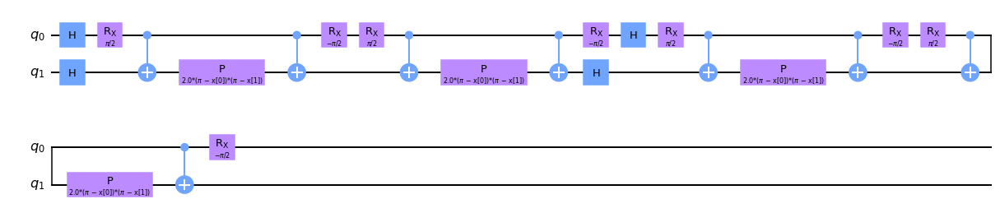


Quantum kernel matrices:



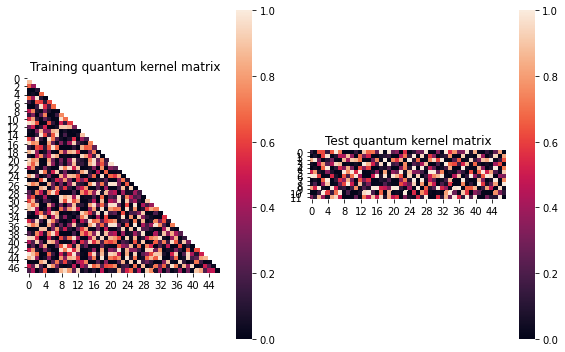


SVM with quantum kernel trained!


Test set performance:


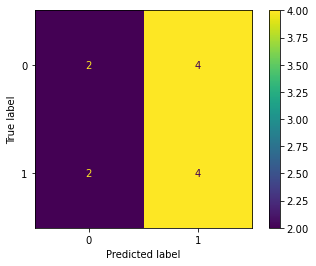

              precision    recall  f1-score   support

           0       0.50      0.33      0.40         6
           1       0.50      0.67      0.57         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.49        12
weighted avg       0.50      0.50      0.49        12


metric 1: 0.007516014510359381
metric(s) 2: (00, 10, 11) = (0.38602247404862156, 0.3780340823964001, 0.3850777197648973)
metric 3: -0.0


----> Kernel construction duration: 00:01:26


Combination 300/468
(Current range: 24/46)
			 reps : 2
			 paulis : ['ZY', 'ZZ']
			 entanglement : linear

Feature map:


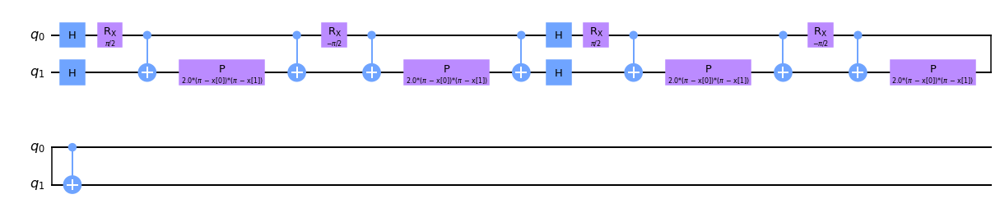


Quantum kernel matrices:



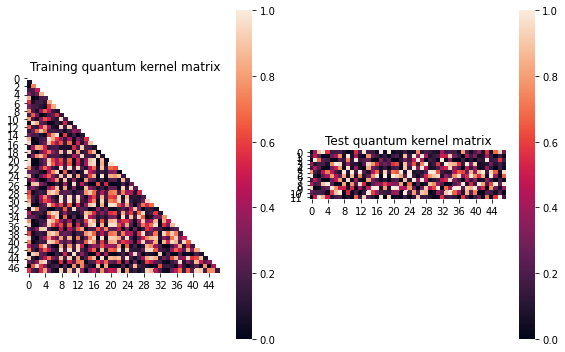


SVM with quantum kernel trained!


Test set performance:


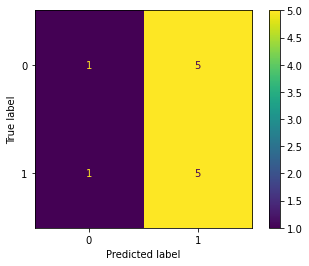

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.007873127376315847
metric(s) 2: (00, 10, 11) = (0.38923003355767655, 0.39073041497388045, 0.40797705114271604)
metric 3: 1.4722060792014366e-307


----> Kernel construction duration: 00:02:06


Combination 301/468
(Current range: 25/46)
			 reps : 2
			 paulis : ['ZZ', 'X']
			 entanglement : linear

Feature map:


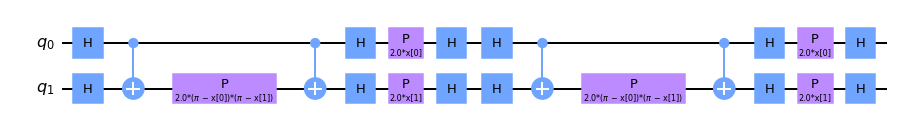


Quantum kernel matrices:



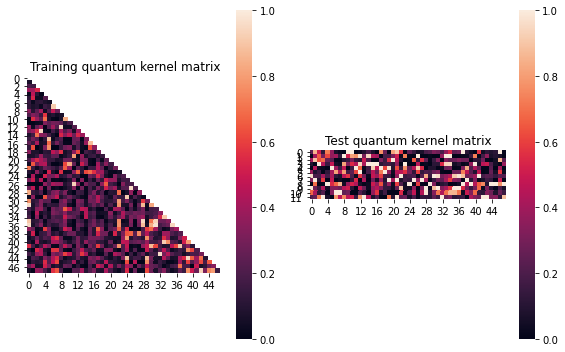


SVM with quantum kernel trained!


Test set performance:


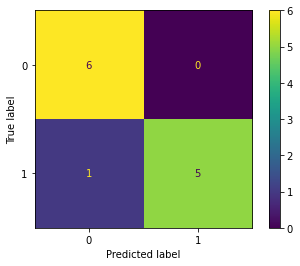

              precision    recall  f1-score   support

           0       0.86      1.00      0.92         6
           1       1.00      0.83      0.91         6

    accuracy                           0.92        12
   macro avg       0.93      0.92      0.92        12
weighted avg       0.93      0.92      0.92        12


metric 1: 0.08356203472508641
metric(s) 2: (00, 10, 11) = (0.2647995394740812, 0.2120584331955351, 0.32644139636716185)
metric 3: -3.0111332129730823e-272


----> Kernel construction duration: 00:01:45


Combination 302/468
(Current range: 26/46)
			 reps : 2
			 paulis : ['ZZ', 'Y']
			 entanglement : linear

Feature map:


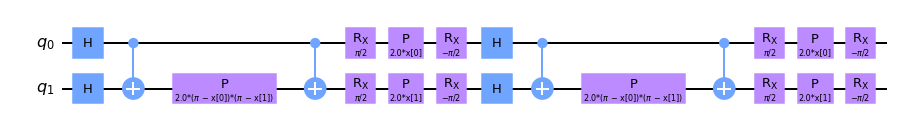


Quantum kernel matrices:



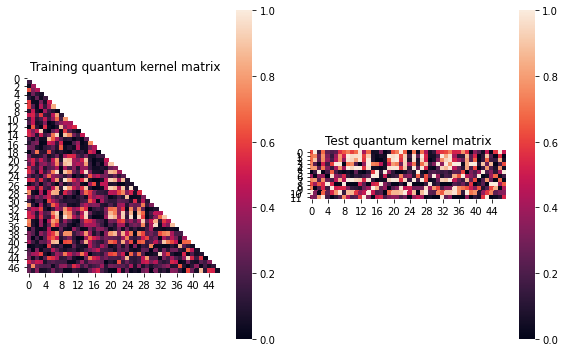


SVM with quantum kernel trained!


Test set performance:


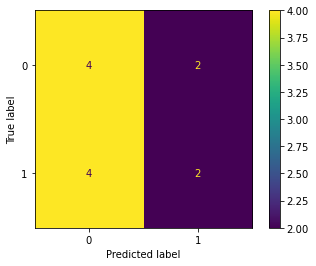

              precision    recall  f1-score   support

           0       0.50      0.67      0.57         6
           1       0.50      0.33      0.40         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.49        12
weighted avg       0.50      0.50      0.49        12


metric 1: 0.022846027534040803
metric(s) 2: (00, 10, 11) = (0.3254627761578366, 0.30187684595205283, 0.3239829708143507)
metric 3: -4.347130539888061e-270


----> Kernel construction duration: 00:01:51


Combination 303/468
(Current range: 27/46)
			 reps : 2
			 paulis : ['ZZ', 'Z']
			 entanglement : linear

Feature map:


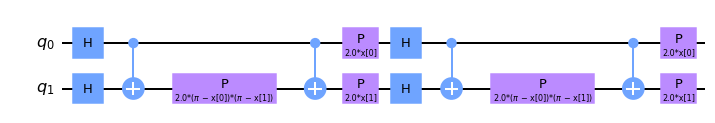


Quantum kernel matrices:



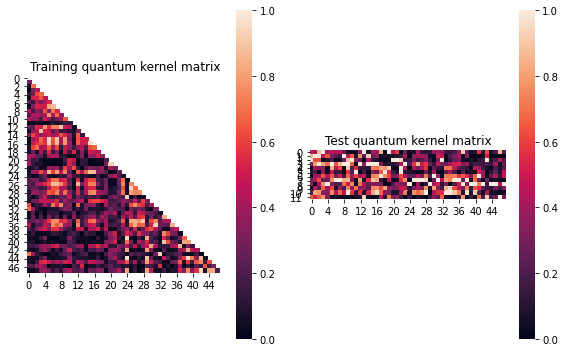


SVM with quantum kernel trained!


Test set performance:


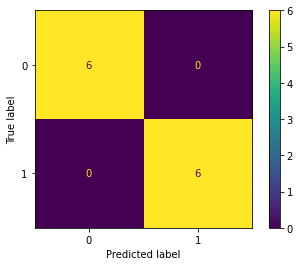

              precision    recall  f1-score   support

           0       1.00      1.00      1.00         6
           1       1.00      1.00      1.00         6

    accuracy                           1.00        12
   macro avg       1.00      1.00      1.00        12
weighted avg       1.00      1.00      1.00        12


metric 1: 0.12078912227428518
metric(s) 2: (00, 10, 11) = (0.3748516035493653, 0.248351635272397, 0.363429911543999)
metric 3: 1.2775692381540672e-255


----> Kernel construction duration: 00:01:40


Combination 304/468
(Current range: 28/46)
			 reps : 2
			 paulis : ['ZZ', 'XX']
			 entanglement : linear

Feature map:


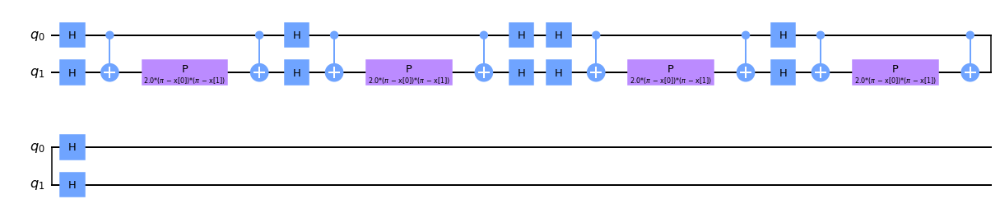


Quantum kernel matrices:



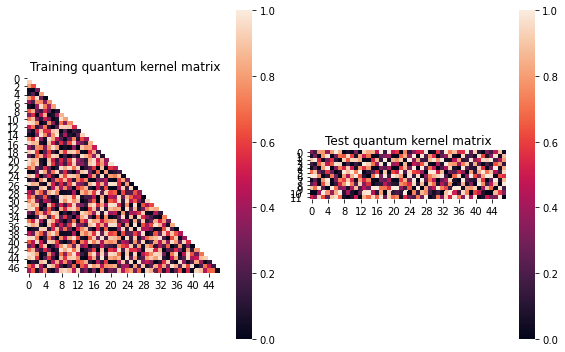


SVM with quantum kernel trained!


Test set performance:


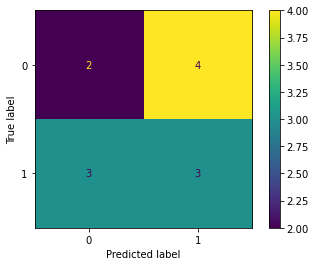

              precision    recall  f1-score   support

           0       0.40      0.33      0.36         6
           1       0.43      0.50      0.46         6

    accuracy                           0.42        12
   macro avg       0.41      0.42      0.41        12
weighted avg       0.41      0.42      0.41        12


metric 1: 0.005189231185427912
metric(s) 2: (00, 10, 11) = (0.49936335961957806, 0.494900756823733, 0.5008166163987438)
metric 3: 0.0


----> Kernel construction duration: 00:01:56


Combination 305/468
(Current range: 29/46)
			 reps : 2
			 paulis : ['ZZ', 'XY']
			 entanglement : linear

Feature map:


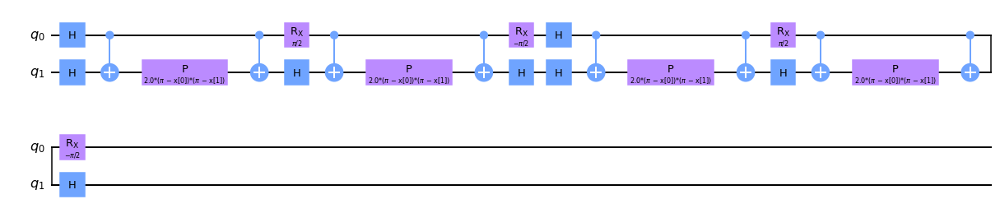


Quantum kernel matrices:



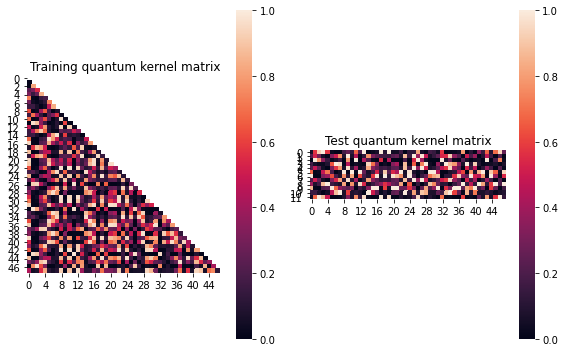


SVM with quantum kernel trained!


Test set performance:


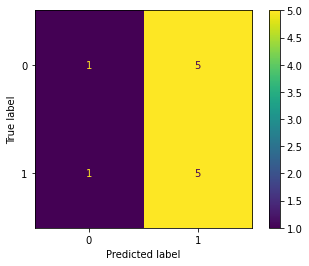

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.006236963971032516
metric(s) 2: (00, 10, 11) = (0.35185532795978236, 0.3479125952461691, 0.3564437904746208)
metric 3: 1e-323


----> Kernel construction duration: 00:02:18


Combination 306/468
(Current range: 30/46)
			 reps : 2
			 paulis : ['ZZ', 'XZ']
			 entanglement : linear

Feature map:


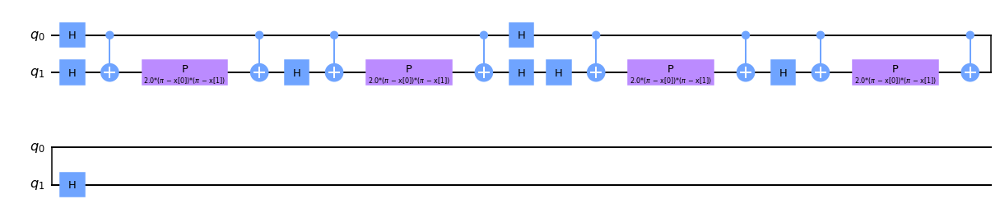


Quantum kernel matrices:



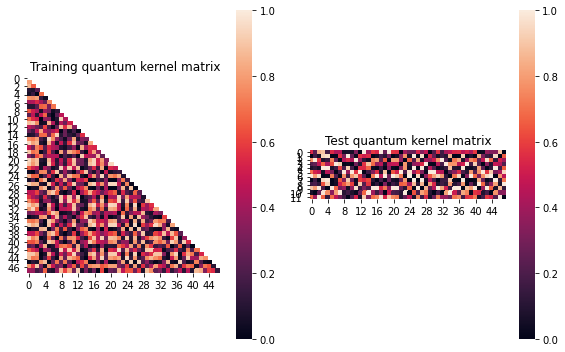


SVM with quantum kernel trained!


Test set performance:


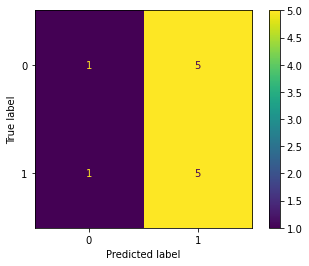

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.01001514642306256
metric(s) 2: (00, 10, 11) = (0.44256239290665345, 0.44015054820765964, 0.457768996354791)
metric 3: -9.77486824801866e-310


----> Kernel construction duration: 00:01:55


Combination 307/468
(Current range: 31/46)
			 reps : 2
			 paulis : ['ZZ', 'YX']
			 entanglement : linear

Feature map:


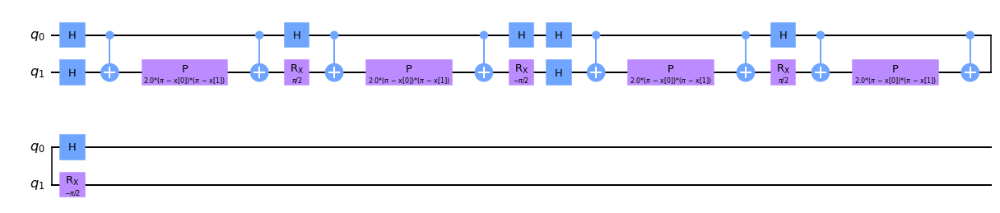


Quantum kernel matrices:



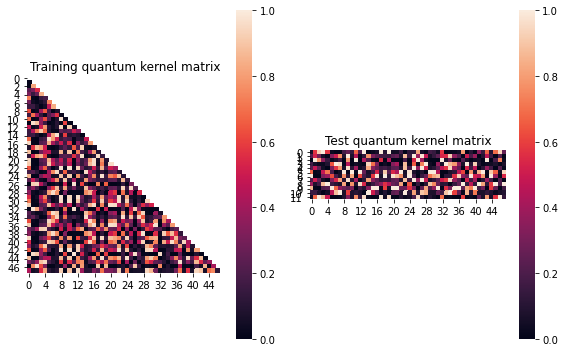


SVM with quantum kernel trained!


Test set performance:


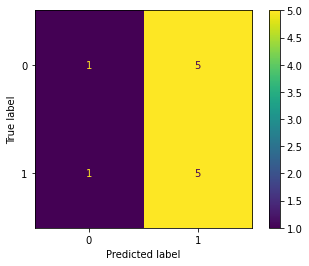

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.006236963971032516
metric(s) 2: (00, 10, 11) = (0.35185532795978236, 0.3479125952461691, 0.3564437904746208)
metric 3: 1e-323


----> Kernel construction duration: 00:02:19


Combination 308/468
(Current range: 32/46)
			 reps : 2
			 paulis : ['ZZ', 'YY']
			 entanglement : linear

Feature map:


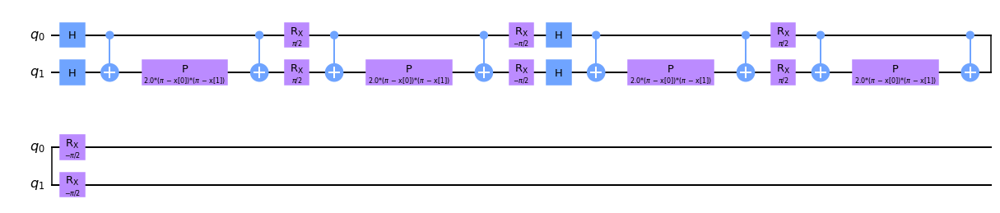


Quantum kernel matrices:



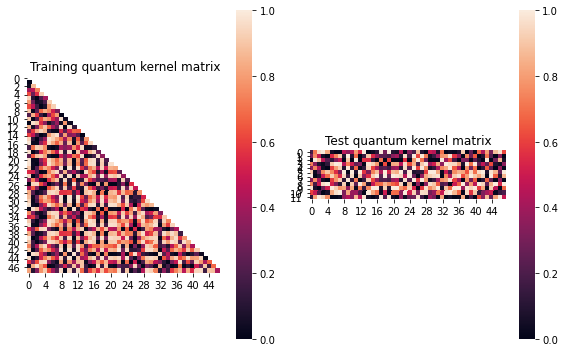


SVM with quantum kernel trained!


Test set performance:


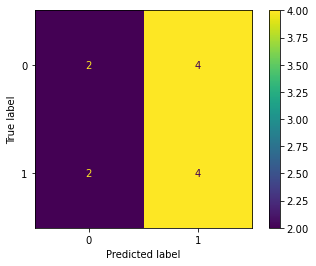

              precision    recall  f1-score   support

           0       0.50      0.33      0.40         6
           1       0.50      0.67      0.57         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.49        12
weighted avg       0.50      0.50      0.49        12


metric 1: 0.0030024471480464276
metric(s) 2: (00, 10, 11) = (0.5194729525883561, 0.5274296115848754, 0.5413911648774875)
metric 3: 0.0


----> Kernel construction duration: 00:02:27


Combination 309/468
(Current range: 33/46)
			 reps : 2
			 paulis : ['ZZ', 'YZ']
			 entanglement : linear

Feature map:


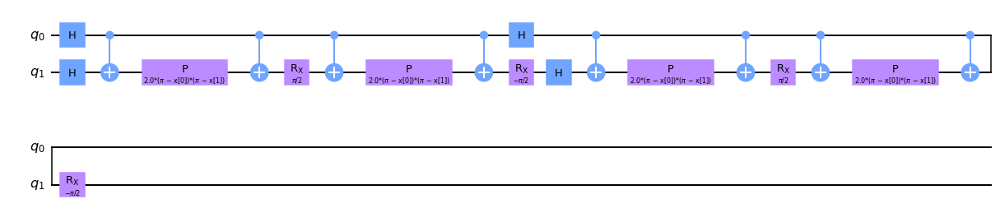


Quantum kernel matrices:



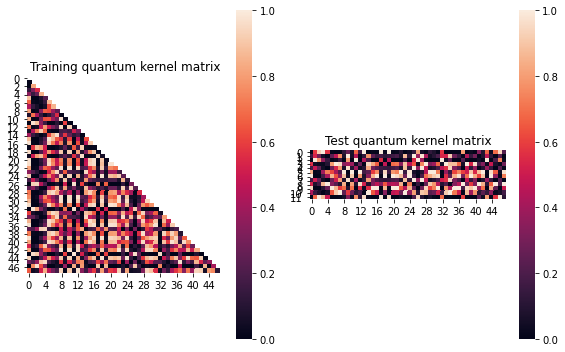


SVM with quantum kernel trained!


Test set performance:


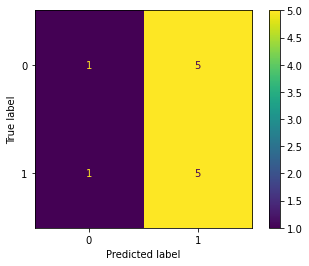

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.0059279350487767
metric(s) 2: (00, 10, 11) = (0.4041057739631215, 0.41303442475791446, 0.4338189456502609)
metric 3: 0.0


----> Kernel construction duration: 00:02:06


Combination 310/468
(Current range: 34/46)
			 reps : 2
			 paulis : ['ZZ', 'ZX']
			 entanglement : linear

Feature map:


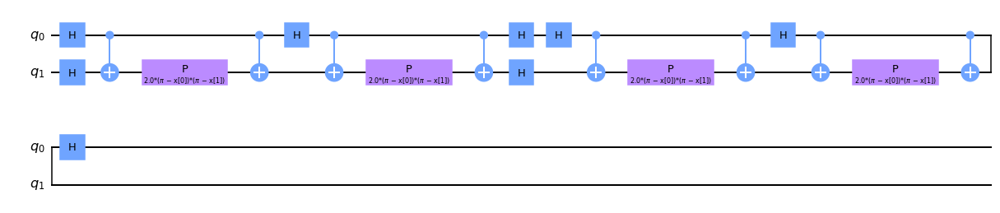


Quantum kernel matrices:



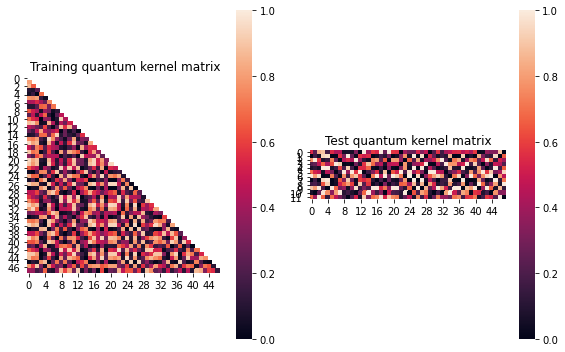


SVM with quantum kernel trained!


Test set performance:


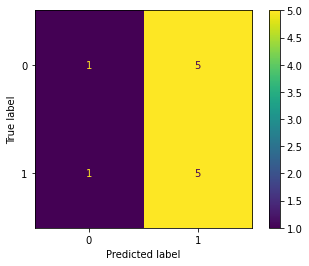

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.01001514642306256
metric(s) 2: (00, 10, 11) = (0.44256239290665345, 0.44015054820765964, 0.457768996354791)
metric 3: -9.77486824801866e-310


----> Kernel construction duration: 00:01:55


Combination 311/468
(Current range: 35/46)
			 reps : 2
			 paulis : ['ZZ', 'ZY']
			 entanglement : linear

Feature map:


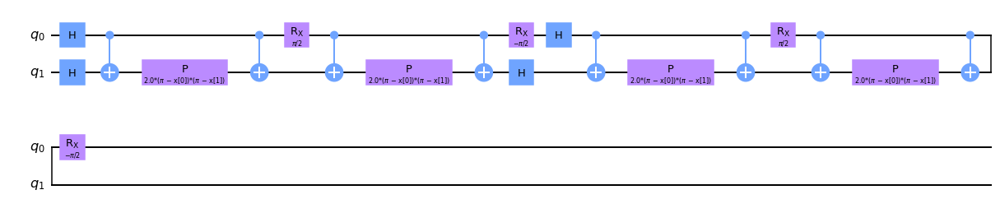


Quantum kernel matrices:



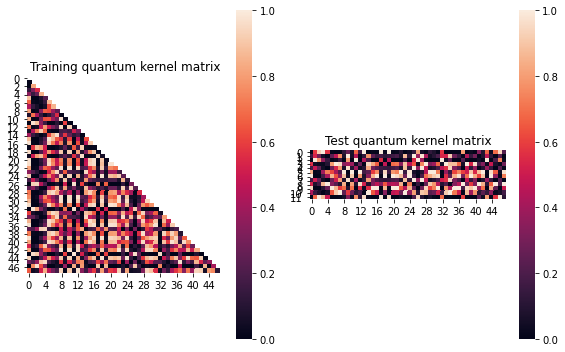


SVM with quantum kernel trained!


Test set performance:


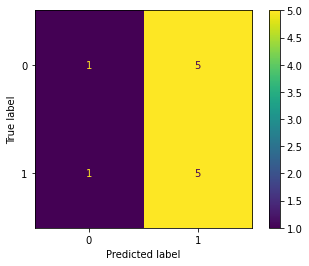

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.0059279350487767
metric(s) 2: (00, 10, 11) = (0.4041057739631215, 0.41303442475791446, 0.4338189456502609)
metric 3: 0.0


----> Kernel construction duration: 00:02:05


Combination 312/468
(Current range: 36/46)
			 reps : 2
			 paulis : ['ZZ', 'ZZ']
			 entanglement : linear

Feature map:


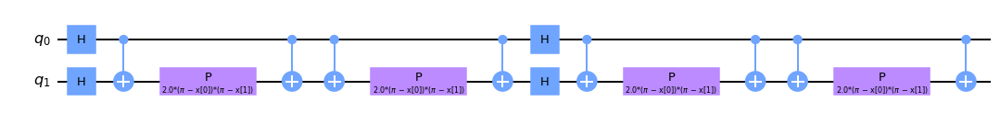


Quantum kernel matrices:



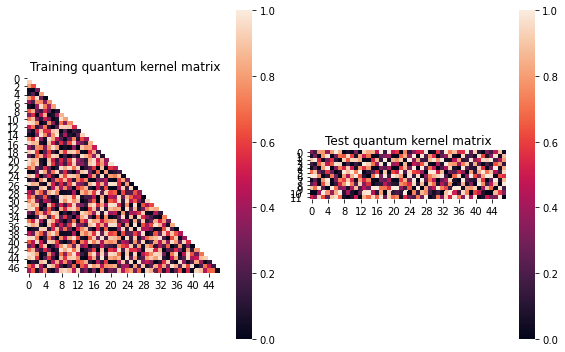


SVM with quantum kernel trained!


Test set performance:


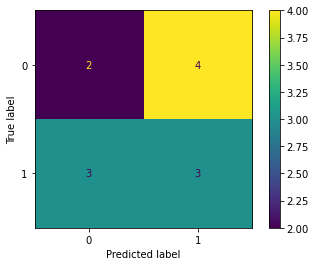

              precision    recall  f1-score   support

           0       0.40      0.33      0.36         6
           1       0.43      0.50      0.46         6

    accuracy                           0.42        12
   macro avg       0.41      0.42      0.41        12
weighted avg       0.41      0.42      0.41        12


metric 1: 0.005189231185427912
metric(s) 2: (00, 10, 11) = (0.49936335961957806, 0.494900756823733, 0.5008166163987438)
metric 3: 0.0


----> Kernel construction duration: 00:01:22


Combination 313/468
(Current range: 37/46)
			 reps : 3
			 paulis : ['X']
			 entanglement : linear

Feature map:


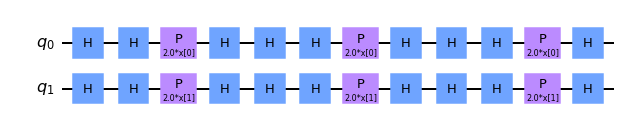


Quantum kernel matrices:



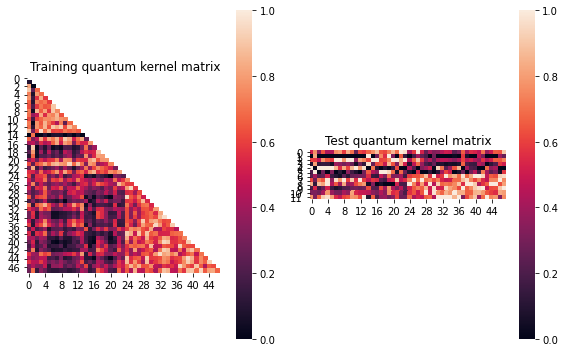


SVM with quantum kernel trained!


Test set performance:


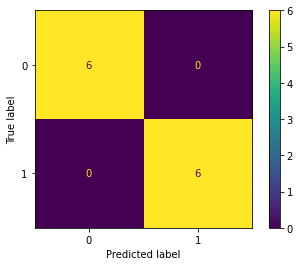

              precision    recall  f1-score   support

           0       1.00      1.00      1.00         6
           1       1.00      1.00      1.00         6

    accuracy                           1.00        12
   macro avg       1.00      1.00      1.00        12
weighted avg       1.00      1.00      1.00        12


metric 1: 0.25900545429783706
metric(s) 2: (00, 10, 11) = (0.5284495379346134, 0.339459573135221, 0.6684805169315029)
metric 3: -8.130530225039465e-283


----> Kernel construction duration: 00:00:31


Combination 314/468
(Current range: 38/46)
			 reps : 3
			 paulis : ['Y']
			 entanglement : linear

Feature map:


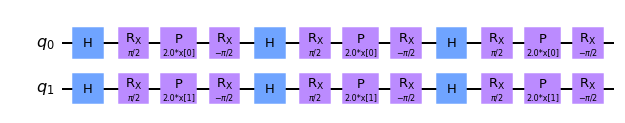


Quantum kernel matrices:



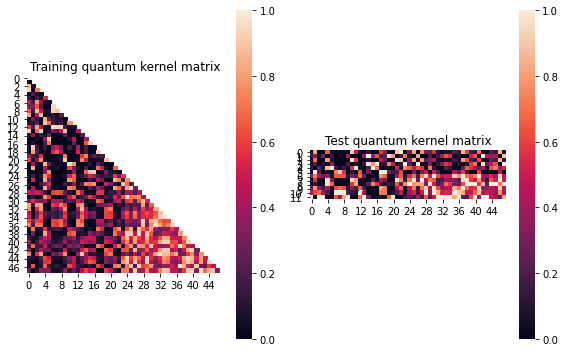


SVM with quantum kernel trained!


Test set performance:


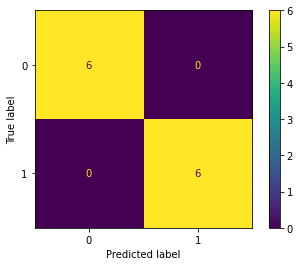

              precision    recall  f1-score   support

           0       1.00      1.00      1.00         6
           1       1.00      1.00      1.00         6

    accuracy                           1.00        12
   macro avg       1.00      1.00      1.00        12
weighted avg       1.00      1.00      1.00        12


metric 1: 0.1606525366785686
metric(s) 2: (00, 10, 11) = (0.27826916693972226, 0.2829827056871623, 0.6090013177917395)
metric 3: 1.6922e-319


----> Kernel construction duration: 00:00:32


Combination 315/468
(Current range: 39/46)
			 reps : 3
			 paulis : ['Z']
			 entanglement : linear

Feature map:


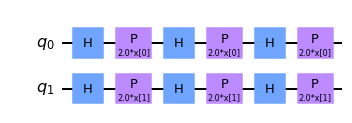


Quantum kernel matrices:



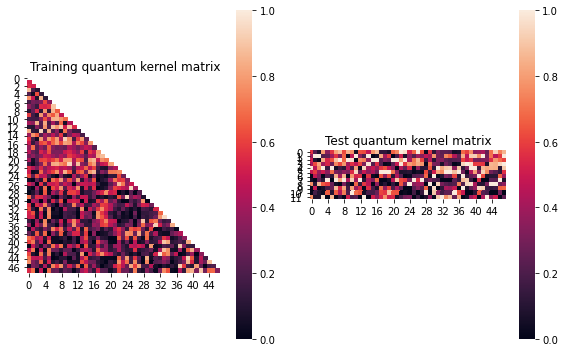


SVM with quantum kernel trained!


Test set performance:


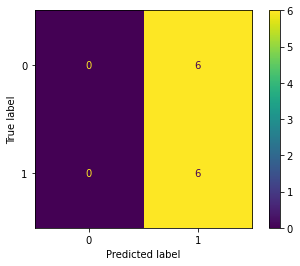

              precision    recall  f1-score   support

           0       0.00      0.00      0.00         6
           1       0.50      1.00      0.67         6

    accuracy                           0.50        12
   macro avg       0.25      0.50      0.33        12
weighted avg       0.25      0.50      0.33        12


metric 1: 0.11988556605642403
metric(s) 2: (00, 10, 11) = (0.4991184662778873, 0.3060143095754832, 0.35268128498592716)
metric 3: -1.7495769657010585e-282


----> Kernel construction duration: 00:00:32


Combination 316/468
(Current range: 40/46)
			 reps : 3
			 paulis : ['XX']
			 entanglement : linear

Feature map:


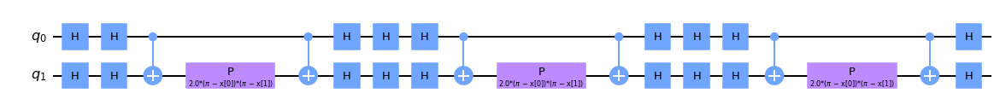


Quantum kernel matrices:



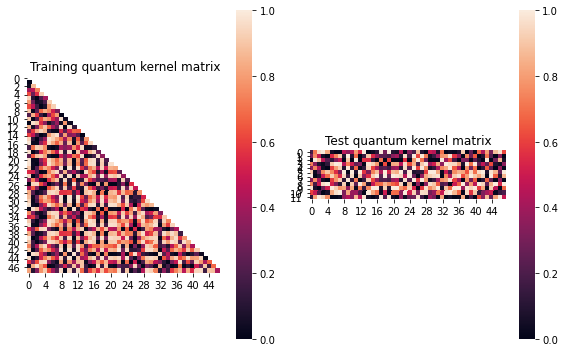


SVM with quantum kernel trained!


Test set performance:


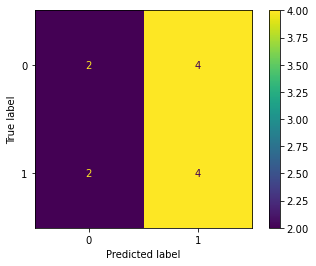

              precision    recall  f1-score   support

           0       0.50      0.33      0.40         6
           1       0.50      0.67      0.57         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.49        12
weighted avg       0.50      0.50      0.49        12


metric 1: 0.0030024471480464276
metric(s) 2: (00, 10, 11) = (0.5194729525883561, 0.5274296115848754, 0.5413911648774875)
metric 3: 0.0


----> Kernel construction duration: 00:01:32


Combination 317/468
(Current range: 41/46)
			 reps : 3
			 paulis : ['XY']
			 entanglement : linear

Feature map:


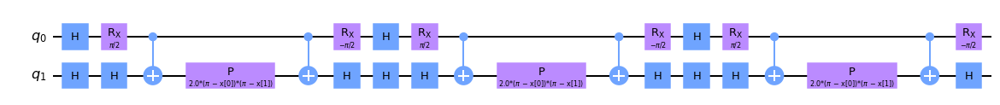


Quantum kernel matrices:



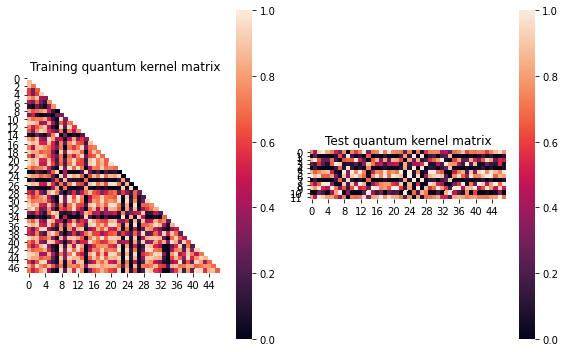


SVM with quantum kernel trained!


Test set performance:


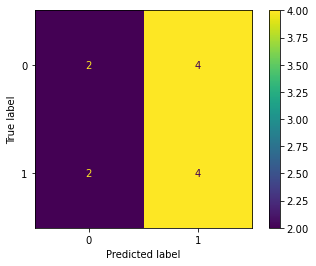

              precision    recall  f1-score   support

           0       0.50      0.33      0.40         6
           1       0.50      0.67      0.57         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.49        12
weighted avg       0.50      0.50      0.49        12


metric 1: 0.0024222979103671882
metric(s) 2: (00, 10, 11) = (0.5620589613656395, 0.550464529017958, 0.5437146924910108)
metric 3: 0.0


----> Kernel construction duration: 00:01:51


Combination 318/468
(Current range: 42/46)
			 reps : 3
			 paulis : ['XZ']
			 entanglement : linear

Feature map:


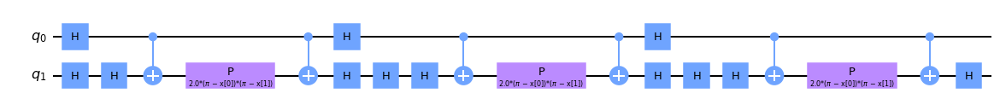


Quantum kernel matrices:



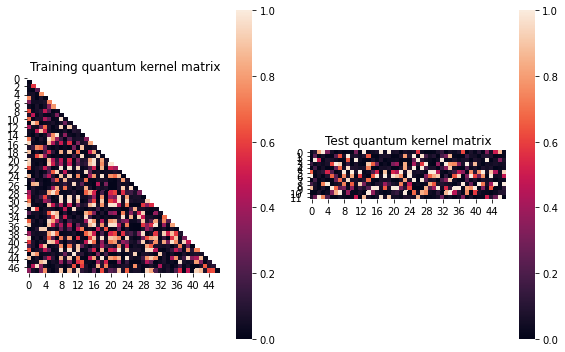


SVM with quantum kernel trained!


Test set performance:


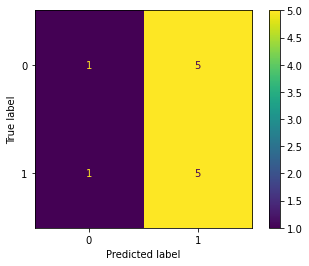

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.009528110897269626
metric(s) 2: (00, 10, 11) = (0.2820300729552216, 0.2813914002291677, 0.2998089492976531)
metric 3: 0.0


----> Kernel construction duration: 00:01:44


Combination 319/468
(Current range: 43/46)
			 reps : 3
			 paulis : ['YX']
			 entanglement : linear

Feature map:


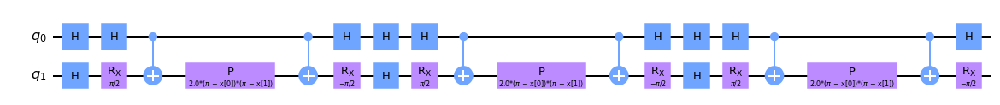


Quantum kernel matrices:



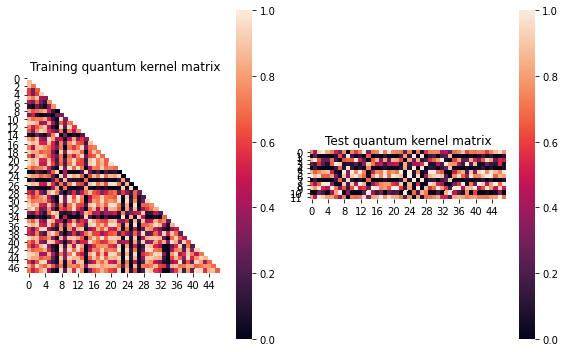


SVM with quantum kernel trained!


Test set performance:


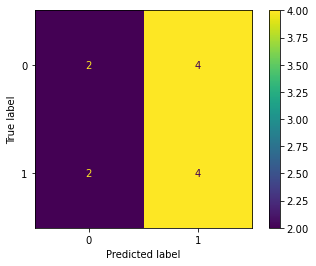

              precision    recall  f1-score   support

           0       0.50      0.33      0.40         6
           1       0.50      0.67      0.57         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.49        12
weighted avg       0.50      0.50      0.49        12


metric 1: 0.0024222979103671882
metric(s) 2: (00, 10, 11) = (0.5620589613656395, 0.550464529017958, 0.5437146924910108)
metric 3: 0.0


----> Kernel construction duration: 00:01:51


Combination 320/468
(Current range: 44/46)
			 reps : 3
			 paulis : ['YY']
			 entanglement : linear

Feature map:


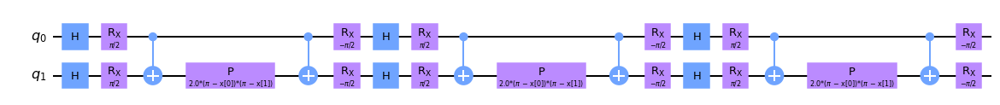


Quantum kernel matrices:



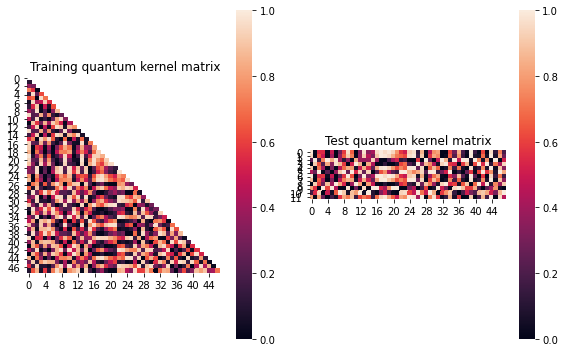


SVM with quantum kernel trained!


Test set performance:


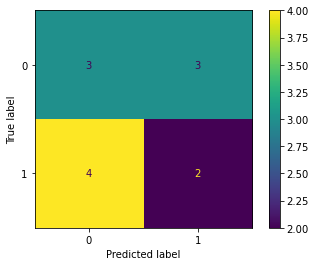

              precision    recall  f1-score   support

           0       0.43      0.50      0.46         6
           1       0.40      0.33      0.36         6

    accuracy                           0.42        12
   macro avg       0.41      0.42      0.41        12
weighted avg       0.41      0.42      0.41        12


metric 1: 0.01730890192141893
metric(s) 2: (00, 10, 11) = (0.4938575607783879, 0.48013029165421034, 0.5010208263728706)
metric 3: 0.0


----> Kernel construction duration: 00:02:08


Combination 321/468
(Current range: 45/46)
			 reps : 3
			 paulis : ['YZ']
			 entanglement : linear

Feature map:


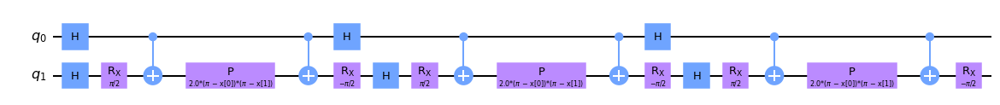


Quantum kernel matrices:



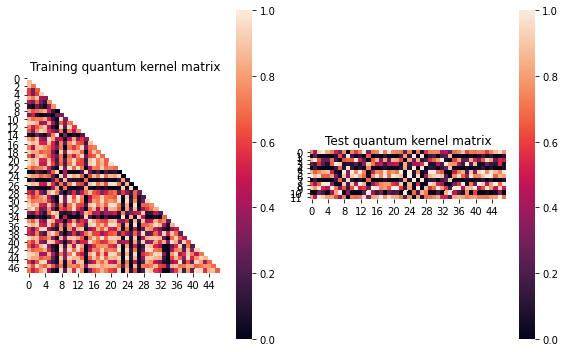


SVM with quantum kernel trained!


Test set performance:


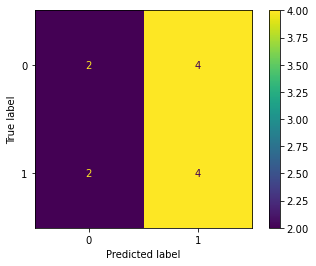

              precision    recall  f1-score   support

           0       0.50      0.33      0.40         6
           1       0.50      0.67      0.57         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.49        12
weighted avg       0.50      0.50      0.49        12


metric 1: 0.0024222979103671882
metric(s) 2: (00, 10, 11) = (0.5620589613656395, 0.550464529017958, 0.5437146924910108)
metric 3: 0.0


----> Kernel construction duration: 00:02:02


Combination 322/468
(Current range: 46/46)
			 reps : 3
			 paulis : ['ZX']
			 entanglement : linear

Feature map:


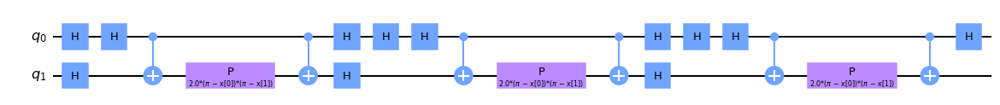


Quantum kernel matrices:



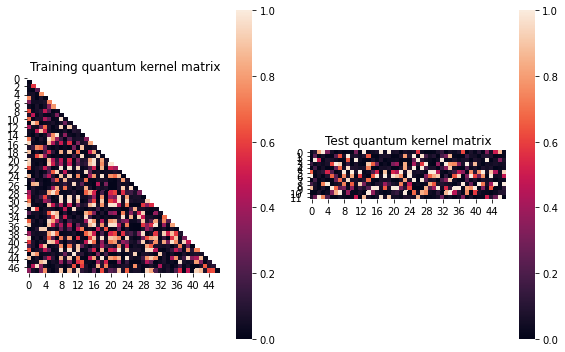


SVM with quantum kernel trained!


Test set performance:


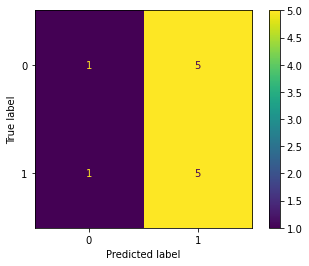

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.009528110897269626
metric(s) 2: (00, 10, 11) = (0.2820300729552216, 0.2813914002291677, 0.2998089492976531)
metric 3: 0.0


----> Kernel construction duration: 00:01:45


In [19]:
j=6
results.append(run_kernel_evaluation(X, X_train, y_train, X_test, y_test,
                                      param_grid, range_list, j, model=True))



Combination 323/468
(Current range: 1/46)
			 reps : 3
			 paulis : ['ZY']
			 entanglement : linear

Feature map:


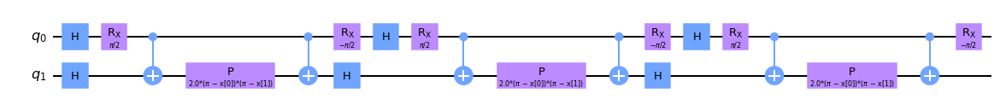


Quantum kernel matrices:



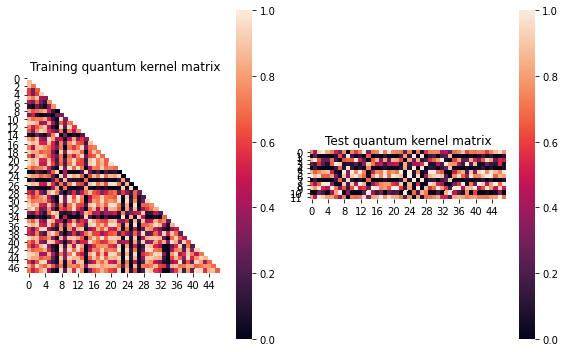


SVM with quantum kernel trained!


Test set performance:


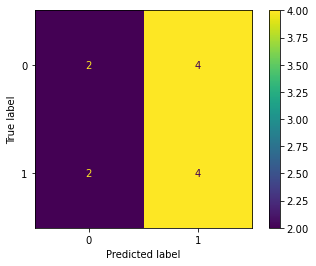

              precision    recall  f1-score   support

           0       0.50      0.33      0.40         6
           1       0.50      0.67      0.57         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.49        12
weighted avg       0.50      0.50      0.49        12


metric 1: 0.0024222979103671882
metric(s) 2: (00, 10, 11) = (0.5620589613656395, 0.550464529017958, 0.5437146924910108)
metric 3: 0.0


----> Kernel construction duration: 00:02:03


Combination 324/468
(Current range: 2/46)
			 reps : 3
			 paulis : ['ZZ']
			 entanglement : linear

Feature map:


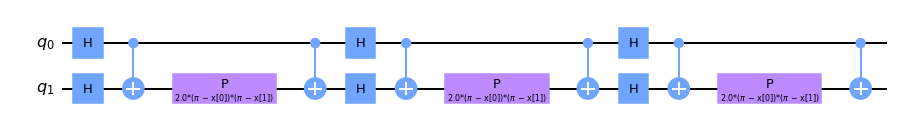


Quantum kernel matrices:



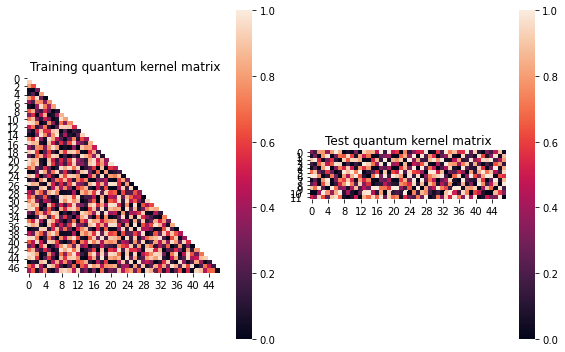


SVM with quantum kernel trained!


Test set performance:


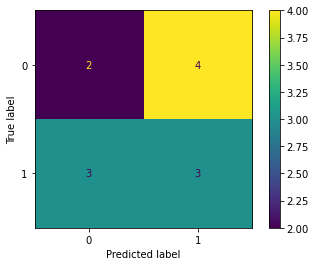

              precision    recall  f1-score   support

           0       0.40      0.33      0.36         6
           1       0.43      0.50      0.46         6

    accuracy                           0.42        12
   macro avg       0.41      0.42      0.41        12
weighted avg       0.41      0.42      0.41        12


metric 1: 0.005189231185427912
metric(s) 2: (00, 10, 11) = (0.49936335961957806, 0.494900756823733, 0.5008166163987438)
metric 3: 0.0


----> Kernel construction duration: 00:01:54


Combination 325/468
(Current range: 3/46)
			 reps : 3
			 paulis : ['X', 'X']
			 entanglement : linear

Feature map:


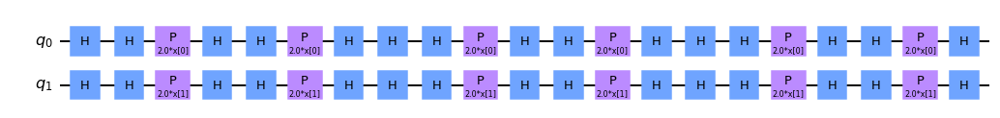


Quantum kernel matrices:



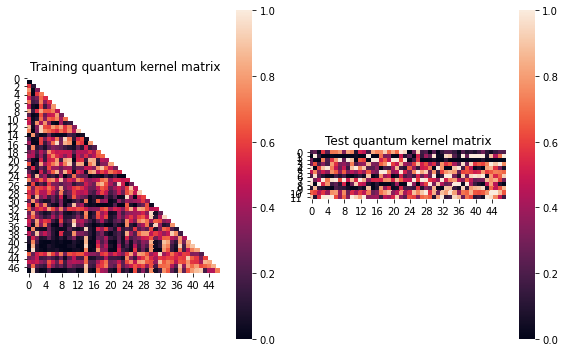


SVM with quantum kernel trained!


Test set performance:


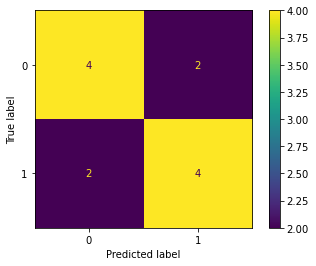

              precision    recall  f1-score   support

           0       0.67      0.67      0.67         6
           1       0.67      0.67      0.67         6

    accuracy                           0.67        12
   macro avg       0.67      0.67      0.67        12
weighted avg       0.67      0.67      0.67        12


metric 1: 0.1829073574463227
metric(s) 2: (00, 10, 11) = (0.45372092560218724, 0.30422133912734756, 0.5205364675451533)
metric 3: 9.194842259990365e-271


----> Kernel construction duration: 00:00:36


Combination 326/468
(Current range: 4/46)
			 reps : 3
			 paulis : ['X', 'Y']
			 entanglement : linear

Feature map:


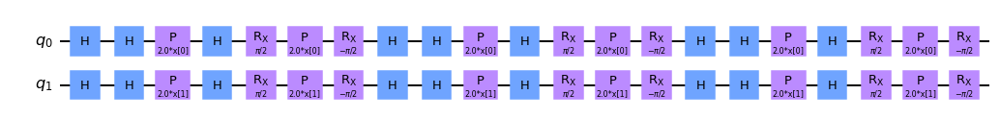


Quantum kernel matrices:



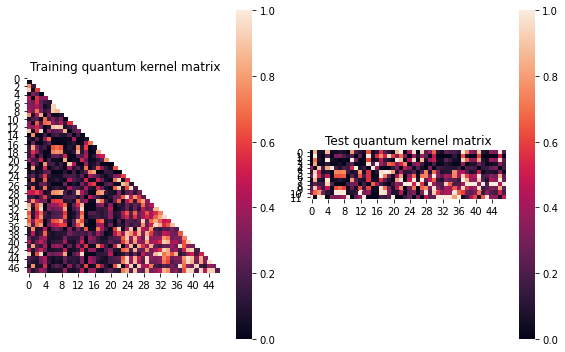


SVM with quantum kernel trained!


Test set performance:


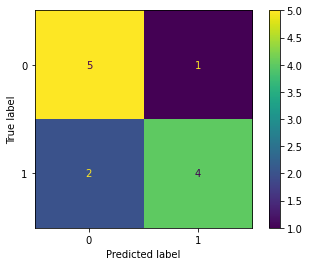

              precision    recall  f1-score   support

           0       0.71      0.83      0.77         6
           1       0.80      0.67      0.73         6

    accuracy                           0.75        12
   macro avg       0.76      0.75      0.75        12
weighted avg       0.76      0.75      0.75        12


metric 1: 0.141734840709966
metric(s) 2: (00, 10, 11) = (0.28553293561050935, 0.26048111282799513, 0.5188989714654129)
metric 3: 2.7187865976910278e-272


----> Kernel construction duration: 00:00:36


Combination 327/468
(Current range: 5/46)
			 reps : 3
			 paulis : ['X', 'Z']
			 entanglement : linear

Feature map:


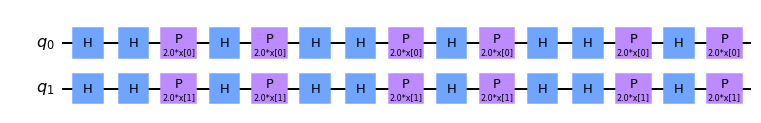


Quantum kernel matrices:



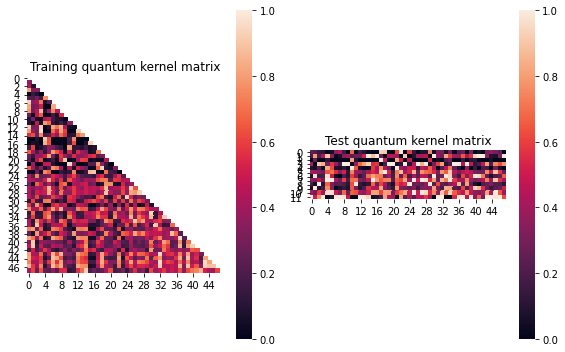


SVM with quantum kernel trained!


Test set performance:


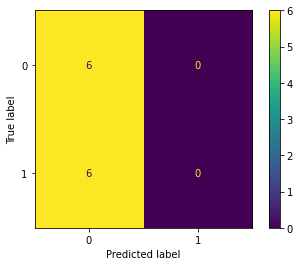

              precision    recall  f1-score   support

           0       0.50      1.00      0.67         6
           1       0.00      0.00      0.00         6

    accuracy                           0.50        12
   macro avg       0.25      0.50      0.33        12
weighted avg       0.25      0.50      0.33        12


metric 1: 0.02309349114853826
metric(s) 2: (00, 10, 11) = (0.34809879531700705, 0.40997979296353887, 0.5180477729071472)
metric 3: 2.2284985544858903e-285


----> Kernel construction duration: 00:00:35


Combination 328/468
(Current range: 6/46)
			 reps : 3
			 paulis : ['X', 'XX']
			 entanglement : linear

Feature map:


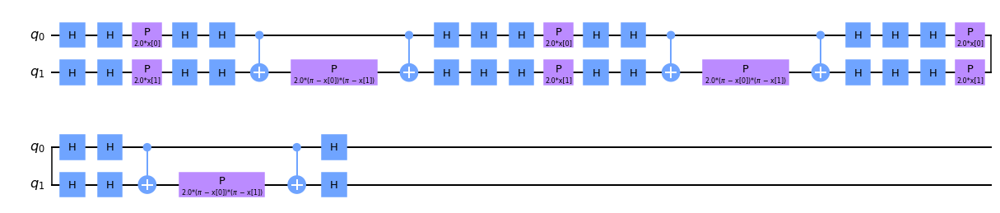


Quantum kernel matrices:



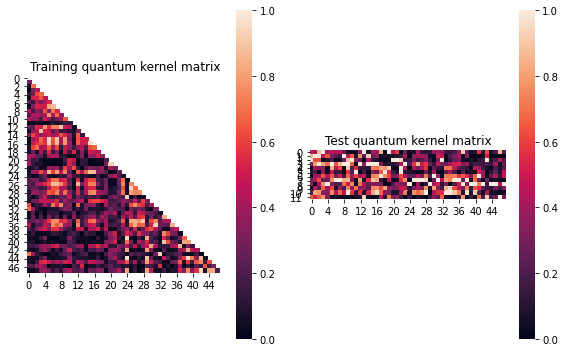


SVM with quantum kernel trained!


Test set performance:


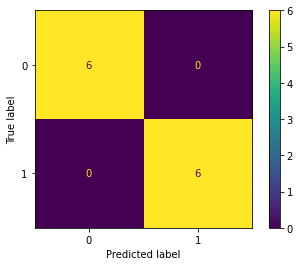

              precision    recall  f1-score   support

           0       1.00      1.00      1.00         6
           1       1.00      1.00      1.00         6

    accuracy                           1.00        12
   macro avg       1.00      1.00      1.00        12
weighted avg       1.00      1.00      1.00        12


metric 1: 0.12078912227428518
metric(s) 2: (00, 10, 11) = (0.3748516035493653, 0.248351635272397, 0.363429911543999)
metric 3: 1.2775692381540672e-255


----> Kernel construction duration: 00:01:58


Combination 329/468
(Current range: 7/46)
			 reps : 3
			 paulis : ['X', 'XY']
			 entanglement : linear

Feature map:


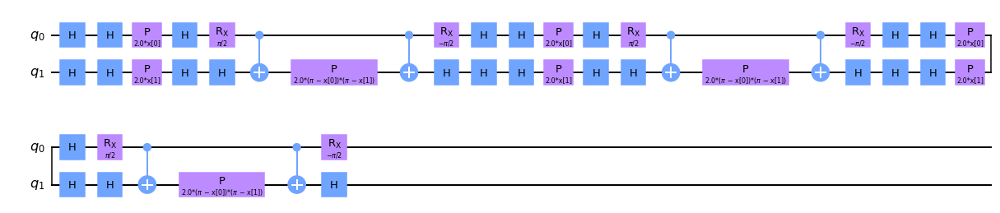


Quantum kernel matrices:



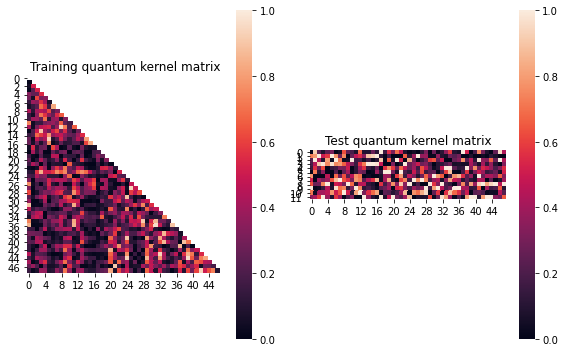


SVM with quantum kernel trained!


Test set performance:


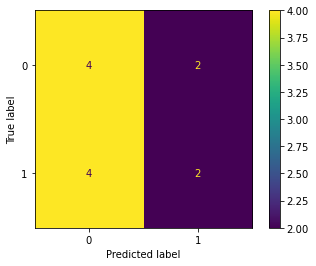

              precision    recall  f1-score   support

           0       0.50      0.67      0.57         6
           1       0.50      0.33      0.40         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.49        12
weighted avg       0.50      0.50      0.49        12


metric 1: 0.10090507908955001
metric(s) 2: (00, 10, 11) = (0.322351353774182, 0.24258318956020977, 0.36462518352533757)
metric 3: 4.28566450974514e-270


----> Kernel construction duration: 00:02:08


Combination 330/468
(Current range: 8/46)
			 reps : 3
			 paulis : ['X', 'XZ']
			 entanglement : linear

Feature map:


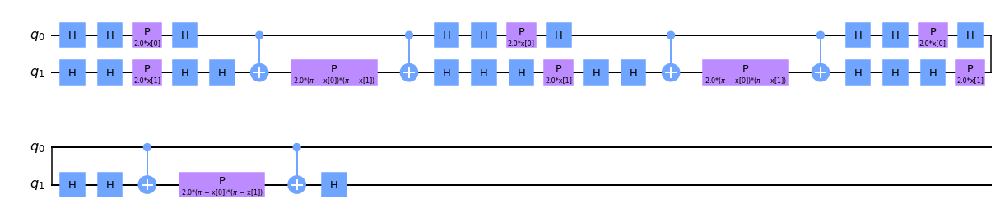


Quantum kernel matrices:



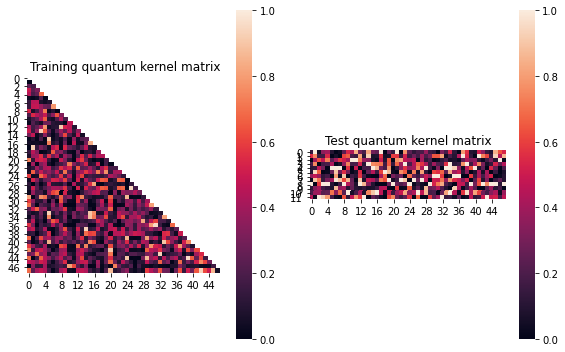


SVM with quantum kernel trained!


Test set performance:


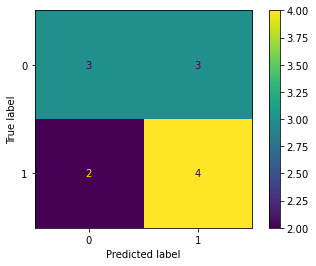

              precision    recall  f1-score   support

           0       0.60      0.50      0.55         6
           1       0.57      0.67      0.62         6

    accuracy                           0.58        12
   macro avg       0.59      0.58      0.58        12
weighted avg       0.59      0.58      0.58        12


metric 1: 0.0454083095144594
metric(s) 2: (00, 10, 11) = (0.3023809182297146, 0.2691938375653483, 0.3268233759299009)
metric 3: -7.198696970374727e-269


----> Kernel construction duration: 00:02:01


Combination 331/468
(Current range: 9/46)
			 reps : 3
			 paulis : ['X', 'YX']
			 entanglement : linear

Feature map:


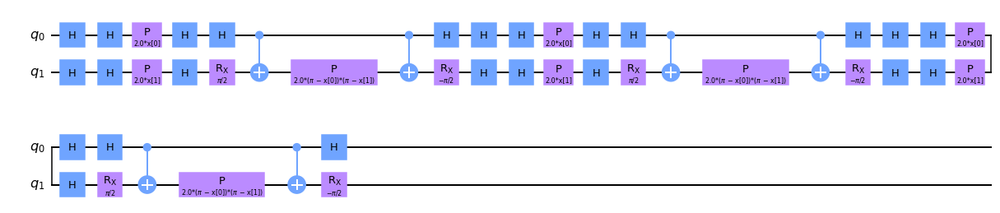


Quantum kernel matrices:



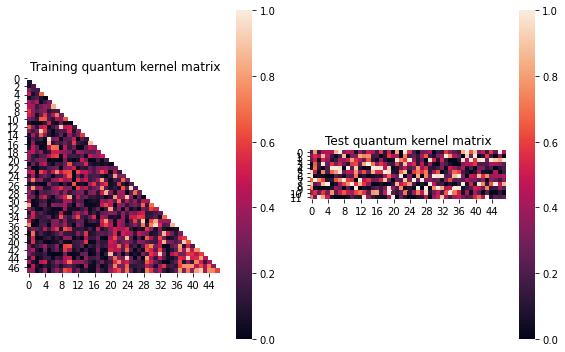


SVM with quantum kernel trained!


Test set performance:


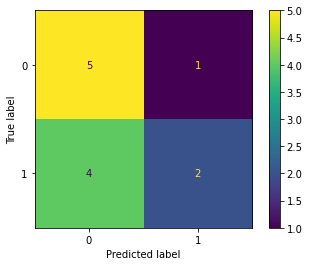

              precision    recall  f1-score   support

           0       0.56      0.83      0.67         6
           1       0.67      0.33      0.44         6

    accuracy                           0.58        12
   macro avg       0.61      0.58      0.56        12
weighted avg       0.61      0.58      0.56        12


metric 1: 0.1042362467218492
metric(s) 2: (00, 10, 11) = (0.3033781886064685, 0.23791974173766287, 0.38093378831255564)
metric 3: -6.5905217156291684e-257


----> Kernel construction duration: 00:02:08


Combination 332/468
(Current range: 10/46)
			 reps : 3
			 paulis : ['X', 'YY']
			 entanglement : linear

Feature map:


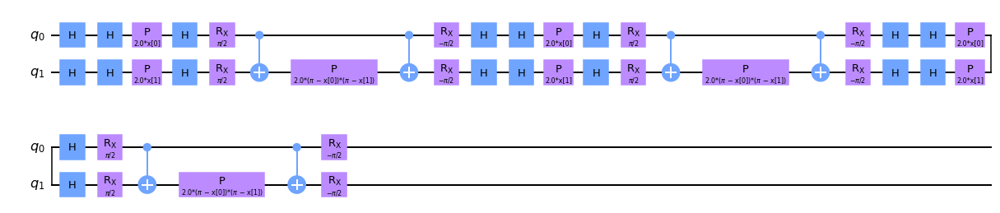


Quantum kernel matrices:



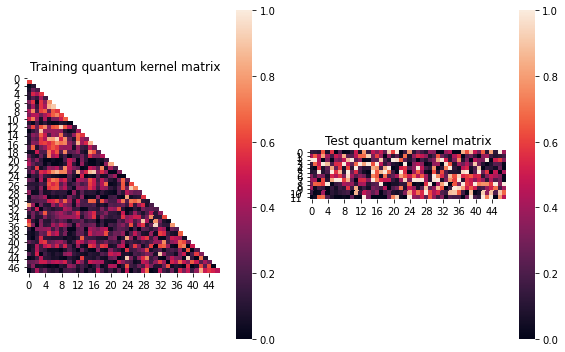


SVM with quantum kernel trained!


Test set performance:


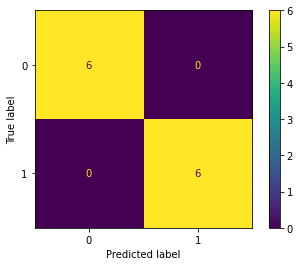

              precision    recall  f1-score   support

           0       1.00      1.00      1.00         6
           1       1.00      1.00      1.00         6

    accuracy                           1.00        12
   macro avg       1.00      1.00      1.00        12
weighted avg       1.00      1.00      1.00        12


metric 1: 0.12814381858786972
metric(s) 2: (00, 10, 11) = (0.37834903768358247, 0.22919955744574516, 0.33633771438364723)
metric 3: -4.994474955092435e-255


----> Kernel construction duration: 00:02:16


Combination 333/468
(Current range: 11/46)
			 reps : 3
			 paulis : ['X', 'YZ']
			 entanglement : linear

Feature map:


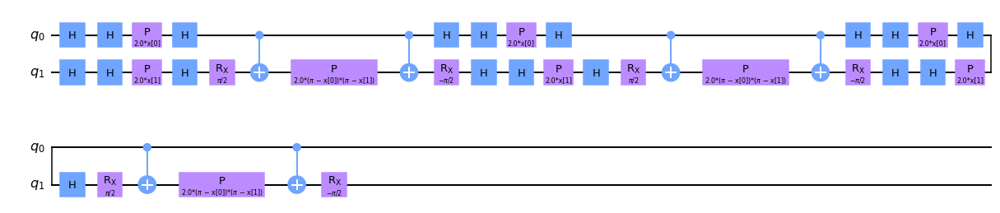


Quantum kernel matrices:



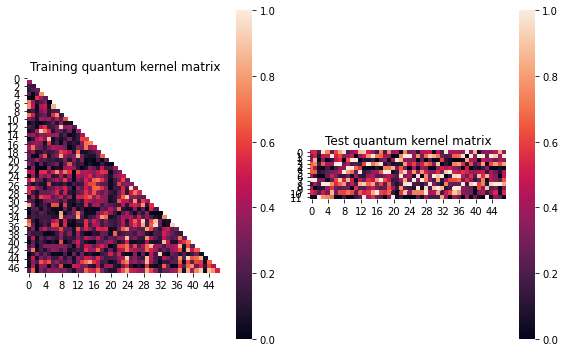


SVM with quantum kernel trained!


Test set performance:


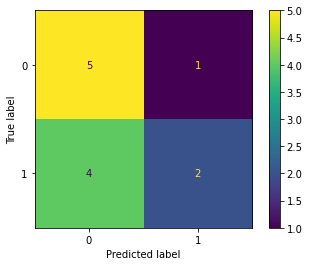

              precision    recall  f1-score   support

           0       0.56      0.83      0.67         6
           1       0.67      0.33      0.44         6

    accuracy                           0.58        12
   macro avg       0.61      0.58      0.56        12
weighted avg       0.61      0.58      0.56        12


metric 1: 0.07525499056299201
metric(s) 2: (00, 10, 11) = (0.30856038192128743, 0.27382490659529957, 0.38959941239529566)
metric 3: -6.90447231781373e-268


----> Kernel construction duration: 00:02:09


Combination 334/468
(Current range: 12/46)
			 reps : 3
			 paulis : ['X', 'ZX']
			 entanglement : linear

Feature map:


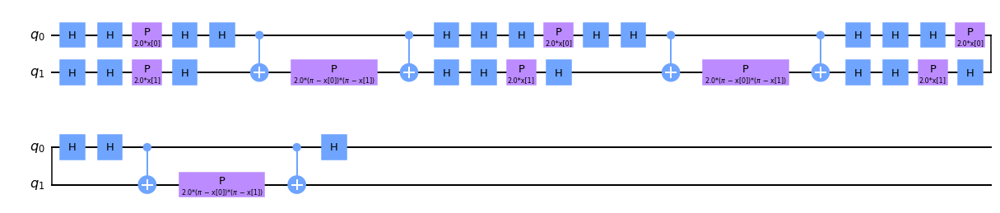


Quantum kernel matrices:



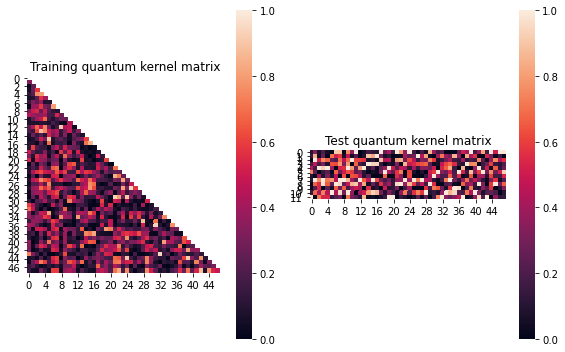


SVM with quantum kernel trained!


Test set performance:


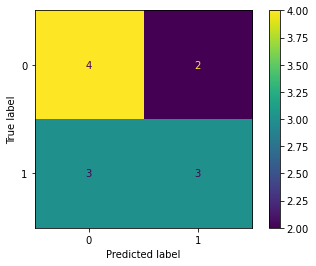

              precision    recall  f1-score   support

           0       0.57      0.67      0.62         6
           1       0.60      0.50      0.55         6

    accuracy                           0.58        12
   macro avg       0.59      0.58      0.58        12
weighted avg       0.59      0.58      0.58        12


metric 1: 0.03086401311314746
metric(s) 2: (00, 10, 11) = (0.31264773565261605, 0.27453098120591934, 0.29814225298551755)
metric 3: -2.0310479886539983e-269


----> Kernel construction duration: 00:02:00


Combination 335/468
(Current range: 13/46)
			 reps : 3
			 paulis : ['X', 'ZY']
			 entanglement : linear

Feature map:


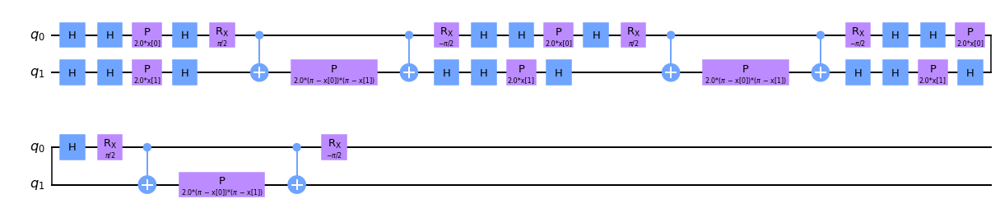


Quantum kernel matrices:



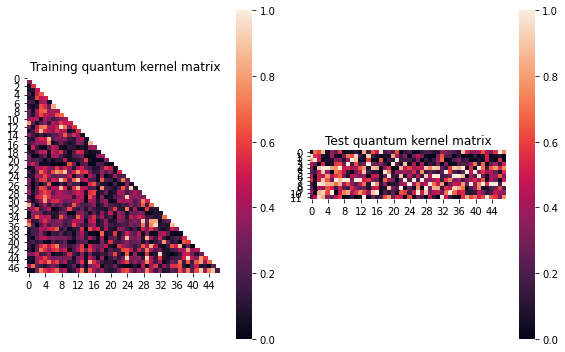


SVM with quantum kernel trained!


Test set performance:


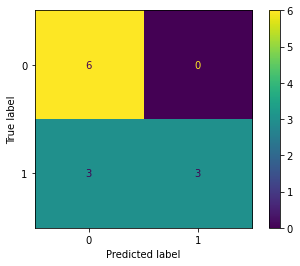

              precision    recall  f1-score   support

           0       0.67      1.00      0.80         6
           1       1.00      0.50      0.67         6

    accuracy                           0.75        12
   macro avg       0.83      0.75      0.73        12
weighted avg       0.83      0.75      0.73        12


metric 1: 0.06205522613666348
metric(s) 2: (00, 10, 11) = (0.32698492570435117, 0.28171752698538843, 0.3605605805397526)
metric 3: -4.787353210707444e-269


----> Kernel construction duration: 00:02:12


Combination 336/468
(Current range: 14/46)
			 reps : 3
			 paulis : ['X', 'ZZ']
			 entanglement : linear

Feature map:


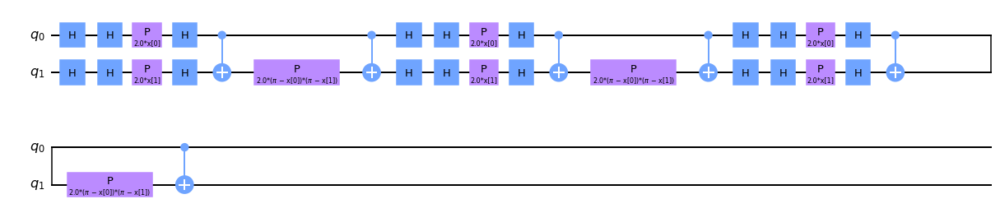


Quantum kernel matrices:



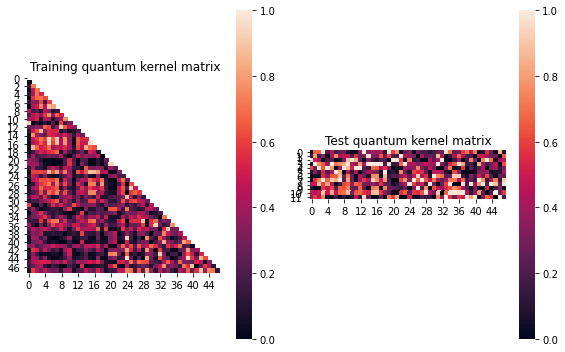


SVM with quantum kernel trained!


Test set performance:


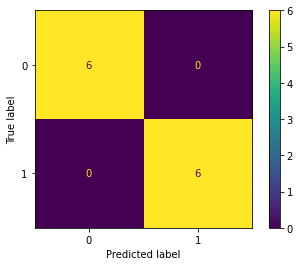

              precision    recall  f1-score   support

           0       1.00      1.00      1.00         6
           1       1.00      1.00      1.00         6

    accuracy                           1.00        12
   macro avg       1.00      1.00      1.00        12
weighted avg       1.00      1.00      1.00        12


metric 1: 0.11332074804768072
metric(s) 2: (00, 10, 11) = (0.3969805731298465, 0.2807494175763301, 0.3911597581181751)
metric 3: -1.905688681373032e-269


----> Kernel construction duration: 00:02:04


Combination 337/468
(Current range: 15/46)
			 reps : 3
			 paulis : ['Y', 'X']
			 entanglement : linear

Feature map:


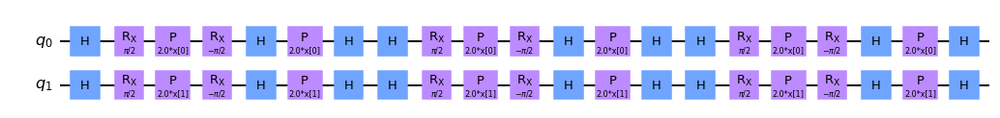


Quantum kernel matrices:



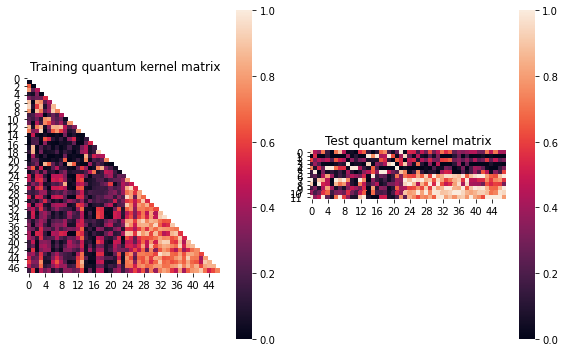


SVM with quantum kernel trained!


Test set performance:


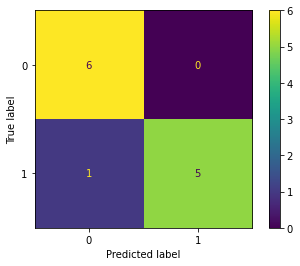

              precision    recall  f1-score   support

           0       0.86      1.00      0.92         6
           1       1.00      0.83      0.91         6

    accuracy                           0.92        12
   macro avg       0.93      0.92      0.92        12
weighted avg       0.93      0.92      0.92        12


metric 1: 0.23237441126675795
metric(s) 2: (00, 10, 11) = (0.2987867662568458, 0.26267352630414176, 0.6913091088849536)
metric 3: 1.6640529580397206e-257


----> Kernel construction duration: 00:00:37


Combination 338/468
(Current range: 16/46)
			 reps : 3
			 paulis : ['Y', 'Y']
			 entanglement : linear

Feature map:


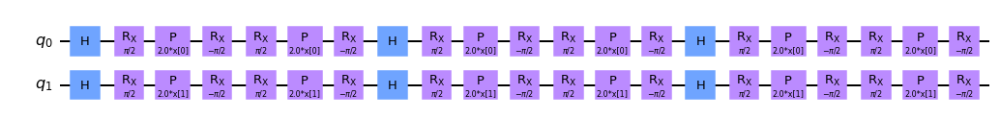


Quantum kernel matrices:



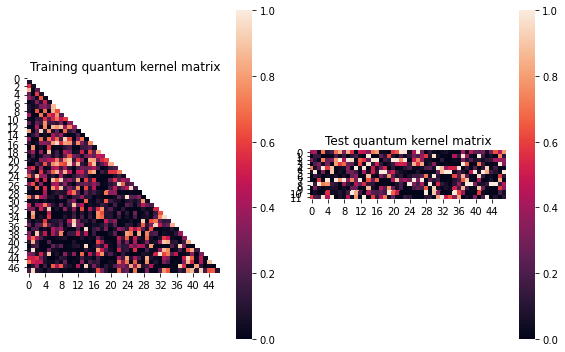


SVM with quantum kernel trained!


Test set performance:


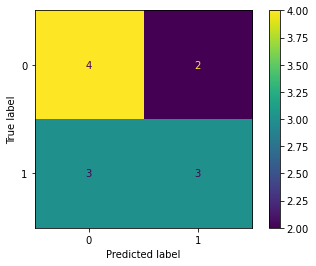

              precision    recall  f1-score   support

           0       0.57      0.67      0.62         6
           1       0.60      0.50      0.55         6

    accuracy                           0.58        12
   macro avg       0.59      0.58      0.58        12
weighted avg       0.59      0.58      0.58        12


metric 1: 0.12520236899511808
metric(s) 2: (00, 10, 11) = (0.34625427058798824, 0.19335182178741248, 0.29085411097707287)
metric 3: -3.95e-322


----> Kernel construction duration: 00:00:35


Combination 339/468
(Current range: 17/46)
			 reps : 3
			 paulis : ['Y', 'Z']
			 entanglement : linear

Feature map:


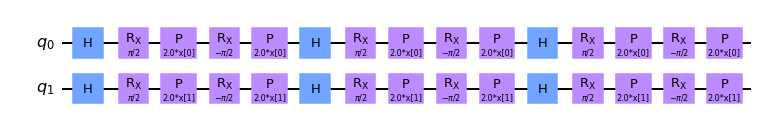


Quantum kernel matrices:



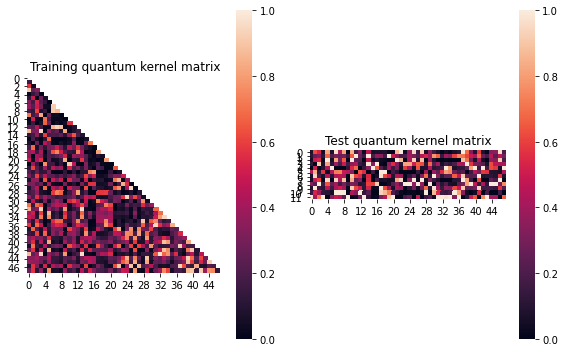


SVM with quantum kernel trained!


Test set performance:


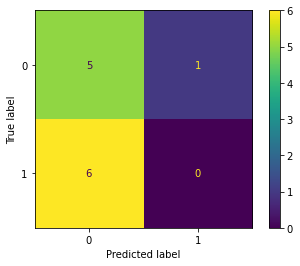

              precision    recall  f1-score   support

           0       0.45      0.83      0.59         6
           1       0.00      0.00      0.00         6

    accuracy                           0.42        12
   macro avg       0.23      0.42      0.29        12
weighted avg       0.23      0.42      0.29        12


metric 1: 0.03419443880426287
metric(s) 2: (00, 10, 11) = (0.265052746079593, 0.2809538239030489, 0.3652437793350306)
metric 3: -7.075230744223335e-271


----> Kernel construction duration: 00:00:38


Combination 340/468
(Current range: 18/46)
			 reps : 3
			 paulis : ['Y', 'XX']
			 entanglement : linear

Feature map:


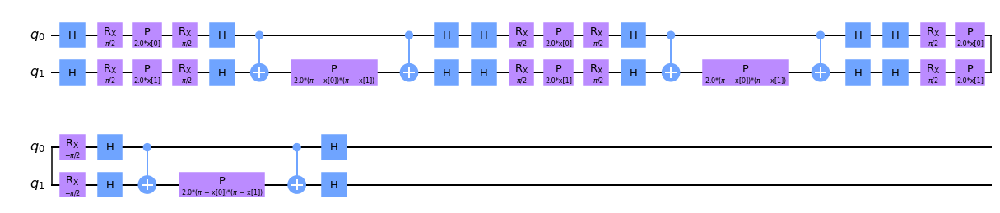


Quantum kernel matrices:



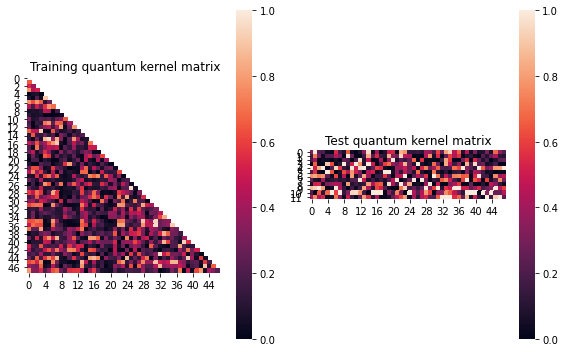


SVM with quantum kernel trained!


Test set performance:


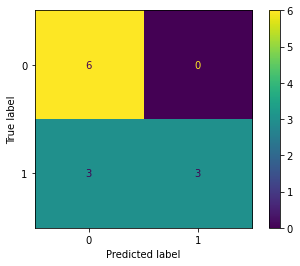

              precision    recall  f1-score   support

           0       0.67      1.00      0.80         6
           1       1.00      0.50      0.67         6

    accuracy                           0.75        12
   macro avg       0.83      0.75      0.73        12
weighted avg       0.83      0.75      0.73        12


metric 1: 0.04890195577817186
metric(s) 2: (00, 10, 11) = (0.3009427392428187, 0.2757732739379973, 0.3484077201895196)
metric 3: 1.2106274638701689e-270


----> Kernel construction duration: 00:02:17


Combination 341/468
(Current range: 19/46)
			 reps : 3
			 paulis : ['Y', 'XY']
			 entanglement : linear

Feature map:


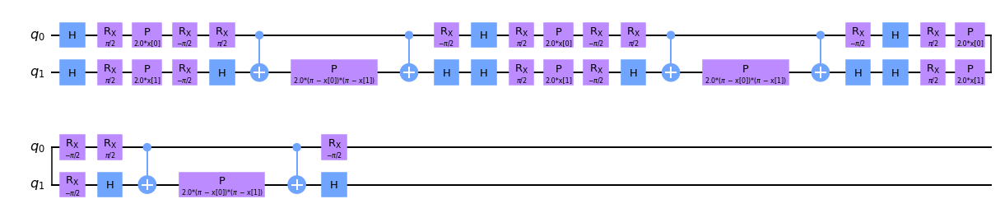


Quantum kernel matrices:



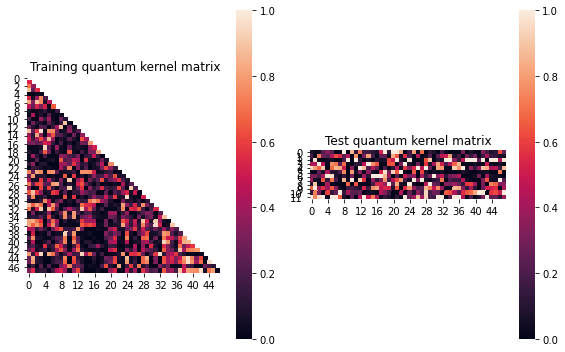


SVM with quantum kernel trained!


Test set performance:


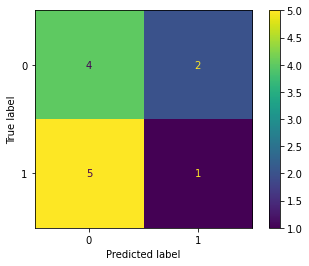

              precision    recall  f1-score   support

           0       0.44      0.67      0.53         6
           1       0.33      0.17      0.22         6

    accuracy                           0.42        12
   macro avg       0.39      0.42      0.38        12
weighted avg       0.39      0.42      0.38        12


metric 1: 0.07396737016124336
metric(s) 2: (00, 10, 11) = (0.2735784931094062, 0.24437448639869933, 0.3631052200104792)
metric 3: 2.014404e-318


----> Kernel construction duration: 00:02:16


Combination 342/468
(Current range: 20/46)
			 reps : 3
			 paulis : ['Y', 'XZ']
			 entanglement : linear

Feature map:


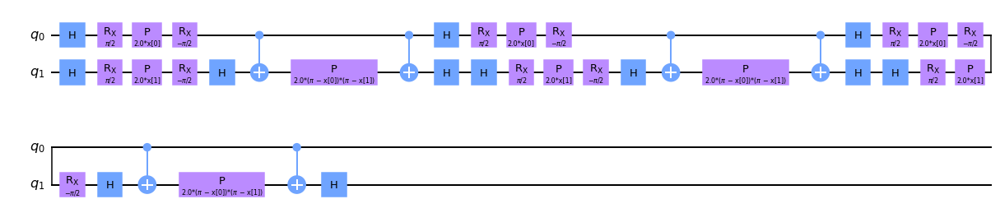


Quantum kernel matrices:



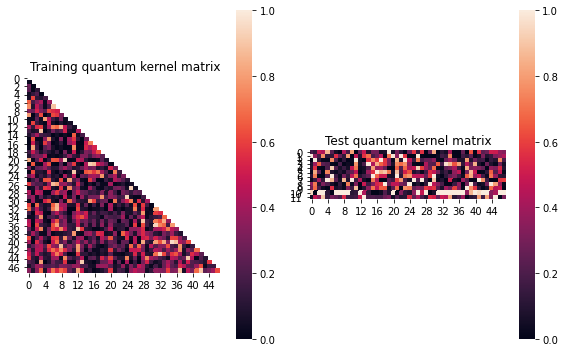


SVM with quantum kernel trained!


Test set performance:


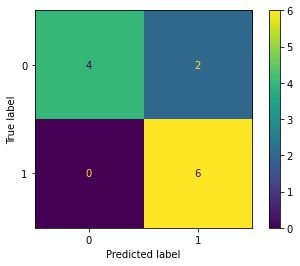

              precision    recall  f1-score   support

           0       1.00      0.67      0.80         6
           1       0.75      1.00      0.86         6

    accuracy                           0.83        12
   macro avg       0.88      0.83      0.83        12
weighted avg       0.88      0.83      0.83        12


metric 1: 0.06318877218206981
metric(s) 2: (00, 10, 11) = (0.2888763125336744, 0.2576457315225627, 0.3527926948755906)
metric 3: 1.123573074136124e-255


----> Kernel construction duration: 00:02:21


Combination 343/468
(Current range: 21/46)
			 reps : 3
			 paulis : ['Y', 'YX']
			 entanglement : linear

Feature map:


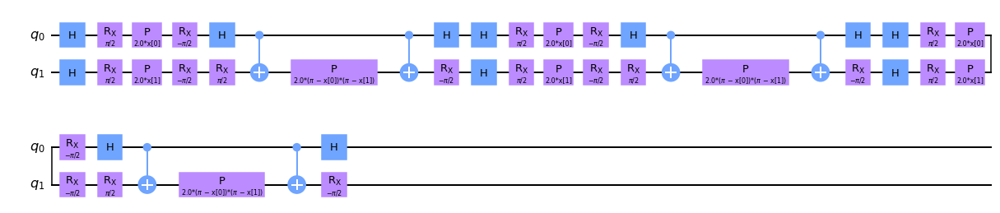


Quantum kernel matrices:



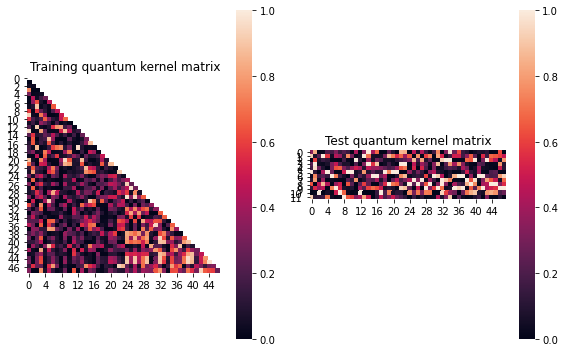


SVM with quantum kernel trained!


Test set performance:


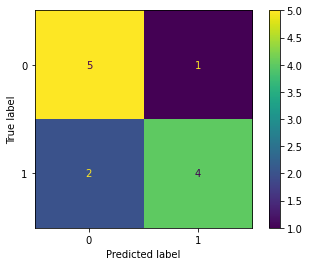

              precision    recall  f1-score   support

           0       0.71      0.83      0.77         6
           1       0.80      0.67      0.73         6

    accuracy                           0.75        12
   macro avg       0.76      0.75      0.75        12
weighted avg       0.76      0.75      0.75        12


metric 1: 0.1494563323070268
metric(s) 2: (00, 10, 11) = (0.2826525216685565, 0.21441017485837857, 0.44508049266225425)
metric 3: -3.3157452511581164e-304


----> Kernel construction duration: 00:02:33


Combination 344/468
(Current range: 22/46)
			 reps : 3
			 paulis : ['Y', 'YY']
			 entanglement : linear

Feature map:


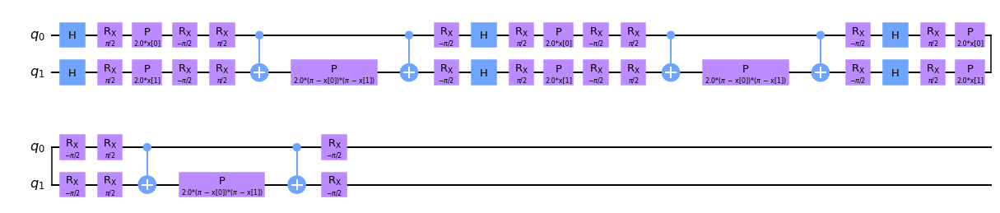


Quantum kernel matrices:



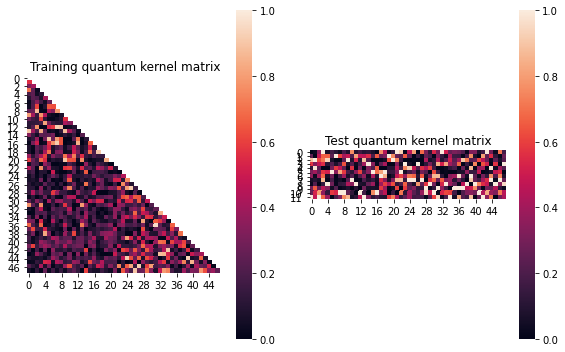


SVM with quantum kernel trained!


Test set performance:


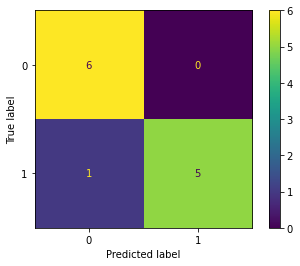

              precision    recall  f1-score   support

           0       0.86      1.00      0.92         6
           1       1.00      0.83      0.91         6

    accuracy                           0.92        12
   macro avg       0.93      0.92      0.92        12
weighted avg       0.93      0.92      0.92        12


metric 1: 0.1201323759039844
metric(s) 2: (00, 10, 11) = (0.2894744527589736, 0.19722860970974876, 0.3452475184684927)
metric 3: 3.0856046607738535e-273


----> Kernel construction duration: 00:02:11


Combination 345/468
(Current range: 23/46)
			 reps : 3
			 paulis : ['Y', 'YZ']
			 entanglement : linear

Feature map:


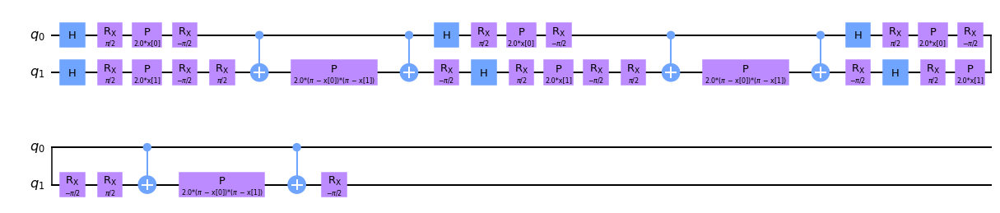


Quantum kernel matrices:



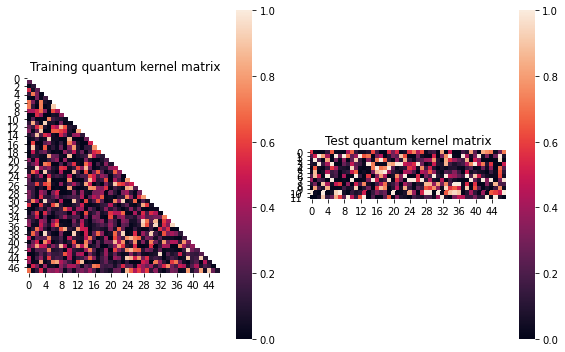


SVM with quantum kernel trained!


Test set performance:


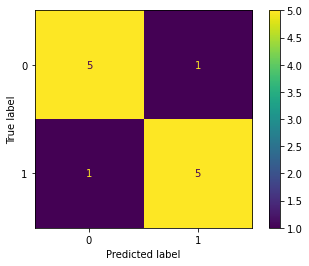

              precision    recall  f1-score   support

           0       0.83      0.83      0.83         6
           1       0.83      0.83      0.83         6

    accuracy                           0.83        12
   macro avg       0.83      0.83      0.83        12
weighted avg       0.83      0.83      0.83        12


metric 1: 0.059804544677563826
metric(s) 2: (00, 10, 11) = (0.2835119145144891, 0.24263277394085334, 0.3213627227223452)
metric 3: -2.153289454879781e-304


----> Kernel construction duration: 00:02:16


Combination 346/468
(Current range: 24/46)
			 reps : 3
			 paulis : ['Y', 'ZX']
			 entanglement : linear

Feature map:


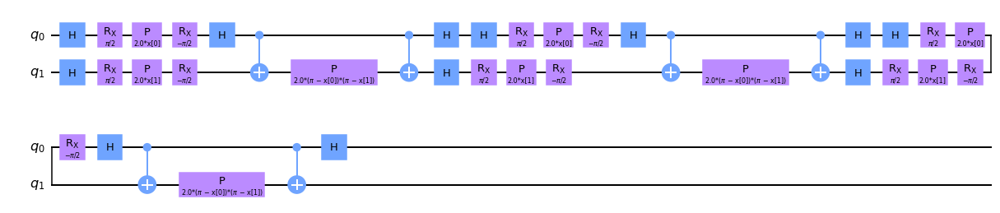


Quantum kernel matrices:



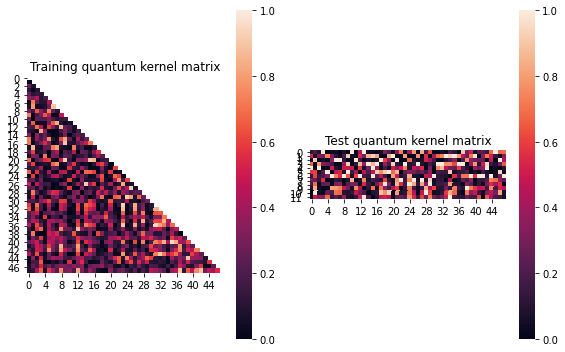


SVM with quantum kernel trained!


Test set performance:


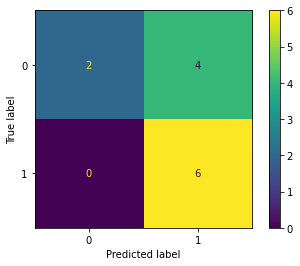

              precision    recall  f1-score   support

           0       1.00      0.33      0.50         6
           1       0.60      1.00      0.75         6

    accuracy                           0.67        12
   macro avg       0.80      0.67      0.62        12
weighted avg       0.80      0.67      0.62        12


metric 1: 0.05816278361953686
metric(s) 2: (00, 10, 11) = (0.28762097827313465, 0.25983928463283645, 0.348383158231612)
metric 3: -3.2112067275409835e-256


----> Kernel construction duration: 00:02:19


Combination 347/468
(Current range: 25/46)
			 reps : 3
			 paulis : ['Y', 'ZY']
			 entanglement : linear

Feature map:


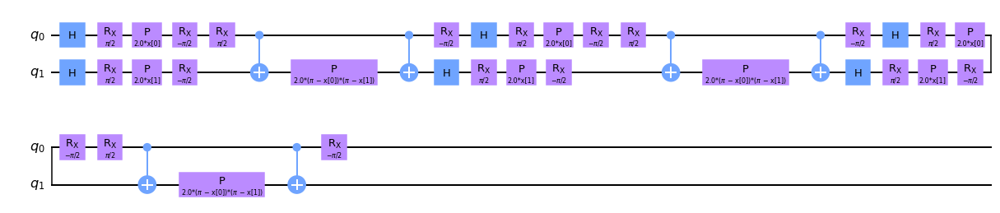


Quantum kernel matrices:



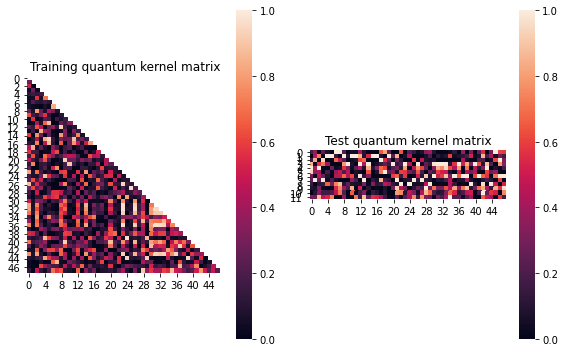


SVM with quantum kernel trained!


Test set performance:


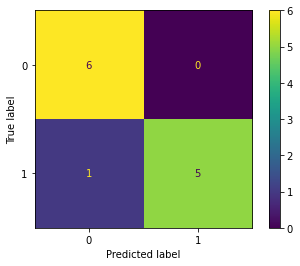

              precision    recall  f1-score   support

           0       0.86      1.00      0.92         6
           1       1.00      0.83      0.91         6

    accuracy                           0.92        12
   macro avg       0.93      0.92      0.92        12
weighted avg       0.93      0.92      0.92        12


metric 1: 0.06980859035936748
metric(s) 2: (00, 10, 11) = (0.27030504577513614, 0.2533129662350164, 0.37593806741363167)
metric 3: 9.587314506023463e-292


----> Kernel construction duration: 00:02:15


Combination 348/468
(Current range: 26/46)
			 reps : 3
			 paulis : ['Y', 'ZZ']
			 entanglement : linear

Feature map:


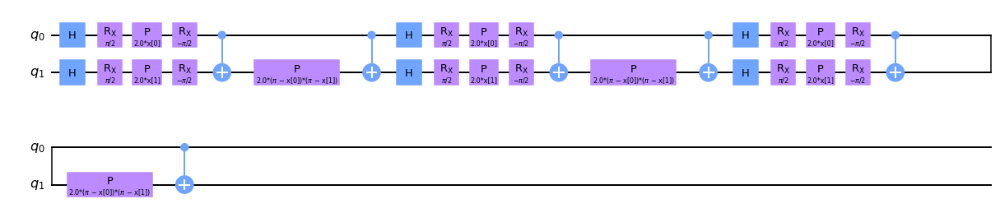


Quantum kernel matrices:



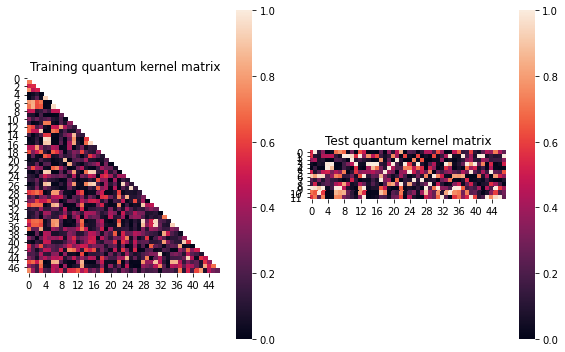


SVM with quantum kernel trained!


Test set performance:


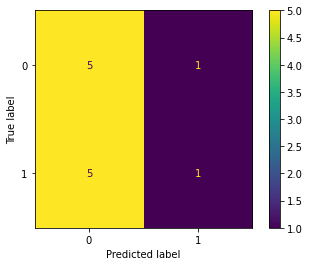

              precision    recall  f1-score   support

           0       0.50      0.83      0.62         6
           1       0.50      0.17      0.25         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.029856950982269204
metric(s) 2: (00, 10, 11) = (0.30372396193659523, 0.2736004845131558, 0.3031909090542547)
metric 3: 1.6712565643943722e-284


----> Kernel construction duration: 00:02:17


Combination 349/468
(Current range: 27/46)
			 reps : 3
			 paulis : ['Z', 'X']
			 entanglement : linear

Feature map:


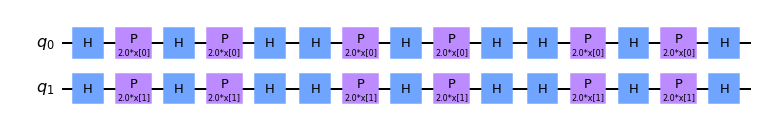


Quantum kernel matrices:



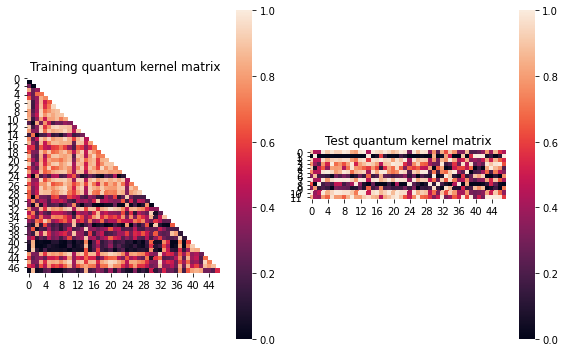


SVM with quantum kernel trained!


Test set performance:


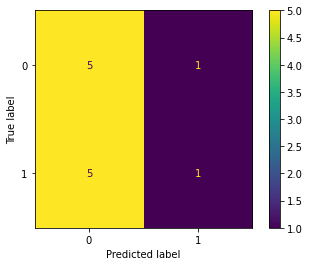

              precision    recall  f1-score   support

           0       0.50      0.83      0.62         6
           1       0.50      0.17      0.25         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.08216762818521817
metric(s) 2: (00, 10, 11) = (0.6527846223791625, 0.47080916889427626, 0.4531689717798264)
metric 3: 0.0


----> Kernel construction duration: 00:00:35


Combination 350/468
(Current range: 28/46)
			 reps : 3
			 paulis : ['Z', 'Y']
			 entanglement : linear

Feature map:


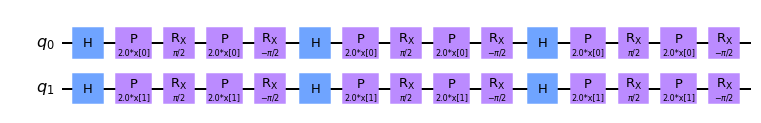


Quantum kernel matrices:



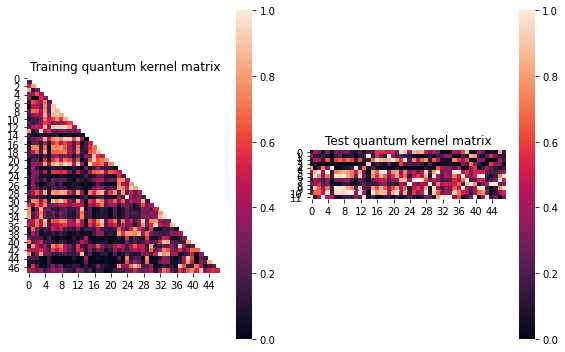


SVM with quantum kernel trained!


Test set performance:


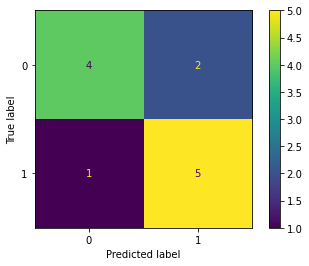

              precision    recall  f1-score   support

           0       0.80      0.67      0.73         6
           1       0.71      0.83      0.77         6

    accuracy                           0.75        12
   macro avg       0.76      0.75      0.75        12
weighted avg       0.76      0.75      0.75        12


metric 1: 0.15734254172808
metric(s) 2: (00, 10, 11) = (0.4411816239600613, 0.25876276103713697, 0.39102898157037264)
metric 3: 3.1869560718062855e-283


----> Kernel construction duration: 00:00:39


Combination 351/468
(Current range: 29/46)
			 reps : 3
			 paulis : ['Z', 'Z']
			 entanglement : linear

Feature map:


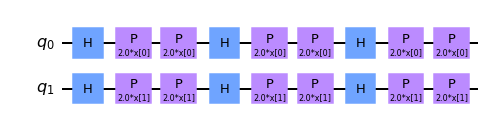


Quantum kernel matrices:



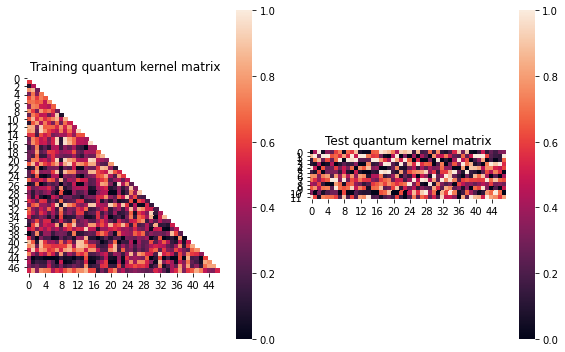


SVM with quantum kernel trained!


Test set performance:


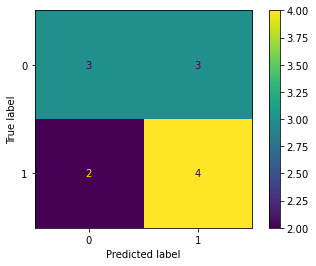

              precision    recall  f1-score   support

           0       0.60      0.50      0.55         6
           1       0.57      0.67      0.62         6

    accuracy                           0.58        12
   macro avg       0.59      0.58      0.58        12
weighted avg       0.59      0.58      0.58        12


metric 1: 0.11220428995108406
metric(s) 2: (00, 10, 11) = (0.5441407666276521, 0.3755610315178469, 0.43138987631020986)
metric 3: 2.950433001442558e-294


----> Kernel construction duration: 00:00:35


Combination 352/468
(Current range: 30/46)
			 reps : 3
			 paulis : ['Z', 'XX']
			 entanglement : linear

Feature map:


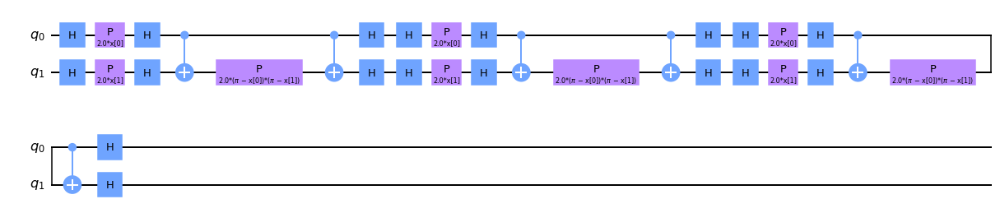


Quantum kernel matrices:



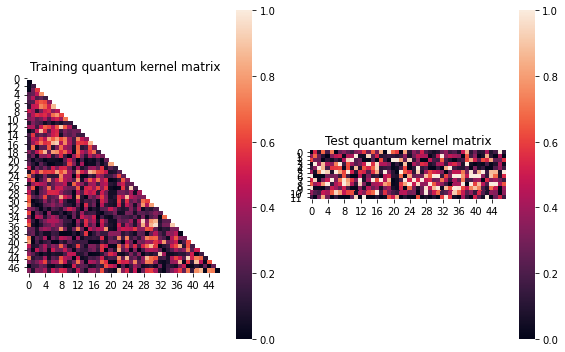


SVM with quantum kernel trained!


Test set performance:


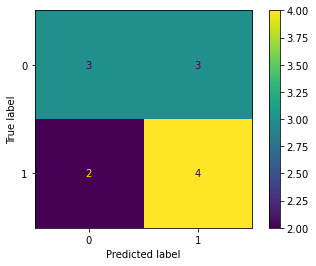

              precision    recall  f1-score   support

           0       0.60      0.50      0.55         6
           1       0.57      0.67      0.62         6

    accuracy                           0.58        12
   macro avg       0.59      0.58      0.58        12
weighted avg       0.59      0.58      0.58        12


metric 1: 0.112402343917413
metric(s) 2: (00, 10, 11) = (0.389098987237238, 0.2648190254280988, 0.3653437514537856)
metric 3: -4.1240571040191684e-255


----> Kernel construction duration: 00:02:08


Combination 353/468
(Current range: 31/46)
			 reps : 3
			 paulis : ['Z', 'XY']
			 entanglement : linear

Feature map:


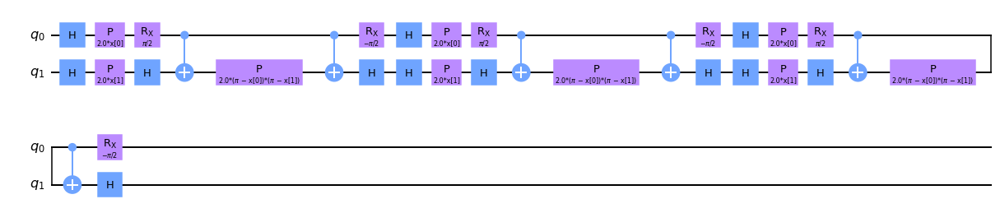


Quantum kernel matrices:



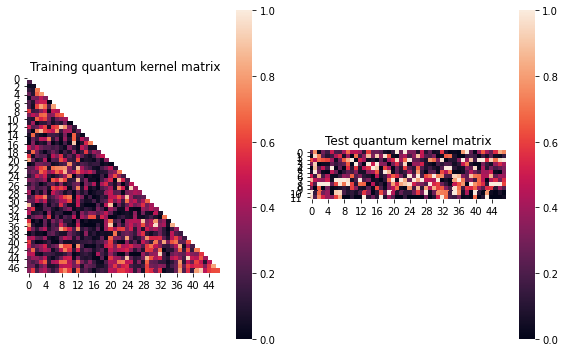


SVM with quantum kernel trained!


Test set performance:


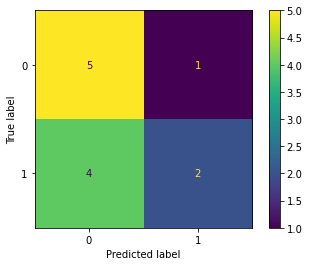

              precision    recall  f1-score   support

           0       0.56      0.83      0.67         6
           1       0.67      0.33      0.44         6

    accuracy                           0.58        12
   macro avg       0.61      0.58      0.56        12
weighted avg       0.61      0.58      0.56        12


metric 1: 0.10388116353397031
metric(s) 2: (00, 10, 11) = (0.3309887580792385, 0.25068193462311655, 0.3781374382349352)
metric 3: -5.1042934809477385e-269


----> Kernel construction duration: 00:02:15


Combination 354/468
(Current range: 32/46)
			 reps : 3
			 paulis : ['Z', 'XZ']
			 entanglement : linear

Feature map:


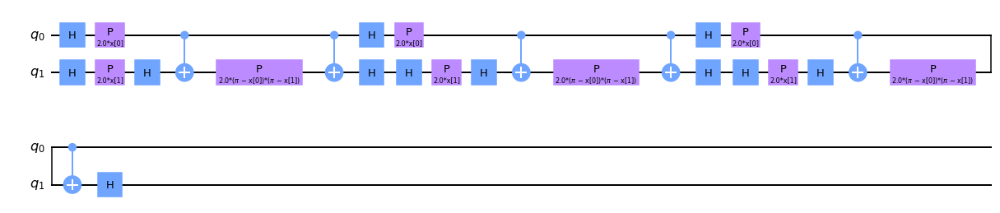


Quantum kernel matrices:



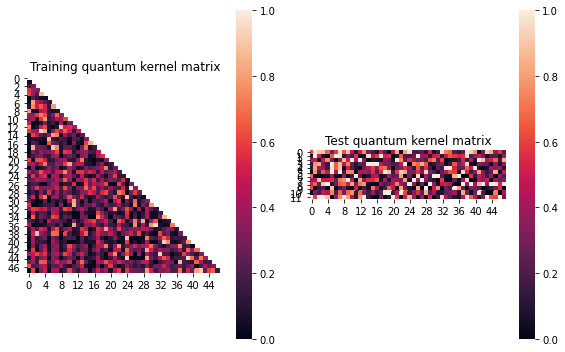


SVM with quantum kernel trained!


Test set performance:


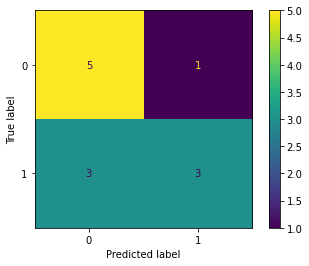

              precision    recall  f1-score   support

           0       0.62      0.83      0.71         6
           1       0.75      0.50      0.60         6

    accuracy                           0.67        12
   macro avg       0.69      0.67      0.66        12
weighted avg       0.69      0.67      0.66        12


metric 1: 0.06558813739394898
metric(s) 2: (00, 10, 11) = (0.34222939253973245, 0.2711518621672865, 0.33125060658273847)
metric 3: 1.674789116113718e-268


----> Kernel construction duration: 00:02:05


Combination 355/468
(Current range: 33/46)
			 reps : 3
			 paulis : ['Z', 'YX']
			 entanglement : linear

Feature map:


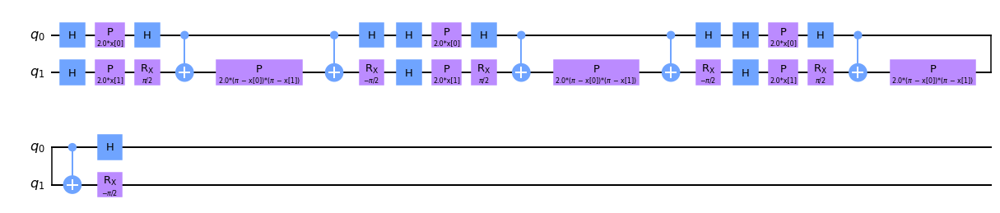


Quantum kernel matrices:



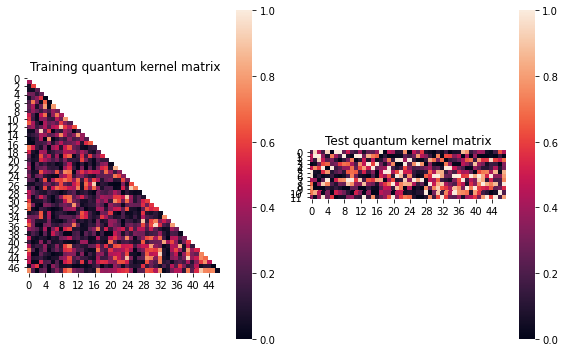


SVM with quantum kernel trained!


Test set performance:


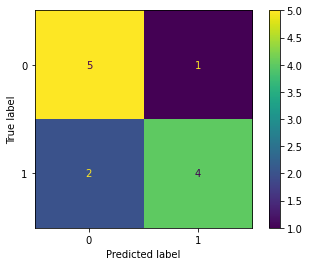

              precision    recall  f1-score   support

           0       0.71      0.83      0.77         6
           1       0.80      0.67      0.73         6

    accuracy                           0.75        12
   macro avg       0.76      0.75      0.75        12
weighted avg       0.76      0.75      0.75        12


metric 1: 0.08982344055929475
metric(s) 2: (00, 10, 11) = (0.3187867900875701, 0.2504565529234036, 0.3617731968778265)
metric 3: -5.2966838599617054e-269


----> Kernel construction duration: 00:02:14


Combination 356/468
(Current range: 34/46)
			 reps : 3
			 paulis : ['Z', 'YY']
			 entanglement : linear

Feature map:


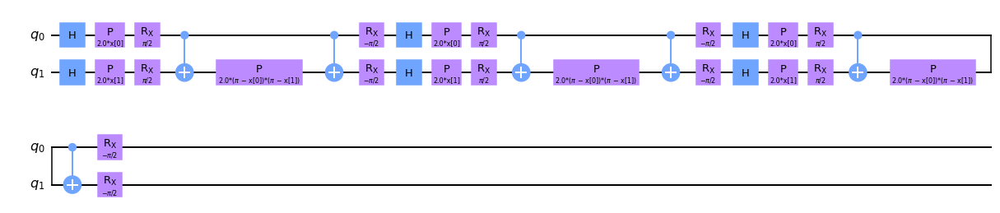


Quantum kernel matrices:



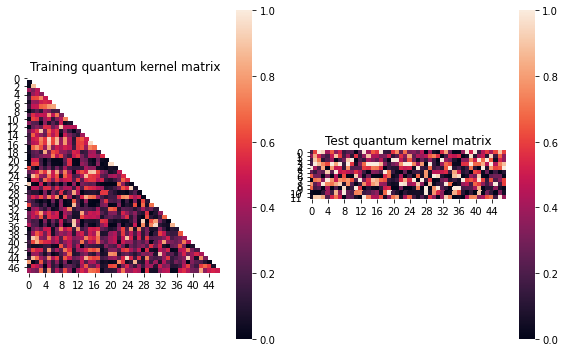


SVM with quantum kernel trained!


Test set performance:


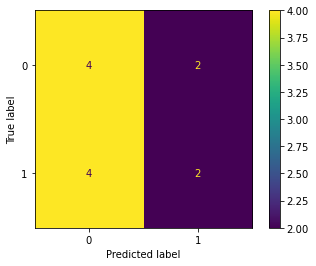

              precision    recall  f1-score   support

           0       0.50      0.67      0.57         6
           1       0.50      0.33      0.40         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.49        12
weighted avg       0.50      0.50      0.49        12


metric 1: 0.04812163964291488
metric(s) 2: (00, 10, 11) = (0.39850035504550996, 0.3214883083518571, 0.34071954094403406)
metric 3: 5.957106217854763e-270


----> Kernel construction duration: 00:02:19


Combination 357/468
(Current range: 35/46)
			 reps : 3
			 paulis : ['Z', 'YZ']
			 entanglement : linear

Feature map:


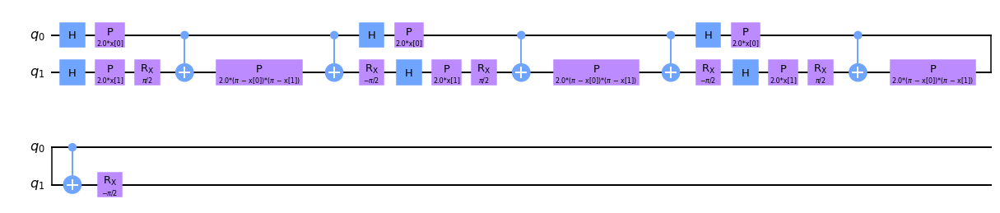


Quantum kernel matrices:



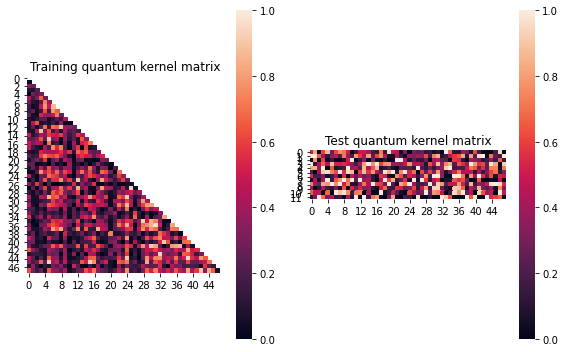


SVM with quantum kernel trained!


Test set performance:


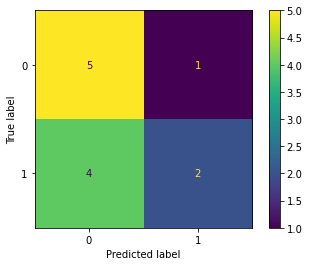

              precision    recall  f1-score   support

           0       0.56      0.83      0.67         6
           1       0.67      0.33      0.44         6

    accuracy                           0.58        12
   macro avg       0.61      0.58      0.56        12
weighted avg       0.61      0.58      0.56        12


metric 1: 0.09535321659081775
metric(s) 2: (00, 10, 11) = (0.33788481243842194, 0.28155125143716764, 0.4159241236175488)
metric 3: -2.0613340333582149e-268


----> Kernel construction duration: 00:02:11


Combination 358/468
(Current range: 36/46)
			 reps : 3
			 paulis : ['Z', 'ZX']
			 entanglement : linear

Feature map:


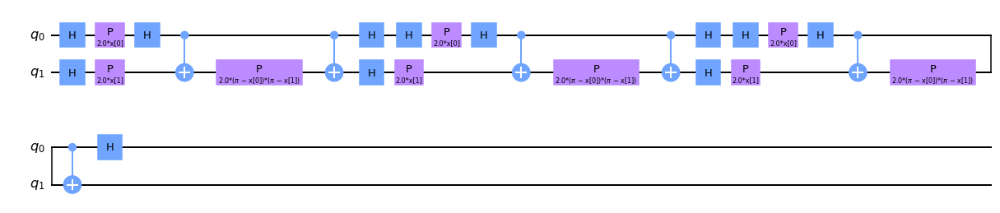


Quantum kernel matrices:



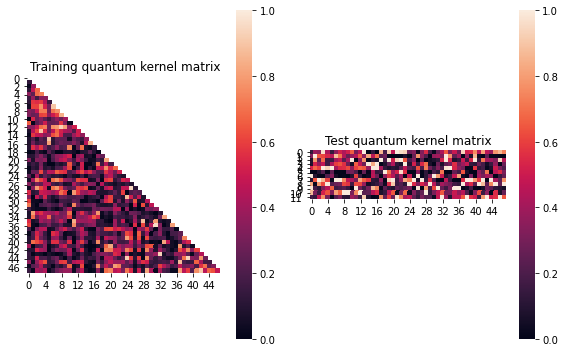


SVM with quantum kernel trained!


Test set performance:


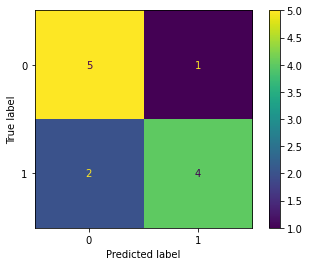

              precision    recall  f1-score   support

           0       0.71      0.83      0.77         6
           1       0.80      0.67      0.73         6

    accuracy                           0.75        12
   macro avg       0.76      0.75      0.75        12
weighted avg       0.76      0.75      0.75        12


metric 1: 0.07336162745768293
metric(s) 2: (00, 10, 11) = (0.3532835838589609, 0.2673493154566527, 0.32813830196971033)
metric 3: -4.718177620054338e-268


----> Kernel construction duration: 00:02:06


Combination 359/468
(Current range: 37/46)
			 reps : 3
			 paulis : ['Z', 'ZY']
			 entanglement : linear

Feature map:


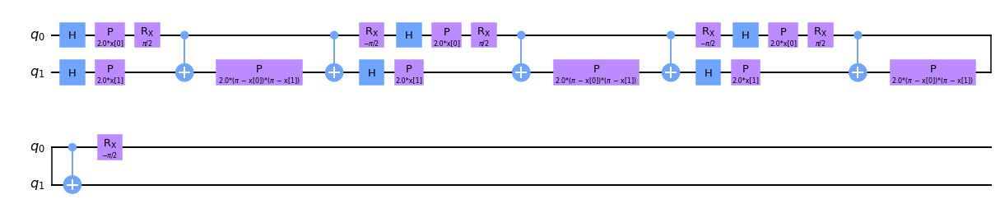


Quantum kernel matrices:



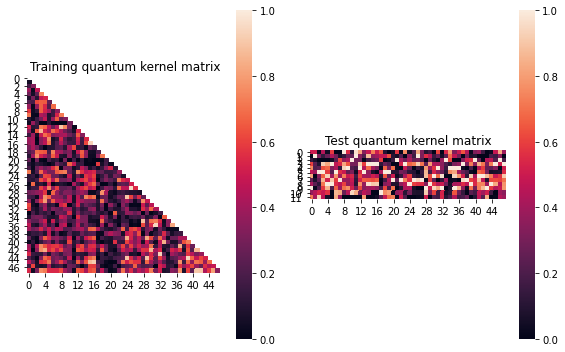


SVM with quantum kernel trained!


Test set performance:


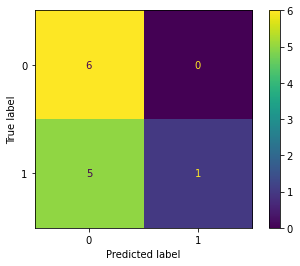

              precision    recall  f1-score   support

           0       0.55      1.00      0.71         6
           1       1.00      0.17      0.29         6

    accuracy                           0.58        12
   macro avg       0.77      0.58      0.50        12
weighted avg       0.77      0.58      0.50        12


metric 1: 0.0786928812203046
metric(s) 2: (00, 10, 11) = (0.3330153933301052, 0.2844799383385506, 0.3933302457876052)
metric 3: 8.70493533223403e-255


----> Kernel construction duration: 00:02:12


Combination 360/468
(Current range: 38/46)
			 reps : 3
			 paulis : ['Z', 'ZZ']
			 entanglement : linear

Feature map:


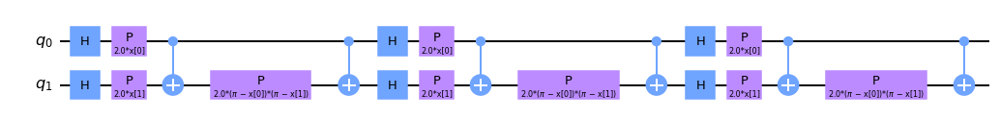


Quantum kernel matrices:



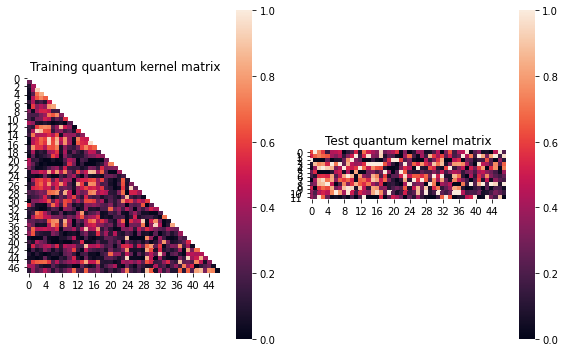


SVM with quantum kernel trained!


Test set performance:


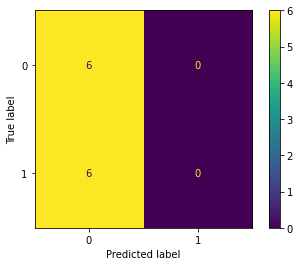

              precision    recall  f1-score   support

           0       0.50      1.00      0.67         6
           1       0.00      0.00      0.00         6

    accuracy                           0.50        12
   macro avg       0.25      0.50      0.33        12
weighted avg       0.25      0.50      0.33        12


metric 1: 0.07443384910029133
metric(s) 2: (00, 10, 11) = (0.3677487823316448, 0.27275499553002636, 0.32662890692899055)
metric 3: -2.6865414066679453e-255


----> Kernel construction duration: 00:02:01


Combination 361/468
(Current range: 39/46)
			 reps : 3
			 paulis : ['XX', 'X']
			 entanglement : linear

Feature map:


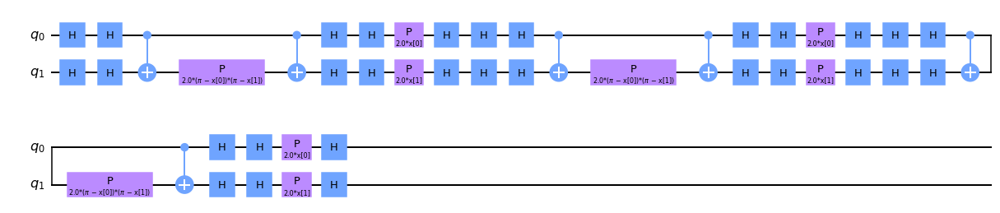


Quantum kernel matrices:



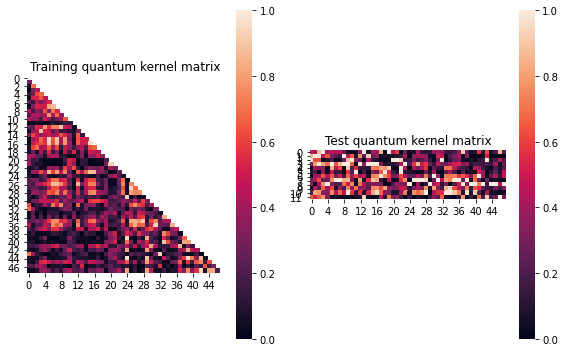


SVM with quantum kernel trained!


Test set performance:


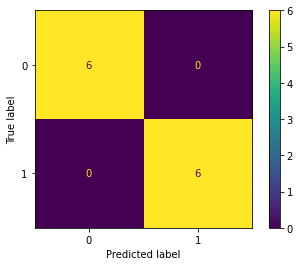

              precision    recall  f1-score   support

           0       1.00      1.00      1.00         6
           1       1.00      1.00      1.00         6

    accuracy                           1.00        12
   macro avg       1.00      1.00      1.00        12
weighted avg       1.00      1.00      1.00        12


metric 1: 0.12078912227428518
metric(s) 2: (00, 10, 11) = (0.3748516035493653, 0.248351635272397, 0.363429911543999)
metric 3: 1.2775692381540672e-255


----> Kernel construction duration: 00:01:54


Combination 362/468
(Current range: 40/46)
			 reps : 3
			 paulis : ['XX', 'Y']
			 entanglement : linear

Feature map:


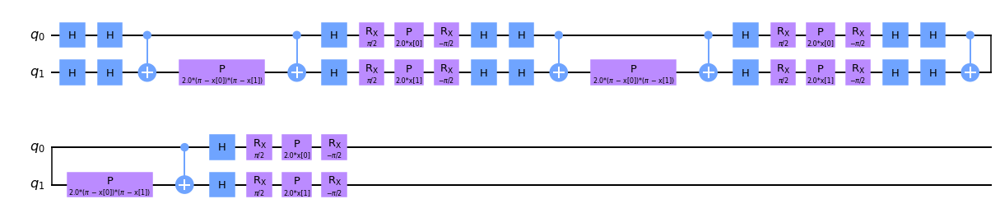


Quantum kernel matrices:



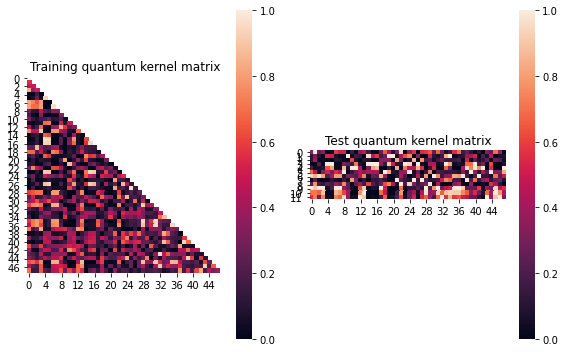


SVM with quantum kernel trained!


Test set performance:


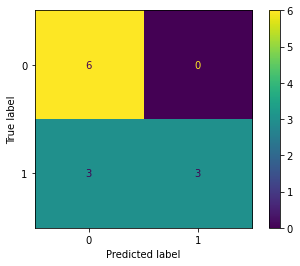

              precision    recall  f1-score   support

           0       0.67      1.00      0.80         6
           1       1.00      0.50      0.67         6

    accuracy                           0.75        12
   macro avg       0.83      0.75      0.73        12
weighted avg       0.83      0.75      0.73        12


metric 1: 0.042089232095069984
metric(s) 2: (00, 10, 11) = (0.3011889965199587, 0.2792906505369317, 0.34157076874404463)
metric 3: 8.526474975392834e-261


----> Kernel construction duration: 00:02:08


Combination 363/468
(Current range: 41/46)
			 reps : 3
			 paulis : ['XX', 'Z']
			 entanglement : linear

Feature map:


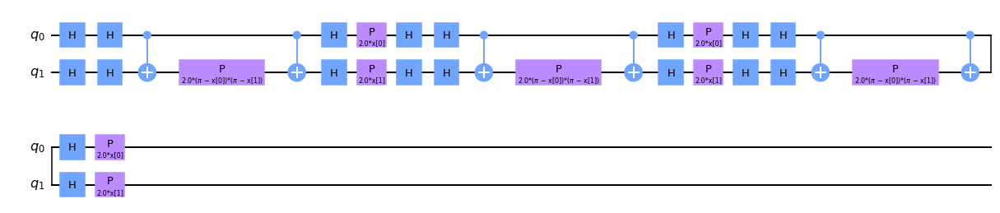


Quantum kernel matrices:



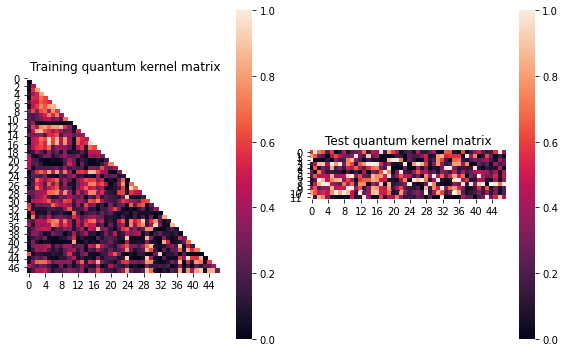


SVM with quantum kernel trained!


Test set performance:


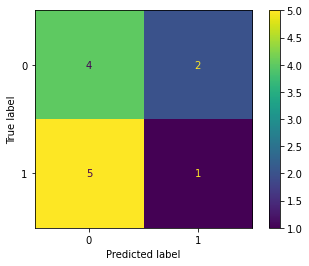

              precision    recall  f1-score   support

           0       0.44      0.67      0.53         6
           1       0.33      0.17      0.22         6

    accuracy                           0.42        12
   macro avg       0.39      0.42      0.38        12
weighted avg       0.39      0.42      0.38        12


metric 1: 0.07647342168958621
metric(s) 2: (00, 10, 11) = (0.3846086061701882, 0.27693793412496537, 0.32221410545891493)
metric 3: -1.9653144616409166e-255


----> Kernel construction duration: 00:02:00


Combination 364/468
(Current range: 42/46)
			 reps : 3
			 paulis : ['XX', 'XX']
			 entanglement : linear

Feature map:


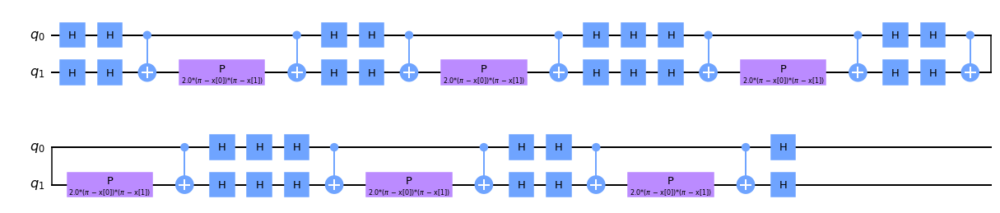


Quantum kernel matrices:



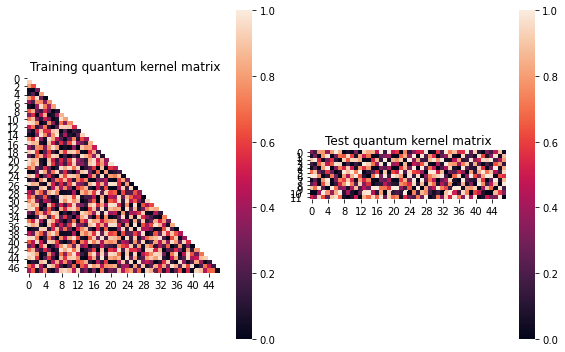


SVM with quantum kernel trained!


Test set performance:


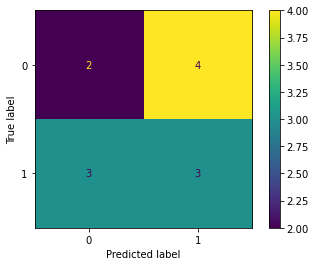

              precision    recall  f1-score   support

           0       0.40      0.33      0.36         6
           1       0.43      0.50      0.46         6

    accuracy                           0.42        12
   macro avg       0.41      0.42      0.41        12
weighted avg       0.41      0.42      0.41        12


metric 1: 0.005189231185427912
metric(s) 2: (00, 10, 11) = (0.49936335961957806, 0.494900756823733, 0.5008166163987438)
metric 3: 0.0


----> Kernel construction duration: 00:01:35


Combination 365/468
(Current range: 43/46)
			 reps : 3
			 paulis : ['XX', 'XY']
			 entanglement : linear

Feature map:


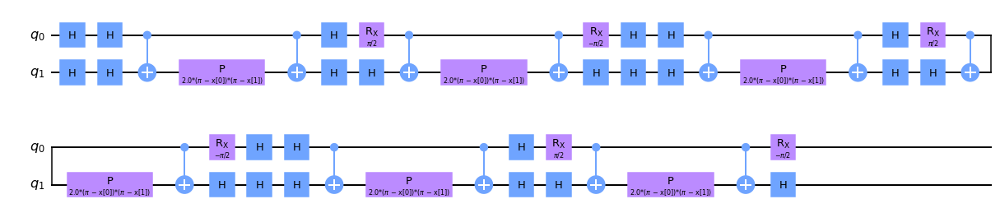


Quantum kernel matrices:



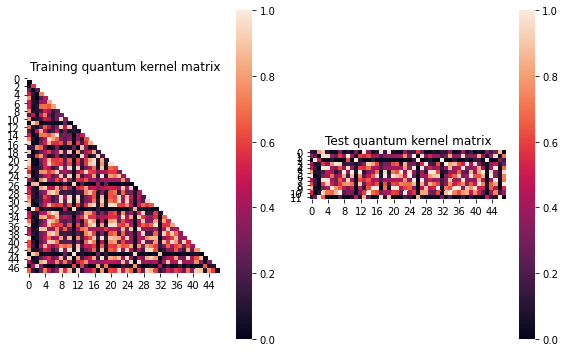


SVM with quantum kernel trained!


Test set performance:


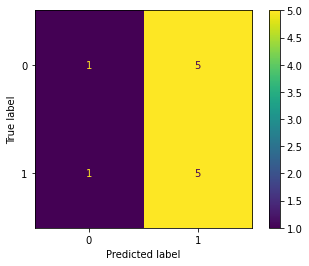

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.00880267426011333
metric(s) 2: (00, 10, 11) = (0.4120580130935574, 0.4182871391391155, 0.44212161370490033)
metric 3: -8.316896808181955e-308


----> Kernel construction duration: 00:02:40


Combination 366/468
(Current range: 44/46)
			 reps : 3
			 paulis : ['XX', 'XZ']
			 entanglement : linear

Feature map:


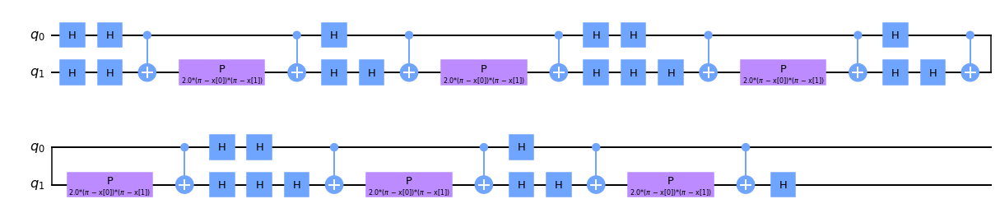


Quantum kernel matrices:



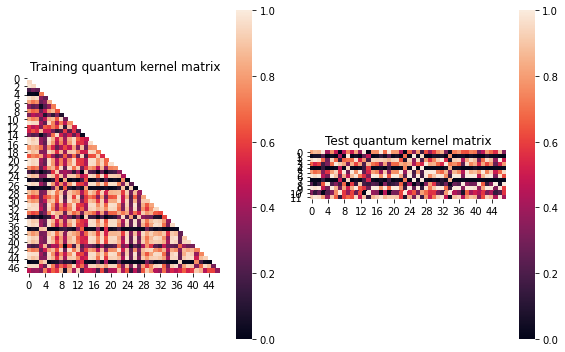


SVM with quantum kernel trained!


Test set performance:


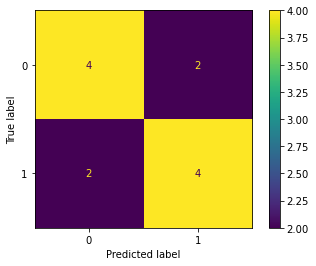

              precision    recall  f1-score   support

           0       0.67      0.67      0.67         6
           1       0.67      0.67      0.67         6

    accuracy                           0.67        12
   macro avg       0.67      0.67      0.67        12
weighted avg       0.67      0.67      0.67        12


metric 1: 0.010956131449137874
metric(s) 2: (00, 10, 11) = (0.5956480517106276, 0.5868295100562554, 0.5999232313001589)
metric 3: 0.0


----> Kernel construction duration: 00:02:20


Combination 367/468
(Current range: 45/46)
			 reps : 3
			 paulis : ['XX', 'YX']
			 entanglement : linear

Feature map:


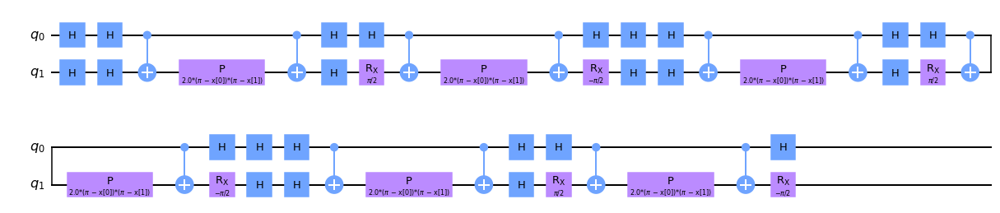


Quantum kernel matrices:



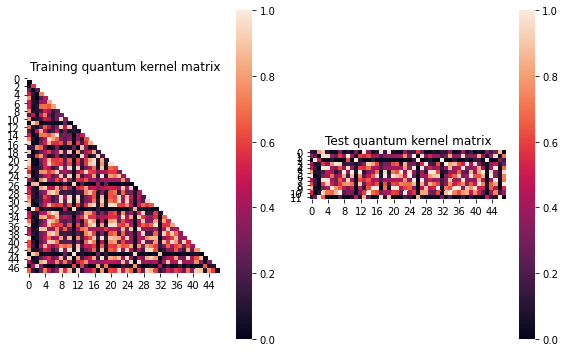


SVM with quantum kernel trained!


Test set performance:


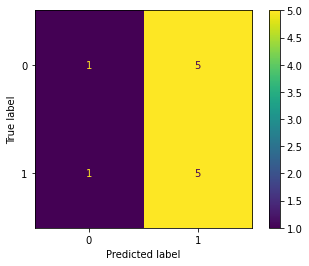

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.00880267426011333
metric(s) 2: (00, 10, 11) = (0.4120580130935574, 0.4182871391391155, 0.44212161370490033)
metric 3: -8.316896808181955e-308


----> Kernel construction duration: 00:02:41


Combination 368/468
(Current range: 46/46)
			 reps : 3
			 paulis : ['XX', 'YY']
			 entanglement : linear

Feature map:


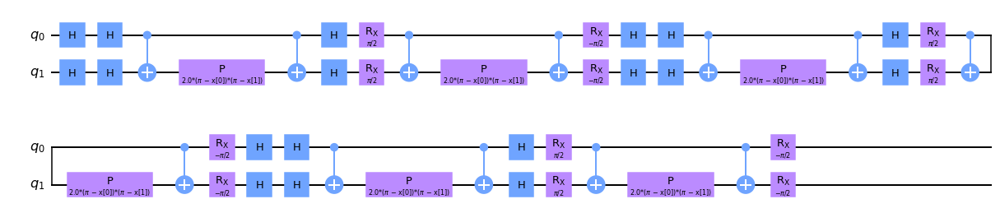


Quantum kernel matrices:



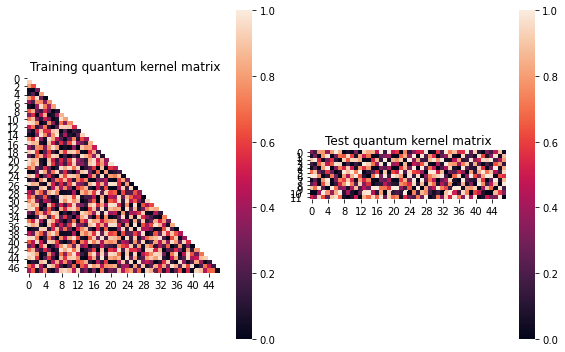


SVM with quantum kernel trained!


Test set performance:


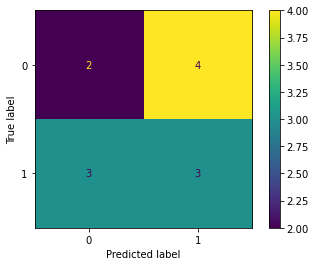

              precision    recall  f1-score   support

           0       0.40      0.33      0.36         6
           1       0.43      0.50      0.46         6

    accuracy                           0.42        12
   macro avg       0.41      0.42      0.41        12
weighted avg       0.41      0.42      0.41        12


metric 1: 0.005189231185427912
metric(s) 2: (00, 10, 11) = (0.49936335961957806, 0.494900756823733, 0.5008166163987438)
metric 3: 0.0


----> Kernel construction duration: 00:03:12


In [20]:
j=7
results.append(run_kernel_evaluation(X, X_train, y_train, X_test, y_test,
                                      param_grid, range_list, j, model=True))



Combination 369/468
(Current range: 1/46)
			 reps : 3
			 paulis : ['XX', 'YZ']
			 entanglement : linear

Feature map:


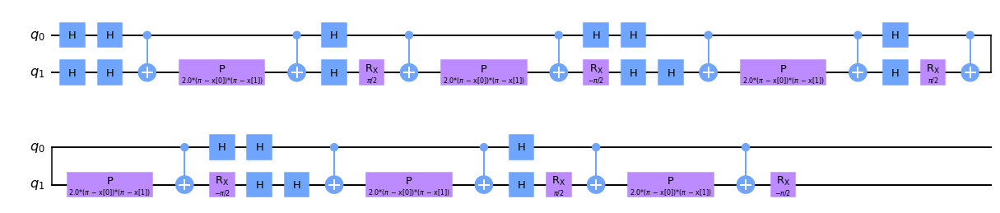


Quantum kernel matrices:



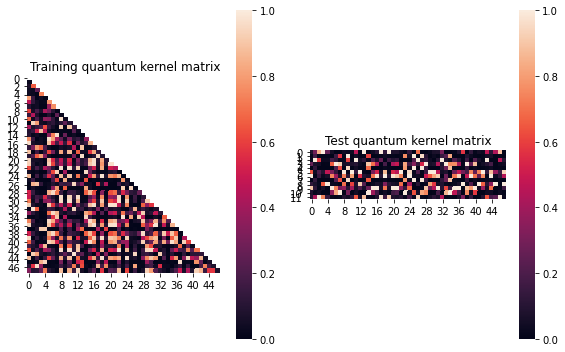


SVM with quantum kernel trained!


Test set performance:


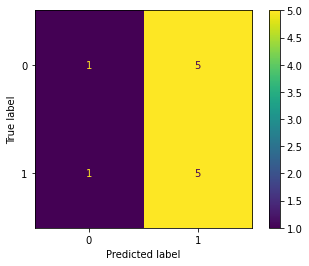

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.009334336671035504
metric(s) 2: (00, 10, 11) = (0.29815532311066256, 0.29684280124296386, 0.3141989527173361)
metric 3: 0.0


----> Kernel construction duration: 00:02:51


Combination 370/468
(Current range: 2/46)
			 reps : 3
			 paulis : ['XX', 'ZX']
			 entanglement : linear

Feature map:


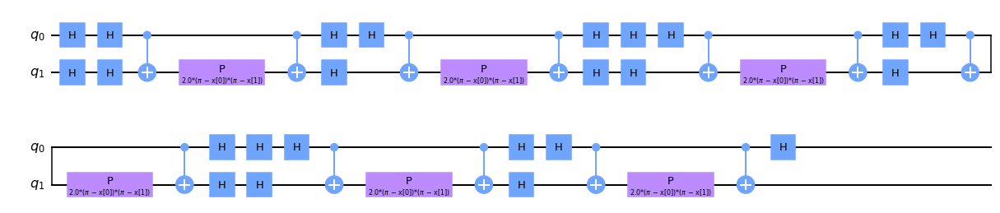


Quantum kernel matrices:



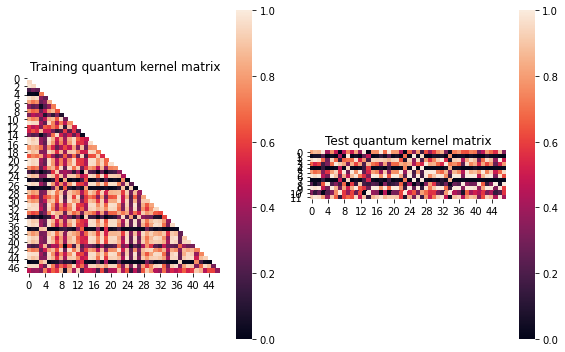


SVM with quantum kernel trained!


Test set performance:


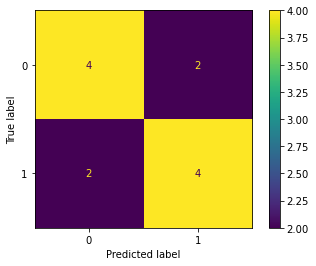

              precision    recall  f1-score   support

           0       0.67      0.67      0.67         6
           1       0.67      0.67      0.67         6

    accuracy                           0.67        12
   macro avg       0.67      0.67      0.67        12
weighted avg       0.67      0.67      0.67        12


metric 1: 0.010956131449137874
metric(s) 2: (00, 10, 11) = (0.5956480517106276, 0.5868295100562554, 0.5999232313001589)
metric 3: 0.0


----> Kernel construction duration: 00:02:20


Combination 371/468
(Current range: 3/46)
			 reps : 3
			 paulis : ['XX', 'ZY']
			 entanglement : linear

Feature map:


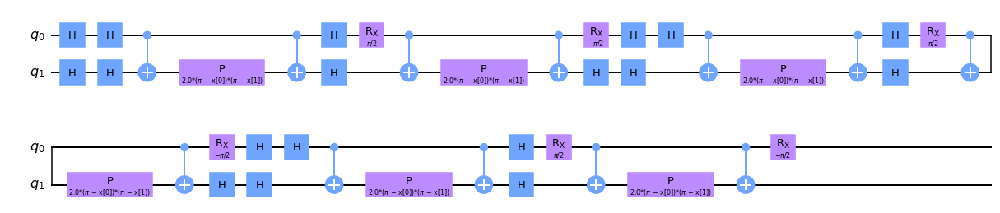


Quantum kernel matrices:



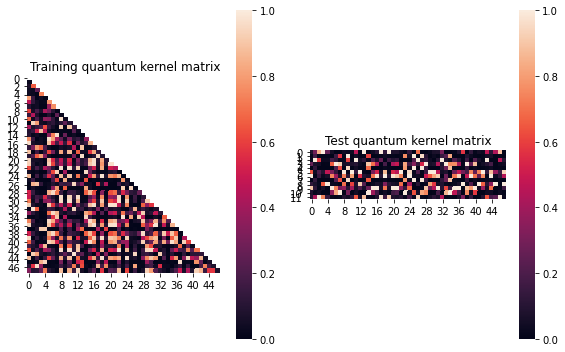


SVM with quantum kernel trained!


Test set performance:


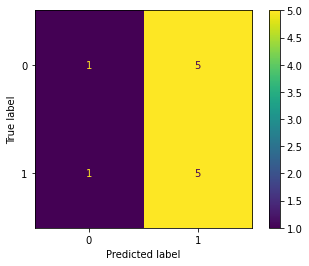

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.009334336671035504
metric(s) 2: (00, 10, 11) = (0.29815532311066256, 0.29684280124296386, 0.3141989527173361)
metric 3: 0.0


----> Kernel construction duration: 00:02:51


Combination 372/468
(Current range: 4/46)
			 reps : 3
			 paulis : ['XX', 'ZZ']
			 entanglement : linear

Feature map:


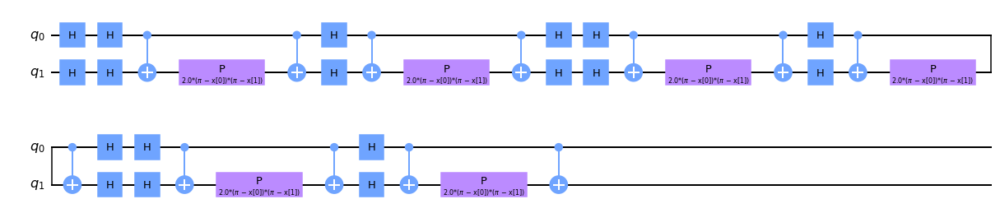


Quantum kernel matrices:



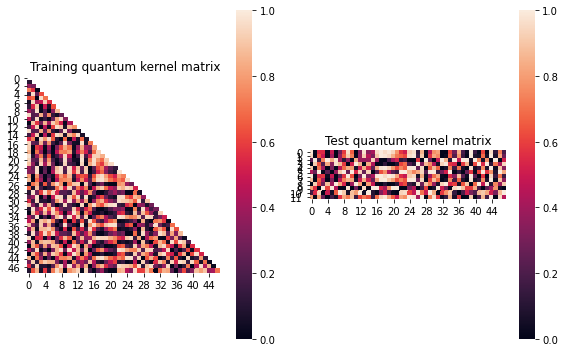


SVM with quantum kernel trained!


Test set performance:


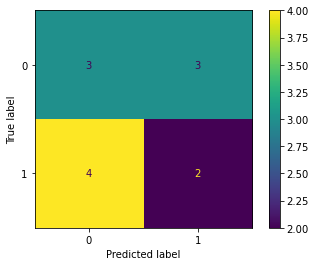

              precision    recall  f1-score   support

           0       0.43      0.50      0.46         6
           1       0.40      0.33      0.36         6

    accuracy                           0.42        12
   macro avg       0.41      0.42      0.41        12
weighted avg       0.41      0.42      0.41        12


metric 1: 0.01730890192141893
metric(s) 2: (00, 10, 11) = (0.4938575607783879, 0.48013029165421034, 0.5010208263728706)
metric 3: 0.0


----> Kernel construction duration: 00:02:08


Combination 373/468
(Current range: 5/46)
			 reps : 3
			 paulis : ['XY', 'X']
			 entanglement : linear

Feature map:


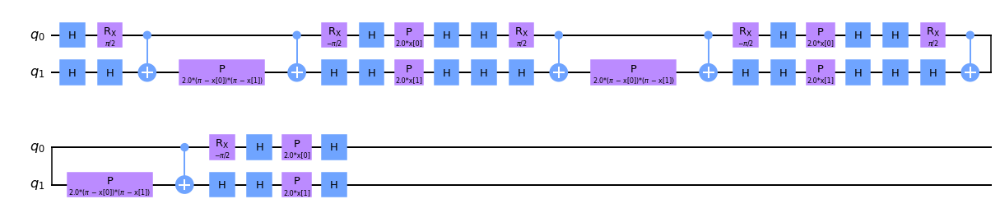


Quantum kernel matrices:



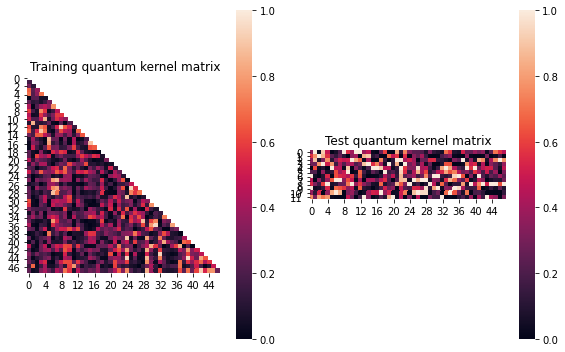


SVM with quantum kernel trained!


Test set performance:


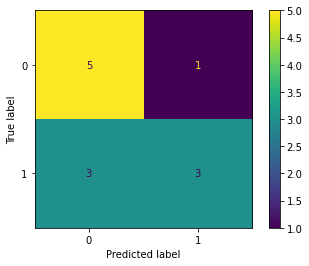

              precision    recall  f1-score   support

           0       0.62      0.83      0.71         6
           1       0.75      0.50      0.60         6

    accuracy                           0.67        12
   macro avg       0.69      0.67      0.66        12
weighted avg       0.69      0.67      0.66        12


metric 1: 0.09213680838304833
metric(s) 2: (00, 10, 11) = (0.31885511501723557, 0.2389574600640642, 0.34333342187698945)
metric 3: -6.311243547197244e-270


----> Kernel construction duration: 00:02:17


Combination 374/468
(Current range: 6/46)
			 reps : 3
			 paulis : ['XY', 'Y']
			 entanglement : linear

Feature map:


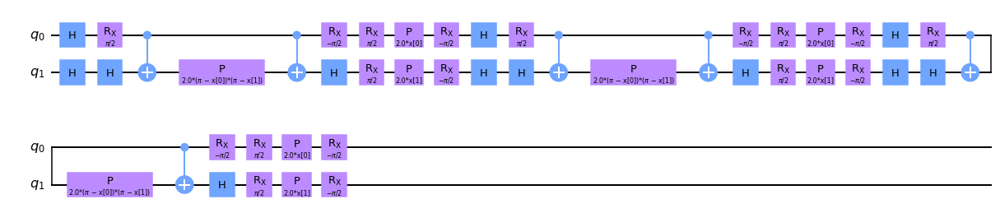


Quantum kernel matrices:



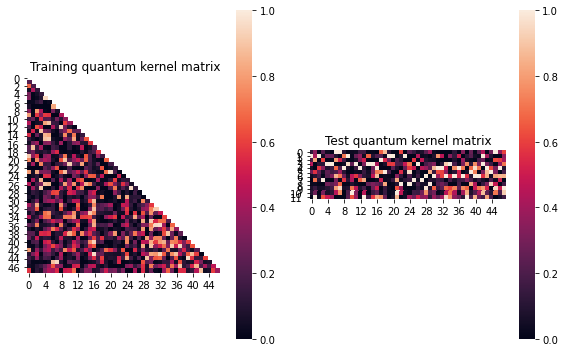


SVM with quantum kernel trained!


Test set performance:


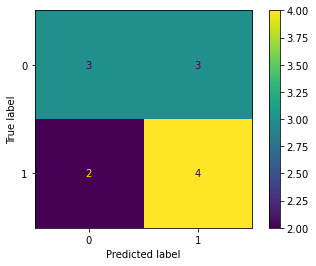

              precision    recall  f1-score   support

           0       0.60      0.50      0.55         6
           1       0.57      0.67      0.62         6

    accuracy                           0.58        12
   macro avg       0.59      0.58      0.58        12
weighted avg       0.59      0.58      0.58        12


metric 1: 0.08712110982452895
metric(s) 2: (00, 10, 11) = (0.28703539842471687, 0.24278992662240315, 0.37278667446914726)
metric 3: -8.541763164662122e-305


----> Kernel construction duration: 00:02:17


Combination 375/468
(Current range: 7/46)
			 reps : 3
			 paulis : ['XY', 'Z']
			 entanglement : linear

Feature map:


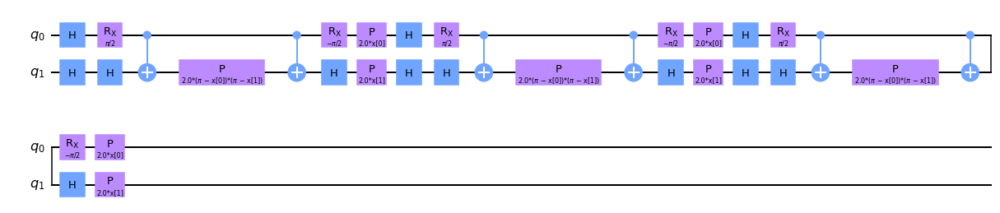


Quantum kernel matrices:



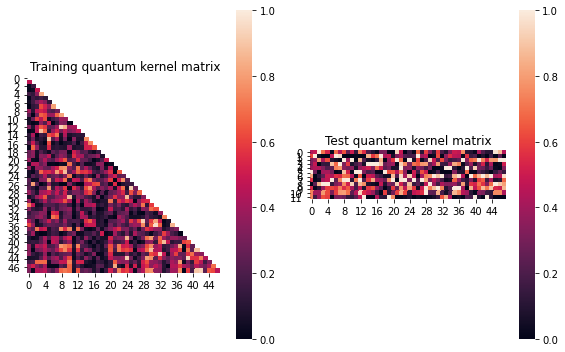


SVM with quantum kernel trained!


Test set performance:


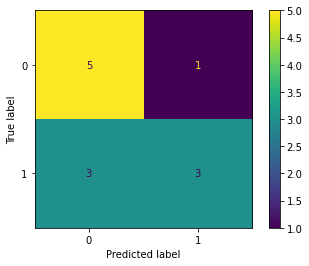

              precision    recall  f1-score   support

           0       0.62      0.83      0.71         6
           1       0.75      0.50      0.60         6

    accuracy                           0.67        12
   macro avg       0.69      0.67      0.66        12
weighted avg       0.69      0.67      0.66        12


metric 1: 0.08847103167292258
metric(s) 2: (00, 10, 11) = (0.3233787964577235, 0.26968528320389606, 0.3929338332959138)
metric 3: -4.022035230573582e-257


----> Kernel construction duration: 00:02:16


Combination 376/468
(Current range: 8/46)
			 reps : 3
			 paulis : ['XY', 'XX']
			 entanglement : linear

Feature map:


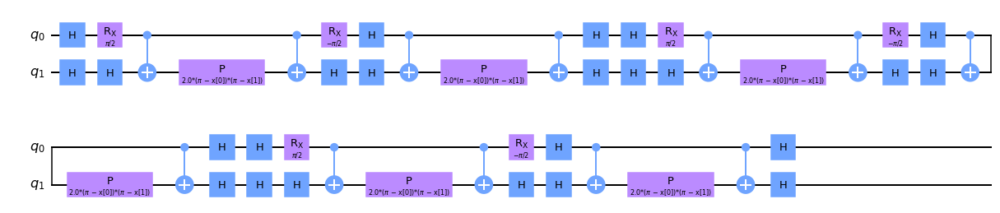


Quantum kernel matrices:



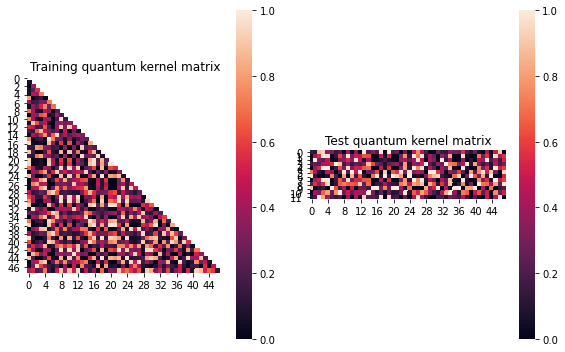


SVM with quantum kernel trained!


Test set performance:


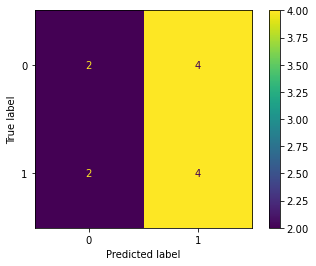

              precision    recall  f1-score   support

           0       0.50      0.33      0.40         6
           1       0.50      0.67      0.57         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.49        12
weighted avg       0.50      0.50      0.49        12


metric 1: 0.0060582954438170855
metric(s) 2: (00, 10, 11) = (0.38190220706413797, 0.38893608337353713, 0.4080865505705705)
metric 3: 7.227747544979959e-307


----> Kernel construction duration: 00:02:51


Combination 377/468
(Current range: 9/46)
			 reps : 3
			 paulis : ['XY', 'XY']
			 entanglement : linear

Feature map:


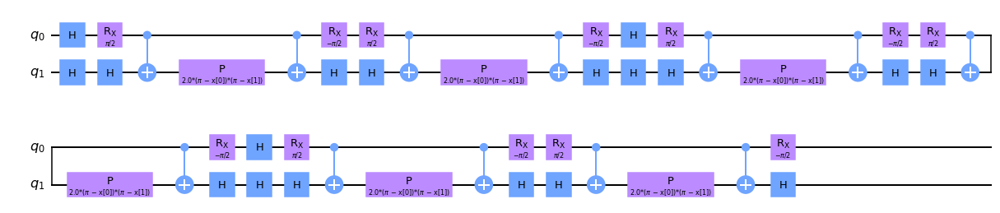


Quantum kernel matrices:



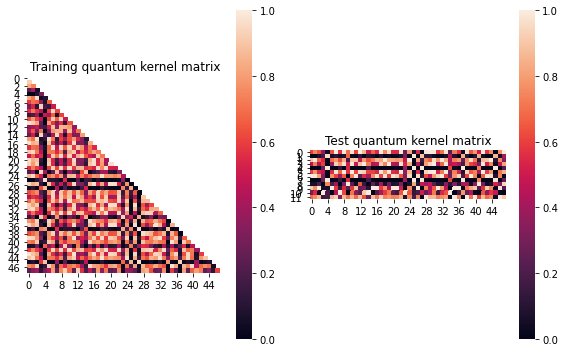


SVM with quantum kernel trained!


Test set performance:


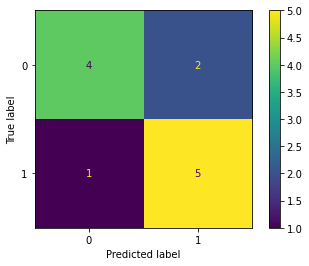

              precision    recall  f1-score   support

           0       0.80      0.67      0.73         6
           1       0.71      0.83      0.77         6

    accuracy                           0.75        12
   macro avg       0.76      0.75      0.75        12
weighted avg       0.76      0.75      0.75        12


metric 1: 0.016120447462909637
metric(s) 2: (00, 10, 11) = (0.5549784887985051, 0.5164631002235872, 0.5101886065744887)
metric 3: -0.0


----> Kernel construction duration: 00:01:53


Combination 378/468
(Current range: 10/46)
			 reps : 3
			 paulis : ['XY', 'XZ']
			 entanglement : linear

Feature map:


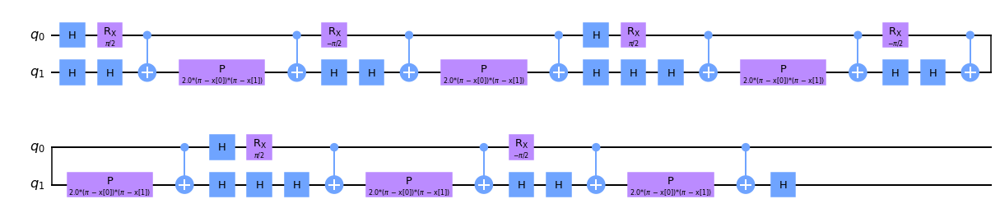


Quantum kernel matrices:



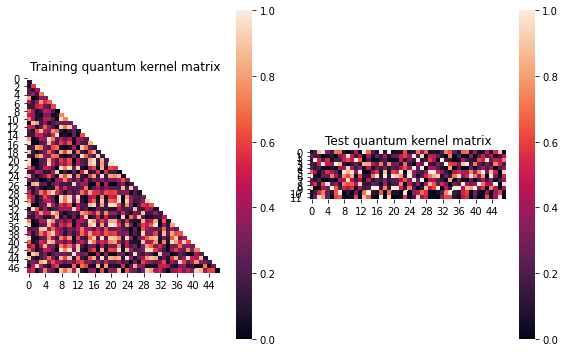


SVM with quantum kernel trained!


Test set performance:


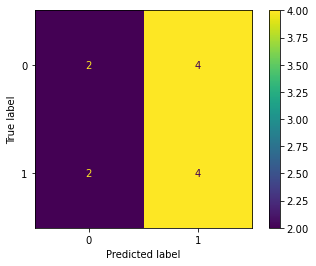

              precision    recall  f1-score   support

           0       0.50      0.33      0.40         6
           1       0.50      0.67      0.57         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.49        12
weighted avg       0.50      0.50      0.49        12


metric 1: 0.004914247995503218
metric(s) 2: (00, 10, 11) = (0.40469256624131983, 0.4011118319927053, 0.4073595937350971)
metric 3: 2.6673495304759083e-305


----> Kernel construction duration: 00:02:49


Combination 379/468
(Current range: 11/46)
			 reps : 3
			 paulis : ['XY', 'YX']
			 entanglement : linear

Feature map:


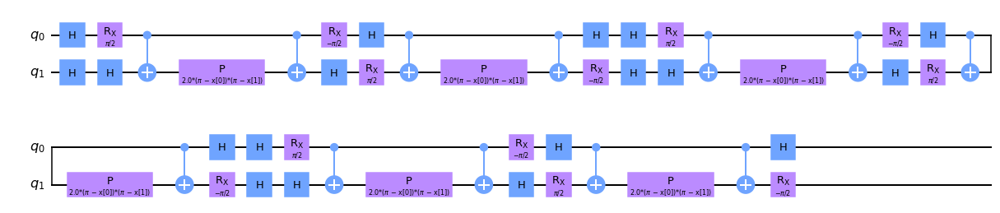


Quantum kernel matrices:



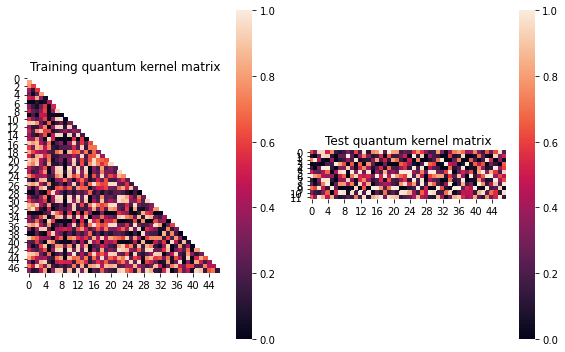


SVM with quantum kernel trained!


Test set performance:


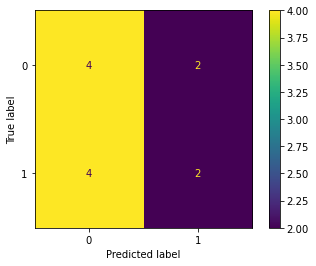

              precision    recall  f1-score   support

           0       0.50      0.67      0.57         6
           1       0.50      0.33      0.40         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.49        12
weighted avg       0.50      0.50      0.49        12


metric 1: 0.007424233691085802
metric(s) 2: (00, 10, 11) = (0.45832292875091407, 0.44197345073388516, 0.44047244009902786)
metric 3: 0.0


----> Kernel construction duration: 00:03:21


Combination 380/468
(Current range: 12/46)
			 reps : 3
			 paulis : ['XY', 'YY']
			 entanglement : linear

Feature map:


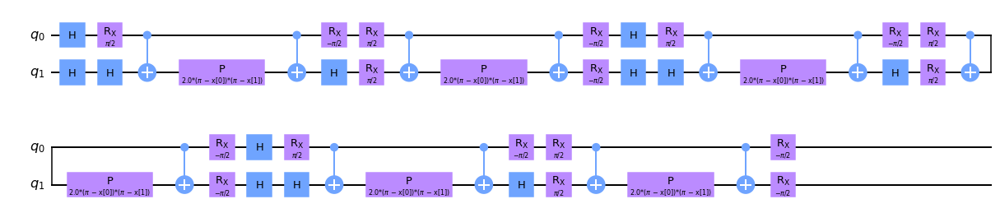


Quantum kernel matrices:



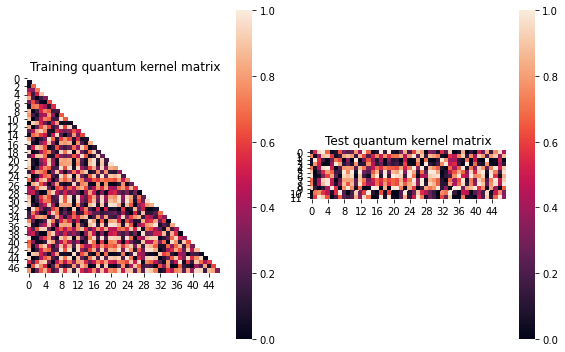


SVM with quantum kernel trained!


Test set performance:


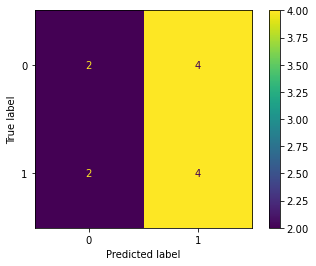

              precision    recall  f1-score   support

           0       0.50      0.33      0.40         6
           1       0.50      0.67      0.57         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.49        12
weighted avg       0.50      0.50      0.49        12


metric 1: 0.0040954703751248656
metric(s) 2: (00, 10, 11) = (0.48190381292458956, 0.48619143110532304, 0.49866999003630624)
metric 3: -7.4e-323


----> Kernel construction duration: 00:02:57


Combination 381/468
(Current range: 13/46)
			 reps : 3
			 paulis : ['XY', 'YZ']
			 entanglement : linear

Feature map:


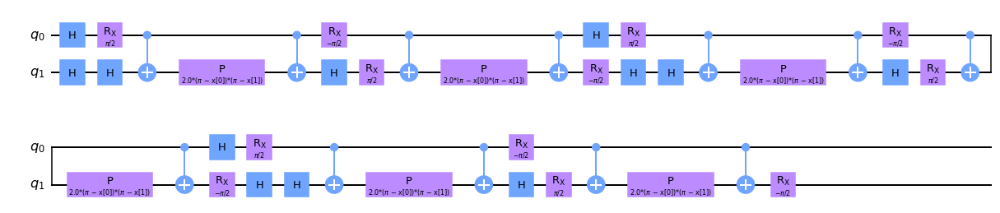


Quantum kernel matrices:



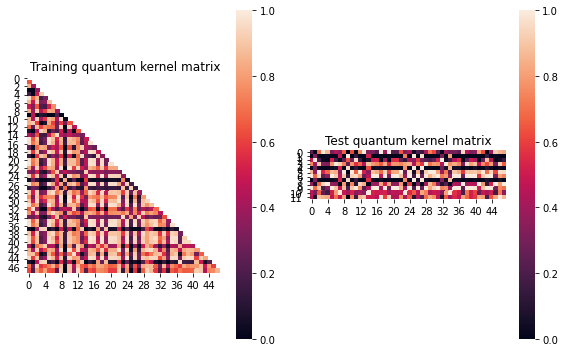


SVM with quantum kernel trained!


Test set performance:


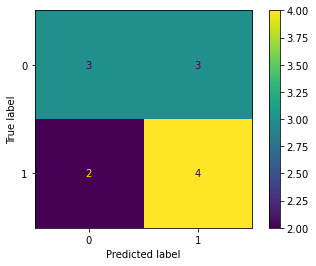

              precision    recall  f1-score   support

           0       0.60      0.50      0.55         6
           1       0.57      0.67      0.62         6

    accuracy                           0.58        12
   macro avg       0.59      0.58      0.58        12
weighted avg       0.59      0.58      0.58        12


metric 1: 0.004979825325543197
metric(s) 2: (00, 10, 11) = (0.5569815807190397, 0.5784034366808145, 0.6097849432936757)
metric 3: -0.0


----> Kernel construction duration: 00:03:22


Combination 382/468
(Current range: 14/46)
			 reps : 3
			 paulis : ['XY', 'ZX']
			 entanglement : linear

Feature map:


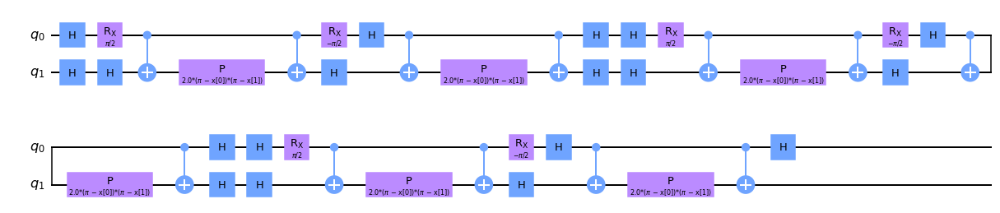


Quantum kernel matrices:



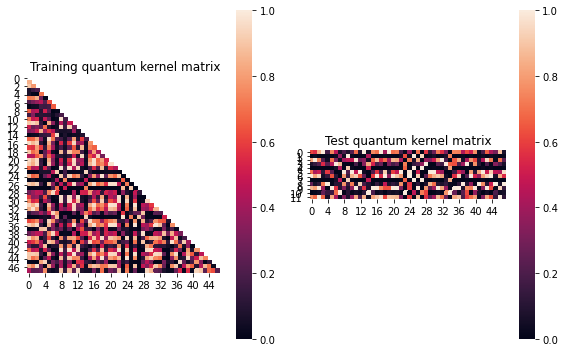


SVM with quantum kernel trained!


Test set performance:


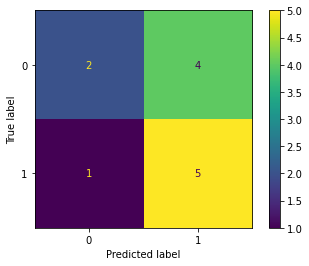

              precision    recall  f1-score   support

           0       0.67      0.33      0.44         6
           1       0.56      0.83      0.67         6

    accuracy                           0.58        12
   macro avg       0.61      0.58      0.56        12
weighted avg       0.61      0.58      0.56        12


metric 1: 0.009365863936292296
metric(s) 2: (00, 10, 11) = (0.4108349471331685, 0.3956662991369575, 0.3992293790133311)
metric 3: -3.345e-321


----> Kernel construction duration: 00:03:02


Combination 383/468
(Current range: 15/46)
			 reps : 3
			 paulis : ['XY', 'ZY']
			 entanglement : linear

Feature map:


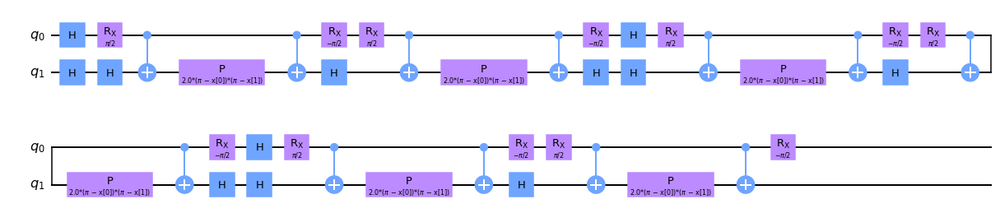


Quantum kernel matrices:



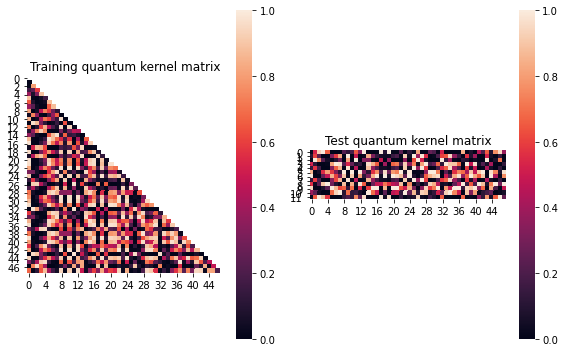


SVM with quantum kernel trained!


Test set performance:


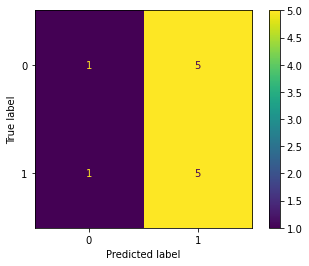

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.0043981638793463285
metric(s) 2: (00, 10, 11) = (0.40613189036271397, 0.4130157528605851, 0.4286959431171489)
metric 3: -0.0


----> Kernel construction duration: 00:02:38


Combination 384/468
(Current range: 16/46)
			 reps : 3
			 paulis : ['XY', 'ZZ']
			 entanglement : linear

Feature map:


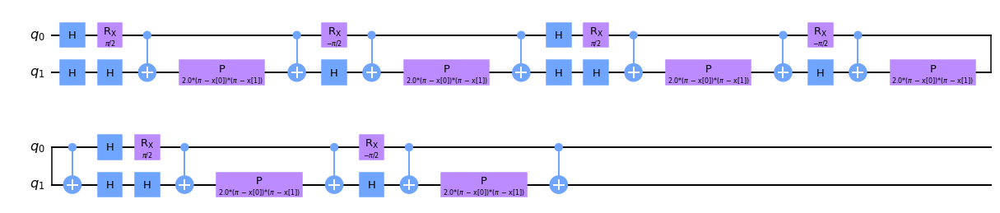


Quantum kernel matrices:



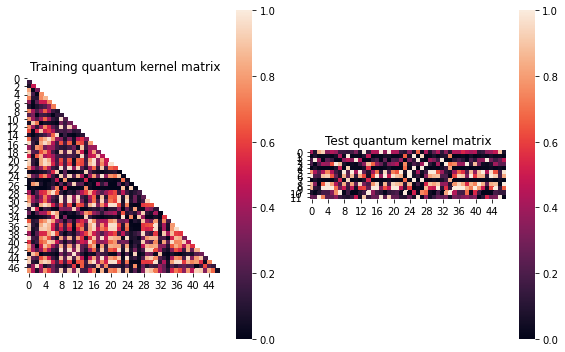


SVM with quantum kernel trained!


Test set performance:


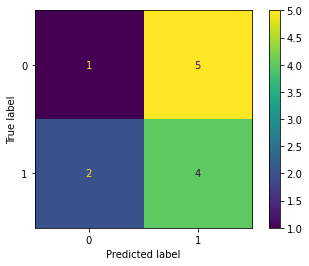

              precision    recall  f1-score   support

           0       0.33      0.17      0.22         6
           1       0.44      0.67      0.53         6

    accuracy                           0.42        12
   macro avg       0.39      0.42      0.38        12
weighted avg       0.39      0.42      0.38        12


metric 1: 0.010104769633572985
metric(s) 2: (00, 10, 11) = (0.41671556027514145, 0.4065562017362498, 0.4166063824645041)
metric 3: -0.0


----> Kernel construction duration: 00:03:01


Combination 385/468
(Current range: 17/46)
			 reps : 3
			 paulis : ['XZ', 'X']
			 entanglement : linear

Feature map:


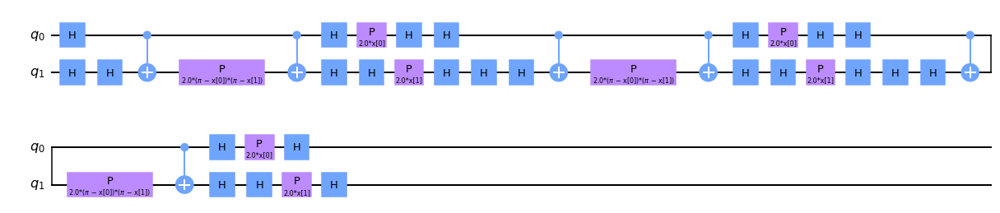


Quantum kernel matrices:



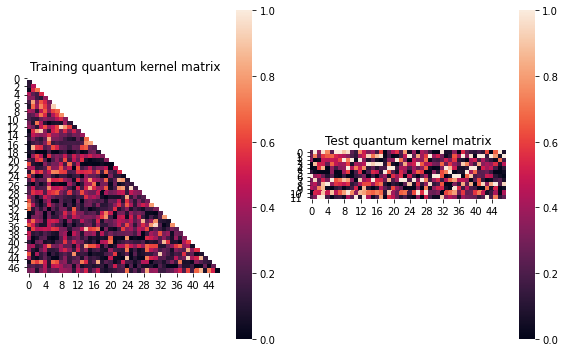


SVM with quantum kernel trained!


Test set performance:


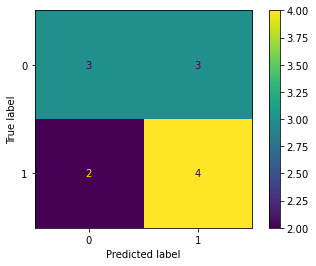

              precision    recall  f1-score   support

           0       0.60      0.50      0.55         6
           1       0.57      0.67      0.62         6

    accuracy                           0.58        12
   macro avg       0.59      0.58      0.58        12
weighted avg       0.59      0.58      0.58        12


metric 1: 0.07058978280213718
metric(s) 2: (00, 10, 11) = (0.36045699229843403, 0.26849529190059407, 0.31771315710702847)
metric 3: 6.097378255792131e-256


----> Kernel construction duration: 00:02:08


Combination 386/468
(Current range: 18/46)
			 reps : 3
			 paulis : ['XZ', 'Y']
			 entanglement : linear

Feature map:


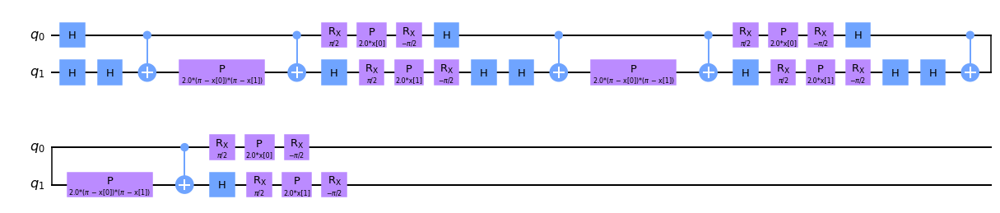


Quantum kernel matrices:



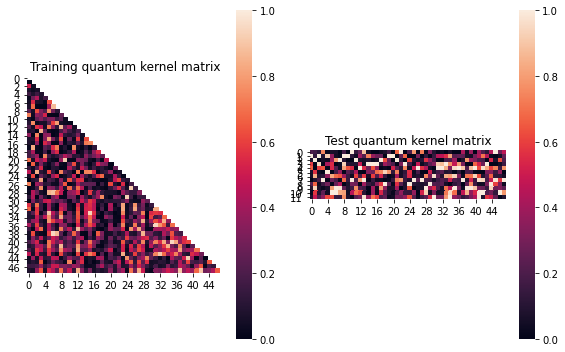


SVM with quantum kernel trained!


Test set performance:


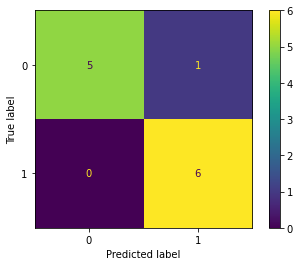

              precision    recall  f1-score   support

           0       1.00      0.83      0.91         6
           1       0.86      1.00      0.92         6

    accuracy                           0.92        12
   macro avg       0.93      0.92      0.92        12
weighted avg       0.93      0.92      0.92        12


metric 1: 0.05354335068020977
metric(s) 2: (00, 10, 11) = (0.26662282987026376, 0.26478032249284567, 0.3700245164758471)
metric 3: -2.7102899127653744e-284


----> Kernel construction duration: 00:02:18


Combination 387/468
(Current range: 19/46)
			 reps : 3
			 paulis : ['XZ', 'Z']
			 entanglement : linear

Feature map:


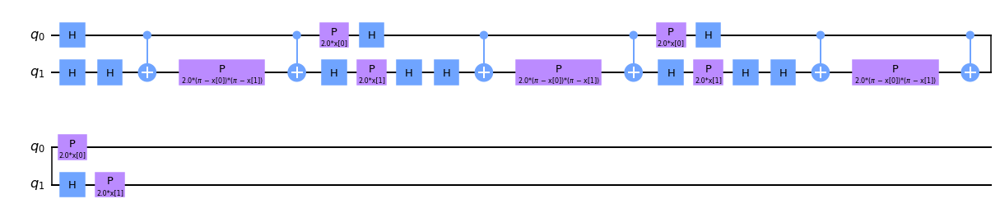


Quantum kernel matrices:



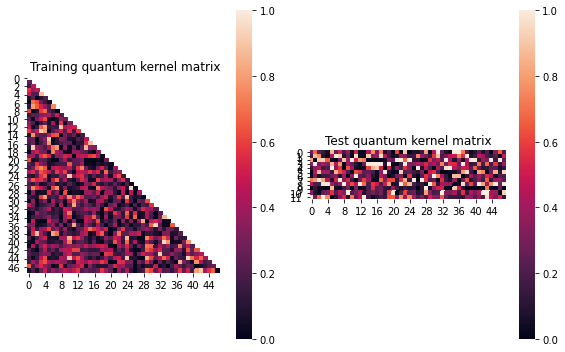


SVM with quantum kernel trained!


Test set performance:


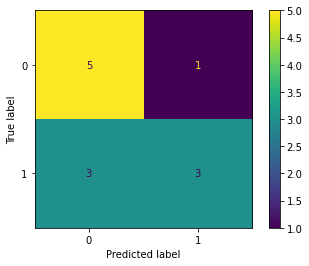

              precision    recall  f1-score   support

           0       0.62      0.83      0.71         6
           1       0.75      0.50      0.60         6

    accuracy                           0.67        12
   macro avg       0.69      0.67      0.66        12
weighted avg       0.69      0.67      0.66        12


metric 1: 0.05489841742893631
metric(s) 2: (00, 10, 11) = (0.34164649741687636, 0.27800713778371633, 0.32416461300842897)
metric 3: -4.142434542053301e-256


----> Kernel construction duration: 00:02:08


Combination 388/468
(Current range: 20/46)
			 reps : 3
			 paulis : ['XZ', 'XX']
			 entanglement : linear

Feature map:


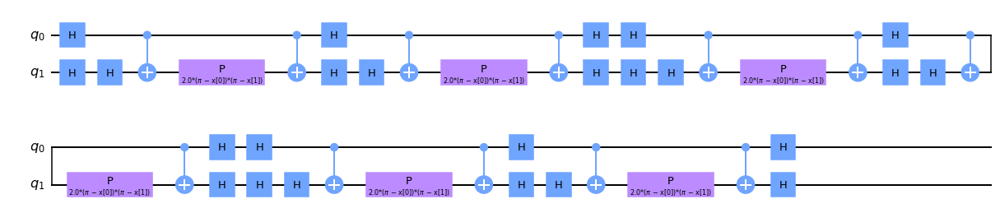


Quantum kernel matrices:



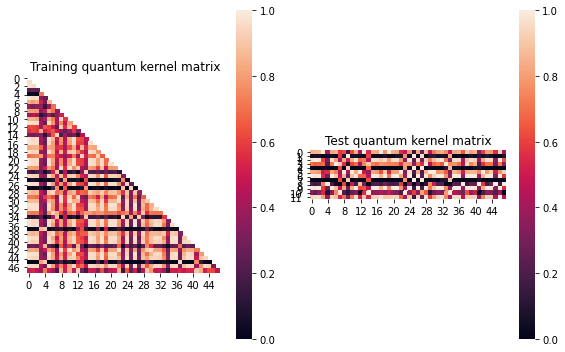


SVM with quantum kernel trained!


Test set performance:


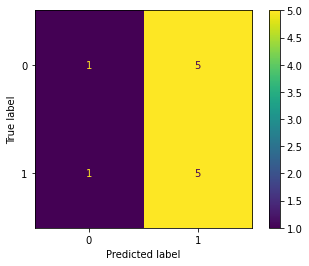

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.012908182444675176
metric(s) 2: (00, 10, 11) = (0.619597114711192, 0.5957250862059711, 0.5976694225901005)
metric 3: -0.0


----> Kernel construction duration: 00:02:30


Combination 389/468
(Current range: 21/46)
			 reps : 3
			 paulis : ['XZ', 'XY']
			 entanglement : linear

Feature map:


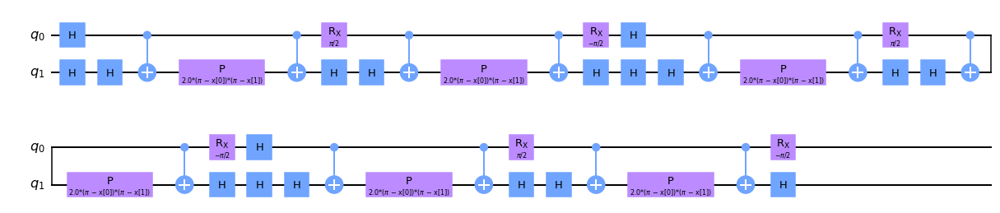


Quantum kernel matrices:



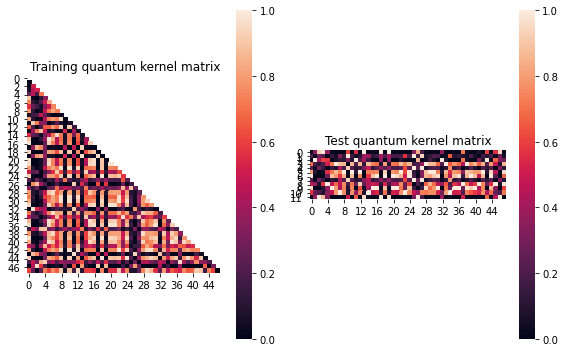


SVM with quantum kernel trained!


Test set performance:


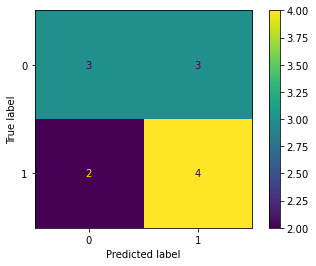

              precision    recall  f1-score   support

           0       0.60      0.50      0.55         6
           1       0.57      0.67      0.62         6

    accuracy                           0.58        12
   macro avg       0.59      0.58      0.58        12
weighted avg       0.59      0.58      0.58        12


metric 1: 0.008936050289908626
metric(s) 2: (00, 10, 11) = (0.4205186180021664, 0.43656622191641054, 0.47048592641047193)
metric 3: 7.127157700277936e-307


----> Kernel construction duration: 00:02:50


Combination 390/468
(Current range: 22/46)
			 reps : 3
			 paulis : ['XZ', 'XZ']
			 entanglement : linear

Feature map:


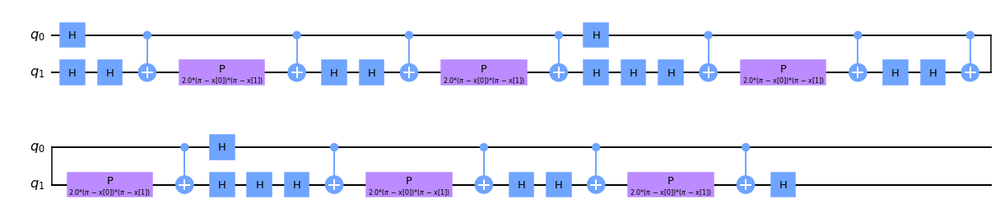


Quantum kernel matrices:



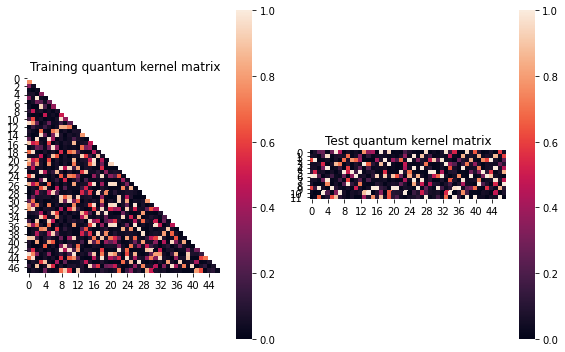


SVM with quantum kernel trained!


Test set performance:


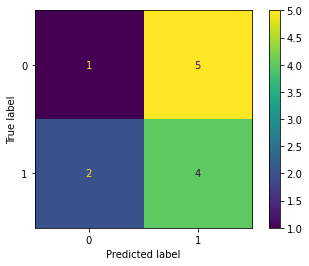

              precision    recall  f1-score   support

           0       0.33      0.17      0.22         6
           1       0.44      0.67      0.53         6

    accuracy                           0.42        12
   macro avg       0.39      0.42      0.38        12
weighted avg       0.39      0.42      0.38        12


metric 1: 0.019970118639973167
metric(s) 2: (00, 10, 11) = (0.2691125555872429, 0.24739279682081877, 0.265613275334341)
metric 3: -0.0


----> Kernel construction duration: 00:01:47


Combination 391/468
(Current range: 23/46)
			 reps : 3
			 paulis : ['XZ', 'YX']
			 entanglement : linear

Feature map:


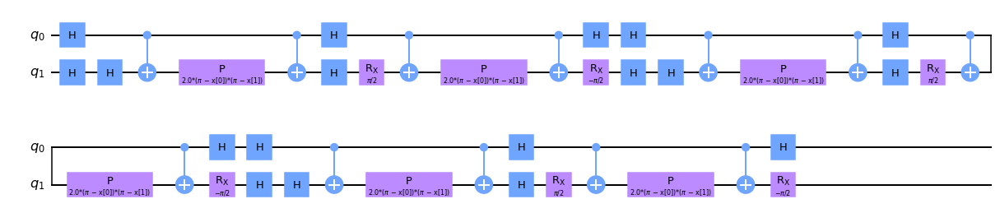


Quantum kernel matrices:



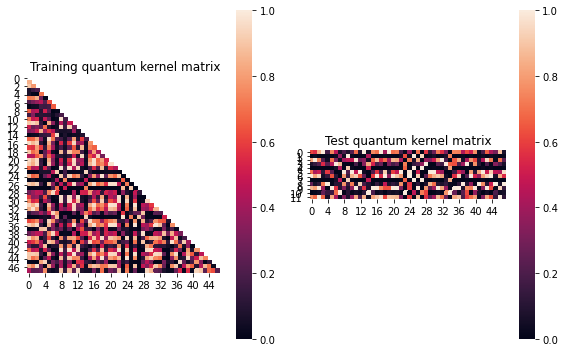


SVM with quantum kernel trained!


Test set performance:


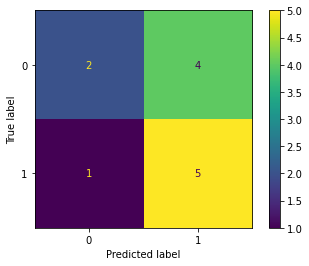

              precision    recall  f1-score   support

           0       0.67      0.33      0.44         6
           1       0.56      0.83      0.67         6

    accuracy                           0.58        12
   macro avg       0.61      0.58      0.56        12
weighted avg       0.61      0.58      0.56        12


metric 1: 0.009365863936292296
metric(s) 2: (00, 10, 11) = (0.4108349471331685, 0.3956662991369575, 0.3992293790133311)
metric 3: -3.345e-321


----> Kernel construction duration: 00:03:02


Combination 392/468
(Current range: 24/46)
			 reps : 3
			 paulis : ['XZ', 'YY']
			 entanglement : linear

Feature map:


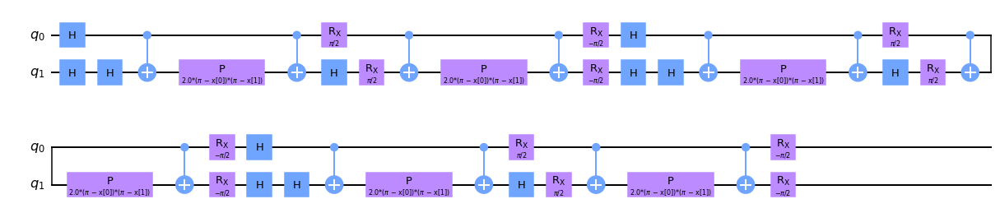


Quantum kernel matrices:



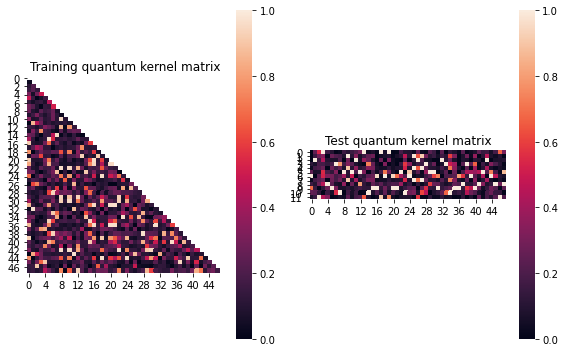


SVM with quantum kernel trained!


Test set performance:


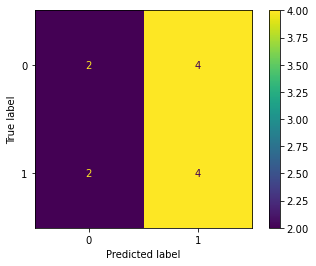

              precision    recall  f1-score   support

           0       0.50      0.33      0.40         6
           1       0.50      0.67      0.57         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.49        12
weighted avg       0.50      0.50      0.49        12


metric 1: 0.014636704314154259
metric(s) 2: (00, 10, 11) = (0.26711969340770353, 0.2593449445847664, 0.28084360439013784)
metric 3: -5.373559490002794e-289


----> Kernel construction duration: 00:03:24


Combination 393/468
(Current range: 25/46)
			 reps : 3
			 paulis : ['XZ', 'YZ']
			 entanglement : linear

Feature map:


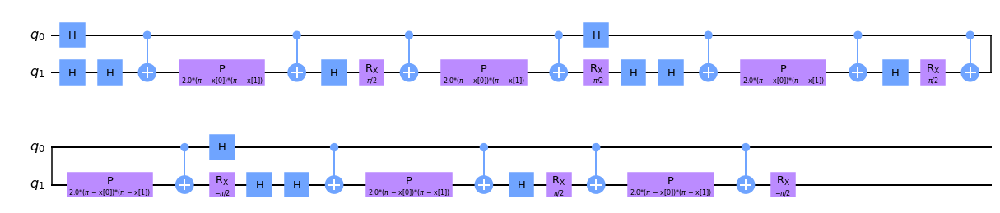


Quantum kernel matrices:



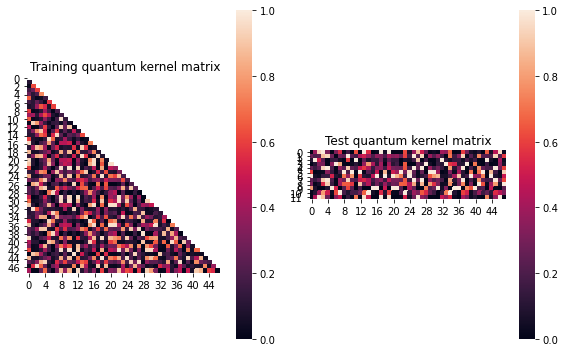


SVM with quantum kernel trained!


Test set performance:


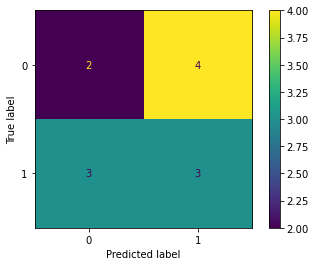

              precision    recall  f1-score   support

           0       0.40      0.33      0.36         6
           1       0.43      0.50      0.46         6

    accuracy                           0.42        12
   macro avg       0.41      0.42      0.41        12
weighted avg       0.41      0.42      0.41        12


metric 1: 0.009066527132248037
metric(s) 2: (00, 10, 11) = (0.34813091512519273, 0.33689370525540313, 0.34378954965010955)
metric 3: -2.1311775516972827e-293


----> Kernel construction duration: 00:02:52


Combination 394/468
(Current range: 26/46)
			 reps : 3
			 paulis : ['XZ', 'ZX']
			 entanglement : linear

Feature map:


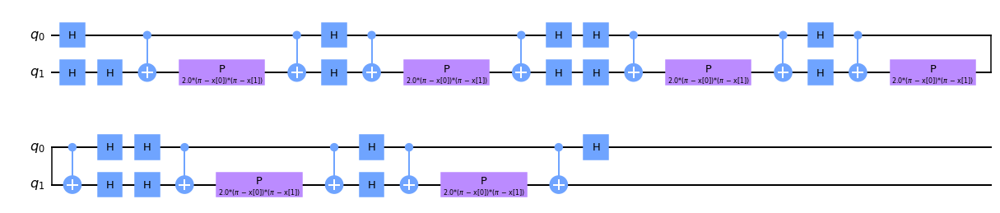


Quantum kernel matrices:



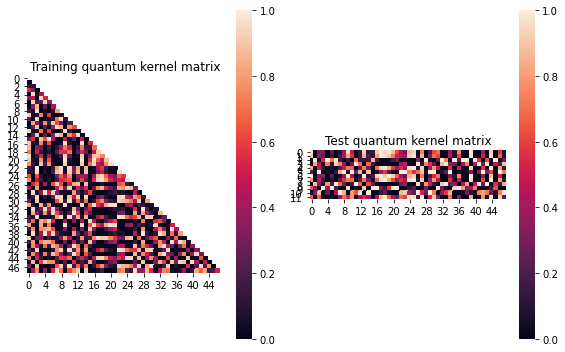


SVM with quantum kernel trained!


Test set performance:


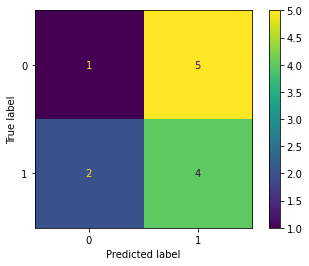

              precision    recall  f1-score   support

           0       0.33      0.17      0.22         6
           1       0.44      0.67      0.53         6

    accuracy                           0.42        12
   macro avg       0.39      0.42      0.38        12
weighted avg       0.39      0.42      0.38        12


metric 1: 0.027776264674632678
metric(s) 2: (00, 10, 11) = (0.38227135956608765, 0.3580416576859088, 0.38936448515499533)
metric 3: 0.0


----> Kernel construction duration: 00:02:19


Combination 395/468
(Current range: 27/46)
			 reps : 3
			 paulis : ['XZ', 'ZY']
			 entanglement : linear

Feature map:


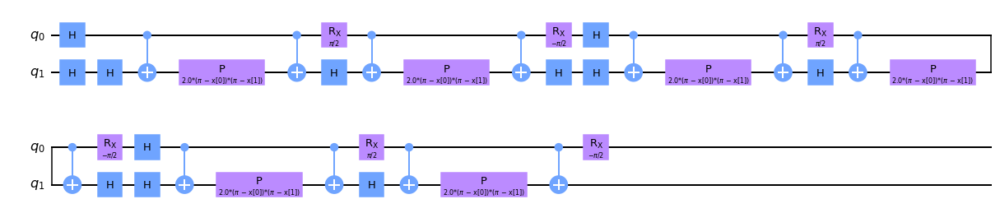


Quantum kernel matrices:



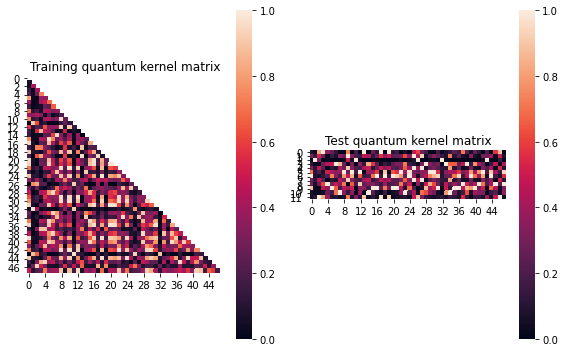


SVM with quantum kernel trained!


Test set performance:


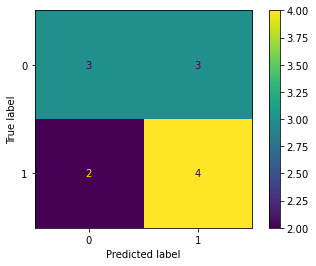

              precision    recall  f1-score   support

           0       0.60      0.50      0.55         6
           1       0.57      0.67      0.62         6

    accuracy                           0.58        12
   macro avg       0.59      0.58      0.58        12
weighted avg       0.59      0.58      0.58        12


metric 1: 0.007426662106061965
metric(s) 2: (00, 10, 11) = (0.36490633867847594, 0.37118322130947917, 0.39231342815260634)
metric 3: 2.5664e-319


----> Kernel construction duration: 00:03:01


Combination 396/468
(Current range: 28/46)
			 reps : 3
			 paulis : ['XZ', 'ZZ']
			 entanglement : linear

Feature map:


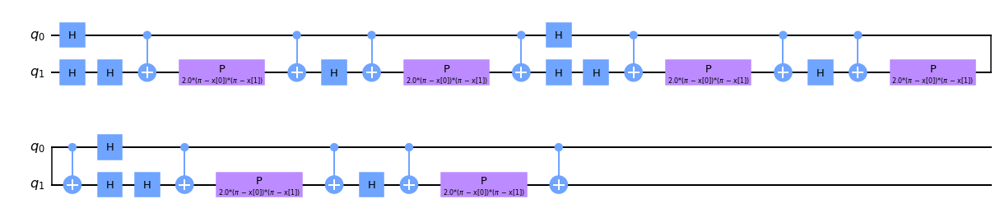


Quantum kernel matrices:



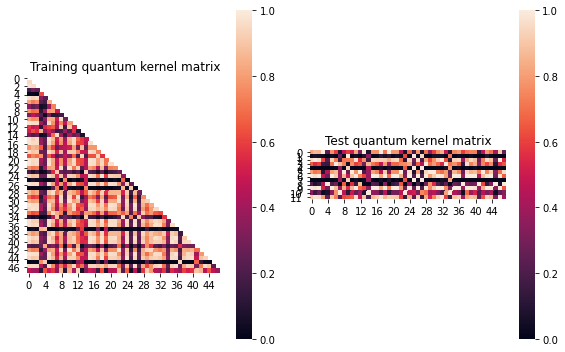


SVM with quantum kernel trained!


Test set performance:


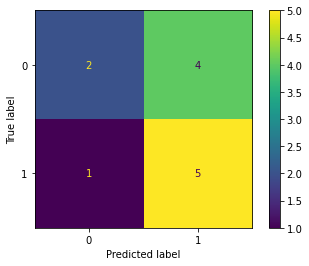

              precision    recall  f1-score   support

           0       0.67      0.33      0.44         6
           1       0.56      0.83      0.67         6

    accuracy                           0.58        12
   macro avg       0.61      0.58      0.56        12
weighted avg       0.61      0.58      0.56        12


metric 1: 0.011447590741553326
metric(s) 2: (00, 10, 11) = (0.5837137345046778, 0.5722679705598179, 0.5837173880980647)
metric 3: -0.0


----> Kernel construction duration: 00:02:42


Combination 397/468
(Current range: 29/46)
			 reps : 3
			 paulis : ['YX', 'X']
			 entanglement : linear

Feature map:


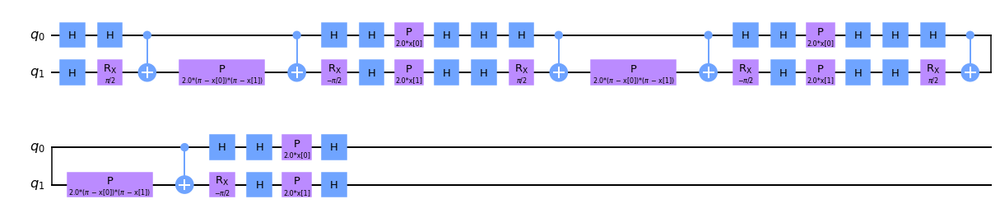


Quantum kernel matrices:



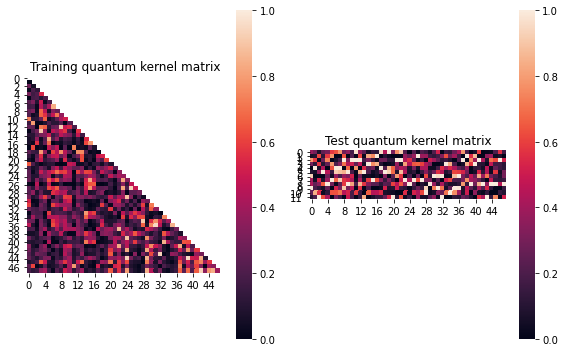


SVM with quantum kernel trained!


Test set performance:


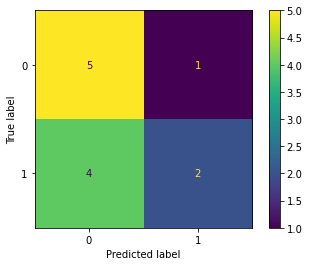

              precision    recall  f1-score   support

           0       0.56      0.83      0.67         6
           1       0.67      0.33      0.44         6

    accuracy                           0.58        12
   macro avg       0.61      0.58      0.56        12
weighted avg       0.61      0.58      0.56        12


metric 1: 0.07176315796077895
metric(s) 2: (00, 10, 11) = (0.2992338380795434, 0.24456084972592565, 0.3334141772938658)
metric 3: 1.3757344958634592e-257


----> Kernel construction duration: 00:02:13


Combination 398/468
(Current range: 30/46)
			 reps : 3
			 paulis : ['YX', 'Y']
			 entanglement : linear

Feature map:


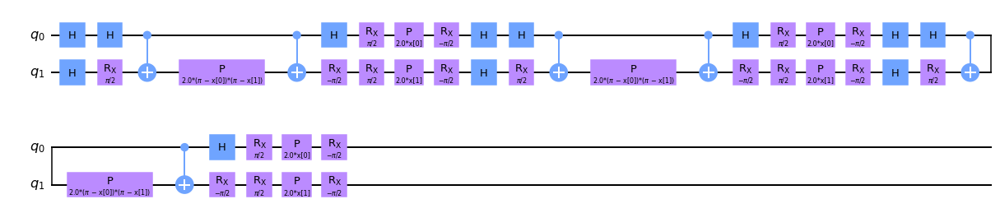


Quantum kernel matrices:



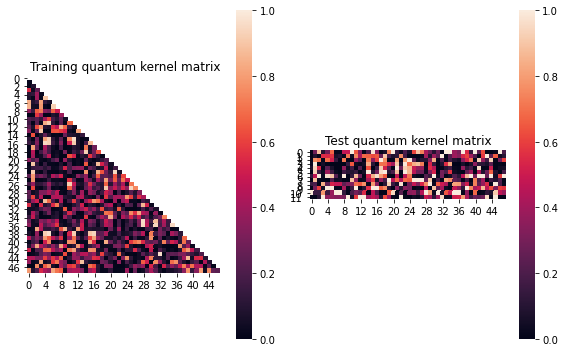


SVM with quantum kernel trained!


Test set performance:


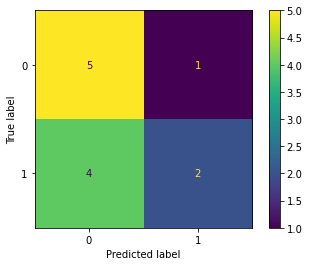

              precision    recall  f1-score   support

           0       0.56      0.83      0.67         6
           1       0.67      0.33      0.44         6

    accuracy                           0.58        12
   macro avg       0.61      0.58      0.56        12
weighted avg       0.61      0.58      0.56        12


metric 1: 0.022386964700482292
metric(s) 2: (00, 10, 11) = (0.2719219457631837, 0.2633634533578606, 0.29957889035350205)
metric 3: 3.9929856749071788e-292


----> Kernel construction duration: 00:02:18


Combination 399/468
(Current range: 31/46)
			 reps : 3
			 paulis : ['YX', 'Z']
			 entanglement : linear

Feature map:


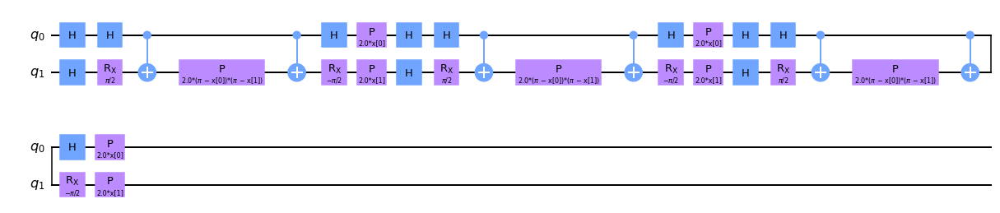


Quantum kernel matrices:



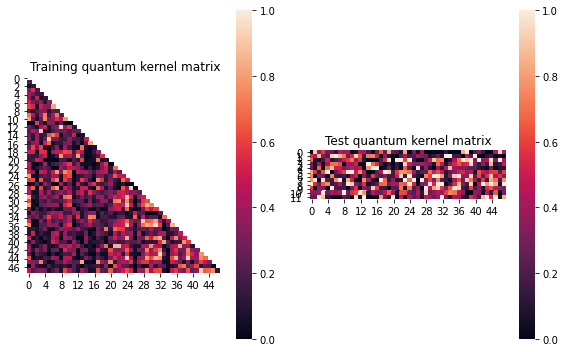


SVM with quantum kernel trained!


Test set performance:


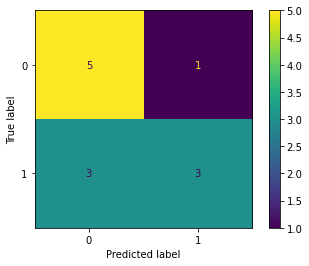

              precision    recall  f1-score   support

           0       0.62      0.83      0.71         6
           1       0.75      0.50      0.60         6

    accuracy                           0.67        12
   macro avg       0.69      0.67      0.66        12
weighted avg       0.69      0.67      0.66        12


metric 1: 0.09929494490327379
metric(s) 2: (00, 10, 11) = (0.3187670630040076, 0.2598287477822077, 0.39948032236695546)
metric 3: -6.663785554868322e-269


----> Kernel construction duration: 00:02:16


Combination 400/468
(Current range: 32/46)
			 reps : 3
			 paulis : ['YX', 'XX']
			 entanglement : linear

Feature map:


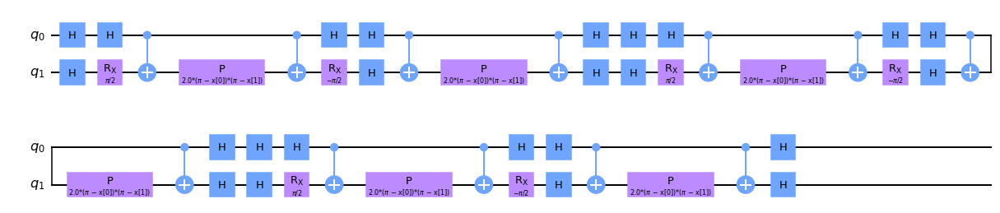


Quantum kernel matrices:



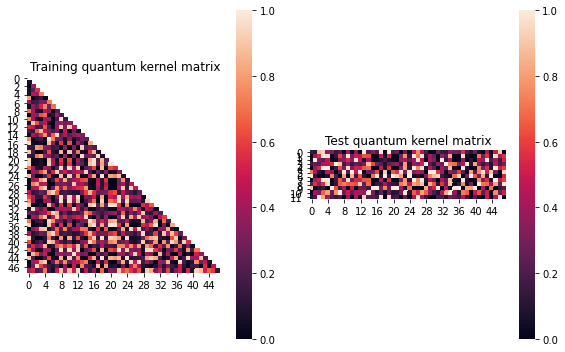


SVM with quantum kernel trained!


Test set performance:


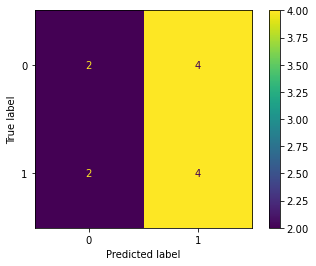

              precision    recall  f1-score   support

           0       0.50      0.33      0.40         6
           1       0.50      0.67      0.57         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.49        12
weighted avg       0.50      0.50      0.49        12


metric 1: 0.0060582954438170855
metric(s) 2: (00, 10, 11) = (0.38190220706413797, 0.38893608337353713, 0.4080865505705705)
metric 3: 7.227747544979959e-307


----> Kernel construction duration: 00:02:51


Combination 401/468
(Current range: 33/46)
			 reps : 3
			 paulis : ['YX', 'XY']
			 entanglement : linear

Feature map:


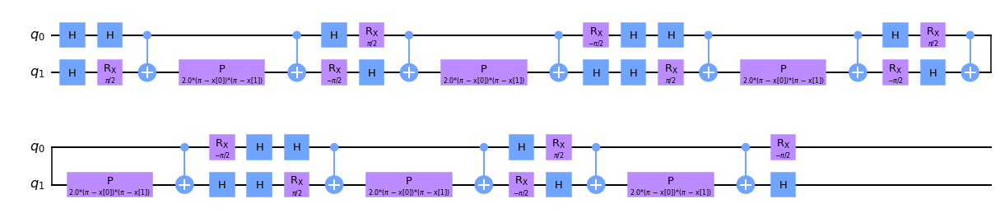


Quantum kernel matrices:



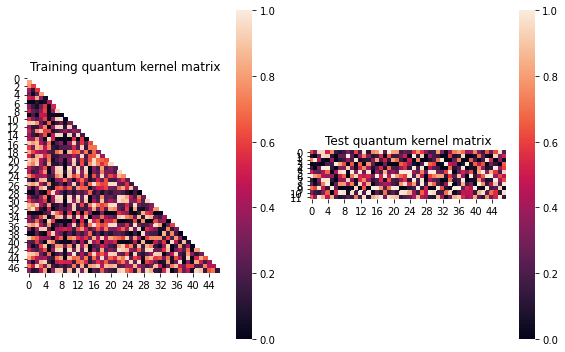


SVM with quantum kernel trained!


Test set performance:


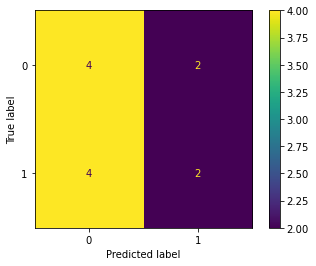

              precision    recall  f1-score   support

           0       0.50      0.67      0.57         6
           1       0.50      0.33      0.40         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.49        12
weighted avg       0.50      0.50      0.49        12


metric 1: 0.007424233691085802
metric(s) 2: (00, 10, 11) = (0.45832292875091407, 0.44197345073388516, 0.44047244009902786)
metric 3: 0.0


----> Kernel construction duration: 00:03:24


Combination 402/468
(Current range: 34/46)
			 reps : 3
			 paulis : ['YX', 'XZ']
			 entanglement : linear

Feature map:


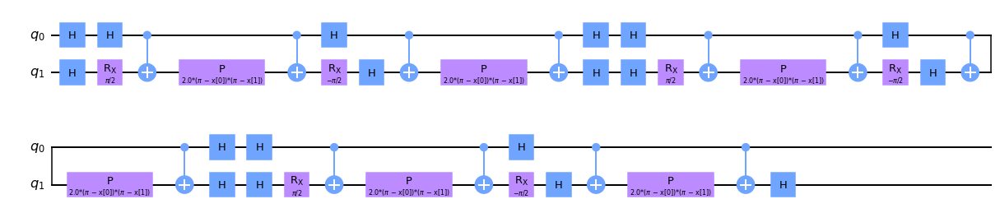


Quantum kernel matrices:



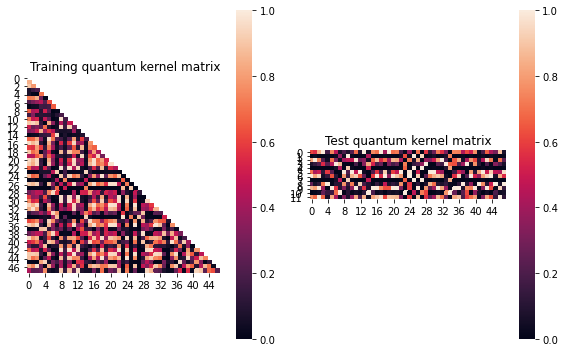


SVM with quantum kernel trained!


Test set performance:


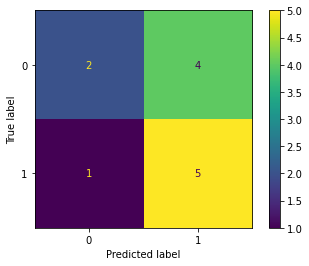

              precision    recall  f1-score   support

           0       0.67      0.33      0.44         6
           1       0.56      0.83      0.67         6

    accuracy                           0.58        12
   macro avg       0.61      0.58      0.56        12
weighted avg       0.61      0.58      0.56        12


metric 1: 0.009365863936292296
metric(s) 2: (00, 10, 11) = (0.4108349471331685, 0.3956662991369575, 0.3992293790133311)
metric 3: -3.345e-321


----> Kernel construction duration: 00:03:03


Combination 403/468
(Current range: 35/46)
			 reps : 3
			 paulis : ['YX', 'YX']
			 entanglement : linear

Feature map:


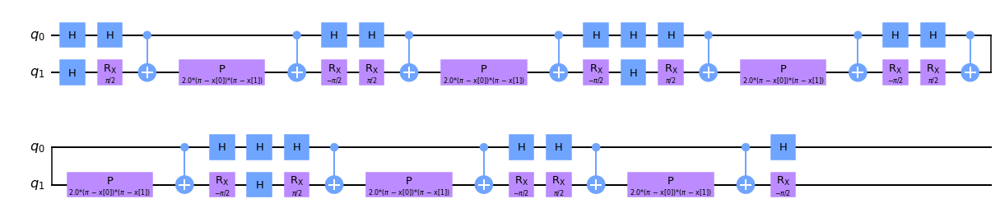


Quantum kernel matrices:



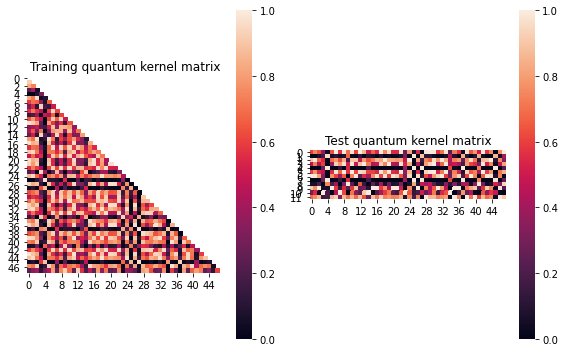


SVM with quantum kernel trained!


Test set performance:


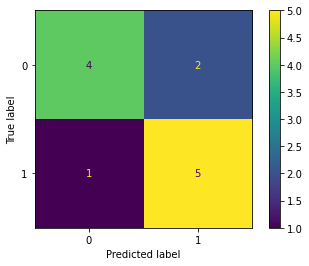

              precision    recall  f1-score   support

           0       0.80      0.67      0.73         6
           1       0.71      0.83      0.77         6

    accuracy                           0.75        12
   macro avg       0.76      0.75      0.75        12
weighted avg       0.76      0.75      0.75        12


metric 1: 0.016120447462909637
metric(s) 2: (00, 10, 11) = (0.5549784887985051, 0.5164631002235872, 0.5101886065744887)
metric 3: -0.0


----> Kernel construction duration: 00:01:54


Combination 404/468
(Current range: 36/46)
			 reps : 3
			 paulis : ['YX', 'YY']
			 entanglement : linear

Feature map:


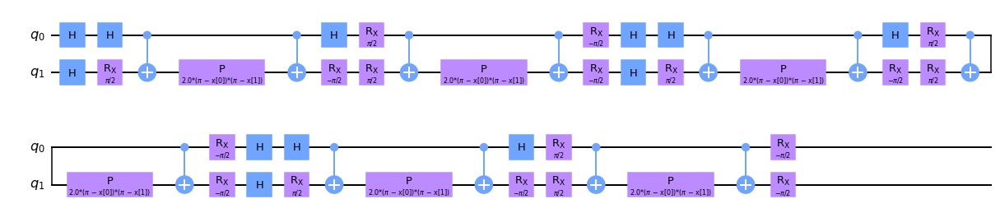


Quantum kernel matrices:



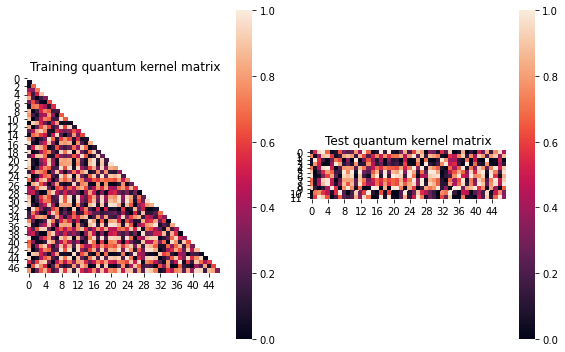


SVM with quantum kernel trained!


Test set performance:


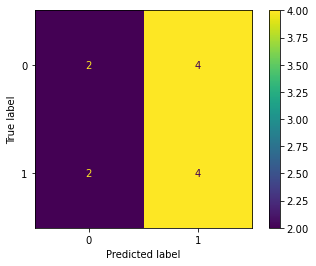

              precision    recall  f1-score   support

           0       0.50      0.33      0.40         6
           1       0.50      0.67      0.57         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.49        12
weighted avg       0.50      0.50      0.49        12


metric 1: 0.0040954703751248656
metric(s) 2: (00, 10, 11) = (0.48190381292458956, 0.48619143110532304, 0.49866999003630624)
metric 3: -7.4e-323


----> Kernel construction duration: 00:02:59


Combination 405/468
(Current range: 37/46)
			 reps : 3
			 paulis : ['YX', 'YZ']
			 entanglement : linear

Feature map:


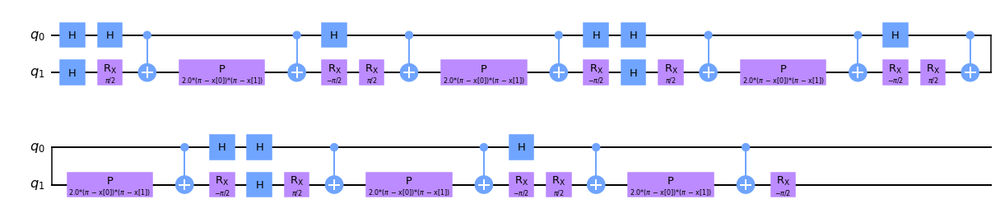


Quantum kernel matrices:



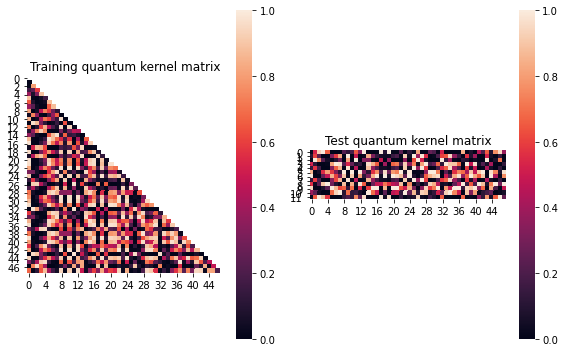


SVM with quantum kernel trained!


Test set performance:


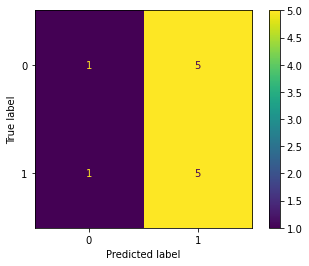

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.0043981638793463285
metric(s) 2: (00, 10, 11) = (0.40613189036271397, 0.4130157528605851, 0.4286959431171489)
metric 3: -0.0


----> Kernel construction duration: 00:02:39


Combination 406/468
(Current range: 38/46)
			 reps : 3
			 paulis : ['YX', 'ZX']
			 entanglement : linear

Feature map:


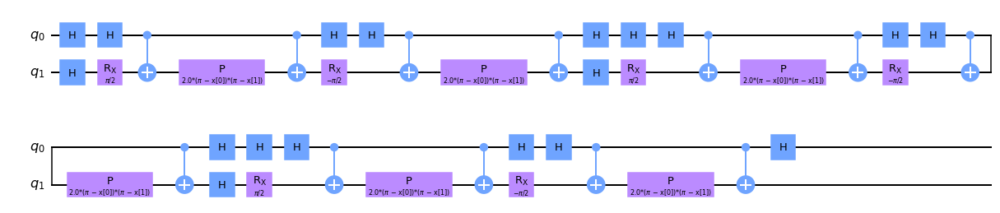


Quantum kernel matrices:



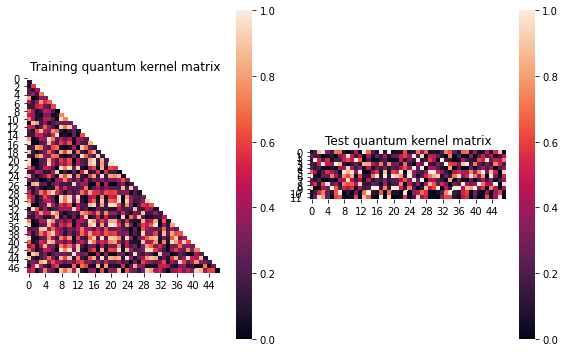


SVM with quantum kernel trained!


Test set performance:


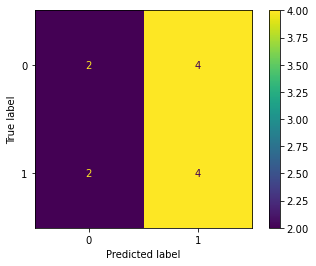

              precision    recall  f1-score   support

           0       0.50      0.33      0.40         6
           1       0.50      0.67      0.57         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.49        12
weighted avg       0.50      0.50      0.49        12


metric 1: 0.004914247995503218
metric(s) 2: (00, 10, 11) = (0.40469256624131983, 0.4011118319927053, 0.4073595937350971)
metric 3: 2.6673495304759083e-305


----> Kernel construction duration: 00:02:50


Combination 407/468
(Current range: 39/46)
			 reps : 3
			 paulis : ['YX', 'ZY']
			 entanglement : linear

Feature map:


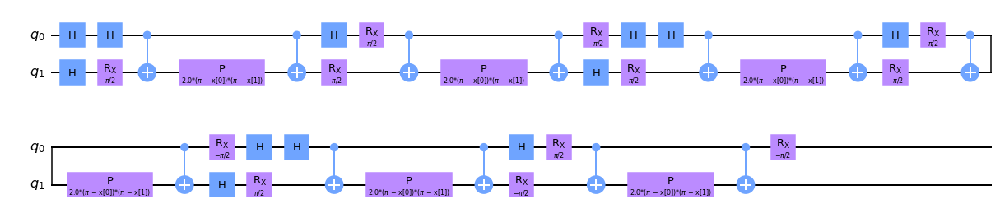


Quantum kernel matrices:



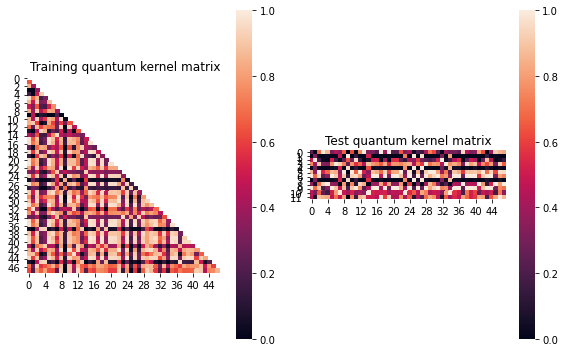


SVM with quantum kernel trained!


Test set performance:


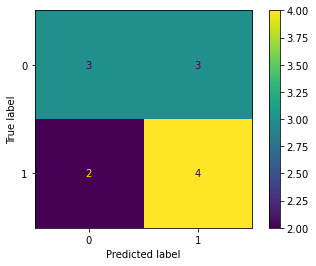

              precision    recall  f1-score   support

           0       0.60      0.50      0.55         6
           1       0.57      0.67      0.62         6

    accuracy                           0.58        12
   macro avg       0.59      0.58      0.58        12
weighted avg       0.59      0.58      0.58        12


metric 1: 0.004979825325543197
metric(s) 2: (00, 10, 11) = (0.5569815807190397, 0.5784034366808145, 0.6097849432936757)
metric 3: -0.0


----> Kernel construction duration: 00:03:23


Combination 408/468
(Current range: 40/46)
			 reps : 3
			 paulis : ['YX', 'ZZ']
			 entanglement : linear

Feature map:


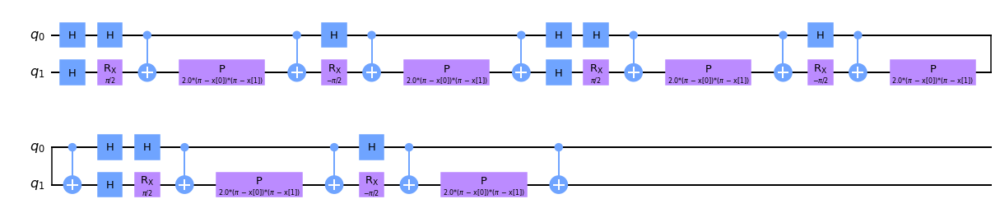


Quantum kernel matrices:



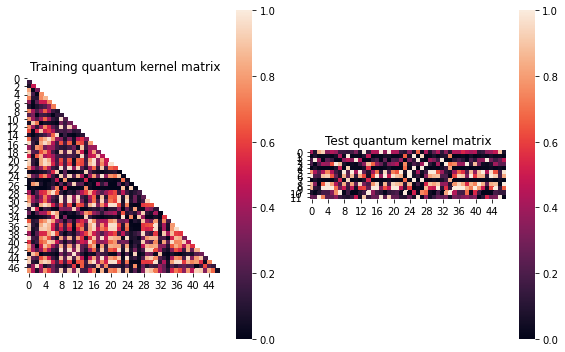


SVM with quantum kernel trained!


Test set performance:


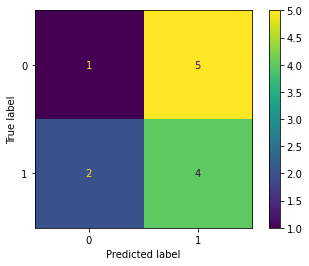

              precision    recall  f1-score   support

           0       0.33      0.17      0.22         6
           1       0.44      0.67      0.53         6

    accuracy                           0.42        12
   macro avg       0.39      0.42      0.38        12
weighted avg       0.39      0.42      0.38        12


metric 1: 0.010104769633572985
metric(s) 2: (00, 10, 11) = (0.41671556027514145, 0.4065562017362498, 0.4166063824645041)
metric 3: -0.0


----> Kernel construction duration: 00:03:02


Combination 409/468
(Current range: 41/46)
			 reps : 3
			 paulis : ['YY', 'X']
			 entanglement : linear

Feature map:


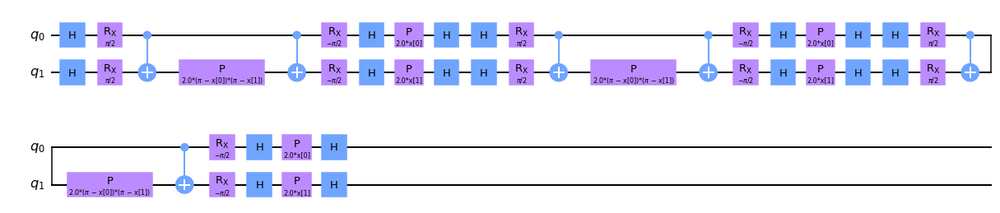


Quantum kernel matrices:



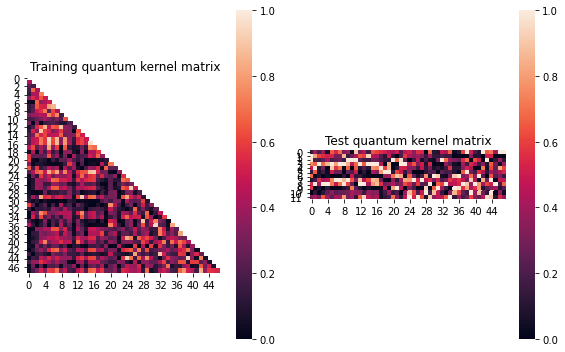


SVM with quantum kernel trained!


Test set performance:


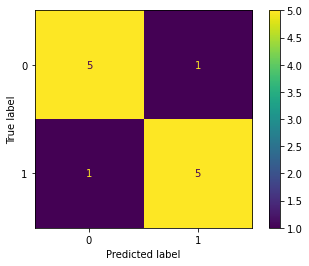

              precision    recall  f1-score   support

           0       0.83      0.83      0.83         6
           1       0.83      0.83      0.83         6

    accuracy                           0.83        12
   macro avg       0.83      0.83      0.83        12
weighted avg       0.83      0.83      0.83        12


metric 1: 0.12082552134610336
metric(s) 2: (00, 10, 11) = (0.3946073070785094, 0.268670019905378, 0.38438377542445334)
metric 3: 4.035313602185153e-269


----> Kernel construction duration: 00:02:33


Combination 410/468
(Current range: 42/46)
			 reps : 3
			 paulis : ['YY', 'Y']
			 entanglement : linear

Feature map:


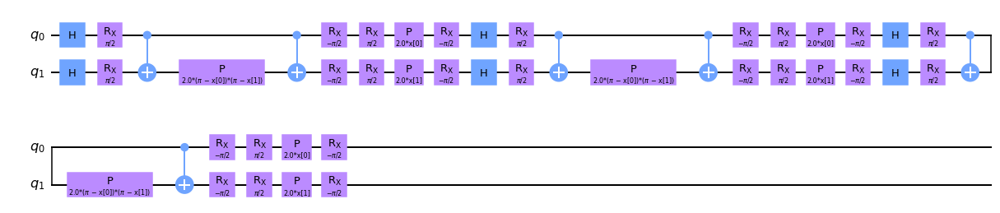


Quantum kernel matrices:



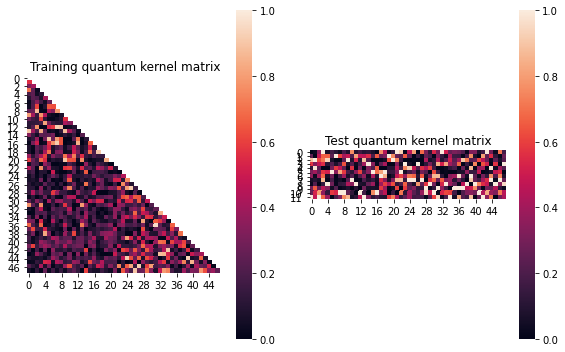


SVM with quantum kernel trained!


Test set performance:


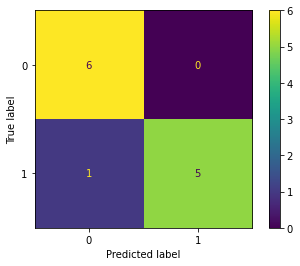

              precision    recall  f1-score   support

           0       0.86      1.00      0.92         6
           1       1.00      0.83      0.91         6

    accuracy                           0.92        12
   macro avg       0.93      0.92      0.92        12
weighted avg       0.93      0.92      0.92        12


metric 1: 0.1201323759039844
metric(s) 2: (00, 10, 11) = (0.2894744527589736, 0.19722860970974876, 0.3452475184684927)
metric 3: 3.0856046607738535e-273


----> Kernel construction duration: 00:02:27


Combination 411/468
(Current range: 43/46)
			 reps : 3
			 paulis : ['YY', 'Z']
			 entanglement : linear

Feature map:


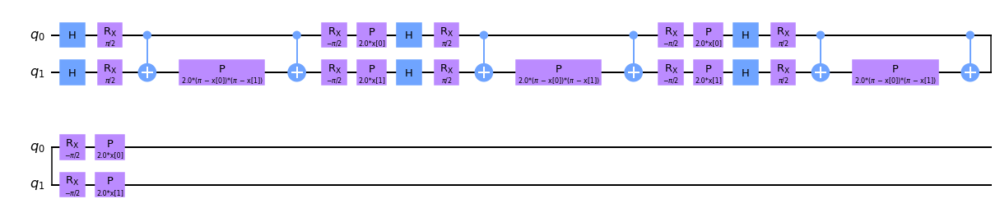


Quantum kernel matrices:



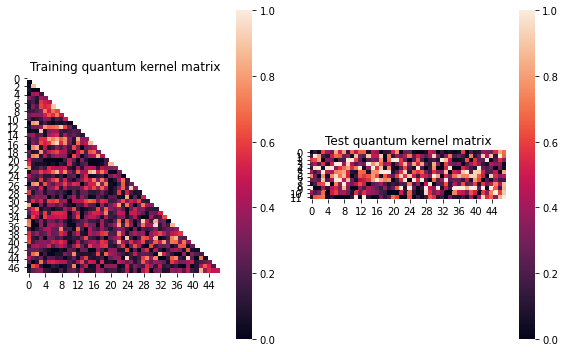


SVM with quantum kernel trained!


Test set performance:


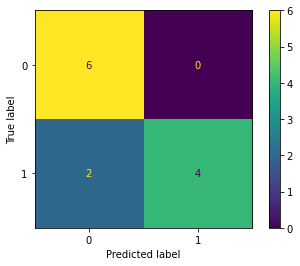

              precision    recall  f1-score   support

           0       0.75      1.00      0.86         6
           1       1.00      0.67      0.80         6

    accuracy                           0.83        12
   macro avg       0.88      0.83      0.83        12
weighted avg       0.88      0.83      0.83        12


metric 1: 0.07316580298959985
metric(s) 2: (00, 10, 11) = (0.36498468312946475, 0.283025302241958, 0.34739752733365087)
metric 3: 9.98585381287196e-270


----> Kernel construction duration: 00:02:31


Combination 412/468
(Current range: 44/46)
			 reps : 3
			 paulis : ['YY', 'XX']
			 entanglement : linear

Feature map:


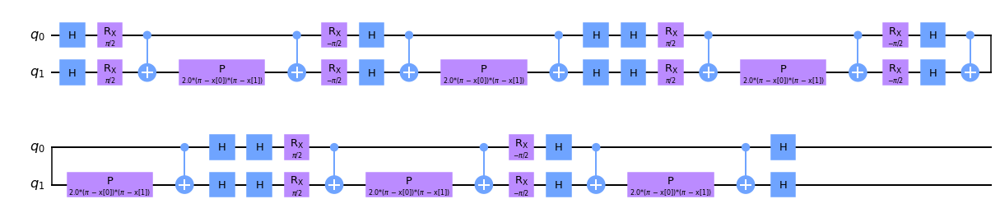


Quantum kernel matrices:



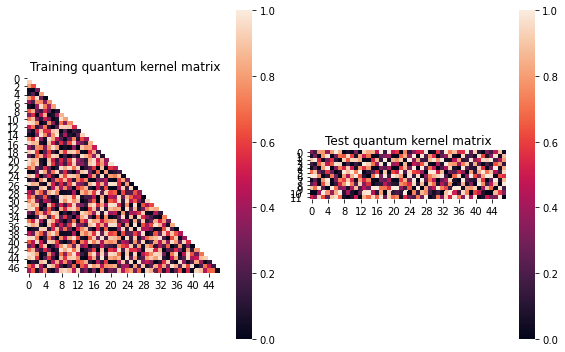


SVM with quantum kernel trained!


Test set performance:


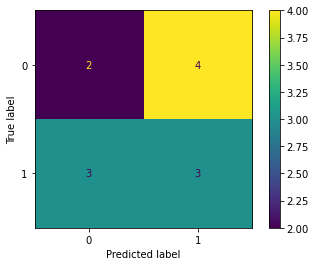

              precision    recall  f1-score   support

           0       0.40      0.33      0.36         6
           1       0.43      0.50      0.46         6

    accuracy                           0.42        12
   macro avg       0.41      0.42      0.41        12
weighted avg       0.41      0.42      0.41        12


metric 1: 0.005189231185427912
metric(s) 2: (00, 10, 11) = (0.49936335961957806, 0.494900756823733, 0.5008166163987438)
metric 3: 0.0


----> Kernel construction duration: 00:03:34


Combination 413/468
(Current range: 45/46)
			 reps : 3
			 paulis : ['YY', 'XY']
			 entanglement : linear

Feature map:


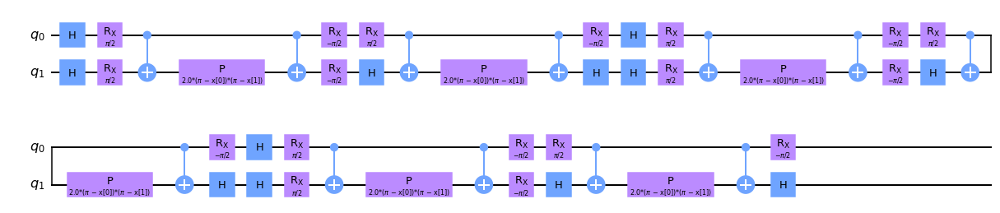


Quantum kernel matrices:



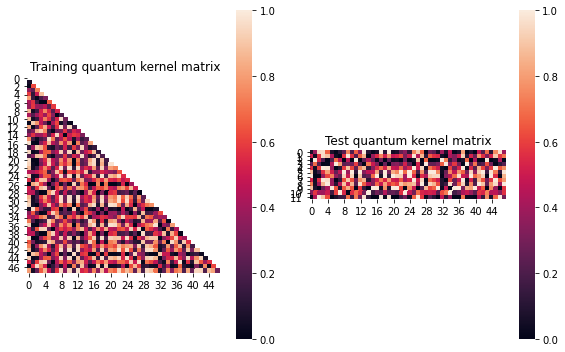


SVM with quantum kernel trained!


Test set performance:


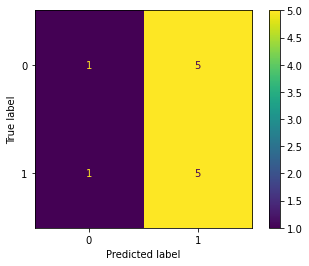

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.0004754036178456489
metric(s) 2: (00, 10, 11) = (0.47391351545705795, 0.4798052240942348, 0.486647739967103)
metric 3: -2.804035e-318


----> Kernel construction duration: 00:03:08


Combination 414/468
(Current range: 46/46)
			 reps : 3
			 paulis : ['YY', 'XZ']
			 entanglement : linear

Feature map:


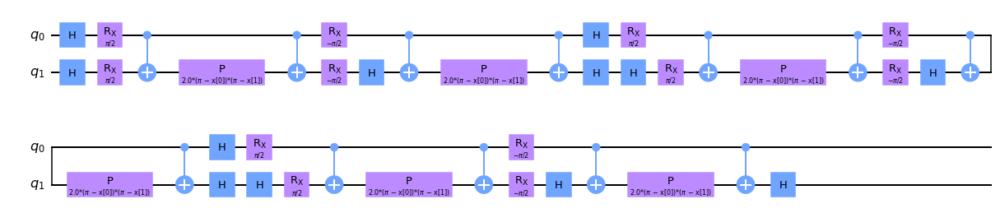


Quantum kernel matrices:



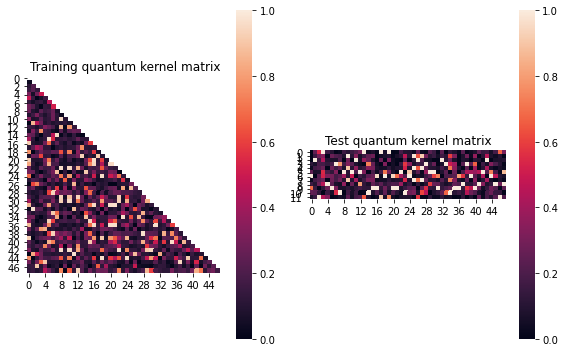


SVM with quantum kernel trained!


Test set performance:


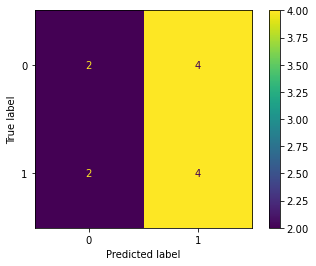

              precision    recall  f1-score   support

           0       0.50      0.33      0.40         6
           1       0.50      0.67      0.57         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.49        12
weighted avg       0.50      0.50      0.49        12


metric 1: 0.014636704314154259
metric(s) 2: (00, 10, 11) = (0.26711969340770353, 0.2593449445847664, 0.28084360439013784)
metric 3: -5.373559490002794e-289


----> Kernel construction duration: 00:03:33


In [21]:
j=8
results.append(run_kernel_evaluation(X, X_train, y_train, X_test, y_test,
                                      param_grid, range_list, j, model=True))



Combination 415/468
(Current range: 1/54)
			 reps : 3
			 paulis : ['YY', 'YX']
			 entanglement : linear

Feature map:


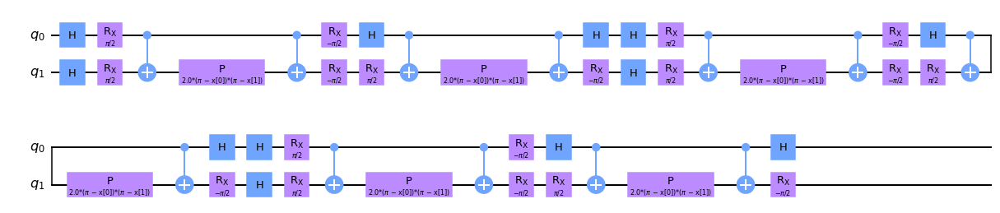


Quantum kernel matrices:



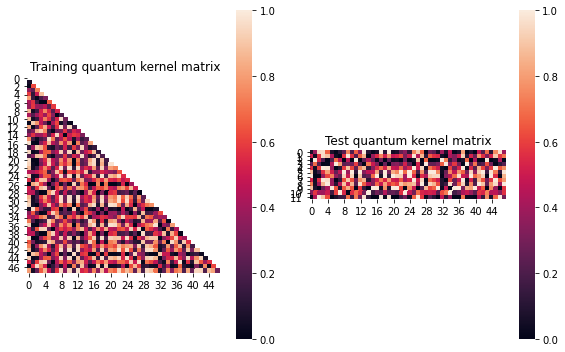


SVM with quantum kernel trained!


Test set performance:


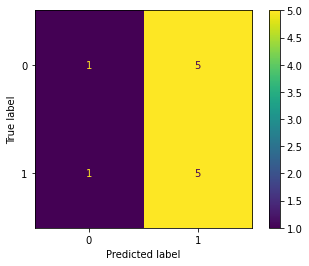

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.0004754036178456489
metric(s) 2: (00, 10, 11) = (0.47391351545705795, 0.4798052240942348, 0.486647739967103)
metric 3: -2.804035e-318


----> Kernel construction duration: 00:03:09


Combination 416/468
(Current range: 2/54)
			 reps : 3
			 paulis : ['YY', 'YY']
			 entanglement : linear

Feature map:


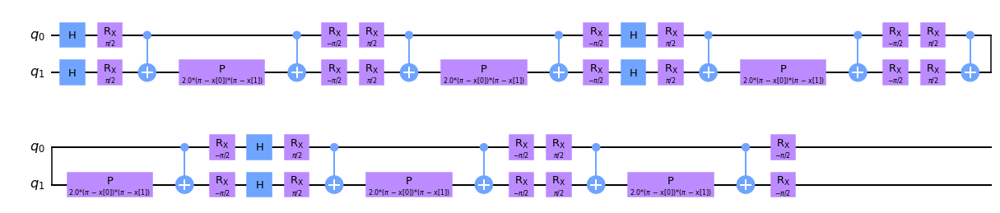


Quantum kernel matrices:



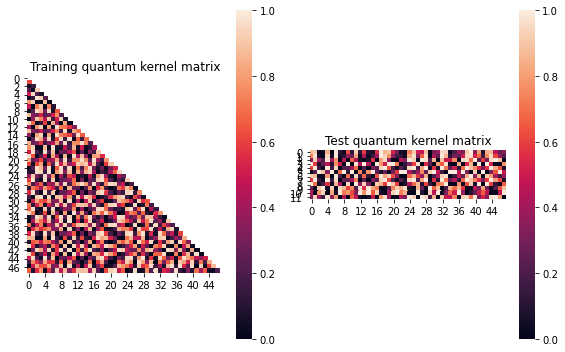


SVM with quantum kernel trained!


Test set performance:


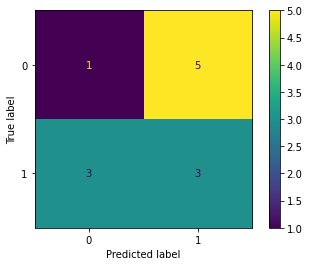

              precision    recall  f1-score   support

           0       0.25      0.17      0.20         6
           1       0.38      0.50      0.43         6

    accuracy                           0.33        12
   macro avg       0.31      0.33      0.31        12
weighted avg       0.31      0.33      0.31        12


metric 1: 0.04498272503401407
metric(s) 2: (00, 10, 11) = (0.5088040805308363, 0.46384102821240464, 0.5088434259620012)
metric 3: 0.0


----> Kernel construction duration: 00:02:10


Combination 417/468
(Current range: 3/54)
			 reps : 3
			 paulis : ['YY', 'YZ']
			 entanglement : linear

Feature map:


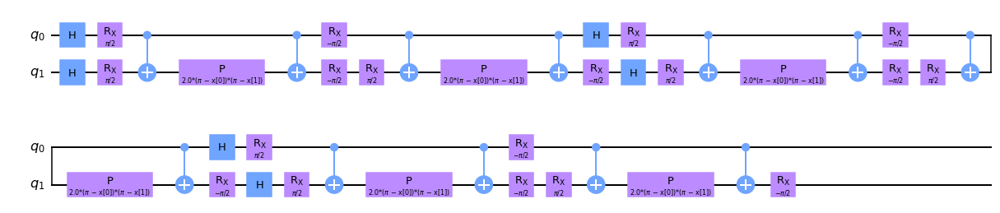


Quantum kernel matrices:



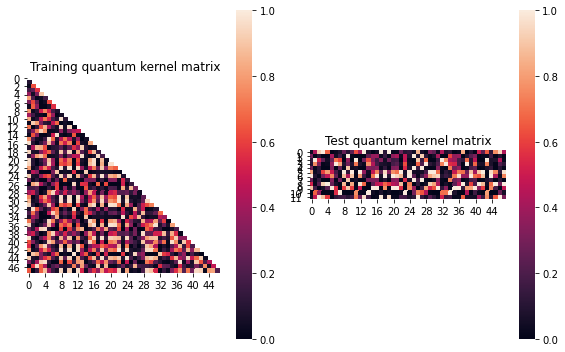


SVM with quantum kernel trained!


Test set performance:


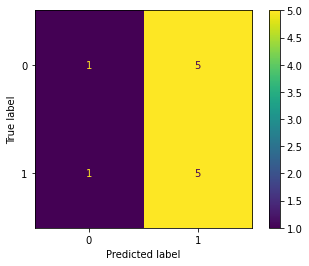

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.0057811583211355155
metric(s) 2: (00, 10, 11) = (0.3776952307958584, 0.37724752659472544, 0.3883621390358635)
metric 3: 1.067e-321


----> Kernel construction duration: 00:03:10


Combination 418/468
(Current range: 4/54)
			 reps : 3
			 paulis : ['YY', 'ZX']
			 entanglement : linear

Feature map:


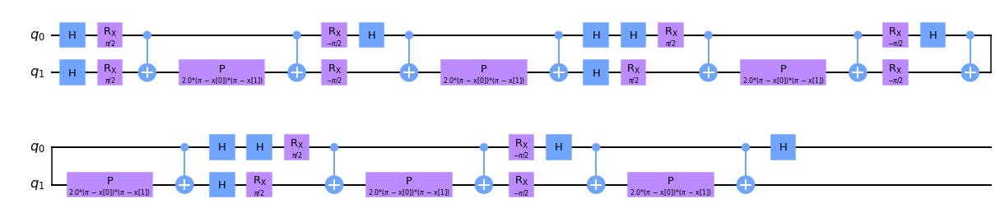


Quantum kernel matrices:



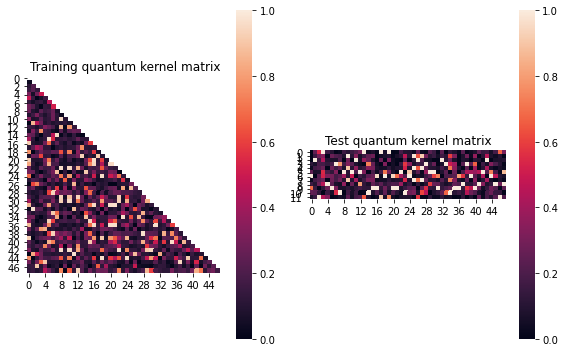


SVM with quantum kernel trained!


Test set performance:


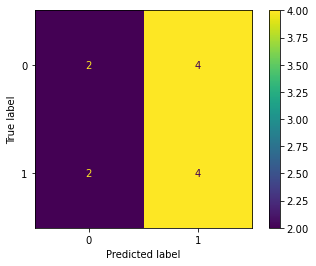

              precision    recall  f1-score   support

           0       0.50      0.33      0.40         6
           1       0.50      0.67      0.57         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.49        12
weighted avg       0.50      0.50      0.49        12


metric 1: 0.014636704314154259
metric(s) 2: (00, 10, 11) = (0.26711969340770353, 0.2593449445847664, 0.28084360439013784)
metric 3: -5.373559490002794e-289


----> Kernel construction duration: 00:03:32


Combination 419/468
(Current range: 5/54)
			 reps : 3
			 paulis : ['YY', 'ZY']
			 entanglement : linear

Feature map:


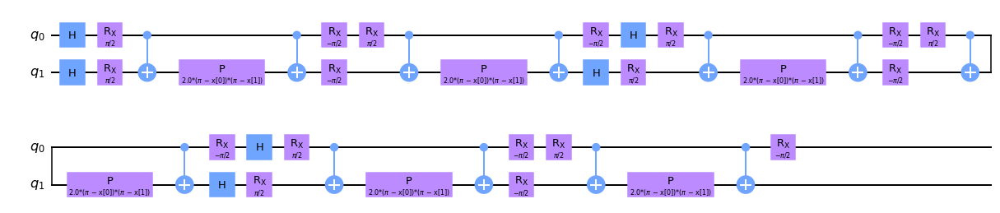


Quantum kernel matrices:



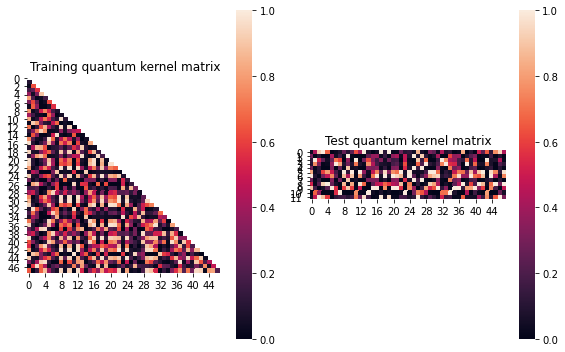


SVM with quantum kernel trained!


Test set performance:


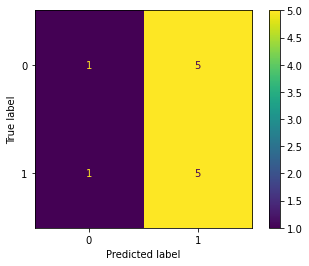

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.0057811583211355155
metric(s) 2: (00, 10, 11) = (0.3776952307958584, 0.37724752659472544, 0.3883621390358635)
metric 3: 1.067e-321


----> Kernel construction duration: 00:03:09


Combination 420/468
(Current range: 6/54)
			 reps : 3
			 paulis : ['YY', 'ZZ']
			 entanglement : linear

Feature map:


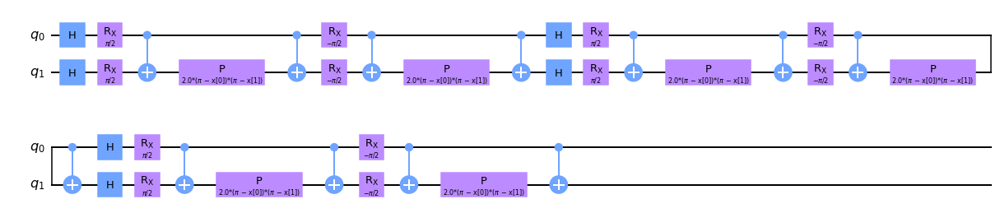


Quantum kernel matrices:



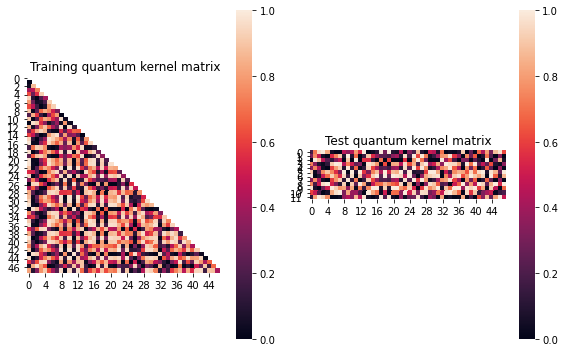


SVM with quantum kernel trained!


Test set performance:


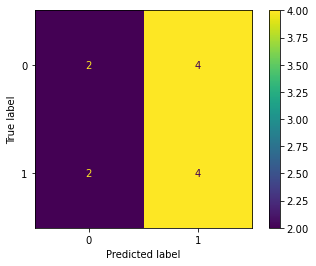

              precision    recall  f1-score   support

           0       0.50      0.33      0.40         6
           1       0.50      0.67      0.57         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.49        12
weighted avg       0.50      0.50      0.49        12


metric 1: 0.0030024471480464276
metric(s) 2: (00, 10, 11) = (0.5194729525883561, 0.5274296115848754, 0.5413911648774875)
metric 3: 0.0


----> Kernel construction duration: 00:03:31


Combination 421/468
(Current range: 7/54)
			 reps : 3
			 paulis : ['YZ', 'X']
			 entanglement : linear

Feature map:


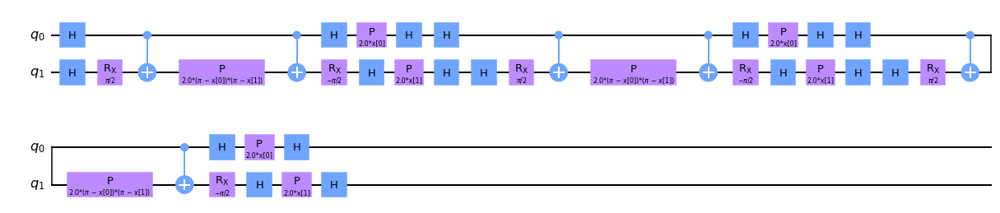


Quantum kernel matrices:



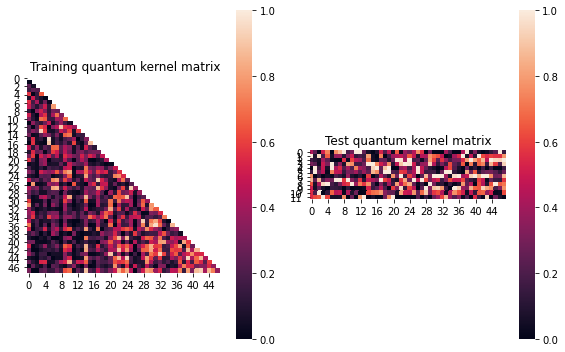


SVM with quantum kernel trained!


Test set performance:


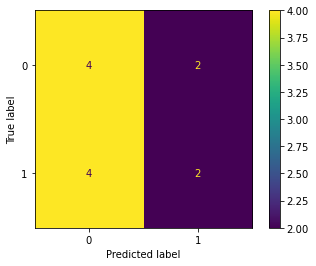

              precision    recall  f1-score   support

           0       0.50      0.67      0.57         6
           1       0.50      0.33      0.40         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.49        12
weighted avg       0.50      0.50      0.49        12


metric 1: 0.11556824966103546
metric(s) 2: (00, 10, 11) = (0.3124640387790779, 0.25098640524732707, 0.42064527103764715)
metric 3: -2.1366744119874127e-256


----> Kernel construction duration: 00:02:27


Combination 422/468
(Current range: 8/54)
			 reps : 3
			 paulis : ['YZ', 'Y']
			 entanglement : linear

Feature map:


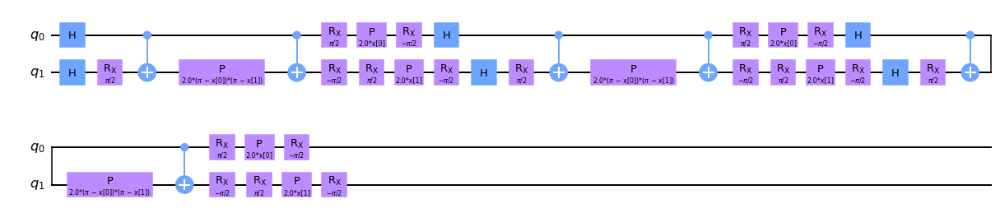


Quantum kernel matrices:



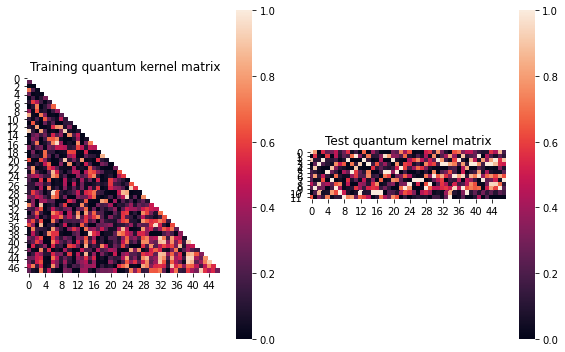


SVM with quantum kernel trained!


Test set performance:


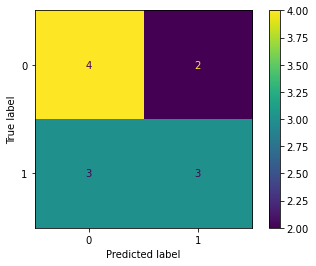

              precision    recall  f1-score   support

           0       0.57      0.67      0.62         6
           1       0.60      0.50      0.55         6

    accuracy                           0.58        12
   macro avg       0.59      0.58      0.58        12
weighted avg       0.59      0.58      0.58        12


metric 1: 0.09572879602624096
metric(s) 2: (00, 10, 11) = (0.26754601613613627, 0.25577304474520357, 0.43545766540675274)
metric 3: 4.956550400153971e-292


----> Kernel construction duration: 00:02:29


Combination 423/468
(Current range: 9/54)
			 reps : 3
			 paulis : ['YZ', 'Z']
			 entanglement : linear

Feature map:


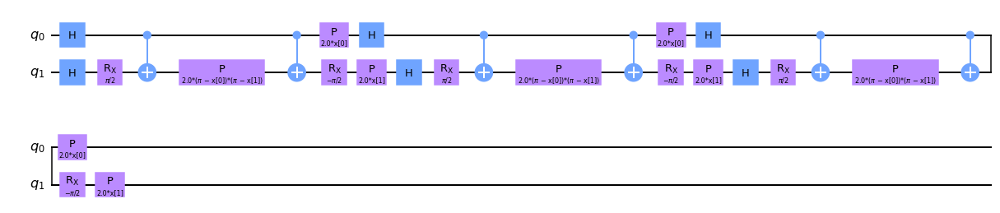


Quantum kernel matrices:



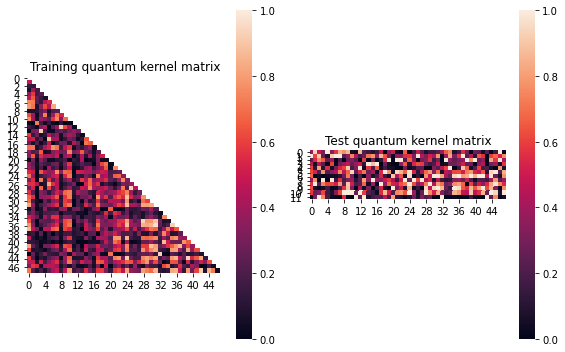


SVM with quantum kernel trained!


Test set performance:


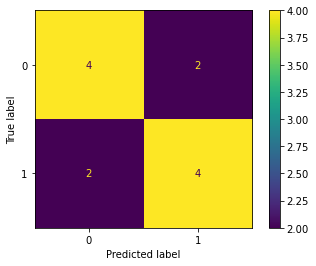

              precision    recall  f1-score   support

           0       0.67      0.67      0.67         6
           1       0.67      0.67      0.67         6

    accuracy                           0.67        12
   macro avg       0.67      0.67      0.67        12
weighted avg       0.67      0.67      0.67        12


metric 1: 0.0791437723191249
metric(s) 2: (00, 10, 11) = (0.33142097490361, 0.3020847501989991, 0.431036070132638)
metric 3: 5.3742909498350013e-269


----> Kernel construction duration: 00:02:25


Combination 424/468
(Current range: 10/54)
			 reps : 3
			 paulis : ['YZ', 'XX']
			 entanglement : linear

Feature map:


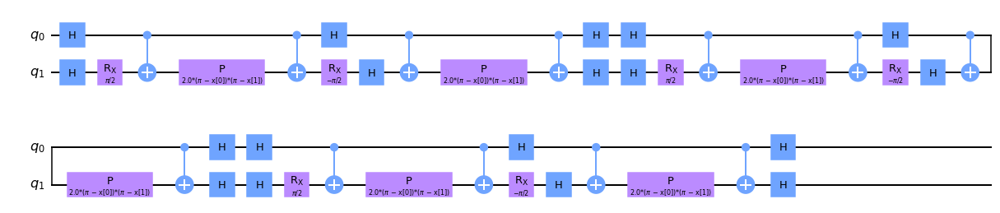


Quantum kernel matrices:



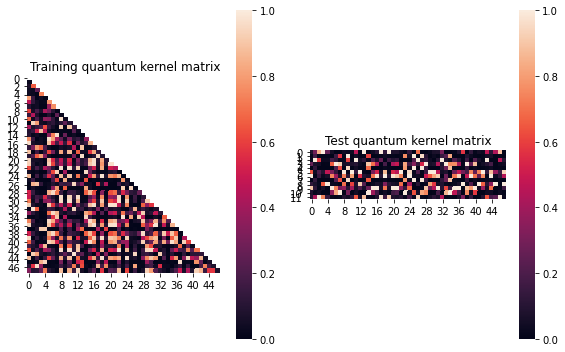


SVM with quantum kernel trained!


Test set performance:


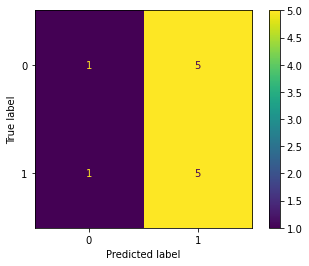

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.009334336671035504
metric(s) 2: (00, 10, 11) = (0.29815532311066256, 0.29684280124296386, 0.3141989527173361)
metric 3: 0.0


----> Kernel construction duration: 00:03:14


Combination 425/468
(Current range: 11/54)
			 reps : 3
			 paulis : ['YZ', 'XY']
			 entanglement : linear

Feature map:


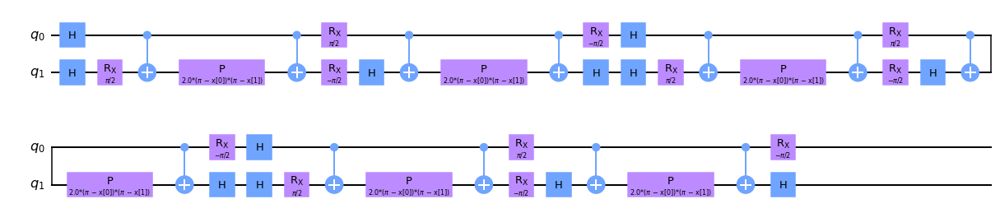


Quantum kernel matrices:



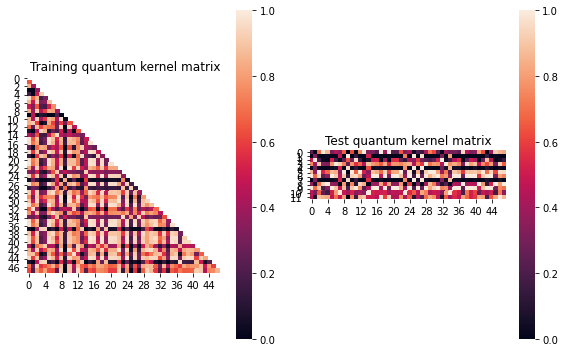


SVM with quantum kernel trained!


Test set performance:


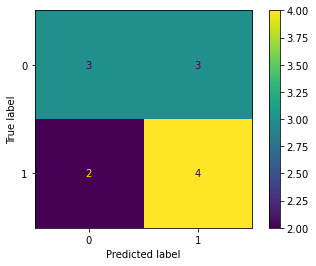

              precision    recall  f1-score   support

           0       0.60      0.50      0.55         6
           1       0.57      0.67      0.62         6

    accuracy                           0.58        12
   macro avg       0.59      0.58      0.58        12
weighted avg       0.59      0.58      0.58        12


metric 1: 0.004979825325543197
metric(s) 2: (00, 10, 11) = (0.5569815807190397, 0.5784034366808145, 0.6097849432936757)
metric 3: -0.0


----> Kernel construction duration: 00:03:34


Combination 426/468
(Current range: 12/54)
			 reps : 3
			 paulis : ['YZ', 'XZ']
			 entanglement : linear

Feature map:


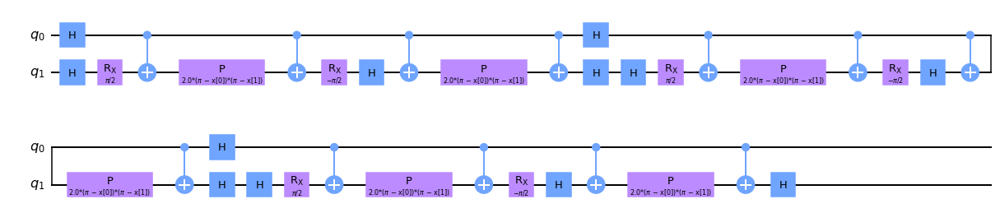


Quantum kernel matrices:



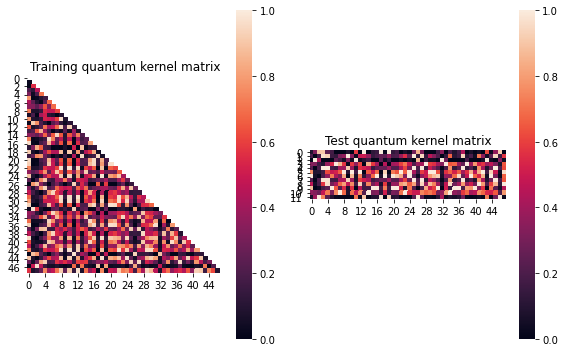


SVM with quantum kernel trained!


Test set performance:


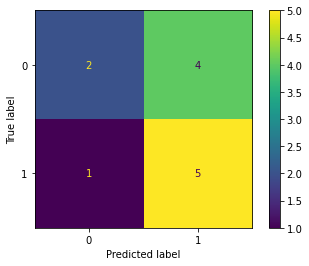

              precision    recall  f1-score   support

           0       0.67      0.33      0.44         6
           1       0.56      0.83      0.67         6

    accuracy                           0.58        12
   macro avg       0.61      0.58      0.56        12
weighted avg       0.61      0.58      0.56        12


metric 1: 0.006932975050718215
metric(s) 2: (00, 10, 11) = (0.39297380938008797, 0.4076670304576775, 0.43622620163670345)
metric 3: -1.0643384258832182e-292


----> Kernel construction duration: 00:03:04


Combination 427/468
(Current range: 13/54)
			 reps : 3
			 paulis : ['YZ', 'YX']
			 entanglement : linear

Feature map:


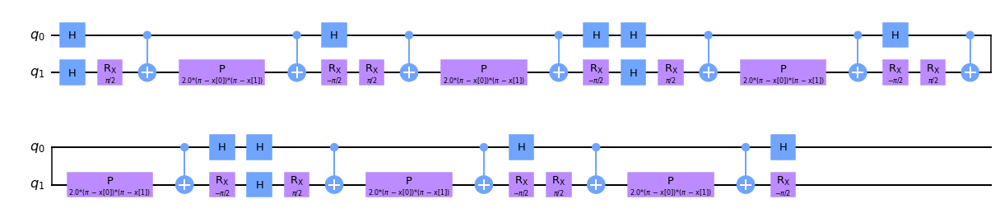


Quantum kernel matrices:



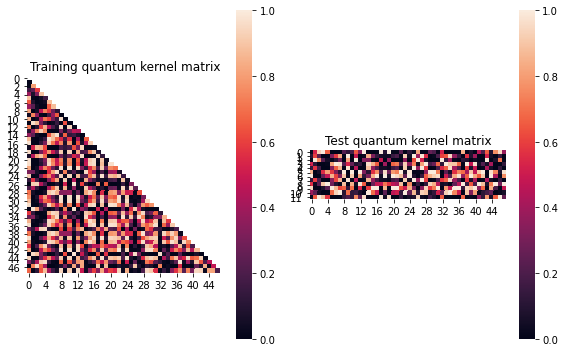


SVM with quantum kernel trained!


Test set performance:


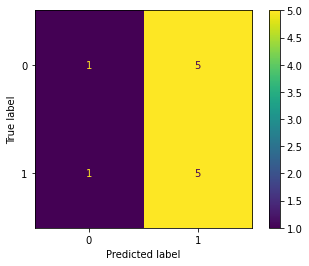

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.0043981638793463285
metric(s) 2: (00, 10, 11) = (0.40613189036271397, 0.4130157528605851, 0.4286959431171489)
metric 3: -0.0


----> Kernel construction duration: 00:02:49


Combination 428/468
(Current range: 14/54)
			 reps : 3
			 paulis : ['YZ', 'YY']
			 entanglement : linear

Feature map:


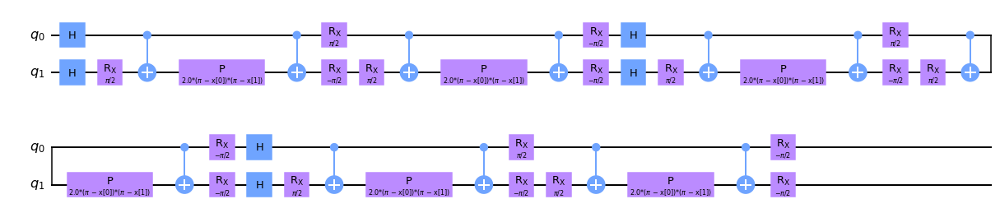


Quantum kernel matrices:



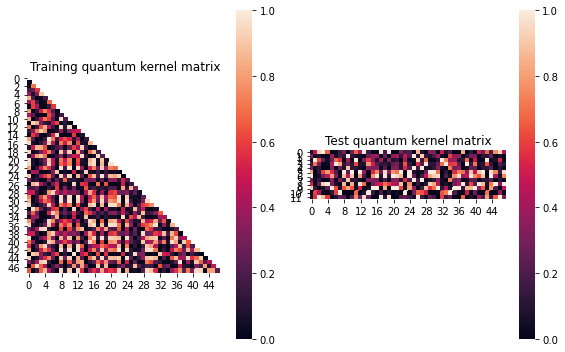


SVM with quantum kernel trained!


Test set performance:


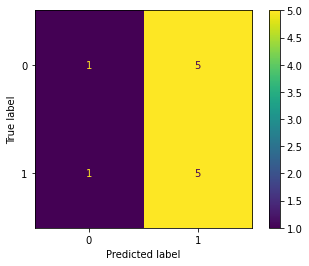

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.005102717696276959
metric(s) 2: (00, 10, 11) = (0.3871266313163287, 0.3875225353454616, 0.39812387476714844)
metric 3: -8.28e-321


----> Kernel construction duration: 00:03:09


Combination 429/468
(Current range: 15/54)
			 reps : 3
			 paulis : ['YZ', 'YZ']
			 entanglement : linear

Feature map:


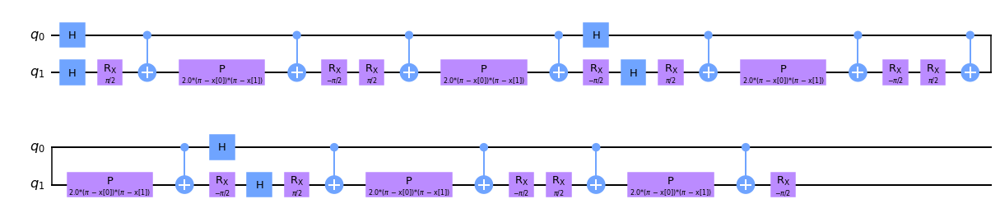


Quantum kernel matrices:



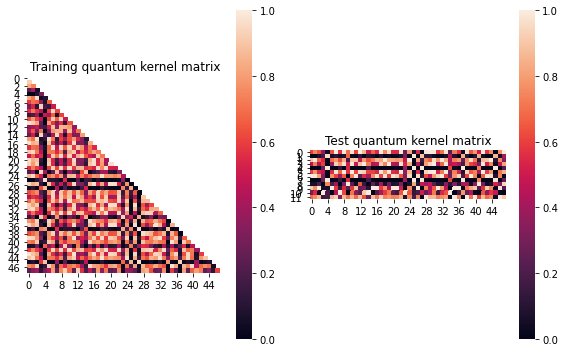


SVM with quantum kernel trained!


Test set performance:


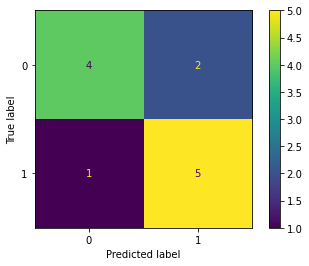

              precision    recall  f1-score   support

           0       0.80      0.67      0.73         6
           1       0.71      0.83      0.77         6

    accuracy                           0.75        12
   macro avg       0.76      0.75      0.75        12
weighted avg       0.76      0.75      0.75        12


metric 1: 0.016120447462909637
metric(s) 2: (00, 10, 11) = (0.5549784887985051, 0.5164631002235872, 0.5101886065744887)
metric 3: -0.0


----> Kernel construction duration: 00:02:05


Combination 430/468
(Current range: 16/54)
			 reps : 3
			 paulis : ['YZ', 'ZX']
			 entanglement : linear

Feature map:


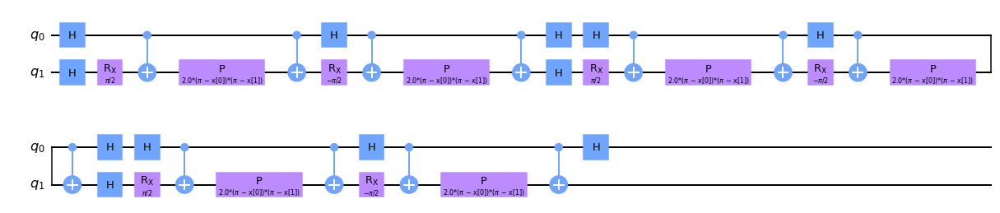


Quantum kernel matrices:



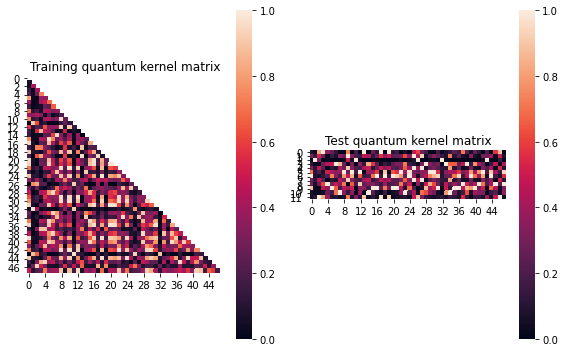


SVM with quantum kernel trained!


Test set performance:


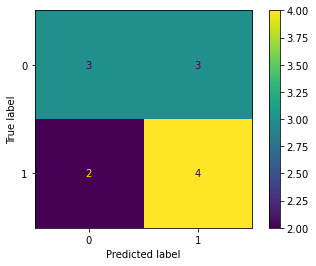

              precision    recall  f1-score   support

           0       0.60      0.50      0.55         6
           1       0.57      0.67      0.62         6

    accuracy                           0.58        12
   macro avg       0.59      0.58      0.58        12
weighted avg       0.59      0.58      0.58        12


metric 1: 0.007426662106061965
metric(s) 2: (00, 10, 11) = (0.36490633867847594, 0.37118322130947917, 0.39231342815260634)
metric 3: 2.5664e-319


----> Kernel construction duration: 00:03:12


Combination 431/468
(Current range: 17/54)
			 reps : 3
			 paulis : ['YZ', 'ZY']
			 entanglement : linear

Feature map:


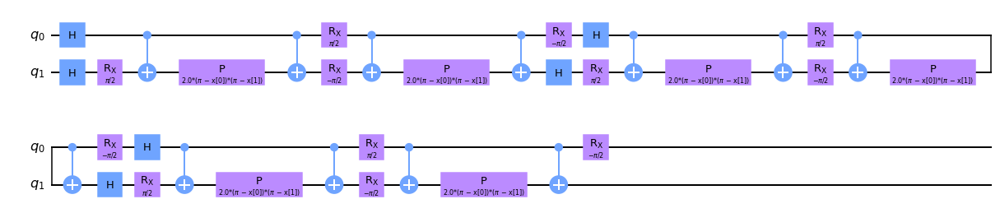


Quantum kernel matrices:



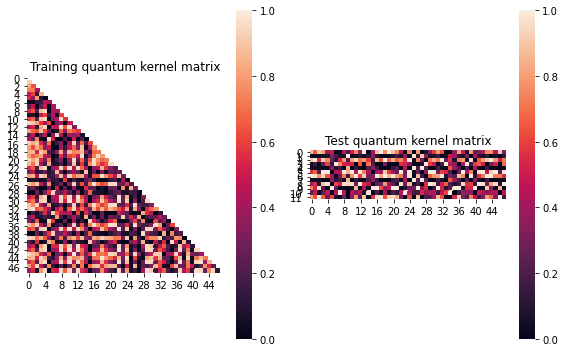


SVM with quantum kernel trained!


Test set performance:


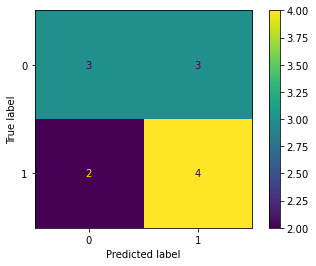

              precision    recall  f1-score   support

           0       0.60      0.50      0.55         6
           1       0.57      0.67      0.62         6

    accuracy                           0.58        12
   macro avg       0.59      0.58      0.58        12
weighted avg       0.59      0.58      0.58        12


metric 1: 0.010738694022345174
metric(s) 2: (00, 10, 11) = (0.48611396242851374, 0.4505782885953999, 0.4365200028069764)
metric 3: 0.0


----> Kernel construction duration: 00:03:31


Combination 432/468
(Current range: 18/54)
			 reps : 3
			 paulis : ['YZ', 'ZZ']
			 entanglement : linear

Feature map:


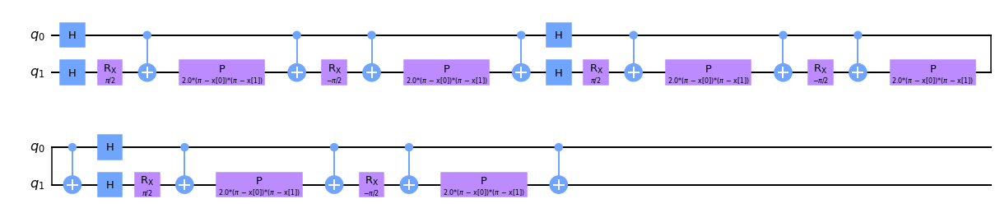


Quantum kernel matrices:



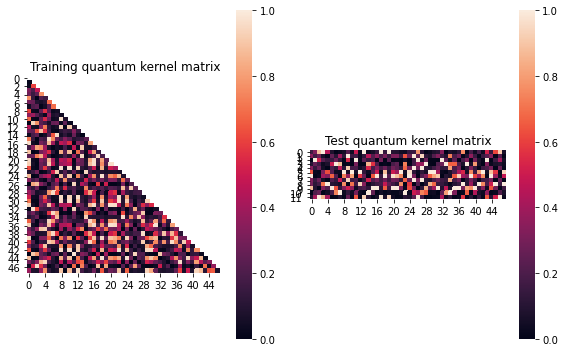


SVM with quantum kernel trained!


Test set performance:


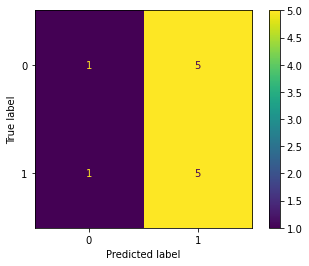

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.009020455004259076
metric(s) 2: (00, 10, 11) = (0.33219437324683554, 0.32894223972851316, 0.34373101621870894)
metric 3: -7.357887887201557e-308


----> Kernel construction duration: 00:03:04


Combination 433/468
(Current range: 19/54)
			 reps : 3
			 paulis : ['ZX', 'X']
			 entanglement : linear

Feature map:


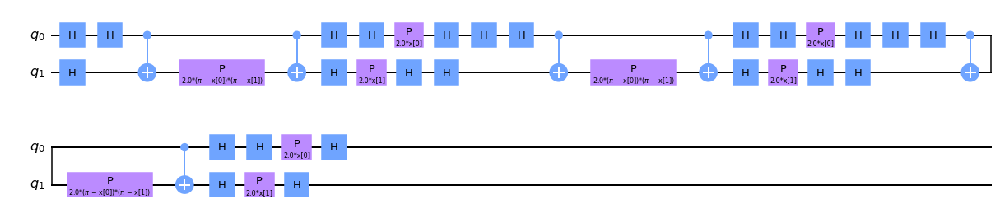


Quantum kernel matrices:



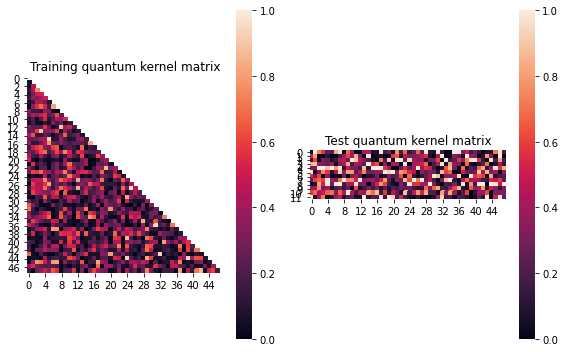


SVM with quantum kernel trained!


Test set performance:


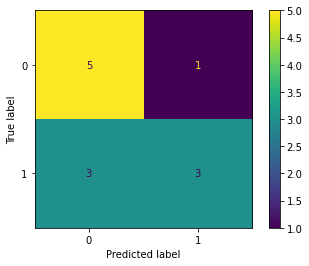

              precision    recall  f1-score   support

           0       0.62      0.83      0.71         6
           1       0.75      0.50      0.60         6

    accuracy                           0.67        12
   macro avg       0.69      0.67      0.66        12
weighted avg       0.69      0.67      0.66        12


metric 1: 0.04408249502545264
metric(s) 2: (00, 10, 11) = (0.32032557434697706, 0.26287098645337026, 0.29358138861066874)
metric 3: 5.069145915222757e-243


----> Kernel construction duration: 00:02:08


Combination 434/468
(Current range: 20/54)
			 reps : 3
			 paulis : ['ZX', 'Y']
			 entanglement : linear

Feature map:


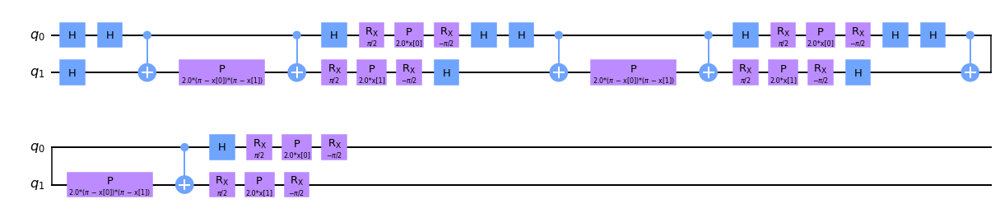


Quantum kernel matrices:



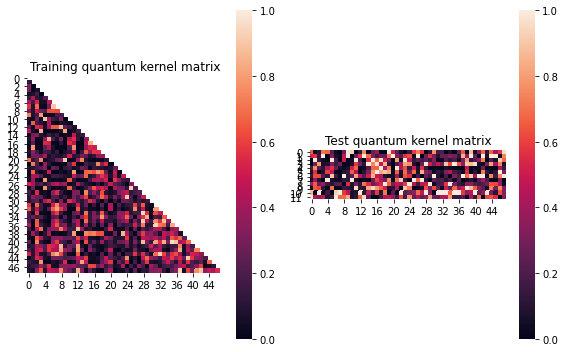


SVM with quantum kernel trained!


Test set performance:


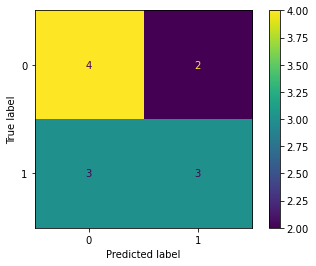

              precision    recall  f1-score   support

           0       0.57      0.67      0.62         6
           1       0.60      0.50      0.55         6

    accuracy                           0.58        12
   macro avg       0.59      0.58      0.58        12
weighted avg       0.59      0.58      0.58        12


metric 1: 0.06403659352734417
metric(s) 2: (00, 10, 11) = (0.2642735952578414, 0.24588147537483637, 0.35556254254651976)
metric 3: -3.5061678854112867e-270


----> Kernel construction duration: 00:02:20


Combination 435/468
(Current range: 21/54)
			 reps : 3
			 paulis : ['ZX', 'Z']
			 entanglement : linear

Feature map:


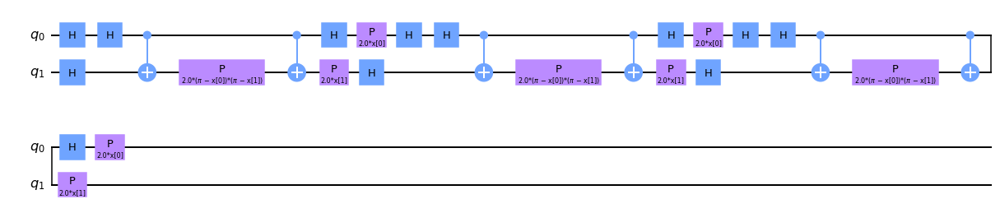


Quantum kernel matrices:



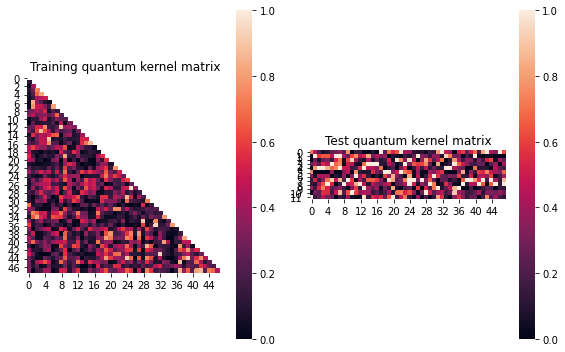


SVM with quantum kernel trained!


Test set performance:


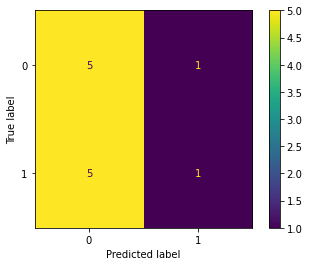

              precision    recall  f1-score   support

           0       0.50      0.83      0.62         6
           1       0.50      0.17      0.25         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.05021433682193327
metric(s) 2: (00, 10, 11) = (0.3099393383759823, 0.2667495273945913, 0.3239883900570668)
metric 3: 1.1275644727610234e-257


----> Kernel construction duration: 00:02:09


Combination 436/468
(Current range: 22/54)
			 reps : 3
			 paulis : ['ZX', 'XX']
			 entanglement : linear

Feature map:


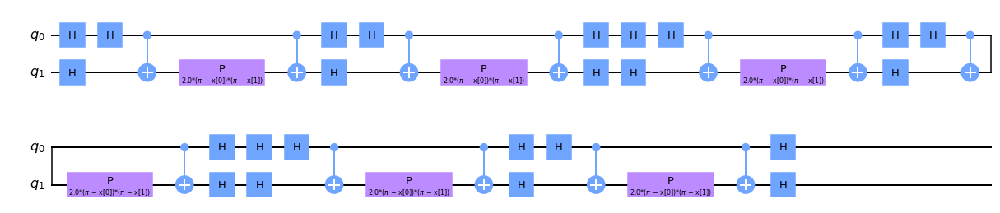


Quantum kernel matrices:



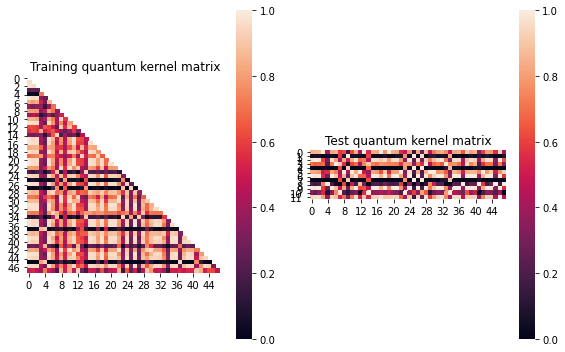


SVM with quantum kernel trained!


Test set performance:


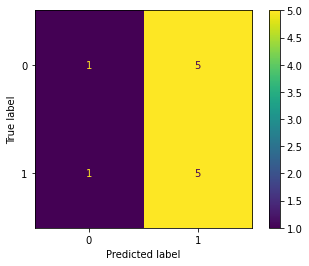

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.012908182444675176
metric(s) 2: (00, 10, 11) = (0.619597114711192, 0.5957250862059711, 0.5976694225901005)
metric 3: -0.0


----> Kernel construction duration: 00:02:32


Combination 437/468
(Current range: 23/54)
			 reps : 3
			 paulis : ['ZX', 'XY']
			 entanglement : linear

Feature map:


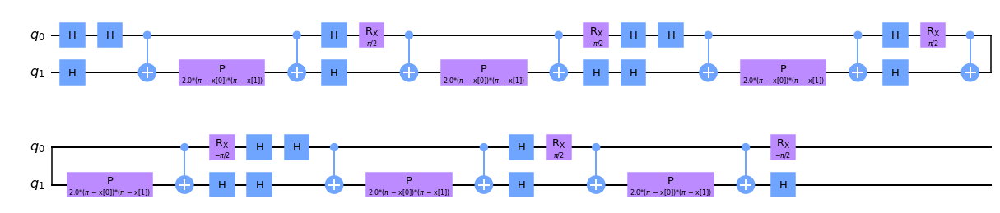


Quantum kernel matrices:



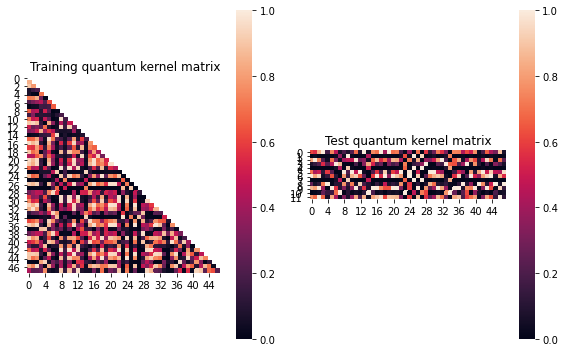


SVM with quantum kernel trained!


Test set performance:


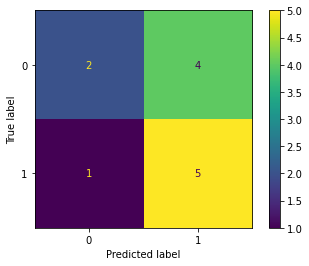

              precision    recall  f1-score   support

           0       0.67      0.33      0.44         6
           1       0.56      0.83      0.67         6

    accuracy                           0.58        12
   macro avg       0.61      0.58      0.56        12
weighted avg       0.61      0.58      0.56        12


metric 1: 0.009365863936292296
metric(s) 2: (00, 10, 11) = (0.4108349471331685, 0.3956662991369575, 0.3992293790133311)
metric 3: -3.345e-321


----> Kernel construction duration: 00:03:02


Combination 438/468
(Current range: 24/54)
			 reps : 3
			 paulis : ['ZX', 'XZ']
			 entanglement : linear

Feature map:


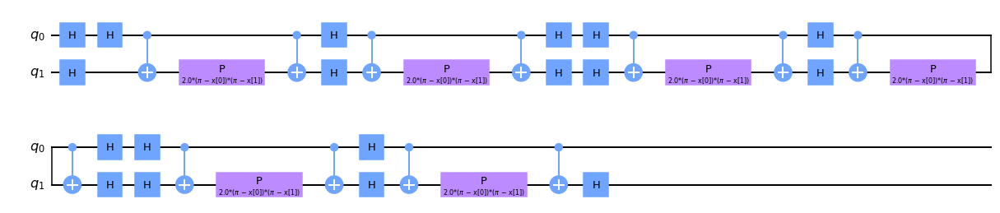


Quantum kernel matrices:



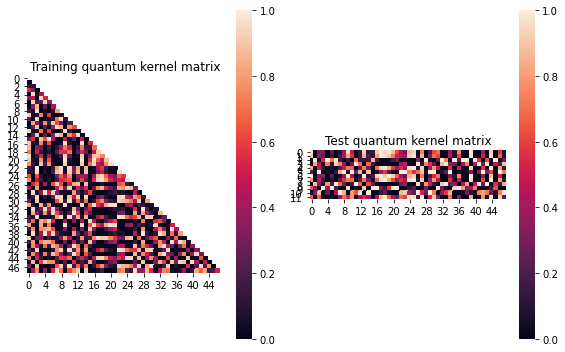


SVM with quantum kernel trained!


Test set performance:


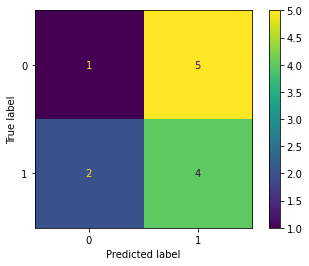

              precision    recall  f1-score   support

           0       0.33      0.17      0.22         6
           1       0.44      0.67      0.53         6

    accuracy                           0.42        12
   macro avg       0.39      0.42      0.38        12
weighted avg       0.39      0.42      0.38        12


metric 1: 0.027776264674632678
metric(s) 2: (00, 10, 11) = (0.38227135956608765, 0.3580416576859088, 0.38936448515499533)
metric 3: 0.0


----> Kernel construction duration: 00:02:20


Combination 439/468
(Current range: 25/54)
			 reps : 3
			 paulis : ['ZX', 'YX']
			 entanglement : linear

Feature map:


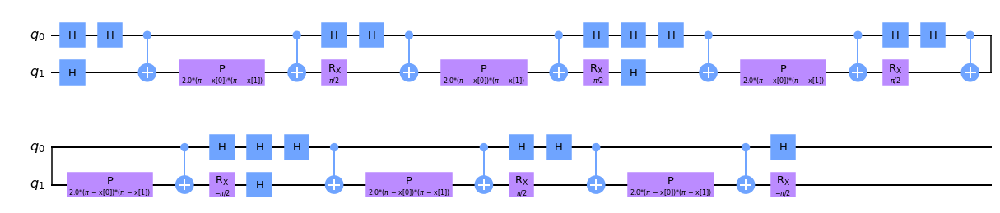


Quantum kernel matrices:



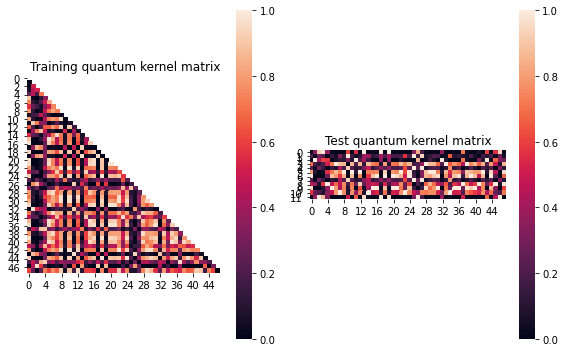


SVM with quantum kernel trained!


Test set performance:


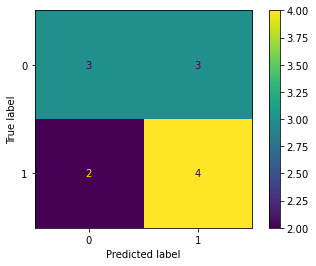

              precision    recall  f1-score   support

           0       0.60      0.50      0.55         6
           1       0.57      0.67      0.62         6

    accuracy                           0.58        12
   macro avg       0.59      0.58      0.58        12
weighted avg       0.59      0.58      0.58        12


metric 1: 0.008936050289908626
metric(s) 2: (00, 10, 11) = (0.4205186180021664, 0.43656622191641054, 0.47048592641047193)
metric 3: 7.127157700277936e-307


----> Kernel construction duration: 00:02:50


Combination 440/468
(Current range: 26/54)
			 reps : 3
			 paulis : ['ZX', 'YY']
			 entanglement : linear

Feature map:


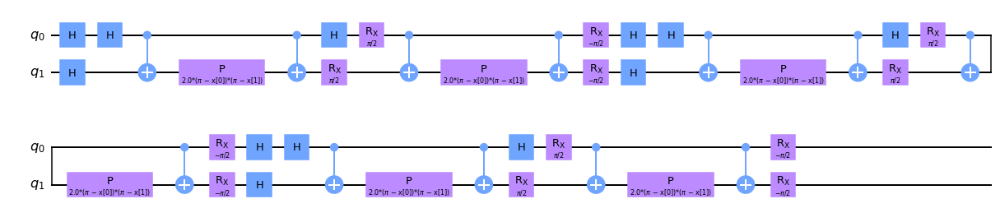


Quantum kernel matrices:



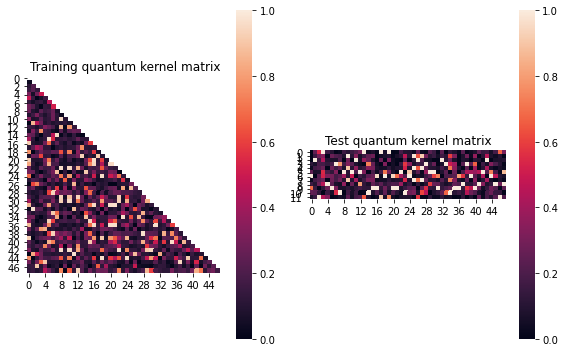


SVM with quantum kernel trained!


Test set performance:


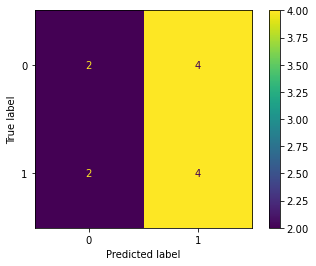

              precision    recall  f1-score   support

           0       0.50      0.33      0.40         6
           1       0.50      0.67      0.57         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.49        12
weighted avg       0.50      0.50      0.49        12


metric 1: 0.014636704314154259
metric(s) 2: (00, 10, 11) = (0.26711969340770353, 0.2593449445847664, 0.28084360439013784)
metric 3: -5.373559490002794e-289


----> Kernel construction duration: 00:03:22


Combination 441/468
(Current range: 27/54)
			 reps : 3
			 paulis : ['ZX', 'YZ']
			 entanglement : linear

Feature map:


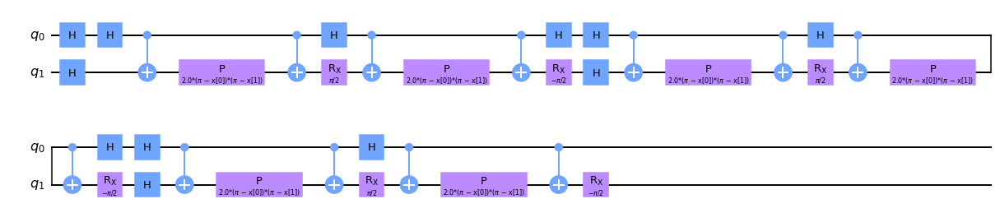


Quantum kernel matrices:



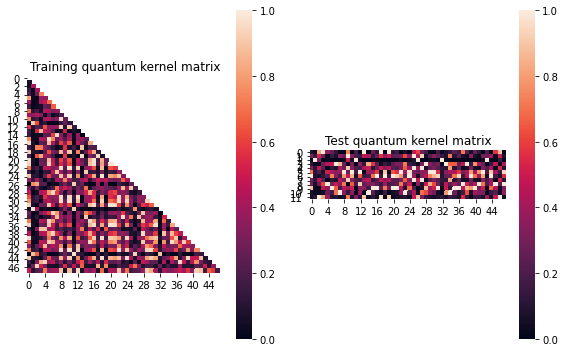


SVM with quantum kernel trained!


Test set performance:


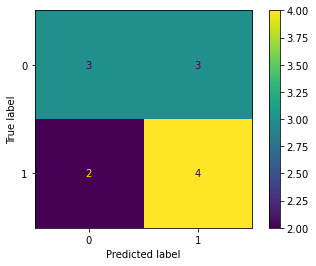

              precision    recall  f1-score   support

           0       0.60      0.50      0.55         6
           1       0.57      0.67      0.62         6

    accuracy                           0.58        12
   macro avg       0.59      0.58      0.58        12
weighted avg       0.59      0.58      0.58        12


metric 1: 0.007426662106061965
metric(s) 2: (00, 10, 11) = (0.36490633867847594, 0.37118322130947917, 0.39231342815260634)
metric 3: 2.5664e-319


----> Kernel construction duration: 00:03:04


Combination 442/468
(Current range: 28/54)
			 reps : 3
			 paulis : ['ZX', 'ZX']
			 entanglement : linear

Feature map:


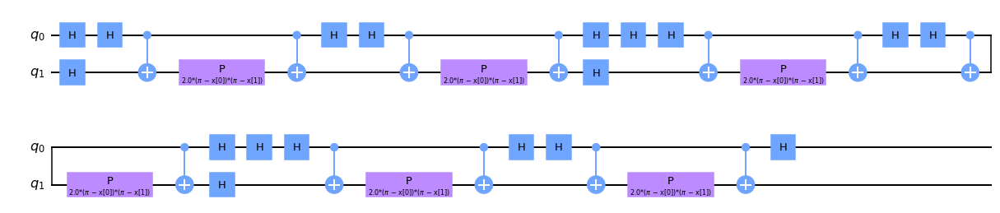


Quantum kernel matrices:



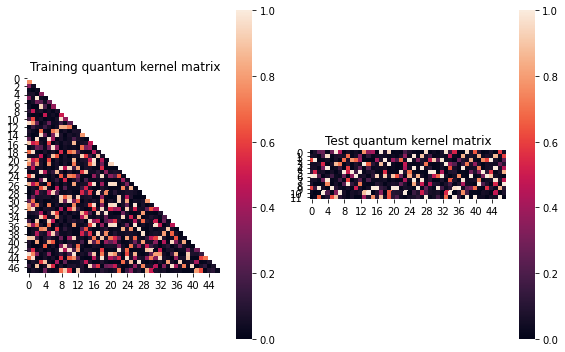


SVM with quantum kernel trained!


Test set performance:


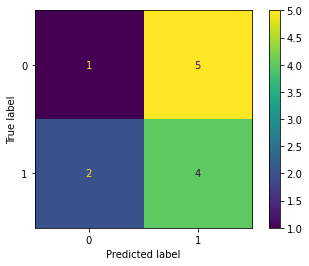

              precision    recall  f1-score   support

           0       0.33      0.17      0.22         6
           1       0.44      0.67      0.53         6

    accuracy                           0.42        12
   macro avg       0.39      0.42      0.38        12
weighted avg       0.39      0.42      0.38        12


metric 1: 0.019970118639973167
metric(s) 2: (00, 10, 11) = (0.2691125555872429, 0.24739279682081877, 0.265613275334341)
metric 3: -0.0


----> Kernel construction duration: 00:01:47


Combination 443/468
(Current range: 29/54)
			 reps : 3
			 paulis : ['ZX', 'ZY']
			 entanglement : linear

Feature map:


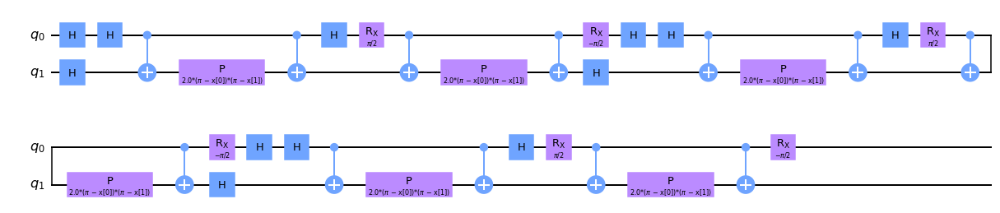


Quantum kernel matrices:



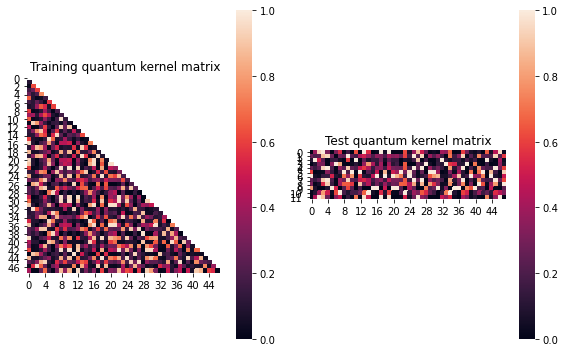


SVM with quantum kernel trained!


Test set performance:


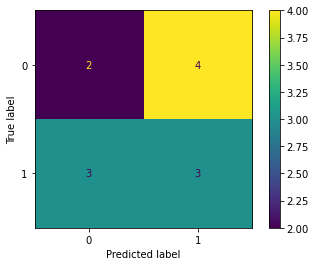

              precision    recall  f1-score   support

           0       0.40      0.33      0.36         6
           1       0.43      0.50      0.46         6

    accuracy                           0.42        12
   macro avg       0.41      0.42      0.41        12
weighted avg       0.41      0.42      0.41        12


metric 1: 0.009066527132248037
metric(s) 2: (00, 10, 11) = (0.34813091512519273, 0.33689370525540313, 0.34378954965010955)
metric 3: -2.1311775516972827e-293


----> Kernel construction duration: 00:02:51


Combination 444/468
(Current range: 30/54)
			 reps : 3
			 paulis : ['ZX', 'ZZ']
			 entanglement : linear

Feature map:


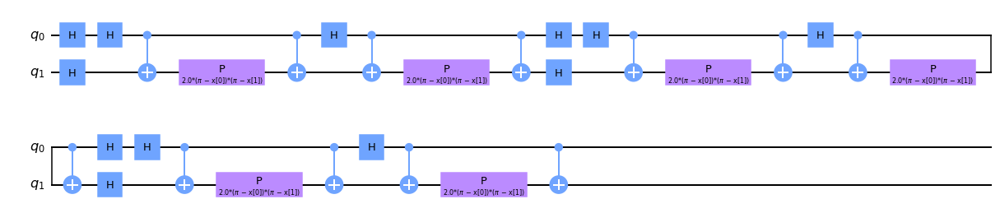


Quantum kernel matrices:



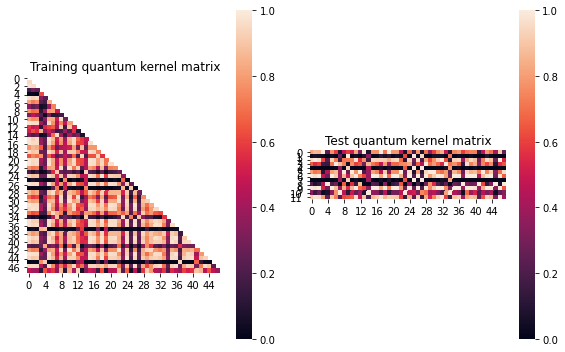


SVM with quantum kernel trained!


Test set performance:


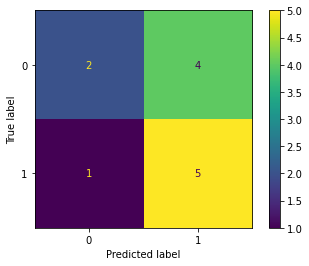

              precision    recall  f1-score   support

           0       0.67      0.33      0.44         6
           1       0.56      0.83      0.67         6

    accuracy                           0.58        12
   macro avg       0.61      0.58      0.56        12
weighted avg       0.61      0.58      0.56        12


metric 1: 0.011447590741553326
metric(s) 2: (00, 10, 11) = (0.5837137345046778, 0.5722679705598179, 0.5837173880980647)
metric 3: -0.0


----> Kernel construction duration: 00:02:30


Combination 445/468
(Current range: 31/54)
			 reps : 3
			 paulis : ['ZY', 'X']
			 entanglement : linear

Feature map:


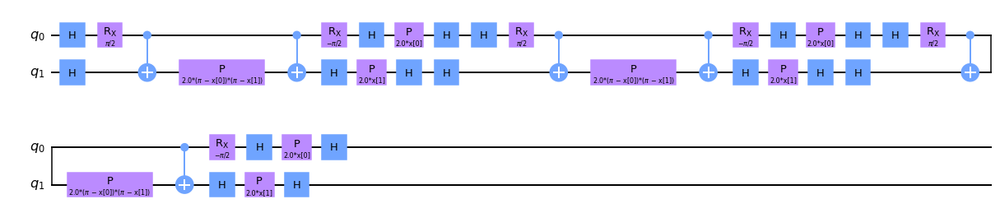


Quantum kernel matrices:



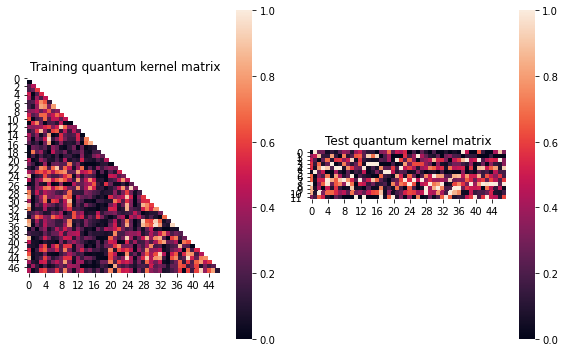


SVM with quantum kernel trained!


Test set performance:


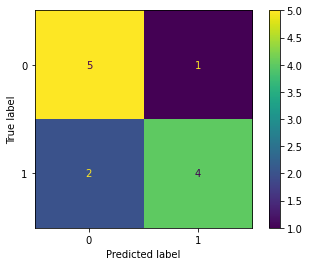

              precision    recall  f1-score   support

           0       0.71      0.83      0.77         6
           1       0.80      0.67      0.73         6

    accuracy                           0.75        12
   macro avg       0.76      0.75      0.75        12
weighted avg       0.76      0.75      0.75        12


metric 1: 0.08876284076845564
metric(s) 2: (00, 10, 11) = (0.3269549212450352, 0.27404826379209113, 0.39866728787605826)
metric 3: 2.516093580893742e-269


----> Kernel construction duration: 00:02:30


Combination 446/468
(Current range: 32/54)
			 reps : 3
			 paulis : ['ZY', 'Y']
			 entanglement : linear

Feature map:


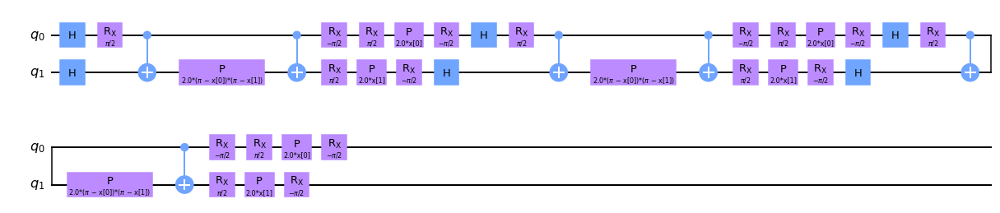


Quantum kernel matrices:



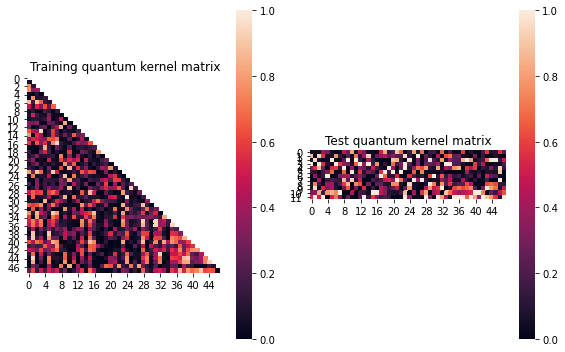


SVM with quantum kernel trained!


Test set performance:


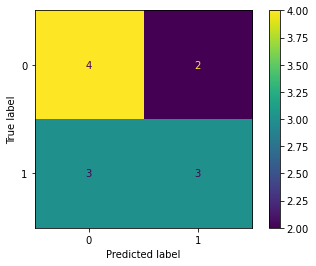

              precision    recall  f1-score   support

           0       0.57      0.67      0.62         6
           1       0.60      0.50      0.55         6

    accuracy                           0.58        12
   macro avg       0.59      0.58      0.58        12
weighted avg       0.59      0.58      0.58        12


metric 1: 0.06197183249989946
metric(s) 2: (00, 10, 11) = (0.2733962722328974, 0.25538960000209454, 0.3613265927710906)
metric 3: 5.546972434889811e-304


----> Kernel construction duration: 00:02:30


Combination 447/468
(Current range: 33/54)
			 reps : 3
			 paulis : ['ZY', 'Z']
			 entanglement : linear

Feature map:


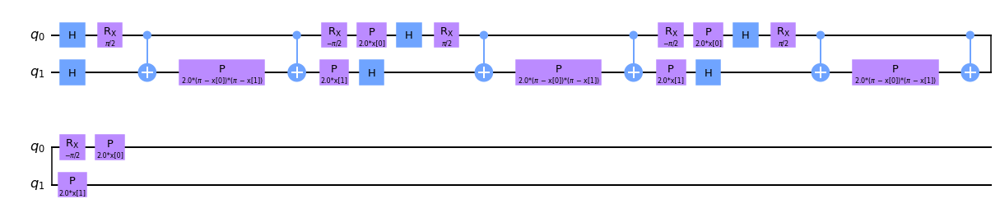


Quantum kernel matrices:



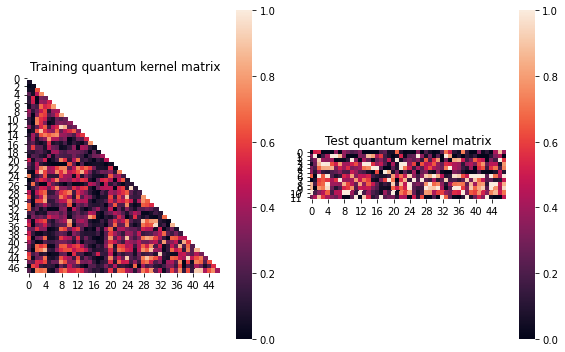


SVM with quantum kernel trained!


Test set performance:


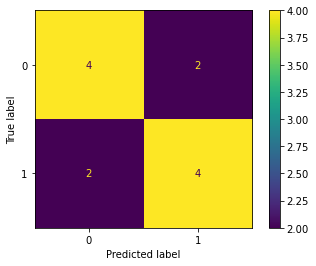

              precision    recall  f1-score   support

           0       0.67      0.67      0.67         6
           1       0.67      0.67      0.67         6

    accuracy                           0.67        12
   macro avg       0.67      0.67      0.67        12
weighted avg       0.67      0.67      0.67        12


metric 1: 0.07627571074545902
metric(s) 2: (00, 10, 11) = (0.33937796557611777, 0.29194260139761696, 0.3970586587100342)
metric 3: -1.3025421755895047e-281


----> Kernel construction duration: 00:02:27


Combination 448/468
(Current range: 34/54)
			 reps : 3
			 paulis : ['ZY', 'XX']
			 entanglement : linear

Feature map:


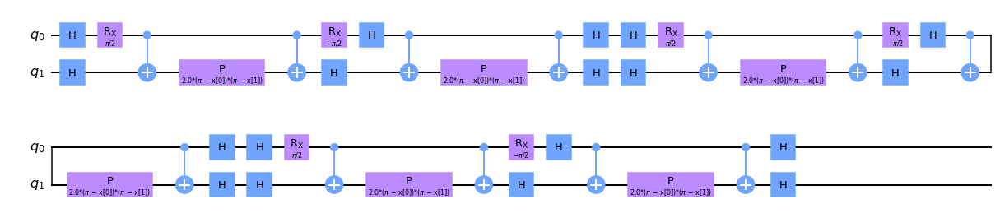


Quantum kernel matrices:



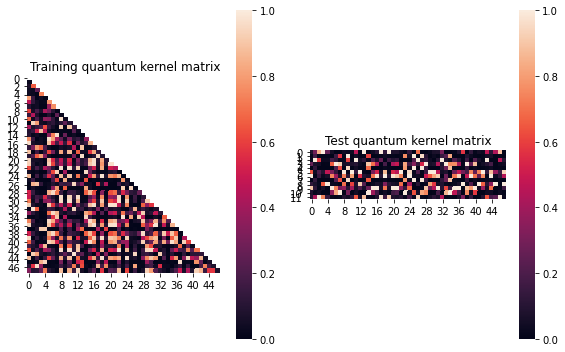


SVM with quantum kernel trained!


Test set performance:


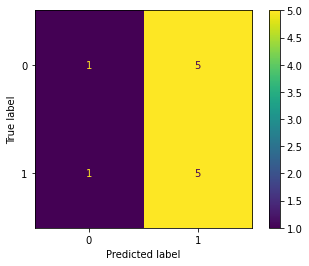

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.009334336671035504
metric(s) 2: (00, 10, 11) = (0.29815532311066256, 0.29684280124296386, 0.3141989527173361)
metric 3: 0.0


----> Kernel construction duration: 00:03:14


Combination 449/468
(Current range: 35/54)
			 reps : 3
			 paulis : ['ZY', 'XY']
			 entanglement : linear

Feature map:


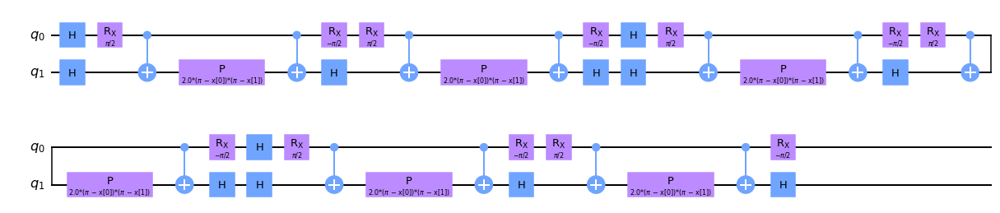


Quantum kernel matrices:



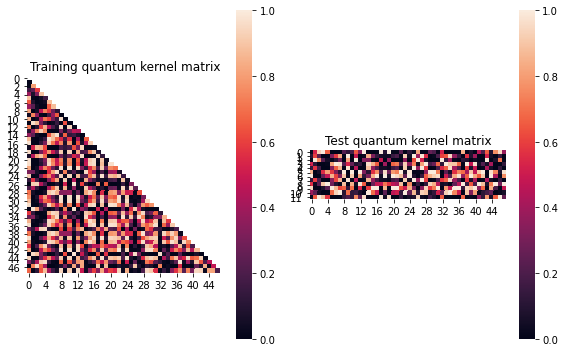


SVM with quantum kernel trained!


Test set performance:


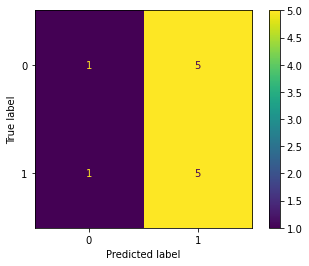

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.0043981638793463285
metric(s) 2: (00, 10, 11) = (0.40613189036271397, 0.4130157528605851, 0.4286959431171489)
metric 3: -0.0


----> Kernel construction duration: 00:02:51


Combination 450/468
(Current range: 36/54)
			 reps : 3
			 paulis : ['ZY', 'XZ']
			 entanglement : linear

Feature map:


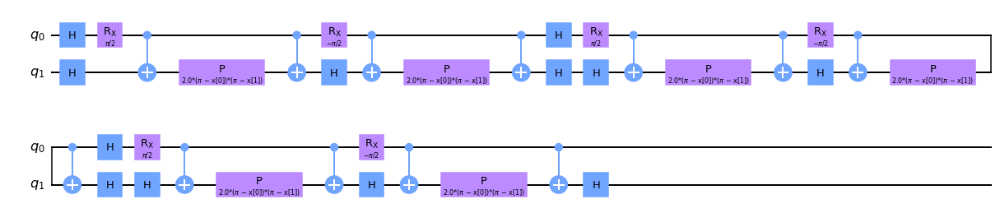


Quantum kernel matrices:



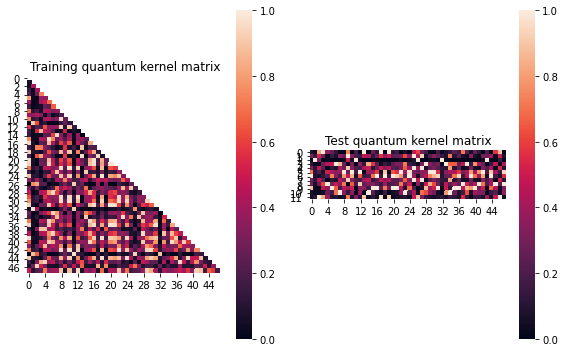


SVM with quantum kernel trained!


Test set performance:


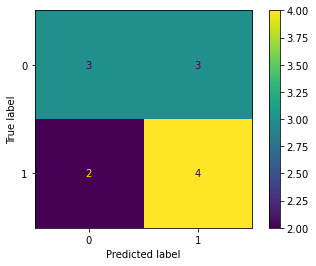

              precision    recall  f1-score   support

           0       0.60      0.50      0.55         6
           1       0.57      0.67      0.62         6

    accuracy                           0.58        12
   macro avg       0.59      0.58      0.58        12
weighted avg       0.59      0.58      0.58        12


metric 1: 0.007426662106061965
metric(s) 2: (00, 10, 11) = (0.36490633867847594, 0.37118322130947917, 0.39231342815260634)
metric 3: 2.5664e-319


----> Kernel construction duration: 00:03:13


Combination 451/468
(Current range: 37/54)
			 reps : 3
			 paulis : ['ZY', 'YX']
			 entanglement : linear

Feature map:


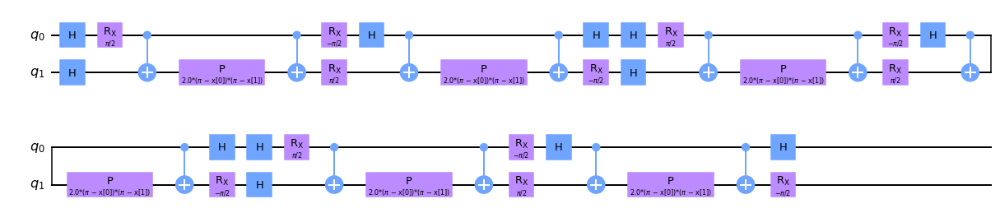


Quantum kernel matrices:



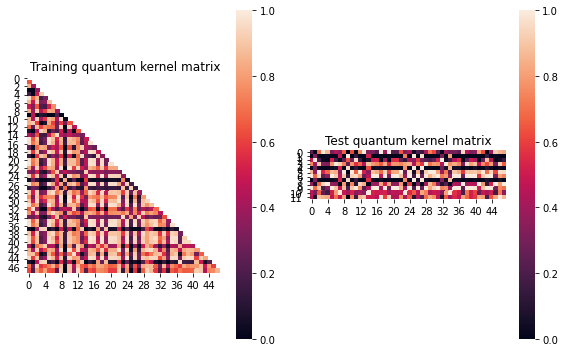


SVM with quantum kernel trained!


Test set performance:


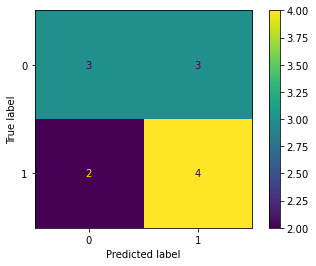

              precision    recall  f1-score   support

           0       0.60      0.50      0.55         6
           1       0.57      0.67      0.62         6

    accuracy                           0.58        12
   macro avg       0.59      0.58      0.58        12
weighted avg       0.59      0.58      0.58        12


metric 1: 0.004979825325543197
metric(s) 2: (00, 10, 11) = (0.5569815807190397, 0.5784034366808145, 0.6097849432936757)
metric 3: -0.0


----> Kernel construction duration: 00:03:35


Combination 452/468
(Current range: 38/54)
			 reps : 3
			 paulis : ['ZY', 'YY']
			 entanglement : linear

Feature map:


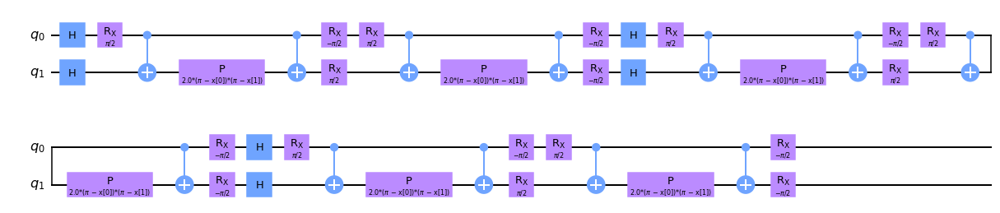


Quantum kernel matrices:



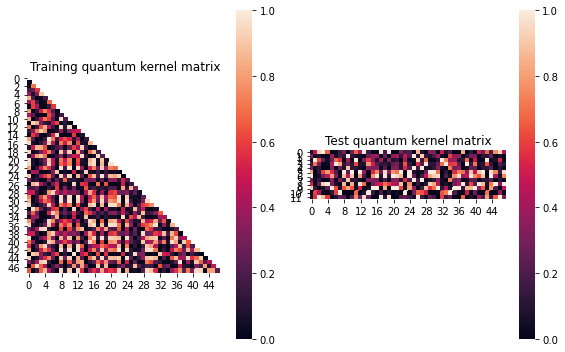


SVM with quantum kernel trained!


Test set performance:


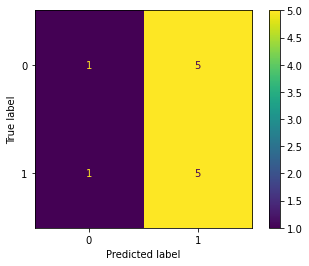

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.005102717696276959
metric(s) 2: (00, 10, 11) = (0.3871266313163287, 0.3875225353454616, 0.39812387476714844)
metric 3: -8.28e-321


----> Kernel construction duration: 00:03:12


Combination 453/468
(Current range: 39/54)
			 reps : 3
			 paulis : ['ZY', 'YZ']
			 entanglement : linear

Feature map:


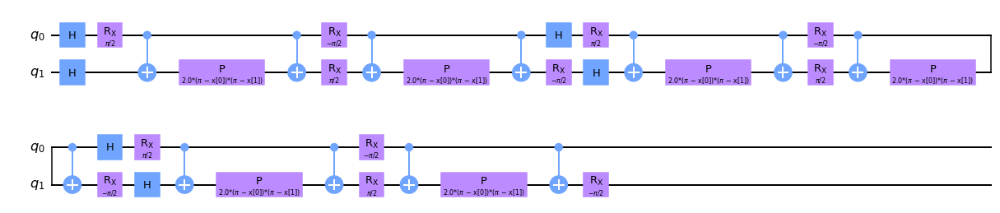


Quantum kernel matrices:



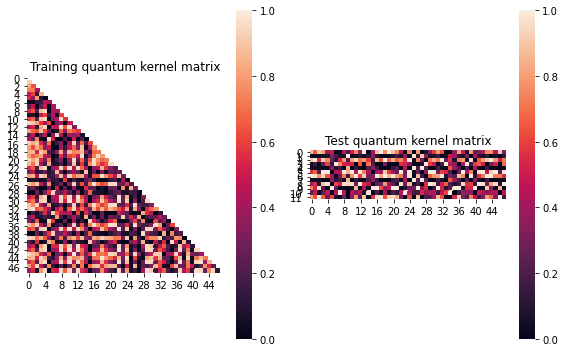


SVM with quantum kernel trained!


Test set performance:


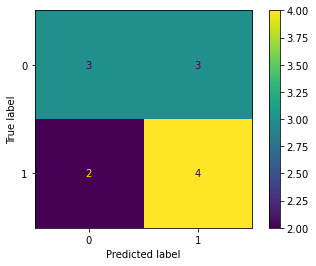

              precision    recall  f1-score   support

           0       0.60      0.50      0.55         6
           1       0.57      0.67      0.62         6

    accuracy                           0.58        12
   macro avg       0.59      0.58      0.58        12
weighted avg       0.59      0.58      0.58        12


metric 1: 0.010738694022345174
metric(s) 2: (00, 10, 11) = (0.48611396242851374, 0.4505782885953999, 0.4365200028069764)
metric 3: 0.0


----> Kernel construction duration: 00:03:37


Combination 454/468
(Current range: 40/54)
			 reps : 3
			 paulis : ['ZY', 'ZX']
			 entanglement : linear

Feature map:


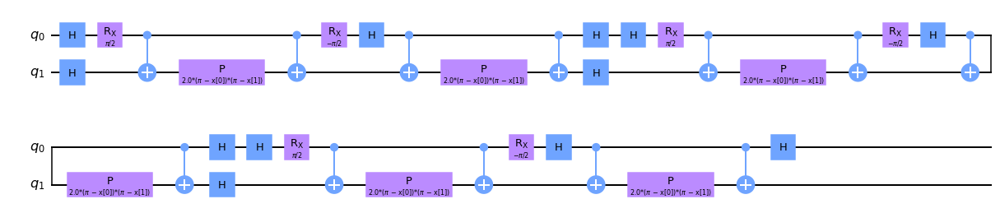


Quantum kernel matrices:



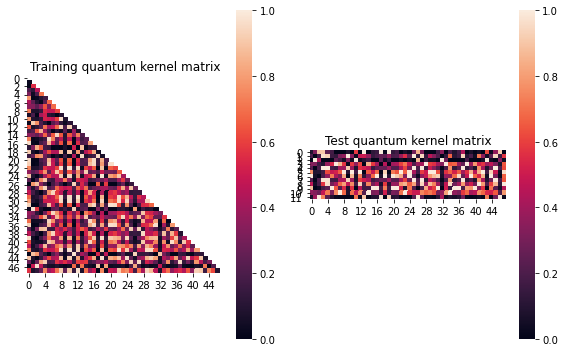


SVM with quantum kernel trained!


Test set performance:


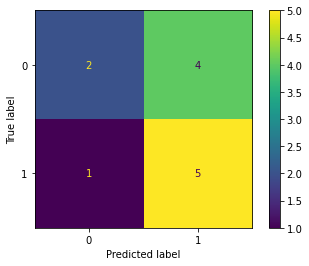

              precision    recall  f1-score   support

           0       0.67      0.33      0.44         6
           1       0.56      0.83      0.67         6

    accuracy                           0.58        12
   macro avg       0.61      0.58      0.56        12
weighted avg       0.61      0.58      0.56        12


metric 1: 0.006932975050718215
metric(s) 2: (00, 10, 11) = (0.39297380938008797, 0.4076670304576775, 0.43622620163670345)
metric 3: -1.0643384258832182e-292


----> Kernel construction duration: 00:03:03


Combination 455/468
(Current range: 41/54)
			 reps : 3
			 paulis : ['ZY', 'ZY']
			 entanglement : linear

Feature map:


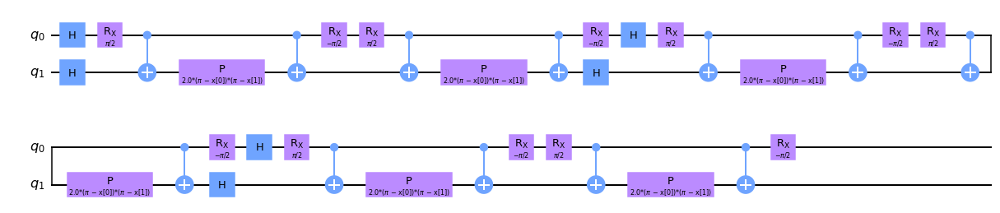


Quantum kernel matrices:



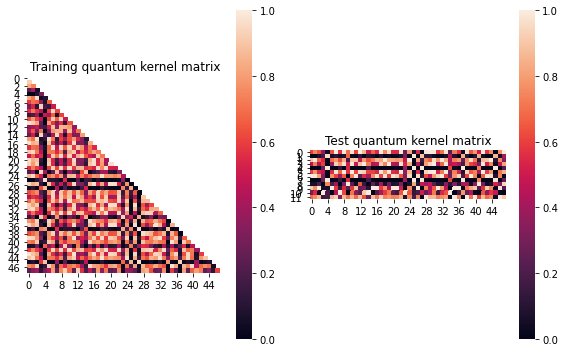


SVM with quantum kernel trained!


Test set performance:


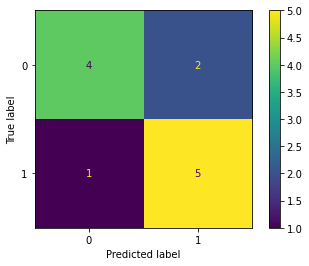

              precision    recall  f1-score   support

           0       0.80      0.67      0.73         6
           1       0.71      0.83      0.77         6

    accuracy                           0.75        12
   macro avg       0.76      0.75      0.75        12
weighted avg       0.76      0.75      0.75        12


metric 1: 0.016120447462909637
metric(s) 2: (00, 10, 11) = (0.5549784887985051, 0.5164631002235872, 0.5101886065744887)
metric 3: -0.0


----> Kernel construction duration: 00:02:06


Combination 456/468
(Current range: 42/54)
			 reps : 3
			 paulis : ['ZY', 'ZZ']
			 entanglement : linear

Feature map:


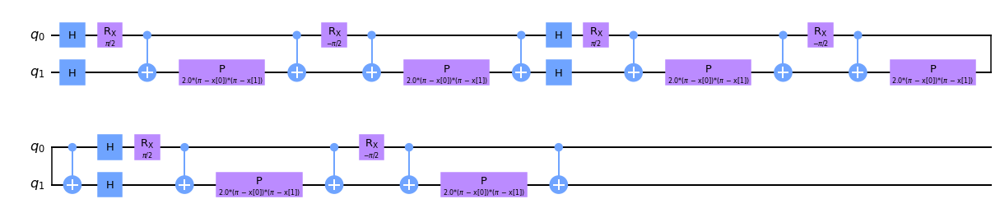


Quantum kernel matrices:



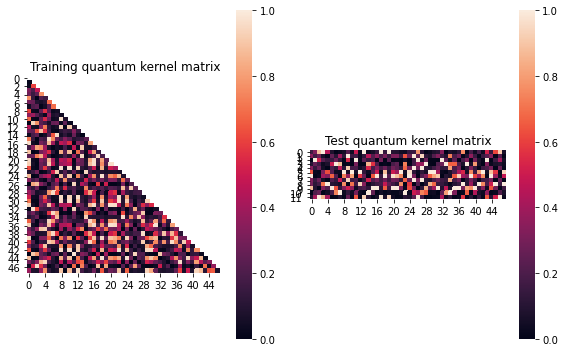


SVM with quantum kernel trained!


Test set performance:


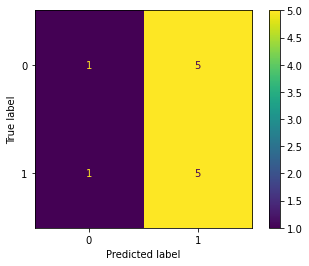

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.009020455004259076
metric(s) 2: (00, 10, 11) = (0.33219437324683554, 0.32894223972851316, 0.34373101621870894)
metric 3: -7.357887887201557e-308


----> Kernel construction duration: 00:03:03


Combination 457/468
(Current range: 43/54)
			 reps : 3
			 paulis : ['ZZ', 'X']
			 entanglement : linear

Feature map:


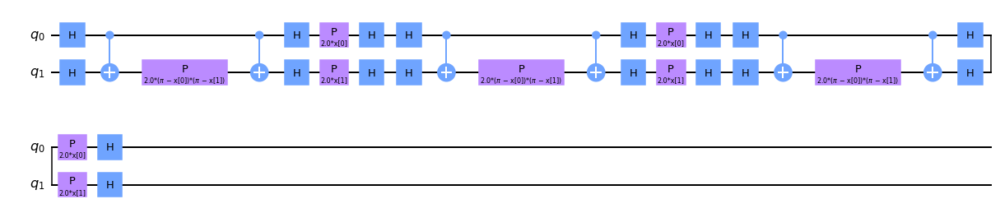


Quantum kernel matrices:



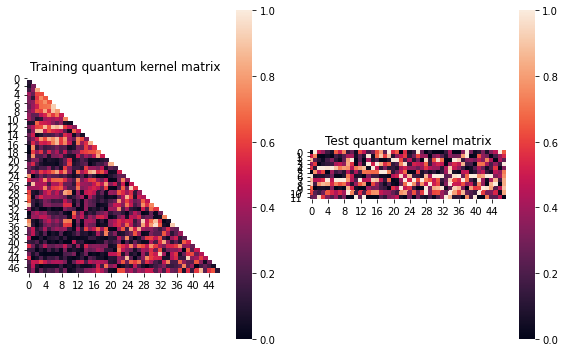


SVM with quantum kernel trained!


Test set performance:


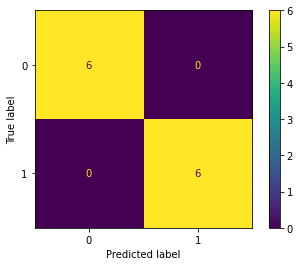

              precision    recall  f1-score   support

           0       1.00      1.00      1.00         6
           1       1.00      1.00      1.00         6

    accuracy                           1.00        12
   macro avg       1.00      1.00      1.00        12
weighted avg       1.00      1.00      1.00        12


metric 1: 0.14660080333251962
metric(s) 2: (00, 10, 11) = (0.4153243354829613, 0.2596371907280919, 0.3971516526382617)
metric 3: -2.6380381137386482e-256


----> Kernel construction duration: 00:02:21


Combination 458/468
(Current range: 44/54)
			 reps : 3
			 paulis : ['ZZ', 'Y']
			 entanglement : linear

Feature map:


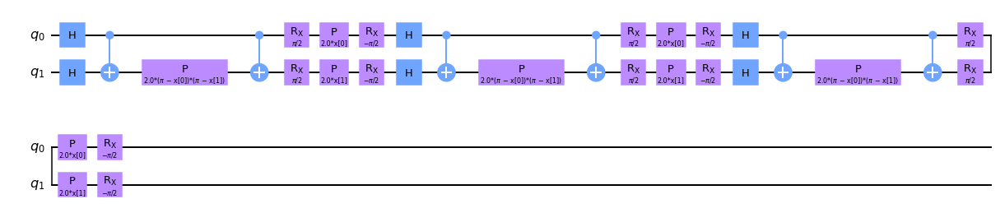


Quantum kernel matrices:



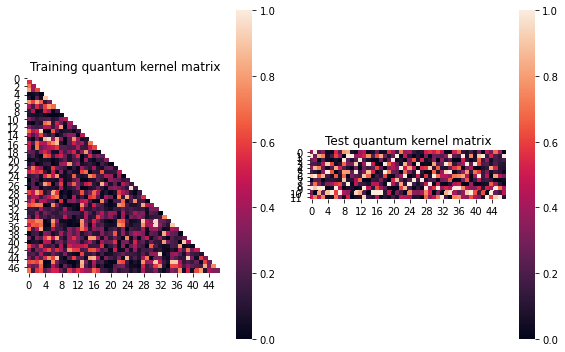


SVM with quantum kernel trained!


Test set performance:


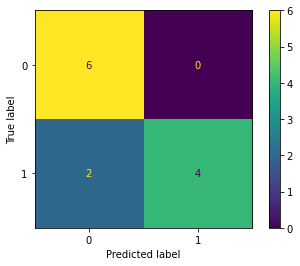

              precision    recall  f1-score   support

           0       0.75      1.00      0.86         6
           1       1.00      0.67      0.80         6

    accuracy                           0.83        12
   macro avg       0.88      0.83      0.83        12
weighted avg       0.88      0.83      0.83        12


metric 1: 0.031166704395925837
metric(s) 2: (00, 10, 11) = (0.3085113811903368, 0.2742099669791497, 0.3022419615598142)
metric 3: -9.89713933967088e-271


----> Kernel construction duration: 00:02:33


Combination 459/468
(Current range: 45/54)
			 reps : 3
			 paulis : ['ZZ', 'Z']
			 entanglement : linear

Feature map:


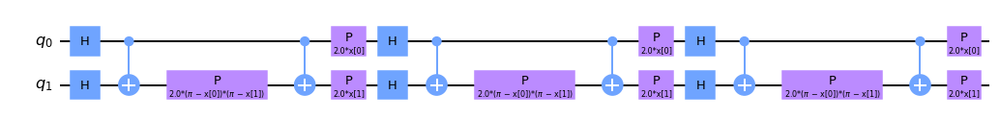


Quantum kernel matrices:



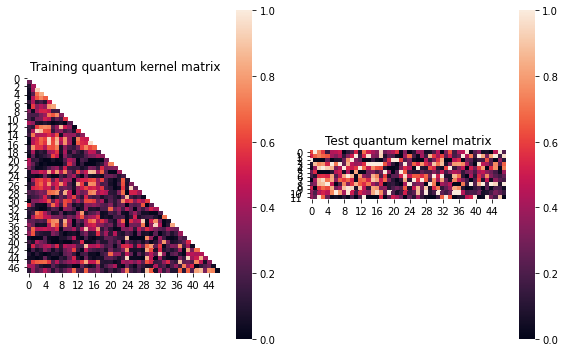


SVM with quantum kernel trained!


Test set performance:


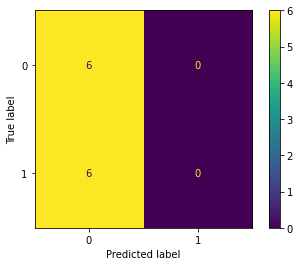

              precision    recall  f1-score   support

           0       0.50      1.00      0.67         6
           1       0.00      0.00      0.00         6

    accuracy                           0.50        12
   macro avg       0.25      0.50      0.33        12
weighted avg       0.25      0.50      0.33        12


metric 1: 0.07443384910029133
metric(s) 2: (00, 10, 11) = (0.3677487823316448, 0.27275499553002636, 0.32662890692899055)
metric 3: -2.6865414066679453e-255


----> Kernel construction duration: 00:02:18


Combination 460/468
(Current range: 46/54)
			 reps : 3
			 paulis : ['ZZ', 'XX']
			 entanglement : linear

Feature map:


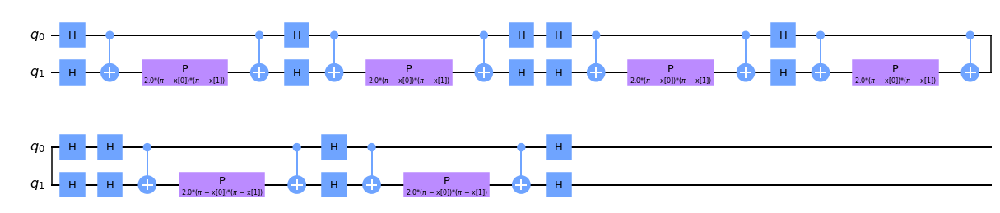


Quantum kernel matrices:



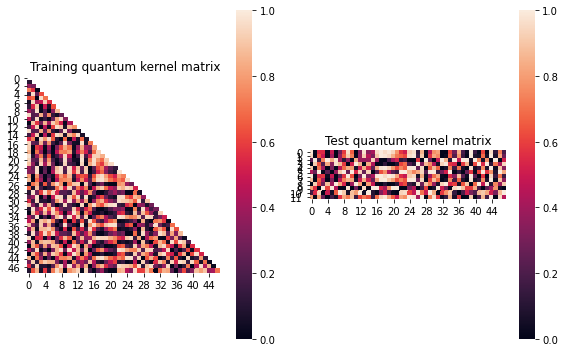


SVM with quantum kernel trained!


Test set performance:


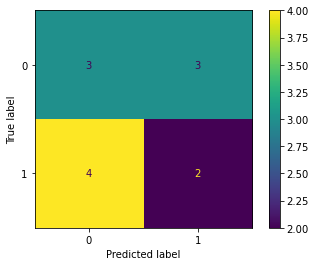

              precision    recall  f1-score   support

           0       0.43      0.50      0.46         6
           1       0.40      0.33      0.36         6

    accuracy                           0.42        12
   macro avg       0.41      0.42      0.41        12
weighted avg       0.41      0.42      0.41        12


metric 1: 0.01730890192141893
metric(s) 2: (00, 10, 11) = (0.4938575607783879, 0.48013029165421034, 0.5010208263728706)
metric 3: 0.0


----> Kernel construction duration: 00:02:32


Combination 461/468
(Current range: 47/54)
			 reps : 3
			 paulis : ['ZZ', 'XY']
			 entanglement : linear

Feature map:


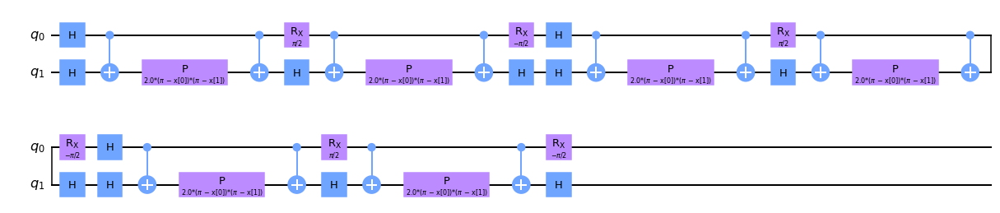


Quantum kernel matrices:



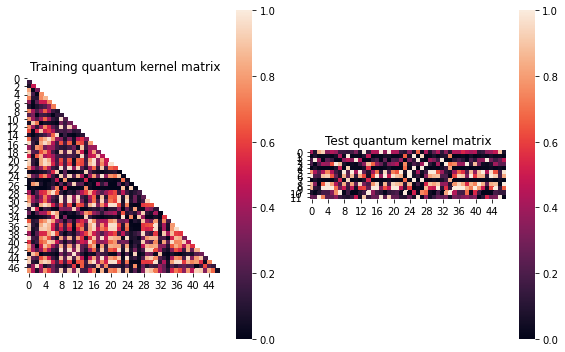


SVM with quantum kernel trained!


Test set performance:


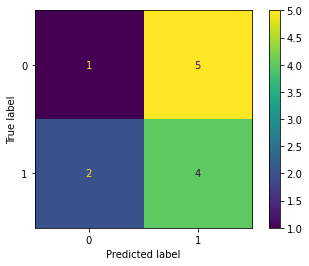

              precision    recall  f1-score   support

           0       0.33      0.17      0.22         6
           1       0.44      0.67      0.53         6

    accuracy                           0.42        12
   macro avg       0.39      0.42      0.38        12
weighted avg       0.39      0.42      0.38        12


metric 1: 0.010104769633572985
metric(s) 2: (00, 10, 11) = (0.41671556027514145, 0.4065562017362498, 0.4166063824645041)
metric 3: -0.0


----> Kernel construction duration: 00:03:14


Combination 462/468
(Current range: 48/54)
			 reps : 3
			 paulis : ['ZZ', 'XZ']
			 entanglement : linear

Feature map:


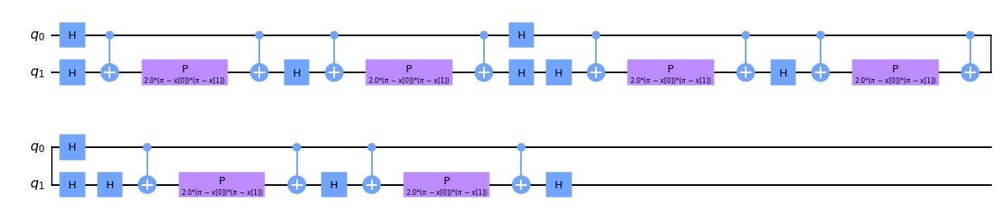


Quantum kernel matrices:



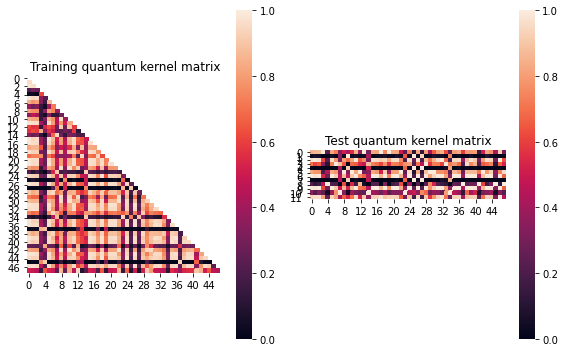


SVM with quantum kernel trained!


Test set performance:


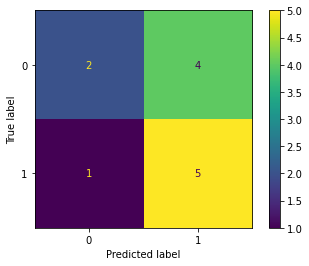

              precision    recall  f1-score   support

           0       0.67      0.33      0.44         6
           1       0.56      0.83      0.67         6

    accuracy                           0.58        12
   macro avg       0.61      0.58      0.56        12
weighted avg       0.61      0.58      0.56        12


metric 1: 0.011688827856983663
metric(s) 2: (00, 10, 11) = (0.598711651426411, 0.5813048828459542, 0.5872757699794646)
metric 3: -0.0


----> Kernel construction duration: 00:02:43


Combination 463/468
(Current range: 49/54)
			 reps : 3
			 paulis : ['ZZ', 'YX']
			 entanglement : linear

Feature map:


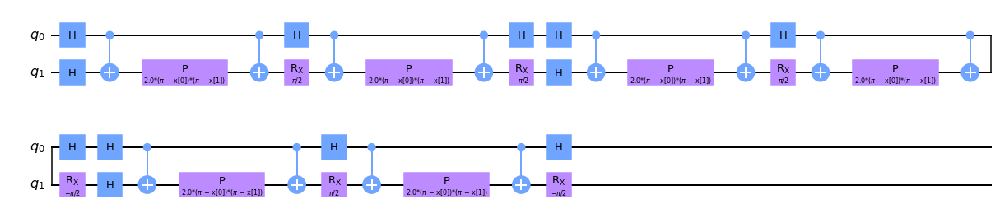


Quantum kernel matrices:



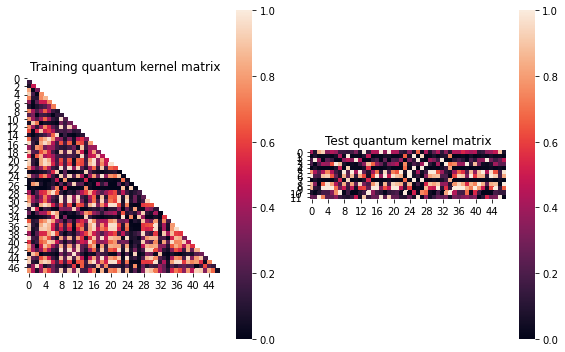


SVM with quantum kernel trained!


Test set performance:


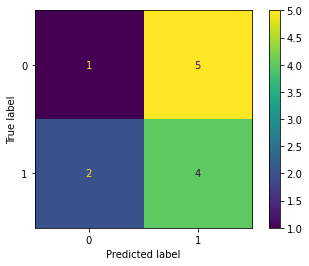

              precision    recall  f1-score   support

           0       0.33      0.17      0.22         6
           1       0.44      0.67      0.53         6

    accuracy                           0.42        12
   macro avg       0.39      0.42      0.38        12
weighted avg       0.39      0.42      0.38        12


metric 1: 0.010104769633572985
metric(s) 2: (00, 10, 11) = (0.41671556027514145, 0.4065562017362498, 0.4166063824645041)
metric 3: -0.0


----> Kernel construction duration: 00:03:14


Combination 464/468
(Current range: 50/54)
			 reps : 3
			 paulis : ['ZZ', 'YY']
			 entanglement : linear

Feature map:


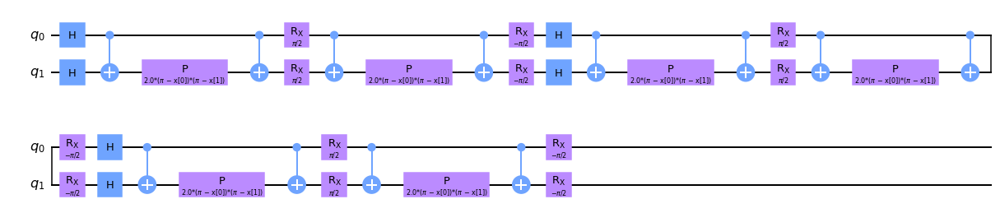


Quantum kernel matrices:



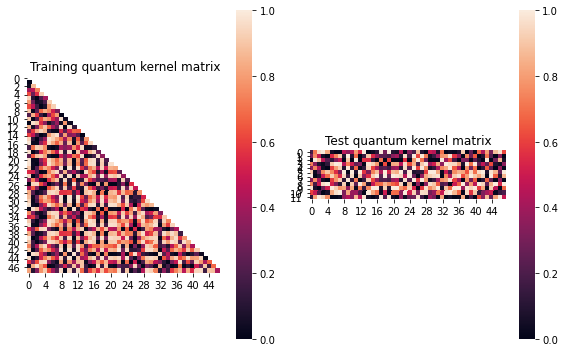


SVM with quantum kernel trained!


Test set performance:


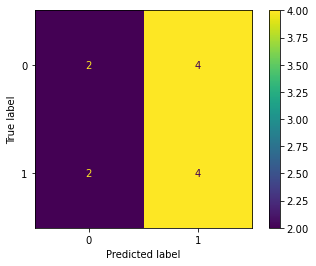

              precision    recall  f1-score   support

           0       0.50      0.33      0.40         6
           1       0.50      0.67      0.57         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.49        12
weighted avg       0.50      0.50      0.49        12


metric 1: 0.0030024471480464276
metric(s) 2: (00, 10, 11) = (0.5194729525883561, 0.5274296115848754, 0.5413911648774875)
metric 3: 0.0


----> Kernel construction duration: 00:03:32


Combination 465/468
(Current range: 51/54)
			 reps : 3
			 paulis : ['ZZ', 'YZ']
			 entanglement : linear

Feature map:


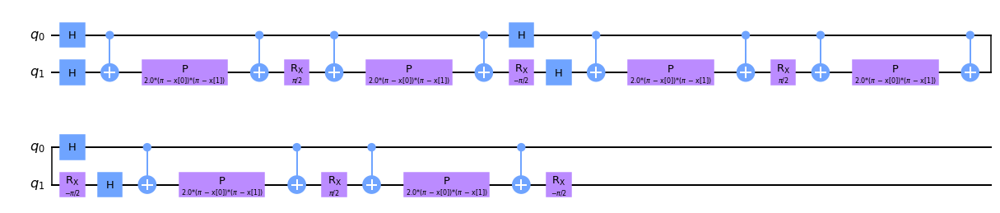


Quantum kernel matrices:



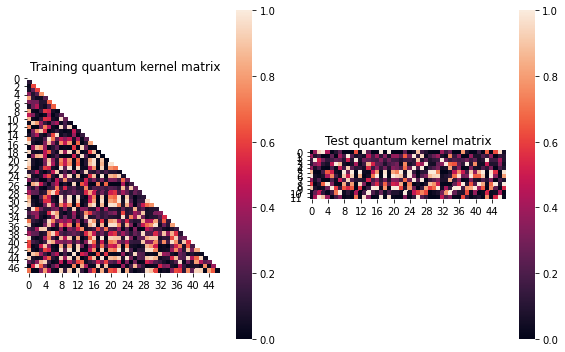


SVM with quantum kernel trained!


Test set performance:


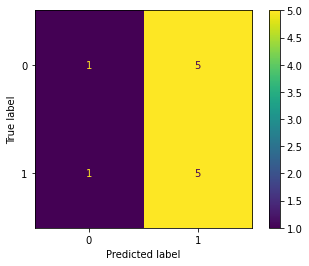

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.0036465418217661583
metric(s) 2: (00, 10, 11) = (0.35680072635947263, 0.36335186490872073, 0.37719608710150115)
metric 3: 1.026e-320


----> Kernel construction duration: 00:03:01


Combination 466/468
(Current range: 52/54)
			 reps : 3
			 paulis : ['ZZ', 'ZX']
			 entanglement : linear

Feature map:


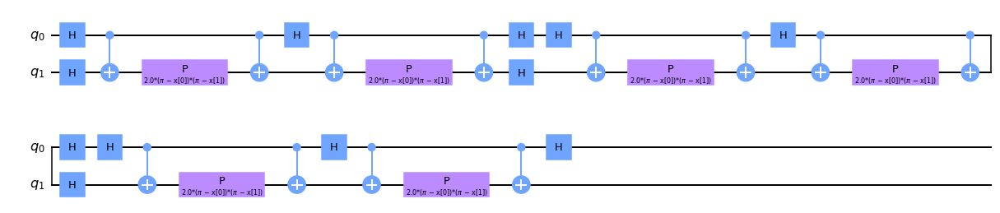


Quantum kernel matrices:



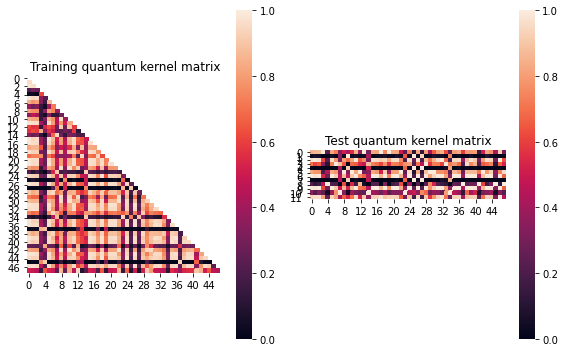


SVM with quantum kernel trained!


Test set performance:


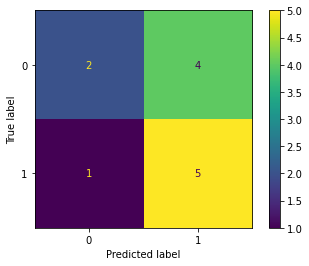

              precision    recall  f1-score   support

           0       0.67      0.33      0.44         6
           1       0.56      0.83      0.67         6

    accuracy                           0.58        12
   macro avg       0.61      0.58      0.56        12
weighted avg       0.61      0.58      0.56        12


metric 1: 0.011688827856983663
metric(s) 2: (00, 10, 11) = (0.598711651426411, 0.5813048828459542, 0.5872757699794646)
metric 3: -0.0


----> Kernel construction duration: 00:02:42


Combination 467/468
(Current range: 53/54)
			 reps : 3
			 paulis : ['ZZ', 'ZY']
			 entanglement : linear

Feature map:


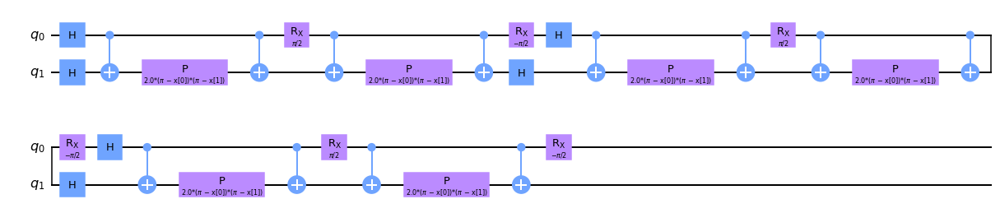


Quantum kernel matrices:



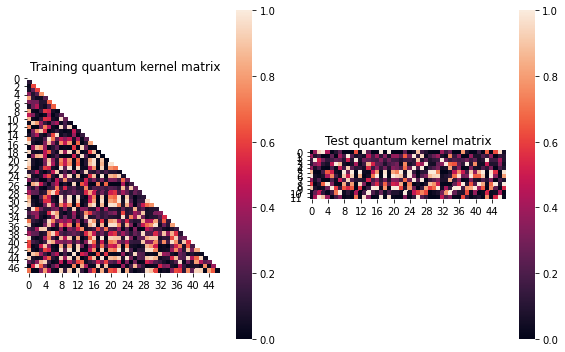


SVM with quantum kernel trained!


Test set performance:


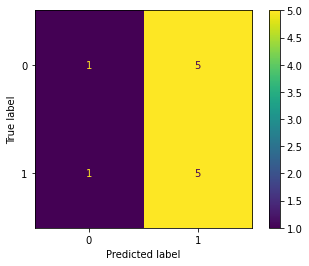

              precision    recall  f1-score   support

           0       0.50      0.17      0.25         6
           1       0.50      0.83      0.62         6

    accuracy                           0.50        12
   macro avg       0.50      0.50      0.44        12
weighted avg       0.50      0.50      0.44        12


metric 1: 0.0036465418217661583
metric(s) 2: (00, 10, 11) = (0.35680072635947263, 0.36335186490872073, 0.37719608710150115)
metric 3: 1.026e-320


----> Kernel construction duration: 00:03:02


Combination 468/468
(Current range: 54/54)
			 reps : 3
			 paulis : ['ZZ', 'ZZ']
			 entanglement : linear

Feature map:


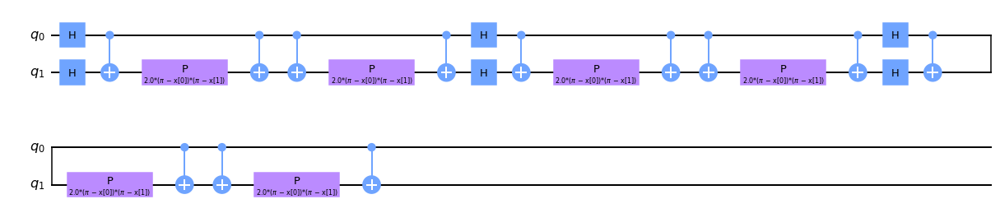


Quantum kernel matrices:



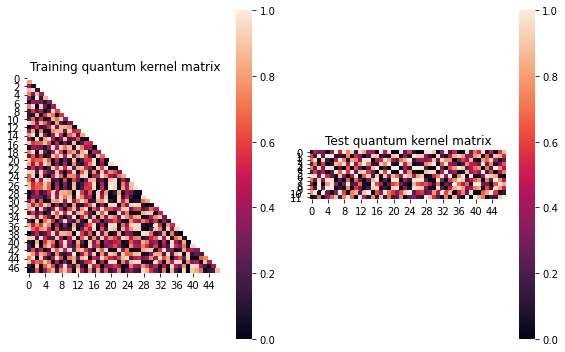


SVM with quantum kernel trained!


Test set performance:


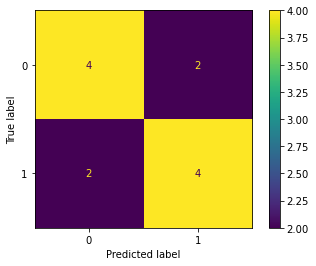

              precision    recall  f1-score   support

           0       0.67      0.67      0.67         6
           1       0.67      0.67      0.67         6

    accuracy                           0.67        12
   macro avg       0.67      0.67      0.67        12
weighted avg       0.67      0.67      0.67        12


metric 1: 0.01063283700640516
metric(s) 2: (00, 10, 11) = (0.4988356390857766, 0.48376151343988855, 0.4899530618068108)
metric 3: 0.0


----> Kernel construction duration: 00:01:58


In [22]:
j=9
results.append(run_kernel_evaluation(X, X_train, y_train, X_test, y_test,
                                      param_grid, range_list, j, model=True))

### Final analysis

In [27]:
df_results = pd.concat(results).sort_values("density_diff", ascending=False)

df_results.shape

(468, 10)

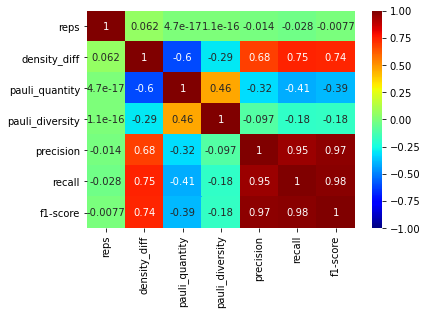

In [28]:
sns.heatmap(df_results.corr(), vmin=-1, vmax=1, annot=True, cmap="jet")

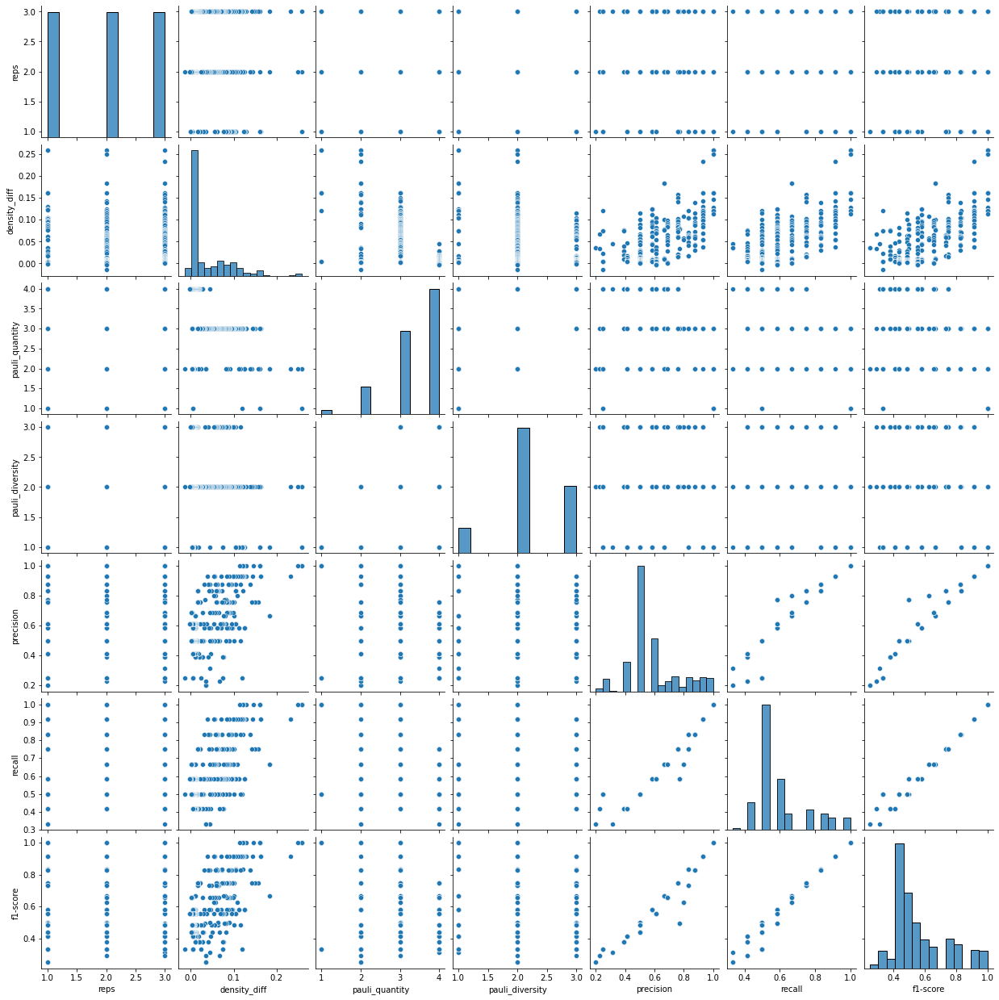

In [29]:
sns.pairplot(df_results)

In [31]:
df_results.to_csv("./results/results_make_circles.csv")

In [32]:
df_results

,reps,paulis,entanglement,density_diff,densities,pauli_quantity,pauli_diversity,precision,recall,f1-score
36,1,"[Z, X]",linear,0.259005,"(0.5284495379346134, 0.339459573135221, 0.6684...",2,2,1.000000,1.000000,1.000000
36,3,[X],linear,0.259005,"(0.5284495379346134, 0.339459573135221, 0.6684...",1,1,1.000000,1.000000,1.000000
20,2,[Z],linear,0.259005,"(0.5284495379346134, 0.339459573135221, 0.6684...",1,1,1.000000,1.000000,1.000000
24,1,"[Y, X]",linear,0.259005,"(0.5284495379346134, 0.339459573135221, 0.6684...",2,2,1.000000,1.000000,1.000000
32,2,"[X, Z]",linear,0.249362,"(0.3866436223801746, 0.1531158005484856, 0.418...",2,2,1.000000,1.000000,1.000000
...,...,...,...,...,...,...,...,...,...,...
30,1,"[XZ, XY]",linear,-0.000621,"(0.5434756299188566, 0.5555297974455864, 0.566...",4,3,0.611111,0.583333,0.555556
1,1,"[ZY, YY]",linear,-0.000621,"(0.5434756299188566, 0.5555297974455864, 0.566...",4,2,0.611111,0.583333,0.555556
1,2,"[XZ, XX]",linear,-0.002875,"(0.49490396168777195, 0.5083145122829045, 0.51...",4,2,0.611111,0.583333,0.555556
3,2,"[ZX, XX]",linear,-0.002875,"(0.49490396168777195, 0.5083145122829045, 0.51...",4,2,0.611111,0.583333,0.555556


From the results dataframe, we can get the parameters yielding the best results (notice that it was sorted by the `density_diff`, which is the quality metric):

In [83]:
best_params = df_results.iloc[0][["reps", "paulis", "entanglement"]].tolist()

best_params

[1, ['Z', 'X'], 'linear']

We can then visualize the resulting decision boundary:


Feature map:


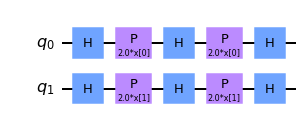


Quantum kernel matrices:



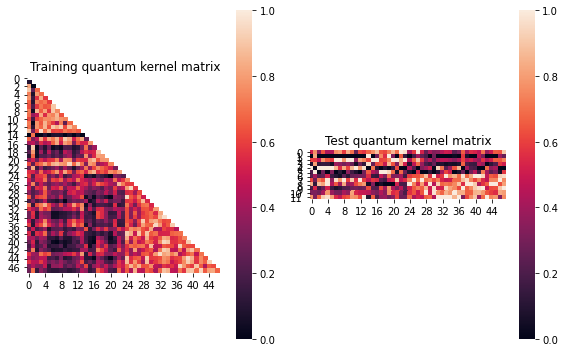


SVM with quantum kernel trained!


Test set performance:


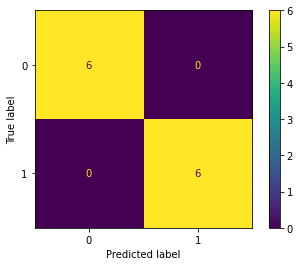

              precision    recall  f1-score   support

           0       1.00      1.00      1.00         6
           1       1.00      1.00      1.00         6

    accuracy                           1.00        12
   macro avg       1.00      1.00      1.00        12
weighted avg       1.00      1.00      1.00        12



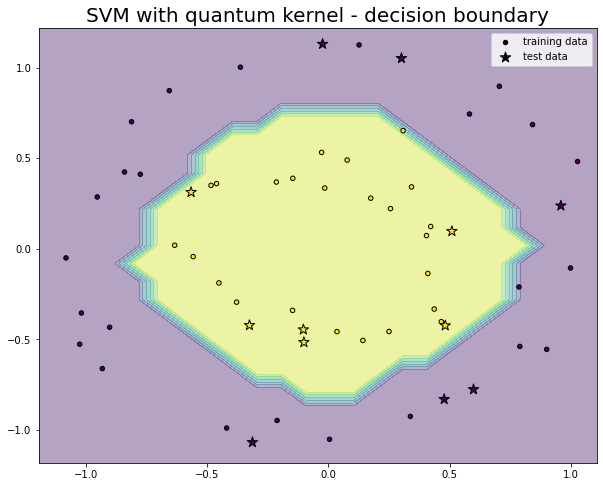

In [125]:
_ = qsvm(X, X_train, y_train, X_test, y_test, *best_params, shots=1024, plot_stuff=True,
         plot_boundary = True, spacing=0.1, quantum_kernel=True)

We can also visualize the action of the feature map on individual observations:


Feature mapping of 0-th observation:

Datapoint: [-0.952  0.286]


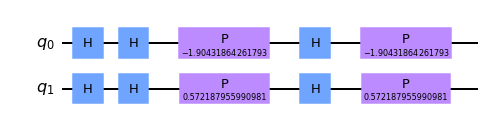


State:	[ 0.5  +2.579e-18j -0.164-4.724e-01j  0.42 +2.707e-01j  0.118-4.858e-01j]



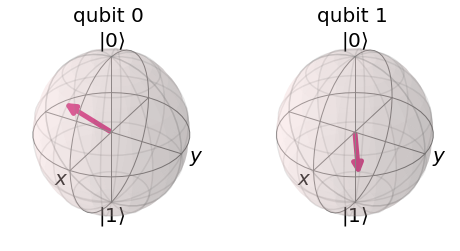

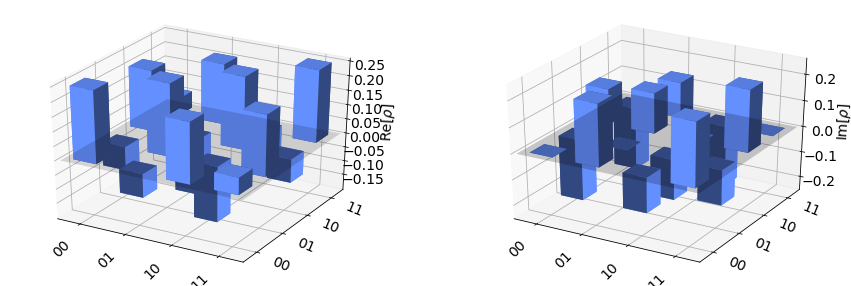

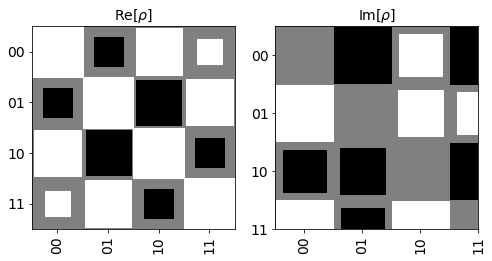

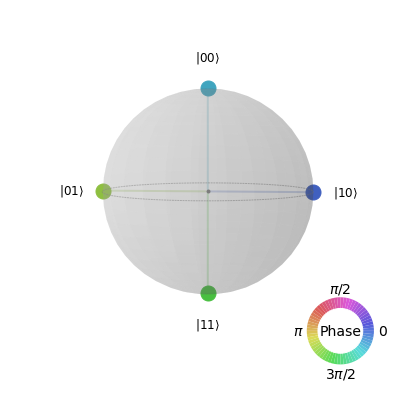






Feature mapping of 1-th observation:

Datapoint: [ 0.005 -1.051]


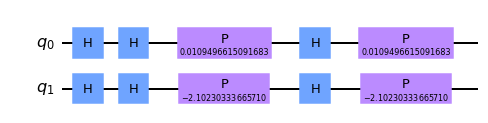


State:	[ 0.5  -4.105e-18j  0.5  +5.475e-03j -0.253-4.310e-01j -0.249-4.338e-01j]



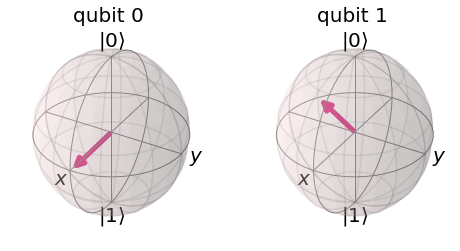

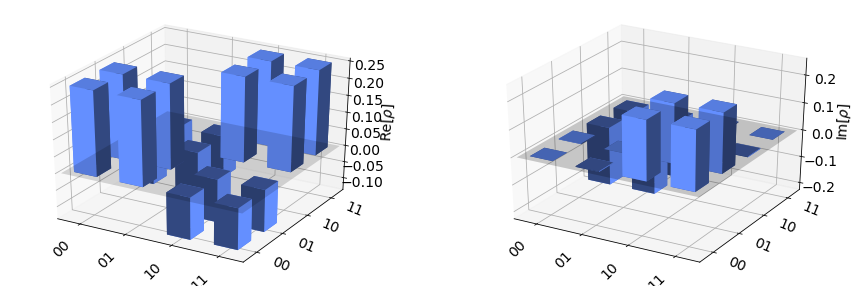

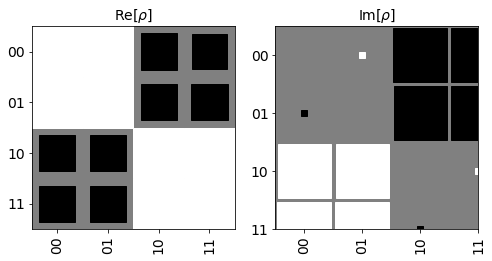

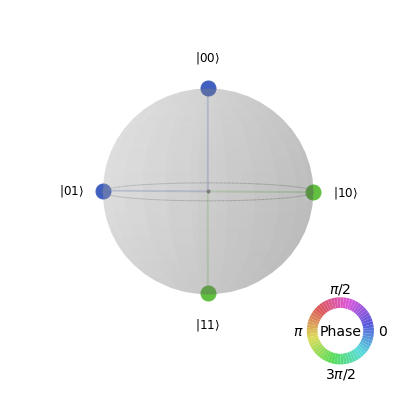






Feature mapping of 2-th observation:

Datapoint: [-1.081 -0.05 ]


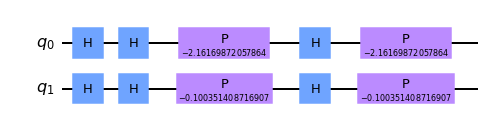


State:	[ 0.5  -4.771e-19j -0.279-4.152e-01j  0.497-5.009e-02j -0.319-3.852e-01j]



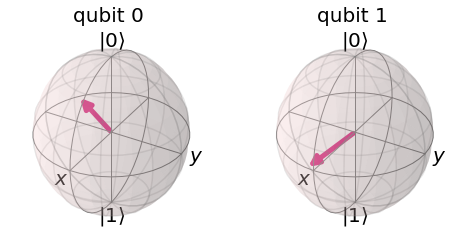

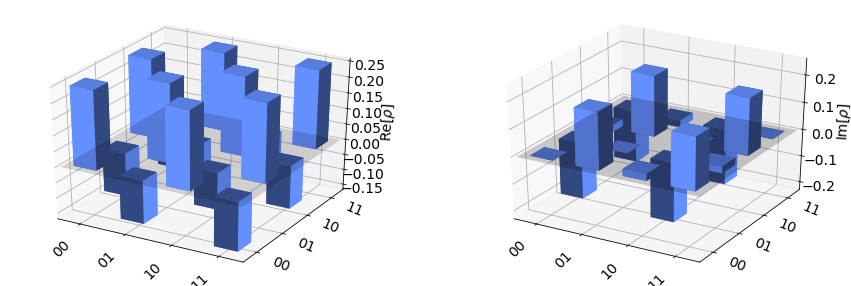

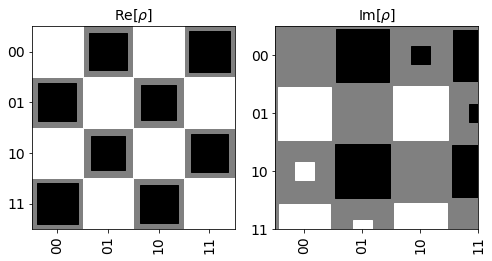

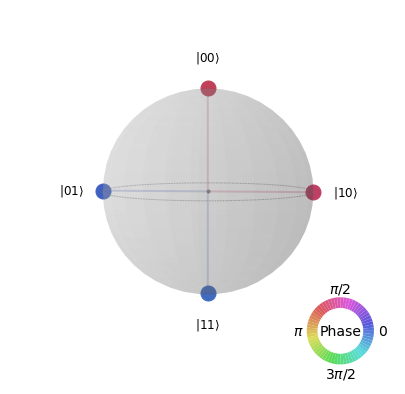






Feature mapping of 3-th observation:

Datapoint: [-0.84   0.424]


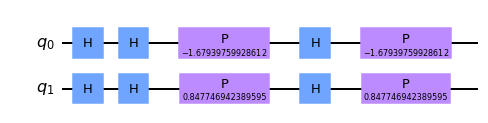


State:	[ 0.5  +3.571e-18j -0.054-4.971e-01j  0.331+3.749e-01j  0.337-3.695e-01j]



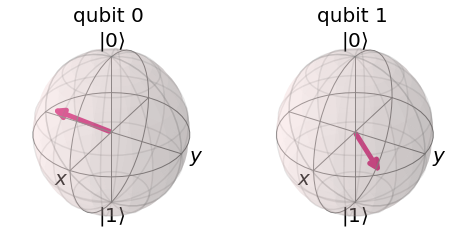

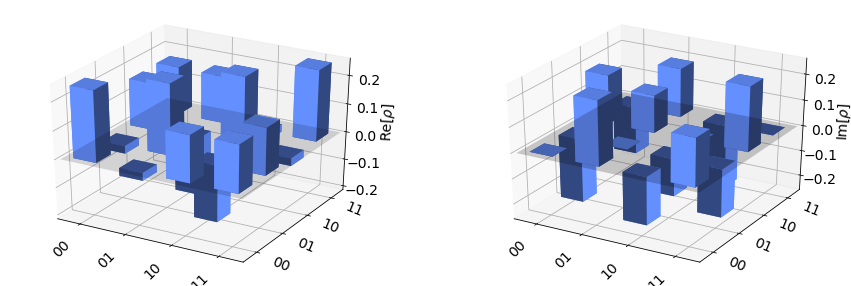

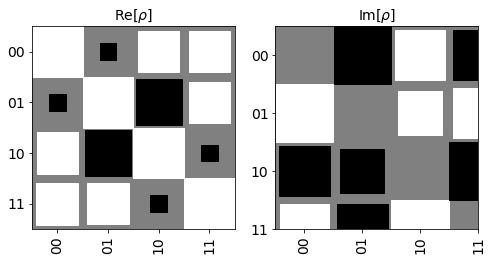

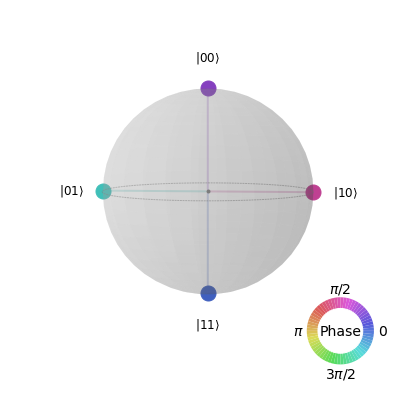






Feature mapping of 4-th observation:

Datapoint: [ 0.786 -0.211]


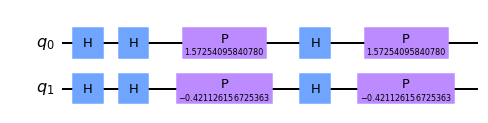


State:	[ 0.5  -1.947e-18j -0.001+5.000e-01j  0.456-2.044e-01j  0.204+4.567e-01j]



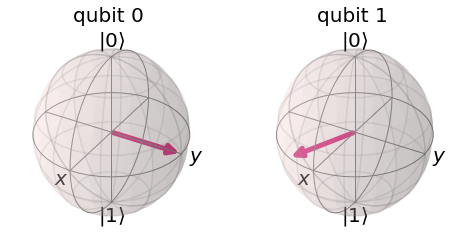

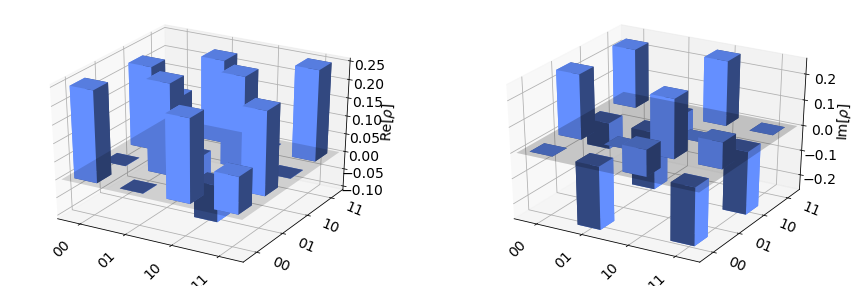

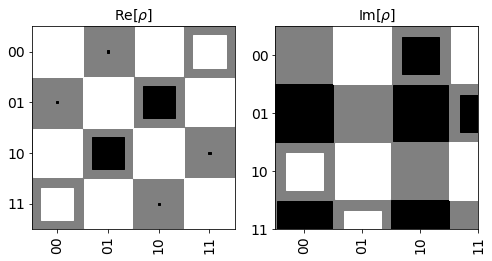

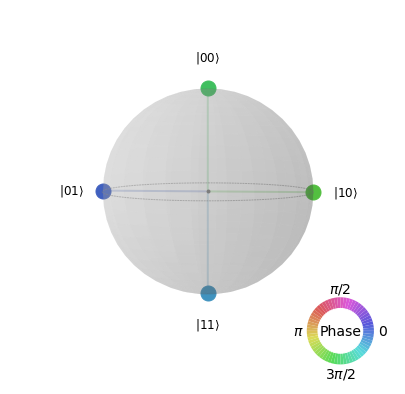

In [124]:
for i in range(5):
    
    visualize_feature_mapping(reps, paulis, entanglement, X=X_train, idx=i)
    
    print("\n")
    print("="*80)
    print("="*80)
    print("="*80)
    print("\n")

________________
________________
________________
________________
________________